In [1]:
from segment_trees import PREDICTORS, get_predictor
from deepent.data.untiler import new_polygon_q, format_predictions, PolygonRecord, affine_polygon
from tools.predictor import RGBDPredictor
from shapely.errors import TopologicalError
from shapely.geometry import Polygon
from detectron2.engine import DefaultPredictor

DEVICE = 'cpu'

In [2]:
import os
os.chdir('/home/ubuntu/drone-tree-id')

In [3]:
sequoia = get_predictor(**PREDICTORS['sequoia'], confidence=.5)
sequoialowconf = get_predictor(**PREDICTORS['sequoia'], confidence=.1)
sequoiamediumlowconf = get_predictor(**PREDICTORS['sequoia'], confidence=.3)

In [4]:
fuse60 = get_predictor(**PREDICTORS['fuse60'], confidence=.5)
fuse60lowconf = get_predictor(**PREDICTORS['fuse60'], confidence=.1)
fuse60mediumlowconf = get_predictor(**PREDICTORS['fuse60'], confidence=.3)

In [5]:
fuse30 = get_predictor(**PREDICTORS['fuse30'], confidence=.5)
fuse30lowconf = get_predictor(**PREDICTORS['fuse30'], confidence=.1)
fuse30mediumlowconf = get_predictor(**PREDICTORS['fuse30'], confidence=.3)

In [36]:
fuse90 = get_predictor(**PREDICTORS['fuse30'], confidence=.5)
fuse90lowconf = get_predictor(**PREDICTORS['fuse30'], confidence=.1)
fuse90mediumlowconf = get_predictor(**PREDICTORS['fuse30'], confidence=.3)

In [6]:
info = {'config_file': 'configs/deepent_rcnn_R_50_FPN.yaml',
                          'model': 'output/baseline_25_01_2020/model_0029999.pth', 'predictor': DefaultPredictor}
sequoiaearly = get_predictor(**info, confidence=.5)

In [13]:
import cv2
rgbd_read = lambda x: cv2.imread(x, cv2.IMREAD_UNCHANGED) 

In [10]:
from glob import glob
from random import choice
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
from math import ceil

tile_1050.png


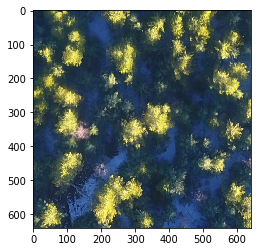

In [49]:
tile = choice(glob('../datasets/tmp/tiles/CPT2a-n/*.png'))
print(os.path.basename(tile))
img = cv2.imread(tile)
rgbd = rgbd_read(tile)
plt.imshow(img)

In [123]:
rgbd.shape

(640, 640, 4)

In [38]:
def plot_segs(t, models):
    h, w = ceil(len(models)/3), 3 if len(models)>=3 else len(models)
    fig, axes = plt.subplots(h, w, figsize=(10*w, 10* h))
    for model, ax in zip(models, axes.ravel()):
        polys = [poly for poly, _, _ in format_predictions(model(t)['instances'].to('cpu'), *t.shape[:-1])]
        for p in polys:
            ax.plot(*p.transpose())
        ax.imshow(t[:,:,0:3])

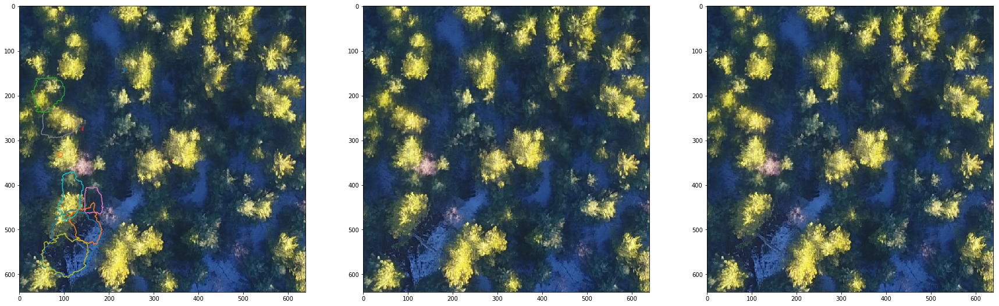

In [50]:
plot_segs(rgbd, [fuse90lowconf,fuse90mediumlowconf, fuse90])

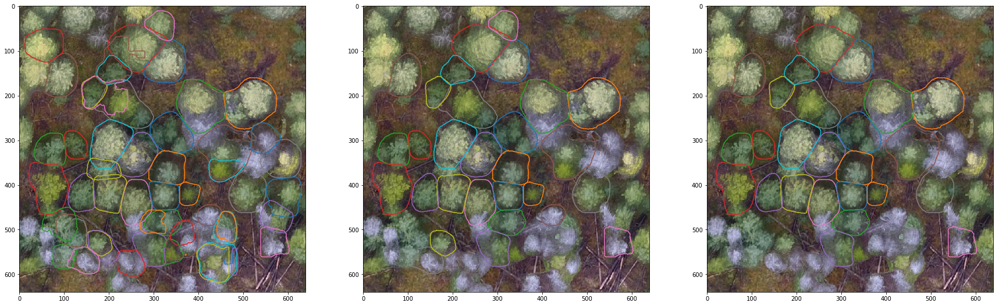

In [120]:
plot_segs(img, [sequoialowconf, sequoiamediumlowconf, sequoia])

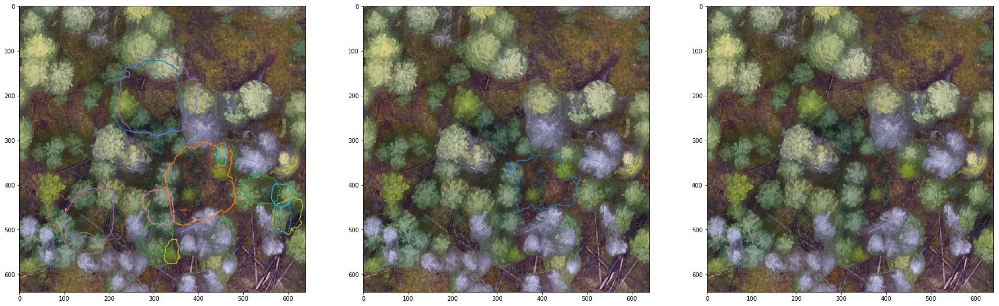

In [140]:
plot_segs(rgbd, [fuse60lowconf, fuse60mediumlowconf, fuse60])

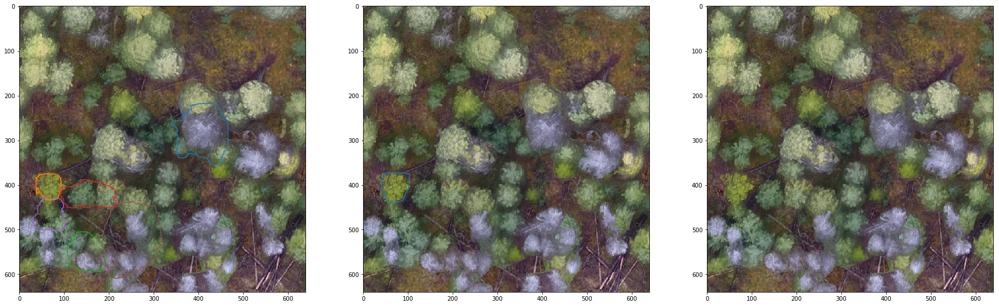

In [149]:
plot_segs(rgbd, [fuse30lowconf, fuse30mediumlowconf, fuse30])

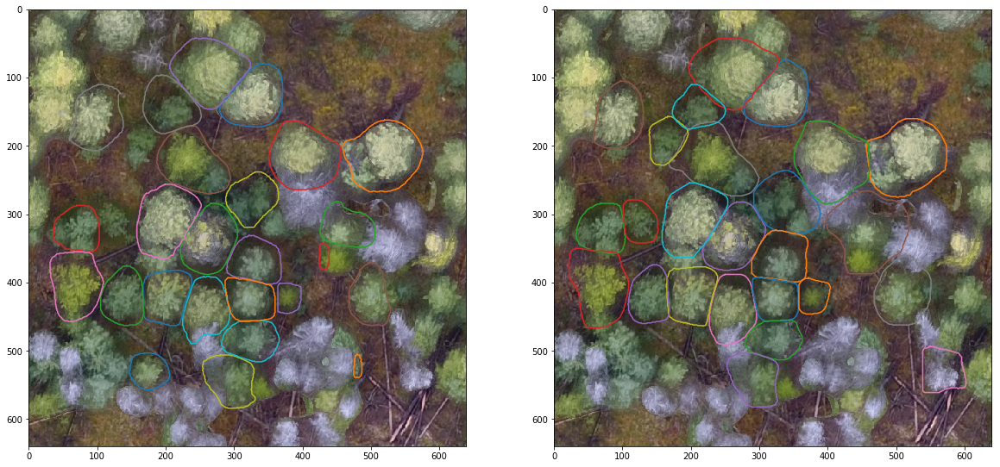

In [151]:
plot_segs(img, [sequoiaearly, sequoia])

In [27]:
import json

def new_polygon_q(poly, neighbours, iou_thresh: .75, area_thresh=4, containment_thresh=.9, plot_errors=False):
    if poly.area < area_thresh:
        print('Area')
        if plot_errors:
            plt.plot(*np.array(poly.exterior.coords).transpose(), label='self')
            plt.legend()
            plt.show()
        return False
    for neighbour in neighbours:
        try:
            intersection = neighbour.intersection(poly).area
            if intersection / neighbour.union(poly).area > iou_thresh:
                print('IOU')
                if plot_errors:
                    plt.plot(*np.array(poly.exterior.coords).transpose(), label='self')
                    plt.plot(*np.array(neighbour.exterior.coords).transpose(), label='other')
                    plt.legend()
                    plt.show()
                return False
            if intersection / neighbour.area > containment_thresh:
                print(f'IO other {intersection / neighbour.area}')
                if plot_errors:
                    plt.plot(*np.array(poly.exterior.coords).transpose(), label='self')
                    plt.plot(*np.array(neighbour.exterior.coords).transpose(), label='other')
                    plt.legend()
                    plt.show()
                return False
            if intersection / poly.area > containment_thresh:
                print(f'IO self {intersection / poly.area}')
                if plot_errors:
                    plt.plot(*np.array(poly.exterior.coords).transpose(), label='self')
                    plt.plot(*np.array(neighbour.exterior.coords).transpose(), label='other')
                    plt.legend()
                    plt.show()
                return False
        except TopologicalError:
            return False
    return True

class UntilerMod:
    def __init__(self, predictors):
        self.predictors = predictors

    def predict_and_untile(self, path_to_tiles: str, duplicate_tol=.75, min_area=2):
        tree_id = 0

        with open(os.path.join(path_to_tiles, 'offsets.json'), 'r') as f:
            offsets = json.loads(f.read())
        x_scale, y_scale = offsets['transform']

        tiles = sorted(glob(os.path.join(path_to_tiles, "*.png")),
                       key=lambda x: int(os.path.basename(x).split('_')[-1][:-4]))
        poly_record = PolygonRecord(num_tiles=len(tiles), x_tiles=offsets['x_tiles'])
        removed_polys, total_polys = 0, 0
        for i, predictor in enumerate(self.predictors):
            for tile_num, tile in tqdm(enumerate(tiles)):
                if isinstance(predictor, RGBDPredictor):
                    img = cv2.imread(tile, cv2.IMREAD_UNCHANGED)
                else:
                    img = cv2.imread(tile)
                width, height = img.shape[1], img.shape[0]
                x_shift, y_shift = offsets[os.path.realpath(tile)]
                predictions = predictor(img)
                predictions = predictions["instances"].to(DEVICE)

                if predictions.has("pred_masks"):
                    for (polygon, area, cls) in format_predictions(predictions, height, width):
                        total_polys += 1
                        if len(polygon) > 4:
                            print(polygon)
                            next_poly = Polygon(affine_polygon(polygon, x_scale, y_scale, x_shift, y_shift)).simplify(
                                0.2)
                            if new_polygon_q(next_poly, poly_record.get_neighbours(tile_num, lookahead=(i > 0)),
                                             iou_thresh=duplicate_tol, area_thresh=min_area, plot_errors=True):
                                poly_record.put(tile_num, next_poly, tree_id,
                                                area * x_scale * y_scale, cls)
                                tree_id += 1
                            else:
                                removed_polys += 1
        print(f'{removed_polys}/{total_polys} polygons removed')
        return poly_record

1it [00:00,  3.84it/s]

[[517 251]
 [516 252]
 [515 252]
 [514 252]
 [513 253]
 [512 253]
 [511 253]
 [510 254]
 [509 254]
 [508 254]
 [507 255]
 [506 255]
 [505 256]
 [504 256]
 [503 257]
 [502 257]
 [501 258]
 [500 258]
 [499 259]
 [498 259]
 [497 260]
 [496 260]
 [495 260]
 [494 261]
 [493 261]
 [492 262]
 [491 263]
 [490 264]
 [489 265]
 [488 265]
 [487 266]
 [486 266]
 [485 267]
 [484 267]
 [484 268]
 [483 269]
 [482 270]
 [481 270]
 [480 271]
 [479 272]
 [478 273]
 [477 274]
 [476 274]
 [475 275]
 [474 276]
 [473 277]
 [472 278]
 [471 279]
 [470 280]
 [469 280]
 [468 281]
 [467 282]
 [467 283]
 [466 284]
 [465 285]
 [464 286]
 [464 287]
 [463 288]
 [463 289]
 [462 290]
 [462 291]
 [461 292]
 [461 293]
 [461 294]
 [460 295]
 [460 296]
 [460 297]
 [460 298]
 [460 299]
 [460 300]
 [460 301]
 [460 302]
 [461 303]
 [461 304]
 [461 305]
 [461 306]
 [461 307]
 [462 308]
 [462 309]
 [462 310]
 [462 311]
 [463 312]
 [463 313]
 [463 314]
 [464 315]
 [464 316]
 [464 317]
 [465 318]
 [465 319]
 [465 320]
 [466 321]

[[573  34]
 [572  35]
 [571  35]
 [570  35]
 [569  35]
 [568  35]
 [567  35]
 [566  36]
 [565  36]
 [564  37]
 [563  37]
 [562  37]
 [561  37]
 [560  38]
 [559  38]
 [558  39]
 [557  39]
 [556  39]
 [555  40]
 [554  40]
 [553  40]
 [552  41]
 [551  41]
 [550  41]
 [549  42]
 [548  42]
 [547  43]
 [546  43]
 [545  43]
 [544  43]
 [543  44]
 [542  44]
 [541  45]
 [540  46]
 [539  47]
 [538  48]
 [537  49]
 [536  50]
 [535  51]
 [535  52]
 [534  53]
 [534  54]
 [533  55]
 [532  56]
 [531  57]
 [530  58]
 [529  59]
 [528  60]
 [527  61]
 [527  62]
 [526  63]
 [525  64]
 [525  65]
 [524  66]
 [524  67]
 [523  68]
 [523  69]
 [522  70]
 [522  71]
 [522  72]
 [521  73]
 [521  74]
 [521  75]
 [521  76]
 [521  77]
 [520  78]
 [520  79]
 [520  80]
 [520  81]
 [520  82]
 [520  83]
 [520  84]
 [520  85]
 [520  86]
 [520  87]
 [519  88]
 [519  89]
 [519  90]
 [519  91]
 [519  92]
 [519  93]
 [519  94]
 [519  95]
 [519  96]
 [520  97]
 [520  98]
 [520  99]
 [520 100]
 [520 101]
 [520 102]
 [520 103]

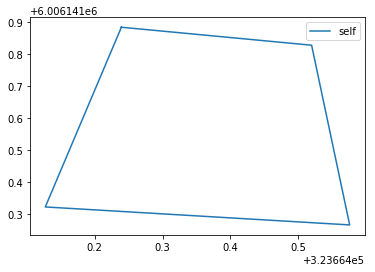

[[404 400]
 [403 401]
 [402 401]
 [401 401]
 [400 401]
 [399 401]
 [398 402]
 [397 402]
 [396 402]
 [395 403]
 [394 403]
 [393 404]
 [392 404]
 [391 405]
 [390 405]
 [389 406]
 [388 406]
 [387 407]
 [386 408]
 [385 408]
 [384 409]
 [383 410]
 [382 410]
 [381 411]
 [380 412]
 [379 412]
 [378 413]
 [377 413]
 [376 414]
 [375 414]
 [374 415]
 [373 416]
 [372 416]
 [371 417]
 [370 418]
 [369 419]
 [368 420]
 [367 421]
 [366 422]
 [365 423]
 [364 424]
 [364 425]
 [364 426]
 [363 427]
 [363 428]
 [363 429]
 [362 430]
 [362 431]
 [362 432]
 [362 433]
 [362 434]
 [362 435]
 [361 436]
 [361 437]
 [361 438]
 [361 439]
 [361 440]
 [361 441]
 [360 442]
 [360 443]
 [359 444]
 [359 445]
 [358 446]
 [358 447]
 [358 448]
 [357 449]
 [357 450]
 [357 451]
 [356 452]
 [356 453]
 [355 454]
 [355 455]
 [354 456]
 [354 457]
 [354 458]
 [354 459]
 [354 460]
 [353 461]
 [353 462]
 [353 463]
 [353 464]
 [353 465]
 [353 466]
 [353 467]
 [353 468]
 [353 469]
 [353 470]
 [353 471]
 [353 472]
 [353 473]
 [353 474]

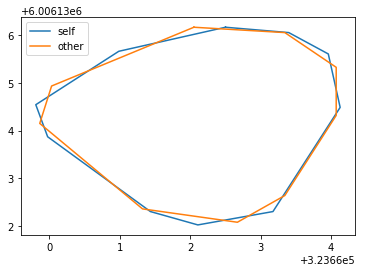

[[261 159]
 [260 160]
 [259 160]
 [258 161]
 [257 162]
 [256 163]
 [255 163]
 [254 164]
 [254 165]
 [253 166]
 [253 167]
 [253 168]
 [252 169]
 [252 170]
 [252 171]
 [251 172]
 [251 173]
 [250 174]
 [250 175]
 [249 176]
 [249 177]
 [249 178]
 [248 179]
 [248 180]
 [248 181]
 [248 182]
 [247 183]
 [247 184]
 [247 185]
 [247 186]
 [247 187]
 [246 188]
 [246 189]
 [246 190]
 [246 191]
 [245 192]
 [245 193]
 [245 194]
 [245 195]
 [245 196]
 [245 197]
 [244 198]
 [244 199]
 [244 200]
 [244 201]
 [244 202]
 [243 203]
 [243 204]
 [243 205]
 [243 206]
 [243 207]
 [243 208]
 [242 209]
 [242 210]
 [242 211]
 [242 212]
 [241 213]
 [241 214]
 [241 215]
 [241 216]
 [241 217]
 [241 218]
 [240 219]
 [240 220]
 [240 221]
 [240 222]
 [240 223]
 [240 224]
 [240 225]
 [239 226]
 [239 227]
 [239 228]
 [239 229]
 [239 230]
 [239 231]
 [239 232]
 [239 233]
 [239 234]
 [239 235]
 [239 236]
 [239 237]
 [239 238]
 [239 239]
 [239 240]
 [239 241]
 [239 242]
 [239 243]
 [239 244]
 [239 245]
 [239 246]
 [240 247]

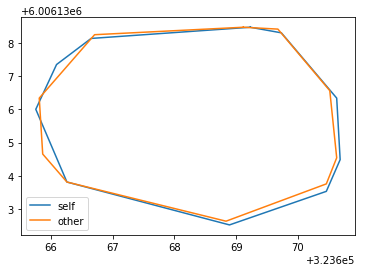

[[545 521]
 [544 522]
 [545 522]
 [546 522]
 [547 522]
 [548 522]
 [547 521]
 [546 521]
 [545 521]]
Area


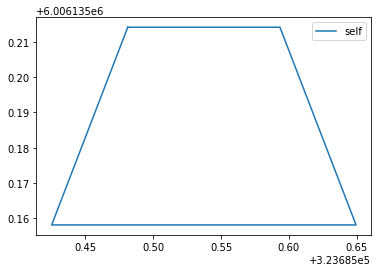

[[131  46]
 [130  47]
 [129  47]
 [128  47]
 [127  48]
 [126  48]
 [125  48]
 [124  48]
 [123  48]
 [122  48]
 [121  48]
 [120  49]
 [119  49]
 [118  49]
 [117  49]
 [116  49]
 [115  50]
 [114  50]
 [113  50]
 [112  50]
 [111  51]
 [110  51]
 [109  51]
 [108  51]
 [107  52]
 [106  52]
 [105  52]
 [104  53]
 [103  53]
 [102  53]
 [101  53]
 [100  54]
 [ 99  54]
 [ 98  54]
 [ 97  54]
 [ 96  54]
 [ 95  55]
 [ 94  55]
 [ 93  55]
 [ 92  56]
 [ 91  56]
 [ 90  56]
 [ 89  56]
 [ 88  56]
 [ 87  56]
 [ 86  56]
 [ 85  57]
 [ 84  57]
 [ 83  57]
 [ 82  57]
 [ 81  58]
 [ 80  58]
 [ 79  58]
 [ 78  58]
 [ 77  59]
 [ 76  59]
 [ 75  60]
 [ 74  60]
 [ 73  61]
 [ 72  61]
 [ 71  62]
 [ 70  63]
 [ 70  64]
 [ 69  65]
 [ 68  66]
 [ 67  67]
 [ 66  68]
 [ 66  69]
 [ 65  70]
 [ 65  71]
 [ 65  72]
 [ 64  73]
 [ 64  74]
 [ 65  75]
 [ 65  76]
 [ 65  77]
 [ 65  78]
 [ 65  79]
 [ 66  80]
 [ 66  81]
 [ 66  82]
 [ 66  83]
 [ 67  84]
 [ 67  85]
 [ 67  86]
 [ 68  87]
 [ 68  88]
 [ 69  89]
 [ 69  90]
 [ 69  91]
 [ 70  92]

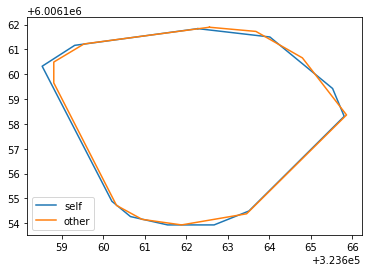

[[225 408]
 [224 409]
 [223 409]
 [222 409]
 [221 410]
 [220 410]
 [219 411]
 [218 411]
 [217 412]
 [216 413]
 [215 414]
 [214 415]
 [214 416]
 [214 417]
 [213 418]
 [213 419]
 [212 420]
 [212 421]
 [211 422]
 [210 423]
 [210 424]
 [210 425]
 [209 426]
 [209 427]
 [208 428]
 [208 429]
 [208 430]
 [208 431]
 [208 432]
 [207 433]
 [207 434]
 [207 435]
 [207 436]
 [206 437]
 [206 438]
 [206 439]
 [206 440]
 [206 441]
 [205 442]
 [205 443]
 [205 444]
 [205 445]
 [204 446]
 [204 447]
 [204 448]
 [204 449]
 [203 450]
 [203 451]
 [203 452]
 [203 453]
 [203 454]
 [203 455]
 [203 456]
 [203 457]
 [203 458]
 [203 459]
 [203 460]
 [203 461]
 [203 462]
 [203 463]
 [203 464]
 [204 465]
 [204 466]
 [205 467]
 [206 468]
 [207 468]
 [208 469]
 [209 469]
 [210 469]
 [211 468]
 [212 468]
 [213 468]
 [214 468]
 [215 468]
 [216 467]
 [217 467]
 [218 467]
 [219 466]
 [220 466]
 [221 466]
 [222 466]
 [223 466]
 [224 466]
 [225 465]
 [226 465]
 [227 465]
 [228 465]
 [229 465]
 [230 465]
 [231 465]
 [232 465]

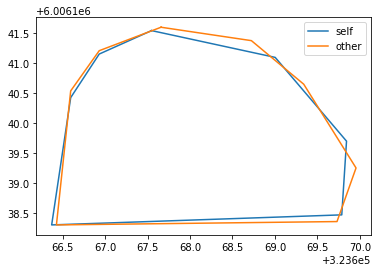

[[590 439]
 [589 440]
 [588 440]
 [587 440]
 [586 440]
 [585 441]
 [584 441]
 [583 441]
 [582 442]
 [581 442]
 [580 442]
 [579 443]
 [578 443]
 [577 444]
 [576 444]
 [575 445]
 [574 446]
 [573 447]
 [572 448]
 [571 449]
 [571 450]
 [570 451]
 [569 452]
 [568 453]
 [568 454]
 [567 455]
 [567 456]
 [566 457]
 [565 458]
 [564 459]
 [563 460]
 [563 461]
 [563 462]
 [562 463]
 [561 464]
 [561 465]
 [560 466]
 [559 467]
 [559 468]
 [559 469]
 [558 470]
 [558 471]
 [557 472]
 [557 473]
 [556 474]
 [556 475]
 [555 476]
 [554 477]
 [554 478]
 [553 479]
 [552 480]
 [552 481]
 [551 482]
 [551 483]
 [550 484]
 [549 485]
 [549 486]
 [548 487]
 [547 488]
 [547 489]
 [546 490]
 [545 491]
 [545 492]
 [545 493]
 [544 494]
 [544 495]
 [543 496]
 [542 497]
 [542 498]
 [541 499]
 [540 500]
 [540 501]
 [539 502]
 [539 503]
 [538 504]
 [538 505]
 [538 506]
 [538 507]
 [537 508]
 [537 509]
 [537 510]
 [537 511]
 [536 512]
 [536 513]
 [536 514]
 [536 515]
 [536 516]
 [536 517]
 [536 518]
 [537 519]
 [537 520]

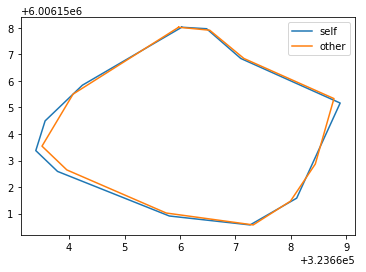

[[589 280]
 [588 281]
 [587 281]
 [586 281]
 [585 281]
 [584 281]
 [583 281]
 [582 281]
 [581 282]
 [580 282]
 [579 282]
 [578 282]
 [577 282]
 [576 282]
 [575 283]
 [574 283]
 [573 283]
 [572 283]
 [571 284]
 [570 284]
 [569 284]
 [568 285]
 [567 285]
 [566 286]
 [565 286]
 [564 287]
 [563 287]
 [562 288]
 [561 289]
 [560 290]
 [559 291]
 [558 292]
 [557 293]
 [556 294]
 [555 294]
 [554 295]
 [553 296]
 [552 297]
 [551 298]
 [550 299]
 [549 299]
 [549 300]
 [548 301]
 [547 302]
 [546 303]
 [546 304]
 [545 305]
 [545 306]
 [544 307]
 [544 308]
 [544 309]
 [543 310]
 [543 311]
 [543 312]
 [542 313]
 [542 314]
 [542 315]
 [542 316]
 [542 317]
 [542 318]
 [541 319]
 [541 320]
 [541 321]
 [541 322]
 [541 323]
 [541 324]
 [541 325]
 [540 326]
 [540 327]
 [540 328]
 [540 329]
 [540 330]
 [540 331]
 [540 332]
 [541 333]
 [541 334]
 [541 335]
 [541 336]
 [542 337]
 [542 338]
 [543 339]
 [543 340]
 [544 341]
 [545 342]
 [546 343]
 [547 344]
 [548 344]
 [549 345]
 [550 345]
 [551 345]
 [552 346]

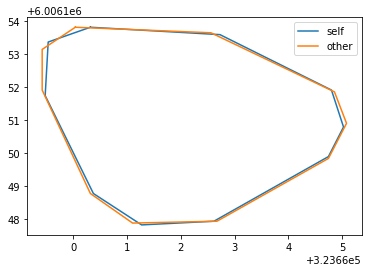

2it [00:01,  1.82it/s]

[[258  34]
 [257  35]
 [256  35]
 [255  35]
 [254  35]
 [253  35]
 [252  35]
 [251  35]
 [250  36]
 [249  36]
 [248  36]
 [247  37]
 [246  37]
 [245  37]
 [244  38]
 [243  38]
 [242  38]
 [241  39]
 [240  39]
 [239  39]
 [238  40]
 [237  40]
 [236  40]
 [235  40]
 [234  40]
 [233  41]
 [232  41]
 [231  41]
 [230  42]
 [229  42]
 [228  42]
 [227  42]
 [226  43]
 [225  43]
 [224  44]
 [223  44]
 [222  45]
 [221  45]
 [220  45]
 [219  46]
 [218  46]
 [217  47]
 [216  48]
 [215  49]
 [215  50]
 [214  51]
 [214  52]
 [213  53]
 [212  54]
 [211  55]
 [211  56]
 [210  57]
 [209  58]
 [208  59]
 [208  60]
 [207  61]
 [206  62]
 [206  63]
 [205  64]
 [205  65]
 [204  66]
 [203  67]
 [203  68]
 [202  69]
 [202  70]
 [202  71]
 [201  72]
 [201  73]
 [201  74]
 [201  75]
 [201  76]
 [201  77]
 [200  78]
 [200  79]
 [200  80]
 [200  81]
 [200  82]
 [200  83]
 [200  84]
 [200  85]
 [200  86]
 [200  87]
 [200  88]
 [200  89]
 [200  90]
 [200  91]
 [200  92]
 [200  93]
 [200  94]
 [200  95]
 [200  96]

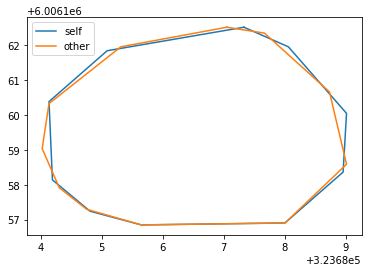

[[ 80 401]
 [ 79 402]
 [ 78 402]
 [ 77 402]
 [ 76 402]
 [ 75 403]
 [ 74 403]
 [ 73 404]
 [ 72 404]
 [ 71 405]
 [ 70 405]
 [ 69 406]
 [ 68 407]
 [ 67 407]
 [ 66 408]
 [ 65 408]
 [ 64 409]
 [ 63 410]
 [ 62 411]
 [ 61 412]
 [ 60 412]
 [ 59 413]
 [ 58 413]
 [ 57 414]
 [ 56 415]
 [ 55 415]
 [ 54 416]
 [ 53 416]
 [ 52 417]
 [ 51 418]
 [ 50 419]
 [ 49 419]
 [ 48 420]
 [ 47 421]
 [ 46 422]
 [ 45 423]
 [ 45 424]
 [ 44 425]
 [ 44 426]
 [ 43 427]
 [ 43 428]
 [ 43 429]
 [ 42 430]
 [ 42 431]
 [ 42 432]
 [ 41 433]
 [ 41 434]
 [ 41 435]
 [ 41 436]
 [ 40 437]
 [ 40 438]
 [ 40 439]
 [ 40 440]
 [ 40 441]
 [ 39 442]
 [ 39 443]
 [ 39 444]
 [ 38 445]
 [ 38 446]
 [ 38 447]
 [ 37 448]
 [ 37 449]
 [ 36 450]
 [ 36 451]
 [ 36 452]
 [ 36 453]
 [ 35 454]
 [ 35 455]
 [ 35 456]
 [ 35 457]
 [ 34 458]
 [ 34 459]
 [ 34 460]
 [ 34 461]
 [ 34 462]
 [ 34 463]
 [ 34 464]
 [ 33 465]
 [ 33 466]
 [ 33 467]
 [ 33 468]
 [ 33 469]
 [ 33 470]
 [ 33 471]
 [ 33 472]
 [ 33 473]
 [ 34 474]
 [ 34 475]
 [ 34 476]
 [ 34 477]
 [ 34 478]

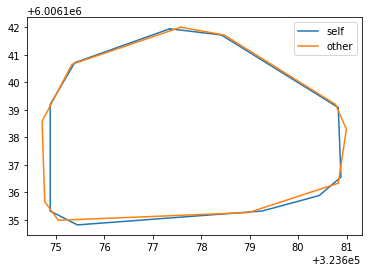

[[237 344]
 [236 345]
 [235 345]
 [234 345]
 [233 345]
 [232 346]
 [231 346]
 [230 347]
 [229 348]
 [228 349]
 [227 350]
 [227 351]
 [226 352]
 [225 353]
 [224 354]
 [224 355]
 [223 356]
 [222 357]
 [221 358]
 [221 359]
 [220 360]
 [219 361]
 [218 362]
 [218 363]
 [217 364]
 [216 365]
 [216 366]
 [215 367]
 [215 368]
 [214 369]
 [214 370]
 [214 371]
 [213 372]
 [213 373]
 [213 374]
 [213 375]
 [213 376]
 [213 377]
 [212 378]
 [212 379]
 [212 380]
 [212 381]
 [212 382]
 [212 383]
 [212 384]
 [212 385]
 [212 386]
 [211 387]
 [211 388]
 [211 389]
 [211 390]
 [211 391]
 [211 392]
 [211 393]
 [211 394]
 [211 395]
 [212 396]
 [212 397]
 [212 398]
 [212 399]
 [212 400]
 [212 401]
 [212 402]
 [213 403]
 [213 404]
 [213 405]
 [213 406]
 [214 407]
 [214 408]
 [215 409]
 [215 410]
 [216 411]
 [216 412]
 [217 413]
 [218 414]
 [218 415]
 [219 416]
 [220 417]
 [221 418]
 [222 419]
 [223 419]
 [224 420]
 [225 420]
 [226 421]
 [227 421]
 [228 422]
 [229 423]
 [230 424]
 [231 424]
 [232 425]
 [233 426]

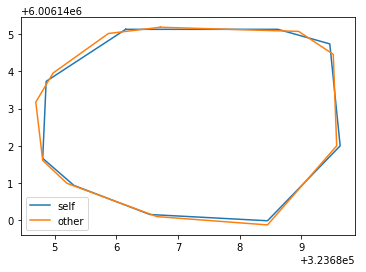

[[133 357]
 [132 358]
 [131 358]
 [130 358]
 [129 359]
 [128 359]
 [127 359]
 [126 360]
 [125 360]
 [124 361]
 [123 362]
 [122 363]
 [121 364]
 [120 364]
 [119 365]
 [119 366]
 [118 367]
 [117 368]
 [117 369]
 [116 370]
 [115 371]
 [114 372]
 [113 373]
 [113 374]
 [112 375]
 [111 376]
 [111 377]
 [110 378]
 [109 379]
 [109 380]
 [108 381]
 [107 382]
 [106 383]
 [106 384]
 [105 385]
 [104 386]
 [104 387]
 [103 388]
 [103 389]
 [103 390]
 [103 391]
 [103 392]
 [103 393]
 [103 394]
 [103 395]
 [103 396]
 [103 397]
 [103 398]
 [103 399]
 [103 400]
 [103 401]
 [103 402]
 [103 403]
 [103 404]
 [103 405]
 [103 406]
 [103 407]
 [104 408]
 [104 409]
 [105 410]
 [106 411]
 [107 412]
 [108 413]
 [109 414]
 [110 415]
 [111 416]
 [112 417]
 [113 418]
 [114 419]
 [115 420]
 [116 421]
 [116 422]
 [117 423]
 [118 424]
 [119 425]
 [120 426]
 [121 427]
 [122 428]
 [122 429]
 [123 430]
 [124 431]
 [125 432]
 [126 433]
 [127 434]
 [128 435]
 [129 435]
 [130 436]
 [131 437]
 [132 438]
 [133 439]
 [134 439]

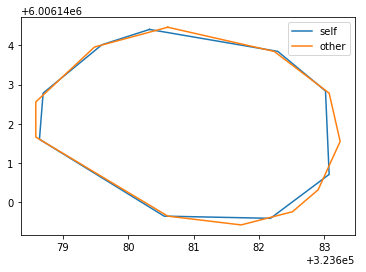

[[492 348]
 [491 349]
 [490 349]
 [489 349]
 [488 349]
 [487 349]
 [486 349]
 [485 350]
 [484 350]
 [483 351]
 [482 351]
 [481 352]
 [480 352]
 [479 353]
 [478 353]
 [477 353]
 [476 354]
 [475 354]
 [474 355]
 [473 355]
 [472 356]
 [471 357]
 [470 357]
 [469 358]
 [468 358]
 [467 359]
 [466 359]
 [465 360]
 [464 361]
 [463 361]
 [462 362]
 [461 362]
 [460 363]
 [459 363]
 [458 364]
 [457 365]
 [456 365]
 [455 366]
 [454 367]
 [453 368]
 [452 369]
 [451 370]
 [450 371]
 [450 372]
 [449 373]
 [448 374]
 [448 375]
 [447 376]
 [447 377]
 [446 378]
 [446 379]
 [445 380]
 [445 381]
 [445 382]
 [445 383]
 [444 384]
 [444 385]
 [444 386]
 [444 387]
 [444 388]
 [444 389]
 [444 390]
 [444 391]
 [444 392]
 [444 393]
 [444 394]
 [445 395]
 [445 396]
 [445 397]
 [445 398]
 [446 399]
 [446 400]
 [446 401]
 [446 402]
 [447 403]
 [447 404]
 [447 405]
 [448 406]
 [448 407]
 [449 408]
 [449 409]
 [450 410]
 [450 411]
 [451 412]
 [451 413]
 [452 414]
 [452 415]
 [453 416]
 [453 417]
 [454 418]
 [455 419]

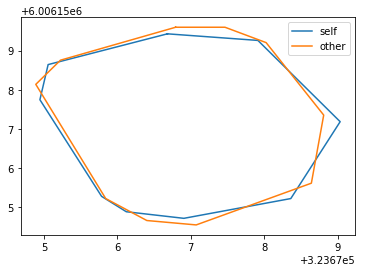

[[139 114]
 [138 115]
 [137 115]
 [136 115]
 [135 115]
 [134 115]
 [133 115]
 [132 116]
 [131 116]
 [130 116]
 [129 117]
 [128 117]
 [127 117]
 [126 118]
 [125 118]
 [124 119]
 [123 119]
 [122 120]
 [121 120]
 [120 121]
 [119 122]
 [118 123]
 [117 124]
 [117 125]
 [116 126]
 [115 127]
 [115 128]
 [114 129]
 [114 130]
 [113 131]
 [113 132]
 [112 133]
 [112 134]
 [112 135]
 [112 136]
 [112 137]
 [111 138]
 [111 139]
 [111 140]
 [110 141]
 [110 142]
 [110 143]
 [109 144]
 [109 145]
 [109 146]
 [108 147]
 [108 148]
 [108 149]
 [108 150]
 [107 151]
 [107 152]
 [107 153]
 [106 154]
 [106 155]
 [106 156]
 [105 157]
 [105 158]
 [105 159]
 [105 160]
 [104 161]
 [104 162]
 [104 163]
 [104 164]
 [103 165]
 [103 166]
 [103 167]
 [103 168]
 [103 169]
 [103 170]
 [103 171]
 [102 172]
 [102 173]
 [102 174]
 [102 175]
 [102 176]
 [102 177]
 [102 178]
 [102 179]
 [102 180]
 [102 181]
 [102 182]
 [102 183]
 [102 184]
 [103 185]
 [103 186]
 [103 187]
 [103 188]
 [103 189]
 [103 190]
 [103 191]
 [103 192]

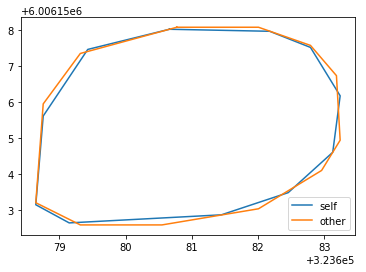

[[273 439]
 [272 440]
 [271 440]
 [270 440]
 [269 440]
 [268 440]
 [267 440]
 [266 440]
 [265 441]
 [264 441]
 [263 441]
 [262 441]
 [261 442]
 [260 442]
 [259 442]
 [258 443]
 [257 444]
 [256 444]
 [255 445]
 [254 446]
 [253 447]
 [252 448]
 [251 449]
 [251 450]
 [250 451]
 [250 452]
 [249 453]
 [249 454]
 [248 455]
 [247 456]
 [247 457]
 [246 458]
 [245 459]
 [244 460]
 [244 461]
 [243 462]
 [243 463]
 [242 464]
 [241 465]
 [240 466]
 [239 467]
 [239 468]
 [238 469]
 [238 470]
 [238 471]
 [238 472]
 [237 473]
 [237 474]
 [237 475]
 [236 476]
 [236 477]
 [235 478]
 [234 479]
 [233 480]
 [233 481]
 [232 482]
 [232 483]
 [231 484]
 [231 485]
 [230 486]
 [230 487]
 [229 488]
 [229 489]
 [228 490]
 [228 491]
 [227 492]
 [227 493]
 [226 494]
 [226 495]
 [225 496]
 [225 497]
 [224 498]
 [224 499]
 [224 500]
 [223 501]
 [223 502]
 [222 503]
 [222 504]
 [221 505]
 [221 506]
 [221 507]
 [221 508]
 [220 509]
 [220 510]
 [219 511]
 [219 512]
 [219 513]
 [219 514]
 [218 515]
 [218 516]
 [218 517]

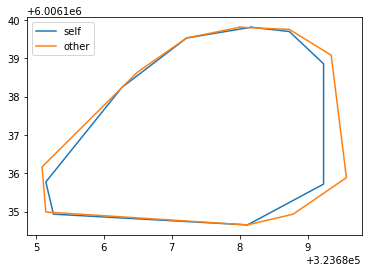

[[321 219]
 [320 220]
 [319 220]
 [318 220]
 [317 220]
 [316 220]
 [315 220]
 [314 220]
 [313 220]
 [312 220]
 [311 220]
 [310 221]
 [309 221]
 [308 222]
 [307 222]
 [306 223]
 [305 223]
 [304 224]
 [303 225]
 [302 225]
 [301 226]
 [300 227]
 [299 228]
 [298 229]
 [297 230]
 [297 231]
 [296 232]
 [295 233]
 [294 234]
 [294 235]
 [293 236]
 [292 237]
 [292 238]
 [291 239]
 [290 240]
 [290 241]
 [289 242]
 [289 243]
 [288 244]
 [288 245]
 [287 246]
 [287 247]
 [286 248]
 [286 249]
 [285 250]
 [285 251]
 [285 252]
 [285 253]
 [284 254]
 [284 255]
 [283 256]
 [283 257]
 [283 258]
 [283 259]
 [283 260]
 [282 261]
 [282 262]
 [282 263]
 [282 264]
 [282 265]
 [282 266]
 [282 267]
 [282 268]
 [281 269]
 [281 270]
 [281 271]
 [281 272]
 [281 273]
 [282 274]
 [282 275]
 [282 276]
 [282 277]
 [282 278]
 [282 279]
 [283 280]
 [284 281]
 [284 282]
 [285 283]
 [285 284]
 [286 285]
 [287 286]
 [288 287]
 [289 288]
 [289 289]
 [290 290]
 [291 291]
 [292 292]
 [293 293]
 [294 294]
 [295 295]
 [296 296]

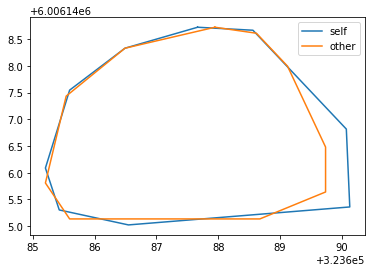

[[347 429]
 [346 430]
 [345 430]
 [344 430]
 [343 430]
 [342 430]
 [341 430]
 [340 430]
 [339 430]
 [338 430]
 [337 431]
 [336 431]
 [335 432]
 [334 432]
 [333 433]
 [332 433]
 [331 433]
 [330 434]
 [329 434]
 [328 435]
 [327 435]
 [326 436]
 [325 437]
 [324 437]
 [323 438]
 [322 439]
 [321 439]
 [320 440]
 [319 441]
 [318 441]
 [317 442]
 [316 442]
 [315 443]
 [314 444]
 [313 444]
 [312 445]
 [311 445]
 [310 446]
 [309 446]
 [308 446]
 [307 446]
 [306 447]
 [305 447]
 [304 447]
 [303 447]
 [302 448]
 [301 448]
 [300 448]
 [299 449]
 [298 449]
 [297 450]
 [296 451]
 [296 452]
 [295 453]
 [295 454]
 [295 455]
 [294 456]
 [294 457]
 [294 458]
 [294 459]
 [294 460]
 [294 461]
 [294 462]
 [294 463]
 [294 464]
 [294 465]
 [294 466]
 [294 467]
 [294 468]
 [294 469]
 [294 470]
 [294 471]
 [294 472]
 [294 473]
 [294 474]
 [295 475]
 [295 476]
 [295 477]
 [295 478]
 [295 479]
 [295 480]
 [295 481]
 [295 482]
 [295 483]
 [295 484]
 [295 485]
 [295 486]
 [295 487]
 [295 488]
 [295 489]
 [295 490]

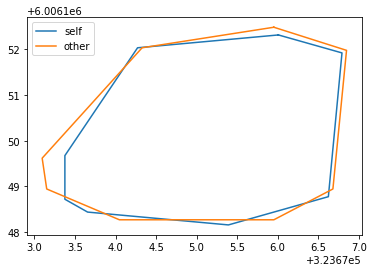

3it [00:02,  1.24it/s]

[[509 225]
 [508 226]
 [507 226]
 [506 226]
 [505 227]
 [504 227]
 [503 227]
 [502 228]
 [501 228]
 [500 229]
 [499 229]
 [498 230]
 [497 231]
 [496 232]
 [496 233]
 [495 234]
 [494 235]
 [494 236]
 [493 237]
 [493 238]
 [492 239]
 [492 240]
 [492 241]
 [492 242]
 [491 243]
 [491 244]
 [490 245]
 [489 246]
 [488 247]
 [487 248]
 [487 249]
 [486 250]
 [486 251]
 [486 252]
 [485 253]
 [485 254]
 [484 255]
 [483 256]
 [482 257]
 [481 258]
 [481 259]
 [480 260]
 [479 261]
 [478 261]
 [477 262]
 [476 263]
 [476 264]
 [476 265]
 [476 266]
 [476 267]
 [476 268]
 [475 269]
 [475 270]
 [475 271]
 [475 272]
 [475 273]
 [475 274]
 [475 275]
 [475 276]
 [475 277]
 [475 278]
 [475 279]
 [475 280]
 [476 281]
 [476 282]
 [476 283]
 [476 284]
 [476 285]
 [476 286]
 [475 287]
 [475 288]
 [475 289]
 [476 290]
 [476 291]
 [477 292]
 [477 293]
 [478 294]
 [478 295]
 [479 296]
 [479 297]
 [480 298]
 [480 299]
 [481 300]
 [481 301]
 [482 302]
 [482 303]
 [483 304]
 [483 305]
 [483 306]
 [483 307]
 [484 308]

[[492 388]
 [491 389]
 [490 389]
 [489 389]
 [488 390]
 [487 390]
 [486 391]
 [485 392]
 [484 393]
 [483 393]
 [482 394]
 [482 395]
 [481 396]
 [480 396]
 [479 397]
 [479 398]
 [478 399]
 [477 400]
 [476 400]
 [475 401]
 [474 402]
 [473 403]
 [472 404]
 [471 405]
 [470 406]
 [469 407]
 [468 407]
 [467 407]
 [466 408]
 [465 408]
 [464 408]
 [463 409]
 [462 409]
 [461 409]
 [460 409]
 [459 409]
 [458 409]
 [457 409]
 [456 409]
 [455 410]
 [454 410]
 [453 410]
 [452 411]
 [451 412]
 [450 413]
 [450 414]
 [450 415]
 [450 416]
 [450 417]
 [450 418]
 [450 419]
 [450 420]
 [450 421]
 [450 422]
 [451 423]
 [451 424]
 [452 425]
 [453 426]
 [454 427]
 [455 428]
 [455 429]
 [456 430]
 [456 431]
 [457 432]
 [458 433]
 [458 434]
 [459 435]
 [459 436]
 [460 437]
 [461 438]
 [461 439]
 [462 440]
 [463 441]
 [463 442]
 [464 443]
 [465 444]
 [466 445]
 [467 446]
 [468 447]
 [468 448]
 [469 449]
 [470 450]
 [471 451]
 [472 452]
 [473 453]
 [474 454]
 [474 455]
 [475 456]
 [476 457]
 [476 458]
 [477 459]

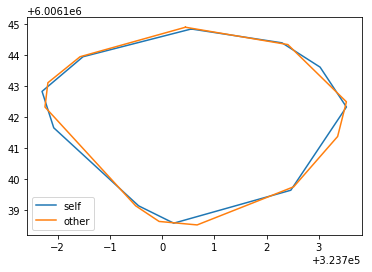

[[102 160]
 [101 161]
 [100 161]
 [ 99 161]
 [ 98 162]
 [ 97 163]
 [ 96 164]
 [ 95 164]
 [ 94 165]
 [ 93 166]
 [ 93 167]
 [ 92 168]
 [ 91 169]
 [ 90 170]
 [ 89 171]
 [ 88 172]
 [ 87 173]
 [ 86 173]
 [ 85 174]
 [ 84 175]
 [ 83 175]
 [ 82 176]
 [ 81 176]
 [ 80 177]
 [ 79 177]
 [ 78 178]
 [ 77 178]
 [ 76 178]
 [ 75 179]
 [ 74 179]
 [ 73 180]
 [ 72 180]
 [ 71 180]
 [ 70 181]
 [ 69 181]
 [ 68 181]
 [ 67 182]
 [ 66 182]
 [ 65 183]
 [ 64 183]
 [ 63 184]
 [ 62 184]
 [ 61 185]
 [ 60 185]
 [ 59 186]
 [ 58 186]
 [ 57 187]
 [ 56 188]
 [ 55 189]
 [ 54 189]
 [ 53 190]
 [ 52 190]
 [ 51 191]
 [ 50 192]
 [ 49 193]
 [ 48 194]
 [ 47 195]
 [ 46 196]
 [ 45 197]
 [ 44 198]
 [ 43 199]
 [ 42 200]
 [ 41 201]
 [ 40 202]
 [ 39 203]
 [ 39 204]
 [ 38 205]
 [ 37 206]
 [ 37 207]
 [ 37 208]
 [ 36 209]
 [ 36 210]
 [ 36 211]
 [ 36 212]
 [ 36 213]
 [ 36 214]
 [ 36 215]
 [ 36 216]
 [ 36 217]
 [ 36 218]
 [ 36 219]
 [ 36 220]
 [ 36 221]
 [ 36 222]
 [ 36 223]
 [ 36 224]
 [ 36 225]
 [ 37 226]
 [ 37 227]
 [ 37 228]
 [ 37 229]

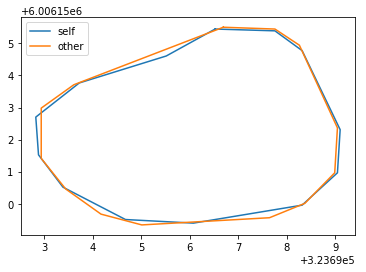

[[326  42]
 [325  43]
 [324  43]
 [323  43]
 [322  43]
 [321  43]
 [320  44]
 [319  44]
 [318  44]
 [317  45]
 [316  45]
 [315  45]
 [314  46]
 [313  47]
 [312  48]
 [311  48]
 [310  49]
 [309  49]
 [308  50]
 [307  51]
 [307  52]
 [307  53]
 [306  54]
 [305  55]
 [304  56]
 [303  57]
 [302  58]
 [301  58]
 [300  59]
 [299  60]
 [298  61]
 [297  62]
 [296  63]
 [295  64]
 [294  64]
 [293  65]
 [292  65]
 [291  66]
 [290  67]
 [289  68]
 [288  69]
 [287  70]
 [286  71]
 [286  72]
 [285  73]
 [284  74]
 [284  75]
 [283  76]
 [283  77]
 [282  78]
 [282  79]
 [282  80]
 [282  81]
 [281  82]
 [281  83]
 [281  84]
 [282  85]
 [282  86]
 [282  87]
 [282  88]
 [283  89]
 [284  90]
 [284  91]
 [285  92]
 [286  93]
 [287  94]
 [288  94]
 [289  95]
 [290  96]
 [291  97]
 [292  98]
 [292  99]
 [293 100]
 [294 101]
 [295 102]
 [295 103]
 [296 103]
 [297 104]
 [298 105]
 [299 106]
 [300 107]
 [300 108]
 [301 109]
 [302 110]
 [303 111]
 [304 112]
 [305 113]
 [306 114]
 [307 115]
 [308 115]
 [309 116]

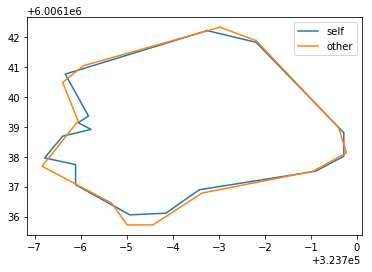

[[588  83]
 [587  84]
 [586  84]
 [585  85]
 [584  85]
 [583  86]
 [582  86]
 [581  86]
 [580  87]
 [579  87]
 [578  87]
 [577  88]
 [576  88]
 [575  88]
 [574  89]
 [573  89]
 [572  89]
 [571  89]
 [570  90]
 [569  90]
 [568  90]
 [567  91]
 [566  91]
 [565  92]
 [564  92]
 [563  93]
 [562  93]
 [561  93]
 [560  94]
 [559  94]
 [558  95]
 [557  95]
 [556  95]
 [555  96]
 [554  96]
 [553  97]
 [552  97]
 [551  98]
 [550  98]
 [549  99]
 [548  99]
 [547 100]
 [546 100]
 [545 101]
 [544 101]
 [543 101]
 [542 102]
 [541 102]
 [540 102]
 [539 103]
 [538 103]
 [537 103]
 [536 103]
 [535 104]
 [534 104]
 [533 104]
 [532 105]
 [531 106]
 [530 106]
 [529 107]
 [528 107]
 [528 108]
 [527 109]
 [526 110]
 [526 111]
 [525 112]
 [525 113]
 [525 114]
 [525 115]
 [524 116]
 [524 117]
 [524 118]
 [524 119]
 [524 120]
 [524 121]
 [524 122]
 [524 123]
 [524 124]
 [524 125]
 [524 126]
 [524 127]
 [525 128]
 [525 129]
 [525 130]
 [525 131]
 [525 132]
 [525 133]
 [525 134]
 [526 135]
 [526 136]
 [527 137]

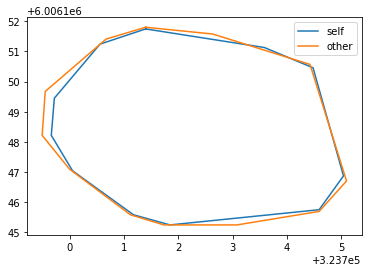

[[534 160]
 [533 161]
 [532 161]
 [531 161]
 [530 161]
 [529 161]
 [528 161]
 [527 162]
 [526 162]
 [525 162]
 [524 162]
 [523 162]
 [522 162]
 [521 162]
 [520 163]
 [519 163]
 [518 163]
 [517 163]
 [516 163]
 [515 164]
 [514 164]
 [513 165]
 [512 165]
 [511 166]
 [510 166]
 [509 167]
 [508 168]
 [507 169]
 [506 169]
 [505 170]
 [504 171]
 [503 172]
 [502 172]
 [501 173]
 [500 174]
 [499 175]
 [498 176]
 [497 177]
 [496 177]
 [495 178]
 [494 179]
 [493 179]
 [492 180]
 [491 181]
 [490 182]
 [489 182]
 [488 183]
 [487 184]
 [486 185]
 [486 186]
 [486 187]
 [485 188]
 [485 189]
 [484 190]
 [484 191]
 [483 192]
 [483 193]
 [483 194]
 [483 195]
 [483 196]
 [483 197]
 [482 198]
 [482 199]
 [482 200]
 [482 201]
 [482 202]
 [482 203]
 [483 204]
 [483 205]
 [483 206]
 [483 207]
 [484 208]
 [484 209]
 [484 210]
 [485 211]
 [485 212]
 [486 213]
 [486 214]
 [487 215]
 [487 216]
 [488 217]
 [489 218]
 [489 219]
 [490 219]
 [491 220]
 [492 221]
 [493 222]
 [494 223]
 [494 224]
 [495 225]
 [496 226]

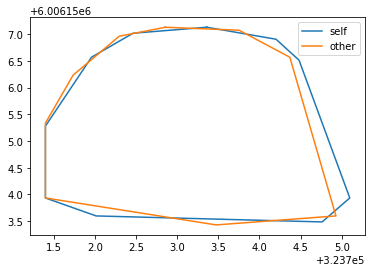

[[591 152]
 [590 153]
 [589 153]
 [588 153]
 [587 154]
 [586 154]
 [585 154]
 [584 155]
 [583 155]
 [582 155]
 [581 156]
 [580 156]
 [579 156]
 [578 157]
 [577 157]
 [576 157]
 [575 157]
 [574 158]
 [573 158]
 [572 158]
 [571 158]
 [570 159]
 [569 159]
 [568 160]
 [567 160]
 [566 160]
 [565 160]
 [564 161]
 [563 161]
 [562 162]
 [561 162]
 [560 162]
 [559 163]
 [558 164]
 [557 165]
 [556 166]
 [555 167]
 [555 168]
 [555 169]
 [555 170]
 [555 171]
 [555 172]
 [555 173]
 [555 174]
 [555 175]
 [555 176]
 [555 177]
 [555 178]
 [555 179]
 [555 180]
 [555 181]
 [555 182]
 [555 183]
 [555 184]
 [555 185]
 [555 186]
 [555 187]
 [555 188]
 [555 189]
 [555 190]
 [555 191]
 [555 192]
 [555 193]
 [556 194]
 [556 195]
 [556 196]
 [556 197]
 [556 198]
 [556 199]
 [556 200]
 [556 201]
 [556 202]
 [557 203]
 [557 204]
 [557 205]
 [557 206]
 [557 207]
 [558 208]
 [558 209]
 [558 210]
 [558 211]
 [559 212]
 [559 213]
 [559 214]
 [560 215]
 [560 216]
 [561 217]
 [562 218]
 [563 218]
 [564 218]
 [565 218]

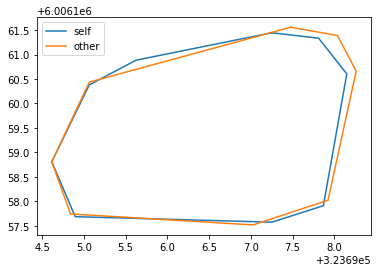

[[ 49 430]
 [ 48 431]
 [ 47 431]
 [ 46 431]
 [ 45 431]
 [ 44 432]
 [ 43 432]
 [ 42 433]
 [ 42 434]
 [ 41 435]
 [ 41 436]
 [ 40 437]
 [ 40 438]
 [ 40 439]
 [ 39 440]
 [ 39 441]
 [ 39 442]
 [ 39 443]
 [ 39 444]
 [ 39 445]
 [ 38 446]
 [ 38 447]
 [ 38 448]
 [ 38 449]
 [ 37 450]
 [ 37 451]
 [ 37 452]
 [ 37 453]
 [ 38 454]
 [ 38 455]
 [ 38 456]
 [ 38 457]
 [ 37 458]
 [ 37 459]
 [ 37 460]
 [ 37 461]
 [ 37 462]
 [ 37 463]
 [ 36 464]
 [ 36 465]
 [ 36 466]
 [ 36 467]
 [ 36 468]
 [ 36 469]
 [ 35 470]
 [ 35 471]
 [ 35 472]
 [ 35 473]
 [ 35 474]
 [ 34 475]
 [ 34 476]
 [ 34 477]
 [ 34 478]
 [ 33 479]
 [ 33 480]
 [ 33 481]
 [ 33 482]
 [ 33 483]
 [ 33 484]
 [ 33 485]
 [ 33 486]
 [ 33 487]
 [ 33 488]
 [ 33 489]
 [ 33 490]
 [ 33 491]
 [ 33 492]
 [ 33 493]
 [ 33 494]
 [ 33 495]
 [ 33 496]
 [ 34 497]
 [ 34 498]
 [ 34 499]
 [ 35 500]
 [ 35 501]
 [ 36 502]
 [ 36 503]
 [ 37 504]
 [ 37 505]
 [ 38 506]
 [ 39 507]
 [ 39 508]
 [ 40 509]
 [ 41 510]
 [ 42 511]
 [ 43 512]
 [ 44 513]
 [ 45 514]
 [ 46 515]
 [ 46 516]

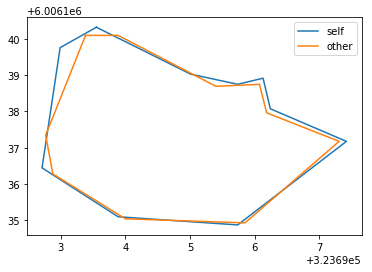

[[199 517]
 [198 518]
 [197 518]
 [196 518]
 [195 519]
 [194 520]
 [193 521]
 [192 521]
 [191 522]
 [190 523]
 [190 524]
 [189 525]
 [188 526]
 [187 527]
 [186 528]
 [186 529]
 [185 530]
 [185 531]
 [184 532]
 [184 533]
 [183 534]
 [182 535]
 [181 536]
 [181 537]
 [180 538]
 [179 539]
 [179 540]
 [178 541]
 [177 542]
 [176 543]
 [176 544]
 [175 545]
 [174 546]
 [174 547]
 [173 548]
 [172 549]
 [171 550]
 [171 551]
 [170 552]
 [170 553]
 [169 554]
 [168 555]
 [168 556]
 [168 557]
 [167 558]
 [167 559]
 [166 560]
 [165 561]
 [165 562]
 [165 563]
 [164 564]
 [164 565]
 [163 566]
 [163 567]
 [163 568]
 [163 569]
 [163 570]
 [163 571]
 [163 572]
 [163 573]
 [163 574]
 [163 575]
 [163 576]
 [164 577]
 [164 578]
 [164 579]
 [165 580]
 [165 581]
 [166 582]
 [167 583]
 [167 584]
 [168 585]
 [168 586]
 [169 587]
 [170 588]
 [171 588]
 [172 589]
 [173 589]
 [174 590]
 [175 590]
 [176 591]
 [177 591]
 [178 592]
 [179 592]
 [180 592]
 [181 592]
 [182 592]
 [183 593]
 [184 593]
 [185 593]
 [186 593]

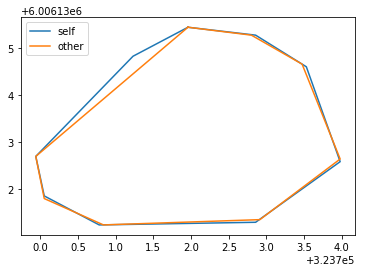

[[345 442]
 [344 443]
 [343 443]
 [342 443]
 [341 443]
 [340 443]
 [339 444]
 [338 444]
 [337 445]
 [336 445]
 [335 446]
 [334 447]
 [333 448]
 [333 449]
 [332 450]
 [331 450]
 [331 451]
 [330 452]
 [330 453]
 [329 454]
 [329 455]
 [329 456]
 [328 457]
 [328 458]
 [327 459]
 [326 460]
 [326 461]
 [325 462]
 [325 463]
 [324 464]
 [324 465]
 [324 466]
 [324 467]
 [323 468]
 [323 469]
 [323 470]
 [323 471]
 [322 472]
 [322 473]
 [322 474]
 [322 475]
 [322 476]
 [321 477]
 [321 478]
 [321 479]
 [321 480]
 [321 481]
 [321 482]
 [321 483]
 [321 484]
 [321 485]
 [321 486]
 [321 487]
 [321 488]
 [321 489]
 [321 490]
 [321 491]
 [322 492]
 [322 493]
 [322 494]
 [322 495]
 [323 496]
 [323 497]
 [323 498]
 [323 499]
 [324 500]
 [324 501]
 [325 502]
 [325 503]
 [326 504]
 [326 505]
 [327 506]
 [327 507]
 [328 508]
 [329 509]
 [330 510]
 [331 511]
 [331 512]
 [332 513]
 [333 514]
 [334 514]
 [335 515]
 [336 516]
 [337 517]
 [338 518]
 [339 519]
 [340 520]
 [341 521]
 [342 521]
 [343 521]
 [344 521]

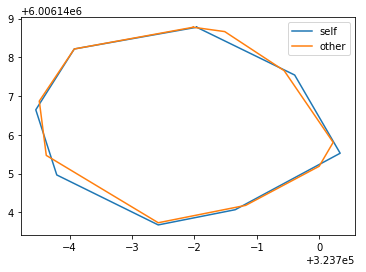

[[600 213]
 [599 214]
 [598 214]
 [597 214]
 [596 214]
 [595 214]
 [594 215]
 [593 215]
 [592 215]
 [591 215]
 [590 215]
 [589 215]
 [588 216]
 [587 216]
 [586 216]
 [585 216]
 [584 216]
 [583 216]
 [582 216]
 [581 216]
 [580 217]
 [579 217]
 [578 217]
 [577 217]
 [576 217]
 [575 217]
 [574 218]
 [573 218]
 [572 218]
 [571 218]
 [570 218]
 [569 219]
 [568 219]
 [567 219]
 [566 220]
 [565 220]
 [564 220]
 [563 221]
 [562 221]
 [561 222]
 [560 223]
 [559 224]
 [558 224]
 [558 225]
 [557 226]
 [556 227]
 [555 228]
 [555 229]
 [554 230]
 [553 231]
 [552 232]
 [552 233]
 [551 234]
 [550 235]
 [550 236]
 [549 237]
 [549 238]
 [548 239]
 [548 240]
 [548 241]
 [548 242]
 [548 243]
 [548 244]
 [548 245]
 [548 246]
 [548 247]
 [547 248]
 [548 249]
 [548 250]
 [548 251]
 [548 252]
 [548 253]
 [548 254]
 [548 255]
 [548 256]
 [548 257]
 [549 258]
 [549 259]
 [549 260]
 [549 261]
 [549 262]
 [549 263]
 [549 264]
 [550 265]
 [550 266]
 [550 267]
 [550 268]
 [550 269]
 [550 270]
 [550 271]
 [550 272]

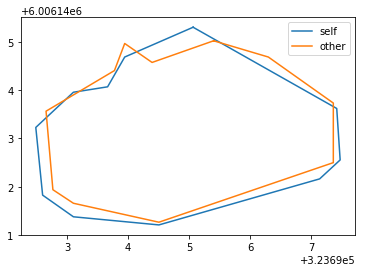

4it [00:04,  1.03s/it]

[[501  89]
 [500  90]
 [499  90]
 [498  90]
 [497  90]
 [496  91]
 [495  91]
 [494  91]
 [493  92]
 [492  92]
 [491  93]
 [490  94]
 [489  95]
 [488  95]
 [487  95]
 [486  96]
 [485  96]
 [484  97]
 [483  97]
 [482  98]
 [481  98]
 [480  99]
 [479 100]
 [478 101]
 [477 101]
 [476 102]
 [475 103]
 [474 103]
 [473 104]
 [472 105]
 [471 106]
 [470 107]
 [469 108]
 [468 109]
 [467 109]
 [466 110]
 [466 111]
 [465 112]
 [464 113]
 [464 114]
 [463 115]
 [462 116]
 [461 117]
 [461 118]
 [461 119]
 [460 120]
 [459 121]
 [459 122]
 [458 123]
 [457 124]
 [457 125]
 [457 126]
 [457 127]
 [456 128]
 [456 129]
 [456 130]
 [456 131]
 [455 132]
 [455 133]
 [455 134]
 [455 135]
 [456 136]
 [456 137]
 [456 138]
 [456 139]
 [456 140]
 [456 141]
 [456 142]
 [456 143]
 [456 144]
 [456 145]
 [456 146]
 [456 147]
 [456 148]
 [456 149]
 [456 150]
 [457 151]
 [457 152]
 [458 153]
 [459 154]
 [460 155]
 [461 156]
 [462 157]
 [463 158]
 [464 159]
 [465 159]
 [466 160]
 [466 161]
 [466 162]
 [466 163]
 [466 164]

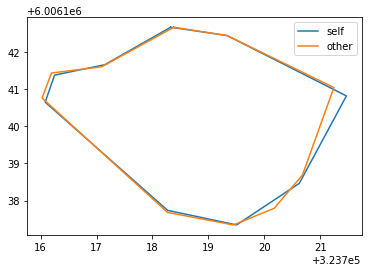

[[454  43]
 [453  44]
 [452  44]
 [451  44]
 [450  44]
 [449  44]
 [448  44]
 [447  44]
 [446  44]
 [445  45]
 [444  45]
 [443  45]
 [442  46]
 [441  46]
 [440  46]
 [439  47]
 [438  47]
 [437  47]
 [436  48]
 [435  48]
 [434  49]
 [433  50]
 [432  51]
 [431  51]
 [430  51]
 [429  51]
 [428  52]
 [427  53]
 [427  54]
 [426  55]
 [425  56]
 [424  56]
 [423  57]
 [422  57]
 [421  58]
 [421  59]
 [420  60]
 [420  61]
 [420  62]
 [419  63]
 [419  64]
 [419  65]
 [419  66]
 [418  67]
 [418  68]
 [418  69]
 [417  70]
 [417  71]
 [417  72]
 [416  73]
 [416  74]
 [416  75]
 [416  76]
 [415  77]
 [415  78]
 [415  79]
 [415  80]
 [415  81]
 [415  82]
 [414  83]
 [414  84]
 [414  85]
 [414  86]
 [414  87]
 [414  88]
 [413  89]
 [413  90]
 [413  91]
 [413  92]
 [413  93]
 [412  94]
 [412  95]
 [412  96]
 [412  97]
 [412  98]
 [411  99]
 [411 100]
 [410 101]
 [410 102]
 [410 103]
 [410 104]
 [409 105]
 [409 106]
 [408 107]
 [407 108]
 [407 109]
 [406 110]
 [406 111]
 [405 112]
 [405 113]
 [405 114]

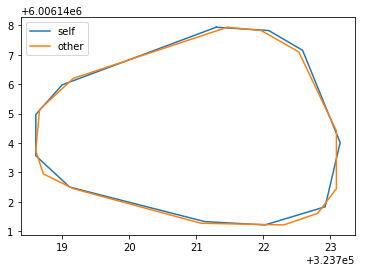

[[282 211]
 [281 212]
 [280 212]
 [279 212]
 [278 213]
 [277 213]
 [276 213]
 [275 214]
 [274 214]
 [273 214]
 [272 215]
 [271 215]
 [270 215]
 [269 216]
 [268 216]
 [267 216]
 [266 216]
 [265 217]
 [264 217]
 [263 217]
 [262 217]
 [261 217]
 [260 218]
 [259 218]
 [258 218]
 [257 218]
 [256 218]
 [255 218]
 [254 219]
 [253 219]
 [252 219]
 [251 219]
 [250 220]
 [249 220]
 [248 221]
 [247 221]
 [246 222]
 [245 222]
 [244 223]
 [243 223]
 [242 224]
 [241 224]
 [240 225]
 [239 226]
 [238 227]
 [237 227]
 [236 228]
 [235 229]
 [234 230]
 [233 231]
 [232 232]
 [232 233]
 [231 234]
 [230 235]
 [229 236]
 [229 237]
 [228 238]
 [228 239]
 [228 240]
 [227 241]
 [227 242]
 [227 243]
 [227 244]
 [227 245]
 [227 246]
 [227 247]
 [227 248]
 [227 249]
 [227 250]
 [228 251]
 [228 252]
 [228 253]
 [228 254]
 [228 255]
 [228 256]
 [229 257]
 [229 258]
 [229 259]
 [229 260]
 [229 261]
 [229 262]
 [229 263]
 [229 264]
 [229 265]
 [229 266]
 [229 267]
 [229 268]
 [229 269]
 [228 270]
 [228 271]
 [228 272]

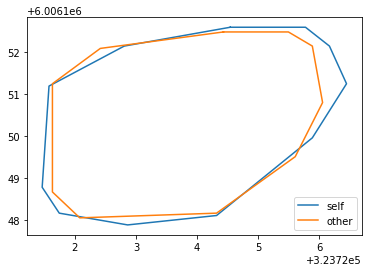

[[531 130]
 [530 131]
 [529 131]
 [528 131]
 [527 131]
 [526 131]
 [525 131]
 [524 131]
 [523 131]
 [522 131]
 [521 131]
 [520 131]
 [519 131]
 [518 131]
 [517 132]
 [516 132]
 [515 132]
 [514 132]
 [513 132]
 [512 132]
 [511 133]
 [510 133]
 [509 133]
 [508 133]
 [507 133]
 [506 134]
 [505 134]
 [504 134]
 [503 135]
 [502 135]
 [501 135]
 [500 135]
 [499 136]
 [498 136]
 [497 137]
 [496 137]
 [495 138]
 [494 138]
 [493 138]
 [492 139]
 [491 139]
 [490 140]
 [489 141]
 [488 142]
 [487 143]
 [486 143]
 [485 144]
 [484 145]
 [483 146]
 [482 147]
 [481 148]
 [480 149]
 [479 150]
 [478 151]
 [478 152]
 [477 153]
 [476 154]
 [475 155]
 [475 156]
 [474 157]
 [474 158]
 [473 159]
 [473 160]
 [473 161]
 [473 162]
 [472 163]
 [472 164]
 [472 165]
 [472 166]
 [473 167]
 [473 168]
 [473 169]
 [474 170]
 [474 171]
 [474 172]
 [474 173]
 [474 174]
 [474 175]
 [475 176]
 [475 177]
 [476 178]
 [476 179]
 [476 180]
 [476 181]
 [477 182]
 [477 183]
 [477 184]
 [478 185]
 [478 186]
 [478 187]
 [479 188]

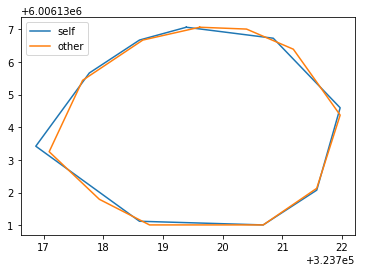

[[ 95 177]
 [ 94 178]
 [ 93 178]
 [ 92 178]
 [ 91 179]
 [ 90 179]
 [ 89 180]
 [ 88 180]
 [ 87 181]
 [ 86 182]
 [ 86 183]
 [ 85 184]
 [ 84 185]
 [ 84 186]
 [ 84 187]
 [ 83 188]
 [ 83 189]
 [ 83 190]
 [ 82 191]
 [ 82 192]
 [ 81 193]
 [ 81 194]
 [ 81 195]
 [ 81 196]
 [ 80 197]
 [ 80 198]
 [ 80 199]
 [ 79 200]
 [ 79 201]
 [ 78 202]
 [ 78 203]
 [ 77 204]
 [ 77 205]
 [ 76 206]
 [ 76 207]
 [ 75 208]
 [ 75 209]
 [ 74 210]
 [ 73 211]
 [ 72 212]
 [ 71 213]
 [ 70 214]
 [ 69 215]
 [ 68 216]
 [ 67 217]
 [ 66 217]
 [ 65 218]
 [ 64 219]
 [ 63 220]
 [ 62 221]
 [ 61 222]
 [ 60 223]
 [ 59 224]
 [ 58 225]
 [ 57 226]
 [ 56 227]
 [ 55 228]
 [ 54 229]
 [ 53 230]
 [ 53 231]
 [ 52 232]
 [ 51 233]
 [ 51 234]
 [ 50 235]
 [ 49 236]
 [ 49 237]
 [ 49 238]
 [ 48 239]
 [ 48 240]
 [ 47 241]
 [ 46 242]
 [ 45 243]
 [ 44 244]
 [ 43 244]
 [ 42 245]
 [ 42 246]
 [ 42 247]
 [ 41 248]
 [ 41 249]
 [ 41 250]
 [ 41 251]
 [ 41 252]
 [ 41 253]
 [ 41 254]
 [ 41 255]
 [ 41 256]
 [ 41 257]
 [ 41 258]
 [ 41 259]
 [ 41 260]
 [ 41 261]

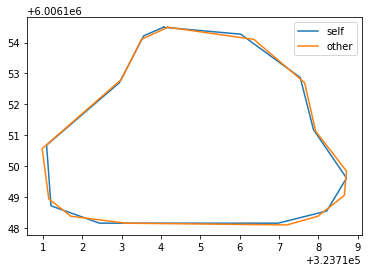

[[111 432]
 [110 433]
 [109 433]
 [108 433]
 [107 433]
 [106 434]
 [105 434]
 [104 434]
 [103 434]
 [102 435]
 [101 435]
 [100 436]
 [ 99 436]
 [ 98 437]
 [ 97 438]
 [ 96 439]
 [ 95 440]
 [ 94 441]
 [ 93 442]
 [ 92 443]
 [ 91 444]
 [ 91 445]
 [ 90 446]
 [ 90 447]
 [ 89 448]
 [ 89 449]
 [ 88 450]
 [ 88 451]
 [ 87 452]
 [ 87 453]
 [ 86 454]
 [ 86 455]
 [ 86 456]
 [ 86 457]
 [ 86 458]
 [ 85 459]
 [ 85 460]
 [ 85 461]
 [ 85 462]
 [ 84 463]
 [ 84 464]
 [ 84 465]
 [ 84 466]
 [ 84 467]
 [ 84 468]
 [ 84 469]
 [ 83 470]
 [ 83 471]
 [ 83 472]
 [ 83 473]
 [ 82 474]
 [ 82 475]
 [ 82 476]
 [ 81 477]
 [ 80 478]
 [ 80 479]
 [ 79 480]
 [ 79 481]
 [ 78 482]
 [ 78 483]
 [ 77 484]
 [ 76 484]
 [ 75 485]
 [ 74 486]
 [ 73 487]
 [ 72 488]
 [ 72 489]
 [ 71 490]
 [ 71 491]
 [ 70 492]
 [ 70 493]
 [ 69 494]
 [ 68 495]
 [ 68 496]
 [ 67 497]
 [ 67 498]
 [ 67 499]
 [ 67 500]
 [ 67 501]
 [ 67 502]
 [ 67 503]
 [ 67 504]
 [ 68 505]
 [ 68 506]
 [ 68 507]
 [ 68 508]
 [ 69 509]
 [ 69 510]
 [ 70 511]
 [ 71 512]
 [ 71 513]

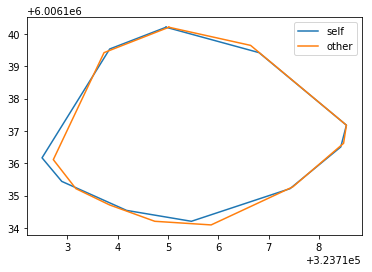

[[289 519]
 [288 520]
 [287 520]
 [286 520]
 [285 521]
 [284 521]
 [283 522]
 [282 523]
 [281 523]
 [280 524]
 [279 525]
 [278 526]
 [277 527]
 [276 528]
 [275 529]
 [274 530]
 [273 530]
 [272 531]
 [271 532]
 [271 533]
 [270 534]
 [269 535]
 [268 536]
 [267 537]
 [266 538]
 [265 539]
 [264 540]
 [263 541]
 [262 542]
 [261 543]
 [260 544]
 [259 545]
 [258 546]
 [257 547]
 [257 548]
 [257 549]
 [256 550]
 [256 551]
 [255 552]
 [255 553]
 [255 554]
 [255 555]
 [256 556]
 [256 557]
 [255 558]
 [255 559]
 [255 560]
 [255 561]
 [256 562]
 [257 563]
 [256 564]
 [256 565]
 [257 566]
 [258 567]
 [258 568]
 [258 569]
 [258 570]
 [258 571]
 [258 572]
 [259 573]
 [259 574]
 [259 575]
 [259 576]
 [260 577]
 [260 578]
 [261 578]
 [262 579]
 [263 580]
 [263 581]
 [263 582]
 [264 583]
 [264 584]
 [265 585]
 [266 586]
 [267 587]
 [268 588]
 [269 589]
 [269 590]
 [270 591]
 [271 592]
 [272 592]
 [273 593]
 [274 594]
 [275 595]
 [276 595]
 [277 596]
 [278 596]
 [279 597]
 [280 597]
 [281 598]
 [282 598]

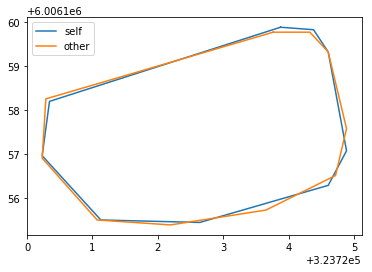

[[509  62]
 [508  63]
 [507  63]
 [506  63]
 [505  63]
 [504  63]
 [503  64]
 [502  64]
 [501  65]
 [500  65]
 [499  65]
 [498  66]
 [497  66]
 [496  67]
 [495  67]
 [494  68]
 [493  68]
 [492  69]
 [492  70]
 [491  71]
 [490  72]
 [490  73]
 [490  74]
 [490  75]
 [489  76]
 [489  77]
 [489  78]
 [489  79]
 [489  80]
 [489  81]
 [489  82]
 [489  83]
 [489  84]
 [489  85]
 [489  86]
 [489  87]
 [489  88]
 [489  89]
 [489  90]
 [489  91]
 [489  92]
 [489  93]
 [489  94]
 [489  95]
 [489  96]
 [489  97]
 [489  98]
 [489  99]
 [489 100]
 [488 101]
 [488 102]
 [488 103]
 [488 104]
 [488 105]
 [488 106]
 [488 107]
 [488 108]
 [488 109]
 [488 110]
 [488 111]
 [488 112]
 [487 113]
 [487 114]
 [487 115]
 [487 116]
 [487 117]
 [487 118]
 [487 119]
 [487 120]
 [487 121]
 [487 122]
 [487 123]
 [487 124]
 [487 125]
 [487 126]
 [488 127]
 [488 128]
 [489 129]
 [490 130]
 [491 131]
 [492 132]
 [493 133]
 [494 133]
 [495 133]
 [496 133]
 [497 134]
 [498 134]
 [499 134]
 [500 134]
 [501 134]
 [502 134]

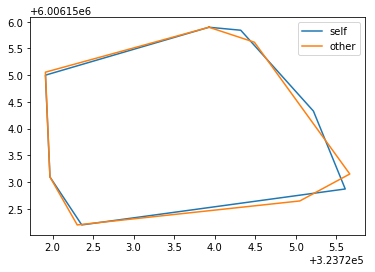

[[235  19]
 [234  20]
 [233  20]
 [232  20]
 [231  20]
 [230  20]
 [229  20]
 [228  21]
 [227  21]
 [226  21]
 [225  21]
 [224  21]
 [223  21]
 [222  22]
 [221  22]
 [220  22]
 [219  22]
 [218  23]
 [217  23]
 [216  23]
 [215  24]
 [214  24]
 [213  24]
 [212  25]
 [211  25]
 [210  26]
 [209  26]
 [208  26]
 [207  26]
 [206  27]
 [205  27]
 [204  28]
 [203  28]
 [202  29]
 [201  29]
 [200  30]
 [199  30]
 [198  31]
 [197  32]
 [196  32]
 [195  33]
 [194  34]
 [193  35]
 [192  36]
 [191  37]
 [190  38]
 [189  39]
 [188  40]
 [188  41]
 [188  42]
 [188  43]
 [188  44]
 [187  45]
 [187  46]
 [187  47]
 [187  48]
 [187  49]
 [187  50]
 [187  51]
 [187  52]
 [187  53]
 [187  54]
 [187  55]
 [187  56]
 [187  57]
 [187  58]
 [187  59]
 [187  60]
 [187  61]
 [187  62]
 [187  63]
 [187  64]
 [187  65]
 [187  66]
 [187  67]
 [187  68]
 [187  69]
 [187  70]
 [187  71]
 [187  72]
 [187  73]
 [187  74]
 [187  75]
 [187  76]
 [187  77]
 [187  78]
 [187  79]
 [187  80]
 [187  81]
 [187  82]
 [187  83]

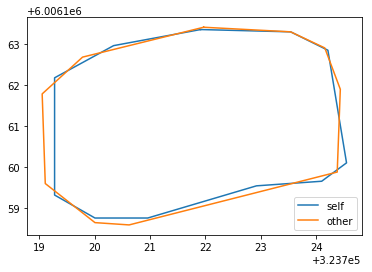

[[266 294]
 [265 295]
 [264 295]
 [263 295]
 [262 295]
 [261 295]
 [260 295]
 [259 296]
 [258 296]
 [257 296]
 [256 296]
 [255 296]
 [254 297]
 [253 297]
 [252 297]
 [251 298]
 [250 298]
 [250 299]
 [249 300]
 [248 301]
 [247 302]
 [247 303]
 [246 304]
 [246 305]
 [245 306]
 [245 307]
 [245 308]
 [245 309]
 [245 310]
 [245 311]
 [246 312]
 [246 313]
 [246 314]
 [246 315]
 [247 316]
 [247 317]
 [247 318]
 [247 319]
 [248 320]
 [248 321]
 [249 322]
 [249 323]
 [249 324]
 [250 325]
 [250 326]
 [250 327]
 [251 328]
 [251 329]
 [251 330]
 [251 331]
 [251 332]
 [252 333]
 [252 334]
 [252 335]
 [252 336]
 [252 337]
 [253 338]
 [253 339]
 [253 340]
 [253 341]
 [253 342]
 [253 343]
 [254 344]
 [254 345]
 [254 346]
 [254 347]
 [254 348]
 [254 349]
 [254 350]
 [255 351]
 [255 352]
 [255 353]
 [256 354]
 [256 355]
 [256 356]
 [256 357]
 [257 358]
 [257 359]
 [257 360]
 [258 361]
 [258 362]
 [258 363]
 [259 364]
 [260 365]
 [261 366]
 [262 367]
 [263 367]
 [264 368]
 [265 368]
 [266 368]
 [267 369]

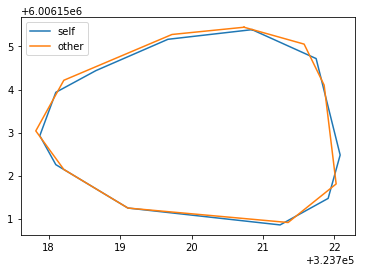

[[ 85 109]
 [ 84 110]
 [ 83 110]
 [ 82 110]
 [ 81 110]
 [ 80 110]
 [ 79 111]
 [ 78 111]
 [ 77 111]
 [ 76 111]
 [ 75 111]
 [ 74 111]
 [ 73 111]
 [ 72 111]
 [ 71 111]
 [ 70 112]
 [ 69 112]
 [ 68 112]
 [ 67 111]
 [ 66 111]
 [ 65 112]
 [ 64 112]
 [ 63 112]
 [ 62 113]
 [ 61 113]
 [ 60 114]
 [ 59 114]
 [ 58 115]
 [ 57 116]
 [ 56 117]
 [ 55 118]
 [ 54 119]
 [ 53 120]
 [ 53 121]
 [ 52 122]
 [ 51 123]
 [ 51 124]
 [ 50 125]
 [ 49 126]
 [ 48 127]
 [ 48 128]
 [ 47 129]
 [ 46 130]
 [ 46 131]
 [ 45 132]
 [ 45 133]
 [ 44 134]
 [ 44 135]
 [ 43 136]
 [ 43 137]
 [ 43 138]
 [ 42 139]
 [ 42 140]
 [ 41 141]
 [ 41 142]
 [ 40 143]
 [ 40 144]
 [ 40 145]
 [ 39 146]
 [ 39 147]
 [ 38 148]
 [ 38 149]
 [ 38 150]
 [ 38 151]
 [ 38 152]
 [ 38 153]
 [ 38 154]
 [ 38 155]
 [ 38 156]
 [ 38 157]
 [ 38 158]
 [ 38 159]
 [ 39 160]
 [ 39 161]
 [ 40 162]
 [ 41 163]
 [ 41 164]
 [ 42 165]
 [ 43 166]
 [ 44 167]
 [ 45 168]
 [ 46 169]
 [ 47 169]
 [ 48 170]
 [ 49 170]
 [ 50 171]
 [ 51 171]
 [ 52 172]
 [ 53 172]
 [ 54 172]
 [ 55 173]

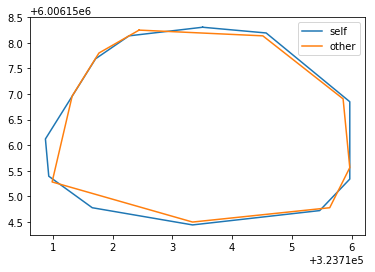

[[470 479]
 [469 480]
 [468 480]
 [467 480]
 [466 480]
 [465 480]
 [464 480]
 [463 481]
 [462 481]
 [461 481]
 [460 481]
 [459 482]
 [458 482]
 [457 482]
 [456 483]
 [455 483]
 [454 484]
 [453 484]
 [452 485]
 [451 486]
 [450 486]
 [449 487]
 [448 487]
 [447 488]
 [446 488]
 [445 489]
 [444 489]
 [443 490]
 [442 491]
 [441 491]
 [440 492]
 [439 493]
 [438 494]
 [437 494]
 [436 495]
 [435 495]
 [434 496]
 [433 497]
 [433 498]
 [432 499]
 [432 500]
 [431 501]
 [431 502]
 [430 503]
 [430 504]
 [430 505]
 [429 506]
 [429 507]
 [429 508]
 [428 509]
 [428 510]
 [428 511]
 [428 512]
 [428 513]
 [428 514]
 [428 515]
 [428 516]
 [427 517]
 [427 518]
 [427 519]
 [427 520]
 [427 521]
 [427 522]
 [427 523]
 [427 524]
 [427 525]
 [427 526]
 [427 527]
 [427 528]
 [427 529]
 [427 530]
 [427 531]
 [427 532]
 [427 533]
 [428 534]
 [428 535]
 [428 536]
 [429 537]
 [429 538]
 [430 539]
 [430 540]
 [431 541]
 [431 542]
 [432 543]
 [433 544]
 [433 545]
 [434 546]
 [435 547]
 [436 548]
 [437 549]
 [438 550]

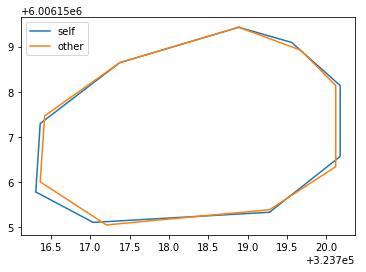

5it [00:06,  1.26s/it]

[[232 456]
 [231 457]
 [230 457]
 [229 457]
 [228 457]
 [227 457]
 [226 457]
 [225 457]
 [224 457]
 [223 457]
 [222 458]
 [221 458]
 [220 458]
 [219 458]
 [218 459]
 [217 459]
 [216 459]
 [215 459]
 [214 459]
 [213 459]
 [212 459]
 [211 459]
 [210 460]
 [209 460]
 [208 460]
 [207 460]
 [206 460]
 [205 460]
 [204 460]
 [203 460]
 [202 460]
 [201 460]
 [200 460]
 [199 460]
 [198 460]
 [197 460]
 [196 460]
 [195 460]
 [194 460]
 [193 460]
 [192 460]
 [191 460]
 [190 460]
 [189 461]
 [188 461]
 [187 461]
 [186 461]
 [185 462]
 [184 462]
 [183 463]
 [182 463]
 [181 463]
 [180 464]
 [179 465]
 [178 465]
 [177 466]
 [176 467]
 [175 468]
 [174 469]
 [173 470]
 [172 471]
 [171 472]
 [170 473]
 [169 474]
 [168 474]
 [167 475]
 [166 475]
 [165 476]
 [164 477]
 [163 478]
 [162 479]
 [161 480]
 [161 481]
 [160 482]
 [159 483]
 [158 483]
 [157 484]
 [157 485]
 [156 486]
 [156 487]
 [156 488]
 [156 489]
 [155 490]
 [155 491]
 [155 492]
 [155 493]
 [155 494]
 [155 495]
 [155 496]
 [155 497]
 [156 498]

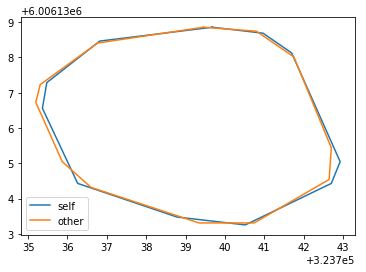

[[129  43]
 [128  44]
 [127  44]
 [126  44]
 [125  44]
 [124  45]
 [123  45]
 [122  45]
 [121  46]
 [120  46]
 [119  47]
 [118  47]
 [117  48]
 [116  48]
 [115  48]
 [114  48]
 [113  49]
 [112  49]
 [111  50]
 [110  51]
 [109  51]
 [108  51]
 [107  52]
 [106  52]
 [105  53]
 [104  54]
 [103  55]
 [102  56]
 [101  57]
 [100  58]
 [ 99  59]
 [ 99  60]
 [ 98  61]
 [ 98  62]
 [ 98  63]
 [ 98  64]
 [ 97  65]
 [ 97  66]
 [ 97  67]
 [ 97  68]
 [ 96  69]
 [ 96  70]
 [ 96  71]
 [ 96  72]
 [ 96  73]
 [ 96  74]
 [ 95  75]
 [ 95  76]
 [ 95  77]
 [ 94  78]
 [ 94  79]
 [ 94  80]
 [ 93  81]
 [ 93  82]
 [ 93  83]
 [ 93  84]
 [ 93  85]
 [ 93  86]
 [ 93  87]
 [ 92  88]
 [ 92  89]
 [ 92  90]
 [ 92  91]
 [ 92  92]
 [ 92  93]
 [ 92  94]
 [ 91  95]
 [ 91  96]
 [ 91  97]
 [ 91  98]
 [ 91  99]
 [ 90 100]
 [ 90 101]
 [ 90 102]
 [ 90 103]
 [ 90 104]
 [ 89 105]
 [ 89 106]
 [ 89 107]
 [ 88 108]
 [ 88 109]
 [ 87 110]
 [ 87 111]
 [ 86 112]
 [ 86 113]
 [ 85 114]
 [ 85 115]
 [ 84 116]
 [ 84 117]
 [ 83 118]
 [ 83 119]

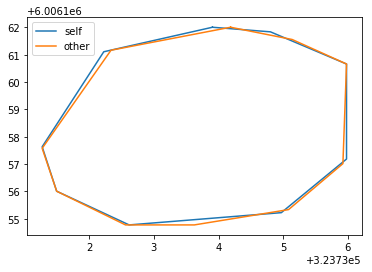

[[210 129]
 [209 130]
 [208 130]
 [207 130]
 [206 130]
 [205 130]
 [204 130]
 [203 130]
 [202 130]
 [201 131]
 [200 131]
 [199 131]
 [198 131]
 [197 131]
 [196 131]
 [195 131]
 [194 131]
 [193 132]
 [192 132]
 [191 132]
 [190 132]
 [189 133]
 [188 133]
 [187 133]
 [186 133]
 [185 133]
 [184 134]
 [183 134]
 [182 134]
 [181 135]
 [180 135]
 [179 135]
 [178 136]
 [177 136]
 [176 137]
 [175 137]
 [174 138]
 [173 138]
 [172 139]
 [171 139]
 [170 140]
 [169 140]
 [168 141]
 [167 142]
 [166 143]
 [165 144]
 [164 145]
 [163 146]
 [162 147]
 [161 148]
 [160 149]
 [159 150]
 [158 151]
 [158 152]
 [157 153]
 [157 154]
 [156 155]
 [156 156]
 [155 157]
 [155 158]
 [155 159]
 [155 160]
 [155 161]
 [155 162]
 [155 163]
 [154 164]
 [155 165]
 [155 166]
 [155 167]
 [155 168]
 [155 169]
 [155 170]
 [155 171]
 [155 172]
 [155 173]
 [155 174]
 [155 175]
 [156 176]
 [156 177]
 [156 178]
 [156 179]
 [157 180]
 [157 181]
 [157 182]
 [157 183]
 [157 184]
 [158 185]
 [158 186]
 [158 187]
 [158 188]
 [158 189]

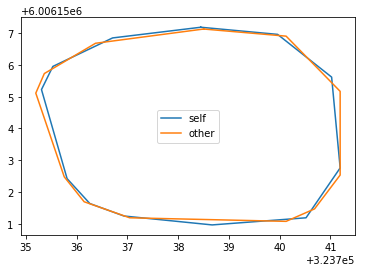

[[368 483]
 [367 484]
 [366 484]
 [365 485]
 [364 485]
 [363 486]
 [362 486]
 [361 487]
 [360 487]
 [359 487]
 [358 488]
 [357 489]
 [356 489]
 [355 490]
 [354 490]
 [353 491]
 [352 492]
 [351 492]
 [350 492]
 [349 493]
 [348 494]
 [347 494]
 [346 495]
 [345 496]
 [344 496]
 [343 496]
 [342 497]
 [341 497]
 [340 498]
 [339 498]
 [338 499]
 [337 499]
 [336 500]
 [335 500]
 [334 501]
 [333 501]
 [332 501]
 [331 502]
 [330 502]
 [329 502]
 [328 502]
 [327 503]
 [326 503]
 [325 503]
 [324 504]
 [323 504]
 [322 504]
 [321 504]
 [320 505]
 [319 505]
 [318 505]
 [317 506]
 [316 506]
 [315 507]
 [314 507]
 [313 508]
 [312 508]
 [311 508]
 [310 508]
 [309 509]
 [308 509]
 [307 510]
 [306 511]
 [305 511]
 [304 512]
 [303 513]
 [302 513]
 [301 514]
 [300 515]
 [299 516]
 [298 516]
 [297 517]
 [296 518]
 [295 518]
 [294 519]
 [293 520]
 [292 521]
 [291 522]
 [291 523]
 [290 524]
 [290 525]
 [290 526]
 [289 527]
 [289 528]
 [289 529]
 [289 530]
 [289 531]
 [289 532]
 [289 533]
 [289 534]
 [289 535]

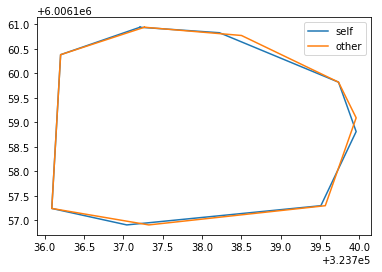

[[552 435]
 [551 436]
 [550 436]
 [549 437]
 [548 438]
 [547 439]
 [547 440]
 [547 441]
 [547 442]
 [547 443]
 [546 444]
 [546 445]
 [546 446]
 [546 447]
 [546 448]
 [546 449]
 [546 450]
 [546 451]
 [546 452]
 [546 453]
 [546 454]
 [546 455]
 [546 456]
 [546 457]
 [546 458]
 [546 459]
 [546 460]
 [546 461]
 [546 462]
 [546 463]
 [546 464]
 [546 465]
 [546 466]
 [545 467]
 [545 468]
 [545 469]
 [545 470]
 [544 471]
 [544 472]
 [544 473]
 [544 474]
 [544 475]
 [544 476]
 [543 477]
 [543 478]
 [543 479]
 [543 480]
 [543 481]
 [544 482]
 [544 483]
 [544 484]
 [545 485]
 [545 486]
 [545 487]
 [546 488]
 [547 489]
 [547 490]
 [548 491]
 [548 492]
 [549 493]
 [550 494]
 [550 495]
 [551 496]
 [552 497]
 [553 498]
 [554 499]
 [555 500]
 [555 501]
 [556 502]
 [557 503]
 [557 504]
 [558 505]
 [559 506]
 [560 507]
 [560 508]
 [561 509]
 [562 509]
 [563 510]
 [564 511]
 [565 511]
 [566 511]
 [567 511]
 [568 511]
 [569 512]
 [570 512]
 [571 512]
 [572 513]
 [573 513]
 [574 513]
 [575 514]
 [576 514]

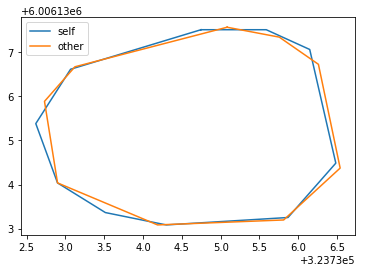

6it [00:07,  1.15s/it]

[[292 208]
 [291 209]
 [290 209]
 [289 209]
 [288 209]
 [287 210]
 [286 210]
 [285 210]
 [284 210]
 [283 211]
 [282 211]
 [281 212]
 [280 212]
 [279 212]
 [278 213]
 [277 213]
 [276 214]
 [275 215]
 [274 215]
 [273 216]
 [272 216]
 [271 217]
 [270 218]
 [269 218]
 [268 219]
 [267 220]
 [266 221]
 [266 222]
 [266 223]
 [266 224]
 [267 225]
 [267 226]
 [266 227]
 [266 228]
 [265 229]
 [264 230]
 [263 231]
 [262 232]
 [261 233]
 [260 234]
 [260 235]
 [259 236]
 [259 237]
 [258 238]
 [258 239]
 [257 240]
 [256 240]
 [255 241]
 [254 242]
 [253 242]
 [253 243]
 [252 244]
 [252 245]
 [251 246]
 [251 247]
 [250 248]
 [250 249]
 [250 250]
 [250 251]
 [249 252]
 [248 253]
 [247 253]
 [246 254]
 [245 254]
 [244 254]
 [244 255]
 [243 256]
 [242 257]
 [242 258]
 [241 259]
 [240 260]
 [240 261]
 [239 262]
 [239 263]
 [238 264]
 [237 265]
 [236 265]
 [235 266]
 [234 267]
 [234 268]
 [234 269]
 [234 270]
 [234 271]
 [234 272]
 [234 273]
 [235 274]
 [235 275]
 [236 276]
 [236 277]
 [236 278]
 [237 279]

[[471 396]
 [470 397]
 [469 397]
 [468 398]
 [467 398]
 [466 399]
 [465 399]
 [464 400]
 [464 401]
 [463 402]
 [462 403]
 [461 404]
 [461 405]
 [461 406]
 [460 407]
 [460 408]
 [459 409]
 [459 410]
 [459 411]
 [458 412]
 [458 413]
 [457 414]
 [457 415]
 [456 416]
 [456 417]
 [455 418]
 [455 419]
 [454 420]
 [454 421]
 [453 422]
 [453 423]
 [452 424]
 [451 425]
 [451 426]
 [450 427]
 [450 428]
 [449 429]
 [448 430]
 [448 431]
 [447 432]
 [447 433]
 [446 434]
 [446 435]
 [446 436]
 [445 437]
 [445 438]
 [444 439]
 [444 440]
 [443 441]
 [443 442]
 [443 443]
 [443 444]
 [442 445]
 [442 446]
 [442 447]
 [442 448]
 [441 449]
 [441 450]
 [441 451]
 [441 452]
 [441 453]
 [441 454]
 [441 455]
 [440 456]
 [440 457]
 [440 458]
 [440 459]
 [440 460]
 [440 461]
 [440 462]
 [440 463]
 [440 464]
 [440 465]
 [439 466]
 [439 467]
 [439 468]
 [439 469]
 [439 470]
 [439 471]
 [440 472]
 [440 473]
 [440 474]
 [440 475]
 [440 476]
 [440 477]
 [440 478]
 [440 479]
 [440 480]
 [440 481]
 [441 482]
 [441 483]

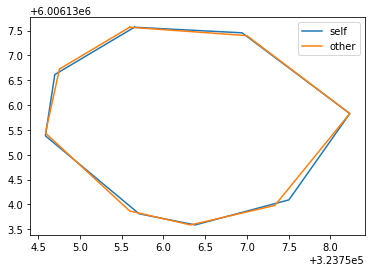

[[537 182]
 [536 183]
 [535 183]
 [534 183]
 [533 183]
 [532 183]
 [531 184]
 [530 184]
 [529 185]
 [528 186]
 [527 187]
 [526 188]
 [525 189]
 [524 190]
 [524 191]
 [523 192]
 [523 193]
 [522 194]
 [521 195]
 [521 196]
 [520 197]
 [519 198]
 [519 199]
 [518 200]
 [517 201]
 [517 202]
 [516 203]
 [516 204]
 [515 205]
 [515 206]
 [514 207]
 [514 208]
 [514 209]
 [513 210]
 [513 211]
 [513 212]
 [512 213]
 [512 214]
 [512 215]
 [512 216]
 [512 217]
 [512 218]
 [512 219]
 [512 220]
 [512 221]
 [511 222]
 [511 223]
 [511 224]
 [511 225]
 [511 226]
 [511 227]
 [511 228]
 [511 229]
 [511 230]
 [511 231]
 [511 232]
 [511 233]
 [511 234]
 [511 235]
 [512 236]
 [512 237]
 [512 238]
 [512 239]
 [512 240]
 [512 241]
 [512 242]
 [512 243]
 [512 244]
 [512 245]
 [513 246]
 [513 247]
 [513 248]
 [514 249]
 [514 250]
 [514 251]
 [515 252]
 [515 253]
 [516 254]
 [517 255]
 [517 256]
 [518 257]
 [519 258]
 [520 259]
 [520 260]
 [521 261]
 [522 262]
 [523 263]
 [524 264]
 [525 264]
 [526 265]
 [527 265]

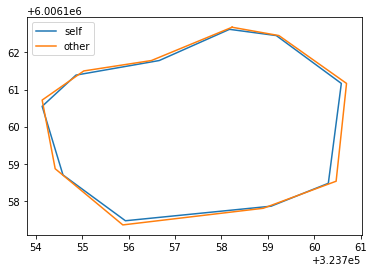

[[214 176]
 [213 177]
 [212 177]
 [211 177]
 [210 177]
 [209 178]
 [208 179]
 [207 180]
 [206 181]
 [206 182]
 [205 183]
 [205 184]
 [205 185]
 [204 186]
 [204 187]
 [203 188]
 [203 189]
 [203 190]
 [202 191]
 [202 192]
 [202 193]
 [202 194]
 [201 195]
 [201 196]
 [201 197]
 [201 198]
 [201 199]
 [201 200]
 [201 201]
 [201 202]
 [201 203]
 [201 204]
 [200 205]
 [200 206]
 [200 207]
 [200 208]
 [200 209]
 [201 210]
 [201 211]
 [201 212]
 [201 213]
 [201 214]
 [201 215]
 [201 216]
 [201 217]
 [201 218]
 [201 219]
 [201 220]
 [201 221]
 [201 222]
 [201 223]
 [201 224]
 [201 225]
 [201 226]
 [201 227]
 [201 228]
 [201 229]
 [201 230]
 [201 231]
 [201 232]
 [201 233]
 [201 234]
 [201 235]
 [202 236]
 [202 237]
 [202 238]
 [202 239]
 [202 240]
 [202 241]
 [202 242]
 [202 243]
 [202 244]
 [202 245]
 [202 246]
 [202 247]
 [202 248]
 [202 249]
 [202 250]
 [202 251]
 [203 252]
 [203 253]
 [203 254]
 [203 255]
 [203 256]
 [204 257]
 [204 258]
 [204 259]
 [204 260]
 [204 261]
 [205 262]
 [205 263]

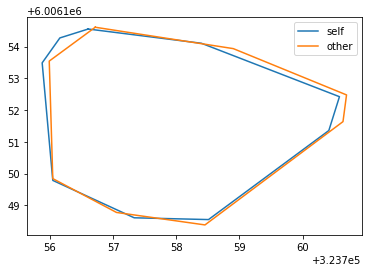

[[295 451]
 [294 452]
 [293 452]
 [292 452]
 [291 452]
 [290 452]
 [289 452]
 [288 453]
 [287 453]
 [286 453]
 [285 453]
 [284 454]
 [283 454]
 [282 455]
 [281 455]
 [280 455]
 [279 456]
 [278 457]
 [277 457]
 [276 458]
 [275 459]
 [274 460]
 [273 461]
 [272 462]
 [272 463]
 [271 464]
 [271 465]
 [270 466]
 [270 467]
 [270 468]
 [270 469]
 [269 470]
 [269 471]
 [269 472]
 [269 473]
 [268 474]
 [268 475]
 [268 476]
 [268 477]
 [268 478]
 [267 479]
 [267 480]
 [267 481]
 [267 482]
 [267 483]
 [267 484]
 [267 485]
 [266 486]
 [266 487]
 [266 488]
 [266 489]
 [266 490]
 [266 491]
 [266 492]
 [266 493]
 [265 494]
 [265 495]
 [265 496]
 [265 497]
 [265 498]
 [265 499]
 [265 500]
 [265 501]
 [265 502]
 [264 503]
 [264 504]
 [264 505]
 [264 506]
 [264 507]
 [264 508]
 [264 509]
 [264 510]
 [264 511]
 [264 512]
 [264 513]
 [264 514]
 [265 515]
 [265 516]
 [265 517]
 [265 518]
 [266 519]
 [266 520]
 [266 521]
 [267 522]
 [267 523]
 [268 524]
 [269 525]
 [270 526]
 [270 527]
 [271 528]
 [272 528]

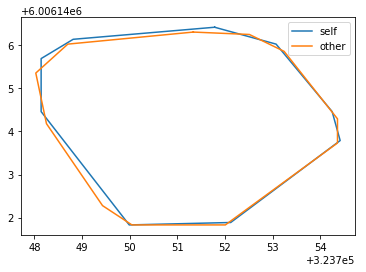

[[232 433]
 [231 434]
 [230 434]
 [229 435]
 [228 436]
 [227 436]
 [227 437]
 [227 438]
 [226 439]
 [226 440]
 [226 441]
 [226 442]
 [225 443]
 [225 444]
 [226 445]
 [226 446]
 [226 447]
 [226 448]
 [226 449]
 [226 450]
 [226 451]
 [226 452]
 [226 453]
 [226 454]
 [226 455]
 [226 456]
 [226 457]
 [226 458]
 [226 459]
 [226 460]
 [226 461]
 [226 462]
 [226 463]
 [226 464]
 [226 465]
 [225 466]
 [225 467]
 [225 468]
 [225 469]
 [225 470]
 [224 471]
 [224 472]
 [224 473]
 [224 474]
 [223 475]
 [223 476]
 [223 477]
 [223 478]
 [223 479]
 [223 480]
 [224 481]
 [224 482]
 [224 483]
 [224 484]
 [225 485]
 [225 486]
 [226 487]
 [226 488]
 [227 489]
 [227 490]
 [228 491]
 [228 492]
 [229 493]
 [229 494]
 [230 495]
 [231 496]
 [232 497]
 [232 498]
 [233 499]
 [234 500]
 [235 501]
 [236 502]
 [236 503]
 [237 504]
 [238 505]
 [239 506]
 [239 507]
 [240 508]
 [241 508]
 [242 509]
 [243 510]
 [244 510]
 [245 511]
 [246 511]
 [247 512]
 [248 512]
 [249 512]
 [250 512]
 [251 512]
 [252 513]
 [253 513]

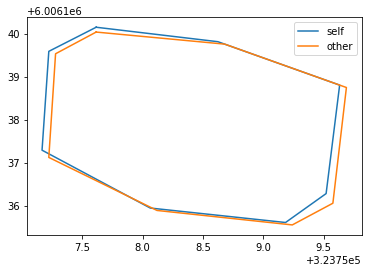

[[294 385]
 [293 386]
 [292 386]
 [291 386]
 [290 386]
 [289 386]
 [288 386]
 [287 386]
 [286 386]
 [285 387]
 [284 387]
 [283 388]
 [282 389]
 [281 389]
 [280 390]
 [279 390]
 [278 390]
 [277 391]
 [276 391]
 [275 391]
 [274 392]
 [273 392]
 [272 393]
 [271 393]
 [270 394]
 [269 395]
 [268 396]
 [267 397]
 [266 398]
 [265 399]
 [264 399]
 [263 400]
 [263 401]
 [262 402]
 [261 403]
 [261 404]
 [261 405]
 [260 406]
 [260 407]
 [259 408]
 [259 409]
 [258 410]
 [258 411]
 [257 412]
 [256 413]
 [255 414]
 [254 414]
 [253 415]
 [252 415]
 [251 416]
 [250 416]
 [249 417]
 [248 418]
 [247 419]
 [247 420]
 [246 421]
 [245 422]
 [244 422]
 [243 423]
 [242 424]
 [242 425]
 [242 426]
 [242 427]
 [242 428]
 [242 429]
 [242 430]
 [243 431]
 [243 432]
 [243 433]
 [243 434]
 [244 435]
 [244 436]
 [245 436]
 [246 437]
 [247 438]
 [247 439]
 [248 440]
 [249 441]
 [250 441]
 [251 442]
 [252 443]
 [253 444]
 [254 444]
 [255 445]
 [256 446]
 [257 446]
 [258 447]
 [259 448]
 [260 449]
 [261 449]
 [262 450]

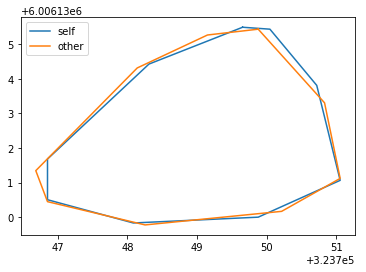

[[384 139]
 [383 140]
 [382 140]
 [382 141]
 [381 142]
 [380 143]
 [380 144]
 [380 145]
 [380 146]
 [380 147]
 [379 148]
 [379 149]
 [379 150]
 [379 151]
 [379 152]
 [379 153]
 [379 154]
 [378 155]
 [378 156]
 [378 157]
 [378 158]
 [378 159]
 [378 160]
 [377 161]
 [377 162]
 [377 163]
 [377 164]
 [377 165]
 [377 166]
 [377 167]
 [377 168]
 [377 169]
 [376 170]
 [376 171]
 [376 172]
 [376 173]
 [376 174]
 [376 175]
 [376 176]
 [376 177]
 [376 178]
 [376 179]
 [376 180]
 [376 181]
 [376 182]
 [375 183]
 [375 184]
 [375 185]
 [375 186]
 [375 187]
 [375 188]
 [375 189]
 [374 190]
 [374 191]
 [374 192]
 [374 193]
 [374 194]
 [374 195]
 [373 196]
 [373 197]
 [373 198]
 [373 199]
 [373 200]
 [373 201]
 [372 202]
 [372 203]
 [372 204]
 [372 205]
 [373 206]
 [373 207]
 [374 208]
 [374 209]
 [375 210]
 [375 211]
 [376 212]
 [377 213]
 [378 213]
 [379 214]
 [380 214]
 [381 215]
 [382 215]
 [383 216]
 [384 216]
 [385 217]
 [386 217]
 [387 217]
 [388 218]
 [389 218]
 [390 218]
 [391 218]
 [392 218]

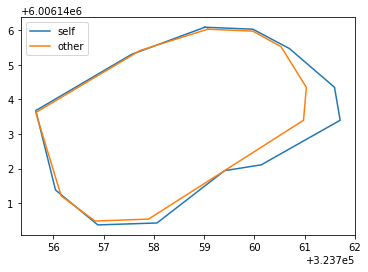

[[468 315]
 [467 316]
 [466 316]
 [465 317]
 [464 318]
 [463 319]
 [462 320]
 [462 321]
 [461 322]
 [461 323]
 [460 324]
 [460 325]
 [460 326]
 [459 327]
 [459 328]
 [458 329]
 [458 330]
 [458 331]
 [457 332]
 [457 333]
 [457 334]
 [457 335]
 [457 336]
 [457 337]
 [457 338]
 [457 339]
 [457 340]
 [457 341]
 [457 342]
 [457 343]
 [457 344]
 [457 345]
 [457 346]
 [457 347]
 [457 348]
 [457 349]
 [457 350]
 [457 351]
 [457 352]
 [457 353]
 [457 354]
 [457 355]
 [457 356]
 [457 357]
 [458 358]
 [458 359]
 [458 360]
 [458 361]
 [458 362]
 [459 363]
 [459 364]
 [460 365]
 [460 366]
 [461 367]
 [461 368]
 [462 369]
 [463 370]
 [464 370]
 [465 371]
 [466 371]
 [467 371]
 [468 372]
 [469 372]
 [470 372]
 [471 372]
 [472 371]
 [473 371]
 [474 371]
 [475 371]
 [476 371]
 [477 370]
 [478 370]
 [479 370]
 [480 370]
 [481 370]
 [482 370]
 [483 370]
 [484 370]
 [485 370]
 [486 369]
 [487 369]
 [488 369]
 [489 369]
 [490 369]
 [491 368]
 [492 368]
 [493 368]
 [494 367]
 [495 367]
 [496 366]
 [497 365]

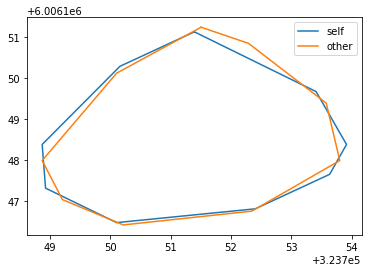

[[346  43]
 [345  44]
 [344  45]
 [343  45]
 [342  45]
 [341  46]
 [340  46]
 [339  46]
 [338  46]
 [337  47]
 [336  47]
 [335  47]
 [334  47]
 [333  47]
 [332  48]
 [331  48]
 [330  48]
 [329  48]
 [328  48]
 [327  48]
 [326  48]
 [325  49]
 [324  49]
 [323  49]
 [322  49]
 [321  49]
 [320  49]
 [319  49]
 [318  49]
 [317  49]
 [316  49]
 [315  49]
 [314  50]
 [313  50]
 [312  50]
 [311  51]
 [310  51]
 [309  51]
 [308  52]
 [307  52]
 [306  53]
 [305  53]
 [304  53]
 [303  54]
 [302  54]
 [301  55]
 [300  55]
 [299  55]
 [298  56]
 [297  56]
 [296  57]
 [295  58]
 [294  59]
 [293  60]
 [292  61]
 [292  62]
 [291  63]
 [291  64]
 [290  65]
 [290  66]
 [290  67]
 [290  68]
 [289  69]
 [289  70]
 [288  71]
 [288  72]
 [288  73]
 [287  74]
 [287  75]
 [287  76]
 [287  77]
 [286  78]
 [286  79]
 [286  80]
 [286  81]
 [285  82]
 [285  83]
 [284  84]
 [284  85]
 [284  86]
 [284  87]
 [284  88]
 [284  89]
 [283  90]
 [283  91]
 [283  92]
 [283  93]
 [282  94]
 [282  95]
 [282  96]
 [281  97]

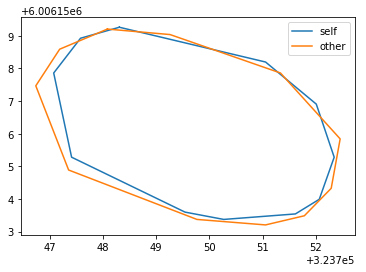

[[ 52 187]
 [ 51 188]
 [ 50 188]
 [ 49 188]
 [ 48 188]
 [ 47 188]
 [ 46 188]
 [ 45 188]
 [ 44 189]
 [ 43 190]
 [ 42 190]
 [ 41 191]
 [ 40 191]
 [ 39 192]
 [ 38 192]
 [ 37 193]
 [ 36 194]
 [ 35 195]
 [ 34 196]
 [ 33 197]
 [ 32 198]
 [ 31 198]
 [ 30 199]
 [ 29 200]
 [ 28 201]
 [ 27 201]
 [ 27 202]
 [ 26 203]
 [ 25 204]
 [ 24 205]
 [ 24 206]
 [ 23 207]
 [ 22 208]
 [ 21 209]
 [ 21 210]
 [ 20 211]
 [ 20 212]
 [ 20 213]
 [ 20 214]
 [ 20 215]
 [ 20 216]
 [ 20 217]
 [ 20 218]
 [ 20 219]
 [ 19 220]
 [ 19 221]
 [ 19 222]
 [ 19 223]
 [ 19 224]
 [ 19 225]
 [ 19 226]
 [ 19 227]
 [ 19 228]
 [ 19 229]
 [ 19 230]
 [ 19 231]
 [ 19 232]
 [ 19 233]
 [ 20 234]
 [ 20 235]
 [ 20 236]
 [ 20 237]
 [ 20 238]
 [ 20 239]
 [ 20 240]
 [ 20 241]
 [ 21 242]
 [ 21 243]
 [ 21 244]
 [ 21 245]
 [ 22 246]
 [ 22 247]
 [ 22 248]
 [ 23 249]
 [ 23 250]
 [ 24 251]
 [ 24 252]
 [ 24 253]
 [ 25 254]
 [ 25 255]
 [ 26 256]
 [ 26 257]
 [ 27 258]
 [ 27 259]
 [ 27 260]
 [ 28 261]
 [ 28 262]
 [ 28 263]
 [ 29 264]
 [ 29 265]
 [ 30 266]

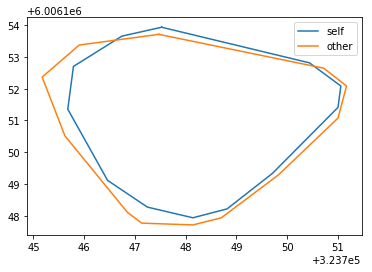

[[197 270]
 [196 271]
 [195 271]
 [194 271]
 [193 271]
 [192 271]
 [191 271]
 [190 272]
 [189 272]
 [188 272]
 [187 272]
 [186 273]
 [185 273]
 [184 273]
 [183 274]
 [182 274]
 [181 275]
 [180 275]
 [179 276]
 [178 276]
 [177 277]
 [176 278]
 [175 279]
 [174 279]
 [173 280]
 [172 281]
 [171 282]
 [170 283]
 [170 284]
 [169 285]
 [168 286]
 [168 287]
 [167 288]
 [167 289]
 [166 290]
 [165 291]
 [165 292]
 [164 293]
 [164 294]
 [164 295]
 [163 296]
 [163 297]
 [162 298]
 [162 299]
 [162 300]
 [161 301]
 [161 302]
 [160 303]
 [160 304]
 [160 305]
 [159 306]
 [159 307]
 [158 308]
 [158 309]
 [158 310]
 [158 311]
 [158 312]
 [158 313]
 [157 314]
 [157 315]
 [157 316]
 [157 317]
 [157 318]
 [158 319]
 [158 320]
 [158 321]
 [158 322]
 [158 323]
 [158 324]
 [158 325]
 [159 326]
 [159 327]
 [159 328]
 [160 329]
 [160 330]
 [161 331]
 [161 332]
 [161 333]
 [162 334]
 [162 335]
 [163 336]
 [163 337]
 [163 338]
 [164 339]
 [164 340]
 [165 341]
 [165 342]
 [165 343]
 [165 344]
 [166 345]
 [166 346]

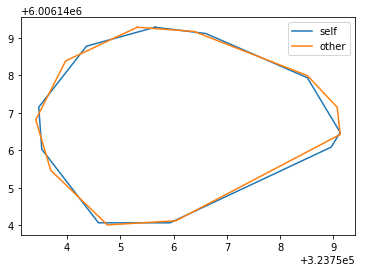

7it [00:08,  1.32s/it]

[[356 210]
 [355 211]
 [354 211]
 [353 211]
 [352 211]
 [351 211]
 [350 211]
 [349 212]
 [348 212]
 [347 212]
 [346 213]
 [345 213]
 [344 213]
 [343 214]
 [342 215]
 [341 215]
 [340 216]
 [340 217]
 [340 218]
 [340 219]
 [340 220]
 [339 221]
 [339 222]
 [339 223]
 [339 224]
 [339 225]
 [338 226]
 [338 227]
 [338 228]
 [338 229]
 [338 230]
 [337 231]
 [337 232]
 [337 233]
 [337 234]
 [337 235]
 [337 236]
 [337 237]
 [337 238]
 [338 239]
 [338 240]
 [338 241]
 [338 242]
 [338 243]
 [339 244]
 [339 245]
 [339 246]
 [339 247]
 [340 248]
 [341 249]
 [341 250]
 [342 251]
 [342 252]
 [343 253]
 [343 254]
 [344 255]
 [345 256]
 [346 257]
 [347 258]
 [348 259]
 [349 259]
 [350 260]
 [351 261]
 [352 261]
 [353 262]
 [354 262]
 [355 262]
 [356 263]
 [357 263]
 [358 263]
 [359 263]
 [360 263]
 [361 263]
 [362 263]
 [363 263]
 [364 263]
 [365 263]
 [366 263]
 [367 263]
 [368 263]
 [369 263]
 [370 263]
 [371 263]
 [372 263]
 [373 263]
 [374 263]
 [375 263]
 [376 262]
 [377 262]
 [378 262]
 [379 262]

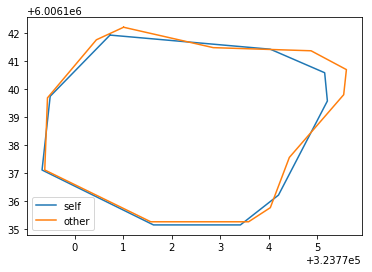

[[170  26]
 [169  27]
 [168  27]
 [167  27]
 [166  27]
 [165  28]
 [164  28]
 [163  28]
 [162  28]
 [161  29]
 [160  30]
 [159  31]
 [158  32]
 [157  33]
 [156  34]
 [155  35]
 [154  36]
 [153  37]
 [153  38]
 [152  39]
 [151  40]
 [151  41]
 [150  42]
 [150  43]
 [149  44]
 [148  45]
 [147  46]
 [147  47]
 [146  48]
 [145  49]
 [145  50]
 [144  51]
 [143  52]
 [142  53]
 [142  54]
 [141  55]
 [141  56]
 [140  57]
 [139  58]
 [138  59]
 [138  60]
 [137  61]
 [137  62]
 [136  63]
 [136  64]
 [135  65]
 [135  66]
 [134  67]
 [134  68]
 [133  69]
 [133  70]
 [133  71]
 [132  72]
 [132  73]
 [131  74]
 [131  75]
 [131  76]
 [131  77]
 [131  78]
 [131  79]
 [131  80]
 [131  81]
 [131  82]
 [131  83]
 [131  84]
 [131  85]
 [132  86]
 [132  87]
 [132  88]
 [132  89]
 [133  90]
 [133  91]
 [133  92]
 [134  93]
 [134  94]
 [135  95]
 [135  96]
 [136  97]
 [136  98]
 [137  99]
 [137 100]
 [138 101]
 [138 102]
 [139 103]
 [139 104]
 [140 105]
 [141 106]
 [142 107]
 [143 108]
 [144 108]
 [145 109]

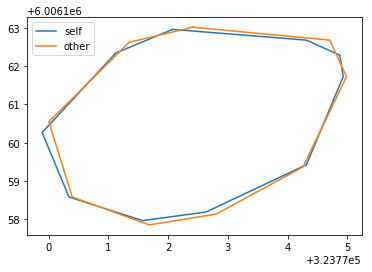

[[209  89]
 [208  90]
 [207  91]
 [206  91]
 [205  92]
 [204  93]
 [203  93]
 [202  94]
 [201  95]
 [200  96]
 [199  97]
 [198  98]
 [197  99]
 [196  99]
 [195 100]
 [194 101]
 [193 102]
 [192 103]
 [191 103]
 [190 104]
 [189 105]
 [188 105]
 [187 106]
 [186 107]
 [185 107]
 [184 108]
 [183 109]
 [182 109]
 [181 110]
 [180 111]
 [179 111]
 [178 112]
 [177 112]
 [176 113]
 [175 114]
 [174 114]
 [173 115]
 [172 116]
 [171 117]
 [171 118]
 [170 119]
 [170 120]
 [170 121]
 [170 122]
 [170 123]
 [169 124]
 [169 125]
 [169 126]
 [169 127]
 [169 128]
 [169 129]
 [170 130]
 [170 131]
 [170 132]
 [170 133]
 [170 134]
 [170 135]
 [171 136]
 [171 137]
 [171 138]
 [172 139]
 [172 140]
 [172 141]
 [173 142]
 [173 143]
 [174 144]
 [174 145]
 [175 146]
 [175 147]
 [176 148]
 [176 149]
 [177 150]
 [178 151]
 [178 152]
 [179 153]
 [179 154]
 [180 155]
 [181 156]
 [181 157]
 [182 158]
 [182 159]
 [183 160]
 [184 161]
 [185 162]
 [185 163]
 [186 164]
 [187 165]
 [187 166]
 [188 166]
 [189 167]
 [190 168]

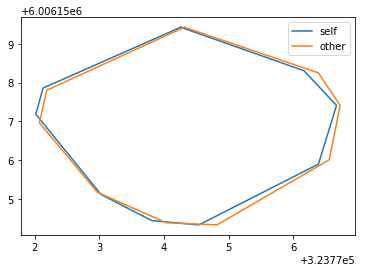

[[333 207]
 [332 208]
 [331 208]
 [330 209]
 [329 209]
 [329 210]
 [328 211]
 [327 212]
 [327 213]
 [327 214]
 [326 215]
 [326 216]
 [326 217]
 [326 218]
 [325 219]
 [325 220]
 [325 221]
 [325 222]
 [324 223]
 [324 224]
 [324 225]
 [324 226]
 [324 227]
 [324 228]
 [323 229]
 [323 230]
 [323 231]
 [323 232]
 [322 233]
 [322 234]
 [322 235]
 [322 236]
 [321 237]
 [321 238]
 [321 239]
 [321 240]
 [321 241]
 [320 242]
 [320 243]
 [320 244]
 [319 245]
 [319 246]
 [319 247]
 [318 248]
 [318 249]
 [317 250]
 [316 251]
 [316 252]
 [315 253]
 [315 254]
 [314 255]
 [314 256]
 [314 257]
 [313 258]
 [313 259]
 [313 260]
 [313 261]
 [313 262]
 [313 263]
 [313 264]
 [313 265]
 [313 266]
 [313 267]
 [313 268]
 [313 269]
 [313 270]
 [313 271]
 [313 272]
 [313 273]
 [313 274]
 [313 275]
 [313 276]
 [313 277]
 [313 278]
 [313 279]
 [313 280]
 [313 281]
 [313 282]
 [313 283]
 [314 284]
 [315 285]
 [316 285]
 [317 286]
 [318 286]
 [319 287]
 [320 288]
 [321 288]
 [322 289]
 [323 289]
 [324 289]
 [325 290]

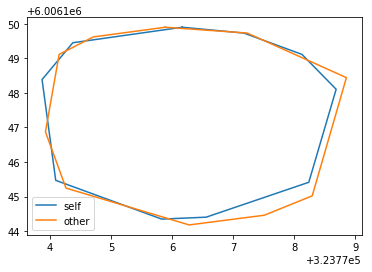

[[103 528]
 [102 529]
 [101 529]
 [100 529]
 [ 99 529]
 [ 98 530]
 [ 97 530]
 [ 96 530]
 [ 95 531]
 [ 94 532]
 [ 93 532]
 [ 92 533]
 [ 91 534]
 [ 90 534]
 [ 89 535]
 [ 88 536]
 [ 87 537]
 [ 86 538]
 [ 85 538]
 [ 84 539]
 [ 83 540]
 [ 82 541]
 [ 81 542]
 [ 80 543]
 [ 79 544]
 [ 78 545]
 [ 77 545]
 [ 77 546]
 [ 76 547]
 [ 75 548]
 [ 75 549]
 [ 75 550]
 [ 75 551]
 [ 75 552]
 [ 75 553]
 [ 75 554]
 [ 75 555]
 [ 75 556]
 [ 75 557]
 [ 75 558]
 [ 75 559]
 [ 75 560]
 [ 75 561]
 [ 75 562]
 [ 75 563]
 [ 75 564]
 [ 76 565]
 [ 77 566]
 [ 78 567]
 [ 79 568]
 [ 80 568]
 [ 81 569]
 [ 82 570]
 [ 83 571]
 [ 84 572]
 [ 85 572]
 [ 86 573]
 [ 87 573]
 [ 88 574]
 [ 89 575]
 [ 90 576]
 [ 91 576]
 [ 92 577]
 [ 93 577]
 [ 94 577]
 [ 95 577]
 [ 96 578]
 [ 97 578]
 [ 98 578]
 [ 99 578]
 [100 579]
 [101 579]
 [102 579]
 [103 579]
 [104 579]
 [105 579]
 [106 579]
 [107 579]
 [108 579]
 [109 579]
 [110 579]
 [111 579]
 [112 579]
 [113 579]
 [114 579]
 [115 579]
 [116 579]
 [117 579]
 [118 578]
 [119 578]
 [120 578]

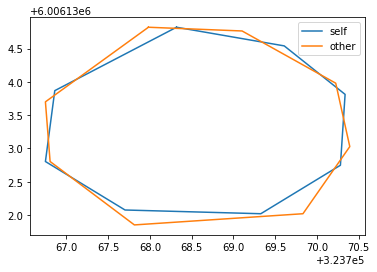

[[235 436]
 [234 437]
 [233 437]
 [232 438]
 [231 439]
 [230 439]
 [229 440]
 [228 441]
 [227 442]
 [227 443]
 [226 444]
 [226 445]
 [225 446]
 [225 447]
 [224 448]
 [224 449]
 [223 450]
 [223 451]
 [223 452]
 [222 453]
 [222 454]
 [222 455]
 [221 456]
 [221 457]
 [221 458]
 [220 459]
 [220 460]
 [219 461]
 [219 462]
 [219 463]
 [218 464]
 [218 465]
 [218 466]
 [218 467]
 [217 468]
 [217 469]
 [217 470]
 [216 471]
 [216 472]
 [216 473]
 [216 474]
 [215 475]
 [215 476]
 [215 477]
 [214 478]
 [214 479]
 [214 480]
 [213 481]
 [213 482]
 [213 483]
 [213 484]
 [212 485]
 [212 486]
 [212 487]
 [212 488]
 [212 489]
 [212 490]
 [211 491]
 [211 492]
 [211 493]
 [211 494]
 [211 495]
 [211 496]
 [211 497]
 [211 498]
 [211 499]
 [211 500]
 [211 501]
 [211 502]
 [211 503]
 [211 504]
 [212 505]
 [212 506]
 [213 507]
 [213 508]
 [214 509]
 [215 510]
 [216 511]
 [217 512]
 [218 513]
 [219 514]
 [220 515]
 [221 515]
 [222 516]
 [223 517]
 [224 517]
 [225 518]
 [226 518]
 [227 518]
 [228 519]
 [229 519]

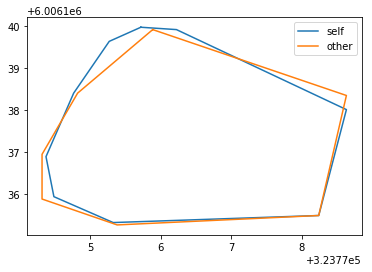

[[209 182]
 [208 183]
 [207 183]
 [206 184]
 [205 184]
 [204 185]
 [203 186]
 [202 187]
 [201 188]
 [200 189]
 [200 190]
 [199 191]
 [198 192]
 [197 193]
 [196 194]
 [196 195]
 [195 196]
 [195 197]
 [194 198]
 [194 199]
 [193 200]
 [193 201]
 [192 202]
 [192 203]
 [192 204]
 [192 205]
 [191 206]
 [191 207]
 [191 208]
 [191 209]
 [191 210]
 [191 211]
 [190 212]
 [190 213]
 [190 214]
 [190 215]
 [190 216]
 [190 217]
 [190 218]
 [190 219]
 [190 220]
 [189 221]
 [189 222]
 [189 223]
 [189 224]
 [189 225]
 [189 226]
 [189 227]
 [189 228]
 [189 229]
 [189 230]
 [189 231]
 [189 232]
 [189 233]
 [189 234]
 [190 235]
 [190 236]
 [190 237]
 [190 238]
 [190 239]
 [190 240]
 [191 241]
 [191 242]
 [191 243]
 [191 244]
 [192 245]
 [192 246]
 [192 247]
 [192 248]
 [193 249]
 [193 250]
 [193 251]
 [194 252]
 [194 253]
 [195 254]
 [195 255]
 [196 256]
 [196 257]
 [197 258]
 [198 259]
 [198 260]
 [199 261]
 [200 262]
 [201 263]
 [202 264]
 [203 264]
 [204 265]
 [205 265]
 [206 266]
 [207 266]
 [208 266]

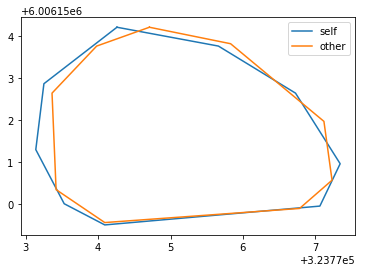

[[305 372]
 [304 373]
 [303 374]
 [302 375]
 [301 375]
 [300 376]
 [299 377]
 [298 377]
 [297 378]
 [296 379]
 [295 379]
 [294 380]
 [293 380]
 [292 380]
 [291 380]
 [290 381]
 [289 381]
 [288 382]
 [287 382]
 [286 383]
 [285 383]
 [284 383]
 [283 384]
 [282 385]
 [281 385]
 [280 386]
 [279 386]
 [278 386]
 [277 386]
 [276 387]
 [275 387]
 [274 387]
 [273 388]
 [272 388]
 [271 388]
 [270 388]
 [269 388]
 [268 388]
 [267 388]
 [266 389]
 [265 389]
 [264 389]
 [263 389]
 [262 389]
 [261 389]
 [260 389]
 [259 389]
 [258 389]
 [257 390]
 [256 390]
 [255 389]
 [254 389]
 [253 389]
 [252 389]
 [251 390]
 [250 390]
 [249 390]
 [248 390]
 [247 391]
 [246 391]
 [245 391]
 [244 392]
 [243 393]
 [242 394]
 [241 394]
 [240 395]
 [239 395]
 [238 395]
 [237 395]
 [236 395]
 [235 395]
 [234 396]
 [234 397]
 [234 398]
 [234 399]
 [234 400]
 [234 401]
 [234 402]
 [234 403]
 [234 404]
 [235 405]
 [235 406]
 [235 407]
 [235 408]
 [235 409]
 [235 410]
 [235 411]
 [235 412]
 [235 413]
 [235 414]
 [235 415]

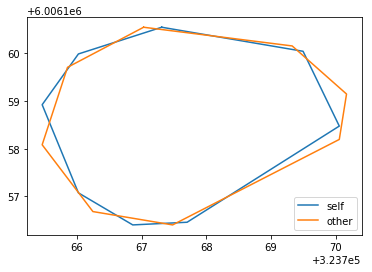

[[303 193]
 [302 194]
 [301 194]
 [300 195]
 [299 195]
 [298 196]
 [297 197]
 [296 197]
 [295 198]
 [294 198]
 [293 199]
 [292 199]
 [291 200]
 [290 200]
 [289 201]
 [288 202]
 [287 202]
 [286 203]
 [285 204]
 [284 205]
 [283 205]
 [282 206]
 [282 207]
 [281 208]
 [280 209]
 [279 209]
 [278 210]
 [277 211]
 [276 212]
 [275 213]
 [274 213]
 [273 214]
 [272 214]
 [271 215]
 [270 216]
 [269 216]
 [268 217]
 [267 218]
 [266 219]
 [266 220]
 [265 221]
 [265 222]
 [264 223]
 [264 224]
 [264 225]
 [263 226]
 [263 227]
 [263 228]
 [263 229]
 [263 230]
 [263 231]
 [263 232]
 [263 233]
 [263 234]
 [263 235]
 [263 236]
 [263 237]
 [263 238]
 [263 239]
 [263 240]
 [263 241]
 [263 242]
 [263 243]
 [263 244]
 [264 245]
 [264 246]
 [264 247]
 [264 248]
 [265 249]
 [265 250]
 [265 251]
 [265 252]
 [266 253]
 [266 254]
 [267 255]
 [267 256]
 [268 257]
 [268 258]
 [269 259]
 [269 260]
 [270 261]
 [270 262]
 [271 263]
 [272 264]
 [273 265]
 [274 266]
 [275 267]
 [276 267]
 [277 268]
 [278 269]
 [279 270]

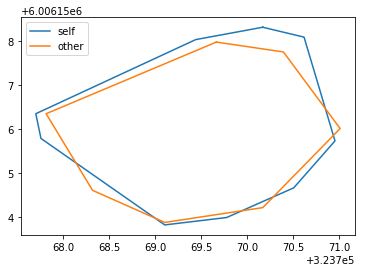

[[270 515]
 [269 516]
 [268 516]
 [267 516]
 [266 516]
 [265 516]
 [264 516]
 [263 516]
 [262 516]
 [261 516]
 [260 516]
 [259 516]
 [258 516]
 [257 517]
 [256 517]
 [255 517]
 [254 517]
 [253 517]
 [252 517]
 [251 517]
 [250 517]
 [249 517]
 [248 518]
 [247 518]
 [246 518]
 [245 518]
 [244 518]
 [243 518]
 [242 518]
 [241 518]
 [240 519]
 [239 519]
 [238 519]
 [237 519]
 [236 519]
 [235 519]
 [234 519]
 [233 520]
 [232 520]
 [231 520]
 [230 520]
 [229 520]
 [228 521]
 [227 521]
 [226 521]
 [225 522]
 [224 522]
 [223 523]
 [222 524]
 [221 525]
 [220 526]
 [219 527]
 [219 528]
 [218 529]
 [218 530]
 [218 531]
 [217 532]
 [217 533]
 [217 534]
 [217 535]
 [217 536]
 [216 537]
 [216 538]
 [216 539]
 [216 540]
 [216 541]
 [215 542]
 [215 543]
 [215 544]
 [215 545]
 [215 546]
 [215 547]
 [215 548]
 [215 549]
 [215 550]
 [215 551]
 [215 552]
 [215 553]
 [215 554]
 [215 555]
 [215 556]
 [215 557]
 [215 558]
 [215 559]
 [215 560]
 [215 561]
 [215 562]
 [215 563]
 [215 564]
 [214 565]
 [214 566]

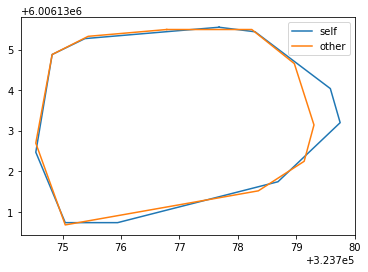

[[264 155]
 [263 156]
 [262 156]
 [261 156]
 [260 156]
 [259 157]
 [258 157]
 [257 157]
 [256 158]
 [255 158]
 [254 159]
 [253 160]
 [252 161]
 [251 161]
 [250 162]
 [250 163]
 [249 164]
 [248 165]
 [248 166]
 [247 167]
 [246 168]
 [245 169]
 [245 170]
 [244 171]
 [244 172]
 [243 173]
 [243 174]
 [242 175]
 [242 176]
 [241 177]
 [241 178]
 [241 179]
 [240 180]
 [240 181]
 [240 182]
 [239 183]
 [239 184]
 [239 185]
 [239 186]
 [239 187]
 [239 188]
 [239 189]
 [239 190]
 [239 191]
 [240 192]
 [240 193]
 [240 194]
 [241 195]
 [242 196]
 [242 197]
 [243 198]
 [244 199]
 [245 200]
 [245 201]
 [246 202]
 [247 203]
 [247 204]
 [248 205]
 [249 206]
 [249 207]
 [250 208]
 [251 209]
 [251 210]
 [252 211]
 [253 212]
 [254 213]
 [255 214]
 [255 215]
 [256 216]
 [257 217]
 [258 218]
 [259 219]
 [260 219]
 [261 220]
 [262 220]
 [263 220]
 [264 220]
 [265 220]
 [266 219]
 [267 219]
 [268 218]
 [269 218]
 [270 217]
 [271 217]
 [272 216]
 [273 216]
 [274 215]
 [275 214]
 [276 213]
 [277 212]
 [278 211]

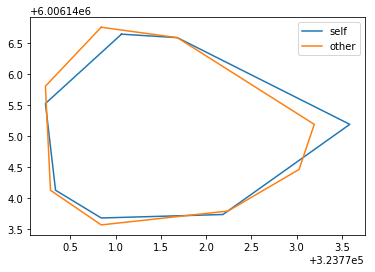

[[365 516]
 [364 517]
 [363 517]
 [362 517]
 [361 517]
 [360 518]
 [359 518]
 [358 519]
 [357 519]
 [356 519]
 [355 520]
 [354 520]
 [353 521]
 [352 521]
 [351 522]
 [351 523]
 [350 524]
 [350 525]
 [349 526]
 [348 527]
 [347 528]
 [346 528]
 [345 529]
 [344 530]
 [344 531]
 [343 532]
 [343 533]
 [343 534]
 [343 535]
 [343 536]
 [343 537]
 [343 538]
 [343 539]
 [343 540]
 [343 541]
 [343 542]
 [343 543]
 [343 544]
 [343 545]
 [343 546]
 [343 547]
 [343 548]
 [343 549]
 [343 550]
 [343 551]
 [343 552]
 [343 553]
 [343 554]
 [343 555]
 [343 556]
 [343 557]
 [344 558]
 [344 559]
 [344 560]
 [345 561]
 [346 562]
 [347 563]
 [348 564]
 [349 565]
 [350 566]
 [351 567]
 [352 568]
 [353 569]
 [354 569]
 [355 570]
 [356 570]
 [357 571]
 [358 572]
 [359 573]
 [360 574]
 [361 575]
 [362 576]
 [363 576]
 [364 577]
 [365 578]
 [366 579]
 [367 580]
 [368 581]
 [369 582]
 [370 582]
 [371 583]
 [372 584]
 [373 585]
 [374 585]
 [375 586]
 [376 587]
 [377 588]
 [378 589]
 [379 589]
 [380 590]
 [381 591]

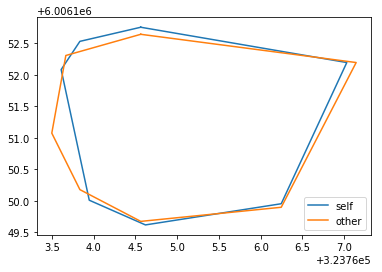

[[ 72 143]
 [ 71 144]
 [ 70 144]
 [ 69 144]
 [ 68 145]
 [ 67 146]
 [ 66 147]
 [ 65 148]
 [ 65 149]
 [ 64 150]
 [ 63 151]
 [ 63 152]
 [ 63 153]
 [ 62 154]
 [ 62 155]
 [ 62 156]
 [ 61 157]
 [ 61 158]
 [ 60 159]
 [ 60 160]
 [ 60 161]
 [ 59 162]
 [ 59 163]
 [ 59 164]
 [ 59 165]
 [ 58 166]
 [ 58 167]
 [ 58 168]
 [ 57 169]
 [ 57 170]
 [ 57 171]
 [ 57 172]
 [ 56 173]
 [ 56 174]
 [ 56 175]
 [ 56 176]
 [ 56 177]
 [ 55 178]
 [ 55 179]
 [ 55 180]
 [ 55 181]
 [ 55 182]
 [ 54 183]
 [ 54 184]
 [ 54 185]
 [ 54 186]
 [ 53 187]
 [ 53 188]
 [ 53 189]
 [ 53 190]
 [ 52 191]
 [ 52 192]
 [ 52 193]
 [ 52 194]
 [ 52 195]
 [ 51 196]
 [ 51 197]
 [ 51 198]
 [ 51 199]
 [ 51 200]
 [ 51 201]
 [ 52 202]
 [ 52 203]
 [ 52 204]
 [ 53 205]
 [ 54 206]
 [ 55 207]
 [ 56 208]
 [ 57 208]
 [ 58 209]
 [ 59 209]
 [ 60 210]
 [ 61 210]
 [ 62 211]
 [ 63 211]
 [ 64 212]
 [ 65 212]
 [ 66 213]
 [ 67 213]
 [ 68 213]
 [ 69 214]
 [ 70 214]
 [ 71 214]
 [ 72 214]
 [ 73 215]
 [ 74 215]
 [ 75 215]
 [ 76 215]
 [ 77 215]
 [ 78 215]
 [ 79 215]

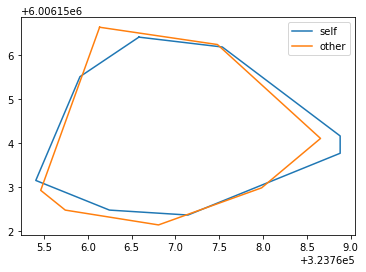

8it [00:10,  1.46s/it]

[[409 368]
 [408 369]
 [407 369]
 [406 369]
 [405 369]
 [404 369]
 [403 369]
 [402 370]
 [401 370]
 [400 370]
 [399 370]
 [398 370]
 [397 370]
 [396 370]
 [395 370]
 [394 370]
 [393 371]
 [392 371]
 [391 372]
 [390 372]
 [389 373]
 [389 374]
 [388 375]
 [387 375]
 [386 376]
 [385 376]
 [384 377]
 [384 378]
 [383 379]
 [382 380]
 [381 381]
 [380 382]
 [379 383]
 [378 384]
 [378 385]
 [377 386]
 [376 387]
 [375 388]
 [374 389]
 [373 390]
 [373 391]
 [372 392]
 [372 393]
 [371 394]
 [370 395]
 [369 396]
 [369 397]
 [368 398]
 [368 399]
 [367 400]
 [367 401]
 [367 402]
 [366 403]
 [366 404]
 [366 405]
 [365 406]
 [365 407]
 [365 408]
 [365 409]
 [365 410]
 [365 411]
 [365 412]
 [365 413]
 [365 414]
 [365 415]
 [365 416]
 [365 417]
 [365 418]
 [365 419]
 [365 420]
 [365 421]
 [365 422]
 [365 423]
 [365 424]
 [365 425]
 [365 426]
 [365 427]
 [366 428]
 [366 429]
 [366 430]
 [366 431]
 [366 432]
 [366 433]
 [366 434]
 [367 435]
 [367 436]
 [367 437]
 [367 438]
 [368 439]
 [368 440]
 [369 441]

[[ 99 458]
 [ 98 459]
 [ 97 459]
 [ 96 459]
 [ 95 459]
 [ 94 459]
 [ 93 459]
 [ 92 460]
 [ 91 460]
 [ 90 460]
 [ 89 460]
 [ 88 460]
 [ 87 460]
 [ 86 460]
 [ 85 461]
 [ 84 461]
 [ 83 461]
 [ 82 461]
 [ 81 461]
 [ 80 461]
 [ 79 462]
 [ 78 462]
 [ 77 463]
 [ 76 463]
 [ 75 463]
 [ 74 464]
 [ 73 464]
 [ 72 465]
 [ 71 466]
 [ 70 467]
 [ 69 467]
 [ 68 468]
 [ 67 468]
 [ 66 469]
 [ 65 470]
 [ 65 471]
 [ 64 472]
 [ 63 473]
 [ 62 473]
 [ 61 474]
 [ 61 475]
 [ 60 476]
 [ 59 477]
 [ 59 478]
 [ 58 479]
 [ 57 480]
 [ 57 481]
 [ 56 482]
 [ 56 483]
 [ 55 484]
 [ 55 485]
 [ 55 486]
 [ 54 487]
 [ 54 488]
 [ 54 489]
 [ 53 490]
 [ 53 491]
 [ 53 492]
 [ 53 493]
 [ 52 494]
 [ 52 495]
 [ 52 496]
 [ 52 497]
 [ 52 498]
 [ 52 499]
 [ 52 500]
 [ 52 501]
 [ 52 502]
 [ 52 503]
 [ 51 504]
 [ 52 505]
 [ 52 506]
 [ 52 507]
 [ 52 508]
 [ 52 509]
 [ 52 510]
 [ 53 511]
 [ 53 512]
 [ 54 513]
 [ 55 514]
 [ 56 514]
 [ 57 515]
 [ 58 515]
 [ 59 516]
 [ 60 516]
 [ 61 516]
 [ 62 517]
 [ 63 517]
 [ 64 517]
 [ 65 518]
 [ 66 518]

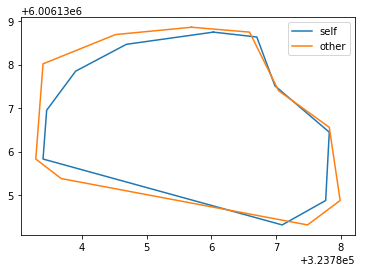

[[ 44 517]
 [ 43 518]
 [ 42 518]
 [ 41 518]
 [ 40 519]
 [ 39 519]
 [ 38 520]
 [ 37 521]
 [ 37 522]
 [ 36 523]
 [ 35 524]
 [ 35 525]
 [ 34 526]
 [ 34 527]
 [ 33 528]
 [ 32 529]
 [ 31 530]
 [ 30 531]
 [ 30 532]
 [ 30 533]
 [ 30 534]
 [ 30 535]
 [ 29 536]
 [ 29 537]
 [ 29 538]
 [ 29 539]
 [ 29 540]
 [ 29 541]
 [ 29 542]
 [ 29 543]
 [ 29 544]
 [ 29 545]
 [ 29 546]
 [ 29 547]
 [ 29 548]
 [ 29 549]
 [ 29 550]
 [ 29 551]
 [ 29 552]
 [ 29 553]
 [ 29 554]
 [ 29 555]
 [ 29 556]
 [ 29 557]
 [ 29 558]
 [ 29 559]
 [ 29 560]
 [ 30 561]
 [ 30 562]
 [ 30 563]
 [ 30 564]
 [ 31 565]
 [ 32 566]
 [ 33 567]
 [ 34 568]
 [ 35 569]
 [ 36 569]
 [ 37 570]
 [ 38 571]
 [ 39 572]
 [ 40 572]
 [ 41 573]
 [ 42 574]
 [ 43 575]
 [ 44 576]
 [ 44 577]
 [ 45 577]
 [ 46 578]
 [ 47 579]
 [ 48 579]
 [ 49 580]
 [ 50 581]
 [ 50 582]
 [ 51 583]
 [ 52 584]
 [ 53 585]
 [ 54 585]
 [ 55 586]
 [ 56 587]
 [ 57 588]
 [ 58 589]
 [ 59 590]
 [ 59 591]
 [ 60 591]
 [ 61 592]
 [ 62 593]
 [ 63 594]
 [ 64 595]
 [ 65 596]
 [ 66 596]
 [ 67 597]

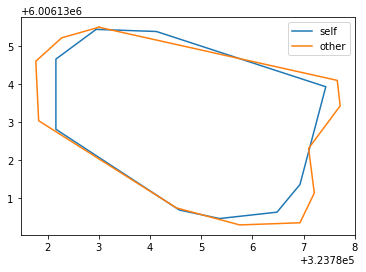

[[ 75 342]
 [ 74 343]
 [ 73 343]
 [ 72 343]
 [ 72 344]
 [ 71 345]
 [ 70 346]
 [ 69 347]
 [ 68 348]
 [ 67 349]
 [ 66 350]
 [ 65 351]
 [ 64 352]
 [ 64 353]
 [ 64 354]
 [ 64 355]
 [ 64 356]
 [ 64 357]
 [ 64 358]
 [ 63 359]
 [ 63 360]
 [ 63 361]
 [ 63 362]
 [ 63 363]
 [ 63 364]
 [ 63 365]
 [ 63 366]
 [ 63 367]
 [ 63 368]
 [ 63 369]
 [ 63 370]
 [ 63 371]
 [ 63 372]
 [ 63 373]
 [ 62 374]
 [ 62 375]
 [ 62 376]
 [ 62 377]
 [ 61 378]
 [ 61 379]
 [ 60 380]
 [ 59 381]
 [ 59 382]
 [ 58 383]
 [ 58 384]
 [ 57 385]
 [ 56 386]
 [ 55 387]
 [ 54 388]
 [ 54 389]
 [ 53 390]
 [ 53 391]
 [ 52 392]
 [ 52 393]
 [ 51 394]
 [ 51 395]
 [ 50 396]
 [ 49 397]
 [ 49 398]
 [ 48 399]
 [ 48 400]
 [ 48 401]
 [ 48 402]
 [ 47 403]
 [ 47 404]
 [ 47 405]
 [ 47 406]
 [ 46 407]
 [ 46 408]
 [ 46 409]
 [ 46 410]
 [ 46 411]
 [ 46 412]
 [ 46 413]
 [ 46 414]
 [ 46 415]
 [ 46 416]
 [ 46 417]
 [ 46 418]
 [ 46 419]
 [ 46 420]
 [ 46 421]
 [ 46 422]
 [ 46 423]
 [ 46 424]
 [ 46 425]
 [ 46 426]
 [ 46 427]
 [ 46 428]
 [ 46 429]
 [ 46 430]

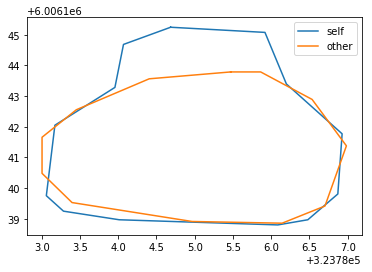

[[ 46  65]
 [ 45  66]
 [ 44  66]
 [ 43  66]
 [ 42  66]
 [ 41  66]
 [ 40  67]
 [ 39  67]
 [ 38  67]
 [ 37  68]
 [ 36  69]
 [ 35  69]
 [ 34  70]
 [ 34  71]
 [ 33  72]
 [ 32  73]
 [ 32  74]
 [ 31  75]
 [ 30  76]
 [ 30  77]
 [ 29  78]
 [ 29  79]
 [ 28  80]
 [ 28  81]
 [ 28  82]
 [ 27  83]
 [ 27  84]
 [ 27  85]
 [ 27  86]
 [ 27  87]
 [ 27  88]
 [ 27  89]
 [ 26  90]
 [ 27  91]
 [ 27  92]
 [ 27  93]
 [ 27  94]
 [ 28  95]
 [ 28  96]
 [ 29  97]
 [ 29  98]
 [ 30  99]
 [ 31 100]
 [ 32 100]
 [ 33 101]
 [ 34 101]
 [ 35 102]
 [ 36 103]
 [ 37 103]
 [ 38 104]
 [ 39 104]
 [ 40 105]
 [ 41 105]
 [ 42 105]
 [ 43 105]
 [ 44 106]
 [ 45 106]
 [ 46 106]
 [ 47 106]
 [ 48 106]
 [ 49 106]
 [ 50 106]
 [ 51 106]
 [ 52 106]
 [ 53 106]
 [ 54 105]
 [ 55 105]
 [ 56 105]
 [ 57 105]
 [ 58 104]
 [ 59 104]
 [ 60 103]
 [ 61 103]
 [ 62 102]
 [ 63 102]
 [ 64 101]
 [ 65 100]
 [ 66  99]
 [ 67  98]
 [ 68  97]
 [ 69  96]
 [ 69  95]
 [ 69  94]
 [ 69  93]
 [ 69  92]
 [ 69  91]
 [ 69  90]
 [ 69  89]
 [ 69  88]
 [ 69  87]
 [ 68  86]

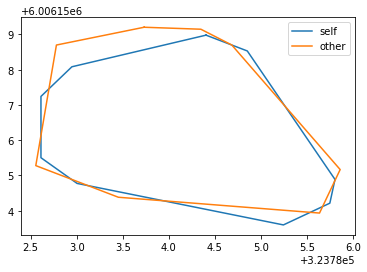

[[ 82 242]
 [ 81 243]
 [ 80 243]
 [ 79 244]
 [ 78 245]
 [ 77 246]
 [ 77 247]
 [ 77 248]
 [ 76 249]
 [ 76 250]
 [ 75 251]
 [ 75 252]
 [ 75 253]
 [ 74 254]
 [ 74 255]
 [ 73 256]
 [ 73 257]
 [ 73 258]
 [ 73 259]
 [ 72 260]
 [ 72 261]
 [ 72 262]
 [ 72 263]
 [ 71 264]
 [ 71 265]
 [ 71 266]
 [ 71 267]
 [ 70 268]
 [ 70 269]
 [ 70 270]
 [ 70 271]
 [ 70 272]
 [ 69 273]
 [ 69 274]
 [ 69 275]
 [ 69 276]
 [ 69 277]
 [ 69 278]
 [ 69 279]
 [ 70 280]
 [ 70 281]
 [ 70 282]
 [ 71 283]
 [ 71 284]
 [ 72 285]
 [ 73 286]
 [ 74 287]
 [ 75 288]
 [ 76 288]
 [ 77 288]
 [ 78 289]
 [ 79 289]
 [ 80 290]
 [ 81 290]
 [ 82 290]
 [ 83 290]
 [ 84 290]
 [ 85 290]
 [ 86 290]
 [ 87 290]
 [ 88 291]
 [ 89 291]
 [ 90 291]
 [ 91 291]
 [ 92 292]
 [ 93 292]
 [ 94 292]
 [ 95 292]
 [ 96 292]
 [ 97 292]
 [ 98 292]
 [ 99 292]
 [100 292]
 [101 292]
 [102 292]
 [103 292]
 [104 292]
 [105 292]
 [106 292]
 [107 291]
 [108 291]
 [109 290]
 [110 290]
 [111 289]
 [111 288]
 [112 287]
 [112 286]
 [113 285]
 [113 284]
 [113 283]
 [113 282]

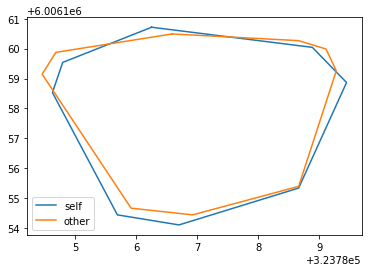

9it [00:11,  1.28s/it]

[[362 366]
 [361 367]
 [360 367]
 [359 367]
 [358 367]
 [357 367]
 [356 367]
 [355 367]
 [354 367]
 [353 368]
 [352 368]
 [351 368]
 [350 368]
 [349 368]
 [348 368]
 [347 368]
 [346 368]
 [345 368]
 [344 369]
 [343 369]
 [342 369]
 [341 369]
 [340 369]
 [339 370]
 [338 370]
 [337 370]
 [336 370]
 [335 371]
 [334 371]
 [333 371]
 [332 372]
 [331 372]
 [330 373]
 [329 374]
 [328 374]
 [327 375]
 [326 376]
 [325 377]
 [324 378]
 [323 379]
 [322 380]
 [322 381]
 [321 382]
 [320 383]
 [319 384]
 [319 385]
 [318 386]
 [317 387]
 [316 388]
 [315 389]
 [315 390]
 [314 391]
 [313 392]
 [313 393]
 [312 394]
 [311 395]
 [310 396]
 [310 397]
 [309 398]
 [308 399]
 [308 400]
 [307 401]
 [306 402]
 [305 403]
 [305 404]
 [304 405]
 [304 406]
 [303 407]
 [302 408]
 [302 409]
 [301 410]
 [301 411]
 [300 412]
 [300 413]
 [300 414]
 [299 415]
 [299 416]
 [299 417]
 [299 418]
 [299 419]
 [299 420]
 [299 421]
 [299 422]
 [298 423]
 [298 424]
 [298 425]
 [298 426]
 [298 427]
 [299 428]
 [299 429]
 [299 430]

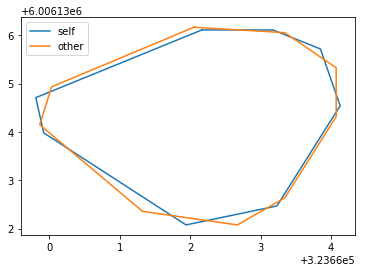

[[346 175]
 [345 176]
 [344 176]
 [343 176]
 [342 177]
 [341 177]
 [340 178]
 [339 178]
 [338 178]
 [337 179]
 [336 180]
 [335 181]
 [334 182]
 [333 182]
 [332 183]
 [331 184]
 [330 185]
 [329 186]
 [329 187]
 [328 188]
 [327 189]
 [326 190]
 [325 191]
 [324 192]
 [323 193]
 [323 194]
 [322 195]
 [322 196]
 [321 197]
 [321 198]
 [320 199]
 [320 200]
 [319 201]
 [319 202]
 [319 203]
 [319 204]
 [318 205]
 [318 206]
 [318 207]
 [318 208]
 [318 209]
 [318 210]
 [317 211]
 [317 212]
 [317 213]
 [317 214]
 [317 215]
 [317 216]
 [317 217]
 [317 218]
 [317 219]
 [317 220]
 [317 221]
 [317 222]
 [317 223]
 [318 224]
 [318 225]
 [318 226]
 [318 227]
 [318 228]
 [318 229]
 [319 230]
 [319 231]
 [319 232]
 [319 233]
 [319 234]
 [320 235]
 [320 236]
 [320 237]
 [321 238]
 [321 239]
 [321 240]
 [321 241]
 [322 242]
 [322 243]
 [322 244]
 [323 245]
 [323 246]
 [323 247]
 [324 248]
 [324 249]
 [325 250]
 [325 251]
 [326 252]
 [326 253]
 [327 254]
 [328 255]
 [329 256]
 [329 257]
 [330 258]
 [331 259]

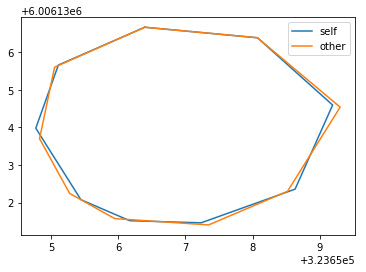

[[204 529]
 [203 530]
 [202 530]
 [201 530]
 [200 531]
 [199 531]
 [198 532]
 [197 532]
 [196 533]
 [195 533]
 [194 534]
 [193 535]
 [192 535]
 [191 536]
 [190 536]
 [189 537]
 [188 537]
 [187 538]
 [186 539]
 [185 540]
 [184 541]
 [183 542]
 [183 543]
 [182 544]
 [182 545]
 [182 546]
 [181 547]
 [181 548]
 [181 549]
 [181 550]
 [181 551]
 [180 552]
 [180 553]
 [180 554]
 [180 555]
 [180 556]
 [180 557]
 [180 558]
 [180 559]
 [180 560]
 [180 561]
 [180 562]
 [180 563]
 [180 564]
 [180 565]
 [180 566]
 [181 567]
 [181 568]
 [181 569]
 [181 570]
 [181 571]
 [181 572]
 [181 573]
 [181 574]
 [181 575]
 [181 576]
 [182 577]
 [182 578]
 [182 579]
 [182 580]
 [182 581]
 [182 582]
 [183 583]
 [183 584]
 [183 585]
 [183 586]
 [183 587]
 [184 588]
 [184 589]
 [184 590]
 [185 591]
 [186 592]
 [186 593]
 [187 594]
 [188 594]
 [189 595]
 [190 595]
 [191 596]
 [192 596]
 [193 597]
 [194 597]
 [195 597]
 [196 597]
 [197 597]
 [198 597]
 [199 598]
 [200 598]
 [201 598]
 [202 598]
 [203 598]
 [204 598]

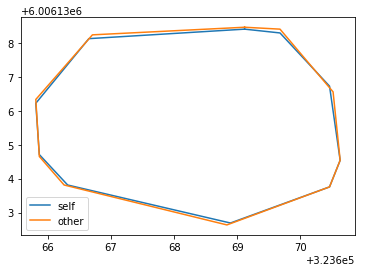

[[216 182]
 [215 183]
 [214 183]
 [213 183]
 [212 184]
 [211 184]
 [210 184]
 [209 185]
 [208 186]
 [207 186]
 [206 187]
 [205 187]
 [204 188]
 [203 188]
 [202 189]
 [201 189]
 [200 189]
 [199 190]
 [198 190]
 [197 190]
 [196 191]
 [195 191]
 [194 192]
 [193 192]
 [192 193]
 [191 194]
 [190 194]
 [189 195]
 [188 195]
 [187 196]
 [186 196]
 [185 196]
 [184 197]
 [183 197]
 [182 197]
 [181 197]
 [180 198]
 [179 198]
 [178 199]
 [177 199]
 [176 200]
 [175 200]
 [174 201]
 [173 202]
 [172 203]
 [171 204]
 [170 205]
 [169 206]
 [169 207]
 [168 208]
 [168 209]
 [168 210]
 [168 211]
 [167 212]
 [167 213]
 [167 214]
 [166 215]
 [166 216]
 [166 217]
 [166 218]
 [166 219]
 [166 220]
 [166 221]
 [166 222]
 [165 223]
 [165 224]
 [165 225]
 [165 226]
 [165 227]
 [165 228]
 [165 229]
 [165 230]
 [165 231]
 [165 232]
 [165 233]
 [165 234]
 [165 235]
 [165 236]
 [165 237]
 [165 238]
 [165 239]
 [165 240]
 [166 241]
 [166 242]
 [166 243]
 [166 244]
 [166 245]
 [166 246]
 [166 247]
 [166 248]
 [167 249]

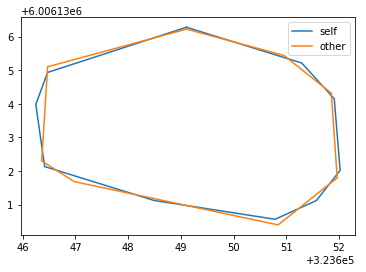

[[351 271]
 [350 272]
 [349 272]
 [348 272]
 [347 272]
 [346 273]
 [345 273]
 [344 274]
 [343 274]
 [342 275]
 [341 276]
 [340 277]
 [339 277]
 [338 278]
 [337 279]
 [336 279]
 [335 280]
 [334 280]
 [333 281]
 [332 281]
 [331 281]
 [330 282]
 [329 282]
 [328 282]
 [327 283]
 [326 283]
 [325 283]
 [324 284]
 [323 284]
 [322 284]
 [321 284]
 [320 284]
 [319 285]
 [318 286]
 [318 287]
 [317 288]
 [317 289]
 [317 290]
 [317 291]
 [317 292]
 [317 293]
 [317 294]
 [317 295]
 [317 296]
 [317 297]
 [317 298]
 [317 299]
 [317 300]
 [317 301]
 [317 302]
 [317 303]
 [318 304]
 [318 305]
 [318 306]
 [318 307]
 [318 308]
 [319 309]
 [319 310]
 [319 311]
 [319 312]
 [320 313]
 [320 314]
 [320 315]
 [321 316]
 [321 317]
 [321 318]
 [321 319]
 [321 320]
 [322 321]
 [322 322]
 [322 323]
 [322 324]
 [323 325]
 [323 326]
 [323 327]
 [323 328]
 [323 329]
 [323 330]
 [324 331]
 [324 332]
 [324 333]
 [324 334]
 [324 335]
 [324 336]
 [324 337]
 [325 338]
 [325 339]
 [325 340]
 [325 341]
 [325 342]
 [325 343]

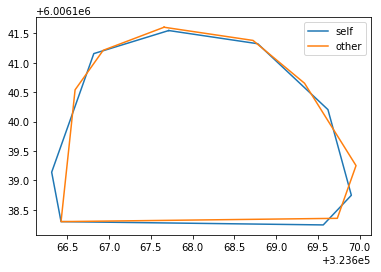

[[ 88 322]
 [ 87 323]
 [ 86 323]
 [ 85 323]
 [ 84 323]
 [ 83 324]
 [ 82 324]
 [ 81 325]
 [ 80 325]
 [ 79 326]
 [ 78 326]
 [ 77 327]
 [ 76 327]
 [ 75 328]
 [ 74 329]
 [ 73 330]
 [ 72 331]
 [ 71 332]
 [ 70 332]
 [ 69 333]
 [ 68 334]
 [ 67 334]
 [ 66 335]
 [ 65 336]
 [ 65 337]
 [ 64 338]
 [ 63 339]
 [ 62 340]
 [ 61 341]
 [ 60 342]
 [ 59 343]
 [ 58 344]
 [ 57 345]
 [ 56 346]
 [ 55 347]
 [ 54 347]
 [ 53 348]
 [ 52 349]
 [ 51 349]
 [ 50 350]
 [ 49 350]
 [ 48 351]
 [ 47 351]
 [ 46 352]
 [ 45 352]
 [ 44 353]
 [ 43 353]
 [ 42 354]
 [ 41 355]
 [ 41 356]
 [ 40 357]
 [ 39 358]
 [ 39 359]
 [ 38 360]
 [ 38 361]
 [ 37 362]
 [ 37 363]
 [ 36 364]
 [ 36 365]
 [ 35 366]
 [ 35 367]
 [ 35 368]
 [ 34 369]
 [ 34 370]
 [ 34 371]
 [ 34 372]
 [ 34 373]
 [ 34 374]
 [ 34 375]
 [ 34 376]
 [ 34 377]
 [ 34 378]
 [ 34 379]
 [ 34 380]
 [ 34 381]
 [ 34 382]
 [ 34 383]
 [ 34 384]
 [ 34 385]
 [ 34 386]
 [ 34 387]
 [ 34 388]
 [ 34 389]
 [ 34 390]
 [ 34 391]
 [ 34 392]
 [ 34 393]
 [ 34 394]
 [ 34 395]
 [ 35 396]
 [ 36 397]

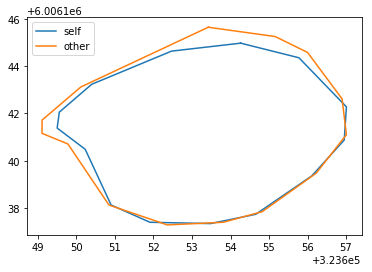

10it [00:12,  1.22s/it]

[[417 499]
 [416 500]
 [415 500]
 [414 500]
 [413 501]
 [412 501]
 [411 501]
 [410 501]
 [409 502]
 [408 502]
 [407 502]
 [406 502]
 [405 502]
 [404 502]
 [403 502]
 [402 503]
 [401 503]
 [400 503]
 [399 503]
 [398 504]
 [397 504]
 [396 504]
 [395 505]
 [394 505]
 [393 505]
 [392 506]
 [391 506]
 [390 507]
 [389 507]
 [388 508]
 [387 509]
 [386 510]
 [385 510]
 [384 511]
 [384 512]
 [383 513]
 [382 514]
 [382 515]
 [382 516]
 [381 517]
 [381 518]
 [382 519]
 [382 520]
 [382 521]
 [382 522]
 [382 523]
 [382 524]
 [382 525]
 [382 526]
 [383 527]
 [383 528]
 [383 529]
 [383 530]
 [383 531]
 [383 532]
 [383 533]
 [384 534]
 [384 535]
 [384 536]
 [384 537]
 [384 538]
 [384 539]
 [384 540]
 [384 541]
 [384 542]
 [384 543]
 [385 544]
 [385 545]
 [385 546]
 [385 547]
 [385 548]
 [385 549]
 [385 550]
 [386 551]
 [386 552]
 [386 553]
 [386 554]
 [386 555]
 [386 556]
 [387 557]
 [387 558]
 [387 559]
 [387 560]
 [387 561]
 [387 562]
 [388 563]
 [388 564]
 [388 565]
 [388 566]
 [389 567]
 [389 568]

[[203 440]
 [202 441]
 [201 441]
 [200 441]
 [199 441]
 [198 441]
 [197 441]
 [196 441]
 [195 442]
 [194 443]
 [193 444]
 [192 445]
 [191 446]
 [190 447]
 [190 448]
 [189 449]
 [189 450]
 [188 451]
 [188 452]
 [187 453]
 [187 454]
 [186 455]
 [185 456]
 [184 457]
 [184 458]
 [183 459]
 [182 459]
 [181 460]
 [180 461]
 [179 462]
 [178 463]
 [177 464]
 [176 465]
 [175 466]
 [175 467]
 [174 468]
 [174 469]
 [173 470]
 [172 471]
 [172 472]
 [172 473]
 [171 474]
 [171 475]
 [171 476]
 [171 477]
 [170 478]
 [170 479]
 [170 480]
 [170 481]
 [170 482]
 [170 483]
 [170 484]
 [170 485]
 [170 486]
 [170 487]
 [170 488]
 [170 489]
 [170 490]
 [169 491]
 [169 492]
 [169 493]
 [169 494]
 [169 495]
 [169 496]
 [170 497]
 [170 498]
 [170 499]
 [169 500]
 [169 501]
 [169 502]
 [169 503]
 [169 504]
 [169 505]
 [170 506]
 [170 507]
 [170 508]
 [170 509]
 [170 510]
 [170 511]
 [170 512]
 [170 513]
 [170 514]
 [170 515]
 [170 516]
 [170 517]
 [170 518]
 [170 519]
 [170 520]
 [170 521]
 [170 522]
 [170 523]

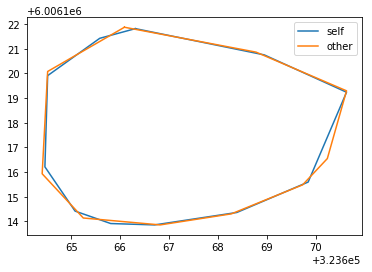

[[454  36]
 [453  37]
 [452  37]
 [451  37]
 [450  37]
 [449  38]
 [448  38]
 [447  38]
 [446  39]
 [445  39]
 [444  40]
 [443  41]
 [442  42]
 [441  43]
 [440  43]
 [439  44]
 [438  45]
 [438  46]
 [437  47]
 [436  48]
 [435  49]
 [434  50]
 [434  51]
 [433  52]
 [433  53]
 [432  54]
 [431  55]
 [431  56]
 [430  57]
 [429  58]
 [429  59]
 [428  60]
 [428  61]
 [427  62]
 [427  63]
 [426  64]
 [426  65]
 [425  66]
 [425  67]
 [424  68]
 [424  69]
 [423  70]
 [423  71]
 [422  72]
 [422  73]
 [422  74]
 [422  75]
 [422  76]
 [422  77]
 [422  78]
 [422  79]
 [422  80]
 [422  81]
 [422  82]
 [422  83]
 [422  84]
 [422  85]
 [422  86]
 [422  87]
 [423  88]
 [423  89]
 [424  90]
 [425  91]
 [426  92]
 [427  93]
 [428  94]
 [428  95]
 [429  95]
 [430  96]
 [431  97]
 [432  98]
 [433  99]
 [434 100]
 [435 101]
 [436 102]
 [437 103]
 [438 104]
 [439 105]
 [440 106]
 [441 107]
 [442 108]
 [443 109]
 [444 109]
 [445 110]
 [446 111]
 [447 112]
 [448 113]
 [449 114]
 [450 114]
 [451 115]
 [452 116]

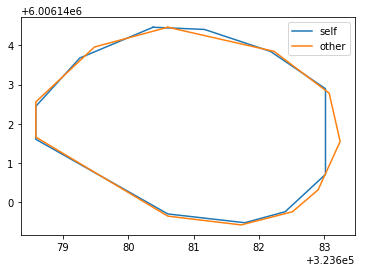

[[401  79]
 [400  80]
 [399  80]
 [398  80]
 [397  81]
 [396  81]
 [395  81]
 [394  82]
 [393  82]
 [392  83]
 [391  84]
 [390  84]
 [389  85]
 [388  86]
 [387  86]
 [386  87]
 [385  87]
 [384  87]
 [383  88]
 [382  88]
 [381  89]
 [380  89]
 [379  90]
 [378  91]
 [377  92]
 [376  92]
 [375  93]
 [374  94]
 [373  94]
 [372  95]
 [371  96]
 [370  96]
 [369  97]
 [368  98]
 [367  99]
 [366 100]
 [365 101]
 [364 102]
 [364 103]
 [364 104]
 [363 105]
 [363 106]
 [362 107]
 [362 108]
 [362 109]
 [361 110]
 [361 111]
 [361 112]
 [361 113]
 [361 114]
 [361 115]
 [360 116]
 [360 117]
 [360 118]
 [359 119]
 [359 120]
 [359 121]
 [359 122]
 [358 123]
 [358 124]
 [358 125]
 [358 126]
 [357 127]
 [357 128]
 [357 129]
 [356 130]
 [356 131]
 [355 132]
 [355 133]
 [355 134]
 [354 135]
 [354 136]
 [354 137]
 [354 138]
 [354 139]
 [354 140]
 [353 141]
 [353 142]
 [353 143]
 [353 144]
 [353 145]
 [353 146]
 [353 147]
 [353 148]
 [353 149]
 [353 150]
 [353 151]
 [353 152]
 [354 153]
 [354 154]
 [354 155]

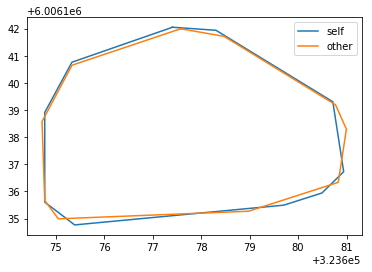

[[141 184]
 [140 185]
 [139 185]
 [138 185]
 [137 185]
 [136 185]
 [135 185]
 [134 185]
 [133 185]
 [132 185]
 [131 185]
 [130 186]
 [129 186]
 [128 186]
 [127 186]
 [126 187]
 [125 187]
 [124 187]
 [123 187]
 [122 187]
 [121 188]
 [120 188]
 [119 188]
 [118 189]
 [117 189]
 [116 190]
 [115 190]
 [114 191]
 [113 191]
 [112 192]
 [111 193]
 [110 193]
 [109 194]
 [108 194]
 [107 195]
 [106 196]
 [105 196]
 [104 197]
 [103 198]
 [102 198]
 [101 199]
 [100 200]
 [ 99 200]
 [ 98 201]
 [ 97 202]
 [ 96 202]
 [ 95 203]
 [ 94 204]
 [ 93 205]
 [ 93 206]
 [ 92 207]
 [ 91 208]
 [ 90 209]
 [ 90 210]
 [ 89 211]
 [ 89 212]
 [ 89 213]
 [ 89 214]
 [ 89 215]
 [ 89 216]
 [ 89 217]
 [ 89 218]
 [ 89 219]
 [ 89 220]
 [ 89 221]
 [ 90 222]
 [ 90 223]
 [ 91 224]
 [ 92 225]
 [ 92 226]
 [ 93 227]
 [ 94 227]
 [ 95 228]
 [ 96 229]
 [ 97 230]
 [ 98 230]
 [ 99 231]
 [100 232]
 [101 233]
 [102 234]
 [103 235]
 [104 236]
 [105 237]
 [106 238]
 [106 239]
 [107 240]
 [108 241]
 [108 242]
 [109 243]
 [110 244]
 [110 245]

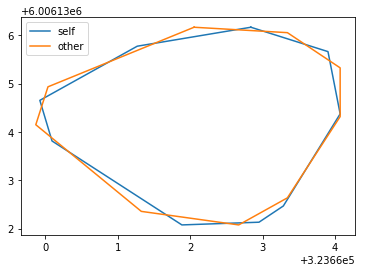

[[222 292]
 [221 293]
 [220 293]
 [219 294]
 [218 294]
 [217 294]
 [216 294]
 [215 295]
 [214 295]
 [213 295]
 [213 296]
 [212 297]
 [212 298]
 [211 299]
 [210 300]
 [209 301]
 [208 302]
 [207 303]
 [206 303]
 [205 304]
 [204 304]
 [203 305]
 [202 306]
 [201 307]
 [200 307]
 [199 308]
 [198 309]
 [197 310]
 [196 311]
 [195 311]
 [194 312]
 [193 313]
 [193 314]
 [192 315]
 [191 316]
 [190 317]
 [189 318]
 [188 318]
 [187 319]
 [186 320]
 [185 321]
 [184 322]
 [183 323]
 [183 324]
 [182 325]
 [181 326]
 [181 327]
 [180 328]
 [179 328]
 [178 329]
 [177 330]
 [176 331]
 [175 332]
 [174 333]
 [173 334]
 [173 335]
 [172 336]
 [171 337]
 [170 338]
 [169 339]
 [168 339]
 [167 340]
 [166 341]
 [165 342]
 [164 343]
 [163 344]
 [162 345]
 [162 346]
 [161 347]
 [161 348]
 [161 349]
 [160 350]
 [160 351]
 [159 352]
 [159 353]
 [159 354]
 [159 355]
 [158 356]
 [158 357]
 [158 358]
 [158 359]
 [158 360]
 [158 361]
 [158 362]
 [158 363]
 [158 364]
 [158 365]
 [158 366]
 [158 367]
 [158 368]
 [158 369]

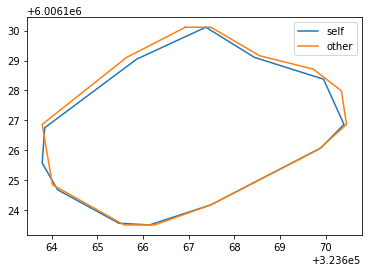

[[444 362]
 [443 363]
 [442 363]
 [441 363]
 [440 363]
 [439 364]
 [438 364]
 [437 364]
 [436 365]
 [435 365]
 [434 365]
 [433 366]
 [432 366]
 [431 367]
 [430 367]
 [429 367]
 [428 368]
 [427 368]
 [426 369]
 [425 369]
 [424 369]
 [423 370]
 [422 370]
 [421 370]
 [420 371]
 [419 371]
 [418 371]
 [417 372]
 [416 372]
 [415 372]
 [414 372]
 [413 373]
 [412 373]
 [411 373]
 [410 374]
 [409 374]
 [408 374]
 [407 374]
 [406 374]
 [405 375]
 [404 375]
 [403 375]
 [402 376]
 [401 376]
 [400 377]
 [399 377]
 [398 378]
 [397 379]
 [396 380]
 [395 381]
 [394 382]
 [393 383]
 [393 384]
 [392 385]
 [392 386]
 [391 387]
 [391 388]
 [390 389]
 [390 390]
 [389 391]
 [389 392]
 [389 393]
 [388 394]
 [388 395]
 [387 396]
 [387 397]
 [387 398]
 [386 399]
 [386 400]
 [386 401]
 [386 402]
 [385 403]
 [385 404]
 [385 405]
 [385 406]
 [385 407]
 [385 408]
 [384 409]
 [384 410]
 [384 411]
 [384 412]
 [384 413]
 [384 414]
 [384 415]
 [384 416]
 [384 417]
 [384 418]
 [384 419]
 [384 420]
 [385 421]
 [385 422]

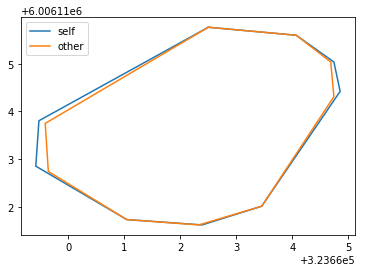

[[227 145]
 [226 146]
 [225 146]
 [224 146]
 [223 146]
 [222 146]
 [221 146]
 [220 147]
 [219 147]
 [218 147]
 [217 147]
 [216 148]
 [215 148]
 [214 148]
 [213 149]
 [212 149]
 [211 149]
 [210 149]
 [209 150]
 [208 151]
 [207 152]
 [206 152]
 [206 153]
 [205 154]
 [204 155]
 [203 156]
 [203 157]
 [202 158]
 [202 159]
 [201 160]
 [201 161]
 [200 162]
 [199 163]
 [199 164]
 [199 165]
 [198 166]
 [198 167]
 [197 168]
 [197 169]
 [197 170]
 [196 171]
 [196 172]
 [196 173]
 [195 174]
 [195 175]
 [195 176]
 [195 177]
 [195 178]
 [194 179]
 [194 180]
 [194 181]
 [194 182]
 [194 183]
 [194 184]
 [194 185]
 [194 186]
 [194 187]
 [194 188]
 [194 189]
 [194 190]
 [194 191]
 [194 192]
 [194 193]
 [194 194]
 [194 195]
 [194 196]
 [194 197]
 [194 198]
 [194 199]
 [194 200]
 [194 201]
 [194 202]
 [194 203]
 [194 204]
 [194 205]
 [195 206]
 [195 207]
 [195 208]
 [195 209]
 [195 210]
 [196 211]
 [196 212]
 [196 213]
 [196 214]
 [197 215]
 [197 216]
 [197 217]
 [198 218]
 [198 219]
 [199 220]
 [199 221]

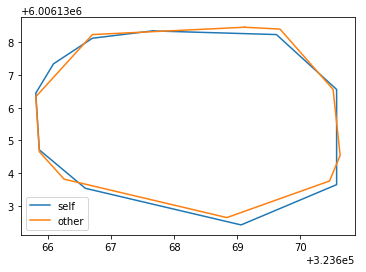

[[532  97]
 [531  98]
 [530  98]
 [529  98]
 [528  99]
 [527 100]
 [526 100]
 [525 101]
 [524 102]
 [523 103]
 [522 104]
 [521 105]
 [520 106]
 [520 107]
 [519 108]
 [518 108]
 [517 109]
 [516 109]
 [515 110]
 [514 110]
 [513 111]
 [512 111]
 [511 112]
 [510 112]
 [509 113]
 [508 113]
 [507 113]
 [506 113]
 [505 113]
 [504 113]
 [503 114]
 [502 114]
 [501 114]
 [500 115]
 [499 115]
 [498 116]
 [497 116]
 [496 117]
 [495 118]
 [494 118]
 [493 119]
 [492 119]
 [491 120]
 [490 121]
 [489 122]
 [488 123]
 [487 123]
 [486 124]
 [486 125]
 [485 126]
 [484 127]
 [484 128]
 [483 129]
 [483 130]
 [483 131]
 [482 132]
 [482 133]
 [482 134]
 [482 135]
 [482 136]
 [482 137]
 [482 138]
 [482 139]
 [482 140]
 [482 141]
 [482 142]
 [483 143]
 [483 144]
 [484 145]
 [484 146]
 [485 147]
 [485 148]
 [486 149]
 [486 150]
 [487 150]
 [488 151]
 [489 152]
 [490 153]
 [491 154]
 [491 155]
 [492 156]
 [492 157]
 [493 158]
 [493 159]
 [494 160]
 [494 161]
 [495 162]
 [495 163]
 [495 164]
 [495 165]
 [496 166]

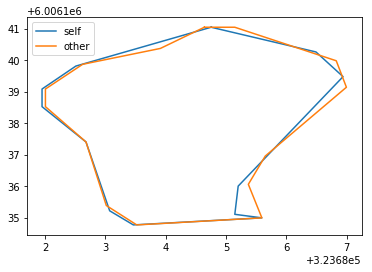

[[224  88]
 [223  89]
 [222  89]
 [221  89]
 [220  89]
 [219  90]
 [218  90]
 [217  91]
 [216  91]
 [215  92]
 [214  92]
 [213  93]
 [213  94]
 [212  95]
 [212  96]
 [211  97]
 [211  98]
 [210  99]
 [210 100]
 [210 101]
 [209 102]
 [209 103]
 [208 104]
 [208 105]
 [208 106]
 [208 107]
 [207 108]
 [207 109]
 [207 110]
 [207 111]
 [207 112]
 [207 113]
 [207 114]
 [206 115]
 [206 116]
 [206 117]
 [206 118]
 [205 119]
 [205 120]
 [205 121]
 [205 122]
 [205 123]
 [204 124]
 [204 125]
 [204 126]
 [204 127]
 [204 128]
 [203 129]
 [203 130]
 [203 131]
 [203 132]
 [203 133]
 [203 134]
 [203 135]
 [202 136]
 [203 137]
 [203 138]
 [203 139]
 [202 140]
 [202 141]
 [203 142]
 [203 143]
 [203 144]
 [204 145]
 [204 146]
 [205 147]
 [205 148]
 [206 149]
 [207 149]
 [208 149]
 [209 149]
 [210 149]
 [211 149]
 [212 149]
 [213 149]
 [214 148]
 [215 148]
 [216 148]
 [217 147]
 [218 147]
 [219 147]
 [220 147]
 [221 146]
 [222 146]
 [223 146]
 [224 146]
 [225 146]
 [226 146]
 [227 146]
 [228 146]
 [229 146]

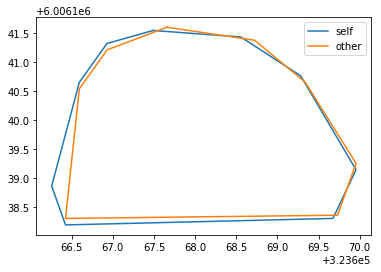

[[155 459]
 [154 460]
 [153 460]
 [152 460]
 [151 460]
 [150 460]
 [149 460]
 [148 460]
 [147 460]
 [146 460]
 [145 461]
 [144 461]
 [143 461]
 [142 461]
 [141 461]
 [140 462]
 [139 462]
 [138 462]
 [137 462]
 [136 462]
 [135 462]
 [134 463]
 [133 463]
 [132 463]
 [131 463]
 [130 464]
 [129 464]
 [128 464]
 [127 465]
 [126 465]
 [125 466]
 [124 466]
 [123 467]
 [122 467]
 [121 468]
 [120 468]
 [119 469]
 [118 469]
 [117 470]
 [116 470]
 [115 471]
 [114 472]
 [113 473]
 [112 474]
 [111 475]
 [110 476]
 [109 477]
 [109 478]
 [108 479]
 [108 480]
 [108 481]
 [108 482]
 [107 483]
 [107 484]
 [107 485]
 [107 486]
 [107 487]
 [107 488]
 [107 489]
 [107 490]
 [107 491]
 [107 492]
 [107 493]
 [107 494]
 [107 495]
 [107 496]
 [107 497]
 [107 498]
 [107 499]
 [107 500]
 [108 501]
 [108 502]
 [108 503]
 [109 504]
 [110 505]
 [110 506]
 [111 507]
 [111 508]
 [112 509]
 [112 510]
 [113 511]
 [113 512]
 [114 513]
 [115 514]
 [115 515]
 [116 516]
 [117 517]
 [117 518]
 [118 519]
 [119 520]
 [119 521]

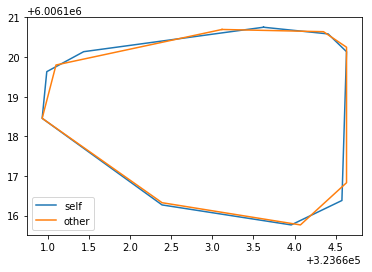

[[ 66 255]
 [ 65 256]
 [ 64 256]
 [ 63 257]
 [ 62 257]
 [ 61 258]
 [ 60 258]
 [ 59 259]
 [ 58 260]
 [ 57 260]
 [ 56 261]
 [ 55 262]
 [ 54 263]
 [ 53 264]
 [ 52 265]
 [ 52 266]
 [ 51 267]
 [ 50 268]
 [ 50 269]
 [ 50 270]
 [ 50 271]
 [ 50 272]
 [ 50 273]
 [ 50 274]
 [ 50 275]
 [ 50 276]
 [ 51 277]
 [ 51 278]
 [ 51 279]
 [ 52 280]
 [ 52 281]
 [ 52 282]
 [ 53 283]
 [ 53 284]
 [ 53 285]
 [ 54 286]
 [ 54 287]
 [ 55 288]
 [ 55 289]
 [ 56 290]
 [ 56 291]
 [ 56 292]
 [ 57 293]
 [ 58 294]
 [ 58 295]
 [ 59 296]
 [ 59 297]
 [ 60 298]
 [ 60 299]
 [ 61 300]
 [ 61 301]
 [ 62 302]
 [ 62 303]
 [ 62 304]
 [ 63 305]
 [ 63 306]
 [ 64 307]
 [ 64 308]
 [ 65 309]
 [ 65 310]
 [ 66 311]
 [ 66 312]
 [ 67 313]
 [ 68 314]
 [ 68 315]
 [ 69 316]
 [ 69 317]
 [ 70 318]
 [ 70 319]
 [ 71 320]
 [ 71 321]
 [ 72 322]
 [ 72 323]
 [ 73 324]
 [ 73 325]
 [ 74 326]
 [ 74 327]
 [ 75 328]
 [ 75 329]
 [ 76 330]
 [ 76 331]
 [ 76 332]
 [ 77 333]
 [ 77 334]
 [ 78 335]
 [ 78 336]
 [ 78 337]
 [ 79 338]
 [ 79 339]
 [ 80 340]
 [ 81 341]

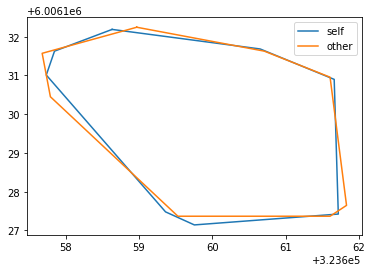

[[503 458]
 [502 459]
 [501 459]
 [500 459]
 [499 460]
 [498 460]
 [497 460]
 [496 460]
 [495 460]
 [494 461]
 [493 461]
 [492 462]
 [491 462]
 [490 462]
 [489 463]
 [488 463]
 [487 463]
 [486 464]
 [485 464]
 [484 465]
 [483 465]
 [482 466]
 [481 467]
 [480 468]
 [479 469]
 [478 470]
 [477 470]
 [476 470]
 [475 471]
 [474 471]
 [473 472]
 [472 473]
 [471 473]
 [470 474]
 [469 474]
 [468 474]
 [467 474]
 [466 474]
 [465 474]
 [464 475]
 [463 476]
 [462 476]
 [461 477]
 [460 478]
 [459 478]
 [458 478]
 [457 479]
 [456 479]
 [455 480]
 [454 481]
 [453 482]
 [453 483]
 [452 484]
 [452 485]
 [451 486]
 [451 487]
 [450 488]
 [450 489]
 [450 490]
 [449 491]
 [449 492]
 [449 493]
 [449 494]
 [449 495]
 [449 496]
 [449 497]
 [449 498]
 [448 499]
 [448 500]
 [448 501]
 [448 502]
 [448 503]
 [448 504]
 [448 505]
 [448 506]
 [448 507]
 [448 508]
 [448 509]
 [449 510]
 [449 511]
 [449 512]
 [449 513]
 [449 514]
 [450 515]
 [450 516]
 [450 517]
 [451 518]
 [451 519]
 [451 520]
 [452 521]
 [452 522]

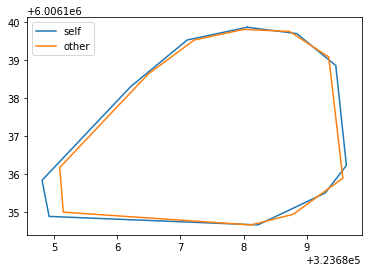

[[ 98 499]
 [ 97 500]
 [ 96 500]
 [ 95 500]
 [ 94 500]
 [ 93 501]
 [ 92 501]
 [ 91 501]
 [ 90 501]
 [ 89 502]
 [ 88 502]
 [ 87 502]
 [ 86 502]
 [ 85 502]
 [ 84 502]
 [ 83 502]
 [ 82 502]
 [ 81 502]
 [ 80 502]
 [ 79 502]
 [ 78 502]
 [ 77 502]
 [ 76 503]
 [ 75 503]
 [ 74 503]
 [ 73 504]
 [ 72 504]
 [ 71 504]
 [ 70 505]
 [ 69 505]
 [ 68 506]
 [ 67 507]
 [ 66 507]
 [ 65 508]
 [ 64 509]
 [ 63 510]
 [ 62 511]
 [ 62 512]
 [ 61 513]
 [ 61 514]
 [ 61 515]
 [ 61 516]
 [ 61 517]
 [ 61 518]
 [ 61 519]
 [ 61 520]
 [ 61 521]
 [ 61 522]
 [ 61 523]
 [ 62 524]
 [ 62 525]
 [ 62 526]
 [ 62 527]
 [ 62 528]
 [ 62 529]
 [ 62 530]
 [ 63 531]
 [ 63 532]
 [ 63 533]
 [ 63 534]
 [ 63 535]
 [ 63 536]
 [ 63 537]
 [ 64 538]
 [ 64 539]
 [ 64 540]
 [ 64 541]
 [ 64 542]
 [ 64 543]
 [ 64 544]
 [ 64 545]
 [ 64 546]
 [ 65 547]
 [ 65 548]
 [ 65 549]
 [ 65 550]
 [ 65 551]
 [ 65 552]
 [ 65 553]
 [ 66 554]
 [ 66 555]
 [ 66 556]
 [ 66 557]
 [ 66 558]
 [ 66 559]
 [ 66 560]
 [ 67 561]
 [ 67 562]
 [ 67 563]
 [ 67 564]
 [ 68 565]

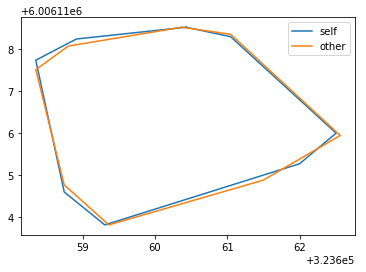

[[368 214]
 [367 215]
 [366 215]
 [365 216]
 [364 216]
 [363 216]
 [362 215]
 [361 215]
 [360 215]
 [359 215]
 [358 215]
 [357 216]
 [356 216]
 [355 216]
 [354 217]
 [353 217]
 [352 217]
 [351 217]
 [350 217]
 [349 217]
 [348 217]
 [347 217]
 [346 217]
 [345 217]
 [344 217]
 [343 217]
 [342 217]
 [341 217]
 [340 217]
 [339 217]
 [338 217]
 [337 217]
 [336 217]
 [335 217]
 [334 217]
 [333 217]
 [332 217]
 [331 217]
 [330 217]
 [329 217]
 [328 217]
 [327 218]
 [326 218]
 [325 218]
 [324 218]
 [323 219]
 [322 219]
 [321 219]
 [320 220]
 [319 220]
 [318 221]
 [317 221]
 [316 222]
 [315 222]
 [314 223]
 [313 224]
 [312 224]
 [311 225]
 [310 225]
 [309 226]
 [308 226]
 [307 227]
 [306 228]
 [305 228]
 [304 229]
 [303 229]
 [302 230]
 [301 231]
 [300 232]
 [299 233]
 [298 233]
 [297 234]
 [296 234]
 [295 235]
 [294 236]
 [293 236]
 [292 237]
 [291 238]
 [290 238]
 [289 239]
 [289 240]
 [288 241]
 [287 242]
 [286 243]
 [286 244]
 [286 245]
 [285 246]
 [284 247]
 [284 248]
 [284 249]
 [284 250]

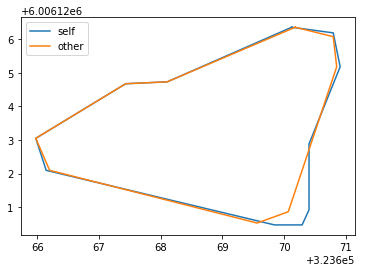

[[504 387]
 [503 388]
 [502 389]
 [501 389]
 [500 390]
 [499 391]
 [498 391]
 [498 392]
 [497 393]
 [496 394]
 [495 395]
 [494 396]
 [493 397]
 [493 398]
 [492 399]
 [491 400]
 [491 401]
 [490 402]
 [489 403]
 [489 404]
 [489 405]
 [488 406]
 [488 407]
 [488 408]
 [487 409]
 [487 410]
 [487 411]
 [487 412]
 [487 413]
 [487 414]
 [487 415]
 [487 416]
 [487 417]
 [487 418]
 [487 419]
 [488 420]
 [488 421]
 [488 422]
 [488 423]
 [488 424]
 [489 425]
 [489 426]
 [489 427]
 [490 428]
 [490 429]
 [491 430]
 [491 431]
 [492 432]
 [492 433]
 [493 434]
 [493 435]
 [494 436]
 [495 437]
 [495 438]
 [496 439]
 [497 440]
 [498 441]
 [498 442]
 [499 443]
 [500 444]
 [501 444]
 [502 445]
 [503 445]
 [504 446]
 [505 446]
 [506 447]
 [507 447]
 [508 447]
 [509 447]
 [510 447]
 [511 448]
 [512 448]
 [513 448]
 [514 448]
 [515 448]
 [516 449]
 [517 449]
 [518 449]
 [519 449]
 [520 450]
 [521 450]
 [522 450]
 [523 451]
 [524 451]
 [525 451]
 [526 451]
 [527 452]
 [528 452]
 [529 452]
 [530 452]
 [531 453]

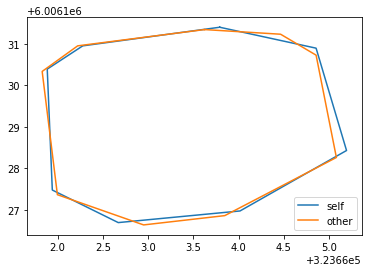

[[551  25]
 [550  26]
 [549  27]
 [548  28]
 [547  28]
 [546  29]
 [546  30]
 [545  31]
 [545  32]
 [544  33]
 [543  34]
 [543  35]
 [542  36]
 [541  37]
 [541  38]
 [540  39]
 [539  40]
 [539  41]
 [538  42]
 [537  43]
 [537  44]
 [536  45]
 [535  46]
 [535  47]
 [534  48]
 [534  49]
 [533  50]
 [533  51]
 [533  52]
 [532  53]
 [532  54]
 [532  55]
 [532  56]
 [532  57]
 [532  58]
 [532  59]
 [531  60]
 [531  61]
 [531  62]
 [531  63]
 [531  64]
 [531  65]
 [531  66]
 [531  67]
 [531  68]
 [531  69]
 [531  70]
 [531  71]
 [531  72]
 [531  73]
 [531  74]
 [531  75]
 [532  76]
 [532  77]
 [532  78]
 [532  79]
 [532  80]
 [532  81]
 [532  82]
 [533  83]
 [533  84]
 [533  85]
 [533  86]
 [533  87]
 [534  88]
 [534  89]
 [534  90]
 [535  91]
 [535  92]
 [536  93]
 [536  94]
 [536  95]
 [537  96]
 [538  97]
 [539  98]
 [540  98]
 [541  99]
 [542  99]
 [543 100]
 [544 101]
 [545 102]
 [546 102]
 [547 103]
 [548 103]
 [549 104]
 [550 104]
 [551 105]
 [552 105]
 [553 106]
 [554 107]
 [555 108]

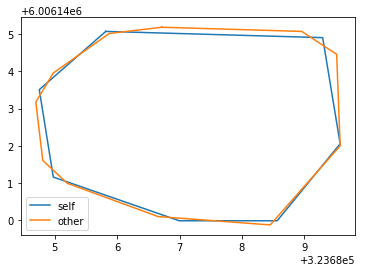

11it [00:14,  1.55s/it]

[[289 371]
 [288 372]
 [287 372]
 [287 373]
 [287 374]
 [287 375]
 [287 376]
 [286 377]
 [286 378]
 [286 379]
 [285 380]
 [284 381]
 [283 382]
 [283 383]
 [282 384]
 [282 385]
 [282 386]
 [282 387]
 [282 388]
 [281 389]
 [281 390]
 [281 391]
 [280 392]
 [280 393]
 [280 394]
 [280 395]
 [279 396]
 [279 397]
 [279 398]
 [278 399]
 [278 400]
 [278 401]
 [278 402]
 [278 403]
 [277 404]
 [277 405]
 [277 406]
 [277 407]
 [277 408]
 [277 409]
 [277 410]
 [276 411]
 [276 412]
 [276 413]
 [276 414]
 [276 415]
 [276 416]
 [276 417]
 [276 418]
 [275 419]
 [275 420]
 [275 421]
 [275 422]
 [275 423]
 [275 424]
 [274 425]
 [274 426]
 [274 427]
 [274 428]
 [274 429]
 [274 430]
 [274 431]
 [273 432]
 [273 433]
 [273 434]
 [273 435]
 [272 436]
 [272 437]
 [272 438]
 [272 439]
 [272 440]
 [271 441]
 [271 442]
 [271 443]
 [271 444]
 [270 445]
 [270 446]
 [270 447]
 [270 448]
 [270 449]
 [270 450]
 [271 451]
 [271 452]
 [271 453]
 [271 454]
 [271 455]
 [271 456]
 [271 457]
 [271 458]
 [271 459]
 [271 460]

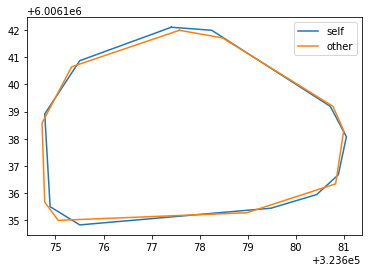

[[411 370]
 [410 371]
 [409 371]
 [408 371]
 [407 371]
 [406 371]
 [405 371]
 [404 372]
 [403 372]
 [402 372]
 [401 372]
 [400 373]
 [399 373]
 [398 373]
 [397 374]
 [396 374]
 [395 375]
 [394 376]
 [393 377]
 [392 378]
 [391 379]
 [391 380]
 [390 381]
 [389 382]
 [388 383]
 [388 384]
 [387 385]
 [386 386]
 [385 387]
 [384 388]
 [383 388]
 [382 389]
 [382 390]
 [381 391]
 [380 391]
 [379 392]
 [378 393]
 [377 394]
 [376 395]
 [375 395]
 [374 396]
 [373 397]
 [372 398]
 [371 399]
 [370 400]
 [369 401]
 [368 402]
 [367 403]
 [366 404]
 [365 405]
 [364 406]
 [363 407]
 [363 408]
 [363 409]
 [363 410]
 [363 411]
 [364 412]
 [364 413]
 [364 414]
 [365 415]
 [365 416]
 [365 417]
 [366 418]
 [366 419]
 [366 420]
 [367 421]
 [367 422]
 [368 423]
 [368 424]
 [369 425]
 [369 426]
 [370 427]
 [370 428]
 [371 429]
 [371 430]
 [372 431]
 [372 432]
 [372 433]
 [372 434]
 [373 435]
 [373 436]
 [374 437]
 [374 438]
 [374 439]
 [375 440]
 [375 441]
 [376 442]
 [376 443]
 [376 444]
 [377 445]
 [377 446]

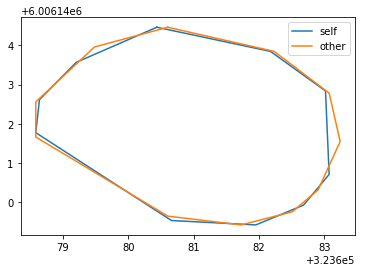

[[320 307]
 [319 308]
 [318 308]
 [317 308]
 [316 308]
 [315 308]
 [314 308]
 [313 309]
 [312 309]
 [311 309]
 [310 310]
 [309 310]
 [308 310]
 [307 311]
 [306 311]
 [305 312]
 [304 312]
 [303 313]
 [302 313]
 [301 314]
 [300 314]
 [299 315]
 [298 315]
 [297 316]
 [296 317]
 [295 318]
 [294 318]
 [293 318]
 [292 318]
 [291 319]
 [290 319]
 [289 320]
 [288 321]
 [287 322]
 [286 323]
 [285 323]
 [284 324]
 [283 325]
 [282 326]
 [281 327]
 [281 328]
 [280 329]
 [279 330]
 [279 331]
 [278 332]
 [278 333]
 [277 334]
 [277 335]
 [276 336]
 [276 337]
 [276 338]
 [275 339]
 [275 340]
 [275 341]
 [275 342]
 [274 343]
 [274 344]
 [274 345]
 [274 346]
 [274 347]
 [273 348]
 [273 349]
 [273 350]
 [273 351]
 [273 352]
 [273 353]
 [273 354]
 [273 355]
 [273 356]
 [273 357]
 [273 358]
 [273 359]
 [273 360]
 [273 361]
 [273 362]
 [273 363]
 [273 364]
 [273 365]
 [273 366]
 [273 367]
 [273 368]
 [273 369]
 [274 370]
 [274 371]
 [274 372]
 [274 373]
 [275 374]
 [275 375]
 [276 376]
 [276 377]
 [277 378]

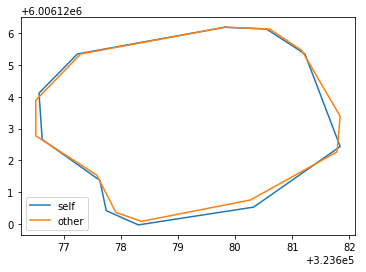

[[531 269]
 [530 270]
 [529 270]
 [528 270]
 [527 270]
 [526 270]
 [525 270]
 [524 270]
 [523 270]
 [522 271]
 [521 271]
 [520 271]
 [519 271]
 [518 271]
 [517 271]
 [516 271]
 [515 272]
 [514 272]
 [513 272]
 [512 272]
 [511 272]
 [510 272]
 [509 272]
 [508 272]
 [507 273]
 [506 273]
 [505 273]
 [504 273]
 [503 273]
 [502 273]
 [501 274]
 [500 274]
 [499 275]
 [498 275]
 [497 276]
 [496 277]
 [495 278]
 [494 279]
 [493 280]
 [493 281]
 [493 282]
 [492 283]
 [492 284]
 [492 285]
 [491 286]
 [491 287]
 [491 288]
 [491 289]
 [490 290]
 [490 291]
 [490 292]
 [490 293]
 [490 294]
 [490 295]
 [489 296]
 [489 297]
 [489 298]
 [489 299]
 [489 300]
 [489 301]
 [489 302]
 [489 303]
 [489 304]
 [489 305]
 [488 306]
 [488 307]
 [488 308]
 [488 309]
 [488 310]
 [488 311]
 [488 312]
 [488 313]
 [488 314]
 [488 315]
 [488 316]
 [488 317]
 [488 318]
 [488 319]
 [488 320]
 [488 321]
 [488 322]
 [488 323]
 [488 324]
 [488 325]
 [488 326]
 [488 327]
 [488 328]
 [488 329]
 [489 330]
 [490 331]
 [491 332]

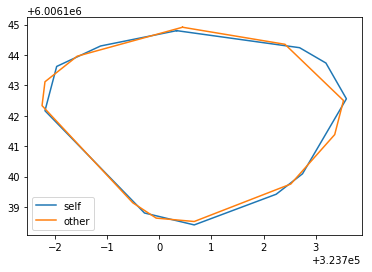

[[276  21]
 [275  22]
 [274  22]
 [273  22]
 [272  22]
 [271  22]
 [270  22]
 [269  22]
 [268  22]
 [267  22]
 [266  22]
 [265  22]
 [264  22]
 [263  22]
 [262  22]
 [261  22]
 [260  22]
 [259  23]
 [258  23]
 [257  23]
 [256  23]
 [255  22]
 [254  22]
 [253  22]
 [252  23]
 [251  23]
 [250  22]
 [249  22]
 [248  22]
 [247  22]
 [246  22]
 [245  22]
 [244  22]
 [243  22]
 [242  23]
 [241  23]
 [240  23]
 [239  23]
 [238  23]
 [237  23]
 [236  23]
 [235  23]
 [234  24]
 [233  24]
 [232  24]
 [231  25]
 [230  26]
 [229  26]
 [229  27]
 [228  28]
 [227  29]
 [227  30]
 [226  31]
 [225  32]
 [225  33]
 [224  34]
 [223  35]
 [223  36]
 [222  37]
 [222  38]
 [221  39]
 [220  40]
 [219  41]
 [218  42]
 [218  43]
 [217  44]
 [216  45]
 [216  46]
 [215  47]
 [214  48]
 [214  49]
 [214  50]
 [213  51]
 [213  52]
 [213  53]
 [213  54]
 [212  55]
 [212  56]
 [212  57]
 [212  58]
 [212  59]
 [212  60]
 [211  61]
 [211  62]
 [211  63]
 [211  64]
 [211  65]
 [211  66]
 [211  67]
 [211  68]
 [211  69]

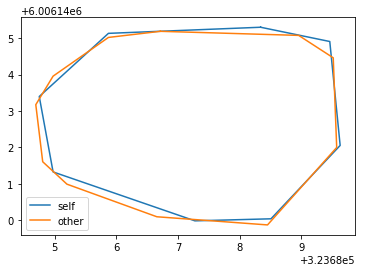

[[271 119]
 [270 120]
 [269 120]
 [268 120]
 [267 120]
 [266 120]
 [265 120]
 [264 121]
 [263 121]
 [262 121]
 [261 121]
 [260 122]
 [259 122]
 [258 123]
 [257 123]
 [256 124]
 [255 124]
 [254 125]
 [253 126]
 [252 127]
 [251 128]
 [251 129]
 [250 130]
 [250 131]
 [249 132]
 [248 133]
 [248 134]
 [247 135]
 [247 136]
 [246 137]
 [245 138]
 [244 139]
 [244 140]
 [243 141]
 [243 142]
 [242 143]
 [241 144]
 [241 145]
 [240 146]
 [239 146]
 [239 147]
 [238 148]
 [238 149]
 [238 150]
 [238 151]
 [237 152]
 [237 153]
 [237 154]
 [237 155]
 [236 156]
 [236 157]
 [235 158]
 [234 159]
 [233 160]
 [233 161]
 [232 162]
 [232 163]
 [231 164]
 [231 165]
 [230 166]
 [229 167]
 [229 168]
 [228 169]
 [228 170]
 [227 171]
 [226 172]
 [226 173]
 [225 174]
 [224 175]
 [224 176]
 [223 177]
 [222 178]
 [222 179]
 [221 180]
 [220 181]
 [220 182]
 [219 183]
 [219 184]
 [218 185]
 [218 186]
 [217 187]
 [216 188]
 [216 189]
 [215 190]
 [215 191]
 [215 192]
 [215 193]
 [214 194]
 [214 195]
 [214 196]
 [214 197]

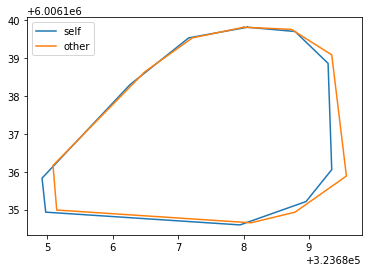

[[182 458]
 [181 459]
 [180 459]
 [179 459]
 [178 459]
 [177 459]
 [176 459]
 [175 459]
 [174 459]
 [173 459]
 [172 459]
 [171 460]
 [170 460]
 [169 460]
 [168 460]
 [167 461]
 [166 461]
 [165 462]
 [164 462]
 [163 463]
 [162 464]
 [161 465]
 [160 466]
 [159 467]
 [158 468]
 [157 468]
 [156 469]
 [155 469]
 [154 470]
 [153 471]
 [152 472]
 [151 472]
 [150 473]
 [149 473]
 [148 473]
 [147 473]
 [146 473]
 [145 474]
 [144 475]
 [143 476]
 [142 476]
 [141 477]
 [140 477]
 [139 478]
 [138 478]
 [137 479]
 [136 479]
 [136 480]
 [135 481]
 [135 482]
 [134 483]
 [134 484]
 [133 485]
 [132 486]
 [132 487]
 [132 488]
 [131 489]
 [131 490]
 [131 491]
 [131 492]
 [130 493]
 [130 494]
 [130 495]
 [130 496]
 [130 497]
 [129 498]
 [129 499]
 [129 500]
 [129 501]
 [129 502]
 [129 503]
 [129 504]
 [129 505]
 [129 506]
 [129 507]
 [129 508]
 [129 509]
 [129 510]
 [129 511]
 [129 512]
 [130 513]
 [130 514]
 [130 515]
 [130 516]
 [130 517]
 [131 518]
 [131 519]
 [131 520]
 [132 521]
 [132 522]
 [132 523]

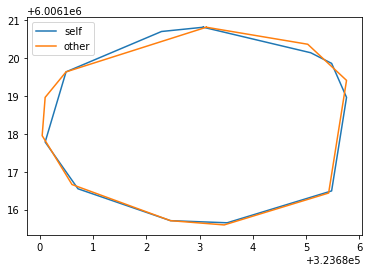

[[488 462]
 [487 463]
 [486 463]
 [485 463]
 [484 463]
 [483 463]
 [482 463]
 [481 464]
 [480 464]
 [479 464]
 [478 465]
 [477 465]
 [476 466]
 [475 467]
 [474 467]
 [473 468]
 [472 469]
 [471 470]
 [470 471]
 [469 472]
 [469 473]
 [468 474]
 [467 475]
 [467 476]
 [466 477]
 [466 478]
 [465 479]
 [465 480]
 [464 481]
 [463 482]
 [462 483]
 [462 484]
 [461 485]
 [460 486]
 [460 487]
 [459 488]
 [458 489]
 [458 490]
 [457 491]
 [456 492]
 [456 493]
 [455 494]
 [455 495]
 [454 496]
 [453 497]
 [453 498]
 [452 499]
 [452 500]
 [451 501]
 [451 502]
 [450 503]
 [450 504]
 [450 505]
 [450 506]
 [450 507]
 [450 508]
 [450 509]
 [451 510]
 [452 511]
 [453 512]
 [454 513]
 [455 514]
 [456 514]
 [457 515]
 [458 516]
 [459 516]
 [460 517]
 [461 518]
 [462 518]
 [463 519]
 [464 520]
 [465 520]
 [466 521]
 [467 521]
 [468 522]
 [469 522]
 [470 523]
 [471 523]
 [472 524]
 [473 524]
 [474 525]
 [475 526]
 [476 527]
 [477 527]
 [478 528]
 [479 529]
 [480 529]
 [481 530]
 [482 531]
 [483 532]
 [484 533]

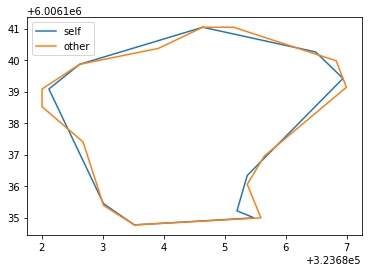

[[434  74]
 [433  75]
 [432  75]
 [431  75]
 [430  75]
 [429  75]
 [428  75]
 [427  76]
 [426  76]
 [425  76]
 [424  77]
 [423  77]
 [422  78]
 [421  78]
 [420  79]
 [419  79]
 [418  80]
 [417  80]
 [416  81]
 [415  82]
 [414  82]
 [413  83]
 [412  84]
 [411  84]
 [410  85]
 [409  85]
 [408  86]
 [407  86]
 [406  87]
 [405  87]
 [404  87]
 [403  88]
 [402  88]
 [401  89]
 [400  89]
 [399  90]
 [398  90]
 [397  91]
 [396  91]
 [395  92]
 [394  92]
 [393  93]
 [392  93]
 [391  94]
 [390  94]
 [389  95]
 [388  95]
 [387  95]
 [386  95]
 [385  96]
 [384  96]
 [383  97]
 [382  97]
 [381  97]
 [380  98]
 [379  98]
 [378  99]
 [377 100]
 [376 101]
 [375 101]
 [374 102]
 [373 103]
 [373 104]
 [372 105]
 [372 106]
 [372 107]
 [372 108]
 [372 109]
 [372 110]
 [372 111]
 [372 112]
 [371 113]
 [371 114]
 [371 115]
 [371 116]
 [372 117]
 [372 118]
 [373 119]
 [373 120]
 [373 121]
 [373 122]
 [374 123]
 [374 124]
 [375 125]
 [375 126]
 [376 127]
 [376 128]
 [376 129]
 [375 130]
 [374 131]
 [373 132]

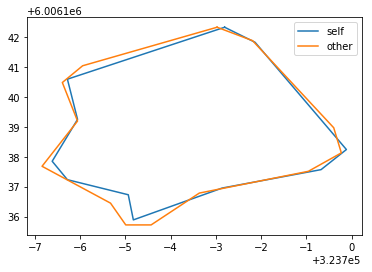

[[340 109]
 [339 110]
 [338 110]
 [337 110]
 [336 111]
 [335 111]
 [334 111]
 [333 112]
 [332 112]
 [331 113]
 [330 113]
 [329 114]
 [328 114]
 [327 114]
 [326 115]
 [325 115]
 [324 116]
 [323 117]
 [322 117]
 [321 118]
 [320 119]
 [319 119]
 [318 120]
 [317 120]
 [316 121]
 [315 122]
 [314 123]
 [313 123]
 [312 124]
 [311 125]
 [310 125]
 [309 125]
 [308 125]
 [307 126]
 [306 126]
 [305 127]
 [304 127]
 [303 127]
 [302 127]
 [301 128]
 [300 128]
 [299 129]
 [298 129]
 [297 130]
 [296 131]
 [296 132]
 [296 133]
 [295 134]
 [295 135]
 [295 136]
 [295 137]
 [295 138]
 [294 139]
 [294 140]
 [294 141]
 [295 142]
 [295 143]
 [295 144]
 [295 145]
 [295 146]
 [295 147]
 [295 148]
 [295 149]
 [295 150]
 [295 151]
 [295 152]
 [295 153]
 [295 154]
 [295 155]
 [295 156]
 [295 157]
 [295 158]
 [295 159]
 [295 160]
 [295 161]
 [295 162]
 [295 163]
 [295 164]
 [295 165]
 [295 166]
 [295 167]
 [295 168]
 [295 169]
 [296 170]
 [296 171]
 [296 172]
 [296 173]
 [296 174]
 [296 175]
 [296 176]
 [296 177]

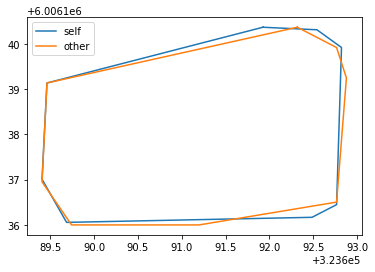

[[ 94 301]
 [ 93 302]
 [ 92 302]
 [ 91 303]
 [ 90 303]
 [ 89 304]
 [ 88 305]
 [ 87 306]
 [ 86 307]
 [ 85 308]
 [ 84 309]
 [ 83 310]
 [ 82 311]
 [ 81 312]
 [ 81 313]
 [ 80 314]
 [ 79 315]
 [ 78 316]
 [ 77 317]
 [ 76 318]
 [ 76 319]
 [ 75 320]
 [ 74 321]
 [ 73 322]
 [ 72 323]
 [ 71 324]
 [ 70 325]
 [ 69 326]
 [ 69 327]
 [ 68 328]
 [ 67 329]
 [ 67 330]
 [ 66 331]
 [ 66 332]
 [ 66 333]
 [ 65 334]
 [ 65 335]
 [ 65 336]
 [ 65 337]
 [ 65 338]
 [ 65 339]
 [ 65 340]
 [ 65 341]
 [ 65 342]
 [ 65 343]
 [ 65 344]
 [ 65 345]
 [ 65 346]
 [ 65 347]
 [ 65 348]
 [ 65 349]
 [ 65 350]
 [ 65 351]
 [ 65 352]
 [ 65 353]
 [ 65 354]
 [ 65 355]
 [ 65 356]
 [ 65 357]
 [ 65 358]
 [ 65 359]
 [ 65 360]
 [ 65 361]
 [ 66 362]
 [ 66 363]
 [ 66 364]
 [ 66 365]
 [ 67 366]
 [ 67 367]
 [ 67 368]
 [ 67 369]
 [ 68 370]
 [ 68 371]
 [ 69 372]
 [ 69 373]
 [ 70 373]
 [ 71 374]
 [ 72 374]
 [ 73 374]
 [ 74 374]
 [ 75 374]
 [ 76 374]
 [ 77 374]
 [ 78 374]
 [ 79 374]
 [ 80 374]
 [ 81 374]
 [ 82 374]
 [ 83 374]
 [ 84 374]
 [ 85 374]

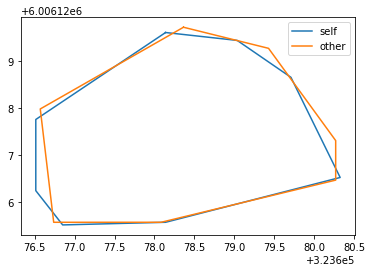

[[189 385]
 [188 386]
 [187 386]
 [186 386]
 [185 386]
 [184 386]
 [183 387]
 [182 387]
 [181 388]
 [180 388]
 [179 389]
 [178 389]
 [177 390]
 [176 391]
 [175 392]
 [174 393]
 [173 394]
 [173 395]
 [172 396]
 [171 397]
 [170 398]
 [169 399]
 [169 400]
 [169 401]
 [169 402]
 [168 403]
 [168 404]
 [168 405]
 [168 406]
 [167 407]
 [167 408]
 [167 409]
 [167 410]
 [167 411]
 [167 412]
 [167 413]
 [167 414]
 [168 415]
 [168 416]
 [168 417]
 [168 418]
 [168 419]
 [168 420]
 [168 421]
 [168 422]
 [169 423]
 [169 424]
 [169 425]
 [169 426]
 [170 427]
 [170 428]
 [170 429]
 [171 430]
 [171 431]
 [172 432]
 [172 433]
 [173 434]
 [173 435]
 [174 436]
 [175 437]
 [175 438]
 [176 439]
 [177 440]
 [178 441]
 [178 442]
 [179 443]
 [180 443]
 [181 444]
 [182 445]
 [183 445]
 [184 446]
 [185 446]
 [186 447]
 [187 447]
 [188 447]
 [189 448]
 [190 448]
 [191 448]
 [192 448]
 [193 448]
 [194 448]
 [195 449]
 [196 449]
 [197 449]
 [198 449]
 [199 449]
 [200 450]
 [201 450]
 [202 450]
 [203 450]
 [204 451]

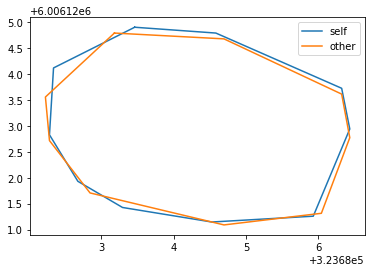

[[436 244]
 [435 245]
 [434 245]
 [433 245]
 [432 245]
 [431 245]
 [430 245]
 [429 246]
 [428 247]
 [427 248]
 [426 248]
 [425 249]
 [424 250]
 [424 251]
 [424 252]
 [423 253]
 [423 254]
 [422 255]
 [421 256]
 [421 257]
 [421 258]
 [420 259]
 [420 260]
 [419 261]
 [419 262]
 [419 263]
 [418 264]
 [418 265]
 [418 266]
 [418 267]
 [417 268]
 [417 269]
 [417 270]
 [417 271]
 [417 272]
 [417 273]
 [417 274]
 [417 275]
 [417 276]
 [417 277]
 [416 278]
 [416 279]
 [416 280]
 [416 281]
 [416 282]
 [416 283]
 [416 284]
 [416 285]
 [416 286]
 [416 287]
 [415 288]
 [416 289]
 [416 290]
 [416 291]
 [416 292]
 [416 293]
 [416 294]
 [416 295]
 [417 296]
 [417 297]
 [418 298]
 [418 299]
 [419 300]
 [419 301]
 [420 302]
 [420 303]
 [421 304]
 [421 305]
 [422 306]
 [423 306]
 [424 307]
 [425 308]
 [426 309]
 [427 310]
 [428 310]
 [429 311]
 [430 311]
 [431 312]
 [432 313]
 [433 313]
 [434 314]
 [435 314]
 [436 315]
 [437 315]
 [438 316]
 [439 317]
 [440 317]
 [441 317]
 [442 318]
 [443 318]
 [444 318]

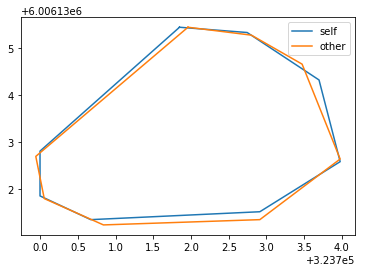

[[405 304]
 [404 305]
 [403 305]
 [402 305]
 [401 305]
 [400 305]
 [399 305]
 [398 305]
 [397 305]
 [396 305]
 [395 306]
 [394 306]
 [393 306]
 [392 307]
 [391 307]
 [390 308]
 [389 308]
 [388 308]
 [387 309]
 [386 310]
 [385 310]
 [384 311]
 [383 312]
 [382 313]
 [381 314]
 [381 315]
 [380 316]
 [380 317]
 [380 318]
 [379 319]
 [379 320]
 [379 321]
 [379 322]
 [378 323]
 [378 324]
 [378 325]
 [378 326]
 [378 327]
 [378 328]
 [378 329]
 [378 330]
 [378 331]
 [378 332]
 [378 333]
 [378 334]
 [378 335]
 [378 336]
 [378 337]
 [377 338]
 [377 339]
 [377 340]
 [377 341]
 [377 342]
 [377 343]
 [377 344]
 [377 345]
 [377 346]
 [377 347]
 [377 348]
 [377 349]
 [377 350]
 [377 351]
 [378 352]
 [378 353]
 [378 354]
 [378 355]
 [379 356]
 [379 357]
 [380 358]
 [381 359]
 [382 359]
 [383 360]
 [384 361]
 [385 361]
 [386 362]
 [386 363]
 [387 363]
 [388 364]
 [389 364]
 [390 365]
 [391 366]
 [392 366]
 [393 367]
 [394 368]
 [395 368]
 [396 369]
 [397 369]
 [398 369]
 [399 369]
 [400 369]
 [401 370]

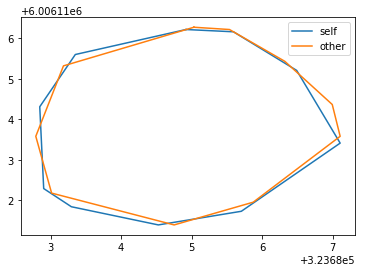

[[371 109]
 [370 110]
 [369 110]
 [368 110]
 [367 110]
 [366 110]
 [365 110]
 [365 111]
 [364 112]
 [364 113]
 [363 114]
 [363 115]
 [363 116]
 [363 117]
 [363 118]
 [363 119]
 [363 120]
 [363 121]
 [362 122]
 [362 123]
 [362 124]
 [361 125]
 [361 126]
 [361 127]
 [361 128]
 [361 129]
 [361 130]
 [361 131]
 [362 132]
 [362 133]
 [362 134]
 [362 135]
 [362 136]
 [362 137]
 [361 138]
 [361 139]
 [361 140]
 [361 141]
 [361 142]
 [361 143]
 [361 144]
 [361 145]
 [360 146]
 [360 147]
 [360 148]
 [359 149]
 [359 150]
 [359 151]
 [359 152]
 [358 153]
 [358 154]
 [358 155]
 [357 156]
 [357 157]
 [357 158]
 [357 159]
 [357 160]
 [356 161]
 [356 162]
 [356 163]
 [356 164]
 [356 165]
 [355 166]
 [355 167]
 [355 168]
 [355 169]
 [355 170]
 [355 171]
 [355 172]
 [355 173]
 [355 174]
 [355 175]
 [356 176]
 [356 177]
 [356 178]
 [356 179]
 [357 180]
 [357 181]
 [357 182]
 [358 183]
 [358 184]
 [358 185]
 [359 186]
 [359 187]
 [360 188]
 [361 189]
 [362 190]
 [362 191]
 [363 192]
 [364 193]
 [365 194]

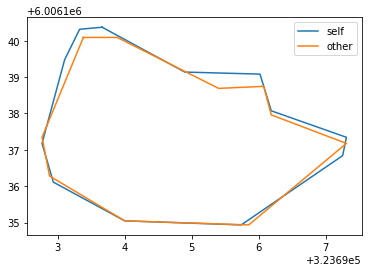

[[391 232]
 [390 233]
 [389 233]
 [388 233]
 [387 234]
 [386 234]
 [385 235]
 [384 236]
 [383 237]
 [382 238]
 [382 239]
 [381 240]
 [380 241]
 [379 242]
 [379 243]
 [378 244]
 [377 245]
 [376 246]
 [375 247]
 [374 248]
 [373 249]
 [372 250]
 [371 251]
 [371 252]
 [370 253]
 [370 254]
 [370 255]
 [369 256]
 [369 257]
 [369 258]
 [369 259]
 [369 260]
 [368 261]
 [368 262]
 [368 263]
 [368 264]
 [368 265]
 [368 266]
 [368 267]
 [367 268]
 [367 269]
 [367 270]
 [367 271]
 [367 272]
 [367 273]
 [367 274]
 [367 275]
 [368 276]
 [368 277]
 [368 278]
 [368 279]
 [368 280]
 [368 281]
 [368 282]
 [368 283]
 [368 284]
 [368 285]
 [369 286]
 [369 287]
 [369 288]
 [369 289]
 [369 290]
 [370 291]
 [370 292]
 [370 293]
 [370 294]
 [371 295]
 [371 296]
 [371 297]
 [372 298]
 [373 299]
 [373 300]
 [373 301]
 [374 302]
 [375 303]
 [376 304]
 [377 304]
 [378 305]
 [379 305]
 [380 306]
 [381 306]
 [382 306]
 [383 306]
 [384 306]
 [385 306]
 [386 306]
 [387 306]
 [388 305]
 [389 305]
 [390 305]
 [391 305]

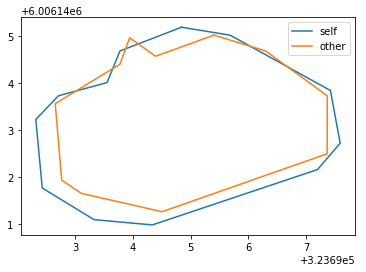

12it [00:17,  1.80s/it]

[[458 163]
 [457 164]
 [456 164]
 [455 164]
 [454 164]
 [453 164]
 [452 165]
 [451 165]
 [450 165]
 [449 165]
 [448 166]
 [447 166]
 [446 167]
 [445 167]
 [444 168]
 [443 168]
 [442 169]
 [441 169]
 [440 170]
 [439 171]
 [438 171]
 [437 172]
 [436 173]
 [435 174]
 [434 175]
 [433 175]
 [432 176]
 [431 177]
 [431 178]
 [430 179]
 [429 180]
 [428 181]
 [427 182]
 [426 183]
 [425 184]
 [425 185]
 [424 186]
 [424 187]
 [423 188]
 [422 189]
 [422 190]
 [421 191]
 [420 192]
 [420 193]
 [419 194]
 [419 195]
 [418 196]
 [417 197]
 [417 198]
 [417 199]
 [416 200]
 [416 201]
 [416 202]
 [415 203]
 [414 204]
 [414 205]
 [413 206]
 [413 207]
 [412 208]
 [412 209]
 [412 210]
 [412 211]
 [413 212]
 [413 213]
 [414 214]
 [415 215]
 [416 216]
 [417 217]
 [417 218]
 [418 219]
 [418 220]
 [419 221]
 [419 222]
 [420 223]
 [420 224]
 [421 225]
 [421 226]
 [422 227]
 [422 228]
 [422 229]
 [422 230]
 [422 231]
 [423 232]
 [423 233]
 [424 234]
 [424 235]
 [425 236]
 [425 237]
 [426 238]
 [427 239]
 [428 239]

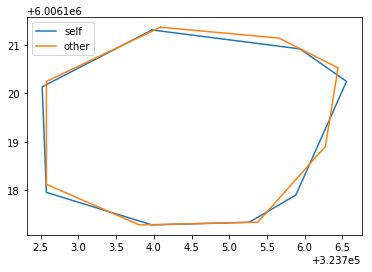

[[493  68]
 [492  69]
 [491  69]
 [490  69]
 [489  70]
 [488  70]
 [487  71]
 [486  71]
 [485  72]
 [484  73]
 [483  73]
 [482  74]
 [481  75]
 [480  76]
 [480  77]
 [479  78]
 [478  78]
 [477  79]
 [476  80]
 [475  81]
 [474  82]
 [473  83]
 [473  84]
 [472  85]
 [471  86]
 [470  86]
 [469  87]
 [468  87]
 [467  88]
 [466  89]
 [465  89]
 [464  90]
 [463  90]
 [462  90]
 [461  90]
 [460  90]
 [459  90]
 [458  91]
 [457  91]
 [456  92]
 [455  92]
 [454  92]
 [453  93]
 [453  94]
 [452  95]
 [452  96]
 [451  97]
 [452  98]
 [452  99]
 [452 100]
 [452 101]
 [452 102]
 [452 103]
 [452 104]
 [452 105]
 [453 106]
 [453 107]
 [454 108]
 [455 109]
 [455 110]
 [456 111]
 [457 112]
 [457 113]
 [458 114]
 [459 115]
 [459 116]
 [460 117]
 [461 118]
 [462 119]
 [462 120]
 [463 121]
 [463 122]
 [464 123]
 [465 124]
 [466 125]
 [467 126]
 [468 127]
 [469 128]
 [470 129]
 [470 130]
 [471 131]
 [471 132]
 [472 133]
 [473 134]
 [474 135]
 [475 136]
 [476 137]
 [477 138]
 [477 139]
 [478 140]
 [479 141]

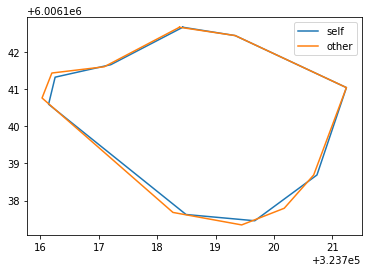

[[ 88 370]
 [ 87 371]
 [ 86 371]
 [ 85 371]
 [ 84 371]
 [ 83 371]
 [ 82 372]
 [ 81 372]
 [ 80 372]
 [ 79 373]
 [ 78 373]
 [ 77 373]
 [ 76 374]
 [ 75 375]
 [ 74 376]
 [ 73 377]
 [ 72 378]
 [ 71 379]
 [ 71 380]
 [ 70 381]
 [ 69 382]
 [ 68 383]
 [ 67 384]
 [ 67 385]
 [ 66 386]
 [ 65 386]
 [ 64 387]
 [ 63 388]
 [ 62 389]
 [ 61 390]
 [ 60 391]
 [ 59 392]
 [ 58 392]
 [ 57 393]
 [ 56 394]
 [ 55 394]
 [ 54 395]
 [ 53 396]
 [ 52 397]
 [ 51 397]
 [ 50 398]
 [ 49 399]
 [ 48 400]
 [ 47 401]
 [ 46 402]
 [ 45 402]
 [ 44 403]
 [ 44 404]
 [ 43 405]
 [ 43 406]
 [ 43 407]
 [ 43 408]
 [ 43 409]
 [ 43 410]
 [ 43 411]
 [ 43 412]
 [ 44 413]
 [ 44 414]
 [ 45 415]
 [ 45 416]
 [ 46 417]
 [ 47 418]
 [ 47 419]
 [ 47 420]
 [ 48 421]
 [ 48 422]
 [ 49 423]
 [ 49 424]
 [ 50 425]
 [ 50 426]
 [ 51 427]
 [ 51 428]
 [ 52 429]
 [ 52 430]
 [ 53 431]
 [ 53 432]
 [ 53 433]
 [ 53 434]
 [ 54 435]
 [ 54 436]
 [ 55 437]
 [ 55 438]
 [ 56 439]
 [ 56 440]
 [ 56 441]
 [ 57 442]
 [ 57 443]
 [ 58 444]
 [ 59 445]
 [ 60 446]
 [ 60 447]

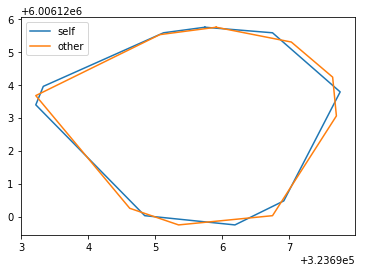

[[515 167]
 [514 168]
 [513 168]
 [512 168]
 [511 168]
 [510 168]
 [509 168]
 [508 169]
 [507 169]
 [506 169]
 [505 169]
 [504 170]
 [503 170]
 [502 171]
 [501 172]
 [500 172]
 [499 173]
 [498 173]
 [497 174]
 [496 175]
 [495 176]
 [494 177]
 [493 178]
 [492 179]
 [491 180]
 [490 181]
 [489 182]
 [488 183]
 [487 184]
 [486 185]
 [485 186]
 [485 187]
 [484 188]
 [483 189]
 [483 190]
 [482 191]
 [481 192]
 [481 193]
 [480 194]
 [479 195]
 [479 196]
 [478 197]
 [477 198]
 [477 199]
 [476 200]
 [476 201]
 [476 202]
 [475 203]
 [475 204]
 [475 205]
 [474 206]
 [474 207]
 [474 208]
 [474 209]
 [473 210]
 [473 211]
 [473 212]
 [473 213]
 [472 214]
 [472 215]
 [472 216]
 [472 217]
 [471 218]
 [471 219]
 [471 220]
 [471 221]
 [470 222]
 [470 223]
 [470 224]
 [470 225]
 [470 226]
 [470 227]
 [470 228]
 [470 229]
 [470 230]
 [470 231]
 [470 232]
 [470 233]
 [470 234]
 [471 235]
 [471 236]
 [471 237]
 [472 238]
 [472 239]
 [472 240]
 [472 241]
 [473 242]
 [473 243]
 [474 244]
 [474 245]
 [475 246]

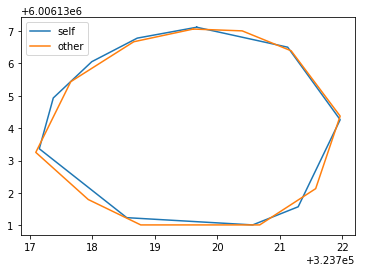

[[280 377]
 [279 378]
 [278 378]
 [277 379]
 [276 380]
 [275 381]
 [275 382]
 [275 383]
 [275 384]
 [275 385]
 [274 386]
 [274 387]
 [274 388]
 [274 389]
 [274 390]
 [274 391]
 [274 392]
 [274 393]
 [273 394]
 [273 395]
 [273 396]
 [272 397]
 [271 398]
 [271 399]
 [270 400]
 [269 401]
 [268 402]
 [268 403]
 [267 404]
 [267 405]
 [266 406]
 [266 407]
 [266 408]
 [265 409]
 [264 410]
 [264 411]
 [264 412]
 [264 413]
 [264 414]
 [263 415]
 [263 416]
 [263 417]
 [263 418]
 [263 419]
 [263 420]
 [263 421]
 [263 422]
 [263 423]
 [263 424]
 [263 425]
 [263 426]
 [263 427]
 [263 428]
 [263 429]
 [263 430]
 [263 431]
 [263 432]
 [263 433]
 [263 434]
 [263 435]
 [264 436]
 [264 437]
 [264 438]
 [265 439]
 [265 440]
 [265 441]
 [266 442]
 [266 443]
 [266 444]
 [267 445]
 [267 446]
 [268 447]
 [268 448]
 [268 449]
 [269 450]
 [269 451]
 [270 452]
 [270 453]
 [271 454]
 [272 455]
 [273 456]
 [274 457]
 [274 458]
 [275 459]
 [276 460]
 [277 460]
 [278 461]
 [279 462]
 [280 463]
 [281 464]
 [282 464]

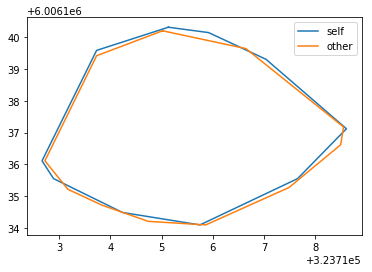

[[167  31]
 [166  32]
 [165  32]
 [164  32]
 [163  32]
 [162  32]
 [161  33]
 [160  33]
 [159  33]
 [158  34]
 [157  34]
 [156  34]
 [155  35]
 [154  35]
 [153  36]
 [152  36]
 [151  37]
 [150  37]
 [149  38]
 [148  38]
 [147  39]
 [146  39]
 [145  39]
 [144  40]
 [143  40]
 [142  41]
 [141  42]
 [140  42]
 [139  43]
 [138  44]
 [137  45]
 [136  45]
 [135  46]
 [134  47]
 [133  48]
 [132  49]
 [131  50]
 [130  51]
 [129  52]
 [129  53]
 [128  54]
 [127  55]
 [127  56]
 [127  57]
 [126  58]
 [126  59]
 [125  60]
 [125  61]
 [125  62]
 [125  63]
 [124  64]
 [124  65]
 [124  66]
 [124  67]
 [124  68]
 [124  69]
 [124  70]
 [124  71]
 [124  72]
 [124  73]
 [124  74]
 [125  75]
 [125  76]
 [125  77]
 [125  78]
 [125  79]
 [126  80]
 [126  81]
 [126  82]
 [127  83]
 [127  84]
 [128  85]
 [128  86]
 [128  87]
 [129  88]
 [129  89]
 [130  90]
 [130  91]
 [131  92]
 [132  93]
 [132  94]
 [133  95]
 [134  96]
 [134  97]
 [135  98]
 [135  99]
 [136 100]
 [136 101]
 [137 102]
 [138 103]
 [138 104]

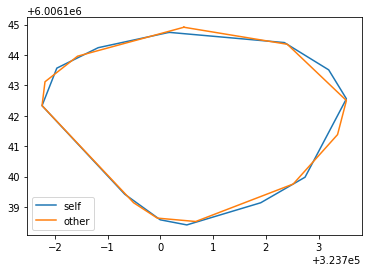

[[167 462]
 [166 463]
 [165 463]
 [164 463]
 [163 463]
 [162 463]
 [161 463]
 [160 464]
 [159 464]
 [158 465]
 [157 465]
 [156 466]
 [155 466]
 [154 467]
 [153 468]
 [152 469]
 [151 470]
 [151 471]
 [150 472]
 [149 473]
 [148 474]
 [148 475]
 [147 476]
 [146 477]
 [146 478]
 [145 479]
 [145 480]
 [144 481]
 [143 482]
 [143 483]
 [142 484]
 [141 485]
 [141 486]
 [140 487]
 [139 488]
 [139 489]
 [138 490]
 [138 491]
 [137 492]
 [137 493]
 [136 494]
 [136 495]
 [135 496]
 [134 497]
 [134 498]
 [134 499]
 [133 500]
 [133 501]
 [132 502]
 [132 503]
 [131 504]
 [131 505]
 [131 506]
 [131 507]
 [131 508]
 [131 509]
 [131 510]
 [132 511]
 [133 512]
 [134 513]
 [135 514]
 [136 515]
 [137 516]
 [138 517]
 [139 517]
 [140 518]
 [141 519]
 [142 519]
 [143 520]
 [144 520]
 [145 521]
 [146 521]
 [147 522]
 [148 522]
 [149 523]
 [150 523]
 [151 524]
 [152 525]
 [153 525]
 [154 526]
 [155 527]
 [156 527]
 [157 528]
 [158 529]
 [159 529]
 [160 530]
 [161 530]
 [162 531]
 [163 531]
 [164 532]
 [165 533]

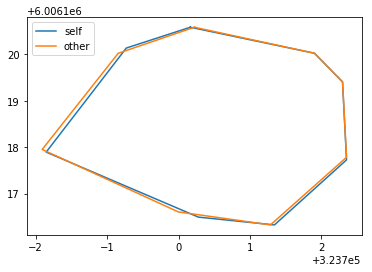

[[210 269]
 [209 270]
 [208 270]
 [207 270]
 [206 270]
 [205 270]
 [204 270]
 [203 271]
 [202 271]
 [201 271]
 [200 271]
 [199 271]
 [198 271]
 [197 271]
 [196 271]
 [195 272]
 [194 272]
 [193 272]
 [192 272]
 [191 272]
 [190 272]
 [189 272]
 [188 272]
 [187 272]
 [186 273]
 [185 273]
 [184 273]
 [183 273]
 [182 273]
 [181 273]
 [180 274]
 [179 274]
 [178 275]
 [177 276]
 [176 277]
 [175 278]
 [174 279]
 [173 280]
 [173 281]
 [173 282]
 [172 283]
 [172 284]
 [172 285]
 [171 286]
 [171 287]
 [171 288]
 [171 289]
 [171 290]
 [170 291]
 [170 292]
 [170 293]
 [170 294]
 [170 295]
 [170 296]
 [170 297]
 [170 298]
 [169 299]
 [169 300]
 [169 301]
 [169 302]
 [169 303]
 [169 304]
 [169 305]
 [169 306]
 [168 307]
 [168 308]
 [168 309]
 [168 310]
 [168 311]
 [168 312]
 [168 313]
 [168 314]
 [168 315]
 [168 316]
 [168 317]
 [168 318]
 [168 319]
 [168 320]
 [168 321]
 [168 322]
 [168 323]
 [168 324]
 [168 325]
 [168 326]
 [169 327]
 [169 328]
 [169 329]
 [170 330]
 [171 331]
 [172 332]
 [172 333]

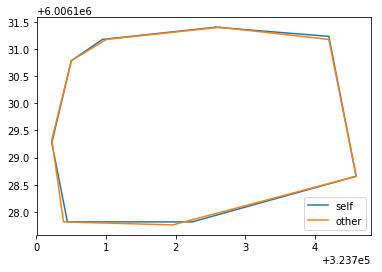

[[541 338]
 [540 339]
 [539 339]
 [538 339]
 [537 339]
 [536 340]
 [535 340]
 [534 341]
 [533 341]
 [532 342]
 [531 342]
 [530 343]
 [529 344]
 [528 344]
 [527 345]
 [526 345]
 [525 346]
 [524 346]
 [523 347]
 [522 347]
 [521 348]
 [520 349]
 [519 350]
 [518 351]
 [517 352]
 [516 353]
 [515 354]
 [514 355]
 [514 356]
 [513 357]
 [512 358]
 [512 359]
 [511 360]
 [511 361]
 [510 362]
 [510 363]
 [509 364]
 [509 365]
 [509 366]
 [508 367]
 [508 368]
 [508 369]
 [507 370]
 [507 371]
 [507 372]
 [506 373]
 [506 374]
 [506 375]
 [506 376]
 [506 377]
 [505 378]
 [505 379]
 [505 380]
 [505 381]
 [505 382]
 [506 383]
 [506 384]
 [506 385]
 [506 386]
 [506 387]
 [506 388]
 [506 389]
 [507 390]
 [507 391]
 [507 392]
 [507 393]
 [508 394]
 [508 395]
 [509 396]
 [509 397]
 [509 398]
 [510 399]
 [510 400]
 [511 401]
 [511 402]
 [511 403]
 [512 404]
 [512 405]
 [512 406]
 [513 407]
 [514 408]
 [514 409]
 [515 410]
 [516 411]
 [517 412]
 [518 413]
 [519 414]
 [520 415]
 [521 416]
 [522 416]
 [523 417]

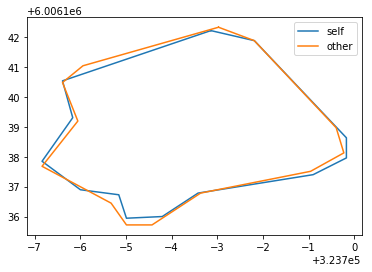

[[442 231]
 [441 232]
 [440 232]
 [439 232]
 [438 232]
 [437 233]
 [436 233]
 [435 233]
 [434 234]
 [433 235]
 [432 236]
 [431 237]
 [430 238]
 [429 239]
 [428 240]
 [428 241]
 [428 242]
 [427 243]
 [427 244]
 [426 245]
 [426 246]
 [426 247]
 [425 248]
 [425 249]
 [425 250]
 [424 251]
 [424 252]
 [424 253]
 [424 254]
 [424 255]
 [424 256]
 [424 257]
 [424 258]
 [423 259]
 [423 260]
 [423 261]
 [423 262]
 [423 263]
 [423 264]
 [423 265]
 [423 266]
 [423 267]
 [423 268]
 [423 269]
 [423 270]
 [423 271]
 [423 272]
 [423 273]
 [423 274]
 [423 275]
 [423 276]
 [423 277]
 [423 278]
 [423 279]
 [423 280]
 [423 281]
 [423 282]
 [423 283]
 [423 284]
 [423 285]
 [423 286]
 [423 287]
 [423 288]
 [423 289]
 [423 290]
 [423 291]
 [423 292]
 [423 293]
 [423 294]
 [423 295]
 [423 296]
 [423 297]
 [423 298]
 [423 299]
 [423 300]
 [423 301]
 [423 302]
 [423 303]
 [423 304]
 [423 305]
 [423 306]
 [423 307]
 [423 308]
 [423 309]
 [423 310]
 [424 311]
 [424 312]
 [424 313]
 [425 314]
 [425 315]
 [425 316]

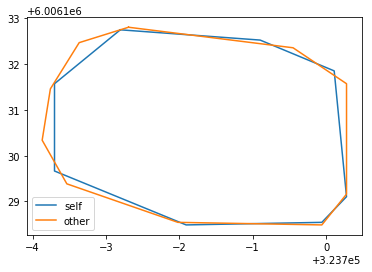

[[416 364]
 [415 365]
 [414 365]
 [413 365]
 [412 365]
 [411 365]
 [410 365]
 [409 365]
 [408 365]
 [407 366]
 [406 366]
 [405 366]
 [404 366]
 [403 366]
 [402 366]
 [401 366]
 [400 366]
 [399 366]
 [398 366]
 [397 366]
 [396 366]
 [395 366]
 [394 367]
 [393 367]
 [392 367]
 [391 368]
 [390 369]
 [389 370]
 [388 371]
 [387 372]
 [386 373]
 [385 374]
 [385 375]
 [384 376]
 [383 377]
 [382 378]
 [382 379]
 [381 380]
 [381 381]
 [380 382]
 [380 383]
 [379 384]
 [379 385]
 [379 386]
 [378 387]
 [378 388]
 [378 389]
 [378 390]
 [377 391]
 [377 392]
 [377 393]
 [376 394]
 [376 395]
 [376 396]
 [376 397]
 [376 398]
 [376 399]
 [376 400]
 [376 401]
 [376 402]
 [376 403]
 [377 404]
 [377 405]
 [377 406]
 [378 407]
 [378 408]
 [379 409]
 [379 410]
 [380 411]
 [381 412]
 [382 413]
 [382 414]
 [383 415]
 [384 415]
 [385 416]
 [386 416]
 [387 417]
 [388 417]
 [389 418]
 [390 418]
 [391 418]
 [392 419]
 [393 419]
 [394 419]
 [395 419]
 [396 420]
 [397 420]
 [398 420]
 [399 420]
 [400 420]
 [401 420]

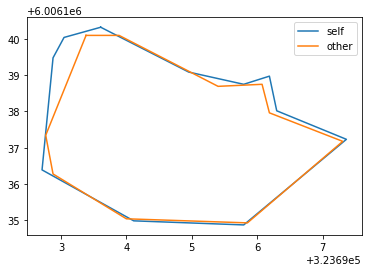

[[579 469]
 [578 470]
 [577 470]
 [576 470]
 [575 470]
 [574 471]
 [573 471]
 [572 471]
 [571 471]
 [570 471]
 [569 472]
 [568 472]
 [567 472]
 [566 472]
 [565 473]
 [564 473]
 [563 473]
 [562 473]
 [561 473]
 [560 474]
 [559 474]
 [558 474]
 [557 475]
 [556 475]
 [555 475]
 [554 476]
 [553 476]
 [552 477]
 [551 477]
 [550 478]
 [549 478]
 [548 479]
 [547 480]
 [546 480]
 [545 481]
 [544 481]
 [543 482]
 [542 482]
 [541 483]
 [540 483]
 [539 484]
 [538 485]
 [537 485]
 [536 486]
 [535 487]
 [534 488]
 [533 489]
 [532 490]
 [531 491]
 [530 492]
 [529 493]
 [529 494]
 [529 495]
 [528 496]
 [528 497]
 [528 498]
 [528 499]
 [528 500]
 [528 501]
 [528 502]
 [528 503]
 [528 504]
 [528 505]
 [528 506]
 [528 507]
 [528 508]
 [529 509]
 [529 510]
 [529 511]
 [529 512]
 [530 513]
 [530 514]
 [530 515]
 [531 516]
 [531 517]
 [532 518]
 [532 519]
 [532 520]
 [533 521]
 [533 522]
 [534 523]
 [534 524]
 [534 525]
 [535 526]
 [535 527]
 [535 528]
 [536 529]
 [536 530]
 [537 531]
 [537 532]
 [537 533]

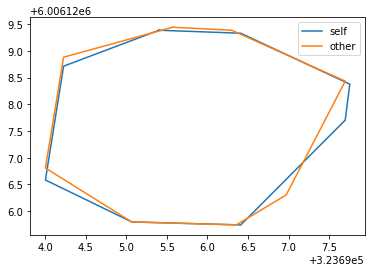

[[196 196]
 [195 197]
 [194 198]
 [193 198]
 [192 199]
 [191 200]
 [190 201]
 [189 202]
 [189 203]
 [188 204]
 [187 205]
 [186 206]
 [185 207]
 [185 208]
 [185 209]
 [184 210]
 [184 211]
 [183 212]
 [182 213]
 [181 214]
 [181 215]
 [180 216]
 [179 217]
 [179 218]
 [178 219]
 [178 220]
 [177 221]
 [177 222]
 [176 223]
 [175 224]
 [175 225]
 [174 226]
 [173 227]
 [173 228]
 [172 229]
 [172 230]
 [171 231]
 [170 232]
 [169 233]
 [169 234]
 [169 235]
 [168 236]
 [168 237]
 [167 238]
 [167 239]
 [167 240]
 [166 241]
 [166 242]
 [165 243]
 [165 244]
 [164 245]
 [164 246]
 [164 247]
 [164 248]
 [163 249]
 [163 250]
 [163 251]
 [163 252]
 [163 253]
 [163 254]
 [163 255]
 [163 256]
 [163 257]
 [164 258]
 [164 259]
 [164 260]
 [165 261]
 [166 262]
 [166 263]
 [167 264]
 [167 265]
 [168 266]
 [169 266]
 [170 267]
 [171 268]
 [172 268]
 [173 269]
 [174 269]
 [175 270]
 [176 270]
 [177 270]
 [178 271]
 [179 271]
 [180 271]
 [181 271]
 [182 271]
 [183 271]
 [184 271]
 [185 271]
 [186 271]
 [187 271]

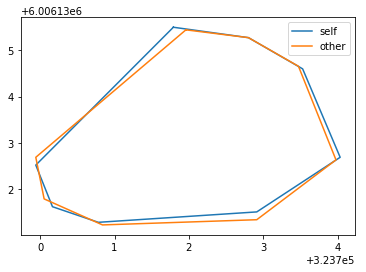

[[562 268]
 [561 269]
 [560 269]
 [559 269]
 [558 269]
 [557 269]
 [556 269]
 [555 269]
 [554 270]
 [553 270]
 [552 270]
 [551 271]
 [550 271]
 [549 271]
 [548 272]
 [547 272]
 [546 272]
 [545 273]
 [544 273]
 [543 274]
 [542 274]
 [541 275]
 [540 276]
 [539 277]
 [538 278]
 [537 279]
 [536 280]
 [536 281]
 [535 282]
 [535 283]
 [535 284]
 [535 285]
 [534 286]
 [534 287]
 [534 288]
 [534 289]
 [534 290]
 [534 291]
 [534 292]
 [534 293]
 [534 294]
 [534 295]
 [534 296]
 [534 297]
 [534 298]
 [534 299]
 [534 300]
 [534 301]
 [535 302]
 [535 303]
 [535 304]
 [535 305]
 [535 306]
 [535 307]
 [536 308]
 [536 309]
 [536 310]
 [536 311]
 [536 312]
 [536 313]
 [536 314]
 [537 315]
 [537 316]
 [537 317]
 [537 318]
 [537 319]
 [537 320]
 [537 321]
 [538 322]
 [538 323]
 [538 324]
 [538 325]
 [538 326]
 [538 327]
 [539 328]
 [539 329]
 [539 330]
 [539 331]
 [540 332]
 [540 333]
 [540 334]
 [541 335]
 [541 336]
 [542 337]
 [543 338]
 [544 339]
 [545 340]
 [546 340]
 [547 340]
 [548 341]
 [549 341]

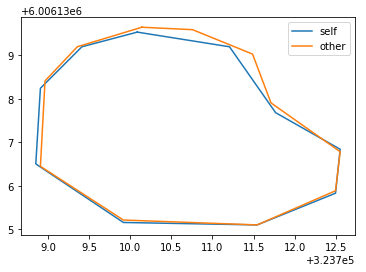

[[ 80 231]
 [ 79 232]
 [ 78 232]
 [ 77 232]
 [ 76 232]
 [ 75 232]
 [ 74 232]
 [ 73 232]
 [ 72 233]
 [ 71 233]
 [ 70 234]
 [ 69 234]
 [ 68 235]
 [ 67 235]
 [ 66 236]
 [ 65 236]
 [ 64 237]
 [ 63 237]
 [ 62 238]
 [ 61 239]
 [ 61 240]
 [ 60 241]
 [ 59 242]
 [ 58 243]
 [ 57 244]
 [ 56 245]
 [ 55 246]
 [ 54 247]
 [ 53 248]
 [ 52 249]
 [ 51 250]
 [ 51 251]
 [ 50 252]
 [ 50 253]
 [ 49 254]
 [ 49 255]
 [ 48 256]
 [ 48 257]
 [ 48 258]
 [ 48 259]
 [ 48 260]
 [ 47 261]
 [ 47 262]
 [ 47 263]
 [ 47 264]
 [ 47 265]
 [ 47 266]
 [ 47 267]
 [ 47 268]
 [ 47 269]
 [ 47 270]
 [ 47 271]
 [ 47 272]
 [ 47 273]
 [ 47 274]
 [ 47 275]
 [ 47 276]
 [ 47 277]
 [ 47 278]
 [ 47 279]
 [ 47 280]
 [ 47 281]
 [ 48 282]
 [ 48 283]
 [ 48 284]
 [ 48 285]
 [ 48 286]
 [ 49 287]
 [ 49 288]
 [ 49 289]
 [ 49 290]
 [ 49 291]
 [ 50 292]
 [ 50 293]
 [ 50 294]
 [ 50 295]
 [ 51 296]
 [ 51 297]
 [ 52 298]
 [ 52 299]
 [ 52 300]
 [ 53 301]
 [ 53 302]
 [ 54 303]
 [ 55 303]
 [ 56 304]
 [ 57 305]
 [ 58 305]
 [ 59 306]
 [ 60 306]
 [ 61 306]

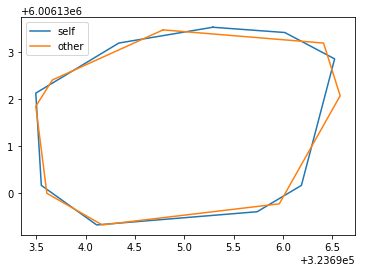

[[ 72  22]
 [ 71  23]
 [ 70  23]
 [ 69  23]
 [ 68  24]
 [ 67  25]
 [ 66  26]
 [ 65  26]
 [ 64  27]
 [ 63  27]
 [ 62  28]
 [ 61  28]
 [ 60  28]
 [ 59  29]
 [ 58  29]
 [ 57  29]
 [ 56  30]
 [ 55  31]
 [ 55  32]
 [ 54  33]
 [ 54  34]
 [ 54  35]
 [ 54  36]
 [ 54  37]
 [ 53  38]
 [ 53  39]
 [ 53  40]
 [ 53  41]
 [ 52  42]
 [ 52  43]
 [ 51  44]
 [ 50  44]
 [ 49  45]
 [ 48  45]
 [ 47  46]
 [ 46  45]
 [ 45  45]
 [ 44  45]
 [ 43  46]
 [ 42  46]
 [ 41  47]
 [ 40  47]
 [ 39  48]
 [ 38  48]
 [ 37  49]
 [ 36  50]
 [ 35  51]
 [ 34  52]
 [ 33  52]
 [ 32  53]
 [ 31  54]
 [ 30  55]
 [ 30  56]
 [ 29  57]
 [ 29  58]
 [ 28  59]
 [ 28  60]
 [ 28  61]
 [ 28  62]
 [ 28  63]
 [ 28  64]
 [ 28  65]
 [ 28  66]
 [ 28  67]
 [ 29  68]
 [ 30  69]
 [ 30  70]
 [ 30  71]
 [ 30  72]
 [ 30  73]
 [ 30  74]
 [ 31  75]
 [ 31  76]
 [ 31  77]
 [ 31  78]
 [ 31  79]
 [ 31  80]
 [ 31  81]
 [ 30  82]
 [ 31  83]
 [ 31  84]
 [ 31  85]
 [ 32  86]
 [ 32  87]
 [ 33  88]
 [ 33  89]
 [ 34  90]
 [ 35  90]
 [ 36  91]
 [ 37  92]
 [ 38  93]

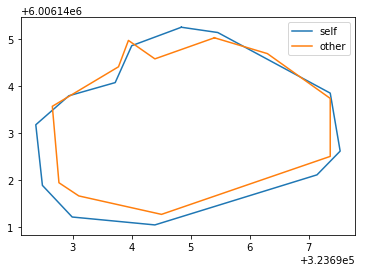

13it [00:19,  1.97s/it]

[[464 401]
 [463 402]
 [462 402]
 [461 402]
 [460 402]
 [459 403]
 [458 403]
 [457 404]
 [456 404]
 [455 405]
 [454 406]
 [453 406]
 [452 407]
 [451 408]
 [450 409]
 [450 410]
 [449 411]
 [449 412]
 [449 413]
 [449 414]
 [448 415]
 [448 416]
 [448 417]
 [448 418]
 [448 419]
 [448 420]
 [448 421]
 [448 422]
 [448 423]
 [448 424]
 [448 425]
 [449 426]
 [449 427]
 [449 428]
 [449 429]
 [449 430]
 [449 431]
 [449 432]
 [449 433]
 [449 434]
 [449 435]
 [449 436]
 [449 437]
 [449 438]
 [449 439]
 [449 440]
 [448 441]
 [448 442]
 [448 443]
 [448 444]
 [448 445]
 [447 446]
 [446 447]
 [446 448]
 [446 449]
 [446 450]
 [446 451]
 [445 452]
 [444 453]
 [443 454]
 [442 454]
 [442 455]
 [442 456]
 [442 457]
 [442 458]
 [442 459]
 [443 460]
 [443 461]
 [443 462]
 [443 463]
 [443 464]
 [444 465]
 [444 466]
 [444 467]
 [444 468]
 [445 469]
 [445 470]
 [445 471]
 [445 472]
 [445 473]
 [445 474]
 [445 475]
 [446 476]
 [447 477]
 [448 478]
 [449 478]
 [450 478]
 [451 478]
 [452 478]
 [453 479]
 [454 479]

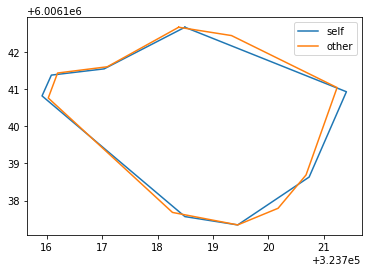

[[552 136]
 [551 137]
 [550 137]
 [549 137]
 [548 137]
 [547 137]
 [546 137]
 [545 138]
 [544 138]
 [543 138]
 [542 138]
 [541 139]
 [540 139]
 [539 139]
 [538 140]
 [537 140]
 [536 140]
 [535 140]
 [534 140]
 [533 141]
 [532 141]
 [531 141]
 [530 141]
 [529 141]
 [528 141]
 [527 141]
 [526 141]
 [525 141]
 [524 141]
 [523 141]
 [522 141]
 [521 141]
 [520 141]
 [519 140]
 [518 140]
 [517 140]
 [516 140]
 [515 140]
 [514 140]
 [513 140]
 [512 141]
 [511 141]
 [510 141]
 [509 141]
 [508 141]
 [507 141]
 [506 142]
 [505 142]
 [504 142]
 [503 143]
 [502 143]
 [501 144]
 [500 144]
 [499 145]
 [498 146]
 [497 147]
 [496 148]
 [495 149]
 [494 150]
 [494 151]
 [493 152]
 [492 153]
 [491 154]
 [490 154]
 [489 155]
 [488 156]
 [487 157]
 [486 158]
 [486 159]
 [485 160]
 [484 161]
 [483 162]
 [482 163]
 [482 164]
 [481 165]
 [481 166]
 [480 167]
 [480 168]
 [480 169]
 [480 170]
 [480 171]
 [480 172]
 [480 173]
 [480 174]
 [480 175]
 [480 176]
 [480 177]
 [481 178]
 [481 179]
 [482 180]
 [482 181]

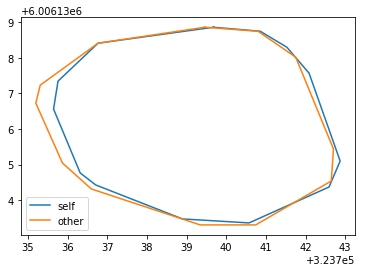

[[263  98]
 [262  99]
 [261  99]
 [260  99]
 [259  99]
 [258  99]
 [257 100]
 [256 100]
 [255 100]
 [254 100]
 [253 101]
 [252 101]
 [251 102]
 [250 102]
 [249 103]
 [248 104]
 [247 104]
 [246 105]
 [245 105]
 [244 106]
 [243 106]
 [242 107]
 [241 108]
 [240 109]
 [240 110]
 [240 111]
 [239 112]
 [239 113]
 [239 114]
 [238 115]
 [238 116]
 [238 117]
 [237 118]
 [237 119]
 [237 120]
 [236 121]
 [236 122]
 [236 123]
 [236 124]
 [236 125]
 [236 126]
 [235 127]
 [235 128]
 [235 129]
 [235 130]
 [235 131]
 [235 132]
 [235 133]
 [235 134]
 [235 135]
 [234 136]
 [234 137]
 [234 138]
 [234 139]
 [234 140]
 [234 141]
 [234 142]
 [234 143]
 [234 144]
 [234 145]
 [234 146]
 [233 147]
 [233 148]
 [233 149]
 [233 150]
 [233 151]
 [233 152]
 [233 153]
 [233 154]
 [233 155]
 [233 156]
 [233 157]
 [232 158]
 [232 159]
 [232 160]
 [232 161]
 [232 162]
 [232 163]
 [232 164]
 [232 165]
 [232 166]
 [232 167]
 [232 168]
 [232 169]
 [232 170]
 [232 171]
 [232 172]
 [232 173]
 [232 174]
 [232 175]
 [232 176]

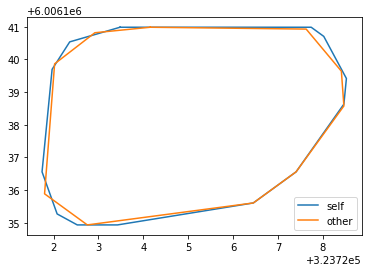

[[191 167]
 [190 168]
 [189 168]
 [188 168]
 [187 168]
 [186 168]
 [185 169]
 [184 169]
 [183 169]
 [182 170]
 [181 171]
 [180 171]
 [179 172]
 [178 173]
 [177 173]
 [176 174]
 [175 175]
 [174 176]
 [173 177]
 [172 178]
 [171 179]
 [170 180]
 [169 181]
 [168 182]
 [167 183]
 [167 184]
 [166 185]
 [165 186]
 [165 187]
 [164 188]
 [163 189]
 [163 190]
 [162 191]
 [161 192]
 [161 193]
 [160 194]
 [159 195]
 [158 196]
 [158 197]
 [157 198]
 [156 199]
 [156 200]
 [155 201]
 [155 202]
 [154 203]
 [154 204]
 [154 205]
 [153 206]
 [153 207]
 [153 208]
 [152 209]
 [152 210]
 [152 211]
 [151 212]
 [151 213]
 [151 214]
 [150 215]
 [150 216]
 [150 217]
 [150 218]
 [149 219]
 [149 220]
 [149 221]
 [149 222]
 [148 223]
 [148 224]
 [148 225]
 [148 226]
 [148 227]
 [148 228]
 [148 229]
 [148 230]
 [148 231]
 [148 232]
 [149 233]
 [149 234]
 [149 235]
 [150 236]
 [150 237]
 [150 238]
 [151 239]
 [151 240]
 [152 241]
 [152 242]
 [153 243]
 [153 244]
 [154 245]
 [154 246]
 [155 247]
 [155 248]
 [156 249]

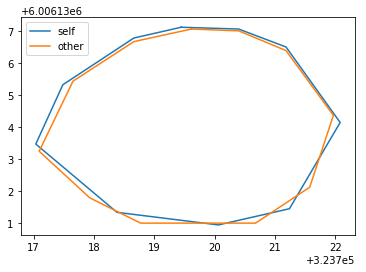

[[406 356]
 [405 357]
 [404 357]
 [403 357]
 [402 357]
 [401 357]
 [400 358]
 [399 358]
 [398 359]
 [397 360]
 [397 361]
 [396 362]
 [395 363]
 [395 364]
 [394 365]
 [394 366]
 [393 367]
 [393 368]
 [392 369]
 [392 370]
 [391 371]
 [391 372]
 [390 373]
 [390 374]
 [389 375]
 [389 376]
 [388 377]
 [388 378]
 [387 379]
 [386 380]
 [386 381]
 [385 382]
 [384 383]
 [383 384]
 [383 385]
 [382 386]
 [381 387]
 [380 388]
 [380 389]
 [379 390]
 [378 391]
 [377 392]
 [376 393]
 [375 394]
 [374 395]
 [373 396]
 [372 397]
 [371 398]
 [370 399]
 [370 400]
 [369 401]
 [368 402]
 [367 403]
 [367 404]
 [367 405]
 [366 406]
 [366 407]
 [365 408]
 [365 409]
 [365 410]
 [365 411]
 [365 412]
 [364 413]
 [364 414]
 [364 415]
 [364 416]
 [364 417]
 [364 418]
 [364 419]
 [364 420]
 [364 421]
 [364 422]
 [364 423]
 [364 424]
 [364 425]
 [364 426]
 [364 427]
 [364 428]
 [364 429]
 [364 430]
 [364 431]
 [364 432]
 [365 433]
 [365 434]
 [365 435]
 [365 436]
 [365 437]
 [366 438]
 [366 439]
 [366 440]
 [366 441]

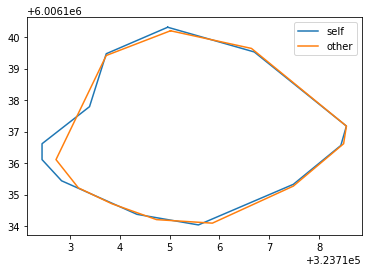

[[473 391]
 [472 392]
 [471 392]
 [470 392]
 [469 393]
 [468 394]
 [467 394]
 [467 395]
 [466 396]
 [465 397]
 [464 398]
 [464 399]
 [463 400]
 [462 401]
 [462 402]
 [461 403]
 [460 404]
 [460 405]
 [459 406]
 [459 407]
 [458 408]
 [457 409]
 [457 410]
 [456 411]
 [455 412]
 [455 413]
 [454 414]
 [454 415]
 [453 416]
 [453 417]
 [452 418]
 [452 419]
 [451 420]
 [451 421]
 [451 422]
 [450 423]
 [450 424]
 [449 425]
 [449 426]
 [448 427]
 [448 428]
 [447 429]
 [447 430]
 [446 431]
 [446 432]
 [445 433]
 [445 434]
 [444 435]
 [444 436]
 [443 437]
 [443 438]
 [442 439]
 [442 440]
 [441 441]
 [441 442]
 [440 443]
 [440 444]
 [440 445]
 [439 446]
 [439 447]
 [439 448]
 [439 449]
 [439 450]
 [439 451]
 [439 452]
 [439 453]
 [439 454]
 [439 455]
 [439 456]
 [439 457]
 [439 458]
 [439 459]
 [439 460]
 [440 461]
 [441 462]
 [442 462]
 [443 463]
 [444 463]
 [445 463]
 [446 463]
 [447 463]
 [448 464]
 [449 464]
 [450 464]
 [451 463]
 [452 463]
 [453 463]
 [454 464]
 [455 463]
 [456 463]
 [457 463]

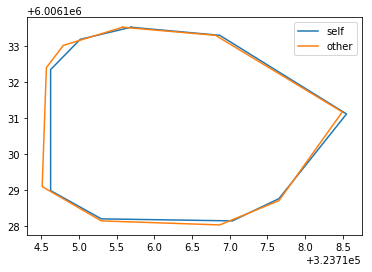

[[177 496]
 [176 497]
 [175 497]
 [174 497]
 [173 498]
 [172 498]
 [171 498]
 [170 499]
 [169 499]
 [168 500]
 [167 501]
 [167 502]
 [166 503]
 [165 504]
 [164 504]
 [163 505]
 [162 506]
 [161 507]
 [160 508]
 [159 509]
 [158 510]
 [157 511]
 [156 511]
 [155 511]
 [154 512]
 [153 513]
 [152 514]
 [151 515]
 [150 516]
 [149 517]
 [148 518]
 [147 519]
 [146 520]
 [146 521]
 [145 522]
 [145 523]
 [144 524]
 [143 525]
 [143 526]
 [142 527]
 [142 528]
 [142 529]
 [142 530]
 [141 531]
 [141 532]
 [141 533]
 [141 534]
 [141 535]
 [140 536]
 [140 537]
 [140 538]
 [140 539]
 [140 540]
 [140 541]
 [140 542]
 [140 543]
 [140 544]
 [140 545]
 [140 546]
 [140 547]
 [140 548]
 [140 549]
 [140 550]
 [140 551]
 [140 552]
 [140 553]
 [140 554]
 [140 555]
 [140 556]
 [140 557]
 [140 558]
 [140 559]
 [140 560]
 [140 561]
 [140 562]
 [141 563]
 [141 564]
 [141 565]
 [141 566]
 [141 567]
 [141 568]
 [141 569]
 [141 570]
 [141 571]
 [141 572]
 [141 573]
 [141 574]
 [141 575]
 [141 576]
 [141 577]
 [142 578]

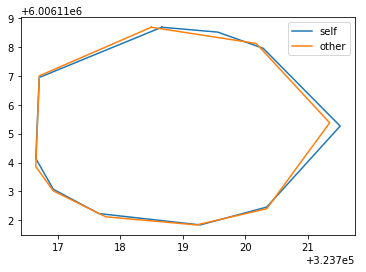

[[217 339]
 [216 340]
 [215 340]
 [214 340]
 [213 341]
 [212 342]
 [211 343]
 [210 343]
 [209 344]
 [208 344]
 [207 345]
 [206 345]
 [205 346]
 [204 346]
 [203 347]
 [202 348]
 [201 349]
 [200 349]
 [199 350]
 [198 351]
 [197 352]
 [196 353]
 [196 354]
 [195 355]
 [194 356]
 [193 357]
 [193 358]
 [192 359]
 [192 360]
 [191 361]
 [191 362]
 [190 363]
 [190 364]
 [190 365]
 [189 366]
 [189 367]
 [189 368]
 [188 369]
 [188 370]
 [188 371]
 [187 372]
 [187 373]
 [187 374]
 [186 375]
 [186 376]
 [186 377]
 [186 378]
 [186 379]
 [186 380]
 [186 381]
 [186 382]
 [186 383]
 [186 384]
 [186 385]
 [186 386]
 [186 387]
 [187 388]
 [187 389]
 [187 390]
 [188 391]
 [188 392]
 [188 393]
 [188 394]
 [189 395]
 [189 396]
 [189 397]
 [190 398]
 [190 399]
 [190 400]
 [191 401]
 [191 402]
 [191 403]
 [192 404]
 [192 405]
 [193 406]
 [193 407]
 [194 408]
 [194 409]
 [195 410]
 [196 411]
 [196 412]
 [197 413]
 [198 414]
 [199 414]
 [200 415]
 [201 416]
 [202 417]
 [203 418]
 [204 418]
 [205 419]
 [206 420]

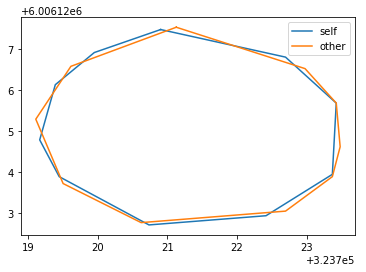

[[321 283]
 [320 284]
 [319 284]
 [318 284]
 [317 285]
 [316 285]
 [315 286]
 [314 286]
 [314 287]
 [313 288]
 [313 289]
 [313 290]
 [313 291]
 [313 292]
 [313 293]
 [313 294]
 [313 295]
 [313 296]
 [313 297]
 [313 298]
 [313 299]
 [313 300]
 [313 301]
 [313 302]
 [313 303]
 [313 304]
 [313 305]
 [313 306]
 [313 307]
 [313 308]
 [313 309]
 [313 310]
 [313 311]
 [313 312]
 [313 313]
 [313 314]
 [314 315]
 [314 316]
 [314 317]
 [314 318]
 [314 319]
 [315 320]
 [315 321]
 [315 322]
 [316 323]
 [316 324]
 [316 325]
 [317 326]
 [317 327]
 [317 328]
 [317 329]
 [318 330]
 [318 331]
 [318 332]
 [318 333]
 [318 334]
 [319 335]
 [319 336]
 [319 337]
 [319 338]
 [319 339]
 [319 340]
 [319 341]
 [319 342]
 [319 343]
 [319 344]
 [320 345]
 [320 346]
 [320 347]
 [321 348]
 [321 349]
 [322 350]
 [322 351]
 [323 352]
 [323 353]
 [324 354]
 [324 355]
 [325 356]
 [326 357]
 [327 358]
 [328 358]
 [329 359]
 [330 360]
 [331 361]
 [332 362]
 [333 362]
 [334 362]
 [335 362]
 [336 363]
 [337 363]
 [338 364]

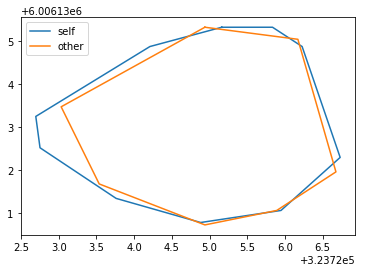

[[425 266]
 [424 267]
 [423 267]
 [422 267]
 [421 268]
 [420 268]
 [419 268]
 [418 269]
 [417 269]
 [416 270]
 [415 271]
 [414 272]
 [413 272]
 [412 273]
 [411 274]
 [410 275]
 [409 276]
 [408 277]
 [407 278]
 [406 279]
 [405 280]
 [404 281]
 [403 282]
 [402 283]
 [401 283]
 [400 284]
 [399 285]
 [398 286]
 [398 287]
 [397 288]
 [397 289]
 [396 290]
 [396 291]
 [395 292]
 [395 293]
 [394 294]
 [394 295]
 [394 296]
 [394 297]
 [393 298]
 [393 299]
 [393 300]
 [392 301]
 [392 302]
 [392 303]
 [392 304]
 [392 305]
 [392 306]
 [391 307]
 [391 308]
 [391 309]
 [391 310]
 [391 311]
 [391 312]
 [390 313]
 [391 314]
 [391 315]
 [391 316]
 [391 317]
 [390 318]
 [390 319]
 [390 320]
 [391 321]
 [391 322]
 [391 323]
 [391 324]
 [391 325]
 [392 326]
 [392 327]
 [392 328]
 [393 329]
 [393 330]
 [393 331]
 [394 332]
 [394 333]
 [395 334]
 [395 335]
 [396 336]
 [397 336]
 [398 337]
 [399 337]
 [400 338]
 [401 339]
 [402 339]
 [403 339]
 [404 339]
 [405 339]
 [406 340]
 [407 340]
 [408 341]
 [409 341]

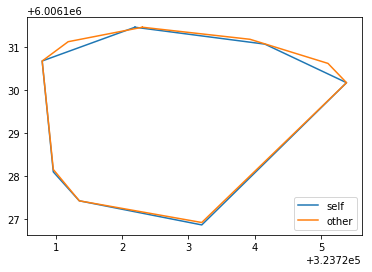

[[ 99 364]
 [ 98 365]
 [ 97 365]
 [ 96 365]
 [ 95 365]
 [ 94 365]
 [ 93 365]
 [ 92 365]
 [ 91 365]
 [ 90 365]
 [ 89 365]
 [ 88 365]
 [ 87 365]
 [ 86 365]
 [ 85 365]
 [ 84 365]
 [ 83 365]
 [ 82 365]
 [ 81 365]
 [ 80 365]
 [ 79 365]
 [ 78 365]
 [ 77 365]
 [ 76 366]
 [ 75 366]
 [ 74 366]
 [ 73 367]
 [ 72 367]
 [ 71 368]
 [ 70 368]
 [ 69 369]
 [ 68 370]
 [ 68 371]
 [ 67 372]
 [ 66 373]
 [ 65 373]
 [ 65 374]
 [ 64 375]
 [ 63 376]
 [ 62 377]
 [ 61 378]
 [ 61 379]
 [ 61 380]
 [ 60 381]
 [ 59 382]
 [ 59 383]
 [ 59 384]
 [ 58 385]
 [ 58 386]
 [ 57 387]
 [ 57 388]
 [ 57 389]
 [ 57 390]
 [ 56 391]
 [ 56 392]
 [ 56 393]
 [ 55 394]
 [ 55 395]
 [ 55 396]
 [ 55 397]
 [ 55 398]
 [ 55 399]
 [ 55 400]
 [ 55 401]
 [ 55 402]
 [ 55 403]
 [ 56 404]
 [ 56 405]
 [ 57 406]
 [ 57 407]
 [ 57 408]
 [ 58 409]
 [ 58 410]
 [ 59 411]
 [ 60 412]
 [ 61 413]
 [ 62 414]
 [ 63 415]
 [ 64 415]
 [ 65 416]
 [ 66 416]
 [ 67 417]
 [ 68 417]
 [ 69 418]
 [ 70 418]
 [ 71 418]
 [ 72 419]
 [ 73 419]
 [ 74 419]
 [ 75 419]
 [ 76 419]

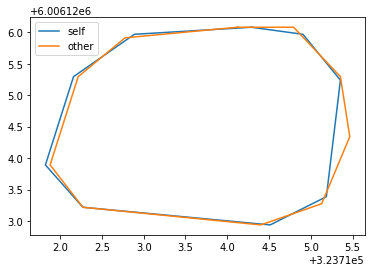

[[320  26]
 [319  27]
 [318  27]
 [317  27]
 [316  28]
 [315  28]
 [314  28]
 [313  29]
 [312  29]
 [311  30]
 [310  31]
 [309  32]
 [308  32]
 [307  33]
 [306  33]
 [305  34]
 [304  34]
 [303  35]
 [302  36]
 [301  36]
 [300  37]
 [299  37]
 [298  38]
 [297  38]
 [296  39]
 [295  39]
 [294  40]
 [293  40]
 [292  41]
 [291  41]
 [290  41]
 [289  42]
 [288  42]
 [287  43]
 [286  43]
 [285  43]
 [284  44]
 [283  44]
 [282  44]
 [281  45]
 [280  45]
 [279  45]
 [278  46]
 [277  46]
 [276  46]
 [275  47]
 [274  47]
 [273  47]
 [272  47]
 [271  48]
 [270  48]
 [269  48]
 [268  49]
 [267  49]
 [266  49]
 [265  50]
 [264  51]
 [263  51]
 [262  52]
 [261  53]
 [260  54]
 [260  55]
 [259  56]
 [259  57]
 [258  58]
 [258  59]
 [257  60]
 [257  61]
 [257  62]
 [257  63]
 [256  64]
 [256  65]
 [256  66]
 [256  67]
 [256  68]
 [256  69]
 [256  70]
 [256  71]
 [255  72]
 [255  73]
 [255  74]
 [255  75]
 [255  76]
 [255  77]
 [255  78]
 [255  79]
 [255  80]
 [255  81]
 [255  82]
 [255  83]
 [255  84]

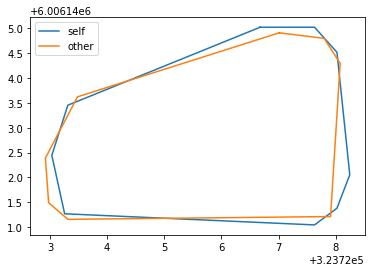

[[461 309]
 [460 310]
 [459 311]
 [458 312]
 [457 313]
 [456 313]
 [455 314]
 [454 314]
 [453 315]
 [452 316]
 [451 317]
 [450 317]
 [449 318]
 [448 319]
 [447 319]
 [446 320]
 [445 321]
 [444 321]
 [443 322]
 [442 322]
 [441 323]
 [440 324]
 [439 325]
 [438 325]
 [437 325]
 [436 326]
 [435 326]
 [434 326]
 [433 326]
 [432 326]
 [431 326]
 [430 326]
 [429 326]
 [428 326]
 [427 327]
 [427 328]
 [427 329]
 [427 330]
 [426 331]
 [425 332]
 [424 332]
 [423 333]
 [422 333]
 [421 334]
 [420 335]
 [419 335]
 [418 336]
 [417 336]
 [416 336]
 [415 336]
 [414 337]
 [413 337]
 [412 338]
 [411 338]
 [410 339]
 [409 340]
 [409 341]
 [408 342]
 [407 343]
 [406 344]
 [406 345]
 [406 346]
 [406 347]
 [406 348]
 [406 349]
 [406 350]
 [406 351]
 [406 352]
 [407 353]
 [408 354]
 [409 355]
 [410 355]
 [411 356]
 [412 356]
 [413 357]
 [414 358]
 [415 358]
 [416 359]
 [417 360]
 [418 360]
 [419 361]
 [420 361]
 [421 361]
 [422 362]
 [423 362]
 [424 362]
 [425 363]
 [426 363]
 [427 363]
 [428 364]
 [429 364]

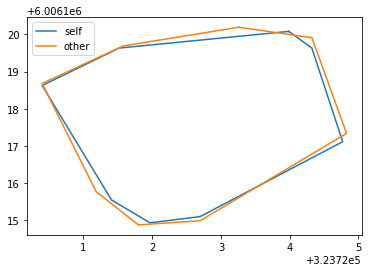

[[ 82 477]
 [ 81 478]
 [ 80 478]
 [ 79 479]
 [ 78 480]
 [ 77 480]
 [ 77 481]
 [ 76 482]
 [ 76 483]
 [ 75 484]
 [ 74 485]
 [ 73 486]
 [ 72 486]
 [ 71 487]
 [ 70 488]
 [ 69 489]
 [ 68 490]
 [ 67 490]
 [ 66 491]
 [ 65 492]
 [ 64 492]
 [ 63 493]
 [ 62 493]
 [ 61 494]
 [ 60 495]
 [ 59 496]
 [ 58 496]
 [ 57 497]
 [ 56 498]
 [ 55 498]
 [ 54 499]
 [ 53 500]
 [ 52 501]
 [ 51 502]
 [ 51 503]
 [ 51 504]
 [ 50 505]
 [ 50 506]
 [ 50 507]
 [ 50 508]
 [ 50 509]
 [ 49 510]
 [ 49 511]
 [ 49 512]
 [ 49 513]
 [ 49 514]
 [ 49 515]
 [ 49 516]
 [ 49 517]
 [ 49 518]
 [ 49 519]
 [ 49 520]
 [ 49 521]
 [ 49 522]
 [ 49 523]
 [ 49 524]
 [ 49 525]
 [ 49 526]
 [ 49 527]
 [ 49 528]
 [ 49 529]
 [ 49 530]
 [ 49 531]
 [ 49 532]
 [ 49 533]
 [ 49 534]
 [ 49 535]
 [ 49 536]
 [ 49 537]
 [ 49 538]
 [ 49 539]
 [ 50 540]
 [ 50 541]
 [ 51 542]
 [ 51 543]
 [ 51 544]
 [ 52 545]
 [ 52 546]
 [ 53 547]
 [ 54 548]
 [ 55 549]
 [ 56 550]
 [ 56 551]
 [ 57 552]
 [ 58 553]
 [ 59 553]
 [ 60 554]
 [ 61 554]
 [ 62 555]
 [ 63 555]
 [ 64 556]

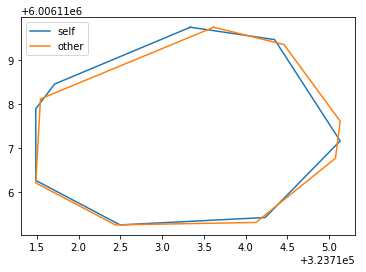

[[586 399]
 [585 400]
 [584 400]
 [583 400]
 [582 400]
 [581 400]
 [580 400]
 [579 400]
 [578 400]
 [577 401]
 [576 401]
 [575 401]
 [574 401]
 [573 401]
 [572 401]
 [571 401]
 [570 401]
 [569 402]
 [568 402]
 [567 402]
 [566 402]
 [565 402]
 [564 402]
 [563 402]
 [562 402]
 [561 402]
 [560 402]
 [559 403]
 [558 403]
 [557 403]
 [556 403]
 [555 403]
 [554 403]
 [553 403]
 [552 404]
 [551 404]
 [550 404]
 [549 404]
 [548 404]
 [547 404]
 [546 404]
 [545 404]
 [544 405]
 [543 405]
 [542 405]
 [541 405]
 [540 405]
 [539 405]
 [538 406]
 [537 406]
 [536 406]
 [535 407]
 [534 407]
 [533 407]
 [532 408]
 [531 408]
 [530 409]
 [529 410]
 [529 411]
 [528 412]
 [527 413]
 [527 414]
 [526 415]
 [526 416]
 [526 417]
 [526 418]
 [525 419]
 [525 420]
 [525 421]
 [525 422]
 [525 423]
 [524 424]
 [524 425]
 [524 426]
 [524 427]
 [524 428]
 [524 429]
 [524 430]
 [524 431]
 [524 432]
 [524 433]
 [523 434]
 [523 435]
 [523 436]
 [523 437]
 [523 438]
 [523 439]
 [523 440]
 [523 441]
 [523 442]
 [523 443]

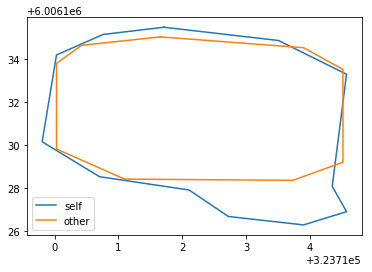

[[465 160]
 [464 161]
 [463 161]
 [462 161]
 [461 161]
 [460 161]
 [459 162]
 [458 162]
 [457 162]
 [456 163]
 [455 163]
 [454 164]
 [453 164]
 [452 165]
 [451 165]
 [450 166]
 [449 166]
 [448 167]
 [447 167]
 [446 168]
 [445 168]
 [444 169]
 [443 169]
 [442 170]
 [441 171]
 [440 172]
 [439 172]
 [438 173]
 [437 174]
 [436 174]
 [435 175]
 [434 175]
 [434 176]
 [433 177]
 [432 178]
 [432 179]
 [431 180]
 [431 181]
 [431 182]
 [430 183]
 [430 184]
 [430 185]
 [429 186]
 [429 187]
 [428 188]
 [428 189]
 [428 190]
 [428 191]
 [428 192]
 [428 193]
 [428 194]
 [427 195]
 [427 196]
 [427 197]
 [427 198]
 [427 199]
 [427 200]
 [427 201]
 [427 202]
 [427 203]
 [427 204]
 [427 205]
 [427 206]
 [427 207]
 [427 208]
 [427 209]
 [427 210]
 [427 211]
 [427 212]
 [427 213]
 [427 214]
 [428 215]
 [428 216]
 [428 217]
 [429 218]
 [429 219]
 [430 220]
 [431 221]
 [431 222]
 [432 223]
 [432 224]
 [433 225]
 [434 226]
 [435 227]
 [435 228]
 [436 229]
 [437 229]
 [438 230]
 [439 231]
 [440 232]
 [441 233]

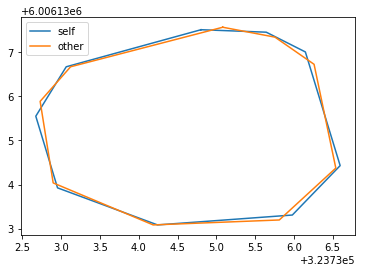

[[457  67]
 [456  68]
 [455  68]
 [454  68]
 [453  69]
 [452  69]
 [451  70]
 [450  71]
 [449  71]
 [448  72]
 [447  73]
 [446  74]
 [446  75]
 [445  76]
 [445  77]
 [445  78]
 [444  79]
 [444  80]
 [444  81]
 [444  82]
 [444  83]
 [444  84]
 [444  85]
 [444  86]
 [444  87]
 [444  88]
 [444  89]
 [444  90]
 [444  91]
 [444  92]
 [444  93]
 [444  94]
 [444  95]
 [444  96]
 [444  97]
 [444  98]
 [444  99]
 [444 100]
 [444 101]
 [444 102]
 [444 103]
 [444 104]
 [445 105]
 [445 106]
 [445 107]
 [445 108]
 [446 109]
 [446 110]
 [446 111]
 [447 112]
 [447 113]
 [448 114]
 [449 115]
 [449 116]
 [450 117]
 [450 118]
 [451 119]
 [451 120]
 [452 121]
 [452 122]
 [453 123]
 [453 124]
 [454 125]
 [455 126]
 [456 126]
 [457 127]
 [458 127]
 [459 127]
 [460 127]
 [461 128]
 [462 128]
 [463 128]
 [464 128]
 [465 128]
 [466 128]
 [467 128]
 [468 128]
 [469 128]
 [470 128]
 [471 128]
 [472 128]
 [473 128]
 [474 128]
 [475 127]
 [476 127]
 [477 127]
 [478 127]
 [479 126]
 [480 126]
 [481 125]
 [482 125]

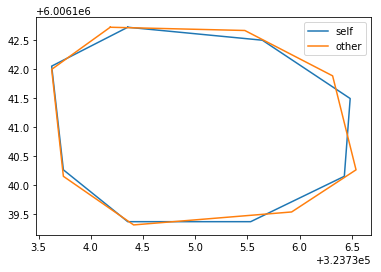

[[143 401]
 [142 402]
 [141 402]
 [140 402]
 [139 402]
 [138 403]
 [137 403]
 [136 404]
 [135 405]
 [134 406]
 [133 406]
 [132 407]
 [131 408]
 [130 409]
 [129 410]
 [129 411]
 [128 412]
 [128 413]
 [128 414]
 [128 415]
 [128 416]
 [128 417]
 [128 418]
 [128 419]
 [128 420]
 [128 421]
 [128 422]
 [128 423]
 [128 424]
 [128 425]
 [128 426]
 [128 427]
 [129 428]
 [129 429]
 [129 430]
 [129 431]
 [129 432]
 [129 433]
 [129 434]
 [129 435]
 [129 436]
 [129 437]
 [129 438]
 [129 439]
 [129 440]
 [129 441]
 [129 442]
 [129 443]
 [129 444]
 [129 445]
 [128 446]
 [128 447]
 [128 448]
 [128 449]
 [129 450]
 [128 451]
 [127 452]
 [126 452]
 [125 453]
 [124 454]
 [124 455]
 [124 456]
 [125 457]
 [126 458]
 [127 458]
 [128 459]
 [128 460]
 [129 461]
 [129 462]
 [129 463]
 [129 464]
 [128 465]
 [128 466]
 [128 467]
 [129 468]
 [129 469]
 [129 470]
 [129 471]
 [129 472]
 [129 473]
 [130 473]
 [131 474]
 [132 474]
 [133 474]
 [134 475]
 [135 475]
 [136 474]
 [137 473]
 [138 473]
 [139 473]
 [140 474]

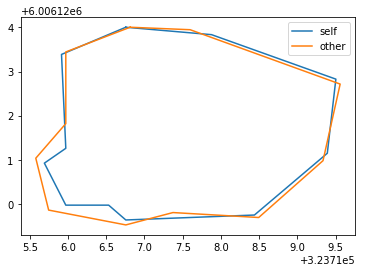

14it [00:22,  2.18s/it]

[[366 511]
 [365 512]
 [364 512]
 [363 512]
 [362 512]
 [361 512]
 [360 512]
 [359 513]
 [358 513]
 [357 513]
 [356 514]
 [355 515]
 [354 515]
 [353 516]
 [352 517]
 [351 517]
 [350 518]
 [349 519]
 [348 520]
 [347 521]
 [346 522]
 [346 523]
 [345 524]
 [345 525]
 [344 526]
 [344 527]
 [343 528]
 [343 529]
 [343 530]
 [342 531]
 [342 532]
 [342 533]
 [341 534]
 [341 535]
 [341 536]
 [340 537]
 [340 538]
 [340 539]
 [340 540]
 [340 541]
 [339 542]
 [339 543]
 [339 544]
 [339 545]
 [339 546]
 [339 547]
 [339 548]
 [340 549]
 [340 550]
 [340 551]
 [340 552]
 [340 553]
 [340 554]
 [341 555]
 [341 556]
 [342 557]
 [343 558]
 [343 559]
 [344 560]
 [345 561]
 [346 562]
 [347 563]
 [348 564]
 [349 564]
 [350 564]
 [351 564]
 [352 565]
 [353 565]
 [354 566]
 [355 566]
 [356 566]
 [357 566]
 [358 566]
 [359 566]
 [360 566]
 [361 567]
 [362 567]
 [363 567]
 [364 567]
 [365 567]
 [366 567]
 [367 567]
 [368 567]
 [369 567]
 [370 567]
 [371 567]
 [372 567]
 [373 567]
 [374 567]
 [375 567]
 [376 567]

[[229 137]
 [228 138]
 [227 138]
 [226 138]
 [225 138]
 [224 138]
 [223 138]
 [222 139]
 [221 139]
 [220 139]
 [219 139]
 [218 139]
 [217 140]
 [216 140]
 [215 140]
 [214 140]
 [213 140]
 [212 140]
 [211 140]
 [210 140]
 [209 140]
 [208 140]
 [207 140]
 [206 141]
 [205 141]
 [204 141]
 [203 141]
 [202 140]
 [201 140]
 [200 140]
 [199 140]
 [198 140]
 [197 140]
 [196 140]
 [195 140]
 [194 140]
 [193 140]
 [192 140]
 [191 141]
 [190 141]
 [189 141]
 [188 141]
 [187 141]
 [186 141]
 [185 142]
 [184 142]
 [183 143]
 [182 143]
 [181 144]
 [180 144]
 [179 145]
 [178 146]
 [177 147]
 [176 148]
 [175 149]
 [175 150]
 [174 151]
 [173 152]
 [172 153]
 [171 154]
 [170 155]
 [169 156]
 [168 156]
 [167 157]
 [166 158]
 [165 159]
 [164 160]
 [163 161]
 [163 162]
 [162 163]
 [161 164]
 [160 165]
 [160 166]
 [160 167]
 [159 168]
 [159 169]
 [159 170]
 [159 171]
 [159 172]
 [159 173]
 [159 174]
 [159 175]
 [160 176]
 [160 177]
 [160 178]
 [161 179]
 [161 180]
 [161 181]
 [162 182]
 [162 183]
 [162 184]

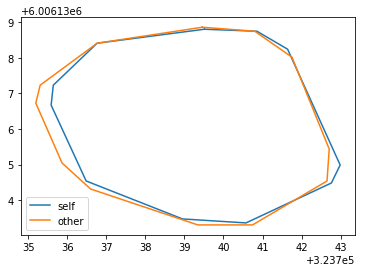

[[272 247]
 [271 248]
 [270 248]
 [269 248]
 [268 249]
 [267 249]
 [266 249]
 [265 250]
 [264 251]
 [263 252]
 [263 253]
 [262 254]
 [261 255]
 [260 256]
 [259 257]
 [258 258]
 [257 259]
 [257 260]
 [256 261]
 [256 262]
 [256 263]
 [255 264]
 [254 265]
 [254 266]
 [253 267]
 [252 268]
 [252 269]
 [251 270]
 [250 271]
 [250 272]
 [249 273]
 [248 274]
 [247 275]
 [246 276]
 [245 277]
 [244 278]
 [243 279]
 [242 280]
 [241 281]
 [240 282]
 [240 283]
 [239 284]
 [238 285]
 [238 286]
 [237 287]
 [237 288]
 [236 289]
 [236 290]
 [236 291]
 [236 292]
 [236 293]
 [236 294]
 [236 295]
 [236 296]
 [236 297]
 [235 298]
 [235 299]
 [235 300]
 [235 301]
 [235 302]
 [235 303]
 [235 304]
 [235 305]
 [235 306]
 [235 307]
 [235 308]
 [235 309]
 [235 310]
 [235 311]
 [235 312]
 [235 313]
 [235 314]
 [235 315]
 [235 316]
 [235 317]
 [235 318]
 [235 319]
 [236 320]
 [236 321]
 [236 322]
 [236 323]
 [236 324]
 [236 325]
 [236 326]
 [236 327]
 [236 328]
 [236 329]
 [236 330]
 [236 331]
 [237 332]
 [237 333]

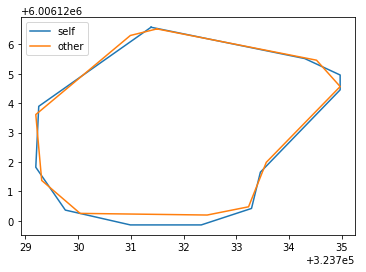

[[375 154]
 [374 155]
 [373 156]
 [372 156]
 [371 156]
 [370 157]
 [369 157]
 [368 158]
 [367 158]
 [366 159]
 [365 160]
 [364 161]
 [363 162]
 [362 163]
 [361 164]
 [360 165]
 [359 166]
 [358 166]
 [357 167]
 [356 167]
 [355 168]
 [354 169]
 [353 170]
 [352 170]
 [351 171]
 [350 171]
 [349 172]
 [348 173]
 [347 173]
 [346 174]
 [345 175]
 [344 176]
 [343 176]
 [342 177]
 [341 177]
 [340 177]
 [339 178]
 [338 178]
 [337 179]
 [336 179]
 [335 180]
 [334 180]
 [333 181]
 [332 181]
 [331 181]
 [330 182]
 [329 182]
 [328 182]
 [327 182]
 [326 183]
 [325 183]
 [324 183]
 [323 184]
 [322 184]
 [321 184]
 [320 185]
 [319 185]
 [318 185]
 [317 185]
 [316 185]
 [315 186]
 [314 186]
 [313 187]
 [312 187]
 [311 188]
 [310 188]
 [309 189]
 [308 189]
 [307 190]
 [306 191]
 [305 192]
 [304 192]
 [303 193]
 [302 193]
 [301 193]
 [300 194]
 [299 194]
 [298 195]
 [297 196]
 [296 196]
 [295 197]
 [294 198]
 [293 199]
 [292 200]
 [291 201]
 [291 202]
 [290 203]
 [290 204]
 [289 205]
 [289 206]
 [289 207]

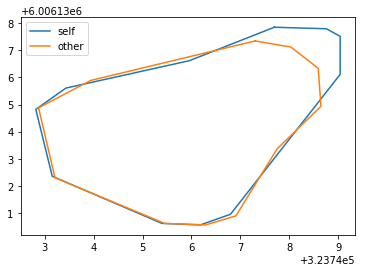

[[153 391]
 [152 392]
 [151 392]
 [150 392]
 [149 393]
 [148 394]
 [147 395]
 [146 396]
 [145 397]
 [145 398]
 [144 399]
 [143 400]
 [143 401]
 [142 402]
 [142 403]
 [141 404]
 [140 405]
 [140 406]
 [139 407]
 [139 408]
 [138 409]
 [137 410]
 [137 411]
 [136 412]
 [136 413]
 [135 414]
 [134 415]
 [134 416]
 [133 417]
 [133 418]
 [132 419]
 [131 420]
 [131 421]
 [131 422]
 [130 423]
 [130 424]
 [129 425]
 [129 426]
 [128 427]
 [128 428]
 [127 429]
 [127 430]
 [126 431]
 [126 432]
 [125 433]
 [125 434]
 [124 435]
 [124 436]
 [123 437]
 [123 438]
 [122 439]
 [121 440]
 [121 441]
 [120 442]
 [120 443]
 [120 444]
 [119 445]
 [119 446]
 [119 447]
 [118 448]
 [118 449]
 [118 450]
 [118 451]
 [118 452]
 [118 453]
 [118 454]
 [118 455]
 [118 456]
 [118 457]
 [118 458]
 [118 459]
 [119 460]
 [120 461]
 [121 462]
 [122 462]
 [123 463]
 [124 463]
 [125 463]
 [126 463]
 [127 464]
 [128 464]
 [129 464]
 [130 464]
 [131 464]
 [132 464]
 [133 464]
 [134 464]
 [135 463]
 [136 463]
 [137 463]
 [138 463]

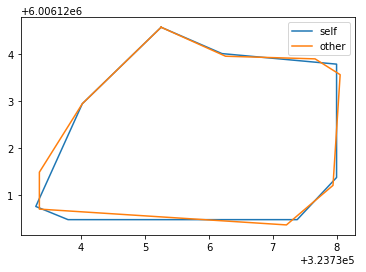

[[550 307]
 [549 308]
 [548 308]
 [547 308]
 [546 308]
 [545 308]
 [544 308]
 [543 308]
 [542 309]
 [541 309]
 [540 309]
 [539 309]
 [538 309]
 [537 309]
 [536 310]
 [535 310]
 [534 310]
 [533 310]
 [532 310]
 [531 311]
 [530 311]
 [529 311]
 [528 311]
 [527 312]
 [526 312]
 [525 312]
 [524 313]
 [523 313]
 [522 313]
 [521 314]
 [520 314]
 [519 314]
 [518 314]
 [517 314]
 [516 314]
 [515 315]
 [514 315]
 [513 315]
 [512 315]
 [511 315]
 [510 315]
 [509 315]
 [508 316]
 [507 316]
 [506 316]
 [505 317]
 [504 318]
 [503 319]
 [503 320]
 [502 321]
 [502 322]
 [501 323]
 [501 324]
 [501 325]
 [500 326]
 [500 327]
 [500 328]
 [500 329]
 [500 330]
 [500 331]
 [500 332]
 [500 333]
 [500 334]
 [500 335]
 [499 336]
 [499 337]
 [499 338]
 [499 339]
 [499 340]
 [499 341]
 [498 342]
 [498 343]
 [498 344]
 [498 345]
 [498 346]
 [497 347]
 [497 348]
 [497 349]
 [496 350]
 [496 351]
 [496 352]
 [496 353]
 [496 354]
 [495 355]
 [495 356]
 [495 357]
 [495 358]
 [495 359]
 [495 360]
 [495 361]
 [495 362]

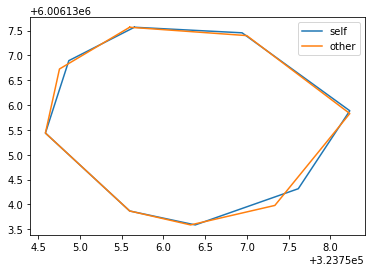

[[105 266]
 [104 267]
 [103 267]
 [102 267]
 [101 268]
 [100 268]
 [ 99 269]
 [ 98 269]
 [ 97 270]
 [ 96 270]
 [ 95 271]
 [ 94 272]
 [ 93 273]
 [ 92 273]
 [ 91 274]
 [ 90 275]
 [ 89 276]
 [ 88 277]
 [ 87 278]
 [ 86 278]
 [ 85 279]
 [ 84 280]
 [ 83 281]
 [ 82 282]
 [ 81 283]
 [ 80 284]
 [ 79 284]
 [ 79 285]
 [ 78 286]
 [ 77 287]
 [ 77 288]
 [ 76 289]
 [ 76 290]
 [ 75 291]
 [ 75 292]
 [ 74 293]
 [ 74 294]
 [ 73 295]
 [ 73 296]
 [ 73 297]
 [ 73 298]
 [ 72 299]
 [ 72 300]
 [ 72 301]
 [ 72 302]
 [ 72 303]
 [ 72 304]
 [ 72 305]
 [ 71 306]
 [ 71 307]
 [ 71 308]
 [ 71 309]
 [ 71 310]
 [ 71 311]
 [ 71 312]
 [ 71 313]
 [ 71 314]
 [ 71 315]
 [ 71 316]
 [ 71 317]
 [ 71 318]
 [ 71 319]
 [ 71 320]
 [ 71 321]
 [ 71 322]
 [ 72 323]
 [ 72 324]
 [ 72 325]
 [ 72 326]
 [ 72 327]
 [ 73 328]
 [ 73 329]
 [ 74 330]
 [ 74 331]
 [ 74 332]
 [ 75 333]
 [ 75 334]
 [ 76 335]
 [ 77 336]
 [ 78 337]
 [ 79 338]
 [ 80 338]
 [ 81 339]
 [ 82 339]
 [ 83 339]
 [ 84 340]
 [ 85 340]
 [ 86 340]
 [ 87 340]
 [ 88 341]
 [ 89 341]

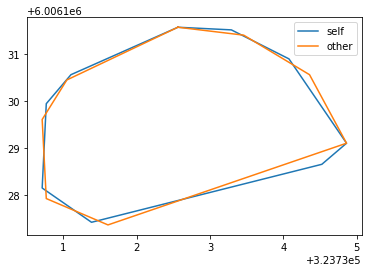

[[245 508]
 [244 509]
 [243 509]
 [242 509]
 [241 510]
 [240 510]
 [239 510]
 [238 511]
 [237 511]
 [236 512]
 [235 512]
 [234 512]
 [233 513]
 [232 513]
 [231 513]
 [230 514]
 [229 514]
 [228 515]
 [227 516]
 [226 516]
 [225 517]
 [224 517]
 [223 517]
 [222 518]
 [221 518]
 [220 519]
 [219 519]
 [218 520]
 [217 521]
 [216 521]
 [215 522]
 [214 523]
 [213 524]
 [213 525]
 [212 526]
 [212 527]
 [211 528]
 [211 529]
 [210 530]
 [210 531]
 [209 532]
 [209 533]
 [209 534]
 [209 535]
 [208 536]
 [208 537]
 [208 538]
 [207 539]
 [207 540]
 [207 541]
 [206 542]
 [206 543]
 [206 544]
 [206 545]
 [205 546]
 [205 547]
 [205 548]
 [205 549]
 [205 550]
 [205 551]
 [204 552]
 [204 553]
 [204 554]
 [204 555]
 [204 556]
 [204 557]
 [204 558]
 [204 559]
 [204 560]
 [204 561]
 [204 562]
 [204 563]
 [204 564]
 [204 565]
 [204 566]
 [204 567]
 [204 568]
 [205 569]
 [205 570]
 [205 571]
 [205 572]
 [206 573]
 [206 574]
 [206 575]
 [207 576]
 [207 577]
 [208 578]
 [208 579]
 [209 580]
 [210 581]
 [211 582]

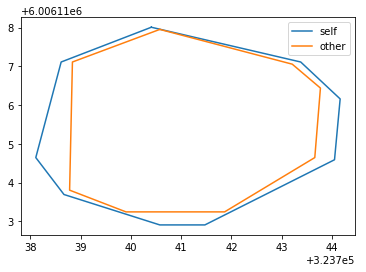

[[405 199]
 [404 200]
 [403 200]
 [402 201]
 [401 201]
 [400 202]
 [399 203]
 [398 203]
 [397 204]
 [396 205]
 [395 205]
 [394 206]
 [393 207]
 [392 208]
 [391 209]
 [390 210]
 [390 211]
 [389 212]
 [388 213]
 [387 214]
 [386 215]
 [385 216]
 [385 217]
 [384 218]
 [383 219]
 [383 220]
 [382 221]
 [381 222]
 [381 223]
 [380 224]
 [379 225]
 [379 226]
 [378 227]
 [378 228]
 [377 229]
 [377 230]
 [376 231]
 [376 232]
 [375 233]
 [375 234]
 [374 235]
 [374 236]
 [373 237]
 [373 238]
 [372 239]
 [372 240]
 [371 241]
 [371 242]
 [370 243]
 [370 244]
 [369 245]
 [369 246]
 [368 247]
 [368 248]
 [367 249]
 [366 250]
 [366 251]
 [365 252]
 [365 253]
 [364 254]
 [364 255]
 [363 256]
 [363 257]
 [362 258]
 [362 259]
 [362 260]
 [361 261]
 [361 262]
 [360 263]
 [359 264]
 [358 265]
 [357 266]
 [357 267]
 [356 268]
 [356 269]
 [356 270]
 [355 271]
 [355 272]
 [355 273]
 [354 274]
 [354 275]
 [354 276]
 [354 277]
 [354 278]
 [353 279]
 [353 280]
 [353 281]
 [353 282]
 [353 283]
 [354 284]
 [355 285]

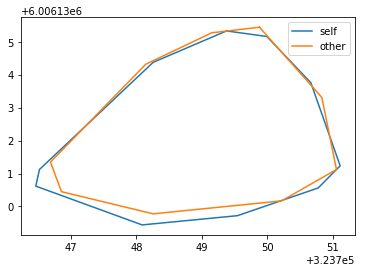

[[551 114]
 [550 115]
 [549 116]
 [548 116]
 [547 117]
 [547 118]
 [546 119]
 [546 120]
 [546 121]
 [546 122]
 [546 123]
 [546 124]
 [546 125]
 [546 126]
 [545 127]
 [546 128]
 [546 129]
 [546 130]
 [546 131]
 [546 132]
 [546 133]
 [546 134]
 [546 135]
 [546 136]
 [546 137]
 [546 138]
 [546 139]
 [546 140]
 [546 141]
 [546 142]
 [546 143]
 [546 144]
 [545 145]
 [545 146]
 [545 147]
 [545 148]
 [545 149]
 [545 150]
 [544 151]
 [544 152]
 [544 153]
 [544 154]
 [544 155]
 [544 156]
 [544 157]
 [543 158]
 [544 159]
 [544 160]
 [544 161]
 [544 162]
 [544 163]
 [545 164]
 [545 165]
 [545 166]
 [546 167]
 [546 168]
 [547 169]
 [547 170]
 [548 171]
 [549 172]
 [549 173]
 [550 174]
 [551 175]
 [551 176]
 [552 177]
 [553 178]
 [553 179]
 [554 179]
 [555 180]
 [555 181]
 [556 182]
 [557 183]
 [557 184]
 [558 185]
 [559 186]
 [560 187]
 [560 188]
 [561 189]
 [562 189]
 [563 190]
 [564 191]
 [565 191]
 [566 191]
 [567 191]
 [568 192]
 [569 192]
 [570 192]
 [571 192]
 [572 193]
 [573 193]
 [574 194]

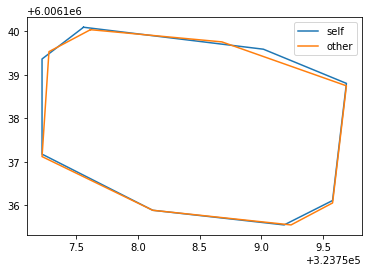

[[482 484]
 [481 485]
 [480 485]
 [479 485]
 [478 485]
 [477 486]
 [476 486]
 [475 486]
 [474 486]
 [473 486]
 [472 487]
 [471 487]
 [470 488]
 [469 488]
 [468 488]
 [467 489]
 [466 489]
 [465 490]
 [464 490]
 [463 491]
 [462 492]
 [461 492]
 [460 493]
 [459 493]
 [458 493]
 [457 494]
 [456 494]
 [455 494]
 [454 495]
 [453 495]
 [452 496]
 [451 496]
 [450 497]
 [449 497]
 [448 498]
 [447 498]
 [446 499]
 [445 499]
 [444 500]
 [443 501]
 [442 502]
 [441 503]
 [440 504]
 [439 505]
 [439 506]
 [438 507]
 [437 508]
 [437 509]
 [436 510]
 [435 511]
 [434 512]
 [433 513]
 [433 514]
 [432 515]
 [432 516]
 [432 517]
 [432 518]
 [432 519]
 [432 520]
 [431 521]
 [432 522]
 [432 523]
 [432 524]
 [432 525]
 [433 526]
 [433 527]
 [433 528]
 [433 529]
 [433 530]
 [433 531]
 [433 532]
 [433 533]
 [433 534]
 [433 535]
 [434 536]
 [434 537]
 [434 538]
 [434 539]
 [433 540]
 [433 541]
 [433 542]
 [432 543]
 [432 544]
 [432 545]
 [433 546]
 [433 547]
 [433 548]
 [433 549]
 [432 550]
 [432 551]
 [432 552]

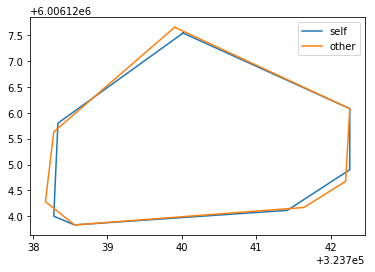

[[563 421]
 [562 422]
 [561 422]
 [560 423]
 [559 424]
 [558 424]
 [557 425]
 [556 426]
 [556 427]
 [555 428]
 [554 429]
 [553 430]
 [553 431]
 [552 432]
 [551 433]
 [551 434]
 [550 435]
 [549 436]
 [548 437]
 [547 438]
 [547 439]
 [546 440]
 [545 441]
 [544 442]
 [544 443]
 [543 444]
 [543 445]
 [542 446]
 [541 447]
 [541 448]
 [540 449]
 [540 450]
 [540 451]
 [539 452]
 [539 453]
 [539 454]
 [538 455]
 [538 456]
 [538 457]
 [538 458]
 [538 459]
 [538 460]
 [538 461]
 [538 462]
 [538 463]
 [538 464]
 [538 465]
 [539 466]
 [539 467]
 [539 468]
 [540 469]
 [540 470]
 [541 471]
 [541 472]
 [542 473]
 [543 474]
 [544 474]
 [545 475]
 [546 475]
 [547 476]
 [548 476]
 [549 476]
 [550 477]
 [551 477]
 [552 477]
 [553 477]
 [554 477]
 [555 478]
 [556 478]
 [557 478]
 [558 478]
 [559 478]
 [560 478]
 [561 478]
 [562 479]
 [563 479]
 [564 479]
 [565 479]
 [566 479]
 [567 480]
 [568 480]
 [569 480]
 [570 481]
 [571 481]
 [572 481]
 [573 482]
 [574 482]
 [575 482]
 [576 483]
 [577 483]
 [578 483]

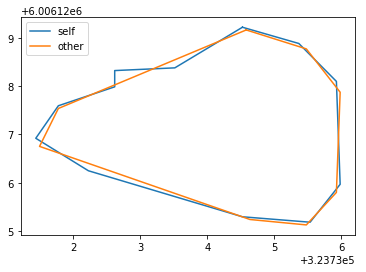

[[277 456]
 [276 457]
 [275 457]
 [274 458]
 [273 458]
 [272 459]
 [271 460]
 [270 460]
 [269 461]
 [268 462]
 [267 462]
 [266 463]
 [265 464]
 [264 465]
 [263 465]
 [262 466]
 [261 467]
 [260 467]
 [259 468]
 [258 469]
 [257 470]
 [256 471]
 [255 472]
 [254 473]
 [253 474]
 [253 475]
 [252 476]
 [251 477]
 [251 478]
 [251 479]
 [250 480]
 [250 481]
 [250 482]
 [250 483]
 [250 484]
 [250 485]
 [250 486]
 [250 487]
 [250 488]
 [250 489]
 [250 490]
 [250 491]
 [250 492]
 [250 493]
 [251 494]
 [251 495]
 [251 496]
 [252 497]
 [252 498]
 [252 499]
 [253 500]
 [253 501]
 [254 502]
 [254 503]
 [255 504]
 [255 505]
 [256 506]
 [257 507]
 [258 508]
 [259 509]
 [260 510]
 [261 511]
 [262 511]
 [263 512]
 [264 512]
 [265 513]
 [266 513]
 [267 513]
 [268 514]
 [269 514]
 [270 515]
 [271 515]
 [272 516]
 [273 516]
 [274 516]
 [275 517]
 [276 517]
 [277 517]
 [278 518]
 [279 518]
 [280 518]
 [281 519]
 [282 519]
 [283 519]
 [284 520]
 [285 520]
 [286 520]
 [287 521]
 [288 521]
 [289 521]
 [290 521]

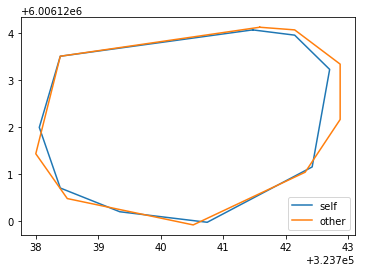

[[553 475]
 [552 476]
 [551 476]
 [550 476]
 [549 476]
 [548 476]
 [547 476]
 [546 477]
 [545 477]
 [544 477]
 [543 477]
 [542 478]
 [541 478]
 [540 479]
 [539 479]
 [538 479]
 [537 479]
 [536 480]
 [535 480]
 [534 480]
 [533 481]
 [532 481]
 [531 481]
 [530 482]
 [529 482]
 [528 482]
 [527 482]
 [526 483]
 [525 483]
 [524 484]
 [523 484]
 [522 484]
 [521 485]
 [520 485]
 [519 486]
 [518 487]
 [517 488]
 [516 489]
 [516 490]
 [515 491]
 [515 492]
 [515 493]
 [515 494]
 [514 495]
 [514 496]
 [514 497]
 [514 498]
 [514 499]
 [514 500]
 [514 501]
 [515 502]
 [515 503]
 [515 504]
 [515 505]
 [516 506]
 [516 507]
 [516 508]
 [516 509]
 [516 510]
 [516 511]
 [516 512]
 [517 513]
 [517 514]
 [517 515]
 [517 516]
 [517 517]
 [518 518]
 [518 519]
 [518 520]
 [518 521]
 [518 522]
 [518 523]
 [518 524]
 [519 525]
 [519 526]
 [519 527]
 [519 528]
 [519 529]
 [519 530]
 [520 531]
 [520 532]
 [520 533]
 [520 534]
 [520 535]
 [520 536]
 [520 537]
 [520 538]
 [521 539]
 [521 540]
 [521 541]
 [521 542]

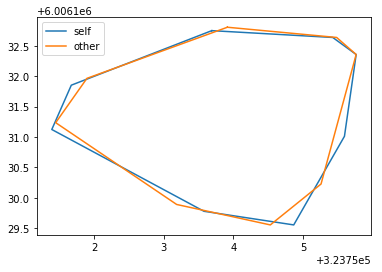

[[307 410]
 [306 411]
 [305 411]
 [304 411]
 [303 411]
 [302 411]
 [301 412]
 [300 412]
 [299 412]
 [298 412]
 [297 413]
 [296 413]
 [295 414]
 [294 414]
 [294 415]
 [293 416]
 [292 417]
 [291 418]
 [290 419]
 [290 420]
 [289 421]
 [289 422]
 [289 423]
 [289 424]
 [289 425]
 [288 426]
 [288 427]
 [288 428]
 [288 429]
 [288 430]
 [288 431]
 [287 432]
 [287 433]
 [287 434]
 [287 435]
 [287 436]
 [287 437]
 [287 438]
 [287 439]
 [287 440]
 [287 441]
 [287 442]
 [287 443]
 [287 444]
 [287 445]
 [287 446]
 [287 447]
 [287 448]
 [288 449]
 [288 450]
 [289 451]
 [289 452]
 [290 453]
 [290 454]
 [291 455]
 [292 456]
 [293 457]
 [294 458]
 [295 459]
 [296 460]
 [297 461]
 [298 462]
 [299 463]
 [300 464]
 [301 464]
 [302 465]
 [303 466]
 [304 467]
 [305 468]
 [306 469]
 [307 470]
 [308 471]
 [309 472]
 [310 472]
 [311 473]
 [312 474]
 [313 474]
 [314 475]
 [315 476]
 [316 476]
 [317 477]
 [318 478]
 [319 479]
 [320 480]
 [321 480]
 [322 481]
 [323 482]
 [324 483]
 [325 483]
 [326 484]
 [327 484]

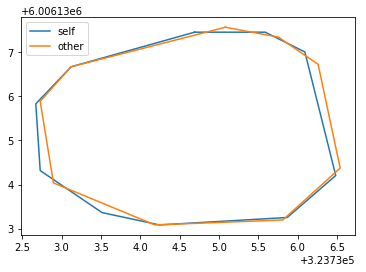

[[492 198]
 [491 199]
 [490 199]
 [489 199]
 [488 199]
 [487 199]
 [486 200]
 [485 200]
 [484 201]
 [483 201]
 [482 201]
 [481 202]
 [480 202]
 [479 202]
 [478 202]
 [477 203]
 [476 203]
 [475 203]
 [474 203]
 [473 203]
 [472 203]
 [471 203]
 [470 203]
 [469 203]
 [468 203]
 [467 203]
 [466 203]
 [465 203]
 [464 203]
 [463 203]
 [462 203]
 [461 203]
 [460 203]
 [459 203]
 [458 203]
 [457 204]
 [456 204]
 [455 204]
 [454 204]
 [453 204]
 [452 204]
 [451 204]
 [450 204]
 [449 204]
 [448 205]
 [447 205]
 [446 205]
 [445 206]
 [444 206]
 [443 206]
 [442 207]
 [441 207]
 [440 207]
 [439 208]
 [438 208]
 [437 208]
 [436 209]
 [435 209]
 [434 209]
 [433 210]
 [432 210]
 [431 211]
 [430 212]
 [429 213]
 [428 214]
 [428 215]
 [428 216]
 [428 217]
 [428 218]
 [428 219]
 [428 220]
 [428 221]
 [428 222]
 [428 223]
 [428 224]
 [428 225]
 [428 226]
 [428 227]
 [428 228]
 [428 229]
 [428 230]
 [428 231]
 [428 232]
 [428 233]
 [429 234]
 [429 235]
 [429 236]
 [430 237]
 [430 238]
 [431 239]
 [431 240]

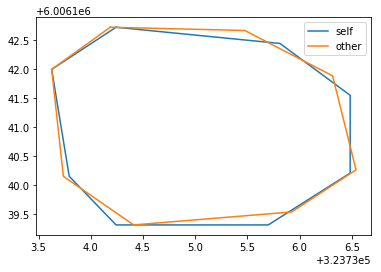

[[ 46 511]
 [ 45 512]
 [ 44 512]
 [ 43 512]
 [ 42 512]
 [ 41 512]
 [ 40 513]
 [ 39 513]
 [ 38 513]
 [ 37 514]
 [ 36 514]
 [ 35 515]
 [ 34 516]
 [ 33 516]
 [ 32 517]
 [ 31 518]
 [ 30 519]
 [ 29 520]
 [ 28 521]
 [ 27 522]
 [ 26 523]
 [ 26 524]
 [ 26 525]
 [ 25 526]
 [ 24 527]
 [ 24 528]
 [ 24 529]
 [ 23 530]
 [ 23 531]
 [ 23 532]
 [ 22 533]
 [ 22 534]
 [ 22 535]
 [ 21 536]
 [ 21 537]
 [ 21 538]
 [ 21 539]
 [ 21 540]
 [ 20 541]
 [ 20 542]
 [ 20 543]
 [ 20 544]
 [ 20 545]
 [ 20 546]
 [ 20 547]
 [ 20 548]
 [ 21 549]
 [ 21 550]
 [ 21 551]
 [ 21 552]
 [ 21 553]
 [ 21 554]
 [ 22 555]
 [ 23 556]
 [ 24 557]
 [ 24 558]
 [ 25 559]
 [ 26 560]
 [ 27 561]
 [ 28 562]
 [ 29 563]
 [ 30 563]
 [ 31 564]
 [ 32 564]
 [ 33 565]
 [ 34 565]
 [ 35 565]
 [ 36 565]
 [ 37 566]
 [ 38 566]
 [ 39 566]
 [ 40 566]
 [ 41 566]
 [ 42 566]
 [ 43 567]
 [ 44 567]
 [ 45 567]
 [ 46 567]
 [ 47 567]
 [ 48 567]
 [ 49 567]
 [ 50 567]
 [ 51 567]
 [ 52 567]
 [ 53 567]
 [ 54 567]
 [ 55 568]
 [ 56 568]
 [ 57 568]
 [ 58 568]
 [ 59 568]

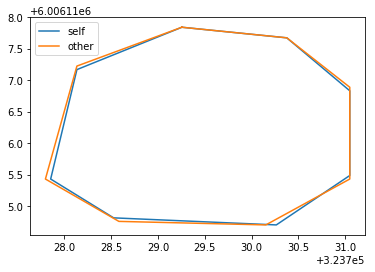

15it [00:24,  2.21s/it]

[[470  77]
 [469  78]
 [468  78]
 [467  79]
 [466  79]
 [465  80]
 [464  81]
 [463  82]
 [463  83]
 [462  84]
 [462  85]
 [461  86]
 [461  87]
 [460  88]
 [460  89]
 [459  90]
 [458  91]
 [458  92]
 [457  93]
 [457  94]
 [457  95]
 [456  96]
 [456  97]
 [455  98]
 [455  99]
 [454 100]
 [453 101]
 [453 102]
 [452 103]
 [452 104]
 [451 105]
 [450 106]
 [450 107]
 [449 108]
 [449 109]
 [448 110]
 [448 111]
 [447 112]
 [446 113]
 [446 114]
 [445 115]
 [445 116]
 [445 117]
 [444 118]
 [444 119]
 [444 120]
 [443 121]
 [443 122]
 [443 123]
 [443 124]
 [442 125]
 [442 126]
 [442 127]
 [442 128]
 [442 129]
 [442 130]
 [442 131]
 [442 132]
 [442 133]
 [442 134]
 [441 135]
 [441 136]
 [441 137]
 [441 138]
 [441 139]
 [441 140]
 [441 141]
 [441 142]
 [441 143]
 [441 144]
 [441 145]
 [441 146]
 [441 147]
 [441 148]
 [441 149]
 [441 150]
 [441 151]
 [441 152]
 [441 153]
 [441 154]
 [441 155]
 [441 156]
 [441 157]
 [441 158]
 [442 159]
 [442 160]
 [442 161]
 [442 162]
 [442 163]
 [442 164]
 [442 165]

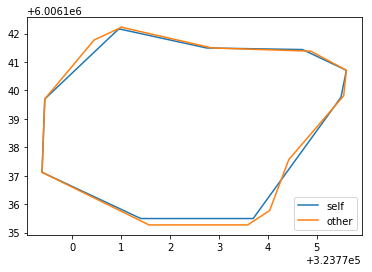

[[271 211]
 [270 212]
 [269 212]
 [268 212]
 [267 212]
 [266 213]
 [265 213]
 [264 214]
 [263 214]
 [262 215]
 [261 215]
 [260 216]
 [259 216]
 [259 217]
 [258 218]
 [257 219]
 [257 220]
 [256 221]
 [255 222]
 [255 223]
 [254 224]
 [254 225]
 [253 226]
 [253 227]
 [253 228]
 [253 229]
 [252 230]
 [252 231]
 [252 232]
 [252 233]
 [251 234]
 [251 235]
 [251 236]
 [251 237]
 [251 238]
 [250 239]
 [250 240]
 [250 241]
 [250 242]
 [250 243]
 [249 244]
 [249 245]
 [249 246]
 [249 247]
 [249 248]
 [248 249]
 [248 250]
 [248 251]
 [248 252]
 [248 253]
 [248 254]
 [248 255]
 [247 256]
 [247 257]
 [247 258]
 [247 259]
 [247 260]
 [247 261]
 [247 262]
 [247 263]
 [247 264]
 [247 265]
 [247 266]
 [247 267]
 [247 268]
 [247 269]
 [248 270]
 [248 271]
 [248 272]
 [248 273]
 [248 274]
 [249 275]
 [249 276]
 [249 277]
 [249 278]
 [250 279]
 [250 280]
 [250 281]
 [251 282]
 [251 283]
 [251 284]
 [252 285]
 [252 286]
 [252 287]
 [253 288]
 [253 289]
 [253 290]
 [253 291]
 [254 292]
 [254 293]
 [255 294]

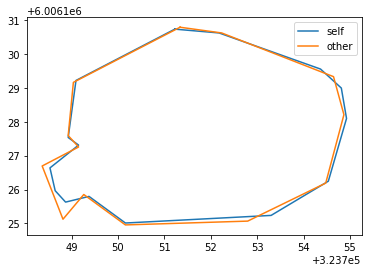

[[425 207]
 [424 208]
 [423 208]
 [422 208]
 [421 208]
 [420 208]
 [419 208]
 [418 208]
 [417 208]
 [416 209]
 [415 209]
 [414 209]
 [413 210]
 [412 210]
 [411 211]
 [410 212]
 [409 213]
 [408 214]
 [407 215]
 [406 216]
 [405 217]
 [404 218]
 [404 219]
 [403 220]
 [402 221]
 [401 222]
 [400 223]
 [399 224]
 [398 225]
 [397 226]
 [396 227]
 [395 228]
 [395 229]
 [394 230]
 [394 231]
 [394 232]
 [393 233]
 [393 234]
 [393 235]
 [393 236]
 [393 237]
 [394 238]
 [394 239]
 [394 240]
 [394 241]
 [395 242]
 [396 243]
 [396 244]
 [397 245]
 [398 246]
 [398 247]
 [399 248]
 [400 249]
 [401 250]
 [402 251]
 [403 252]
 [404 253]
 [405 254]
 [406 255]
 [407 255]
 [408 256]
 [409 257]
 [410 258]
 [411 259]
 [412 259]
 [413 260]
 [414 260]
 [415 261]
 [416 261]
 [417 261]
 [418 261]
 [419 261]
 [420 261]
 [421 262]
 [422 262]
 [423 262]
 [424 262]
 [425 262]
 [426 262]
 [427 262]
 [428 262]
 [429 262]
 [430 262]
 [431 262]
 [432 262]
 [433 262]
 [434 262]
 [435 262]
 [436 262]
 [437 262]
 [438 262]

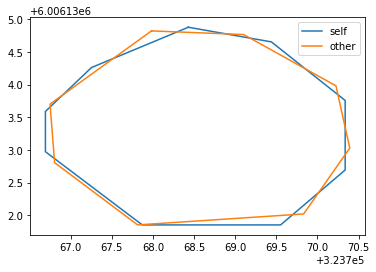

[[194 370]
 [193 371]
 [192 371]
 [191 371]
 [190 371]
 [189 371]
 [188 372]
 [187 372]
 [186 373]
 [185 374]
 [184 375]
 [184 376]
 [184 377]
 [184 378]
 [184 379]
 [184 380]
 [183 381]
 [183 382]
 [183 383]
 [183 384]
 [183 385]
 [183 386]
 [183 387]
 [182 388]
 [182 389]
 [182 390]
 [182 391]
 [182 392]
 [182 393]
 [182 394]
 [181 395]
 [181 396]
 [181 397]
 [180 398]
 [180 399]
 [180 400]
 [180 401]
 [180 402]
 [179 403]
 [179 404]
 [179 405]
 [179 406]
 [179 407]
 [179 408]
 [179 409]
 [178 410]
 [178 411]
 [178 412]
 [178 413]
 [178 414]
 [178 415]
 [178 416]
 [178 417]
 [178 418]
 [178 419]
 [178 420]
 [178 421]
 [178 422]
 [178 423]
 [179 424]
 [179 425]
 [179 426]
 [179 427]
 [179 428]
 [179 429]
 [180 430]
 [180 431]
 [180 432]
 [181 433]
 [181 434]
 [182 435]
 [182 436]
 [183 437]
 [184 438]
 [185 439]
 [186 440]
 [187 441]
 [188 442]
 [189 443]
 [189 444]
 [190 445]
 [191 445]
 [192 446]
 [193 447]
 [194 448]
 [195 449]
 [196 449]
 [197 449]
 [198 449]
 [199 450]
 [200 450]

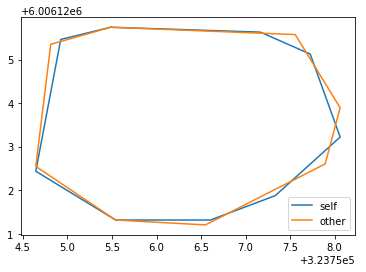

[[196 159]
 [195 160]
 [194 160]
 [193 161]
 [192 161]
 [191 162]
 [190 163]
 [189 164]
 [188 165]
 [187 166]
 [186 167]
 [185 168]
 [184 169]
 [184 170]
 [183 171]
 [183 172]
 [182 173]
 [181 174]
 [181 175]
 [181 176]
 [180 177]
 [180 178]
 [180 179]
 [179 180]
 [179 181]
 [179 182]
 [179 183]
 [179 184]
 [178 185]
 [178 186]
 [178 187]
 [178 188]
 [178 189]
 [178 190]
 [178 191]
 [178 192]
 [178 193]
 [178 194]
 [178 195]
 [178 196]
 [178 197]
 [179 198]
 [179 199]
 [180 200]
 [180 201]
 [181 202]
 [181 203]
 [182 204]
 [182 205]
 [183 206]
 [184 207]
 [184 208]
 [185 209]
 [185 210]
 [186 211]
 [187 212]
 [187 213]
 [188 214]
 [189 215]
 [190 216]
 [190 217]
 [191 218]
 [192 219]
 [193 220]
 [194 221]
 [195 222]
 [195 223]
 [196 224]
 [197 225]
 [198 226]
 [199 227]
 [200 228]
 [201 229]
 [202 229]
 [203 229]
 [204 229]
 [205 230]
 [206 230]
 [207 230]
 [208 230]
 [209 230]
 [210 230]
 [211 230]
 [212 229]
 [213 229]
 [214 229]
 [215 228]
 [216 228]
 [217 228]
 [218 228]
 [219 227]

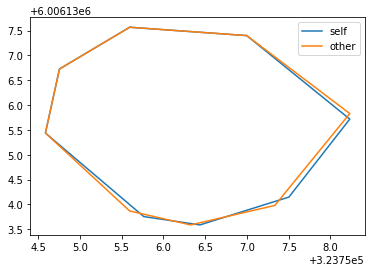

[[230 307]
 [229 308]
 [228 308]
 [227 308]
 [226 308]
 [225 308]
 [224 309]
 [223 309]
 [222 309]
 [221 309]
 [220 310]
 [219 310]
 [218 310]
 [217 310]
 [216 310]
 [215 311]
 [214 311]
 [213 311]
 [212 311]
 [211 312]
 [210 312]
 [209 312]
 [208 313]
 [207 313]
 [206 313]
 [205 314]
 [204 314]
 [203 314]
 [202 315]
 [201 315]
 [200 315]
 [199 315]
 [198 315]
 [197 316]
 [196 316]
 [195 316]
 [194 316]
 [193 317]
 [192 317]
 [191 317]
 [190 317]
 [189 318]
 [188 318]
 [187 318]
 [186 319]
 [185 320]
 [184 321]
 [183 322]
 [183 323]
 [182 324]
 [182 325]
 [181 326]
 [181 327]
 [181 328]
 [181 329]
 [180 330]
 [180 331]
 [180 332]
 [180 333]
 [180 334]
 [180 335]
 [180 336]
 [180 337]
 [180 338]
 [180 339]
 [179 340]
 [179 341]
 [179 342]
 [179 343]
 [178 344]
 [178 345]
 [178 346]
 [178 347]
 [177 348]
 [177 349]
 [177 350]
 [176 351]
 [176 352]
 [176 353]
 [176 354]
 [176 355]
 [176 356]
 [176 357]
 [176 358]
 [176 359]
 [176 360]
 [176 361]
 [176 362]
 [176 363]
 [177 364]
 [177 365]

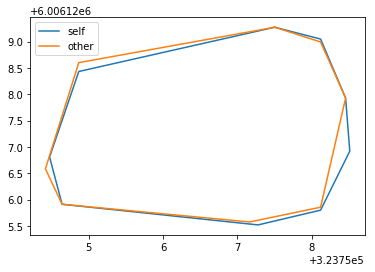

[[292 131]
 [291 132]
 [290 132]
 [289 132]
 [288 132]
 [287 132]
 [286 132]
 [285 133]
 [284 133]
 [283 134]
 [282 134]
 [281 134]
 [280 135]
 [279 136]
 [278 136]
 [277 137]
 [276 138]
 [275 139]
 [274 140]
 [273 141]
 [272 142]
 [272 143]
 [271 144]
 [271 145]
 [271 146]
 [270 147]
 [270 148]
 [270 149]
 [269 150]
 [269 151]
 [269 152]
 [269 153]
 [268 154]
 [268 155]
 [268 156]
 [268 157]
 [268 158]
 [267 159]
 [267 160]
 [267 161]
 [267 162]
 [267 163]
 [267 164]
 [267 165]
 [266 166]
 [266 167]
 [266 168]
 [266 169]
 [266 170]
 [266 171]
 [265 172]
 [265 173]
 [265 174]
 [265 175]
 [265 176]
 [265 177]
 [265 178]
 [264 179]
 [264 180]
 [264 181]
 [264 182]
 [264 183]
 [264 184]
 [264 185]
 [263 186]
 [263 187]
 [263 188]
 [263 189]
 [264 190]
 [264 191]
 [264 192]
 [264 193]
 [264 194]
 [264 195]
 [265 196]
 [265 197]
 [265 198]
 [265 199]
 [266 200]
 [266 201]
 [266 202]
 [267 203]
 [267 204]
 [268 205]
 [269 206]
 [270 207]
 [271 208]
 [272 209]
 [273 209]
 [274 210]
 [275 210]

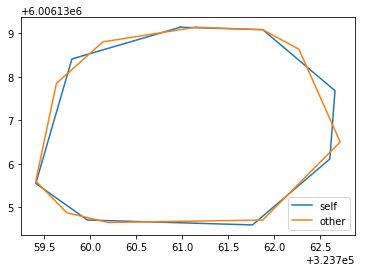

[[558 119]
 [557 120]
 [556 120]
 [555 121]
 [554 121]
 [553 121]
 [552 122]
 [551 123]
 [550 124]
 [550 125]
 [549 126]
 [548 127]
 [548 128]
 [547 129]
 [546 130]
 [546 131]
 [545 132]
 [545 133]
 [544 134]
 [544 135]
 [543 136]
 [543 137]
 [542 138]
 [542 139]
 [541 140]
 [541 141]
 [540 142]
 [540 143]
 [539 144]
 [539 145]
 [538 146]
 [538 147]
 [538 148]
 [537 149]
 [537 150]
 [537 151]
 [536 152]
 [536 153]
 [536 154]
 [535 155]
 [535 156]
 [534 157]
 [534 158]
 [534 159]
 [533 160]
 [533 161]
 [533 162]
 [532 163]
 [532 164]
 [532 165]
 [531 166]
 [531 167]
 [531 168]
 [530 169]
 [530 170]
 [529 171]
 [529 172]
 [529 173]
 [529 174]
 [528 175]
 [528 176]
 [528 177]
 [528 178]
 [528 179]
 [527 180]
 [527 181]
 [527 182]
 [527 183]
 [527 184]
 [527 185]
 [527 186]
 [528 187]
 [528 188]
 [528 189]
 [529 190]
 [529 191]
 [530 192]
 [531 193]
 [532 194]
 [533 194]
 [534 195]
 [535 195]
 [536 196]
 [537 196]
 [538 197]
 [539 198]
 [540 198]
 [541 198]
 [542 199]
 [543 199]
 [544 199]

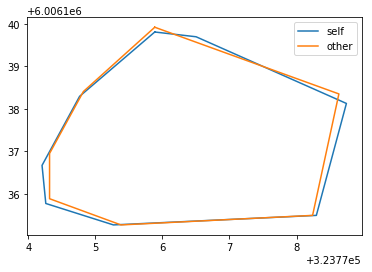

[[562 484]
 [561 485]
 [560 485]
 [559 485]
 [558 485]
 [557 486]
 [556 486]
 [555 487]
 [554 488]
 [554 489]
 [553 490]
 [552 491]
 [552 492]
 [551 493]
 [551 494]
 [551 495]
 [551 496]
 [550 497]
 [550 498]
 [551 499]
 [551 500]
 [551 501]
 [551 502]
 [550 503]
 [550 504]
 [550 505]
 [551 506]
 [551 507]
 [551 508]
 [551 509]
 [551 510]
 [551 511]
 [551 512]
 [551 513]
 [550 514]
 [550 515]
 [550 516]
 [550 517]
 [550 518]
 [550 519]
 [550 520]
 [550 521]
 [550 522]
 [550 523]
 [550 524]
 [550 525]
 [550 526]
 [550 527]
 [550 528]
 [550 529]
 [550 530]
 [550 531]
 [550 532]
 [550 533]
 [550 534]
 [550 535]
 [550 536]
 [550 537]
 [550 538]
 [550 539]
 [550 540]
 [551 541]
 [551 542]
 [551 543]
 [552 544]
 [552 545]
 [553 545]
 [554 546]
 [555 547]
 [556 547]
 [557 548]
 [558 548]
 [559 548]
 [560 548]
 [561 548]
 [562 548]
 [563 548]
 [564 548]
 [565 548]
 [566 548]
 [567 548]
 [568 548]
 [569 548]
 [570 548]
 [571 548]
 [572 548]
 [573 548]
 [574 547]
 [575 547]
 [576 547]
 [577 547]

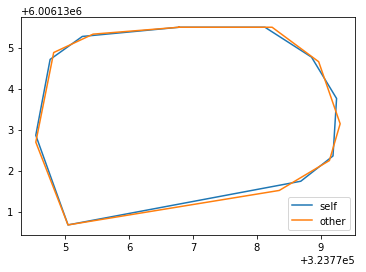

[[ 88 198]
 [ 87 199]
 [ 86 199]
 [ 85 200]
 [ 84 200]
 [ 83 200]
 [ 82 201]
 [ 81 201]
 [ 80 202]
 [ 79 202]
 [ 78 203]
 [ 77 204]
 [ 76 205]
 [ 75 206]
 [ 74 207]
 [ 73 208]
 [ 72 209]
 [ 72 210]
 [ 71 211]
 [ 70 212]
 [ 69 213]
 [ 68 214]
 [ 68 215]
 [ 67 216]
 [ 66 217]
 [ 65 218]
 [ 65 219]
 [ 64 220]
 [ 64 221]
 [ 63 222]
 [ 62 223]
 [ 62 224]
 [ 61 225]
 [ 61 226]
 [ 60 227]
 [ 59 228]
 [ 59 229]
 [ 59 230]
 [ 58 231]
 [ 58 232]
 [ 57 233]
 [ 56 234]
 [ 56 235]
 [ 55 236]
 [ 55 237]
 [ 54 238]
 [ 54 239]
 [ 53 240]
 [ 53 241]
 [ 52 242]
 [ 51 243]
 [ 51 244]
 [ 50 245]
 [ 50 246]
 [ 49 247]
 [ 48 248]
 [ 48 249]
 [ 47 250]
 [ 47 251]
 [ 46 252]
 [ 46 253]
 [ 45 254]
 [ 45 255]
 [ 44 256]
 [ 44 257]
 [ 43 258]
 [ 42 259]
 [ 42 260]
 [ 41 261]
 [ 40 262]
 [ 40 263]
 [ 40 264]
 [ 39 265]
 [ 38 266]
 [ 37 267]
 [ 37 268]
 [ 36 269]
 [ 36 270]
 [ 35 271]
 [ 35 272]
 [ 34 273]
 [ 34 274]
 [ 34 275]
 [ 33 276]
 [ 33 277]
 [ 33 278]
 [ 33 279]
 [ 33 280]
 [ 33 281]
 [ 34 282]
 [ 35 283]

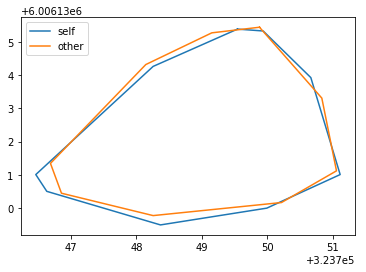

[[234 113]
 [233 114]
 [232 114]
 [231 114]
 [230 115]
 [229 115]
 [228 116]
 [227 117]
 [227 118]
 [226 119]
 [226 120]
 [226 121]
 [226 122]
 [226 123]
 [226 124]
 [225 125]
 [226 126]
 [226 127]
 [226 128]
 [226 129]
 [226 130]
 [226 131]
 [226 132]
 [226 133]
 [226 134]
 [226 135]
 [226 136]
 [226 137]
 [226 138]
 [226 139]
 [226 140]
 [226 141]
 [226 142]
 [226 143]
 [226 144]
 [226 145]
 [225 146]
 [225 147]
 [225 148]
 [225 149]
 [224 150]
 [224 151]
 [224 152]
 [224 153]
 [224 154]
 [223 155]
 [223 156]
 [223 157]
 [223 158]
 [223 159]
 [223 160]
 [223 161]
 [223 162]
 [224 163]
 [224 164]
 [224 165]
 [225 166]
 [225 167]
 [225 168]
 [226 169]
 [226 170]
 [227 171]
 [228 172]
 [228 173]
 [229 174]
 [230 175]
 [230 176]
 [231 177]
 [232 178]
 [233 179]
 [233 180]
 [234 181]
 [235 182]
 [235 183]
 [236 184]
 [237 185]
 [238 186]
 [238 187]
 [239 188]
 [240 188]
 [241 189]
 [242 190]
 [243 190]
 [244 191]
 [245 191]
 [246 191]
 [247 192]
 [248 192]
 [249 192]
 [250 192]
 [251 193]

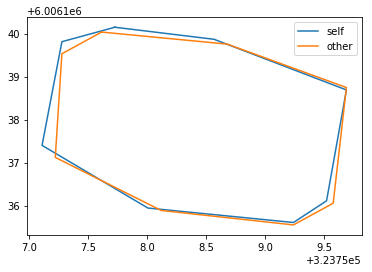

[[245 420]
 [244 421]
 [243 421]
 [242 421]
 [241 421]
 [240 422]
 [239 423]
 [238 424]
 [237 424]
 [236 425]
 [235 426]
 [235 427]
 [234 428]
 [233 429]
 [233 430]
 [232 431]
 [231 432]
 [231 433]
 [230 434]
 [229 435]
 [228 436]
 [228 437]
 [227 438]
 [226 439]
 [225 440]
 [225 441]
 [224 442]
 [223 443]
 [223 444]
 [222 445]
 [222 446]
 [221 447]
 [220 448]
 [220 449]
 [219 450]
 [219 451]
 [219 452]
 [218 453]
 [218 454]
 [218 455]
 [217 456]
 [217 457]
 [217 458]
 [217 459]
 [217 460]
 [217 461]
 [217 462]
 [218 463]
 [218 464]
 [218 465]
 [218 466]
 [219 467]
 [219 468]
 [220 469]
 [220 470]
 [221 471]
 [221 472]
 [222 473]
 [223 473]
 [224 474]
 [225 474]
 [226 475]
 [227 475]
 [228 476]
 [229 476]
 [230 477]
 [231 477]
 [232 477]
 [233 477]
 [234 477]
 [235 478]
 [236 478]
 [237 478]
 [238 478]
 [239 478]
 [240 478]
 [241 478]
 [242 478]
 [243 479]
 [244 479]
 [245 479]
 [246 479]
 [247 480]
 [248 480]
 [249 480]
 [250 481]
 [251 481]
 [252 481]
 [253 482]
 [254 482]
 [255 482]

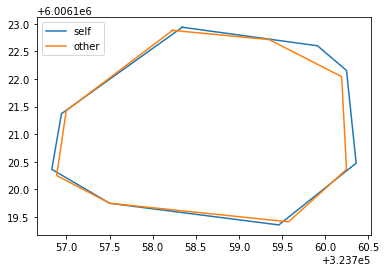

[[305 486]
 [304 487]
 [303 487]
 [302 487]
 [301 487]
 [300 488]
 [299 488]
 [298 488]
 [297 489]
 [296 489]
 [295 489]
 [294 489]
 [293 490]
 [292 490]
 [291 490]
 [290 490]
 [289 490]
 [288 490]
 [287 490]
 [286 491]
 [285 491]
 [284 491]
 [283 492]
 [282 492]
 [281 493]
 [280 493]
 [279 494]
 [278 495]
 [277 495]
 [276 496]
 [276 497]
 [275 498]
 [275 499]
 [274 500]
 [274 501]
 [273 502]
 [273 503]
 [272 504]
 [272 505]
 [272 506]
 [271 507]
 [271 508]
 [271 509]
 [271 510]
 [271 511]
 [270 512]
 [270 513]
 [270 514]
 [270 515]
 [270 516]
 [270 517]
 [269 518]
 [269 519]
 [269 520]
 [269 521]
 [269 522]
 [269 523]
 [269 524]
 [269 525]
 [268 526]
 [268 527]
 [268 528]
 [268 529]
 [268 530]
 [268 531]
 [268 532]
 [268 533]
 [268 534]
 [268 535]
 [268 536]
 [268 537]
 [268 538]
 [267 539]
 [267 540]
 [267 541]
 [267 542]
 [267 543]
 [267 544]
 [267 545]
 [267 546]
 [267 547]
 [267 548]
 [267 549]
 [267 550]
 [267 551]
 [267 552]
 [267 553]
 [267 554]
 [267 555]
 [267 556]
 [267 557]

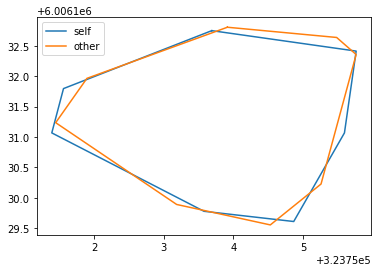

[[160 484]
 [159 485]
 [158 485]
 [157 485]
 [156 485]
 [155 485]
 [154 486]
 [153 486]
 [152 486]
 [151 487]
 [150 487]
 [149 488]
 [148 488]
 [147 488]
 [146 489]
 [145 489]
 [144 490]
 [143 491]
 [142 491]
 [141 492]
 [140 492]
 [139 493]
 [138 493]
 [137 494]
 [136 494]
 [135 495]
 [134 495]
 [133 496]
 [132 496]
 [131 497]
 [130 497]
 [129 497]
 [128 498]
 [127 498]
 [126 499]
 [125 499]
 [124 500]
 [123 501]
 [122 502]
 [121 503]
 [120 504]
 [120 505]
 [119 506]
 [118 507]
 [118 508]
 [117 509]
 [116 510]
 [116 511]
 [115 512]
 [114 513]
 [114 514]
 [114 515]
 [114 516]
 [114 517]
 [114 518]
 [113 519]
 [113 520]
 [113 521]
 [113 522]
 [113 523]
 [114 524]
 [114 525]
 [114 526]
 [114 527]
 [114 528]
 [114 529]
 [114 530]
 [114 531]
 [114 532]
 [114 533]
 [114 534]
 [115 535]
 [114 536]
 [114 537]
 [114 538]
 [114 539]
 [114 540]
 [114 541]
 [114 542]
 [113 543]
 [113 544]
 [113 545]
 [113 546]
 [113 547]
 [113 548]
 [113 549]
 [113 550]
 [114 551]
 [114 552]
 [114 553]
 [115 554]

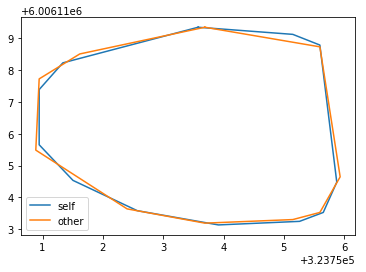

[[230 475]
 [229 476]
 [228 476]
 [227 476]
 [226 476]
 [225 477]
 [224 477]
 [223 477]
 [222 477]
 [221 478]
 [220 478]
 [219 478]
 [218 479]
 [217 479]
 [216 479]
 [215 480]
 [214 480]
 [213 481]
 [212 481]
 [211 482]
 [210 482]
 [209 482]
 [208 482]
 [207 483]
 [206 483]
 [205 483]
 [204 484]
 [203 484]
 [202 485]
 [201 485]
 [200 485]
 [199 486]
 [198 487]
 [197 488]
 [196 489]
 [196 490]
 [195 491]
 [195 492]
 [195 493]
 [195 494]
 [195 495]
 [194 496]
 [194 497]
 [194 498]
 [194 499]
 [194 500]
 [194 501]
 [195 502]
 [195 503]
 [195 504]
 [195 505]
 [195 506]
 [196 507]
 [196 508]
 [196 509]
 [196 510]
 [196 511]
 [196 512]
 [196 513]
 [196 514]
 [197 515]
 [197 516]
 [197 517]
 [197 518]
 [197 519]
 [198 520]
 [198 521]
 [198 522]
 [198 523]
 [198 524]
 [198 525]
 [198 526]
 [198 527]
 [199 528]
 [199 529]
 [199 530]
 [199 531]
 [199 532]
 [199 533]
 [199 534]
 [199 535]
 [200 536]
 [200 537]
 [200 538]
 [200 539]
 [200 540]
 [200 541]
 [200 542]
 [200 543]
 [200 544]
 [200 545]

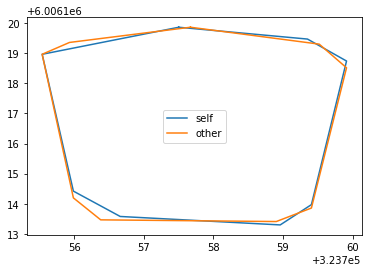

[[297  65]
 [296  66]
 [295  66]
 [294  66]
 [293  66]
 [292  66]
 [291  66]
 [290  66]
 [289  66]
 [288  67]
 [287  67]
 [286  67]
 [285  68]
 [284  68]
 [283  69]
 [282  69]
 [281  70]
 [280  70]
 [279  71]
 [278  71]
 [277  71]
 [276  72]
 [275  72]
 [274  73]
 [273  73]
 [272  73]
 [271  74]
 [270  74]
 [269  75]
 [268  76]
 [267  77]
 [266  77]
 [265  78]
 [264  79]
 [264  80]
 [263  81]
 [262  82]
 [261  83]
 [261  84]
 [261  85]
 [261  86]
 [260  87]
 [259  88]
 [259  89]
 [258  90]
 [258  91]
 [257  92]
 [256  93]
 [255  94]
 [254  94]
 [253  95]
 [252  96]
 [251  96]
 [250  97]
 [249  98]
 [248  99]
 [247 100]
 [246 101]
 [245 102]
 [244 102]
 [243 103]
 [242 104]
 [242 105]
 [242 106]
 [241 107]
 [242 108]
 [242 109]
 [242 110]
 [243 111]
 [243 112]
 [243 113]
 [244 114]
 [244 115]
 [245 116]
 [246 117]
 [247 118]
 [248 119]
 [249 120]
 [250 121]
 [251 121]
 [252 122]
 [253 123]
 [254 124]
 [255 124]
 [256 125]
 [257 126]
 [258 127]
 [259 128]
 [260 128]
 [261 129]
 [262 130]

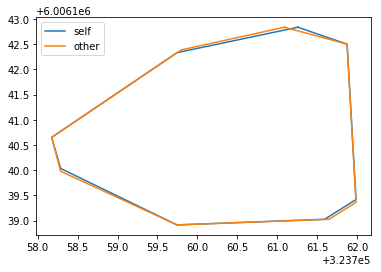

[[414 388]
 [413 389]
 [412 389]
 [411 390]
 [410 390]
 [409 391]
 [409 392]
 [408 393]
 [407 393]
 [406 394]
 [406 395]
 [405 396]
 [405 397]
 [404 398]
 [403 399]
 [402 400]
 [402 401]
 [402 402]
 [401 403]
 [401 404]
 [400 405]
 [400 406]
 [400 407]
 [400 408]
 [399 409]
 [399 410]
 [399 411]
 [399 412]
 [398 413]
 [398 414]
 [398 415]
 [398 416]
 [398 417]
 [398 418]
 [398 419]
 [398 420]
 [398 421]
 [398 422]
 [398 423]
 [398 424]
 [398 425]
 [398 426]
 [398 427]
 [398 428]
 [398 429]
 [398 430]
 [398 431]
 [398 432]
 [398 433]
 [399 434]
 [399 435]
 [399 436]
 [399 437]
 [399 438]
 [399 439]
 [400 440]
 [400 441]
 [400 442]
 [400 443]
 [401 444]
 [401 445]
 [401 446]
 [401 447]
 [402 448]
 [403 449]
 [404 450]
 [404 451]
 [405 452]
 [406 452]
 [407 453]
 [408 453]
 [409 454]
 [410 454]
 [411 454]
 [412 454]
 [413 454]
 [414 454]
 [415 454]
 [416 453]
 [417 453]
 [418 453]
 [419 453]
 [420 453]
 [421 453]
 [422 453]
 [423 453]
 [424 453]
 [425 453]
 [426 453]
 [427 453]
 [428 453]

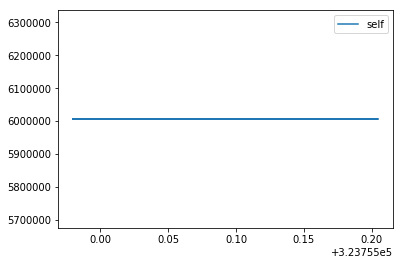

16it [00:27,  2.32s/it]

[[244 485]
 [243 486]
 [242 486]
 [241 486]
 [240 487]
 [239 488]
 [238 489]
 [237 490]
 [236 491]
 [236 492]
 [236 493]
 [236 494]
 [236 495]
 [235 496]
 [235 497]
 [236 498]
 [236 499]
 [235 500]
 [235 501]
 [235 502]
 [235 503]
 [235 504]
 [235 505]
 [235 506]
 [235 507]
 [235 508]
 [235 509]
 [235 510]
 [235 511]
 [235 512]
 [235 513]
 [235 514]
 [235 515]
 [235 516]
 [235 517]
 [235 518]
 [235 519]
 [235 520]
 [235 521]
 [235 522]
 [235 523]
 [235 524]
 [235 525]
 [235 526]
 [235 527]
 [235 528]
 [235 529]
 [235 530]
 [235 531]
 [235 532]
 [235 533]
 [235 534]
 [235 535]
 [235 536]
 [235 537]
 [235 538]
 [235 539]
 [235 540]
 [236 541]
 [237 542]
 [238 543]
 [239 544]
 [240 544]
 [241 545]
 [242 545]
 [243 545]
 [244 545]
 [245 545]
 [246 545]
 [247 545]
 [248 545]
 [249 545]
 [250 545]
 [251 545]
 [252 545]
 [253 544]
 [254 544]
 [255 544]
 [256 544]
 [257 544]
 [258 544]
 [259 544]
 [260 544]
 [261 543]
 [262 543]
 [263 543]
 [264 543]
 [265 542]
 [266 542]
 [267 541]
 [268 541]

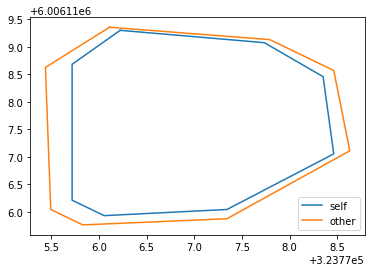

[[150  79]
 [149  80]
 [148  80]
 [147  80]
 [146  81]
 [145  82]
 [144  83]
 [143  84]
 [143  85]
 [142  86]
 [142  87]
 [141  88]
 [141  89]
 [140  90]
 [140  91]
 [140  92]
 [139  93]
 [139  94]
 [138  95]
 [138  96]
 [137  97]
 [137  98]
 [136  99]
 [136 100]
 [135 101]
 [135 102]
 [134 103]
 [133 104]
 [133 105]
 [132 106]
 [131 107]
 [131 108]
 [130 109]
 [129 110]
 [129 111]
 [128 112]
 [128 113]
 [127 114]
 [126 115]
 [126 116]
 [125 117]
 [125 118]
 [125 119]
 [125 120]
 [124 121]
 [124 122]
 [124 123]
 [123 124]
 [123 125]
 [123 126]
 [123 127]
 [123 128]
 [123 129]
 [123 130]
 [122 131]
 [122 132]
 [122 133]
 [122 134]
 [122 135]
 [122 136]
 [122 137]
 [122 138]
 [122 139]
 [122 140]
 [122 141]
 [122 142]
 [122 143]
 [122 144]
 [122 145]
 [122 146]
 [122 147]
 [122 148]
 [122 149]
 [122 150]
 [122 151]
 [122 152]
 [122 153]
 [122 154]
 [122 155]
 [122 156]
 [122 157]
 [122 158]
 [122 159]
 [122 160]
 [122 161]
 [122 162]
 [122 163]
 [122 164]
 [122 165]
 [122 166]
 [123 167]

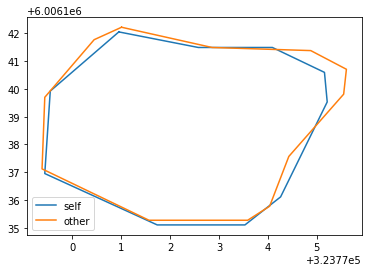

[[ 71 297]
 [ 70 298]
 [ 69 298]
 [ 68 298]
 [ 67 298]
 [ 66 298]
 [ 65 298]
 [ 64 299]
 [ 63 299]
 [ 62 299]
 [ 61 299]
 [ 60 300]
 [ 59 300]
 [ 58 300]
 [ 57 301]
 [ 56 301]
 [ 55 301]
 [ 54 302]
 [ 53 302]
 [ 52 302]
 [ 51 303]
 [ 50 303]
 [ 49 304]
 [ 48 304]
 [ 47 305]
 [ 46 305]
 [ 45 306]
 [ 44 307]
 [ 43 307]
 [ 42 308]
 [ 41 309]
 [ 40 310]
 [ 39 311]
 [ 38 312]
 [ 38 313]
 [ 37 314]
 [ 37 315]
 [ 36 316]
 [ 36 317]
 [ 35 318]
 [ 35 319]
 [ 35 320]
 [ 35 321]
 [ 35 322]
 [ 34 323]
 [ 34 324]
 [ 34 325]
 [ 34 326]
 [ 34 327]
 [ 34 328]
 [ 34 329]
 [ 34 330]
 [ 34 331]
 [ 34 332]
 [ 34 333]
 [ 34 334]
 [ 34 335]
 [ 34 336]
 [ 34 337]
 [ 34 338]
 [ 35 339]
 [ 35 340]
 [ 35 341]
 [ 35 342]
 [ 35 343]
 [ 35 344]
 [ 35 345]
 [ 36 346]
 [ 36 347]
 [ 36 348]
 [ 36 349]
 [ 37 350]
 [ 37 351]
 [ 37 352]
 [ 37 353]
 [ 38 354]
 [ 38 355]
 [ 38 356]
 [ 39 357]
 [ 39 358]
 [ 39 359]
 [ 40 360]
 [ 40 361]
 [ 40 362]
 [ 41 363]
 [ 41 364]
 [ 42 365]
 [ 42 366]
 [ 43 367]
 [ 43 368]
 [ 44 369]

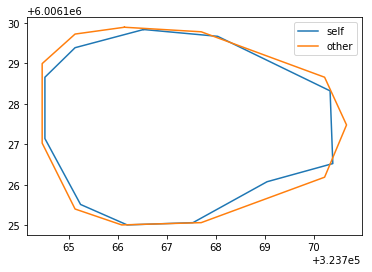

[[102 207]
 [101 208]
 [100 208]
 [ 99 208]
 [ 98 208]
 [ 97 209]
 [ 96 209]
 [ 95 210]
 [ 94 210]
 [ 93 211]
 [ 92 211]
 [ 91 212]
 [ 90 213]
 [ 89 214]
 [ 88 214]
 [ 87 215]
 [ 86 216]
 [ 85 217]
 [ 84 218]
 [ 83 219]
 [ 82 220]
 [ 81 221]
 [ 80 222]
 [ 79 223]
 [ 78 224]
 [ 78 225]
 [ 77 226]
 [ 76 227]
 [ 76 228]
 [ 76 229]
 [ 76 230]
 [ 76 231]
 [ 76 232]
 [ 76 233]
 [ 76 234]
 [ 76 235]
 [ 76 236]
 [ 76 237]
 [ 76 238]
 [ 76 239]
 [ 76 240]
 [ 76 241]
 [ 76 242]
 [ 76 243]
 [ 77 244]
 [ 77 245]
 [ 78 246]
 [ 79 247]
 [ 80 248]
 [ 81 249]
 [ 82 250]
 [ 83 251]
 [ 84 251]
 [ 85 252]
 [ 86 253]
 [ 87 254]
 [ 88 254]
 [ 89 255]
 [ 90 255]
 [ 91 256]
 [ 92 256]
 [ 93 257]
 [ 94 258]
 [ 95 258]
 [ 96 259]
 [ 97 259]
 [ 98 259]
 [ 99 260]
 [100 260]
 [101 260]
 [102 260]
 [103 260]
 [104 261]
 [105 261]
 [106 261]
 [107 261]
 [108 261]
 [109 261]
 [110 261]
 [111 261]
 [112 261]
 [113 261]
 [114 261]
 [115 261]
 [116 261]
 [117 261]
 [118 261]
 [119 261]
 [120 260]
 [121 260]
 [122 260]

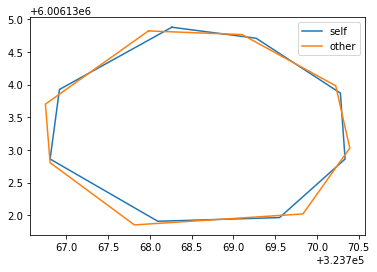

[[237 115]
 [236 116]
 [235 116]
 [234 116]
 [233 117]
 [232 117]
 [231 118]
 [231 119]
 [230 120]
 [229 121]
 [229 122]
 [228 123]
 [227 124]
 [227 125]
 [226 126]
 [226 127]
 [225 128]
 [225 129]
 [224 130]
 [224 131]
 [223 132]
 [223 133]
 [222 134]
 [222 135]
 [222 136]
 [221 137]
 [221 138]
 [221 139]
 [220 140]
 [220 141]
 [220 142]
 [220 143]
 [219 144]
 [219 145]
 [219 146]
 [218 147]
 [218 148]
 [218 149]
 [217 150]
 [217 151]
 [217 152]
 [216 153]
 [216 154]
 [216 155]
 [216 156]
 [215 157]
 [215 158]
 [215 159]
 [214 160]
 [214 161]
 [214 162]
 [214 163]
 [213 164]
 [213 165]
 [213 166]
 [213 167]
 [212 168]
 [212 169]
 [212 170]
 [211 171]
 [211 172]
 [211 173]
 [211 174]
 [211 175]
 [211 176]
 [211 177]
 [211 178]
 [211 179]
 [211 180]
 [211 181]
 [211 182]
 [211 183]
 [211 184]
 [211 185]
 [211 186]
 [212 187]
 [212 188]
 [212 189]
 [213 190]
 [213 191]
 [214 192]
 [215 193]
 [216 194]
 [217 195]
 [218 195]
 [219 196]
 [220 196]
 [221 197]
 [222 197]
 [223 197]
 [224 198]

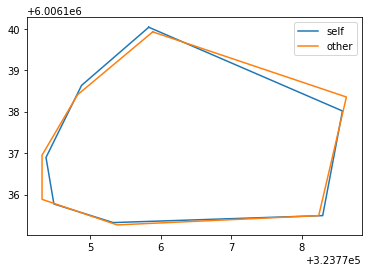

[[ 92 391]
 [ 91 392]
 [ 90 393]
 [ 89 393]
 [ 88 394]
 [ 87 395]
 [ 87 396]
 [ 86 397]
 [ 86 398]
 [ 85 399]
 [ 84 400]
 [ 84 401]
 [ 83 402]
 [ 83 403]
 [ 82 404]
 [ 82 405]
 [ 81 406]
 [ 81 407]
 [ 81 408]
 [ 81 409]
 [ 80 410]
 [ 80 411]
 [ 80 412]
 [ 80 413]
 [ 79 414]
 [ 79 415]
 [ 79 416]
 [ 79 417]
 [ 79 418]
 [ 79 419]
 [ 79 420]
 [ 79 421]
 [ 79 422]
 [ 78 423]
 [ 78 424]
 [ 78 425]
 [ 78 426]
 [ 78 427]
 [ 78 428]
 [ 78 429]
 [ 78 430]
 [ 78 431]
 [ 79 432]
 [ 79 433]
 [ 79 434]
 [ 79 435]
 [ 79 436]
 [ 79 437]
 [ 80 438]
 [ 80 439]
 [ 80 440]
 [ 80 441]
 [ 81 442]
 [ 81 443]
 [ 82 444]
 [ 82 445]
 [ 83 446]
 [ 84 446]
 [ 85 447]
 [ 86 447]
 [ 87 447]
 [ 88 447]
 [ 89 448]
 [ 90 448]
 [ 91 448]
 [ 92 447]
 [ 93 447]
 [ 94 447]
 [ 95 447]
 [ 96 447]
 [ 97 447]
 [ 98 447]
 [ 99 447]
 [100 447]
 [101 447]
 [102 447]
 [103 447]
 [104 447]
 [105 447]
 [106 447]
 [107 447]
 [108 447]
 [109 447]
 [110 448]
 [111 448]
 [112 448]
 [113 448]
 [114 448]
 [115 448]
 [116 448]
 [117 448]

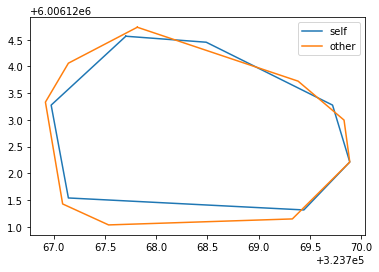

[[359 197]
 [358 198]
 [357 198]
 [356 199]
 [355 200]
 [354 201]
 [353 202]
 [352 203]
 [351 204]
 [350 204]
 [349 205]
 [348 206]
 [347 207]
 [347 208]
 [346 209]
 [346 210]
 [346 211]
 [346 212]
 [346 213]
 [346 214]
 [346 215]
 [345 216]
 [345 217]
 [345 218]
 [345 219]
 [345 220]
 [345 221]
 [345 222]
 [345 223]
 [345 224]
 [345 225]
 [345 226]
 [345 227]
 [345 228]
 [345 229]
 [345 230]
 [345 231]
 [345 232]
 [345 233]
 [345 234]
 [345 235]
 [345 236]
 [346 237]
 [346 238]
 [346 239]
 [346 240]
 [346 241]
 [346 242]
 [347 243]
 [347 244]
 [348 245]
 [349 246]
 [350 247]
 [351 248]
 [352 249]
 [353 249]
 [354 250]
 [355 251]
 [356 252]
 [357 252]
 [358 253]
 [359 254]
 [360 254]
 [361 255]
 [362 256]
 [363 257]
 [364 258]
 [365 259]
 [366 260]
 [367 260]
 [368 261]
 [369 262]
 [370 263]
 [371 264]
 [372 265]
 [373 266]
 [374 267]
 [375 267]
 [376 268]
 [377 268]
 [378 269]
 [379 270]
 [380 271]
 [381 272]
 [381 273]
 [382 274]
 [382 275]
 [383 275]
 [384 275]
 [385 276]
 [386 276]

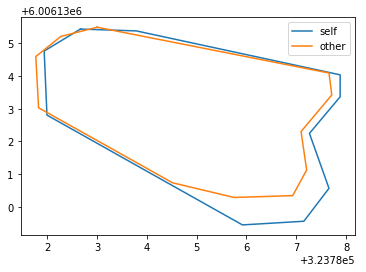

[[313  58]
 [313  59]
 [312  60]
 [311  61]
 [310  62]
 [309  63]
 [308  63]
 [307  63]
 [306  63]
 [305  64]
 [304  64]
 [303  65]
 [302  66]
 [301  66]
 [300  66]
 [299  67]
 [298  68]
 [297  68]
 [296  69]
 [295  69]
 [294  70]
 [293  70]
 [292  71]
 [291  71]
 [290  72]
 [289  72]
 [288  72]
 [287  73]
 [286  73]
 [285  73]
 [284  73]
 [283  74]
 [282  74]
 [281  74]
 [280  75]
 [279  75]
 [278  75]
 [277  76]
 [276  76]
 [275  76]
 [274  76]
 [273  76]
 [272  77]
 [271  77]
 [270  77]
 [269  77]
 [268  78]
 [267  78]
 [266  78]
 [265  78]
 [264  78]
 [263  78]
 [262  78]
 [261  78]
 [260  78]
 [259  78]
 [258  79]
 [257  79]
 [256  79]
 [255  79]
 [254  79]
 [253  79]
 [252  79]
 [251  79]
 [250  79]
 [249  79]
 [248  79]
 [247  80]
 [246  80]
 [245  80]
 [244  80]
 [243  81]
 [242  82]
 [241  83]
 [241  84]
 [240  85]
 [239  86]
 [238  87]
 [237  88]
 [237  89]
 [237  90]
 [237  91]
 [237  92]
 [237  93]
 [237  94]
 [237  95]
 [237  96]
 [237  97]
 [237  98]
 [237  99]
 [237 100]

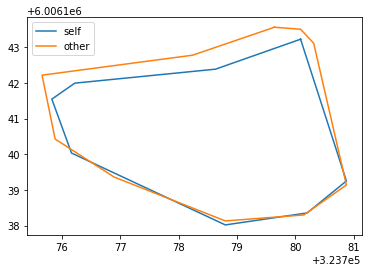

[[270 194]
 [269 195]
 [268 195]
 [267 195]
 [266 195]
 [265 195]
 [264 195]
 [263 195]
 [262 195]
 [261 195]
 [260 195]
 [259 195]
 [258 195]
 [257 195]
 [256 195]
 [255 196]
 [254 196]
 [253 196]
 [252 196]
 [251 196]
 [250 196]
 [249 196]
 [248 196]
 [247 196]
 [246 197]
 [245 197]
 [244 197]
 [243 197]
 [242 197]
 [241 197]
 [240 197]
 [239 197]
 [238 197]
 [237 197]
 [236 197]
 [235 197]
 [234 197]
 [233 197]
 [232 198]
 [231 198]
 [230 198]
 [229 198]
 [228 198]
 [227 199]
 [226 199]
 [225 199]
 [224 199]
 [223 200]
 [222 200]
 [221 201]
 [220 201]
 [219 202]
 [218 202]
 [217 203]
 [216 204]
 [215 205]
 [214 206]
 [213 207]
 [212 208]
 [211 209]
 [210 210]
 [210 211]
 [209 212]
 [209 213]
 [208 214]
 [207 215]
 [206 214]
 [205 214]
 [204 213]
 [203 213]
 [203 214]
 [202 215]
 [201 216]
 [201 217]
 [201 218]
 [201 219]
 [201 220]
 [201 221]
 [200 222]
 [200 223]
 [201 224]
 [202 225]
 [203 226]
 [204 226]
 [205 227]
 [206 228]
 [207 229]
 [207 230]
 [208 231]
 [209 232]
 [210 233]

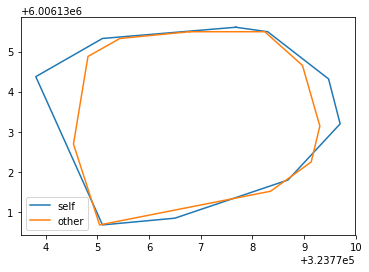

[[413  52]
 [412  53]
 [411  53]
 [410  53]
 [409  54]
 [408  54]
 [407  54]
 [406  55]
 [405  55]
 [404  55]
 [403  55]
 [402  55]
 [401  55]
 [400  55]
 [399  56]
 [398  56]
 [397  56]
 [396  56]
 [395  56]
 [394  56]
 [393  56]
 [392  56]
 [391  56]
 [390  56]
 [389  57]
 [388  57]
 [387  58]
 [386  58]
 [385  59]
 [384  59]
 [383  60]
 [382  61]
 [381  62]
 [380  62]
 [379  63]
 [378  64]
 [377  65]
 [376  66]
 [375  67]
 [374  68]
 [374  69]
 [373  70]
 [372  71]
 [371  72]
 [370  73]
 [370  74]
 [369  75]
 [369  76]
 [368  77]
 [368  78]
 [367  79]
 [367  80]
 [366  81]
 [366  82]
 [366  83]
 [365  84]
 [365  85]
 [365  86]
 [365  87]
 [365  88]
 [365  89]
 [365  90]
 [365  91]
 [365  92]
 [365  93]
 [365  94]
 [365  95]
 [365  96]
 [365  97]
 [365  98]
 [365  99]
 [365 100]
 [365 101]
 [366 102]
 [366 103]
 [366 104]
 [366 105]
 [366 106]
 [367 107]
 [367 108]
 [367 109]
 [367 110]
 [367 111]
 [368 112]
 [368 113]
 [369 114]
 [369 115]
 [370 116]
 [370 117]
 [371 118]
 [372 118]

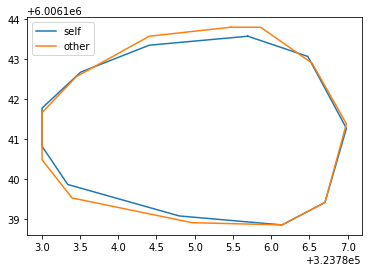

[[331 473]
 [330 474]
 [329 474]
 [328 474]
 [327 474]
 [326 474]
 [325 474]
 [324 474]
 [323 475]
 [322 475]
 [321 475]
 [320 476]
 [319 476]
 [318 477]
 [317 477]
 [316 478]
 [315 478]
 [314 479]
 [313 479]
 [312 480]
 [311 480]
 [310 481]
 [309 481]
 [308 482]
 [307 483]
 [306 483]
 [305 483]
 [304 484]
 [303 484]
 [302 485]
 [301 485]
 [300 485]
 [299 486]
 [298 487]
 [297 487]
 [296 488]
 [295 488]
 [294 489]
 [293 490]
 [292 490]
 [291 491]
 [290 492]
 [289 493]
 [289 494]
 [288 495]
 [288 496]
 [288 497]
 [287 498]
 [287 499]
 [287 500]
 [287 501]
 [287 502]
 [287 503]
 [287 504]
 [287 505]
 [287 506]
 [287 507]
 [287 508]
 [287 509]
 [287 510]
 [287 511]
 [287 512]
 [288 513]
 [288 514]
 [288 515]
 [288 516]
 [288 517]
 [288 518]
 [288 519]
 [289 520]
 [289 521]
 [289 522]
 [290 523]
 [290 524]
 [291 525]
 [292 526]
 [292 527]
 [293 527]
 [294 528]
 [295 528]
 [296 528]
 [297 529]
 [298 529]
 [299 529]
 [300 530]
 [301 530]
 [302 531]
 [303 531]
 [304 532]
 [305 532]
 [306 532]

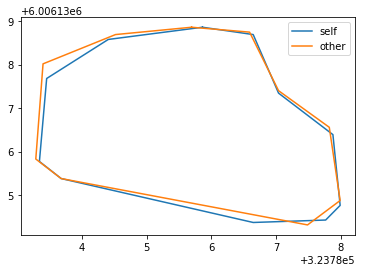

[[342 243]
 [341 244]
 [340 244]
 [339 244]
 [338 244]
 [337 245]
 [336 245]
 [336 246]
 [335 247]
 [334 248]
 [334 249]
 [333 250]
 [332 251]
 [332 252]
 [331 253]
 [331 254]
 [330 255]
 [330 256]
 [329 257]
 [329 258]
 [328 259]
 [328 260]
 [327 261]
 [327 262]
 [326 263]
 [325 264]
 [325 265]
 [324 266]
 [324 267]
 [323 268]
 [322 269]
 [321 270]
 [320 271]
 [320 272]
 [319 273]
 [318 274]
 [318 275]
 [317 276]
 [317 277]
 [316 278]
 [316 279]
 [316 280]
 [316 281]
 [315 282]
 [315 283]
 [315 284]
 [315 285]
 [315 286]
 [315 287]
 [316 288]
 [316 289]
 [316 290]
 [316 291]
 [316 292]
 [317 293]
 [317 294]
 [317 295]
 [317 296]
 [318 297]
 [318 298]
 [318 299]
 [318 300]
 [319 301]
 [319 302]
 [319 303]
 [319 304]
 [320 305]
 [320 306]
 [320 307]
 [321 308]
 [321 309]
 [321 310]
 [322 311]
 [322 312]
 [323 313]
 [323 314]
 [324 315]
 [325 316]
 [326 317]
 [327 318]
 [328 318]
 [329 319]
 [330 319]
 [331 320]
 [332 320]
 [333 320]
 [334 320]
 [335 321]
 [336 321]
 [337 321]
 [338 321]

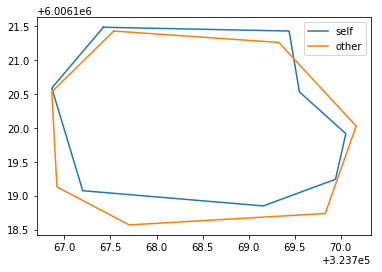

[[ 31 444]
 [ 30 445]
 [ 29 445]
 [ 28 445]
 [ 27 446]
 [ 26 446]
 [ 25 447]
 [ 25 448]
 [ 25 449]
 [ 24 450]
 [ 24 451]
 [ 24 452]
 [ 24 453]
 [ 24 454]
 [ 23 455]
 [ 23 456]
 [ 24 457]
 [ 24 458]
 [ 24 459]
 [ 24 460]
 [ 24 461]
 [ 24 462]
 [ 24 463]
 [ 24 464]
 [ 24 465]
 [ 24 466]
 [ 24 467]
 [ 24 468]
 [ 24 469]
 [ 24 470]
 [ 24 471]
 [ 23 472]
 [ 23 473]
 [ 23 474]
 [ 23 475]
 [ 23 476]
 [ 23 477]
 [ 23 478]
 [ 23 479]
 [ 23 480]
 [ 23 481]
 [ 23 482]
 [ 23 483]
 [ 24 484]
 [ 24 485]
 [ 24 486]
 [ 25 487]
 [ 26 488]
 [ 27 489]
 [ 28 490]
 [ 29 490]
 [ 30 491]
 [ 31 491]
 [ 32 492]
 [ 33 492]
 [ 34 492]
 [ 35 493]
 [ 36 493]
 [ 37 493]
 [ 38 493]
 [ 39 493]
 [ 40 494]
 [ 41 494]
 [ 42 494]
 [ 43 494]
 [ 44 494]
 [ 45 494]
 [ 46 494]
 [ 47 494]
 [ 48 494]
 [ 49 494]
 [ 50 494]
 [ 51 494]
 [ 52 494]
 [ 53 494]
 [ 54 494]
 [ 55 494]
 [ 56 494]
 [ 57 493]
 [ 58 493]
 [ 59 493]
 [ 60 493]
 [ 61 492]
 [ 62 492]
 [ 63 491]
 [ 64 491]
 [ 65 490]
 [ 66 490]
 [ 67 489]
 [ 68 488]
 [ 69 487]

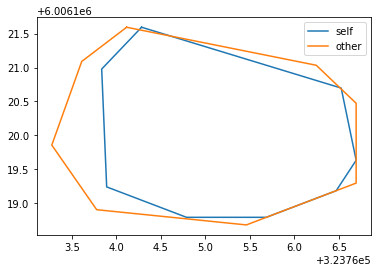

17it [00:29,  2.21s/it]

[[366 318]
 [365 319]
 [364 319]
 [363 319]
 [362 319]
 [361 319]
 [360 319]
 [359 319]
 [358 320]
 [357 320]
 [356 320]
 [355 320]
 [354 320]
 [353 320]
 [352 321]
 [351 321]
 [350 321]
 [349 321]
 [348 321]
 [347 321]
 [346 321]
 [345 321]
 [344 322]
 [343 322]
 [342 322]
 [341 322]
 [340 322]
 [339 323]
 [338 323]
 [337 323]
 [336 324]
 [335 324]
 [334 324]
 [333 325]
 [332 325]
 [331 325]
 [330 326]
 [329 326]
 [328 327]
 [327 328]
 [326 329]
 [325 330]
 [324 331]
 [323 332]
 [322 333]
 [322 334]
 [321 335]
 [321 336]
 [320 337]
 [320 338]
 [320 339]
 [320 340]
 [320 341]
 [320 342]
 [320 343]
 [319 344]
 [319 345]
 [319 346]
 [320 347]
 [320 348]
 [320 349]
 [320 350]
 [320 351]
 [320 352]
 [320 353]
 [321 354]
 [321 355]
 [321 356]
 [321 357]
 [322 358]
 [323 359]
 [324 360]
 [325 361]
 [325 362]
 [325 363]
 [326 364]
 [327 364]
 [328 365]
 [329 366]
 [330 366]
 [331 366]
 [332 367]
 [333 367]
 [334 368]
 [335 368]
 [336 369]
 [337 369]
 [338 370]
 [339 370]
 [340 371]
 [341 372]

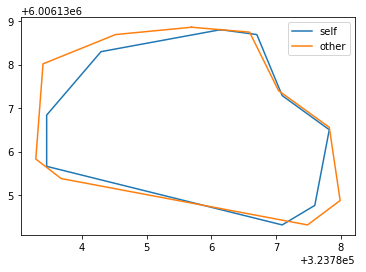

[[ 45 196]
 [ 44 197]
 [ 43 197]
 [ 42 197]
 [ 41 198]
 [ 40 199]
 [ 39 200]
 [ 38 201]
 [ 37 202]
 [ 36 203]
 [ 35 204]
 [ 35 205]
 [ 34 206]
 [ 34 207]
 [ 33 208]
 [ 32 209]
 [ 31 210]
 [ 30 211]
 [ 30 212]
 [ 30 213]
 [ 29 214]
 [ 29 215]
 [ 29 216]
 [ 29 217]
 [ 29 218]
 [ 29 219]
 [ 29 220]
 [ 29 221]
 [ 29 222]
 [ 29 223]
 [ 29 224]
 [ 29 225]
 [ 29 226]
 [ 29 227]
 [ 29 228]
 [ 29 229]
 [ 29 230]
 [ 29 231]
 [ 29 232]
 [ 29 233]
 [ 29 234]
 [ 29 235]
 [ 29 236]
 [ 29 237]
 [ 29 238]
 [ 29 239]
 [ 29 240]
 [ 29 241]
 [ 30 242]
 [ 30 243]
 [ 30 244]
 [ 31 245]
 [ 31 246]
 [ 32 247]
 [ 33 248]
 [ 34 248]
 [ 35 249]
 [ 36 250]
 [ 37 251]
 [ 38 251]
 [ 39 252]
 [ 40 253]
 [ 41 254]
 [ 42 255]
 [ 43 256]
 [ 44 257]
 [ 45 258]
 [ 46 258]
 [ 47 259]
 [ 48 259]
 [ 49 260]
 [ 50 261]
 [ 51 262]
 [ 52 263]
 [ 53 264]
 [ 54 265]
 [ 55 266]
 [ 56 267]
 [ 57 267]
 [ 58 268]
 [ 59 269]
 [ 59 270]
 [ 60 271]
 [ 61 272]
 [ 62 272]
 [ 63 273]
 [ 64 274]
 [ 65 275]
 [ 66 276]
 [ 67 277]
 [ 68 278]

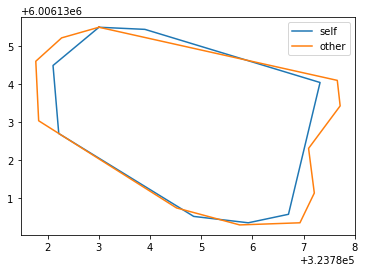

[[ 87  52]
 [ 86  53]
 [ 85  53]
 [ 84  53]
 [ 83  53]
 [ 82  53]
 [ 81  54]
 [ 80  54]
 [ 79  55]
 [ 78  55]
 [ 77  55]
 [ 76  55]
 [ 75  56]
 [ 74  56]
 [ 73  56]
 [ 72  57]
 [ 71  57]
 [ 70  58]
 [ 69  58]
 [ 68  58]
 [ 67  58]
 [ 66  58]
 [ 65  59]
 [ 64  59]
 [ 63  60]
 [ 62  60]
 [ 61  61]
 [ 60  62]
 [ 59  63]
 [ 58  64]
 [ 57  64]
 [ 56  65]
 [ 56  66]
 [ 55  67]
 [ 54  68]
 [ 53  69]
 [ 53  70]
 [ 52  71]
 [ 51  72]
 [ 51  73]
 [ 50  74]
 [ 50  75]
 [ 50  76]
 [ 49  77]
 [ 49  78]
 [ 48  79]
 [ 48  80]
 [ 48  81]
 [ 47  82]
 [ 47  83]
 [ 47  84]
 [ 47  85]
 [ 46  86]
 [ 46  87]
 [ 46  88]
 [ 46  89]
 [ 46  90]
 [ 46  91]
 [ 46  92]
 [ 46  93]
 [ 46  94]
 [ 46  95]
 [ 46  96]
 [ 46  97]
 [ 46  98]
 [ 46  99]
 [ 46 100]
 [ 46 101]
 [ 46 102]
 [ 46 103]
 [ 46 104]
 [ 46 105]
 [ 46 106]
 [ 46 107]
 [ 46 108]
 [ 46 109]
 [ 46 110]
 [ 46 111]
 [ 46 112]
 [ 46 113]
 [ 46 114]
 [ 46 115]
 [ 46 116]
 [ 47 117]
 [ 47 118]
 [ 47 119]
 [ 47 120]
 [ 47 121]
 [ 47 122]
 [ 47 123]
 [ 48 124]

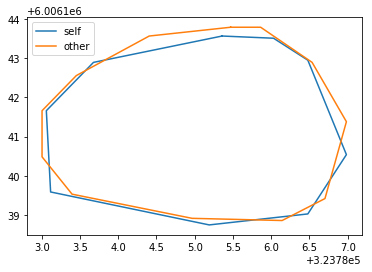

18it [00:29,  1.68s/it]

[[403 449]
 [402 450]
 [401 450]
 [400 450]
 [399 451]
 [398 452]
 [397 452]
 [396 453]
 [395 454]
 [395 455]
 [394 456]
 [394 457]
 [394 458]
 [394 459]
 [393 460]
 [393 461]
 [393 462]
 [393 463]
 [392 464]
 [392 465]
 [391 466]
 [391 467]
 [391 468]
 [390 469]
 [390 470]
 [389 471]
 [389 472]
 [388 473]
 [387 474]
 [387 475]
 [386 476]
 [385 477]
 [384 478]
 [383 479]
 [382 480]
 [381 480]
 [380 480]
 [379 481]
 [378 481]
 [377 482]
 [376 483]
 [376 484]
 [375 485]
 [374 485]
 [373 486]
 [372 486]
 [371 487]
 [370 487]
 [369 488]
 [368 489]
 [367 490]
 [366 491]
 [365 492]
 [364 492]
 [363 493]
 [362 494]
 [361 494]
 [360 495]
 [359 496]
 [358 497]
 [357 498]
 [356 499]
 [355 500]
 [354 501]
 [354 502]
 [353 503]
 [352 504]
 [351 505]
 [351 506]
 [350 507]
 [349 508]
 [349 509]
 [348 510]
 [348 511]
 [347 512]
 [347 513]
 [346 514]
 [346 515]
 [346 516]
 [345 517]
 [345 518]
 [344 519]
 [344 520]
 [344 521]
 [343 522]
 [343 523]
 [342 524]
 [342 525]
 [342 526]
 [341 527]
 [341 528]

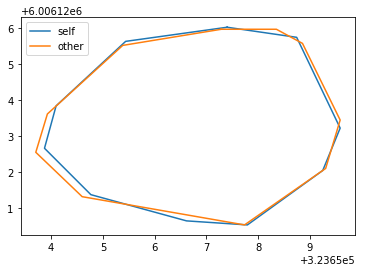

[[518 122]
 [517 123]
 [516 123]
 [515 123]
 [514 124]
 [513 125]
 [512 126]
 [511 126]
 [510 127]
 [509 128]
 [509 129]
 [508 130]
 [507 131]
 [507 132]
 [506 133]
 [506 134]
 [505 135]
 [504 136]
 [503 137]
 [502 138]
 [501 139]
 [500 140]
 [499 141]
 [498 142]
 [497 143]
 [496 144]
 [495 145]
 [495 146]
 [494 147]
 [493 148]
 [493 149]
 [492 150]
 [492 151]
 [492 152]
 [491 153]
 [491 154]
 [491 155]
 [491 156]
 [491 157]
 [491 158]
 [491 159]
 [491 160]
 [490 161]
 [490 162]
 [490 163]
 [490 164]
 [490 165]
 [490 166]
 [490 167]
 [490 168]
 [489 169]
 [489 170]
 [489 171]
 [489 172]
 [489 173]
 [489 174]
 [489 175]
 [489 176]
 [489 177]
 [489 178]
 [489 179]
 [489 180]
 [489 181]
 [489 182]
 [489 183]
 [489 184]
 [489 185]
 [489 186]
 [489 187]
 [489 188]
 [489 189]
 [489 190]
 [489 191]
 [489 192]
 [489 193]
 [489 194]
 [489 195]
 [489 196]
 [489 197]
 [489 198]
 [489 199]
 [489 200]
 [489 201]
 [489 202]
 [489 203]
 [488 204]
 [488 205]
 [488 206]
 [488 207]
 [488 208]
 [488 209]

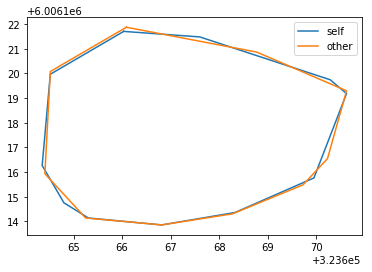

[[ 92 449]
 [ 91 450]
 [ 90 450]
 [ 89 450]
 [ 88 450]
 [ 87 451]
 [ 86 451]
 [ 85 451]
 [ 84 451]
 [ 83 452]
 [ 82 452]
 [ 81 453]
 [ 80 454]
 [ 79 455]
 [ 78 456]
 [ 77 457]
 [ 76 458]
 [ 75 459]
 [ 74 460]
 [ 74 461]
 [ 73 462]
 [ 73 463]
 [ 72 464]
 [ 72 465]
 [ 72 466]
 [ 72 467]
 [ 71 468]
 [ 71 469]
 [ 70 470]
 [ 70 471]
 [ 69 472]
 [ 68 473]
 [ 68 474]
 [ 68 475]
 [ 67 476]
 [ 67 477]
 [ 66 478]
 [ 65 479]
 [ 65 480]
 [ 64 481]
 [ 64 482]
 [ 63 483]
 [ 62 484]
 [ 61 484]
 [ 60 485]
 [ 59 486]
 [ 58 486]
 [ 57 487]
 [ 56 488]
 [ 55 488]
 [ 54 489]
 [ 53 489]
 [ 52 490]
 [ 51 490]
 [ 50 491]
 [ 49 491]
 [ 48 492]
 [ 47 492]
 [ 46 493]
 [ 45 494]
 [ 44 495]
 [ 43 496]
 [ 42 497]
 [ 41 498]
 [ 40 499]
 [ 40 500]
 [ 40 501]
 [ 39 502]
 [ 39 503]
 [ 39 504]
 [ 39 505]
 [ 39 506]
 [ 39 507]
 [ 39 508]
 [ 39 509]
 [ 39 510]
 [ 39 511]
 [ 39 512]
 [ 39 513]
 [ 39 514]
 [ 39 515]
 [ 39 516]
 [ 39 517]
 [ 40 518]
 [ 40 519]
 [ 41 520]
 [ 41 521]
 [ 42 522]
 [ 42 523]
 [ 43 524]
 [ 44 525]

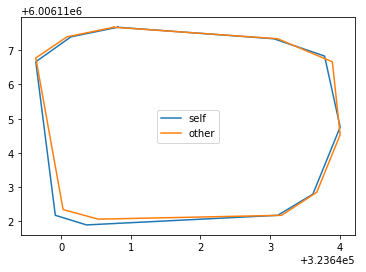

[[459 227]
 [458 228]
 [457 228]
 [456 229]
 [455 229]
 [454 229]
 [453 229]
 [452 230]
 [451 231]
 [450 232]
 [449 232]
 [448 233]
 [447 234]
 [446 234]
 [445 235]
 [444 236]
 [443 237]
 [442 238]
 [441 239]
 [440 240]
 [439 240]
 [438 241]
 [437 242]
 [436 242]
 [435 243]
 [434 244]
 [433 244]
 [432 245]
 [431 246]
 [430 246]
 [429 247]
 [428 247]
 [427 248]
 [426 248]
 [425 249]
 [424 249]
 [423 250]
 [422 250]
 [421 251]
 [420 252]
 [419 252]
 [418 253]
 [417 253]
 [416 254]
 [415 254]
 [414 255]
 [413 255]
 [412 256]
 [411 257]
 [410 257]
 [409 258]
 [408 258]
 [407 259]
 [406 259]
 [405 260]
 [405 261]
 [404 262]
 [403 263]
 [403 264]
 [402 265]
 [402 266]
 [401 267]
 [401 268]
 [401 269]
 [401 270]
 [401 271]
 [401 272]
 [401 273]
 [401 274]
 [401 275]
 [401 276]
 [401 277]
 [401 278]
 [402 279]
 [402 280]
 [403 281]
 [404 282]
 [405 283]
 [406 284]
 [407 284]
 [408 285]
 [409 285]
 [410 286]
 [411 287]
 [412 287]
 [413 288]
 [414 289]
 [415 289]
 [416 290]
 [417 291]
 [418 291]

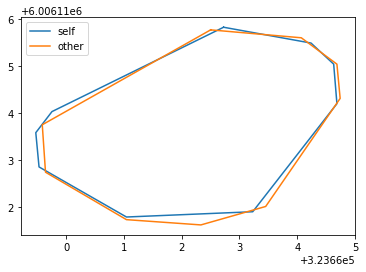

[[295 375]
 [294 376]
 [293 376]
 [292 376]
 [291 376]
 [290 376]
 [289 376]
 [288 377]
 [287 377]
 [286 377]
 [285 377]
 [284 377]
 [283 377]
 [282 378]
 [281 378]
 [280 378]
 [279 379]
 [278 379]
 [277 379]
 [276 380]
 [275 380]
 [274 381]
 [273 381]
 [272 382]
 [271 383]
 [270 384]
 [269 384]
 [268 385]
 [268 386]
 [267 387]
 [266 388]
 [266 389]
 [265 390]
 [264 391]
 [264 392]
 [263 393]
 [263 394]
 [262 395]
 [262 396]
 [262 397]
 [261 398]
 [261 399]
 [261 400]
 [261 401]
 [261 402]
 [261 403]
 [261 404]
 [261 405]
 [261 406]
 [260 407]
 [260 408]
 [260 409]
 [260 410]
 [260 411]
 [260 412]
 [260 413]
 [260 414]
 [260 415]
 [260 416]
 [260 417]
 [260 418]
 [260 419]
 [260 420]
 [260 421]
 [260 422]
 [260 423]
 [260 424]
 [260 425]
 [260 426]
 [260 427]
 [260 428]
 [260 429]
 [260 430]
 [260 431]
 [260 432]
 [260 433]
 [260 434]
 [260 435]
 [260 436]
 [260 437]
 [260 438]
 [260 439]
 [261 440]
 [261 441]
 [261 442]
 [261 443]
 [261 444]
 [262 445]
 [262 446]
 [263 446]
 [264 447]

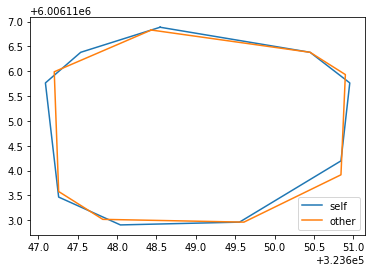

[[476 140]
 [475 141]
 [474 141]
 [473 141]
 [472 141]
 [471 141]
 [470 141]
 [469 141]
 [468 141]
 [467 141]
 [466 141]
 [465 142]
 [464 142]
 [463 142]
 [462 142]
 [461 142]
 [460 142]
 [459 143]
 [458 143]
 [457 143]
 [456 143]
 [455 143]
 [454 143]
 [453 143]
 [452 144]
 [451 144]
 [450 144]
 [449 144]
 [448 145]
 [447 145]
 [446 145]
 [445 145]
 [444 146]
 [443 147]
 [442 147]
 [441 148]
 [440 148]
 [439 149]
 [438 149]
 [437 150]
 [436 151]
 [435 151]
 [434 152]
 [433 153]
 [432 154]
 [431 155]
 [431 156]
 [430 157]
 [429 158]
 [429 159]
 [429 160]
 [428 161]
 [428 162]
 [428 163]
 [427 164]
 [427 165]
 [427 166]
 [427 167]
 [427 168]
 [427 169]
 [427 170]
 [427 171]
 [427 172]
 [427 173]
 [427 174]
 [427 175]
 [427 176]
 [428 177]
 [428 178]
 [428 179]
 [428 180]
 [429 181]
 [429 182]
 [430 183]
 [430 184]
 [431 185]
 [432 186]
 [432 187]
 [433 188]
 [434 189]
 [434 190]
 [435 191]
 [435 192]
 [436 193]
 [436 194]
 [437 195]
 [438 196]
 [439 197]
 [439 198]
 [440 199]
 [440 200]

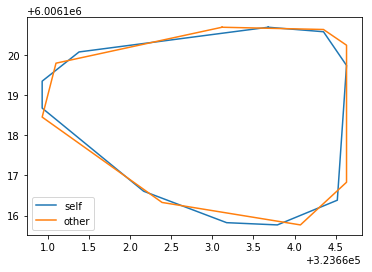

[[322 152]
 [321 153]
 [320 153]
 [319 153]
 [318 153]
 [317 154]
 [316 155]
 [315 155]
 [314 155]
 [313 156]
 [312 156]
 [311 157]
 [310 158]
 [309 158]
 [308 159]
 [307 159]
 [306 159]
 [305 160]
 [304 160]
 [303 161]
 [302 161]
 [301 161]
 [300 162]
 [299 162]
 [298 163]
 [297 163]
 [296 164]
 [295 164]
 [294 164]
 [293 165]
 [292 165]
 [291 166]
 [290 166]
 [289 167]
 [288 168]
 [287 168]
 [286 169]
 [285 169]
 [284 170]
 [283 170]
 [282 171]
 [281 171]
 [280 172]
 [279 172]
 [278 173]
 [277 174]
 [277 175]
 [276 176]
 [275 177]
 [274 178]
 [273 179]
 [272 180]
 [271 181]
 [270 181]
 [269 182]
 [268 183]
 [268 184]
 [267 185]
 [266 186]
 [266 187]
 [265 188]
 [265 189]
 [265 190]
 [264 191]
 [264 192]
 [263 193]
 [263 194]
 [263 195]
 [262 196]
 [262 197]
 [261 198]
 [261 199]
 [260 200]
 [260 201]
 [259 202]
 [259 203]
 [259 204]
 [259 205]
 [259 206]
 [258 207]
 [258 208]
 [258 209]
 [258 210]
 [258 211]
 [258 212]
 [258 213]
 [258 214]
 [258 215]
 [258 216]
 [258 217]
 [258 218]

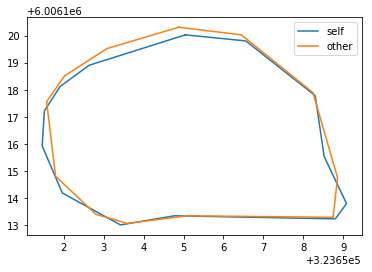

[[514 429]
 [513 430]
 [512 430]
 [511 430]
 [510 430]
 [509 430]
 [508 430]
 [507 431]
 [506 431]
 [505 431]
 [504 431]
 [503 431]
 [502 431]
 [501 432]
 [500 432]
 [499 432]
 [498 432]
 [497 433]
 [496 433]
 [495 433]
 [494 434]
 [493 434]
 [492 434]
 [491 435]
 [490 435]
 [489 436]
 [488 437]
 [487 437]
 [486 438]
 [485 439]
 [484 439]
 [483 440]
 [482 440]
 [481 441]
 [480 442]
 [479 442]
 [478 443]
 [477 444]
 [477 445]
 [476 446]
 [475 447]
 [474 447]
 [473 448]
 [472 449]
 [471 450]
 [470 451]
 [469 452]
 [468 453]
 [468 454]
 [467 455]
 [466 456]
 [466 457]
 [465 458]
 [465 459]
 [464 460]
 [463 461]
 [463 462]
 [462 463]
 [461 464]
 [460 465]
 [460 466]
 [459 467]
 [458 468]
 [458 469]
 [457 470]
 [456 471]
 [455 472]
 [454 473]
 [454 474]
 [453 475]
 [453 476]
 [452 477]
 [452 478]
 [451 479]
 [451 480]
 [451 481]
 [450 482]
 [450 483]
 [450 484]
 [450 485]
 [449 486]
 [449 487]
 [449 488]
 [449 489]
 [449 490]
 [449 491]
 [449 492]
 [449 493]
 [449 494]
 [449 495]
 [449 496]

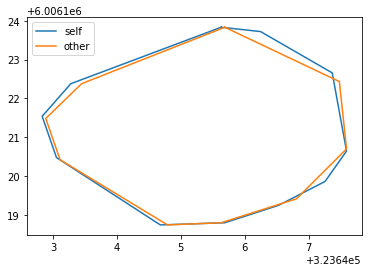

[[176 295]
 [175 296]
 [174 296]
 [173 296]
 [172 296]
 [171 296]
 [170 296]
 [169 296]
 [168 296]
 [167 296]
 [166 297]
 [165 297]
 [164 297]
 [163 297]
 [162 297]
 [161 298]
 [160 298]
 [159 298]
 [158 298]
 [157 299]
 [156 299]
 [155 300]
 [154 300]
 [153 300]
 [152 300]
 [151 301]
 [150 301]
 [149 301]
 [148 302]
 [147 302]
 [146 302]
 [145 302]
 [144 303]
 [143 303]
 [142 303]
 [141 304]
 [140 304]
 [139 305]
 [138 305]
 [137 306]
 [136 306]
 [135 306]
 [134 307]
 [133 308]
 [133 309]
 [132 310]
 [131 311]
 [130 312]
 [130 313]
 [129 314]
 [129 315]
 [129 316]
 [129 317]
 [129 318]
 [129 319]
 [129 320]
 [129 321]
 [129 322]
 [129 323]
 [129 324]
 [129 325]
 [130 326]
 [130 327]
 [130 328]
 [130 329]
 [131 330]
 [131 331]
 [131 332]
 [131 333]
 [132 334]
 [132 335]
 [133 336]
 [133 337]
 [134 338]
 [134 339]
 [134 340]
 [135 341]
 [135 342]
 [136 343]
 [136 344]
 [137 345]
 [137 346]
 [138 347]
 [138 348]
 [139 349]
 [140 350]
 [140 351]
 [141 352]
 [142 353]
 [143 354]
 [144 355]

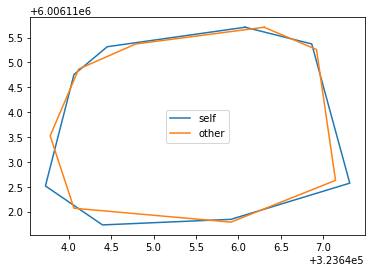

[[423 177]
 [422 178]
 [421 178]
 [420 178]
 [419 179]
 [418 179]
 [417 179]
 [416 180]
 [415 180]
 [414 180]
 [413 181]
 [412 181]
 [411 181]
 [410 182]
 [409 182]
 [408 182]
 [407 183]
 [406 183]
 [405 183]
 [404 183]
 [403 184]
 [402 184]
 [401 184]
 [400 184]
 [399 184]
 [398 185]
 [397 185]
 [396 185]
 [395 185]
 [394 186]
 [393 186]
 [392 187]
 [391 187]
 [390 188]
 [389 188]
 [388 189]
 [387 189]
 [386 190]
 [385 191]
 [384 192]
 [383 193]
 [382 194]
 [382 195]
 [382 196]
 [382 197]
 [382 198]
 [382 199]
 [382 200]
 [382 201]
 [382 202]
 [382 203]
 [382 204]
 [382 205]
 [382 206]
 [383 207]
 [383 208]
 [383 209]
 [383 210]
 [383 211]
 [383 212]
 [383 213]
 [383 214]
 [383 215]
 [383 216]
 [383 217]
 [384 218]
 [384 219]
 [384 220]
 [384 221]
 [384 222]
 [384 223]
 [384 224]
 [385 225]
 [385 226]
 [385 227]
 [385 228]
 [385 229]
 [385 230]
 [385 231]
 [386 232]
 [386 233]
 [386 234]
 [386 235]
 [386 236]
 [386 237]
 [387 238]
 [387 239]
 [387 240]
 [387 241]
 [387 242]
 [388 243]

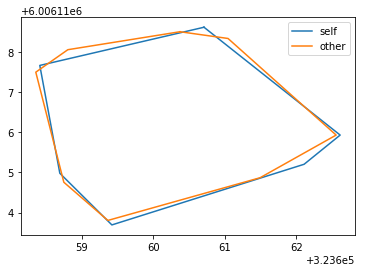

[[593 252]
 [592 253]
 [591 253]
 [590 253]
 [589 254]
 [588 254]
 [587 254]
 [586 254]
 [585 255]
 [584 255]
 [583 255]
 [582 256]
 [581 256]
 [580 256]
 [579 256]
 [578 256]
 [577 256]
 [576 256]
 [575 256]
 [574 256]
 [573 256]
 [572 256]
 [571 256]
 [570 255]
 [569 255]
 [568 255]
 [567 255]
 [566 255]
 [565 255]
 [564 255]
 [563 255]
 [562 255]
 [561 256]
 [560 256]
 [559 256]
 [558 256]
 [557 256]
 [556 257]
 [555 257]
 [554 257]
 [553 258]
 [552 258]
 [551 258]
 [550 259]
 [549 259]
 [548 259]
 [547 260]
 [546 260]
 [545 261]
 [544 261]
 [543 262]
 [542 262]
 [541 263]
 [540 264]
 [539 264]
 [538 265]
 [537 265]
 [536 266]
 [535 267]
 [535 268]
 [534 269]
 [534 270]
 [534 271]
 [533 272]
 [533 273]
 [533 274]
 [532 275]
 [532 276]
 [532 277]
 [532 278]
 [532 279]
 [532 280]
 [532 281]
 [531 282]
 [531 283]
 [531 284]
 [531 285]
 [531 286]
 [531 287]
 [531 288]
 [530 289]
 [530 290]
 [530 291]
 [530 292]
 [530 293]
 [530 294]
 [529 295]
 [529 296]
 [529 297]
 [529 298]
 [529 299]

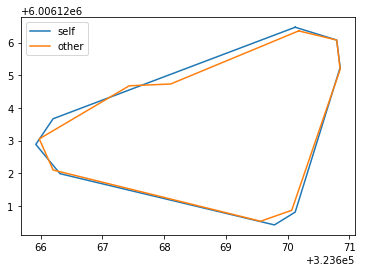

19it [00:31,  1.68s/it]

[[363 324]
 [362 325]
 [361 325]
 [360 325]
 [359 326]
 [358 326]
 [357 326]
 [356 327]
 [355 327]
 [354 328]
 [353 329]
 [352 330]
 [351 331]
 [350 331]
 [349 332]
 [348 333]
 [347 334]
 [346 335]
 [345 336]
 [344 336]
 [343 337]
 [342 338]
 [341 339]
 [340 340]
 [339 341]
 [338 341]
 [337 342]
 [336 343]
 [336 344]
 [335 345]
 [334 346]
 [333 347]
 [333 348]
 [333 349]
 [332 350]
 [332 351]
 [331 352]
 [331 353]
 [331 354]
 [331 355]
 [331 356]
 [331 357]
 [331 358]
 [331 359]
 [331 360]
 [331 361]
 [331 362]
 [331 363]
 [331 364]
 [331 365]
 [331 366]
 [331 367]
 [331 368]
 [331 369]
 [331 370]
 [331 371]
 [331 372]
 [331 373]
 [331 374]
 [331 375]
 [332 376]
 [332 377]
 [333 378]
 [334 379]
 [334 380]
 [335 380]
 [336 381]
 [337 381]
 [338 382]
 [339 382]
 [340 382]
 [341 383]
 [342 383]
 [343 384]
 [344 384]
 [345 384]
 [346 384]
 [347 384]
 [348 385]
 [349 385]
 [350 385]
 [351 385]
 [352 386]
 [353 386]
 [354 386]
 [355 386]
 [356 386]
 [357 386]
 [358 386]
 [359 387]
 [360 387]

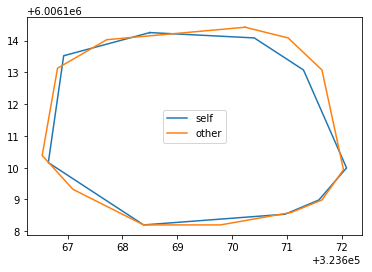

[[441 279]
 [440 280]
 [439 280]
 [438 280]
 [437 280]
 [436 280]
 [435 281]
 [434 281]
 [433 282]
 [432 283]
 [431 284]
 [430 285]
 [429 286]
 [428 287]
 [427 288]
 [427 289]
 [426 290]
 [425 291]
 [425 292]
 [424 293]
 [424 294]
 [423 295]
 [423 296]
 [423 297]
 [422 298]
 [422 299]
 [421 300]
 [421 301]
 [421 302]
 [420 303]
 [420 304]
 [420 305]
 [419 306]
 [419 307]
 [419 308]
 [418 309]
 [418 310]
 [418 311]
 [417 312]
 [417 313]
 [416 314]
 [416 315]
 [416 316]
 [415 317]
 [415 318]
 [414 319]
 [414 320]
 [414 321]
 [413 322]
 [413 323]
 [413 324]
 [412 325]
 [412 326]
 [411 327]
 [411 328]
 [411 329]
 [411 330]
 [410 331]
 [410 332]
 [410 333]
 [410 334]
 [410 335]
 [409 336]
 [409 337]
 [409 338]
 [409 339]
 [409 340]
 [409 341]
 [409 342]
 [408 343]
 [408 344]
 [408 345]
 [408 346]
 [408 347]
 [408 348]
 [408 349]
 [408 350]
 [408 351]
 [409 352]
 [409 353]
 [409 354]
 [409 355]
 [409 356]
 [409 357]
 [409 358]
 [410 359]
 [410 360]
 [410 361]
 [410 362]
 [410 363]
 [411 364]

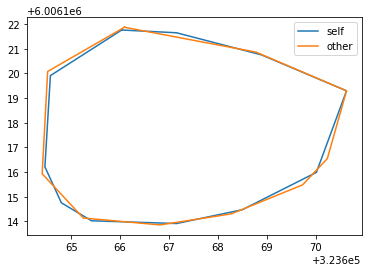

[[ 81 449]
 [ 80 450]
 [ 79 450]
 [ 78 450]
 [ 78 451]
 [ 77 452]
 [ 76 453]
 [ 76 454]
 [ 75 455]
 [ 74 456]
 [ 74 457]
 [ 74 458]
 [ 73 459]
 [ 73 460]
 [ 73 461]
 [ 72 462]
 [ 72 463]
 [ 72 464]
 [ 71 465]
 [ 71 466]
 [ 71 467]
 [ 71 468]
 [ 71 469]
 [ 70 470]
 [ 70 471]
 [ 70 472]
 [ 69 473]
 [ 68 474]
 [ 67 475]
 [ 66 476]
 [ 66 477]
 [ 65 478]
 [ 64 478]
 [ 63 478]
 [ 62 479]
 [ 61 479]
 [ 60 479]
 [ 59 480]
 [ 58 481]
 [ 57 482]
 [ 56 483]
 [ 55 483]
 [ 54 484]
 [ 53 484]
 [ 52 484]
 [ 51 485]
 [ 50 486]
 [ 49 486]
 [ 48 487]
 [ 47 488]
 [ 46 489]
 [ 45 490]
 [ 44 490]
 [ 43 491]
 [ 42 492]
 [ 41 493]
 [ 40 494]
 [ 39 495]
 [ 38 496]
 [ 37 497]
 [ 36 498]
 [ 35 499]
 [ 34 500]
 [ 33 501]
 [ 32 502]
 [ 32 503]
 [ 31 504]
 [ 30 505]
 [ 29 506]
 [ 29 507]
 [ 28 508]
 [ 28 509]
 [ 27 510]
 [ 27 511]
 [ 26 512]
 [ 26 513]
 [ 25 514]
 [ 25 515]
 [ 24 516]
 [ 24 517]
 [ 23 518]
 [ 23 519]
 [ 22 520]
 [ 22 521]
 [ 22 522]
 [ 21 523]
 [ 21 524]
 [ 20 525]
 [ 20 526]
 [ 20 527]
 [ 20 528]

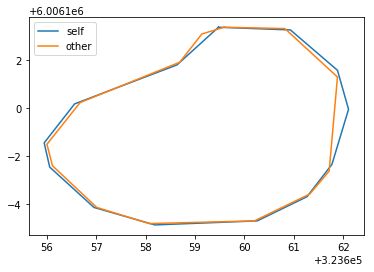

[[139 228]
 [138 229]
 [137 229]
 [136 229]
 [135 230]
 [134 230]
 [133 230]
 [132 231]
 [131 232]
 [130 232]
 [129 233]
 [128 233]
 [127 234]
 [126 235]
 [125 236]
 [124 236]
 [123 237]
 [122 238]
 [121 239]
 [120 240]
 [119 240]
 [118 241]
 [117 241]
 [116 242]
 [115 242]
 [114 243]
 [113 244]
 [112 245]
 [111 245]
 [110 246]
 [109 246]
 [108 247]
 [107 247]
 [106 248]
 [105 248]
 [104 249]
 [103 250]
 [102 250]
 [101 250]
 [100 251]
 [ 99 251]
 [ 98 252]
 [ 97 252]
 [ 96 253]
 [ 95 253]
 [ 94 254]
 [ 93 254]
 [ 92 255]
 [ 91 255]
 [ 90 256]
 [ 89 257]
 [ 88 257]
 [ 87 258]
 [ 86 258]
 [ 85 259]
 [ 85 260]
 [ 85 261]
 [ 85 262]
 [ 85 263]
 [ 85 264]
 [ 85 265]
 [ 85 266]
 [ 84 267]
 [ 84 268]
 [ 84 269]
 [ 85 270]
 [ 85 271]
 [ 84 272]
 [ 84 273]
 [ 85 274]
 [ 85 275]
 [ 85 276]
 [ 85 277]
 [ 85 278]
 [ 85 279]
 [ 85 280]
 [ 85 281]
 [ 86 282]
 [ 87 283]
 [ 88 284]
 [ 89 285]
 [ 90 286]
 [ 91 287]
 [ 92 287]
 [ 93 288]
 [ 94 288]
 [ 95 289]
 [ 96 290]
 [ 97 291]
 [ 98 292]
 [ 99 292]

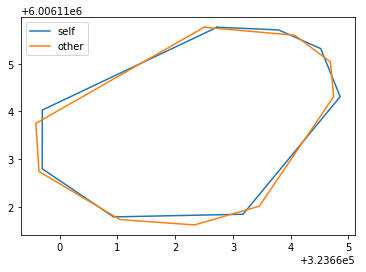

[[151 140]
 [150 141]
 [149 141]
 [148 141]
 [147 141]
 [146 141]
 [145 141]
 [144 141]
 [143 142]
 [142 142]
 [141 142]
 [140 142]
 [139 142]
 [138 143]
 [137 143]
 [136 143]
 [135 143]
 [134 143]
 [133 143]
 [132 143]
 [131 144]
 [130 144]
 [129 144]
 [128 144]
 [127 145]
 [126 145]
 [125 146]
 [124 146]
 [123 147]
 [122 147]
 [121 147]
 [120 148]
 [119 148]
 [118 149]
 [117 149]
 [116 150]
 [115 151]
 [114 152]
 [113 153]
 [112 154]
 [111 155]
 [110 156]
 [109 157]
 [109 158]
 [109 159]
 [108 160]
 [108 161]
 [108 162]
 [108 163]
 [107 164]
 [107 165]
 [107 166]
 [107 167]
 [107 168]
 [107 169]
 [107 170]
 [107 171]
 [107 172]
 [107 173]
 [107 174]
 [107 175]
 [107 176]
 [107 177]
 [107 178]
 [107 179]
 [108 180]
 [108 181]
 [108 182]
 [109 183]
 [109 184]
 [110 185]
 [111 186]
 [111 187]
 [112 188]
 [112 189]
 [112 190]
 [113 191]
 [114 192]
 [114 193]
 [115 194]
 [116 195]
 [116 196]
 [117 197]
 [118 198]
 [118 199]
 [119 200]
 [119 201]
 [120 202]
 [121 203]
 [121 204]
 [122 205]

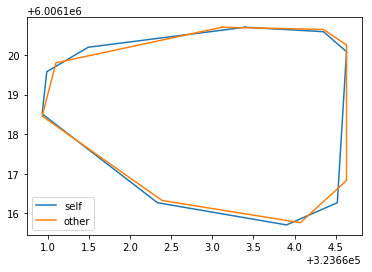

[[266 465]
 [265 466]
 [264 466]
 [263 467]
 [262 467]
 [261 468]
 [260 469]
 [259 470]
 [259 471]
 [258 472]
 [257 473]
 [257 474]
 [257 475]
 [256 476]
 [256 477]
 [256 478]
 [256 479]
 [255 480]
 [255 481]
 [255 482]
 [255 483]
 [254 484]
 [254 485]
 [254 486]
 [254 487]
 [254 488]
 [254 489]
 [254 490]
 [253 491]
 [253 492]
 [253 493]
 [253 494]
 [253 495]
 [253 496]
 [253 497]
 [253 498]
 [253 499]
 [253 500]
 [253 501]
 [253 502]
 [252 503]
 [252 504]
 [252 505]
 [252 506]
 [252 507]
 [253 508]
 [253 509]
 [253 510]
 [253 511]
 [253 512]
 [253 513]
 [254 514]
 [254 515]
 [255 516]
 [255 517]
 [256 518]
 [256 519]
 [257 520]
 [258 520]
 [259 521]
 [260 522]
 [261 522]
 [262 523]
 [262 524]
 [263 525]
 [264 526]
 [265 527]
 [266 527]
 [267 528]
 [268 528]
 [269 529]
 [270 530]
 [271 531]
 [272 531]
 [273 532]
 [274 533]
 [275 533]
 [276 534]
 [277 534]
 [278 535]
 [279 536]
 [280 536]
 [281 537]
 [282 537]
 [283 538]
 [284 538]
 [285 539]
 [286 539]
 [287 540]
 [288 540]
 [289 541]

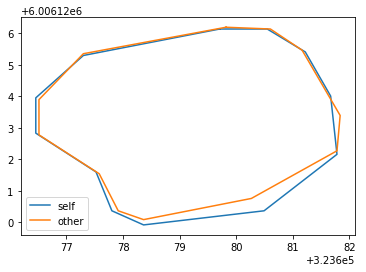

[[504 138]
 [503 139]
 [502 139]
 [501 139]
 [500 140]
 [499 140]
 [498 140]
 [497 140]
 [496 140]
 [495 141]
 [494 141]
 [493 142]
 [492 142]
 [491 143]
 [490 143]
 [489 144]
 [488 144]
 [487 145]
 [486 145]
 [485 146]
 [484 146]
 [483 147]
 [482 148]
 [481 149]
 [480 150]
 [479 151]
 [478 151]
 [477 151]
 [476 152]
 [475 152]
 [474 153]
 [473 154]
 [472 155]
 [471 156]
 [470 156]
 [469 156]
 [468 156]
 [467 157]
 [466 157]
 [465 158]
 [464 158]
 [463 159]
 [462 159]
 [461 160]
 [460 160]
 [459 160]
 [458 161]
 [457 162]
 [456 162]
 [456 163]
 [455 164]
 [454 165]
 [454 166]
 [453 167]
 [453 168]
 [452 169]
 [452 170]
 [451 171]
 [451 172]
 [451 173]
 [450 174]
 [450 175]
 [450 176]
 [450 177]
 [450 178]
 [450 179]
 [449 180]
 [449 181]
 [449 182]
 [449 183]
 [449 184]
 [450 185]
 [450 186]
 [450 187]
 [450 188]
 [450 189]
 [450 190]
 [450 191]
 [450 192]
 [450 193]
 [451 194]
 [451 195]
 [451 196]
 [451 197]
 [452 198]
 [452 199]
 [452 200]
 [453 201]
 [453 202]
 [454 203]
 [455 204]

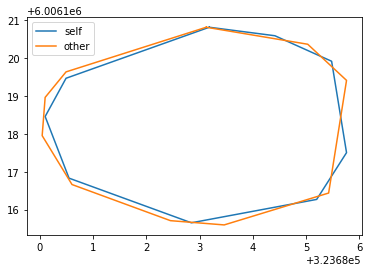

[[366 255]
 [365 256]
 [364 256]
 [363 256]
 [362 256]
 [361 256]
 [360 256]
 [359 256]
 [358 256]
 [357 257]
 [356 257]
 [355 257]
 [354 257]
 [353 257]
 [352 257]
 [351 258]
 [350 258]
 [349 258]
 [348 258]
 [347 258]
 [346 258]
 [345 258]
 [344 258]
 [343 259]
 [342 259]
 [341 259]
 [340 260]
 [339 260]
 [338 261]
 [337 261]
 [336 262]
 [335 263]
 [335 264]
 [334 265]
 [334 266]
 [334 267]
 [334 268]
 [334 269]
 [334 270]
 [334 271]
 [334 272]
 [334 273]
 [334 274]
 [335 275]
 [335 276]
 [335 277]
 [335 278]
 [335 279]
 [335 280]
 [336 281]
 [336 282]
 [336 283]
 [337 284]
 [337 285]
 [337 286]
 [337 287]
 [337 288]
 [337 289]
 [336 290]
 [336 291]
 [336 292]
 [336 293]
 [336 294]
 [336 295]
 [335 296]
 [335 297]
 [335 298]
 [335 299]
 [335 300]
 [335 301]
 [335 302]
 [335 303]
 [335 304]
 [335 305]
 [336 306]
 [336 307]
 [336 308]
 [336 309]
 [336 310]
 [336 311]
 [337 312]
 [337 313]
 [338 314]
 [339 314]
 [340 315]
 [341 315]
 [342 316]
 [343 316]
 [344 316]
 [345 317]
 [346 317]

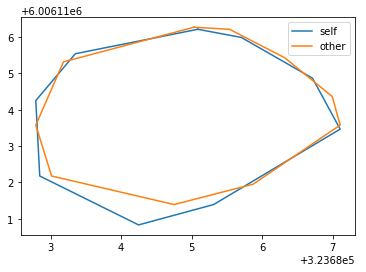

[[417 424]
 [416 425]
 [415 425]
 [414 425]
 [413 426]
 [412 426]
 [411 427]
 [410 428]
 [409 429]
 [408 430]
 [407 430]
 [406 431]
 [405 432]
 [404 433]
 [403 434]
 [402 434]
 [401 435]
 [400 436]
 [399 437]
 [398 438]
 [397 439]
 [396 440]
 [395 440]
 [394 441]
 [393 442]
 [393 443]
 [392 444]
 [391 445]
 [390 446]
 [389 447]
 [389 448]
 [388 449]
 [388 450]
 [387 451]
 [386 452]
 [386 453]
 [385 454]
 [385 455]
 [384 456]
 [384 457]
 [384 458]
 [384 459]
 [383 460]
 [383 461]
 [383 462]
 [383 463]
 [383 464]
 [383 465]
 [383 466]
 [383 467]
 [383 468]
 [383 469]
 [383 470]
 [383 471]
 [383 472]
 [383 473]
 [383 474]
 [383 475]
 [382 476]
 [382 477]
 [382 478]
 [382 479]
 [382 480]
 [382 481]
 [382 482]
 [382 483]
 [381 484]
 [381 485]
 [381 486]
 [381 487]
 [380 488]
 [380 489]
 [379 490]
 [379 491]
 [378 492]
 [378 493]
 [378 494]
 [377 495]
 [377 496]
 [377 497]
 [376 498]
 [376 499]
 [375 500]
 [375 501]
 [375 502]
 [375 503]
 [375 504]
 [374 505]
 [374 506]
 [374 507]
 [374 508]

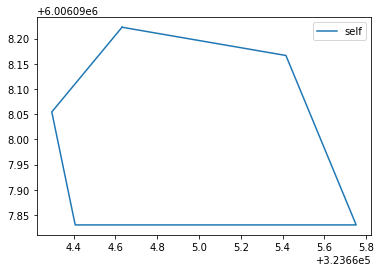

[[325  28]
 [324  29]
 [323  29]
 [322  29]
 [321  29]
 [320  29]
 [319  29]
 [318  29]
 [317  30]
 [316  30]
 [315  30]
 [314  31]
 [313  31]
 [312  32]
 [311  32]
 [310  33]
 [309  33]
 [308  34]
 [307  34]
 [306  35]
 [305  36]
 [304  36]
 [303  37]
 [302  38]
 [301  39]
 [300  39]
 [299  40]
 [299  41]
 [298  42]
 [298  43]
 [298  44]
 [298  45]
 [297  46]
 [297  47]
 [297  48]
 [297  49]
 [297  50]
 [297  51]
 [298  52]
 [298  53]
 [298  54]
 [298  55]
 [298  56]
 [298  57]
 [299  58]
 [299  59]
 [299  60]
 [299  61]
 [299  62]
 [299  63]
 [300  64]
 [300  65]
 [300  66]
 [300  67]
 [301  68]
 [301  69]
 [301  70]
 [302  71]
 [302  72]
 [303  73]
 [304  74]
 [304  75]
 [305  76]
 [306  77]
 [306  78]
 [307  79]
 [308  80]
 [309  81]
 [310  82]
 [311  83]
 [312  84]
 [313  85]
 [313  86]
 [314  87]
 [315  88]
 [315  89]
 [316  90]
 [317  91]
 [318  92]
 [319  93]
 [319  94]
 [320  95]
 [320  96]
 [321  97]
 [321  98]
 [322  99]
 [323 100]
 [323 101]
 [324 102]
 [324 103]
 [325 104]

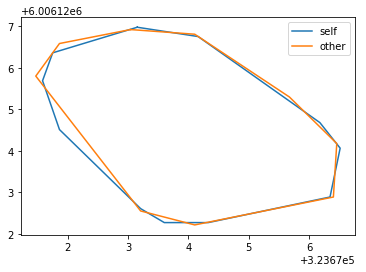

[[387 368]
 [386 369]
 [385 369]
 [384 369]
 [383 369]
 [382 369]
 [381 369]
 [380 370]
 [379 370]
 [378 370]
 [377 370]
 [376 370]
 [375 371]
 [374 371]
 [373 371]
 [372 372]
 [371 372]
 [370 372]
 [369 372]
 [368 372]
 [367 373]
 [366 373]
 [365 373]
 [364 373]
 [363 374]
 [362 374]
 [361 374]
 [360 375]
 [359 375]
 [358 375]
 [357 376]
 [356 376]
 [355 376]
 [354 377]
 [353 377]
 [352 377]
 [351 378]
 [350 378]
 [349 379]
 [348 379]
 [347 380]
 [346 380]
 [345 381]
 [344 381]
 [343 382]
 [342 382]
 [341 383]
 [340 383]
 [339 384]
 [338 384]
 [337 384]
 [336 385]
 [335 385]
 [334 386]
 [333 386]
 [332 387]
 [331 387]
 [330 388]
 [329 388]
 [328 389]
 [327 389]
 [326 390]
 [325 390]
 [324 391]
 [323 391]
 [322 392]
 [322 393]
 [321 394]
 [321 395]
 [320 396]
 [319 397]
 [319 398]
 [319 399]
 [319 400]
 [319 401]
 [319 402]
 [319 403]
 [319 404]
 [318 405]
 [318 406]
 [318 407]
 [318 408]
 [318 409]
 [318 410]
 [318 411]
 [318 412]
 [318 413]
 [318 414]
 [318 415]
 [318 416]
 [318 417]

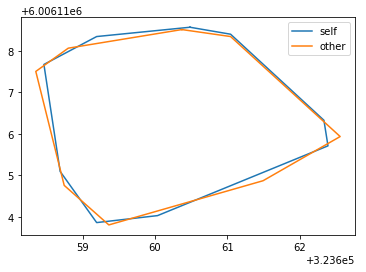

[[271  39]
 [270  40]
 [269  40]
 [268  40]
 [267  41]
 [266  41]
 [266  42]
 [265  43]
 [264  44]
 [264  45]
 [263  46]
 [262  47]
 [261  47]
 [260  48]
 [259  49]
 [258  49]
 [257  50]
 [256  50]
 [255  51]
 [254  51]
 [253  52]
 [252  53]
 [251  54]
 [250  55]
 [249  55]
 [248  56]
 [247  57]
 [246  58]
 [245  59]
 [244  60]
 [243  61]
 [242  62]
 [241  63]
 [240  64]
 [239  65]
 [238  65]
 [237  66]
 [236  67]
 [235  68]
 [234  68]
 [233  69]
 [232  70]
 [231  70]
 [230  71]
 [229  71]
 [228  72]
 [227  72]
 [226  72]
 [225  73]
 [224  73]
 [223  74]
 [222  75]
 [221  76]
 [220  77]
 [219  77]
 [218  78]
 [217  78]
 [216  79]
 [215  79]
 [214  80]
 [213  80]
 [212  81]
 [211  82]
 [210  82]
 [209  83]
 [208  84]
 [207  84]
 [206  85]
 [205  86]
 [204  86]
 [203  87]
 [202  88]
 [201  88]
 [200  89]
 [200  90]
 [200  91]
 [199  92]
 [199  93]
 [199  94]
 [198  95]
 [198  96]
 [197  97]
 [197  98]
 [197  99]
 [197 100]
 [197 101]
 [196 102]
 [197 103]
 [197 104]
 [197 105]
 [197 106]

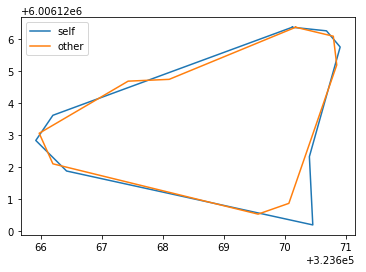

[[507  66]
 [506  67]
 [505  67]
 [504  67]
 [503  67]
 [502  68]
 [501  69]
 [500  70]
 [499  71]
 [498  71]
 [497  72]
 [496  73]
 [495  74]
 [494  75]
 [493  76]
 [492  77]
 [492  78]
 [491  79]
 [490  80]
 [489  81]
 [489  82]
 [488  83]
 [488  84]
 [488  85]
 [488  86]
 [487  87]
 [487  88]
 [487  89]
 [487  90]
 [487  91]
 [487  92]
 [487  93]
 [487  94]
 [487  95]
 [488  96]
 [488  97]
 [488  98]
 [488  99]
 [488 100]
 [488 101]
 [489 102]
 [489 103]
 [489 104]
 [489 105]
 [490 106]
 [490 107]
 [490 108]
 [490 109]
 [491 110]
 [491 111]
 [492 112]
 [492 113]
 [492 114]
 [492 115]
 [493 116]
 [494 117]
 [494 118]
 [495 119]
 [495 120]
 [495 121]
 [496 122]
 [497 123]
 [498 124]
 [499 125]
 [500 126]
 [501 126]
 [502 127]
 [503 127]
 [504 128]
 [505 128]
 [506 129]
 [507 129]
 [508 129]
 [509 129]
 [510 130]
 [511 130]
 [512 130]
 [513 130]
 [514 130]
 [515 130]
 [516 131]
 [517 131]
 [518 131]
 [519 131]
 [520 132]
 [521 132]
 [522 132]
 [523 133]
 [524 133]
 [525 133]
 [526 133]

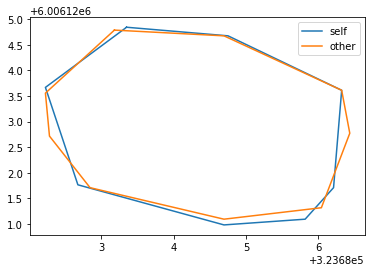

[[334 314]
 [333 315]
 [332 316]
 [331 316]
 [330 317]
 [329 317]
 [328 317]
 [327 318]
 [326 318]
 [325 319]
 [324 319]
 [323 320]
 [322 320]
 [321 321]
 [320 321]
 [319 322]
 [318 322]
 [317 323]
 [316 323]
 [315 324]
 [314 325]
 [313 325]
 [312 326]
 [311 326]
 [310 327]
 [309 328]
 [308 328]
 [307 329]
 [306 330]
 [305 331]
 [305 332]
 [304 333]
 [303 334]
 [302 335]
 [302 336]
 [301 337]
 [301 338]
 [300 339]
 [300 340]
 [300 341]
 [299 342]
 [299 343]
 [299 344]
 [298 345]
 [298 346]
 [298 347]
 [298 348]
 [298 349]
 [298 350]
 [298 351]
 [299 352]
 [299 353]
 [299 354]
 [299 355]
 [300 356]
 [300 357]
 [301 358]
 [301 359]
 [302 360]
 [303 361]
 [303 362]
 [304 363]
 [305 364]
 [305 365]
 [306 366]
 [307 367]
 [308 368]
 [308 369]
 [309 370]
 [310 371]
 [311 372]
 [311 373]
 [312 374]
 [313 375]
 [314 376]
 [315 377]
 [315 378]
 [316 379]
 [317 380]
 [317 381]
 [318 382]
 [318 383]
 [319 384]
 [320 385]
 [321 386]
 [322 386]
 [323 386]
 [324 386]
 [325 386]
 [326 386]
 [327 386]

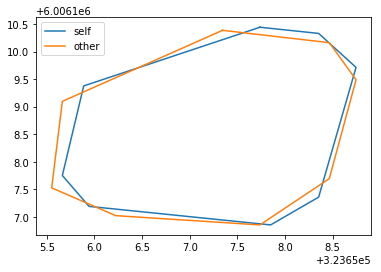

[[288  63]
 [287  64]
 [286  64]
 [285  64]
 [285  65]
 [284  66]
 [284  67]
 [283  68]
 [282  69]
 [282  70]
 [282  71]
 [281  72]
 [281  73]
 [281  74]
 [280  75]
 [280  76]
 [280  77]
 [280  78]
 [279  79]
 [279  80]
 [279  81]
 [279  82]
 [278  83]
 [278  84]
 [278  85]
 [278  86]
 [278  87]
 [277  88]
 [277  89]
 [277  90]
 [277  91]
 [277  92]
 [277  93]
 [277  94]
 [276  95]
 [276  96]
 [276  97]
 [276  98]
 [276  99]
 [276 100]
 [275 101]
 [275 102]
 [275 103]
 [275 104]
 [275 105]
 [275 106]
 [274 107]
 [274 108]
 [274 109]
 [274 110]
 [274 111]
 [273 112]
 [273 113]
 [273 114]
 [273 115]
 [273 116]
 [272 117]
 [272 118]
 [272 119]
 [271 120]
 [271 121]
 [271 122]
 [271 123]
 [270 124]
 [270 125]
 [269 126]
 [269 127]
 [269 128]
 [269 129]
 [268 130]
 [268 131]
 [269 132]
 [269 133]
 [269 134]
 [270 135]
 [270 136]
 [270 137]
 [270 138]
 [270 139]
 [270 140]
 [270 141]
 [270 142]
 [270 143]
 [271 144]
 [271 145]
 [271 146]
 [272 147]
 [272 148]
 [272 149]
 [272 150]
 [272 151]

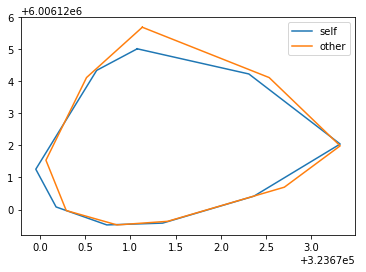

[[318 426]
 [317 427]
 [316 428]
 [316 429]
 [315 430]
 [315 431]
 [315 432]
 [315 433]
 [315 434]
 [315 435]
 [314 436]
 [314 437]
 [314 438]
 [314 439]
 [314 440]
 [314 441]
 [314 442]
 [314 443]
 [314 444]
 [314 445]
 [314 446]
 [314 447]
 [314 448]
 [314 449]
 [313 450]
 [313 451]
 [313 452]
 [313 453]
 [313 454]
 [313 455]
 [313 456]
 [313 457]
 [313 458]
 [313 459]
 [313 460]
 [313 461]
 [314 462]
 [314 463]
 [314 464]
 [314 465]
 [314 466]
 [315 467]
 [315 468]
 [316 469]
 [316 470]
 [317 471]
 [318 472]
 [319 473]
 [320 474]
 [321 475]
 [322 476]
 [323 477]
 [323 478]
 [324 479]
 [325 480]
 [326 481]
 [327 482]
 [328 483]
 [329 484]
 [329 485]
 [330 486]
 [331 487]
 [332 488]
 [332 489]
 [333 490]
 [334 490]
 [335 491]
 [336 492]
 [337 493]
 [338 494]
 [339 495]
 [340 496]
 [340 497]
 [341 498]
 [342 499]
 [343 500]
 [343 501]
 [344 502]
 [345 502]
 [346 503]
 [347 504]
 [348 504]
 [349 505]
 [350 506]
 [351 506]
 [352 507]
 [353 507]
 [354 508]
 [355 508]
 [356 508]
 [357 509]

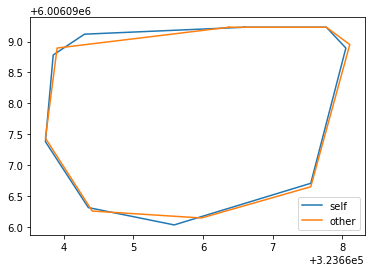

[[375 359]
 [374 360]
 [373 360]
 [372 360]
 [371 360]
 [370 360]
 [369 360]
 [368 360]
 [367 360]
 [366 360]
 [365 360]
 [364 360]
 [363 361]
 [362 361]
 [361 361]
 [360 361]
 [359 361]
 [358 361]
 [357 361]
 [356 362]
 [355 362]
 [354 362]
 [353 361]
 [352 361]
 [351 361]
 [350 361]
 [349 361]
 [348 362]
 [347 362]
 [346 363]
 [346 364]
 [345 365]
 [345 366]
 [344 367]
 [344 368]
 [343 369]
 [342 370]
 [341 370]
 [340 371]
 [339 371]
 [338 371]
 [337 372]
 [336 372]
 [335 372]
 [334 373]
 [333 373]
 [332 373]
 [331 373]
 [330 374]
 [329 374]
 [328 374]
 [327 375]
 [327 376]
 [326 377]
 [326 378]
 [325 379]
 [325 380]
 [324 381]
 [324 382]
 [323 383]
 [322 384]
 [321 385]
 [321 386]
 [320 387]
 [320 388]
 [320 389]
 [319 390]
 [319 391]
 [319 392]
 [319 393]
 [319 394]
 [318 395]
 [318 396]
 [318 397]
 [317 398]
 [317 399]
 [317 400]
 [317 401]
 [317 402]
 [316 403]
 [316 404]
 [316 405]
 [316 406]
 [316 407]
 [315 408]
 [315 409]
 [315 410]
 [314 411]
 [314 412]
 [314 413]
 [314 414]

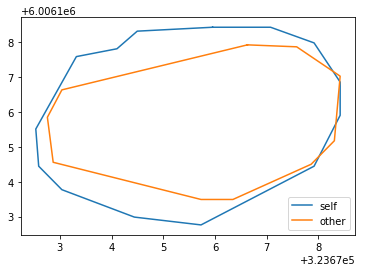

20it [00:33,  1.91s/it]

[[553 129]
 [552 130]
 [551 130]
 [550 131]
 [549 131]
 [548 132]
 [547 132]
 [546 133]
 [545 134]
 [544 134]
 [543 135]
 [542 136]
 [541 137]
 [540 138]
 [539 138]
 [538 139]
 [537 140]
 [536 141]
 [535 142]
 [534 142]
 [533 143]
 [533 144]
 [532 145]
 [531 146]
 [531 147]
 [530 148]
 [530 149]
 [529 150]
 [529 151]
 [529 152]
 [529 153]
 [529 154]
 [529 155]
 [529 156]
 [529 157]
 [529 158]
 [529 159]
 [529 160]
 [529 161]
 [529 162]
 [529 163]
 [529 164]
 [529 165]
 [529 166]
 [529 167]
 [529 168]
 [529 169]
 [529 170]
 [529 171]
 [529 172]
 [529 173]
 [529 174]
 [529 175]
 [529 176]
 [529 177]
 [529 178]
 [529 179]
 [529 180]
 [529 181]
 [530 182]
 [530 183]
 [530 184]
 [530 185]
 [531 186]
 [531 187]
 [531 188]
 [532 189]
 [533 190]
 [534 191]
 [535 192]
 [536 193]
 [537 193]
 [538 194]
 [539 194]
 [540 195]
 [541 195]
 [542 195]
 [543 196]
 [544 196]
 [545 197]
 [546 197]
 [547 198]
 [548 198]
 [549 198]
 [550 199]
 [551 199]
 [552 200]
 [553 200]
 [554 200]
 [555 200]
 [556 201]

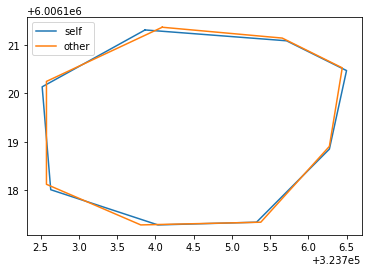

[[335 395]
 [334 396]
 [333 396]
 [332 396]
 [331 397]
 [330 397]
 [329 398]
 [328 399]
 [327 400]
 [326 400]
 [325 401]
 [324 402]
 [323 403]
 [322 404]
 [322 405]
 [321 406]
 [320 407]
 [319 408]
 [319 409]
 [318 410]
 [317 411]
 [316 412]
 [315 413]
 [314 414]
 [314 415]
 [313 416]
 [313 417]
 [312 418]
 [311 419]
 [310 420]
 [309 421]
 [308 422]
 [308 423]
 [307 424]
 [306 425]
 [305 426]
 [304 427]
 [303 428]
 [303 429]
 [302 430]
 [301 431]
 [300 432]
 [300 433]
 [299 434]
 [298 435]
 [297 436]
 [296 437]
 [295 438]
 [294 439]
 [294 440]
 [293 441]
 [293 442]
 [292 443]
 [291 444]
 [290 445]
 [289 446]
 [289 447]
 [288 448]
 [287 449]
 [286 450]
 [285 451]
 [284 452]
 [283 453]
 [283 454]
 [282 455]
 [281 456]
 [280 457]
 [280 458]
 [280 459]
 [280 460]
 [280 461]
 [280 462]
 [280 463]
 [279 464]
 [279 465]
 [279 466]
 [279 467]
 [279 468]
 [279 469]
 [279 470]
 [280 471]
 [280 472]
 [280 473]
 [280 474]
 [280 475]
 [280 476]
 [281 477]
 [282 477]
 [283 478]
 [284 478]
 [285 479]

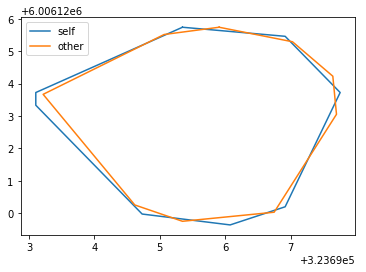

[[120 278]
 [119 279]
 [118 279]
 [117 279]
 [116 280]
 [115 280]
 [114 281]
 [113 282]
 [112 282]
 [111 283]
 [110 284]
 [109 285]
 [108 286]
 [108 287]
 [107 288]
 [106 289]
 [106 290]
 [105 291]
 [104 292]
 [104 293]
 [103 294]
 [103 295]
 [103 296]
 [102 297]
 [102 298]
 [102 299]
 [101 300]
 [101 301]
 [100 302]
 [100 303]
 [100 304]
 [ 99 305]
 [ 99 306]
 [ 99 307]
 [ 98 308]
 [ 98 309]
 [ 98 310]
 [ 97 311]
 [ 97 312]
 [ 97 313]
 [ 96 314]
 [ 96 315]
 [ 96 316]
 [ 95 317]
 [ 95 318]
 [ 94 319]
 [ 94 320]
 [ 94 321]
 [ 93 322]
 [ 93 323]
 [ 93 324]
 [ 92 325]
 [ 92 326]
 [ 92 327]
 [ 92 328]
 [ 91 329]
 [ 91 330]
 [ 91 331]
 [ 91 332]
 [ 91 333]
 [ 90 334]
 [ 90 335]
 [ 90 336]
 [ 90 337]
 [ 90 338]
 [ 89 339]
 [ 89 340]
 [ 89 341]
 [ 89 342]
 [ 89 343]
 [ 89 344]
 [ 89 345]
 [ 89 346]
 [ 89 347]
 [ 89 348]
 [ 89 349]
 [ 89 350]
 [ 89 351]
 [ 89 352]
 [ 89 353]
 [ 89 354]
 [ 89 355]
 [ 90 356]
 [ 90 357]
 [ 90 358]
 [ 90 359]
 [ 90 360]
 [ 90 361]
 [ 90 362]
 [ 91 363]
 [ 91 364]

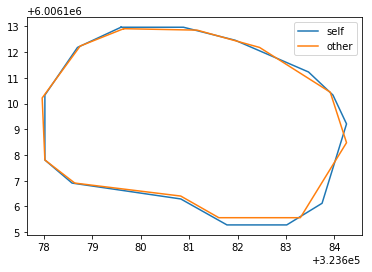

[[374 483]
 [373 484]
 [372 484]
 [371 484]
 [370 485]
 [369 486]
 [369 487]
 [368 488]
 [367 489]
 [367 490]
 [367 491]
 [366 492]
 [366 493]
 [365 494]
 [365 495]
 [365 496]
 [364 497]
 [364 498]
 [363 499]
 [363 500]
 [363 501]
 [362 502]
 [362 503]
 [361 504]
 [361 505]
 [360 506]
 [360 507]
 [359 508]
 [359 509]
 [358 510]
 [358 511]
 [357 512]
 [357 513]
 [356 514]
 [356 515]
 [355 516]
 [355 517]
 [354 518]
 [354 519]
 [354 520]
 [353 521]
 [353 522]
 [353 523]
 [352 524]
 [352 525]
 [352 526]
 [352 527]
 [352 528]
 [351 529]
 [351 530]
 [351 531]
 [351 532]
 [351 533]
 [351 534]
 [351 535]
 [351 536]
 [351 537]
 [351 538]
 [350 539]
 [351 540]
 [351 541]
 [351 542]
 [351 543]
 [351 544]
 [351 545]
 [351 546]
 [351 547]
 [352 548]
 [352 549]
 [352 550]
 [353 551]
 [353 552]
 [354 553]
 [354 554]
 [354 555]
 [355 556]
 [355 557]
 [356 558]
 [356 559]
 [357 560]
 [357 561]
 [358 562]
 [359 563]
 [359 564]
 [360 565]
 [360 566]
 [361 567]
 [362 568]
 [363 569]
 [364 570]
 [364 571]

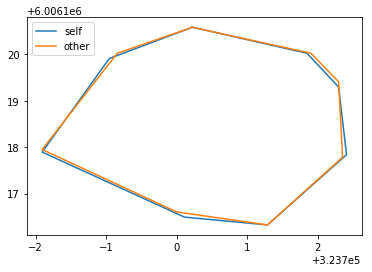

[[513 482]
 [512 483]
 [511 483]
 [510 483]
 [509 483]
 [508 483]
 [507 483]
 [506 484]
 [505 484]
 [504 485]
 [503 486]
 [502 486]
 [501 487]
 [500 487]
 [499 488]
 [498 489]
 [497 490]
 [496 490]
 [495 491]
 [494 492]
 [494 493]
 [493 494]
 [492 495]
 [491 496]
 [490 497]
 [489 498]
 [488 499]
 [487 500]
 [486 501]
 [485 502]
 [484 503]
 [483 504]
 [482 505]
 [481 505]
 [480 506]
 [479 506]
 [478 506]
 [477 507]
 [476 507]
 [475 507]
 [474 508]
 [473 508]
 [472 509]
 [471 509]
 [470 509]
 [469 509]
 [468 509]
 [467 509]
 [466 510]
 [465 510]
 [464 511]
 [463 511]
 [462 512]
 [461 512]
 [460 513]
 [459 514]
 [458 515]
 [458 516]
 [458 517]
 [458 518]
 [458 519]
 [457 520]
 [457 521]
 [457 522]
 [457 523]
 [457 524]
 [457 525]
 [457 526]
 [457 527]
 [457 528]
 [457 529]
 [458 530]
 [458 531]
 [458 532]
 [458 533]
 [458 534]
 [458 535]
 [458 536]
 [458 537]
 [458 538]
 [459 539]
 [459 540]
 [459 541]
 [459 542]
 [459 543]
 [459 544]
 [459 545]
 [460 546]
 [460 547]
 [460 548]
 [460 549]

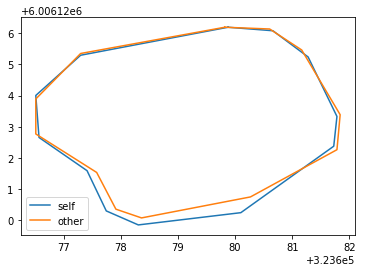

[[217 220]
 [216 221]
 [215 221]
 [214 221]
 [213 221]
 [212 222]
 [211 222]
 [210 223]
 [209 223]
 [208 223]
 [207 223]
 [206 224]
 [205 224]
 [204 225]
 [203 225]
 [202 226]
 [201 226]
 [200 226]
 [199 227]
 [198 227]
 [197 228]
 [196 228]
 [195 228]
 [194 229]
 [193 229]
 [192 230]
 [191 230]
 [190 230]
 [189 231]
 [188 231]
 [187 232]
 [186 233]
 [185 233]
 [184 234]
 [183 235]
 [183 236]
 [182 237]
 [182 238]
 [181 239]
 [181 240]
 [181 241]
 [180 242]
 [180 243]
 [180 244]
 [179 245]
 [179 246]
 [179 247]
 [179 248]
 [178 249]
 [178 250]
 [178 251]
 [178 252]
 [178 253]
 [178 254]
 [178 255]
 [178 256]
 [177 257]
 [177 258]
 [177 259]
 [177 260]
 [177 261]
 [177 262]
 [177 263]
 [177 264]
 [177 265]
 [177 266]
 [177 267]
 [177 268]
 [177 269]
 [177 270]
 [177 271]
 [177 272]
 [177 273]
 [177 274]
 [177 275]
 [177 276]
 [177 277]
 [177 278]
 [177 279]
 [177 280]
 [177 281]
 [177 282]
 [177 283]
 [177 284]
 [177 285]
 [177 286]
 [177 287]
 [178 288]
 [178 289]
 [178 290]
 [178 291]

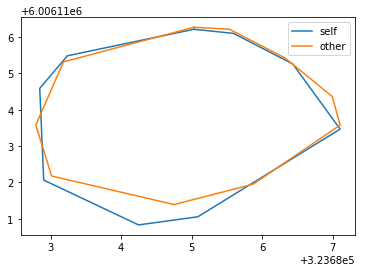

[[ 98 425]
 [ 97 426]
 [ 96 426]
 [ 95 426]
 [ 94 427]
 [ 93 427]
 [ 92 427]
 [ 91 428]
 [ 90 429]
 [ 89 429]
 [ 88 430]
 [ 87 431]
 [ 86 432]
 [ 85 432]
 [ 84 433]
 [ 83 434]
 [ 82 435]
 [ 81 436]
 [ 80 436]
 [ 79 437]
 [ 78 438]
 [ 77 439]
 [ 76 440]
 [ 75 441]
 [ 74 442]
 [ 73 443]
 [ 72 443]
 [ 71 444]
 [ 71 445]
 [ 70 446]
 [ 69 447]
 [ 68 448]
 [ 68 449]
 [ 67 450]
 [ 67 451]
 [ 67 452]
 [ 66 453]
 [ 66 454]
 [ 65 455]
 [ 65 456]
 [ 65 457]
 [ 65 458]
 [ 64 459]
 [ 64 460]
 [ 64 461]
 [ 64 462]
 [ 64 463]
 [ 64 464]
 [ 64 465]
 [ 63 466]
 [ 63 467]
 [ 63 468]
 [ 63 469]
 [ 63 470]
 [ 63 471]
 [ 63 472]
 [ 63 473]
 [ 63 474]
 [ 63 475]
 [ 63 476]
 [ 63 477]
 [ 63 478]
 [ 63 479]
 [ 63 480]
 [ 63 481]
 [ 63 482]
 [ 62 483]
 [ 62 484]
 [ 62 485]
 [ 62 486]
 [ 61 487]
 [ 61 488]
 [ 60 489]
 [ 60 490]
 [ 60 491]
 [ 59 492]
 [ 59 493]
 [ 59 494]
 [ 58 495]
 [ 58 496]
 [ 58 497]
 [ 57 498]
 [ 57 499]
 [ 57 500]
 [ 57 501]
 [ 56 502]
 [ 56 503]
 [ 56 504]
 [ 56 505]
 [ 56 506]
 [ 56 507]

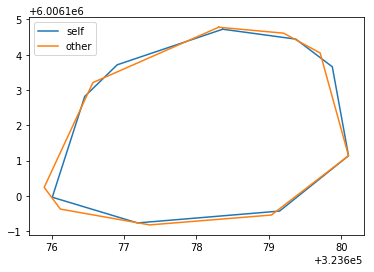

[[178 140]
 [177 141]
 [176 141]
 [175 141]
 [174 141]
 [173 142]
 [172 142]
 [171 142]
 [170 143]
 [169 143]
 [168 144]
 [167 144]
 [166 145]
 [165 145]
 [164 146]
 [163 146]
 [162 147]
 [161 148]
 [160 149]
 [159 150]
 [158 150]
 [157 150]
 [156 151]
 [155 151]
 [154 152]
 [154 153]
 [153 154]
 [152 155]
 [151 155]
 [150 155]
 [149 155]
 [148 155]
 [147 156]
 [146 156]
 [145 157]
 [144 158]
 [143 158]
 [142 159]
 [141 159]
 [140 159]
 [139 160]
 [138 161]
 [137 161]
 [136 162]
 [136 163]
 [135 164]
 [135 165]
 [134 166]
 [134 167]
 [133 168]
 [133 169]
 [132 170]
 [132 171]
 [132 172]
 [131 173]
 [131 174]
 [131 175]
 [131 176]
 [131 177]
 [131 178]
 [131 179]
 [130 180]
 [130 181]
 [130 182]
 [130 183]
 [130 184]
 [131 185]
 [131 186]
 [131 187]
 [131 188]
 [131 189]
 [131 190]
 [131 191]
 [131 192]
 [131 193]
 [131 194]
 [131 195]
 [132 196]
 [132 197]
 [132 198]
 [132 199]
 [132 200]
 [133 201]
 [133 202]
 [134 203]
 [134 204]
 [135 205]
 [135 206]
 [135 207]
 [136 208]
 [136 209]

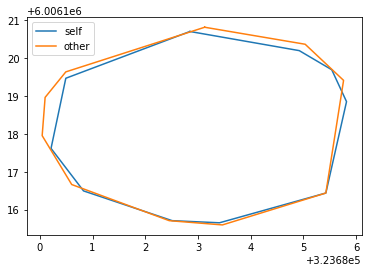

[[234 484]
 [233 485]
 [232 485]
 [231 485]
 [230 485]
 [229 485]
 [228 485]
 [227 485]
 [226 485]
 [225 485]
 [224 485]
 [223 486]
 [222 486]
 [221 487]
 [220 487]
 [219 487]
 [218 487]
 [217 488]
 [216 488]
 [215 488]
 [214 489]
 [213 489]
 [212 489]
 [211 489]
 [210 489]
 [209 490]
 [208 490]
 [207 490]
 [206 491]
 [205 491]
 [204 492]
 [203 493]
 [202 494]
 [201 495]
 [200 496]
 [200 497]
 [199 498]
 [198 499]
 [197 500]
 [196 501]
 [195 502]
 [194 503]
 [194 504]
 [194 505]
 [194 506]
 [193 507]
 [193 508]
 [192 509]
 [192 510]
 [191 511]
 [191 512]
 [191 513]
 [190 514]
 [190 515]
 [190 516]
 [189 517]
 [188 518]
 [188 519]
 [187 520]
 [186 521]
 [186 522]
 [185 523]
 [185 524]
 [184 525]
 [184 526]
 [183 527]
 [182 528]
 [182 529]
 [181 530]
 [180 531]
 [179 532]
 [178 533]
 [177 534]
 [176 535]
 [175 536]
 [175 537]
 [175 538]
 [174 539]
 [173 540]
 [172 541]
 [171 542]
 [170 543]
 [169 544]
 [169 545]
 [169 546]
 [168 547]
 [168 548]
 [168 549]
 [168 550]
 [169 551]
 [169 552]

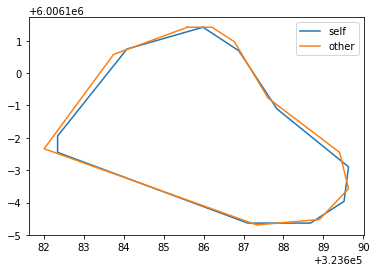

[[266  63]
 [265  64]
 [264  64]
 [263  64]
 [262  65]
 [261  65]
 [260  66]
 [259  67]
 [258  68]
 [257  68]
 [256  69]
 [255  70]
 [255  71]
 [254  72]
 [254  73]
 [253  74]
 [253  75]
 [252  76]
 [251  77]
 [251  78]
 [250  79]
 [250  80]
 [249  81]
 [249  82]
 [249  83]
 [248  84]
 [248  85]
 [248  86]
 [247  87]
 [247  88]
 [246  89]
 [246  90]
 [246  91]
 [245  92]
 [245  93]
 [245  94]
 [244  95]
 [244  96]
 [243  97]
 [243  98]
 [243  99]
 [242 100]
 [242 101]
 [242 102]
 [241 103]
 [241 104]
 [241 105]
 [241 106]
 [240 107]
 [240 108]
 [240 109]
 [240 110]
 [240 111]
 [239 112]
 [239 113]
 [239 114]
 [239 115]
 [238 116]
 [238 117]
 [238 118]
 [238 119]
 [238 120]
 [238 121]
 [238 122]
 [238 123]
 [237 124]
 [237 125]
 [237 126]
 [237 127]
 [237 128]
 [237 129]
 [237 130]
 [237 131]
 [237 132]
 [237 133]
 [237 134]
 [237 135]
 [237 136]
 [237 137]
 [238 138]
 [238 139]
 [238 140]
 [238 141]
 [239 142]
 [239 143]
 [239 144]
 [240 145]
 [241 146]
 [241 147]
 [242 148]
 [243 149]

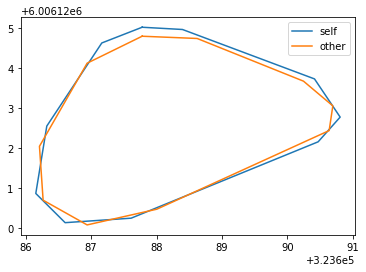

[[187  65]
 [186  66]
 [185  66]
 [184  66]
 [183  67]
 [182  67]
 [181  68]
 [180  69]
 [179  69]
 [178  70]
 [177  71]
 [177  72]
 [176  73]
 [175  74]
 [174  75]
 [173  76]
 [173  77]
 [172  78]
 [171  79]
 [170  80]
 [170  81]
 [170  82]
 [170  83]
 [170  84]
 [169  85]
 [169  86]
 [169  87]
 [169  88]
 [169  89]
 [169  90]
 [169  91]
 [169  92]
 [169  93]
 [169  94]
 [169  95]
 [169  96]
 [169  97]
 [169  98]
 [169  99]
 [169 100]
 [169 101]
 [169 102]
 [170 103]
 [170 104]
 [170 105]
 [170 106]
 [170 107]
 [171 108]
 [171 109]
 [172 110]
 [172 111]
 [172 112]
 [173 113]
 [174 114]
 [174 115]
 [175 116]
 [175 117]
 [176 118]
 [177 119]
 [178 120]
 [179 121]
 [180 122]
 [181 123]
 [182 124]
 [183 124]
 [184 124]
 [185 125]
 [186 125]
 [187 125]
 [188 126]
 [189 126]
 [190 126]
 [191 126]
 [192 127]
 [193 127]
 [194 127]
 [195 127]
 [196 128]
 [197 128]
 [198 128]
 [199 129]
 [200 129]
 [201 130]
 [202 130]
 [203 131]
 [204 131]
 [205 131]
 [206 132]
 [207 132]
 [208 132]
 [209 133]

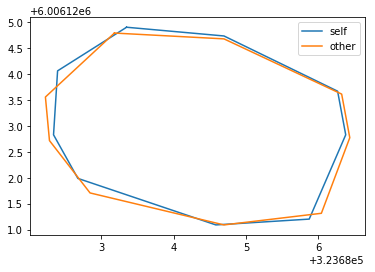

[[319 116]
 [318 117]
 [317 117]
 [316 117]
 [315 117]
 [314 117]
 [313 117]
 [312 117]
 [311 118]
 [310 119]
 [309 119]
 [308 120]
 [307 120]
 [306 120]
 [305 121]
 [304 121]
 [303 122]
 [302 122]
 [301 123]
 [300 123]
 [299 124]
 [298 124]
 [297 124]
 [296 125]
 [295 125]
 [294 126]
 [293 127]
 [292 127]
 [291 128]
 [290 129]
 [289 129]
 [288 130]
 [287 130]
 [286 131]
 [285 131]
 [284 132]
 [283 133]
 [282 133]
 [281 134]
 [280 135]
 [279 135]
 [278 136]
 [277 136]
 [276 136]
 [275 137]
 [274 137]
 [274 138]
 [273 139]
 [272 140]
 [271 141]
 [270 141]
 [269 142]
 [268 143]
 [267 143]
 [266 144]
 [265 145]
 [264 146]
 [263 146]
 [262 147]
 [261 148]
 [260 149]
 [259 150]
 [258 151]
 [257 151]
 [256 152]
 [255 153]
 [255 154]
 [254 155]
 [253 156]
 [253 157]
 [252 158]
 [252 159]
 [252 160]
 [252 161]
 [252 162]
 [252 163]
 [253 164]
 [253 165]
 [253 166]
 [254 167]
 [254 168]
 [255 169]
 [256 169]
 [257 170]
 [257 171]
 [258 172]
 [259 173]
 [260 174]
 [261 175]
 [262 176]
 [263 177]

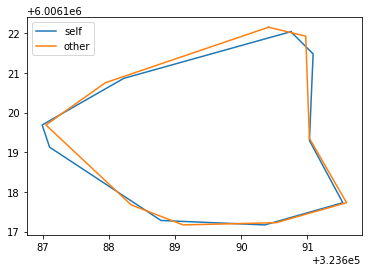

[[262 271]
 [261 272]
 [260 272]
 [259 272]
 [258 272]
 [257 272]
 [256 273]
 [255 274]
 [254 274]
 [253 275]
 [252 276]
 [251 276]
 [250 277]
 [249 278]
 [248 279]
 [247 280]
 [246 281]
 [246 282]
 [245 283]
 [244 284]
 [243 285]
 [242 286]
 [241 287]
 [240 288]
 [239 289]
 [239 290]
 [238 291]
 [237 292]
 [236 293]
 [235 294]
 [234 295]
 [233 296]
 [232 297]
 [231 298]
 [231 299]
 [230 300]
 [229 301]
 [228 302]
 [227 303]
 [226 303]
 [226 304]
 [225 305]
 [224 306]
 [223 307]
 [222 308]
 [221 309]
 [220 310]
 [219 311]
 [219 312]
 [218 313]
 [217 314]
 [216 315]
 [216 316]
 [215 317]
 [214 318]
 [214 319]
 [214 320]
 [214 321]
 [213 322]
 [213 323]
 [213 324]
 [213 325]
 [212 326]
 [212 327]
 [212 328]
 [212 329]
 [212 330]
 [212 331]
 [212 332]
 [212 333]
 [212 334]
 [212 335]
 [211 336]
 [211 337]
 [212 338]
 [212 339]
 [212 340]
 [212 341]
 [212 342]
 [212 343]
 [213 344]
 [213 345]
 [214 346]
 [214 347]
 [215 348]
 [215 349]
 [216 350]
 [217 350]
 [218 351]
 [219 352]
 [220 352]

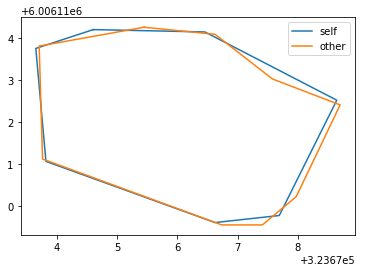

[[165 478]
 [164 479]
 [163 479]
 [162 479]
 [161 480]
 [160 481]
 [159 481]
 [158 482]
 [157 482]
 [156 483]
 [155 483]
 [154 484]
 [153 484]
 [152 485]
 [151 486]
 [150 486]
 [149 487]
 [148 488]
 [147 488]
 [146 489]
 [145 490]
 [144 490]
 [143 491]
 [142 492]
 [141 493]
 [141 494]
 [140 495]
 [140 496]
 [140 497]
 [139 498]
 [139 499]
 [139 500]
 [139 501]
 [139 502]
 [139 503]
 [139 504]
 [139 505]
 [139 506]
 [139 507]
 [139 508]
 [139 509]
 [139 510]
 [139 511]
 [139 512]
 [139 513]
 [140 514]
 [140 515]
 [140 516]
 [140 517]
 [140 518]
 [140 519]
 [140 520]
 [140 521]
 [140 522]
 [140 523]
 [140 524]
 [140 525]
 [140 526]
 [140 527]
 [140 528]
 [140 529]
 [140 530]
 [140 531]
 [140 532]
 [140 533]
 [140 534]
 [141 535]
 [141 536]
 [141 537]
 [141 538]
 [141 539]
 [142 540]
 [142 541]
 [143 542]
 [143 543]
 [144 544]
 [145 545]
 [146 546]
 [147 546]
 [148 547]
 [149 547]
 [150 548]
 [151 548]
 [152 548]
 [153 548]
 [154 548]
 [155 548]
 [156 548]
 [157 549]
 [158 548]
 [159 548]

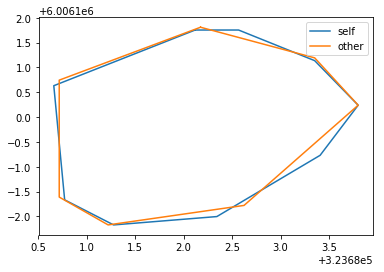

[[201 429]
 [200 430]
 [199 431]
 [198 432]
 [197 433]
 [196 434]
 [196 435]
 [195 436]
 [195 437]
 [194 438]
 [194 439]
 [193 440]
 [192 441]
 [192 442]
 [191 443]
 [191 444]
 [190 445]
 [189 446]
 [188 447]
 [187 448]
 [186 449]
 [185 450]
 [184 451]
 [183 451]
 [182 452]
 [181 453]
 [181 454]
 [180 455]
 [179 456]
 [178 457]
 [177 458]
 [177 459]
 [177 460]
 [176 461]
 [176 462]
 [176 463]
 [175 464]
 [175 465]
 [175 466]
 [175 467]
 [174 468]
 [174 469]
 [174 470]
 [174 471]
 [174 472]
 [174 473]
 [174 474]
 [174 475]
 [175 476]
 [175 477]
 [176 478]
 [176 479]
 [177 480]
 [177 481]
 [178 482]
 [179 483]
 [179 484]
 [180 485]
 [181 486]
 [182 487]
 [183 488]
 [184 489]
 [185 490]
 [186 491]
 [187 492]
 [188 493]
 [189 494]
 [190 494]
 [191 495]
 [192 495]
 [193 496]
 [194 496]
 [195 496]
 [196 496]
 [197 497]
 [198 497]
 [199 497]
 [200 496]
 [201 496]
 [202 496]
 [203 496]
 [204 496]
 [205 496]
 [206 495]
 [207 495]
 [208 495]
 [209 495]
 [210 494]
 [211 494]
 [212 494]
 [213 494]

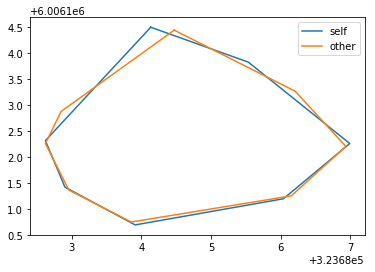

21it [00:35,  1.96s/it]

[[239 128]
 [238 129]
 [237 129]
 [236 129]
 [235 129]
 [234 129]
 [233 129]
 [232 130]
 [231 130]
 [230 131]
 [229 131]
 [228 132]
 [227 132]
 [226 133]
 [225 134]
 [224 134]
 [223 135]
 [222 136]
 [221 137]
 [220 137]
 [219 138]
 [218 139]
 [217 140]
 [216 141]
 [215 141]
 [214 142]
 [213 143]
 [213 144]
 [212 145]
 [211 146]
 [211 147]
 [210 148]
 [209 149]
 [209 150]
 [209 151]
 [208 152]
 [208 153]
 [208 154]
 [208 155]
 [208 156]
 [208 157]
 [208 158]
 [208 159]
 [208 160]
 [208 161]
 [208 162]
 [208 163]
 [208 164]
 [208 165]
 [208 166]
 [208 167]
 [208 168]
 [208 169]
 [208 170]
 [208 171]
 [208 172]
 [208 173]
 [208 174]
 [208 175]
 [209 176]
 [208 177]
 [208 178]
 [208 179]
 [209 180]
 [209 181]
 [209 182]
 [209 183]
 [209 184]
 [210 185]
 [210 186]
 [210 187]
 [211 188]
 [211 189]
 [212 190]
 [213 191]
 [214 192]
 [215 193]
 [216 193]
 [217 194]
 [218 194]
 [219 195]
 [220 195]
 [221 195]
 [222 196]
 [223 196]
 [224 197]
 [225 197]
 [226 197]
 [227 198]
 [228 198]
 [229 199]

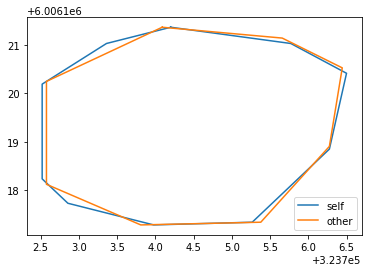

[[259 240]
 [258 241]
 [257 241]
 [256 241]
 [255 241]
 [254 241]
 [253 241]
 [252 241]
 [251 241]
 [250 242]
 [249 242]
 [248 242]
 [247 242]
 [246 242]
 [245 242]
 [244 243]
 [243 243]
 [242 243]
 [241 243]
 [240 243]
 [239 244]
 [238 244]
 [237 244]
 [236 244]
 [235 244]
 [234 244]
 [233 244]
 [232 244]
 [231 244]
 [230 244]
 [229 244]
 [228 245]
 [227 245]
 [226 244]
 [225 244]
 [224 244]
 [223 244]
 [222 244]
 [221 244]
 [220 244]
 [219 244]
 [218 244]
 [217 244]
 [216 244]
 [215 244]
 [214 243]
 [213 243]
 [212 243]
 [211 243]
 [210 243]
 [209 244]
 [208 244]
 [207 244]
 [206 245]
 [205 245]
 [204 245]
 [203 246]
 [202 246]
 [201 247]
 [200 248]
 [200 249]
 [199 250]
 [198 251]
 [198 252]
 [197 253]
 [197 254]
 [196 255]
 [196 256]
 [196 257]
 [195 258]
 [195 259]
 [195 260]
 [195 261]
 [194 262]
 [194 263]
 [194 264]
 [194 265]
 [194 266]
 [194 267]
 [193 268]
 [193 269]
 [193 270]
 [193 271]
 [193 272]
 [193 273]
 [193 274]
 [193 275]
 [192 276]
 [192 277]
 [192 278]
 [192 279]

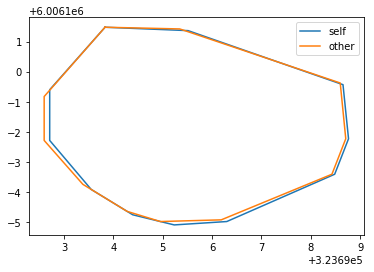

[[ 87  50]
 [ 86  51]
 [ 85  51]
 [ 84  51]
 [ 83  51]
 [ 82  51]
 [ 81  52]
 [ 80  52]
 [ 79  52]
 [ 78  53]
 [ 77  53]
 [ 76  54]
 [ 75  54]
 [ 74  55]
 [ 73  56]
 [ 72  56]
 [ 71  57]
 [ 70  58]
 [ 70  59]
 [ 69  60]
 [ 68  61]
 [ 67  62]
 [ 67  63]
 [ 66  64]
 [ 65  65]
 [ 64  66]
 [ 63  67]
 [ 63  68]
 [ 62  69]
 [ 61  70]
 [ 60  71]
 [ 59  71]
 [ 58  72]
 [ 57  73]
 [ 56  74]
 [ 55  75]
 [ 54  76]
 [ 53  77]
 [ 52  78]
 [ 51  79]
 [ 50  80]
 [ 49  81]
 [ 48  82]
 [ 47  83]
 [ 47  84]
 [ 46  85]
 [ 45  86]
 [ 45  87]
 [ 45  88]
 [ 45  89]
 [ 45  90]
 [ 46  91]
 [ 46  92]
 [ 46  93]
 [ 46  94]
 [ 47  95]
 [ 47  96]
 [ 48  97]
 [ 49  98]
 [ 49  99]
 [ 49 100]
 [ 50 101]
 [ 50 102]
 [ 50 103]
 [ 51 104]
 [ 51 105]
 [ 52 106]
 [ 52 107]
 [ 52 108]
 [ 53 109]
 [ 53 110]
 [ 54 111]
 [ 54 112]
 [ 54 113]
 [ 55 114]
 [ 55 115]
 [ 55 116]
 [ 56 117]
 [ 56 118]
 [ 56 119]
 [ 57 120]
 [ 57 121]
 [ 57 122]
 [ 57 123]
 [ 58 124]
 [ 58 125]
 [ 59 126]
 [ 59 127]
 [ 60 128]
 [ 60 129]
 [ 61 130]

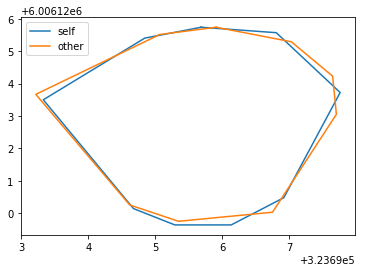

[[281  58]
 [280  59]
 [279  59]
 [278  60]
 [277  60]
 [276  61]
 [276  62]
 [276  63]
 [275  64]
 [275  65]
 [275  66]
 [275  67]
 [275  68]
 [274  69]
 [274  70]
 [274  71]
 [274  72]
 [274  73]
 [274  74]
 [273  75]
 [273  76]
 [272  77]
 [271  78]
 [271  79]
 [270  80]
 [270  81]
 [269  82]
 [268  83]
 [268  84]
 [267  85]
 [267  86]
 [267  87]
 [266  88]
 [266  89]
 [265  90]
 [265  91]
 [265  92]
 [264  93]
 [264  94]
 [264  95]
 [264  96]
 [264  97]
 [264  98]
 [264  99]
 [263 100]
 [263 101]
 [263 102]
 [263 103]
 [263 104]
 [263 105]
 [263 106]
 [263 107]
 [263 108]
 [263 109]
 [263 110]
 [263 111]
 [263 112]
 [264 113]
 [264 114]
 [264 115]
 [264 116]
 [264 117]
 [264 118]
 [265 119]
 [265 120]
 [265 121]
 [266 122]
 [266 123]
 [266 124]
 [267 125]
 [267 126]
 [267 127]
 [267 128]
 [268 129]
 [268 130]
 [269 131]
 [269 132]
 [270 133]
 [270 134]
 [271 135]
 [272 136]
 [273 137]
 [274 138]
 [275 139]
 [276 140]
 [277 141]
 [278 141]
 [279 142]
 [280 143]
 [281 143]
 [282 144]

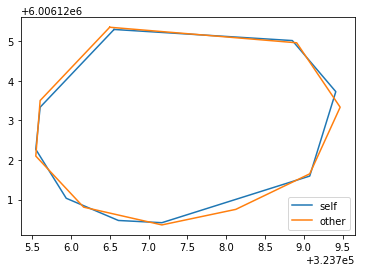

[[165 142]
 [164 143]
 [163 143]
 [162 143]
 [161 143]
 [160 144]
 [159 144]
 [158 145]
 [157 145]
 [156 146]
 [155 146]
 [154 147]
 [153 148]
 [152 149]
 [151 149]
 [150 150]
 [149 151]
 [149 152]
 [148 153]
 [147 154]
 [147 155]
 [146 156]
 [145 157]
 [145 158]
 [144 159]
 [144 160]
 [143 161]
 [142 162]
 [142 163]
 [141 164]
 [141 165]
 [140 166]
 [140 167]
 [139 168]
 [138 169]
 [138 170]
 [137 171]
 [136 172]
 [136 173]
 [135 174]
 [135 175]
 [134 176]
 [134 177]
 [133 178]
 [133 179]
 [133 180]
 [132 181]
 [132 182]
 [131 183]
 [131 184]
 [131 185]
 [131 186]
 [131 187]
 [131 188]
 [131 189]
 [131 190]
 [132 191]
 [132 192]
 [133 193]
 [133 194]
 [134 195]
 [135 195]
 [136 196]
 [137 197]
 [138 198]
 [139 198]
 [140 199]
 [141 200]
 [142 200]
 [143 201]
 [144 201]
 [145 202]
 [146 203]
 [147 203]
 [148 203]
 [149 204]
 [150 204]
 [151 205]
 [152 205]
 [153 206]
 [154 207]
 [155 207]
 [156 208]
 [157 209]
 [158 209]
 [159 210]
 [160 211]
 [161 211]
 [162 212]
 [163 212]
 [164 213]

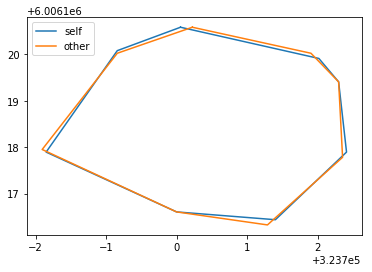

[[493 177]
 [492 178]
 [491 178]
 [490 179]
 [489 179]
 [488 180]
 [488 181]
 [487 182]
 [486 183]
 [485 183]
 [484 184]
 [483 185]
 [482 186]
 [481 187]
 [481 188]
 [480 189]
 [479 190]
 [478 191]
 [477 191]
 [476 191]
 [475 191]
 [474 192]
 [473 193]
 [472 194]
 [471 195]
 [470 196]
 [469 197]
 [468 198]
 [467 199]
 [467 200]
 [466 201]
 [465 202]
 [464 203]
 [464 204]
 [463 205]
 [463 206]
 [463 207]
 [462 208]
 [462 209]
 [462 210]
 [461 211]
 [461 212]
 [461 213]
 [461 214]
 [461 215]
 [460 216]
 [460 217]
 [460 218]
 [460 219]
 [460 220]
 [460 221]
 [460 222]
 [460 223]
 [460 224]
 [460 225]
 [460 226]
 [460 227]
 [460 228]
 [460 229]
 [460 230]
 [460 231]
 [460 232]
 [460 233]
 [460 234]
 [460 235]
 [460 236]
 [460 237]
 [460 238]
 [460 239]
 [460 240]
 [460 241]
 [460 242]
 [460 243]
 [461 244]
 [461 245]
 [461 246]
 [461 247]
 [461 248]
 [462 249]
 [462 250]
 [462 251]
 [462 252]
 [462 253]
 [462 254]
 [462 255]
 [463 256]
 [463 257]
 [463 258]
 [463 259]
 [463 260]
 [464 261]

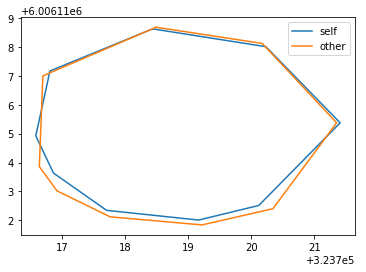

[[194 482]
 [193 483]
 [192 483]
 [191 483]
 [190 483]
 [189 483]
 [188 483]
 [187 483]
 [186 484]
 [185 484]
 [184 485]
 [183 486]
 [182 486]
 [181 487]
 [180 487]
 [179 488]
 [178 489]
 [177 490]
 [176 491]
 [175 492]
 [174 493]
 [173 494]
 [172 495]
 [171 496]
 [170 497]
 [170 498]
 [169 499]
 [168 500]
 [167 501]
 [166 502]
 [165 503]
 [164 504]
 [163 505]
 [162 505]
 [161 506]
 [160 506]
 [159 506]
 [158 507]
 [157 507]
 [156 508]
 [155 508]
 [154 508]
 [153 509]
 [152 509]
 [151 509]
 [150 509]
 [149 509]
 [148 509]
 [147 510]
 [146 510]
 [145 510]
 [144 511]
 [143 511]
 [142 512]
 [141 513]
 [140 513]
 [139 514]
 [139 515]
 [138 516]
 [138 517]
 [138 518]
 [137 519]
 [137 520]
 [137 521]
 [137 522]
 [137 523]
 [137 524]
 [137 525]
 [137 526]
 [137 527]
 [137 528]
 [137 529]
 [137 530]
 [137 531]
 [137 532]
 [137 533]
 [137 534]
 [138 535]
 [138 536]
 [138 537]
 [138 538]
 [138 539]
 [138 540]
 [138 541]
 [139 542]
 [139 543]
 [139 544]
 [139 545]
 [139 546]
 [139 547]
 [139 548]

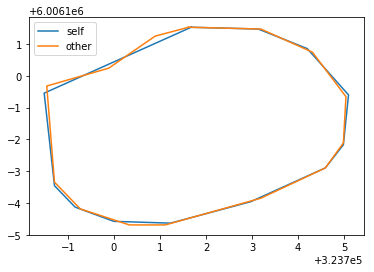

[[529 357]
 [528 358]
 [527 358]
 [526 358]
 [525 359]
 [524 359]
 [523 359]
 [522 360]
 [521 360]
 [520 360]
 [519 361]
 [518 361]
 [517 362]
 [516 363]
 [515 364]
 [514 365]
 [513 366]
 [512 367]
 [511 368]
 [510 368]
 [509 369]
 [508 369]
 [507 369]
 [506 370]
 [505 371]
 [504 372]
 [503 373]
 [502 374]
 [501 375]
 [500 375]
 [499 375]
 [498 375]
 [497 374]
 [496 374]
 [495 374]
 [494 374]
 [493 375]
 [492 375]
 [491 376]
 [490 376]
 [489 377]
 [488 377]
 [487 378]
 [486 379]
 [485 379]
 [484 380]
 [483 380]
 [482 381]
 [481 382]
 [480 383]
 [479 384]
 [478 385]
 [477 386]
 [476 387]
 [475 388]
 [474 389]
 [473 390]
 [473 391]
 [472 392]
 [472 393]
 [471 394]
 [471 395]
 [471 396]
 [471 397]
 [470 398]
 [470 399]
 [470 400]
 [470 401]
 [470 402]
 [469 403]
 [469 404]
 [469 405]
 [469 406]
 [468 407]
 [468 408]
 [468 409]
 [468 410]
 [468 411]
 [468 412]
 [468 413]
 [468 414]
 [467 415]
 [467 416]
 [466 417]
 [466 418]
 [466 419]
 [466 420]
 [467 421]
 [468 422]
 [468 423]
 [469 424]

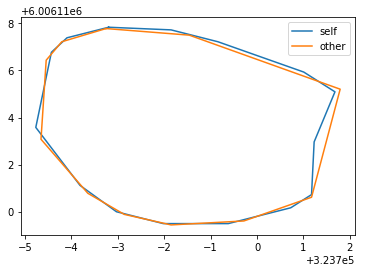

[[294 504]
 [293 505]
 [292 505]
 [291 505]
 [290 505]
 [289 506]
 [288 506]
 [287 507]
 [286 507]
 [285 508]
 [284 508]
 [283 509]
 [282 510]
 [281 510]
 [280 511]
 [279 512]
 [278 513]
 [277 513]
 [276 514]
 [275 514]
 [274 515]
 [273 515]
 [272 516]
 [271 516]
 [270 517]
 [269 517]
 [268 517]
 [267 518]
 [266 518]
 [265 519]
 [264 519]
 [263 519]
 [262 520]
 [261 520]
 [260 521]
 [259 522]
 [258 523]
 [257 524]
 [257 525]
 [257 526]
 [256 527]
 [256 528]
 [256 529]
 [256 530]
 [256 531]
 [256 532]
 [256 533]
 [256 534]
 [256 535]
 [256 536]
 [256 537]
 [256 538]
 [256 539]
 [256 540]
 [256 541]
 [256 542]
 [256 543]
 [256 544]
 [256 545]
 [256 546]
 [256 547]
 [256 548]
 [256 549]
 [256 550]
 [256 551]
 [256 552]
 [256 553]
 [257 554]
 [257 555]
 [257 556]
 [257 557]
 [257 558]
 [258 559]
 [258 560]
 [259 561]
 [260 562]
 [261 563]
 [262 564]
 [263 565]
 [264 565]
 [265 566]
 [266 566]
 [267 567]
 [268 567]
 [269 568]
 [270 569]
 [271 569]
 [272 569]
 [273 569]
 [274 570]
 [275 570]

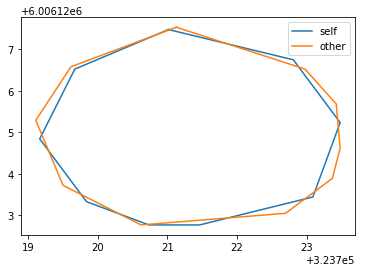

[[423  44]
 [422  45]
 [421  45]
 [420  45]
 [419  45]
 [418  45]
 [417  45]
 [416  45]
 [415  45]
 [414  45]
 [413  46]
 [412  46]
 [411  46]
 [410  46]
 [409  47]
 [408  47]
 [407  47]
 [406  47]
 [405  47]
 [404  47]
 [403  47]
 [402  47]
 [401  47]
 [400  47]
 [399  47]
 [398  47]
 [397  47]
 [396  48]
 [395  48]
 [394  48]
 [393  48]
 [392  49]
 [391  50]
 [390  51]
 [389  52]
 [388  53]
 [387  54]
 [386  54]
 [385  55]
 [385  56]
 [384  57]
 [383  58]
 [382  59]
 [382  60]
 [381  61]
 [381  62]
 [380  63]
 [380  64]
 [379  65]
 [379  66]
 [378  67]
 [378  68]
 [378  69]
 [377  70]
 [377  71]
 [377  72]
 [377  73]
 [376  74]
 [376  75]
 [376  76]
 [376  77]
 [376  78]
 [376  79]
 [376  80]
 [376  81]
 [376  82]
 [376  83]
 [377  84]
 [377  85]
 [378  86]
 [378  87]
 [378  88]
 [379  89]
 [379  90]
 [380  91]
 [381  92]
 [382  93]
 [383  94]
 [384  95]
 [385  95]
 [386  96]
 [387  97]
 [388  97]
 [389  97]
 [390  98]
 [391  98]
 [392  98]
 [393  99]
 [394  99]
 [395  99]
 [396  99]

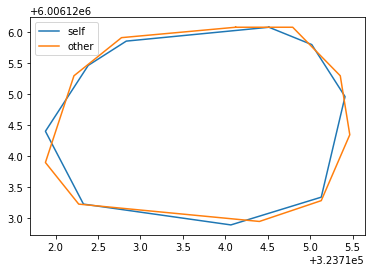

[[408 160]
 [407 161]
 [406 161]
 [405 161]
 [404 161]
 [403 161]
 [402 161]
 [401 162]
 [400 162]
 [399 162]
 [398 163]
 [397 164]
 [396 164]
 [395 165]
 [394 166]
 [393 166]
 [392 167]
 [391 168]
 [390 169]
 [389 169]
 [388 170]
 [387 171]
 [386 171]
 [385 172]
 [384 173]
 [383 173]
 [382 174]
 [381 175]
 [380 175]
 [379 176]
 [378 177]
 [377 178]
 [376 178]
 [375 179]
 [374 180]
 [373 181]
 [372 182]
 [372 183]
 [371 184]
 [371 185]
 [371 186]
 [370 187]
 [370 188]
 [370 189]
 [370 190]
 [370 191]
 [370 192]
 [369 193]
 [369 194]
 [369 195]
 [369 196]
 [369 197]
 [369 198]
 [369 199]
 [369 200]
 [369 201]
 [369 202]
 [369 203]
 [369 204]
 [369 205]
 [369 206]
 [369 207]
 [369 208]
 [369 209]
 [369 210]
 [369 211]
 [369 212]
 [369 213]
 [369 214]
 [369 215]
 [369 216]
 [369 217]
 [370 218]
 [370 219]
 [370 220]
 [370 221]
 [371 222]
 [371 223]
 [371 224]
 [372 225]
 [372 226]
 [373 227]
 [374 228]
 [375 229]
 [375 230]
 [376 231]
 [377 232]
 [378 233]
 [379 234]
 [380 234]
 [381 235]

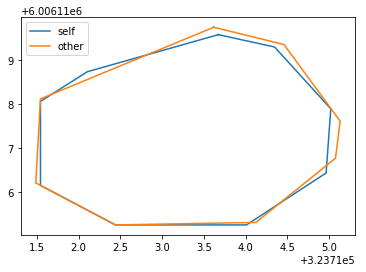

[[306 389]
 [305 390]
 [304 390]
 [303 390]
 [302 390]
 [301 390]
 [300 391]
 [299 391]
 [298 392]
 [297 392]
 [296 393]
 [295 394]
 [294 395]
 [293 396]
 [292 397]
 [291 398]
 [290 399]
 [289 400]
 [289 401]
 [288 402]
 [287 403]
 [287 404]
 [286 405]
 [286 406]
 [286 407]
 [285 408]
 [285 409]
 [284 410]
 [284 411]
 [284 412]
 [283 413]
 [283 414]
 [283 415]
 [283 416]
 [283 417]
 [282 418]
 [282 419]
 [282 420]
 [282 421]
 [282 422]
 [282 423]
 [281 424]
 [281 425]
 [282 426]
 [282 427]
 [282 428]
 [283 429]
 [283 430]
 [284 431]
 [285 432]
 [286 432]
 [287 432]
 [288 433]
 [289 433]
 [290 433]
 [291 434]
 [292 434]
 [293 434]
 [294 435]
 [295 436]
 [296 436]
 [297 436]
 [298 437]
 [299 437]
 [300 437]
 [301 437]
 [302 437]
 [303 438]
 [304 438]
 [305 438]
 [306 438]
 [307 438]
 [308 438]
 [309 438]
 [310 438]
 [311 438]
 [312 438]
 [313 438]
 [314 438]
 [315 438]
 [316 438]
 [317 438]
 [318 437]
 [319 437]
 [320 436]
 [321 436]
 [322 436]
 [323 435]
 [324 434]
 [325 433]
 [326 432]

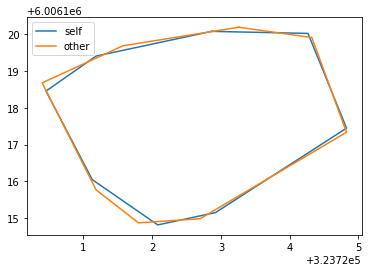

[[377 362]
 [376 363]
 [375 363]
 [374 363]
 [373 363]
 [372 363]
 [371 363]
 [370 363]
 [369 364]
 [368 364]
 [367 365]
 [366 365]
 [365 365]
 [364 366]
 [363 367]
 [362 368]
 [361 369]
 [360 369]
 [359 370]
 [358 371]
 [357 372]
 [356 373]
 [355 374]
 [354 375]
 [353 376]
 [352 377]
 [352 378]
 [351 379]
 [350 380]
 [350 381]
 [350 382]
 [349 383]
 [349 384]
 [348 385]
 [348 386]
 [348 387]
 [348 388]
 [347 389]
 [347 390]
 [347 391]
 [347 392]
 [347 393]
 [347 394]
 [347 395]
 [347 396]
 [347 397]
 [347 398]
 [348 399]
 [348 400]
 [348 401]
 [348 402]
 [349 403]
 [349 404]
 [350 405]
 [351 406]
 [352 407]
 [352 408]
 [353 408]
 [354 409]
 [355 410]
 [356 410]
 [357 411]
 [358 411]
 [359 412]
 [360 412]
 [361 413]
 [362 413]
 [363 413]
 [364 413]
 [365 414]
 [366 414]
 [367 414]
 [368 414]
 [369 414]
 [370 414]
 [371 414]
 [372 414]
 [373 414]
 [374 414]
 [375 414]
 [376 414]
 [377 414]
 [378 414]
 [379 413]
 [380 413]
 [381 413]
 [382 413]
 [383 412]
 [384 412]
 [385 412]
 [386 411]

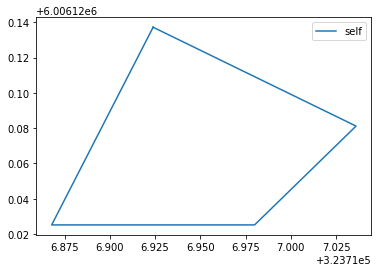

22it [00:37,  1.95s/it]

[[403  35]
 [402  36]
 [401  36]
 [400  36]
 [399  36]
 [398  37]
 [397  37]
 [396  38]
 [396  39]
 [395  40]
 [395  41]
 [395  42]
 [394  43]
 [394  44]
 [393  45]
 [393  46]
 [392  47]
 [392  48]
 [391  49]
 [391  50]
 [390  51]
 [389  52]
 [389  53]
 [389  54]
 [388  55]
 [388  56]
 [387  57]
 [387  58]
 [386  59]
 [386  60]
 [385  61]
 [384  62]
 [383  63]
 [382  64]
 [381  65]
 [381  66]
 [380  67]
 [379  68]
 [378  69]
 [377  70]
 [376  71]
 [375  72]
 [374  73]
 [374  74]
 [373  75]
 [372  76]
 [371  76]
 [370  77]
 [369  78]
 [369  79]
 [368  80]
 [368  81]
 [367  82]
 [367  83]
 [367  84]
 [366  85]
 [366  86]
 [366  87]
 [365  88]
 [365  89]
 [365  90]
 [365  91]
 [365  92]
 [364  93]
 [364  94]
 [364  95]
 [364  96]
 [364  97]
 [364  98]
 [364  99]
 [364 100]
 [364 101]
 [364 102]
 [364 103]
 [364 104]
 [364 105]
 [364 106]
 [364 107]
 [364 108]
 [364 109]
 [364 110]
 [364 111]
 [365 112]
 [365 113]
 [365 114]
 [365 115]
 [365 116]
 [365 117]
 [365 118]
 [365 119]
 [365 120]

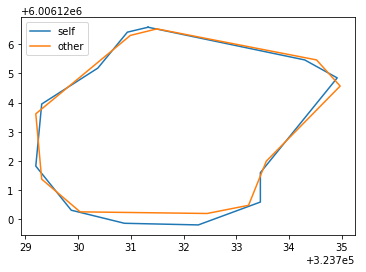

[[472  71]
 [471  72]
 [470  72]
 [469  72]
 [468  73]
 [467  74]
 [466  75]
 [466  76]
 [465  77]
 [464  78]
 [464  79]
 [463  80]
 [462  81]
 [462  82]
 [461  83]
 [461  84]
 [460  85]
 [459  86]
 [458  87]
 [458  88]
 [457  89]
 [457  90]
 [456  91]
 [455  92]
 [455  93]
 [454  94]
 [454  95]
 [453  96]
 [453  97]
 [452  98]
 [452  99]
 [451 100]
 [451 101]
 [451 102]
 [450 103]
 [450 104]
 [449 105]
 [449 106]
 [448 107]
 [447 108]
 [447 109]
 [446 110]
 [446 111]
 [446 112]
 [445 113]
 [445 114]
 [444 115]
 [444 116]
 [443 117]
 [443 118]
 [442 119]
 [442 120]
 [442 121]
 [441 122]
 [441 123]
 [441 124]
 [440 125]
 [440 126]
 [439 127]
 [439 128]
 [439 129]
 [439 130]
 [439 131]
 [439 132]
 [439 133]
 [439 134]
 [439 135]
 [439 136]
 [439 137]
 [439 138]
 [439 139]
 [439 140]
 [439 141]
 [439 142]
 [440 143]
 [441 143]
 [442 143]
 [443 144]
 [444 144]
 [445 144]
 [446 144]
 [447 144]
 [448 145]
 [449 145]
 [450 144]
 [451 144]
 [452 144]
 [453 144]
 [454 144]
 [455 144]
 [456 144]

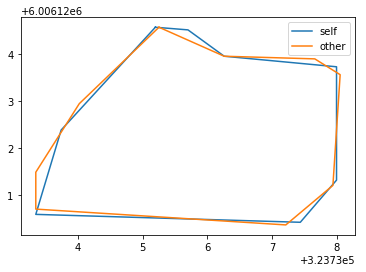

[[175 176]
 [174 177]
 [173 177]
 [172 177]
 [171 178]
 [170 178]
 [169 179]
 [168 180]
 [167 181]
 [167 182]
 [166 183]
 [165 184]
 [164 185]
 [163 186]
 [162 187]
 [161 188]
 [160 189]
 [159 190]
 [158 190]
 [157 191]
 [156 191]
 [155 192]
 [154 193]
 [153 194]
 [152 195]
 [151 196]
 [150 197]
 [149 198]
 [148 199]
 [148 200]
 [147 201]
 [146 202]
 [145 203]
 [145 204]
 [144 205]
 [144 206]
 [143 207]
 [143 208]
 [142 209]
 [142 210]
 [142 211]
 [142 212]
 [141 213]
 [141 214]
 [141 215]
 [141 216]
 [141 217]
 [141 218]
 [141 219]
 [140 220]
 [140 221]
 [140 222]
 [140 223]
 [140 224]
 [140 225]
 [140 226]
 [140 227]
 [140 228]
 [140 229]
 [140 230]
 [140 231]
 [140 232]
 [140 233]
 [140 234]
 [140 235]
 [140 236]
 [140 237]
 [140 238]
 [140 239]
 [140 240]
 [140 241]
 [141 242]
 [141 243]
 [141 244]
 [141 245]
 [141 246]
 [141 247]
 [141 248]
 [142 249]
 [142 250]
 [142 251]
 [142 252]
 [142 253]
 [143 254]
 [143 255]
 [143 256]
 [143 257]
 [144 258]
 [144 259]
 [144 260]
 [144 261]

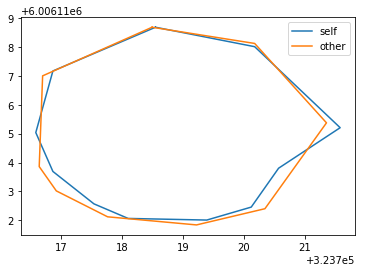

[[210 360]
 [209 361]
 [208 361]
 [207 361]
 [206 361]
 [205 362]
 [204 362]
 [203 362]
 [202 363]
 [201 363]
 [200 364]
 [199 364]
 [198 365]
 [197 366]
 [196 367]
 [195 368]
 [194 368]
 [193 369]
 [192 370]
 [191 371]
 [190 372]
 [189 373]
 [188 374]
 [187 375]
 [187 376]
 [186 377]
 [186 378]
 [185 379]
 [184 380]
 [183 380]
 [182 380]
 [181 380]
 [180 380]
 [179 380]
 [178 381]
 [177 382]
 [177 383]
 [176 384]
 [176 385]
 [175 386]
 [175 387]
 [175 388]
 [175 389]
 [175 390]
 [175 391]
 [175 392]
 [174 393]
 [174 394]
 [173 395]
 [172 394]
 [171 394]
 [170 394]
 [169 394]
 [168 394]
 [167 395]
 [167 396]
 [166 397]
 [166 398]
 [166 399]
 [165 400]
 [164 401]
 [164 402]
 [163 403]
 [162 404]
 [161 405]
 [160 406]
 [160 407]
 [159 408]
 [158 409]
 [158 410]
 [157 411]
 [157 412]
 [157 413]
 [157 414]
 [157 415]
 [157 416]
 [156 417]
 [156 418]
 [156 419]
 [155 420]
 [155 421]
 [155 422]
 [154 423]
 [155 424]
 [155 425]
 [155 426]
 [155 427]
 [155 428]
 [156 429]
 [156 430]
 [156 431]

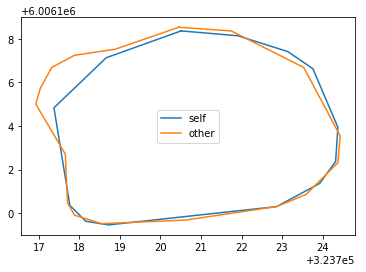

[[310  34]
 [309  35]
 [308  35]
 [307  35]
 [306  35]
 [305  36]
 [304  36]
 [303  36]
 [302  36]
 [301  36]
 [300  37]
 [299  37]
 [298  37]
 [297  37]
 [296  38]
 [295  38]
 [294  38]
 [293  38]
 [292  39]
 [291  39]
 [290  39]
 [289  39]
 [288  40]
 [287  40]
 [286  40]
 [285  41]
 [284  41]
 [283  41]
 [282  42]
 [281  42]
 [280  42]
 [279  42]
 [278  43]
 [277  43]
 [276  43]
 [275  44]
 [274  44]
 [273  44]
 [272  45]
 [271  46]
 [270  46]
 [269  47]
 [268  48]
 [267  49]
 [267  50]
 [266  51]
 [266  52]
 [265  53]
 [265  54]
 [264  55]
 [264  56]
 [264  57]
 [263  58]
 [263  59]
 [263  60]
 [263  61]
 [263  62]
 [263  63]
 [263  64]
 [263  65]
 [262  66]
 [262  67]
 [262  68]
 [262  69]
 [262  70]
 [262  71]
 [262  72]
 [262  73]
 [262  74]
 [262  75]
 [262  76]
 [262  77]
 [262  78]
 [262  79]
 [262  80]
 [262  81]
 [262  82]
 [262  83]
 [262  84]
 [262  85]
 [262  86]
 [262  87]
 [262  88]
 [262  89]
 [262  90]
 [262  91]
 [263  92]
 [263  93]
 [263  94]
 [263  95]
 [264  96]

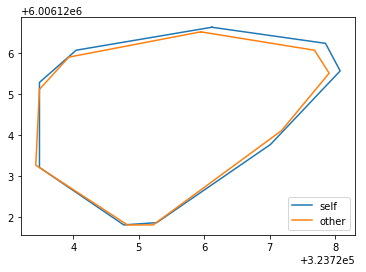

[[216  20]
 [215  21]
 [214  21]
 [213  21]
 [212  22]
 [211  22]
 [210  23]
 [209  23]
 [208  24]
 [207  24]
 [206  25]
 [205  26]
 [204  27]
 [203  28]
 [202  29]
 [201  30]
 [200  31]
 [199  32]
 [198  33]
 [197  34]
 [196  35]
 [196  36]
 [195  37]
 [194  38]
 [193  39]
 [193  40]
 [192  41]
 [192  42]
 [191  43]
 [191  44]
 [191  45]
 [190  46]
 [190  47]
 [189  48]
 [189  49]
 [189  50]
 [188  51]
 [188  52]
 [188  53]
 [187  54]
 [187  55]
 [187  56]
 [187  57]
 [187  58]
 [187  59]
 [187  60]
 [187  61]
 [187  62]
 [187  63]
 [187  64]
 [187  65]
 [187  66]
 [187  67]
 [187  68]
 [187  69]
 [188  70]
 [188  71]
 [188  72]
 [188  73]
 [189  74]
 [189  75]
 [189  76]
 [189  77]
 [189  78]
 [190  79]
 [190  80]
 [191  81]
 [191  82]
 [191  83]
 [192  84]
 [192  85]
 [193  86]
 [193  87]
 [194  88]
 [195  89]
 [196  90]
 [197  91]
 [197  92]
 [198  93]
 [199  94]
 [200  94]
 [201  95]
 [202  96]
 [203  97]
 [204  98]
 [205  99]
 [206 100]
 [207 101]
 [208 101]
 [209 102]
 [210 102]

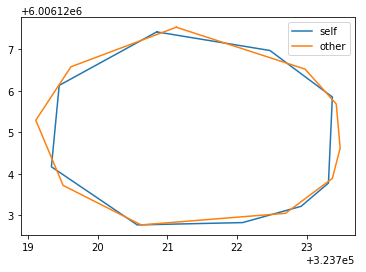

[[250 505]
 [249 506]
 [248 506]
 [247 506]
 [246 506]
 [245 506]
 [244 506]
 [243 507]
 [242 507]
 [241 507]
 [240 507]
 [239 507]
 [238 508]
 [237 508]
 [236 508]
 [235 508]
 [234 509]
 [233 509]
 [232 509]
 [231 509]
 [230 510]
 [229 510]
 [228 510]
 [227 510]
 [226 510]
 [225 511]
 [224 511]
 [223 511]
 [222 511]
 [221 512]
 [220 512]
 [219 512]
 [218 512]
 [217 512]
 [216 512]
 [215 513]
 [214 513]
 [213 513]
 [212 513]
 [211 514]
 [210 514]
 [209 514]
 [208 514]
 [207 514]
 [206 514]
 [205 514]
 [204 514]
 [203 515]
 [202 515]
 [201 515]
 [200 515]
 [199 515]
 [198 515]
 [197 516]
 [196 516]
 [195 516]
 [194 516]
 [193 516]
 [192 516]
 [191 516]
 [190 516]
 [189 516]
 [188 517]
 [187 517]
 [186 517]
 [185 517]
 [184 517]
 [183 517]
 [182 517]
 [181 517]
 [180 517]
 [179 518]
 [178 518]
 [177 518]
 [176 518]
 [175 518]
 [174 518]
 [173 519]
 [172 519]
 [171 519]
 [170 519]
 [169 520]
 [168 520]
 [167 520]
 [166 521]
 [165 521]
 [164 522]
 [163 522]
 [162 523]
 [161 523]
 [160 524]

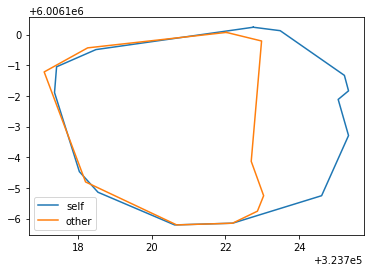

[[102  44]
 [101  45]
 [100  45]
 [ 99  45]
 [ 98  45]
 [ 97  45]
 [ 96  45]
 [ 95  45]
 [ 94  45]
 [ 93  45]
 [ 92  46]
 [ 91  46]
 [ 90  46]
 [ 89  46]
 [ 88  46]
 [ 87  46]
 [ 86  46]
 [ 85  46]
 [ 84  46]
 [ 83  46]
 [ 82  46]
 [ 81  46]
 [ 80  46]
 [ 79  46]
 [ 78  46]
 [ 77  47]
 [ 76  47]
 [ 75  47]
 [ 74  48]
 [ 73  48]
 [ 72  48]
 [ 71  49]
 [ 70  50]
 [ 70  51]
 [ 69  52]
 [ 68  53]
 [ 67  53]
 [ 66  54]
 [ 65  55]
 [ 64  56]
 [ 63  57]
 [ 62  58]
 [ 62  59]
 [ 61  60]
 [ 61  61]
 [ 60  62]
 [ 59  63]
 [ 59  64]
 [ 58  65]
 [ 58  66]
 [ 57  67]
 [ 57  68]
 [ 57  69]
 [ 56  70]
 [ 56  71]
 [ 55  72]
 [ 55  73]
 [ 55  74]
 [ 55  75]
 [ 55  76]
 [ 54  77]
 [ 54  78]
 [ 54  79]
 [ 54  80]
 [ 54  81]
 [ 54  82]
 [ 55  83]
 [ 55  84]
 [ 55  85]
 [ 56  86]
 [ 56  87]
 [ 57  88]
 [ 57  89]
 [ 58  90]
 [ 58  91]
 [ 59  92]
 [ 60  93]
 [ 61  94]
 [ 62  94]
 [ 63  95]
 [ 64  96]
 [ 65  96]
 [ 66  97]
 [ 67  97]
 [ 68  98]
 [ 69  98]
 [ 70  98]
 [ 71  99]
 [ 72  99]
 [ 73  99]
 [ 74 100]

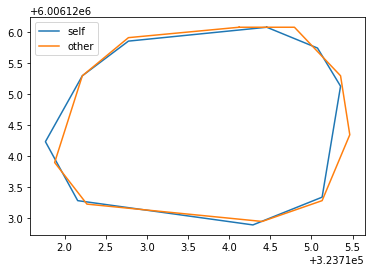

[[287 205]
 [286 206]
 [285 206]
 [284 206]
 [283 207]
 [282 207]
 [281 207]
 [280 208]
 [279 208]
 [278 209]
 [277 210]
 [276 211]
 [275 211]
 [274 212]
 [273 213]
 [272 214]
 [271 215]
 [270 216]
 [269 216]
 [268 217]
 [268 218]
 [267 219]
 [266 220]
 [265 221]
 [265 222]
 [264 223]
 [263 224]
 [262 225]
 [261 225]
 [260 226]
 [259 227]
 [259 228]
 [258 229]
 [257 230]
 [256 231]
 [256 232]
 [255 233]
 [254 234]
 [253 234]
 [252 235]
 [251 236]
 [250 237]
 [249 238]
 [248 239]
 [247 240]
 [246 241]
 [245 242]
 [244 243]
 [244 244]
 [243 245]
 [243 246]
 [243 247]
 [243 248]
 [243 249]
 [242 250]
 [242 251]
 [242 252]
 [241 253]
 [241 254]
 [241 255]
 [241 256]
 [241 257]
 [241 258]
 [241 259]
 [241 260]
 [241 261]
 [241 262]
 [241 263]
 [241 264]
 [241 265]
 [241 266]
 [241 267]
 [241 268]
 [241 269]
 [241 270]
 [241 271]
 [241 272]
 [241 273]
 [241 274]
 [241 275]
 [242 276]
 [242 277]
 [242 278]
 [242 279]
 [242 280]
 [243 281]
 [243 282]
 [243 283]
 [244 284]
 [244 285]
 [244 286]

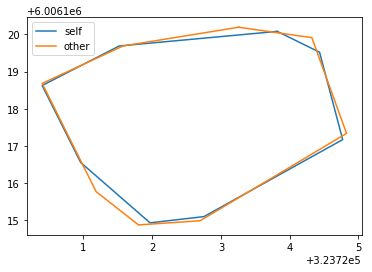

[[547 400]
 [546 401]
 [545 401]
 [544 401]
 [543 402]
 [542 403]
 [541 404]
 [540 405]
 [540 406]
 [539 407]
 [539 408]
 [538 409]
 [538 410]
 [537 411]
 [537 412]
 [536 413]
 [536 414]
 [535 415]
 [535 416]
 [534 417]
 [534 418]
 [533 419]
 [533 420]
 [533 421]
 [532 422]
 [532 423]
 [532 424]
 [531 425]
 [531 426]
 [531 427]
 [530 428]
 [530 429]
 [530 430]
 [530 431]
 [529 432]
 [529 433]
 [529 434]
 [529 435]
 [530 436]
 [530 437]
 [530 438]
 [530 439]
 [530 440]
 [531 441]
 [531 442]
 [531 443]
 [532 444]
 [532 445]
 [533 446]
 [533 447]
 [534 448]
 [535 449]
 [536 450]
 [537 451]
 [538 452]
 [539 453]
 [540 454]
 [541 455]
 [542 455]
 [543 456]
 [544 456]
 [545 457]
 [546 458]
 [547 458]
 [548 459]
 [549 460]
 [550 460]
 [551 461]
 [552 462]
 [553 462]
 [554 463]
 [555 463]
 [556 464]
 [557 464]
 [558 465]
 [559 465]
 [560 466]
 [561 466]
 [562 467]
 [563 467]
 [564 467]
 [565 468]
 [566 468]
 [567 468]
 [568 468]
 [569 468]
 [570 469]
 [571 469]
 [572 469]
 [573 469]
 [574 469]

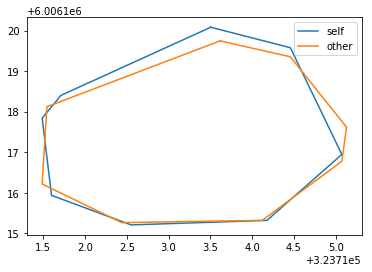

[[586  80]
 [585  81]
 [584  81]
 [583  81]
 [582  81]
 [581  81]
 [580  81]
 [579  81]
 [578  81]
 [577  81]
 [576  81]
 [575  81]
 [574  81]
 [573  81]
 [572  82]
 [571  82]
 [570  82]
 [569  82]
 [568  82]
 [567  82]
 [566  82]
 [565  82]
 [564  83]
 [563  83]
 [562  83]
 [561  83]
 [560  83]
 [559  83]
 [558  83]
 [557  83]
 [556  83]
 [555  83]
 [554  83]
 [553  84]
 [552  84]
 [551  84]
 [550  84]
 [549  84]
 [548  84]
 [547  84]
 [546  84]
 [545  84]
 [544  84]
 [543  84]
 [542  84]
 [541  84]
 [540  85]
 [539  85]
 [538  85]
 [537  85]
 [536  85]
 [535  85]
 [534  86]
 [533  86]
 [532  87]
 [531  87]
 [530  88]
 [530  89]
 [529  90]
 [528  91]
 [528  92]
 [528  93]
 [527  94]
 [527  95]
 [527  96]
 [527  97]
 [526  98]
 [526  99]
 [526 100]
 [526 101]
 [525 102]
 [525 103]
 [525 104]
 [525 105]
 [525 106]
 [525 107]
 [525 108]
 [525 109]
 [524 110]
 [524 111]
 [524 112]
 [524 113]
 [524 114]
 [524 115]
 [524 116]
 [524 117]
 [524 118]
 [524 119]
 [524 120]
 [524 121]
 [524 122]

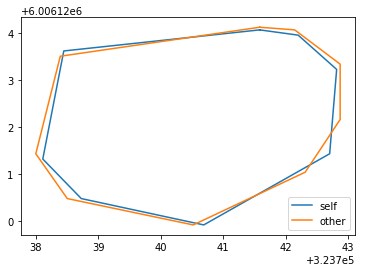

[[552  16]
 [551  17]
 [550  17]
 [549  18]
 [549  19]
 [548  20]
 [548  21]
 [547  22]
 [547  23]
 [546  24]
 [546  25]
 [545  26]
 [545  27]
 [544  28]
 [543  29]
 [543  30]
 [542  31]
 [541  32]
 [541  33]
 [540  34]
 [540  35]
 [539  36]
 [538  37]
 [537  38]
 [537  39]
 [536  40]
 [535  41]
 [534  42]
 [534  43]
 [533  44]
 [532  45]
 [531  46]
 [530  47]
 [530  48]
 [529  49]
 [529  50]
 [528  51]
 [528  52]
 [528  53]
 [528  54]
 [528  55]
 [528  56]
 [527  57]
 [527  58]
 [527  59]
 [527  60]
 [527  61]
 [527  62]
 [527  63]
 [527  64]
 [527  65]
 [527  66]
 [527  67]
 [527  68]
 [527  69]
 [527  70]
 [527  71]
 [527  72]
 [527  73]
 [527  74]
 [527  75]
 [527  76]
 [527  77]
 [528  78]
 [528  79]
 [528  80]
 [528  81]
 [528  82]
 [529  82]
 [530  83]
 [531  83]
 [532  83]
 [533  84]
 [534  84]
 [535  84]
 [536  84]
 [537  85]
 [538  85]
 [539  85]
 [540  85]
 [541  85]
 [542  85]
 [543  84]
 [544  84]
 [545  84]
 [546  84]
 [547  84]
 [548  84]
 [549  84]
 [550  84]
 [551  84]

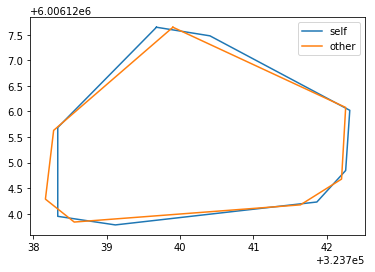

[[493 430]
 [492 431]
 [491 432]
 [490 432]
 [489 433]
 [488 434]
 [487 434]
 [486 435]
 [485 435]
 [484 436]
 [483 436]
 [482 437]
 [482 438]
 [481 439]
 [480 440]
 [479 441]
 [478 442]
 [478 443]
 [477 444]
 [476 445]
 [476 446]
 [475 447]
 [474 448]
 [474 449]
 [473 450]
 [472 451]
 [472 452]
 [471 453]
 [471 454]
 [471 455]
 [470 456]
 [470 457]
 [469 458]
 [469 459]
 [468 460]
 [468 461]
 [467 462]
 [466 463]
 [465 463]
 [464 463]
 [463 464]
 [462 465]
 [462 466]
 [462 467]
 [462 468]
 [462 469]
 [462 470]
 [462 471]
 [462 472]
 [461 473]
 [461 474]
 [461 475]
 [461 476]
 [461 477]
 [461 478]
 [461 479]
 [461 480]
 [461 481]
 [461 482]
 [461 483]
 [461 484]
 [461 485]
 [462 486]
 [462 487]
 [462 488]
 [462 489]
 [463 490]
 [464 491]
 [464 492]
 [465 493]
 [465 494]
 [465 495]
 [466 496]
 [466 497]
 [467 498]
 [468 499]
 [469 500]
 [469 501]
 [470 502]
 [470 503]
 [471 504]
 [472 505]
 [472 506]
 [473 507]
 [474 508]
 [474 509]
 [475 510]
 [476 511]
 [476 512]
 [477 513]
 [478 514]

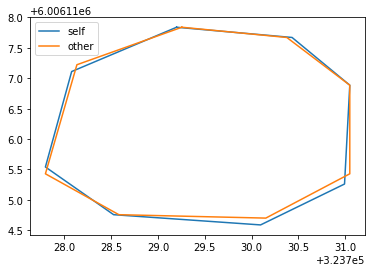

[[569 189]
 [568 190]
 [567 190]
 [566 190]
 [565 190]
 [564 191]
 [563 191]
 [562 191]
 [561 192]
 [560 192]
 [559 193]
 [558 193]
 [557 194]
 [556 194]
 [555 194]
 [554 195]
 [553 195]
 [552 195]
 [551 196]
 [550 196]
 [549 196]
 [548 197]
 [547 197]
 [546 197]
 [545 198]
 [544 199]
 [543 200]
 [542 200]
 [541 200]
 [540 200]
 [539 201]
 [538 201]
 [537 202]
 [536 203]
 [535 204]
 [534 205]
 [534 206]
 [533 207]
 [532 208]
 [532 209]
 [531 210]
 [531 211]
 [530 212]
 [530 213]
 [529 214]
 [529 215]
 [529 216]
 [528 217]
 [528 218]
 [528 219]
 [527 220]
 [527 221]
 [527 222]
 [526 223]
 [526 224]
 [526 225]
 [526 226]
 [526 227]
 [525 228]
 [525 229]
 [525 230]
 [525 231]
 [525 232]
 [525 233]
 [525 234]
 [525 235]
 [524 236]
 [524 237]
 [524 238]
 [524 239]
 [524 240]
 [524 241]
 [524 242]
 [524 243]
 [524 244]
 [525 245]
 [525 246]
 [525 247]
 [525 248]
 [525 249]
 [525 250]
 [525 251]
 [526 252]
 [526 253]
 [526 254]
 [526 255]
 [527 256]
 [527 257]
 [528 258]
 [528 259]
 [529 260]

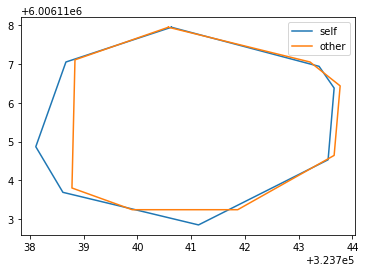

[[147  80]
 [146  81]
 [145  81]
 [144  81]
 [143  81]
 [142  81]
 [141  81]
 [140  82]
 [139  82]
 [138  82]
 [137  83]
 [136  83]
 [135  84]
 [134  85]
 [133  86]
 [132  87]
 [131  87]
 [131  88]
 [130  89]
 [130  90]
 [129  91]
 [129  92]
 [129  93]
 [128  94]
 [128  95]
 [128  96]
 [128  97]
 [128  98]
 [128  99]
 [128 100]
 [128 101]
 [128 102]
 [128 103]
 [128 104]
 [128 105]
 [129 106]
 [129 107]
 [129 108]
 [129 109]
 [129 110]
 [129 111]
 [129 112]
 [129 113]
 [129 114]
 [129 115]
 [129 116]
 [129 117]
 [129 118]
 [129 119]
 [129 120]
 [129 121]
 [130 122]
 [130 123]
 [129 124]
 [129 125]
 [128 126]
 [128 127]
 [128 128]
 [129 129]
 [128 130]
 [127 131]
 [126 132]
 [125 133]
 [125 134]
 [125 135]
 [125 136]
 [126 136]
 [127 137]
 [128 138]
 [129 139]
 [130 139]
 [131 138]
 [132 139]
 [133 140]
 [134 141]
 [134 142]
 [134 143]
 [133 144]
 [132 145]
 [131 145]
 [130 145]
 [129 144]
 [129 145]
 [129 146]
 [129 147]
 [130 147]
 [131 147]
 [132 147]
 [133 148]
 [133 149]
 [132 150]

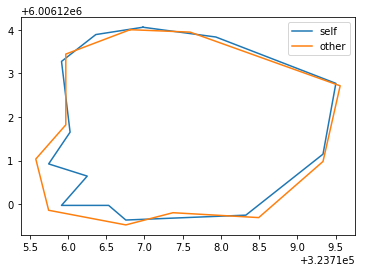

23it [00:39,  2.01s/it]

[[ 82  35]
 [ 81  36]
 [ 80  36]
 [ 79  36]
 [ 78  37]
 [ 77  37]
 [ 77  38]
 [ 76  39]
 [ 76  40]
 [ 76  41]
 [ 75  42]
 [ 75  43]
 [ 74  44]
 [ 74  45]
 [ 73  46]
 [ 73  47]
 [ 72  48]
 [ 72  49]
 [ 71  50]
 [ 70  51]
 [ 70  52]
 [ 69  53]
 [ 69  54]
 [ 69  55]
 [ 68  56]
 [ 68  57]
 [ 67  58]
 [ 67  59]
 [ 66  60]
 [ 65  61]
 [ 64  62]
 [ 63  63]
 [ 62  64]
 [ 61  65]
 [ 61  66]
 [ 60  67]
 [ 59  68]
 [ 58  69]
 [ 57  70]
 [ 56  71]
 [ 56  72]
 [ 55  73]
 [ 54  74]
 [ 53  75]
 [ 52  75]
 [ 51  76]
 [ 50  77]
 [ 49  78]
 [ 49  79]
 [ 48  80]
 [ 48  81]
 [ 47  82]
 [ 47  83]
 [ 46  84]
 [ 46  85]
 [ 45  86]
 [ 45  87]
 [ 45  88]
 [ 45  89]
 [ 44  90]
 [ 44  91]
 [ 44  92]
 [ 44  93]
 [ 44  94]
 [ 44  95]
 [ 44  96]
 [ 44  97]
 [ 44  98]
 [ 44  99]
 [ 44 100]
 [ 44 101]
 [ 44 102]
 [ 44 103]
 [ 44 104]
 [ 44 105]
 [ 44 106]
 [ 44 107]
 [ 44 108]
 [ 44 109]
 [ 44 110]
 [ 44 111]
 [ 44 112]
 [ 44 113]
 [ 44 114]
 [ 45 115]
 [ 45 116]
 [ 45 117]
 [ 45 118]
 [ 45 119]
 [ 45 120]
 [ 45 121]

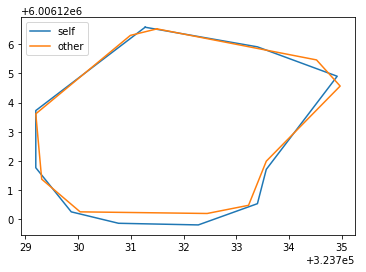

[[153  71]
 [152  72]
 [151  72]
 [150  72]
 [149  73]
 [148  73]
 [147  74]
 [146  75]
 [146  76]
 [145  77]
 [144  78]
 [144  79]
 [143  80]
 [142  81]
 [141  82]
 [141  83]
 [140  84]
 [140  85]
 [139  86]
 [139  87]
 [138  88]
 [137  89]
 [137  90]
 [136  91]
 [136  92]
 [135  93]
 [135  94]
 [134  95]
 [134  96]
 [133  97]
 [133  98]
 [132  99]
 [131 100]
 [131 101]
 [131 102]
 [130 103]
 [130 104]
 [129 105]
 [129 106]
 [128 107]
 [128 108]
 [127 109]
 [127 110]
 [126 111]
 [126 112]
 [126 113]
 [125 114]
 [125 115]
 [124 116]
 [124 117]
 [124 118]
 [123 119]
 [123 120]
 [122 121]
 [122 122]
 [121 123]
 [121 124]
 [121 125]
 [120 126]
 [120 127]
 [119 128]
 [119 129]
 [119 130]
 [118 131]
 [118 132]
 [118 133]
 [118 134]
 [118 135]
 [118 136]
 [118 137]
 [118 138]
 [118 139]
 [118 140]
 [118 141]
 [118 142]
 [119 142]
 [120 143]
 [121 143]
 [122 144]
 [123 144]
 [124 144]
 [125 145]
 [126 145]
 [127 145]
 [128 145]
 [129 145]
 [130 145]
 [131 144]
 [132 144]
 [133 144]
 [134 144]

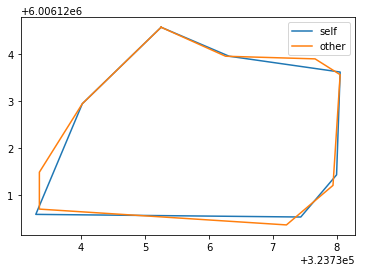

[[525  49]
 [524  50]
 [523  50]
 [522  50]
 [521  50]
 [520  50]
 [519  50]
 [518  50]
 [517  50]
 [516  50]
 [515  50]
 [514  50]
 [513  51]
 [512  51]
 [511  51]
 [510  51]
 [509  52]
 [508  52]
 [507  53]
 [506  53]
 [505  54]
 [504  55]
 [504  56]
 [504  57]
 [504  58]
 [503  59]
 [503  60]
 [503  61]
 [503  62]
 [503  63]
 [503  64]
 [502  65]
 [502  66]
 [502  67]
 [502  68]
 [502  69]
 [501  70]
 [501  71]
 [501  72]
 [501  73]
 [501  74]
 [501  75]
 [500  76]
 [500  77]
 [500  78]
 [500  79]
 [500  80]
 [500  81]
 [499  82]
 [499  83]
 [499  84]
 [499  85]
 [499  86]
 [499  87]
 [499  88]
 [499  89]
 [498  90]
 [498  91]
 [498  92]
 [498  93]
 [498  94]
 [498  95]
 [498  96]
 [498  97]
 [498  98]
 [499  99]
 [499 100]
 [499 101]
 [499 102]
 [499 103]
 [499 104]
 [500 105]
 [500 106]
 [500 107]
 [500 108]
 [500 109]
 [501 110]
 [501 111]
 [501 112]
 [502 113]
 [502 114]
 [503 115]
 [504 116]
 [504 117]
 [505 118]
 [506 119]
 [506 120]
 [507 121]
 [508 122]
 [509 123]
 [510 124]

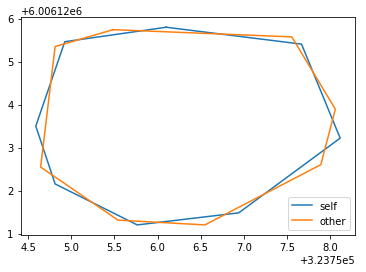

[[246 189]
 [245 190]
 [244 190]
 [243 190]
 [242 190]
 [241 191]
 [240 191]
 [239 192]
 [238 193]
 [237 193]
 [236 194]
 [235 194]
 [234 195]
 [233 195]
 [232 195]
 [231 196]
 [230 196]
 [229 196]
 [228 196]
 [227 197]
 [226 197]
 [225 197]
 [224 197]
 [223 198]
 [222 198]
 [221 199]
 [220 199]
 [219 200]
 [218 200]
 [217 201]
 [216 202]
 [215 203]
 [214 204]
 [213 205]
 [212 206]
 [212 207]
 [211 208]
 [211 209]
 [211 210]
 [210 211]
 [210 212]
 [210 213]
 [209 214]
 [209 215]
 [208 216]
 [208 217]
 [207 218]
 [207 219]
 [207 220]
 [206 221]
 [206 222]
 [206 223]
 [205 224]
 [205 225]
 [205 226]
 [205 227]
 [205 228]
 [204 229]
 [204 230]
 [204 231]
 [204 232]
 [204 233]
 [204 234]
 [204 235]
 [204 236]
 [204 237]
 [204 238]
 [204 239]
 [204 240]
 [204 241]
 [204 242]
 [204 243]
 [204 244]
 [204 245]
 [204 246]
 [204 247]
 [204 248]
 [204 249]
 [204 250]
 [205 251]
 [205 252]
 [205 253]
 [206 254]
 [206 255]
 [207 256]
 [207 257]
 [208 258]
 [209 259]
 [209 260]
 [210 261]
 [211 262]

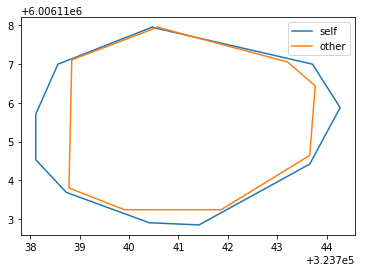

[[483 164]
 [482 165]
 [481 165]
 [480 165]
 [479 165]
 [478 165]
 [477 165]
 [476 165]
 [475 166]
 [474 166]
 [473 167]
 [472 167]
 [471 167]
 [470 168]
 [469 168]
 [468 168]
 [467 169]
 [466 169]
 [465 170]
 [464 171]
 [463 171]
 [462 172]
 [461 172]
 [460 173]
 [459 173]
 [458 174]
 [457 174]
 [456 175]
 [455 176]
 [454 176]
 [453 177]
 [452 177]
 [451 177]
 [450 178]
 [449 178]
 [448 179]
 [447 179]
 [446 180]
 [445 181]
 [444 182]
 [443 183]
 [442 184]
 [441 185]
 [440 186]
 [439 187]
 [438 188]
 [438 189]
 [437 190]
 [436 191]
 [436 192]
 [436 193]
 [435 194]
 [435 195]
 [435 196]
 [435 197]
 [435 198]
 [435 199]
 [435 200]
 [434 201]
 [434 202]
 [434 203]
 [435 204]
 [435 205]
 [435 206]
 [435 207]
 [434 208]
 [434 209]
 [434 210]
 [434 211]
 [434 212]
 [434 213]
 [433 214]
 [433 215]
 [433 216]
 [433 217]
 [433 218]
 [433 219]
 [433 220]
 [433 221]
 [433 222]
 [433 223]
 [433 224]
 [434 225]
 [434 226]
 [434 227]
 [434 228]
 [434 229]
 [434 230]
 [434 231]
 [434 232]
 [434 233]

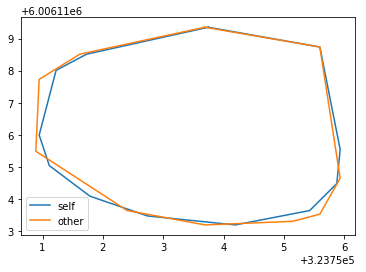

[[501 562]
 [500 563]
 [499 563]
 [498 563]
 [497 564]
 [496 564]
 [495 565]
 [494 565]
 [493 566]
 [492 566]
 [491 567]
 [490 568]
 [489 569]
 [488 570]
 [488 571]
 [487 572]
 [486 573]
 [486 574]
 [485 575]
 [485 576]
 [484 577]
 [484 578]
 [484 579]
 [484 580]
 [483 581]
 [483 582]
 [483 583]
 [483 584]
 [483 585]
 [483 586]
 [483 587]
 [482 588]
 [482 589]
 [482 590]
 [482 591]
 [482 592]
 [482 593]
 [483 594]
 [483 595]
 [483 596]
 [483 597]
 [483 598]
 [484 599]
 [484 600]
 [484 601]
 [485 602]
 [485 603]
 [486 604]
 [487 605]
 [488 606]
 [489 607]
 [490 607]
 [491 608]
 [492 608]
 [493 608]
 [494 608]
 [495 608]
 [496 608]
 [497 608]
 [498 608]
 [499 608]
 [500 608]
 [501 608]
 [502 608]
 [503 608]
 [504 608]
 [505 608]
 [506 608]
 [507 608]
 [508 608]
 [509 607]
 [510 607]
 [511 607]
 [512 607]
 [513 606]
 [514 606]
 [515 606]
 [516 605]
 [517 604]
 [518 603]
 [519 602]
 [519 601]
 [520 600]
 [521 599]
 [521 598]
 [521 597]
 [522 596]
 [522 595]
 [522 594]
 [522 593]
 [523 592]

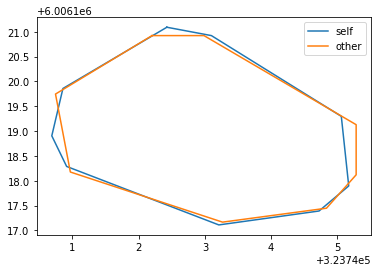

[[565 100]
 [564 101]
 [563 101]
 [562 101]
 [561 102]
 [560 102]
 [559 103]
 [558 104]
 [557 105]
 [556 106]
 [555 107]
 [555 108]
 [554 109]
 [553 110]
 [553 111]
 [552 112]
 [551 113]
 [550 114]
 [550 115]
 [549 116]
 [548 117]
 [547 118]
 [546 119]
 [546 120]
 [545 121]
 [545 122]
 [544 123]
 [543 124]
 [543 125]
 [542 126]
 [541 127]
 [541 128]
 [540 129]
 [540 130]
 [540 131]
 [539 132]
 [539 133]
 [539 134]
 [539 135]
 [539 136]
 [538 137]
 [538 138]
 [538 139]
 [538 140]
 [539 141]
 [539 142]
 [539 143]
 [539 144]
 [540 145]
 [540 146]
 [540 147]
 [541 148]
 [542 149]
 [542 150]
 [543 151]
 [544 152]
 [545 153]
 [546 154]
 [547 154]
 [548 155]
 [549 155]
 [550 156]
 [551 156]
 [552 156]
 [553 157]
 [554 157]
 [555 157]
 [556 157]
 [557 157]
 [558 158]
 [559 158]
 [560 158]
 [561 158]
 [562 158]
 [563 159]
 [564 159]
 [565 159]
 [566 159]
 [567 160]
 [568 160]
 [569 160]
 [570 161]
 [571 161]
 [572 161]
 [573 162]
 [574 162]
 [575 162]
 [576 162]
 [577 163]
 [578 163]
 [579 163]

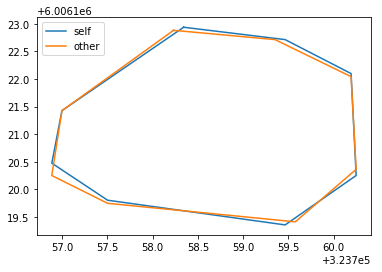

[[270 474]
 [269 475]
 [268 475]
 [267 475]
 [266 475]
 [265 475]
 [264 475]
 [263 475]
 [262 475]
 [261 476]
 [260 476]
 [259 477]
 [258 478]
 [257 479]
 [256 480]
 [256 481]
 [255 482]
 [255 483]
 [254 484]
 [254 485]
 [253 486]
 [253 487]
 [253 488]
 [252 489]
 [252 490]
 [252 491]
 [251 492]
 [251 493]
 [251 494]
 [251 495]
 [250 496]
 [250 497]
 [250 498]
 [249 499]
 [249 500]
 [249 501]
 [248 502]
 [248 503]
 [248 504]
 [248 505]
 [248 506]
 [248 507]
 [248 508]
 [248 509]
 [248 510]
 [248 511]
 [248 512]
 [248 513]
 [248 514]
 [248 515]
 [248 516]
 [248 517]
 [248 518]
 [248 519]
 [248 520]
 [248 521]
 [248 522]
 [248 523]
 [248 524]
 [248 525]
 [248 526]
 [248 527]
 [248 528]
 [248 529]
 [248 530]
 [248 531]
 [249 532]
 [249 533]
 [249 534]
 [249 535]
 [249 536]
 [250 537]
 [250 538]
 [250 539]
 [251 540]
 [251 541]
 [252 542]
 [252 543]
 [253 544]
 [254 545]
 [254 546]
 [255 547]
 [255 548]
 [256 549]
 [256 550]
 [257 550]
 [258 551]
 [259 552]
 [260 553]
 [261 554]
 [262 555]

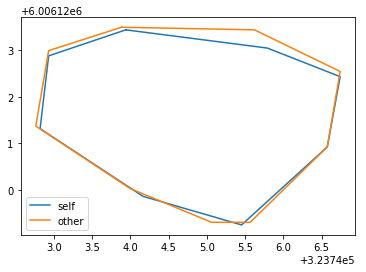

[[227 400]
 [226 401]
 [225 402]
 [224 402]
 [223 403]
 [222 403]
 [221 404]
 [221 405]
 [220 406]
 [219 407]
 [219 408]
 [218 409]
 [218 410]
 [217 411]
 [217 412]
 [216 413]
 [216 414]
 [215 415]
 [215 416]
 [214 417]
 [214 418]
 [214 419]
 [213 420]
 [213 421]
 [212 422]
 [212 423]
 [211 424]
 [211 425]
 [211 426]
 [211 427]
 [210 428]
 [210 429]
 [210 430]
 [210 431]
 [210 432]
 [210 433]
 [210 434]
 [209 435]
 [210 436]
 [210 437]
 [210 438]
 [210 439]
 [210 440]
 [210 441]
 [211 442]
 [211 443]
 [211 444]
 [212 445]
 [212 446]
 [213 447]
 [213 448]
 [214 449]
 [215 450]
 [216 451]
 [217 452]
 [218 453]
 [219 454]
 [220 455]
 [221 455]
 [222 456]
 [223 457]
 [224 458]
 [225 458]
 [226 459]
 [227 460]
 [228 460]
 [229 461]
 [230 462]
 [231 462]
 [232 462]
 [233 463]
 [234 463]
 [235 464]
 [236 464]
 [237 465]
 [238 465]
 [239 466]
 [240 466]
 [241 466]
 [242 467]
 [243 467]
 [244 467]
 [245 467]
 [246 468]
 [247 468]
 [248 468]
 [249 468]
 [250 468]
 [251 468]
 [252 468]
 [253 468]

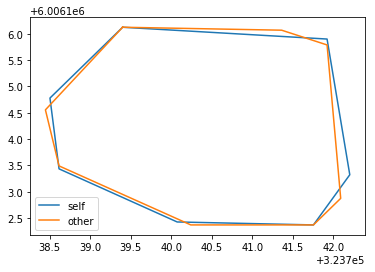

[[254  81]
 [253  82]
 [252  82]
 [251  82]
 [250  82]
 [249  82]
 [248  82]
 [247  82]
 [246  82]
 [245  82]
 [244  82]
 [243  82]
 [242  83]
 [241  83]
 [240  83]
 [239  83]
 [238  83]
 [237  83]
 [236  83]
 [235  84]
 [234  84]
 [233  84]
 [232  84]
 [231  84]
 [230  84]
 [229  84]
 [228  84]
 [227  84]
 [226  84]
 [225  84]
 [224  85]
 [223  85]
 [222  85]
 [221  85]
 [220  85]
 [219  85]
 [218  85]
 [217  85]
 [216  86]
 [215  86]
 [214  86]
 [213  87]
 [212  87]
 [211  88]
 [210  89]
 [209  90]
 [209  91]
 [208  92]
 [208  93]
 [207  94]
 [207  95]
 [207  96]
 [206  97]
 [206  98]
 [206  99]
 [206 100]
 [205 101]
 [205 102]
 [205 103]
 [205 104]
 [205 105]
 [205 106]
 [204 107]
 [204 108]
 [204 109]
 [204 110]
 [204 111]
 [204 112]
 [204 113]
 [204 114]
 [204 115]
 [203 116]
 [203 117]
 [203 118]
 [203 119]
 [203 120]
 [203 121]
 [203 122]
 [203 123]
 [203 124]
 [203 125]
 [203 126]
 [203 127]
 [204 128]
 [204 129]
 [204 130]
 [205 131]
 [205 132]
 [206 133]
 [206 134]
 [206 135]

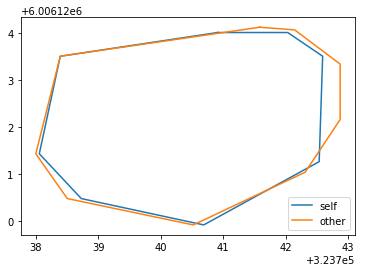

[[555 154]
 [554 155]
 [553 155]
 [552 155]
 [551 155]
 [550 155]
 [549 155]
 [548 155]
 [547 156]
 [546 156]
 [545 156]
 [544 156]
 [543 157]
 [542 157]
 [541 157]
 [540 158]
 [539 158]
 [538 158]
 [537 159]
 [536 159]
 [535 159]
 [534 160]
 [533 160]
 [532 161]
 [531 161]
 [530 161]
 [529 161]
 [528 162]
 [527 162]
 [526 162]
 [525 163]
 [524 163]
 [523 164]
 [522 164]
 [521 164]
 [520 165]
 [519 166]
 [518 166]
 [517 167]
 [517 168]
 [516 169]
 [515 170]
 [515 171]
 [515 172]
 [514 173]
 [514 174]
 [514 175]
 [514 176]
 [514 177]
 [514 178]
 [514 179]
 [514 180]
 [514 181]
 [514 182]
 [515 183]
 [515 184]
 [515 185]
 [515 186]
 [516 187]
 [516 188]
 [516 189]
 [516 190]
 [516 191]
 [516 192]
 [516 193]
 [517 194]
 [517 195]
 [517 196]
 [517 197]
 [517 198]
 [518 199]
 [518 200]
 [518 201]
 [518 202]
 [518 203]
 [518 204]
 [518 205]
 [518 206]
 [519 207]
 [519 208]
 [519 209]
 [519 210]
 [519 211]
 [519 212]
 [519 213]
 [519 214]
 [519 215]
 [520 216]
 [520 217]
 [520 218]
 [520 219]

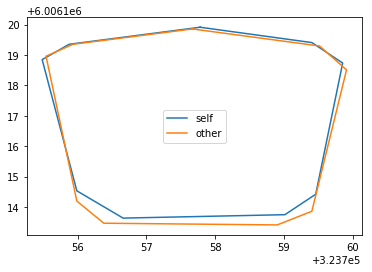

[[369 422]
 [368 423]
 [367 423]
 [366 423]
 [365 423]
 [364 423]
 [363 423]
 [362 423]
 [361 424]
 [360 424]
 [359 424]
 [358 424]
 [357 424]
 [356 425]
 [355 425]
 [354 425]
 [353 426]
 [352 426]
 [351 426]
 [350 427]
 [349 427]
 [348 427]
 [347 427]
 [346 428]
 [345 428]
 [344 429]
 [343 429]
 [342 430]
 [341 431]
 [340 432]
 [339 432]
 [338 433]
 [337 434]
 [336 435]
 [336 436]
 [335 437]
 [334 438]
 [333 439]
 [333 440]
 [332 441]
 [331 442]
 [330 443]
 [330 444]
 [329 445]
 [329 446]
 [328 447]
 [328 448]
 [327 449]
 [326 450]
 [326 451]
 [326 452]
 [325 453]
 [325 454]
 [324 455]
 [324 456]
 [324 457]
 [323 458]
 [323 459]
 [323 460]
 [323 461]
 [323 462]
 [322 463]
 [322 464]
 [322 465]
 [322 466]
 [322 467]
 [322 468]
 [322 469]
 [323 470]
 [323 471]
 [323 472]
 [323 473]
 [324 474]
 [324 475]
 [325 476]
 [325 477]
 [326 478]
 [327 479]
 [328 480]
 [329 481]
 [330 481]
 [331 482]
 [332 482]
 [333 483]
 [334 483]
 [335 484]
 [336 484]
 [337 485]
 [338 485]
 [339 485]
 [340 485]

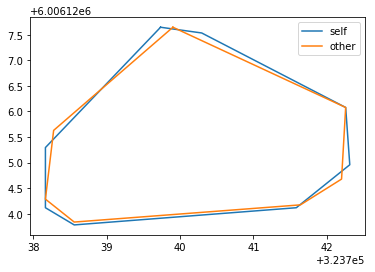

[[ 84 238]
 [ 83 239]
 [ 82 239]
 [ 81 240]
 [ 80 240]
 [ 79 241]
 [ 78 241]
 [ 77 242]
 [ 76 242]
 [ 75 243]
 [ 74 244]
 [ 74 245]
 [ 73 246]
 [ 73 247]
 [ 73 248]
 [ 73 249]
 [ 72 250]
 [ 72 251]
 [ 72 252]
 [ 72 253]
 [ 71 254]
 [ 71 255]
 [ 71 256]
 [ 72 257]
 [ 72 258]
 [ 72 259]
 [ 72 260]
 [ 72 261]
 [ 72 262]
 [ 72 263]
 [ 72 264]
 [ 72 265]
 [ 73 266]
 [ 73 267]
 [ 73 268]
 [ 73 269]
 [ 73 270]
 [ 73 271]
 [ 73 272]
 [ 73 273]
 [ 74 274]
 [ 75 275]
 [ 76 276]
 [ 76 277]
 [ 77 278]
 [ 77 279]
 [ 78 280]
 [ 79 281]
 [ 79 282]
 [ 80 283]
 [ 80 284]
 [ 80 285]
 [ 81 286]
 [ 81 287]
 [ 82 288]
 [ 83 289]
 [ 83 290]
 [ 83 291]
 [ 84 292]
 [ 85 293]
 [ 85 294]
 [ 85 295]
 [ 86 296]
 [ 86 297]
 [ 86 298]
 [ 87 299]
 [ 87 300]
 [ 88 301]
 [ 88 302]
 [ 89 303]
 [ 89 304]
 [ 89 305]
 [ 89 306]
 [ 89 307]
 [ 89 308]
 [ 89 309]
 [ 89 310]
 [ 89 311]
 [ 89 312]
 [ 89 313]
 [ 89 314]
 [ 89 315]
 [ 89 316]
 [ 89 317]
 [ 89 318]
 [ 89 319]
 [ 89 320]
 [ 89 321]
 [ 89 322]
 [ 90 323]
 [ 90 324]

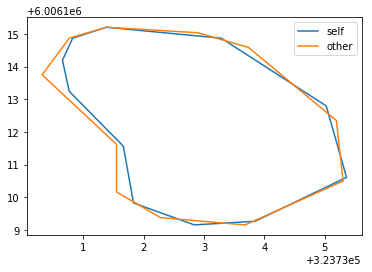

[[211 280]
 [210 281]
 [209 281]
 [208 281]
 [207 281]
 [206 281]
 [205 281]
 [204 281]
 [203 281]
 [202 281]
 [201 281]
 [200 281]
 [199 282]
 [198 282]
 [197 283]
 [196 284]
 [196 285]
 [195 286]
 [194 287]
 [194 288]
 [193 289]
 [192 289]
 [191 290]
 [190 291]
 [189 292]
 [189 293]
 [189 294]
 [189 295]
 [189 296]
 [188 297]
 [188 298]
 [188 299]
 [188 300]
 [188 301]
 [188 302]
 [188 303]
 [188 304]
 [188 305]
 [188 306]
 [188 307]
 [188 308]
 [188 309]
 [188 310]
 [188 311]
 [188 312]
 [188 313]
 [188 314]
 [188 315]
 [188 316]
 [188 317]
 [188 318]
 [188 319]
 [188 320]
 [189 321]
 [189 322]
 [189 323]
 [189 324]
 [189 325]
 [189 326]
 [189 327]
 [190 328]
 [191 329]
 [192 330]
 [193 331]
 [193 332]
 [194 333]
 [195 334]
 [196 335]
 [196 336]
 [197 336]
 [198 337]
 [199 337]
 [200 338]
 [201 339]
 [202 340]
 [203 341]
 [203 342]
 [204 343]
 [204 344]
 [204 345]
 [205 346]
 [205 347]
 [206 348]
 [206 349]
 [207 350]
 [207 351]
 [207 352]
 [208 353]
 [208 354]
 [208 355]
 [209 356]

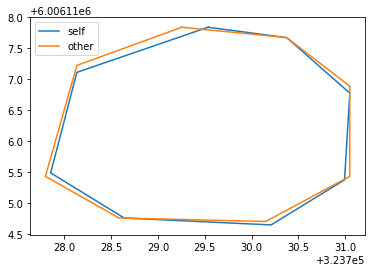

[[168 428]
 [167 429]
 [166 429]
 [165 429]
 [164 429]
 [163 429]
 [162 429]
 [161 429]
 [160 429]
 [159 430]
 [158 430]
 [157 431]
 [156 431]
 [155 432]
 [154 433]
 [153 433]
 [152 434]
 [151 434]
 [150 435]
 [149 435]
 [148 435]
 [147 436]
 [146 436]
 [145 436]
 [144 437]
 [143 437]
 [142 438]
 [141 438]
 [140 439]
 [140 440]
 [139 441]
 [138 442]
 [138 443]
 [137 444]
 [136 445]
 [135 446]
 [134 446]
 [133 447]
 [132 448]
 [131 449]
 [130 450]
 [130 451]
 [130 452]
 [130 453]
 [130 454]
 [129 455]
 [129 456]
 [129 457]
 [129 458]
 [129 459]
 [128 460]
 [128 461]
 [127 462]
 [127 463]
 [127 464]
 [126 465]
 [126 466]
 [126 467]
 [126 468]
 [126 469]
 [126 470]
 [126 471]
 [126 472]
 [126 473]
 [126 474]
 [125 475]
 [125 476]
 [125 477]
 [125 478]
 [125 479]
 [125 480]
 [125 481]
 [125 482]
 [125 483]
 [125 484]
 [125 485]
 [125 486]
 [125 487]
 [126 488]
 [126 489]
 [126 490]
 [126 491]
 [126 492]
 [127 493]
 [127 494]
 [127 495]
 [128 496]
 [128 497]
 [129 498]
 [129 499]
 [130 500]

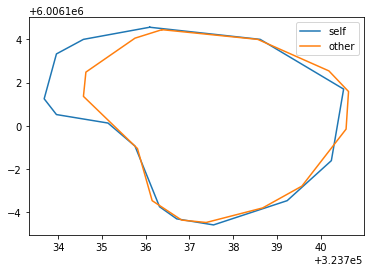

24it [00:42,  2.07s/it]

[[380 168]
 [379 169]
 [378 169]
 [377 169]
 [376 169]
 [375 169]
 [374 169]
 [373 169]
 [372 170]
 [371 171]
 [370 172]
 [369 173]
 [368 174]
 [367 174]
 [366 175]
 [365 176]
 [364 176]
 [363 177]
 [362 177]
 [361 178]
 [360 178]
 [359 178]
 [358 179]
 [357 179]
 [356 180]
 [355 180]
 [354 180]
 [353 180]
 [352 181]
 [351 181]
 [350 181]
 [349 181]
 [348 181]
 [347 182]
 [346 182]
 [345 182]
 [344 182]
 [343 182]
 [342 182]
 [341 182]
 [340 182]
 [339 183]
 [338 183]
 [337 183]
 [336 184]
 [335 185]
 [334 186]
 [333 187]
 [332 188]
 [331 189]
 [330 190]
 [329 191]
 [328 192]
 [327 193]
 [326 194]
 [325 195]
 [324 195]
 [323 196]
 [323 197]
 [322 198]
 [322 199]
 [321 200]
 [321 201]
 [320 202]
 [319 203]
 [318 204]
 [318 205]
 [318 206]
 [317 207]
 [317 208]
 [317 209]
 [317 210]
 [316 211]
 [316 212]
 [316 213]
 [315 214]
 [315 215]
 [315 216]
 [316 217]
 [316 218]
 [316 219]
 [316 220]
 [315 221]
 [315 222]
 [316 223]
 [316 224]
 [316 225]
 [316 226]
 [316 227]
 [316 228]
 [316 229]

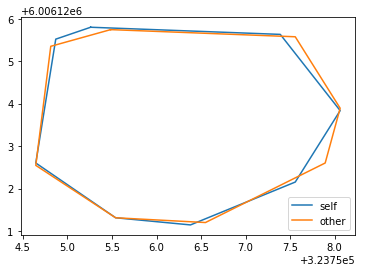

[[562 165]
 [561 166]
 [560 166]
 [559 166]
 [558 166]
 [557 167]
 [556 168]
 [555 169]
 [554 170]
 [553 171]
 [553 172]
 [552 173]
 [552 174]
 [551 175]
 [551 176]
 [551 177]
 [551 178]
 [551 179]
 [551 180]
 [551 181]
 [551 182]
 [551 183]
 [551 184]
 [551 185]
 [551 186]
 [551 187]
 [551 188]
 [551 189]
 [551 190]
 [551 191]
 [551 192]
 [551 193]
 [551 194]
 [551 195]
 [551 196]
 [551 197]
 [551 198]
 [551 199]
 [551 200]
 [551 201]
 [551 202]
 [551 203]
 [551 204]
 [551 205]
 [551 206]
 [551 207]
 [551 208]
 [551 209]
 [551 210]
 [551 211]
 [551 212]
 [552 213]
 [552 214]
 [552 215]
 [552 216]
 [551 217]
 [551 218]
 [552 219]
 [552 220]
 [552 221]
 [552 222]
 [553 223]
 [554 224]
 [555 225]
 [556 226]
 [557 226]
 [558 227]
 [559 227]
 [560 227]
 [561 227]
 [562 228]
 [563 228]
 [564 228]
 [565 228]
 [566 228]
 [567 228]
 [568 228]
 [569 227]
 [570 227]
 [571 227]
 [572 227]
 [573 227]
 [574 227]
 [575 227]
 [576 226]
 [577 226]
 [578 226]
 [579 226]
 [580 226]
 [581 225]
 [582 225]

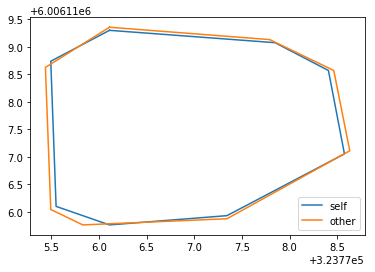

[[413  65]
 [412  66]
 [411  66]
 [410  67]
 [409  67]
 [409  68]
 [408  69]
 [407  70]
 [406  71]
 [405  72]
 [405  73]
 [405  74]
 [404  75]
 [404  76]
 [404  77]
 [403  78]
 [403  79]
 [402  80]
 [402  81]
 [401  82]
 [401  83]
 [400  84]
 [400  85]
 [400  86]
 [400  87]
 [399  88]
 [399  89]
 [399  90]
 [399  91]
 [399  92]
 [398  93]
 [398  94]
 [398  95]
 [398  96]
 [398  97]
 [398  98]
 [398  99]
 [398 100]
 [398 101]
 [398 102]
 [398 103]
 [398 104]
 [398 105]
 [398 106]
 [398 107]
 [398 108]
 [398 109]
 [398 110]
 [398 111]
 [398 112]
 [399 113]
 [399 114]
 [399 115]
 [399 116]
 [399 117]
 [399 118]
 [399 119]
 [400 120]
 [400 121]
 [400 122]
 [400 123]
 [400 124]
 [400 125]
 [400 126]
 [401 127]
 [401 128]
 [402 129]
 [403 130]
 [404 131]
 [404 132]
 [405 133]
 [406 133]
 [407 134]
 [408 134]
 [409 134]
 [410 134]
 [411 134]
 [412 134]
 [413 134]
 [414 134]
 [415 134]
 [416 134]
 [417 134]
 [418 134]
 [419 134]
 [420 134]
 [421 134]
 [422 134]
 [423 134]
 [424 134]
 [425 134]

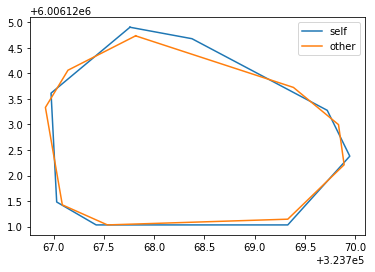

[[163 164]
 [162 165]
 [161 165]
 [160 165]
 [159 165]
 [158 165]
 [157 165]
 [156 166]
 [155 166]
 [154 166]
 [153 166]
 [152 167]
 [151 167]
 [150 168]
 [149 168]
 [148 168]
 [147 169]
 [146 169]
 [145 170]
 [144 170]
 [143 171]
 [142 171]
 [141 172]
 [140 173]
 [139 173]
 [138 173]
 [137 174]
 [136 174]
 [135 175]
 [134 175]
 [133 176]
 [132 176]
 [131 177]
 [130 177]
 [129 178]
 [128 178]
 [127 179]
 [126 179]
 [125 180]
 [124 181]
 [123 182]
 [122 182]
 [121 183]
 [121 184]
 [120 185]
 [119 186]
 [119 187]
 [118 188]
 [117 189]
 [116 190]
 [115 191]
 [114 192]
 [114 193]
 [114 194]
 [114 195]
 [114 196]
 [114 197]
 [113 198]
 [113 199]
 [113 200]
 [113 201]
 [113 202]
 [114 203]
 [114 204]
 [115 205]
 [115 206]
 [115 207]
 [115 208]
 [115 209]
 [115 210]
 [115 211]
 [115 212]
 [115 213]
 [115 214]
 [115 215]
 [115 216]
 [115 217]
 [115 218]
 [115 219]
 [115 220]
 [115 221]
 [115 222]
 [115 223]
 [115 224]
 [115 225]
 [115 226]
 [115 227]
 [115 228]
 [115 229]
 [115 230]
 [114 231]

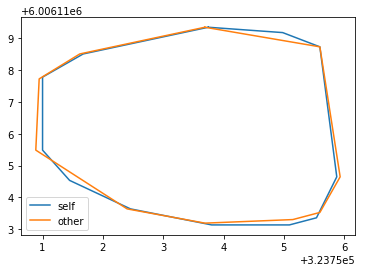

[[190 561]
 [189 562]
 [188 562]
 [187 562]
 [186 562]
 [185 562]
 [184 562]
 [183 562]
 [182 562]
 [181 562]
 [180 563]
 [179 563]
 [178 563]
 [177 564]
 [176 564]
 [175 565]
 [174 565]
 [173 566]
 [172 567]
 [171 568]
 [170 569]
 [169 570]
 [168 571]
 [168 572]
 [167 573]
 [166 574]
 [166 575]
 [165 576]
 [165 577]
 [164 578]
 [164 579]
 [164 580]
 [164 581]
 [163 582]
 [163 583]
 [163 584]
 [163 585]
 [163 586]
 [163 587]
 [163 588]
 [163 589]
 [163 590]
 [163 591]
 [163 592]
 [163 593]
 [163 594]
 [163 595]
 [163 596]
 [164 597]
 [164 598]
 [164 599]
 [164 600]
 [165 601]
 [165 602]
 [165 603]
 [166 604]
 [167 605]
 [168 606]
 [169 607]
 [170 607]
 [171 607]
 [172 608]
 [173 608]
 [174 608]
 [175 608]
 [176 608]
 [177 608]
 [178 608]
 [179 608]
 [180 608]
 [181 608]
 [182 608]
 [183 608]
 [184 608]
 [185 608]
 [186 608]
 [187 607]
 [188 607]
 [189 607]
 [190 607]
 [191 607]
 [192 607]
 [193 606]
 [194 606]
 [195 605]
 [196 604]
 [197 604]
 [198 603]
 [198 602]
 [199 601]
 [200 600]

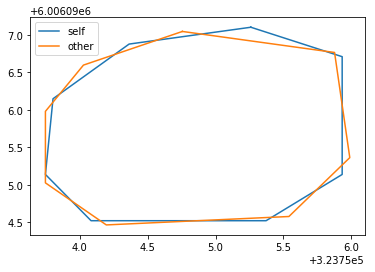

[[363 289]
 [362 290]
 [361 290]
 [360 290]
 [359 290]
 [358 290]
 [357 290]
 [356 290]
 [355 290]
 [354 290]
 [353 290]
 [352 290]
 [351 291]
 [350 291]
 [349 291]
 [348 291]
 [347 290]
 [346 290]
 [345 290]
 [344 291]
 [343 291]
 [342 291]
 [341 291]
 [340 291]
 [339 291]
 [338 291]
 [337 291]
 [336 291]
 [335 291]
 [334 291]
 [333 291]
 [332 292]
 [331 292]
 [330 292]
 [329 292]
 [328 292]
 [327 292]
 [326 292]
 [325 293]
 [324 293]
 [323 293]
 [322 294]
 [321 294]
 [320 295]
 [319 295]
 [318 295]
 [317 295]
 [316 296]
 [315 296]
 [314 297]
 [313 297]
 [312 298]
 [311 298]
 [310 299]
 [309 299]
 [308 300]
 [307 301]
 [306 301]
 [305 302]
 [304 303]
 [303 304]
 [302 305]
 [301 306]
 [300 307]
 [299 308]
 [298 309]
 [298 310]
 [297 311]
 [296 312]
 [295 313]
 [295 314]
 [294 315]
 [293 316]
 [293 317]
 [292 318]
 [291 319]
 [291 320]
 [290 321]
 [289 322]
 [289 323]
 [288 324]
 [287 325]
 [287 326]
 [286 327]
 [285 328]
 [284 329]
 [284 330]
 [283 331]
 [283 332]
 [283 333]
 [282 334]

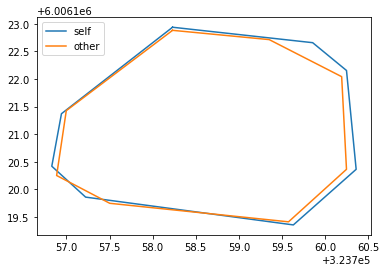

[[234 154]
 [233 155]
 [232 155]
 [231 155]
 [230 155]
 [229 155]
 [228 155]
 [227 155]
 [226 155]
 [225 156]
 [224 156]
 [223 156]
 [222 156]
 [221 156]
 [220 157]
 [219 157]
 [218 158]
 [217 158]
 [216 158]
 [215 158]
 [214 159]
 [213 159]
 [212 159]
 [211 159]
 [210 160]
 [209 160]
 [208 160]
 [207 161]
 [206 161]
 [205 161]
 [204 162]
 [203 162]
 [202 163]
 [201 164]
 [200 165]
 [199 165]
 [198 166]
 [197 167]
 [197 168]
 [196 169]
 [195 170]
 [195 171]
 [194 172]
 [194 173]
 [194 174]
 [194 175]
 [194 176]
 [194 177]
 [194 178]
 [195 179]
 [195 180]
 [195 181]
 [195 182]
 [195 183]
 [195 184]
 [195 185]
 [195 186]
 [195 187]
 [196 188]
 [196 189]
 [196 190]
 [196 191]
 [196 192]
 [196 193]
 [197 194]
 [197 195]
 [197 196]
 [197 197]
 [197 198]
 [197 199]
 [197 200]
 [197 201]
 [198 202]
 [198 203]
 [198 204]
 [198 205]
 [198 206]
 [198 207]
 [198 208]
 [198 209]
 [198 210]
 [198 211]
 [198 212]
 [199 213]
 [199 214]
 [199 215]
 [199 216]
 [199 217]
 [199 218]
 [199 219]
 [199 220]

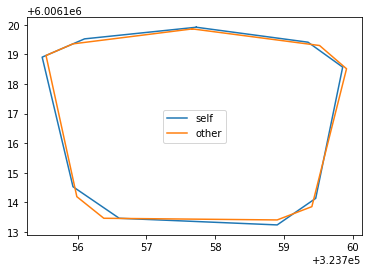

[[310 166]
 [309 167]
 [308 167]
 [307 167]
 [306 167]
 [305 167]
 [304 168]
 [303 168]
 [302 169]
 [301 169]
 [300 169]
 [299 169]
 [298 170]
 [297 170]
 [296 170]
 [295 171]
 [294 171]
 [293 171]
 [292 171]
 [291 172]
 [290 172]
 [289 172]
 [288 172]
 [287 172]
 [286 172]
 [285 172]
 [284 172]
 [283 173]
 [282 173]
 [281 174]
 [280 174]
 [279 175]
 [278 175]
 [277 176]
 [276 177]
 [276 178]
 [275 179]
 [275 180]
 [274 181]
 [274 182]
 [273 183]
 [273 184]
 [273 185]
 [272 186]
 [272 187]
 [272 188]
 [271 189]
 [271 190]
 [271 191]
 [271 192]
 [270 193]
 [270 194]
 [270 195]
 [270 196]
 [270 197]
 [270 198]
 [269 199]
 [269 200]
 [269 201]
 [269 202]
 [269 203]
 [269 204]
 [269 205]
 [269 206]
 [268 207]
 [268 208]
 [268 209]
 [268 210]
 [268 211]
 [268 212]
 [268 213]
 [268 214]
 [268 215]
 [268 216]
 [267 217]
 [267 218]
 [267 219]
 [267 220]
 [267 221]
 [267 222]
 [267 223]
 [267 224]
 [267 225]
 [267 226]
 [267 227]
 [267 228]
 [267 229]
 [267 230]
 [267 231]
 [267 232]
 [266 233]

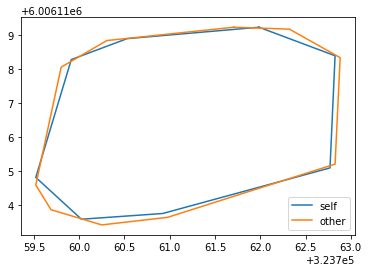

[[348 125]
 [347 126]
 [346 126]
 [345 126]
 [344 127]
 [343 128]
 [342 129]
 [341 130]
 [341 131]
 [340 132]
 [340 133]
 [339 134]
 [339 135]
 [338 136]
 [338 137]
 [338 138]
 [337 139]
 [337 140]
 [337 141]
 [337 142]
 [337 143]
 [336 144]
 [336 145]
 [336 146]
 [335 147]
 [335 148]
 [334 149]
 [334 150]
 [333 151]
 [333 152]
 [333 153]
 [332 154]
 [332 155]
 [332 156]
 [332 157]
 [332 158]
 [331 159]
 [331 160]
 [332 161]
 [332 162]
 [332 163]
 [333 164]
 [333 165]
 [334 166]
 [335 167]
 [336 168]
 [337 169]
 [338 170]
 [339 170]
 [340 171]
 [341 171]
 [342 172]
 [343 172]
 [344 173]
 [345 173]
 [346 173]
 [347 174]
 [348 174]
 [349 174]
 [350 174]
 [351 174]
 [352 174]
 [353 174]
 [354 174]
 [355 175]
 [356 175]
 [357 174]
 [358 174]
 [359 174]
 [360 175]
 [361 175]
 [362 175]
 [363 174]
 [364 174]
 [365 174]
 [366 175]
 [367 174]
 [368 174]
 [369 174]
 [370 174]
 [371 174]
 [372 174]
 [373 174]
 [374 174]
 [375 174]
 [376 174]
 [377 174]
 [378 174]
 [379 173]
 [380 173]
 [381 173]

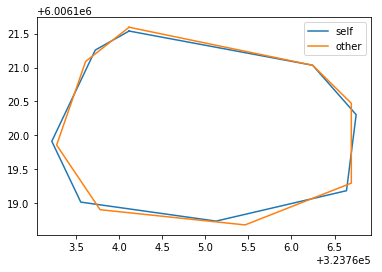

[[409 129]
 [408 130]
 [407 130]
 [406 131]
 [405 131]
 [404 132]
 [403 133]
 [402 134]
 [402 135]
 [401 136]
 [400 137]
 [399 138]
 [399 139]
 [398 140]
 [398 141]
 [398 142]
 [398 143]
 [397 144]
 [397 145]
 [397 146]
 [397 147]
 [397 148]
 [397 149]
 [397 150]
 [397 151]
 [397 152]
 [397 153]
 [397 154]
 [397 155]
 [397 156]
 [397 157]
 [397 158]
 [396 159]
 [396 160]
 [397 161]
 [397 162]
 [397 163]
 [397 164]
 [397 165]
 [397 166]
 [398 167]
 [398 168]
 [399 169]
 [400 170]
 [401 171]
 [402 172]
 [403 173]
 [403 174]
 [404 175]
 [405 176]
 [406 177]
 [407 177]
 [408 178]
 [409 179]
 [410 179]
 [411 180]
 [412 180]
 [413 180]
 [414 180]
 [415 180]
 [416 180]
 [417 180]
 [418 180]
 [419 180]
 [420 180]
 [421 180]
 [422 180]
 [423 180]
 [424 180]
 [425 180]
 [426 180]
 [427 180]
 [428 180]
 [429 180]
 [430 180]
 [431 180]
 [432 180]
 [433 180]
 [434 180]
 [435 180]
 [436 180]
 [437 180]
 [438 180]
 [439 180]
 [440 180]
 [441 180]
 [442 180]
 [443 180]
 [444 179]
 [445 179]
 [446 179]

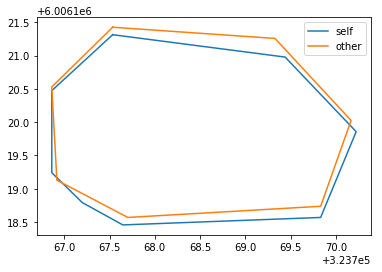

[[536 260]
 [535 261]
 [534 261]
 [533 261]
 [532 261]
 [531 262]
 [530 262]
 [529 262]
 [528 262]
 [527 263]
 [526 263]
 [525 263]
 [524 263]
 [523 264]
 [522 264]
 [521 264]
 [520 264]
 [519 264]
 [518 265]
 [517 265]
 [516 265]
 [515 266]
 [514 266]
 [513 266]
 [512 267]
 [511 267]
 [510 267]
 [509 268]
 [508 268]
 [507 268]
 [506 269]
 [505 269]
 [504 269]
 [503 270]
 [502 270]
 [501 270]
 [500 271]
 [499 271]
 [498 271]
 [497 272]
 [496 272]
 [495 272]
 [494 273]
 [493 274]
 [492 275]
 [491 276]
 [490 277]
 [489 278]
 [488 278]
 [488 279]
 [487 280]
 [487 281]
 [487 282]
 [486 283]
 [486 284]
 [485 285]
 [485 286]
 [485 287]
 [485 288]
 [485 289]
 [484 290]
 [484 291]
 [483 292]
 [483 293]
 [483 294]
 [483 295]
 [483 296]
 [483 297]
 [483 298]
 [483 299]
 [483 300]
 [483 301]
 [483 302]
 [483 303]
 [483 304]
 [483 305]
 [483 306]
 [483 307]
 [483 308]
 [484 309]
 [484 310]
 [484 311]
 [484 312]
 [484 313]
 [484 314]
 [485 315]
 [485 316]
 [485 317]
 [485 318]
 [486 319]
 [486 320]

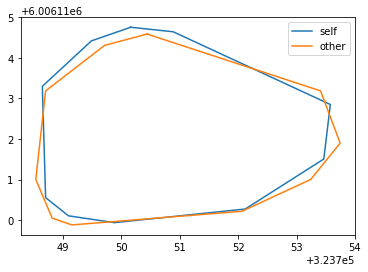

25it [00:43,  1.93s/it]

[[332 413]
 [331 414]
 [330 414]
 [329 414]
 [328 414]
 [327 415]
 [326 416]
 [325 416]
 [324 417]
 [324 418]
 [323 419]
 [322 419]
 [321 419]
 [320 420]
 [319 421]
 [318 421]
 [317 422]
 [317 423]
 [316 424]
 [315 425]
 [315 426]
 [314 427]
 [314 428]
 [313 429]
 [313 430]
 [312 431]
 [312 432]
 [311 433]
 [311 434]
 [310 435]
 [309 436]
 [308 437]
 [308 438]
 [307 439]
 [307 440]
 [306 441]
 [306 442]
 [305 443]
 [305 444]
 [304 445]
 [304 446]
 [303 447]
 [303 448]
 [302 449]
 [302 450]
 [301 451]
 [300 452]
 [300 453]
 [299 454]
 [299 455]
 [298 456]
 [297 457]
 [296 458]
 [296 459]
 [295 460]
 [295 461]
 [294 462]
 [293 463]
 [293 464]
 [292 465]
 [292 466]
 [292 467]
 [291 468]
 [291 469]
 [291 470]
 [291 471]
 [291 472]
 [290 473]
 [290 474]
 [290 475]
 [290 476]
 [290 477]
 [290 478]
 [290 479]
 [290 480]
 [290 481]
 [290 482]
 [290 483]
 [290 484]
 [290 485]
 [290 486]
 [291 487]
 [292 488]
 [293 488]
 [294 489]
 [295 490]
 [296 490]
 [297 490]
 [298 491]
 [299 491]
 [300 491]

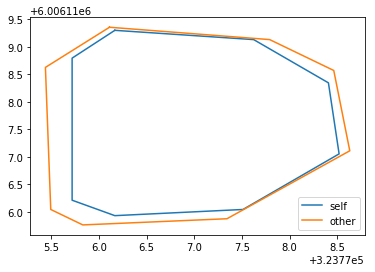

[[333 150]
 [332 151]
 [331 151]
 [330 151]
 [329 151]
 [328 152]
 [327 152]
 [326 153]
 [325 153]
 [324 153]
 [323 154]
 [322 154]
 [321 155]
 [320 156]
 [319 156]
 [318 156]
 [317 157]
 [316 157]
 [315 158]
 [314 158]
 [313 159]
 [312 159]
 [311 160]
 [310 160]
 [309 161]
 [308 161]
 [307 162]
 [306 162]
 [305 163]
 [304 163]
 [303 164]
 [302 164]
 [301 165]
 [300 165]
 [299 166]
 [298 166]
 [297 167]
 [296 167]
 [295 168]
 [294 169]
 [293 169]
 [292 170]
 [291 171]
 [291 172]
 [290 173]
 [290 174]
 [289 175]
 [289 176]
 [289 177]
 [288 178]
 [288 179]
 [288 180]
 [288 181]
 [288 182]
 [288 183]
 [288 184]
 [288 185]
 [288 186]
 [288 187]
 [288 188]
 [288 189]
 [288 190]
 [288 191]
 [288 192]
 [288 193]
 [289 194]
 [289 195]
 [289 196]
 [289 197]
 [289 198]
 [290 199]
 [290 200]
 [290 201]
 [291 202]
 [291 203]
 [292 204]
 [293 205]
 [293 206]
 [294 207]
 [295 207]
 [296 208]
 [297 208]
 [298 209]
 [299 209]
 [300 210]
 [301 210]
 [302 211]
 [303 211]
 [304 211]
 [305 212]
 [306 212]

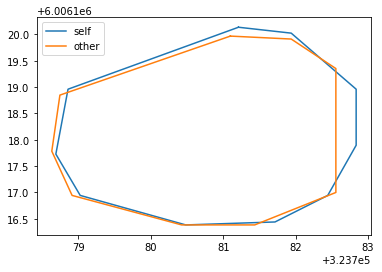

[[ 92  71]
 [ 91  72]
 [ 90  73]
 [ 89  73]
 [ 88  74]
 [ 87  75]
 [ 87  76]
 [ 86  77]
 [ 85  78]
 [ 84  79]
 [ 84  80]
 [ 84  81]
 [ 83  82]
 [ 83  83]
 [ 83  84]
 [ 82  85]
 [ 82  86]
 [ 82  87]
 [ 82  88]
 [ 81  89]
 [ 81  90]
 [ 80  91]
 [ 80  92]
 [ 80  93]
 [ 80  94]
 [ 80  95]
 [ 80  96]
 [ 79  97]
 [ 79  98]
 [ 79  99]
 [ 79 100]
 [ 79 101]
 [ 79 102]
 [ 79 103]
 [ 79 104]
 [ 79 105]
 [ 79 106]
 [ 79 107]
 [ 79 108]
 [ 79 109]
 [ 79 110]
 [ 79 111]
 [ 79 112]
 [ 79 113]
 [ 79 114]
 [ 79 115]
 [ 79 116]
 [ 79 117]
 [ 80 118]
 [ 80 119]
 [ 80 120]
 [ 80 121]
 [ 81 122]
 [ 81 123]
 [ 81 124]
 [ 82 125]
 [ 83 126]
 [ 84 127]
 [ 85 128]
 [ 86 128]
 [ 87 128]
 [ 88 128]
 [ 89 128]
 [ 90 128]
 [ 91 128]
 [ 92 128]
 [ 93 128]
 [ 94 128]
 [ 95 128]
 [ 96 128]
 [ 97 128]
 [ 98 128]
 [ 99 128]
 [100 128]
 [101 128]
 [102 128]
 [103 128]
 [104 128]
 [105 128]
 [106 128]
 [107 128]
 [108 128]
 [109 128]
 [110 129]
 [111 129]
 [112 129]
 [113 129]
 [114 129]
 [115 129]
 [116 129]
 [117 129]

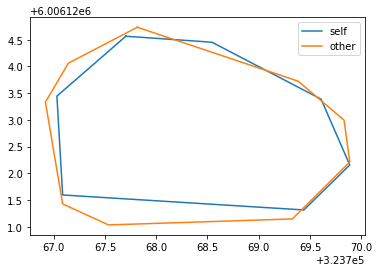

[[252 371]
 [251 372]
 [250 372]
 [249 372]
 [248 372]
 [247 372]
 [246 372]
 [245 372]
 [244 372]
 [243 373]
 [242 373]
 [241 374]
 [240 374]
 [239 375]
 [238 375]
 [237 376]
 [236 377]
 [235 378]
 [235 379]
 [234 380]
 [233 381]
 [233 382]
 [233 383]
 [233 384]
 [232 385]
 [232 386]
 [232 387]
 [231 388]
 [231 389]
 [231 390]
 [231 391]
 [230 392]
 [230 393]
 [230 394]
 [229 395]
 [229 396]
 [228 397]
 [227 398]
 [226 399]
 [225 400]
 [224 401]
 [223 402]
 [222 403]
 [221 403]
 [220 404]
 [219 404]
 [218 404]
 [217 405]
 [216 405]
 [215 405]
 [214 405]
 [213 404]
 [212 404]
 [211 404]
 [210 404]
 [209 405]
 [208 405]
 [207 405]
 [206 405]
 [205 405]
 [204 405]
 [203 405]
 [202 405]
 [201 405]
 [200 406]
 [199 406]
 [198 406]
 [197 407]
 [196 408]
 [196 409]
 [196 410]
 [196 411]
 [196 412]
 [196 413]
 [196 414]
 [196 415]
 [196 416]
 [196 417]
 [196 418]
 [196 419]
 [196 420]
 [196 421]
 [196 422]
 [196 423]
 [197 424]
 [198 425]
 [198 426]
 [199 427]
 [199 428]
 [200 428]
 [201 429]

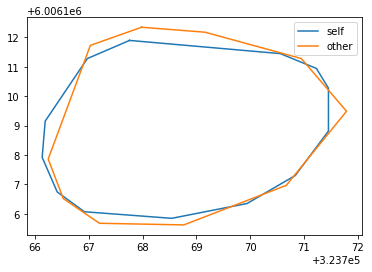

[[110 444]
 [109 445]
 [108 445]
 [107 445]
 [106 445]
 [105 445]
 [104 446]
 [103 446]
 [102 446]
 [101 447]
 [100 447]
 [ 99 447]
 [ 98 448]
 [ 97 448]
 [ 96 449]
 [ 95 450]
 [ 94 451]
 [ 93 451]
 [ 92 452]
 [ 91 453]
 [ 90 453]
 [ 89 454]
 [ 88 455]
 [ 87 455]
 [ 86 456]
 [ 85 457]
 [ 85 458]
 [ 84 459]
 [ 84 460]
 [ 83 461]
 [ 83 462]
 [ 83 463]
 [ 82 464]
 [ 82 465]
 [ 82 466]
 [ 81 467]
 [ 81 468]
 [ 81 469]
 [ 81 470]
 [ 81 471]
 [ 81 472]
 [ 81 473]
 [ 81 474]
 [ 81 475]
 [ 81 476]
 [ 81 477]
 [ 81 478]
 [ 81 479]
 [ 81 480]
 [ 81 481]
 [ 81 482]
 [ 81 483]
 [ 82 484]
 [ 82 485]
 [ 82 486]
 [ 83 487]
 [ 83 488]
 [ 84 489]
 [ 84 490]
 [ 85 491]
 [ 85 492]
 [ 86 493]
 [ 87 494]
 [ 87 495]
 [ 88 496]
 [ 89 497]
 [ 90 498]
 [ 91 499]
 [ 92 500]
 [ 93 501]
 [ 94 502]
 [ 95 503]
 [ 96 504]
 [ 97 505]
 [ 98 506]
 [ 99 506]
 [100 507]
 [101 508]
 [102 509]
 [103 510]
 [104 510]
 [105 511]
 [106 512]
 [107 513]
 [108 514]
 [109 514]
 [110 515]
 [111 516]
 [112 517]
 [113 517]
 [114 518]

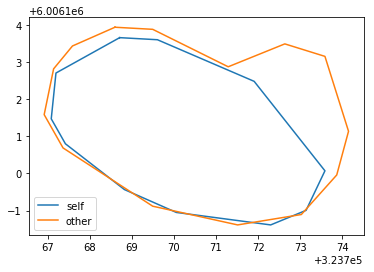

[[314  38]
 [313  39]
 [312  39]
 [311  39]
 [310  39]
 [309  39]
 [308  40]
 [307  40]
 [306  40]
 [305  41]
 [304  41]
 [303  41]
 [302  42]
 [301  43]
 [300  43]
 [299  44]
 [298  44]
 [297  45]
 [296  45]
 [295  46]
 [294  47]
 [293  47]
 [292  48]
 [291  49]
 [290  49]
 [289  50]
 [288  50]
 [287  51]
 [286  52]
 [285  53]
 [284  54]
 [284  55]
 [283  56]
 [283  57]
 [283  58]
 [282  59]
 [282  60]
 [282  61]
 [282  62]
 [282  63]
 [282  64]
 [282  65]
 [282  66]
 [282  67]
 [282  68]
 [282  69]
 [282  70]
 [282  71]
 [282  72]
 [282  73]
 [282  74]
 [282  75]
 [283  76]
 [283  77]
 [283  78]
 [283  79]
 [283  80]
 [283  81]
 [283  82]
 [283  83]
 [283  84]
 [284  85]
 [284  86]
 [284  87]
 [284  88]
 [284  89]
 [284  90]
 [285  91]
 [285  92]
 [285  93]
 [285  94]
 [285  95]
 [286  96]
 [286  97]
 [287  98]
 [287  99]
 [288 100]
 [288 101]
 [289 102]
 [289 103]
 [290 104]
 [291 105]
 [292 106]
 [293 107]
 [294 108]
 [295 109]
 [296 110]
 [297 110]
 [298 111]
 [299 111]
 [300 111]

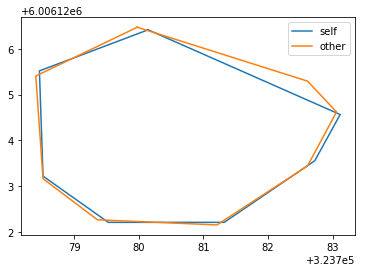

[[ 32 125]
 [ 31 126]
 [ 30 126]
 [ 29 126]
 [ 28 127]
 [ 27 127]
 [ 26 128]
 [ 26 129]
 [ 26 130]
 [ 25 131]
 [ 25 132]
 [ 25 133]
 [ 25 134]
 [ 25 135]
 [ 25 136]
 [ 25 137]
 [ 25 138]
 [ 25 139]
 [ 25 140]
 [ 25 141]
 [ 25 142]
 [ 25 143]
 [ 25 144]
 [ 25 145]
 [ 25 146]
 [ 24 147]
 [ 24 148]
 [ 24 149]
 [ 24 150]
 [ 24 151]
 [ 24 152]
 [ 24 153]
 [ 24 154]
 [ 24 155]
 [ 24 156]
 [ 24 157]
 [ 24 158]
 [ 24 159]
 [ 24 160]
 [ 24 161]
 [ 24 162]
 [ 25 163]
 [ 25 164]
 [ 26 165]
 [ 26 166]
 [ 27 167]
 [ 28 168]
 [ 29 168]
 [ 30 169]
 [ 31 170]
 [ 32 170]
 [ 33 170]
 [ 34 171]
 [ 35 171]
 [ 36 171]
 [ 37 171]
 [ 38 171]
 [ 39 172]
 [ 40 172]
 [ 41 172]
 [ 42 172]
 [ 43 172]
 [ 44 172]
 [ 45 172]
 [ 46 172]
 [ 47 172]
 [ 48 172]
 [ 49 172]
 [ 50 172]
 [ 51 172]
 [ 52 172]
 [ 53 171]
 [ 54 171]
 [ 55 171]
 [ 56 171]
 [ 57 171]
 [ 58 171]
 [ 59 171]
 [ 60 171]
 [ 61 171]
 [ 62 170]
 [ 63 170]
 [ 64 169]
 [ 65 169]
 [ 66 168]
 [ 67 167]
 [ 68 167]
 [ 69 166]
 [ 70 165]
 [ 70 164]
 [ 70 163]

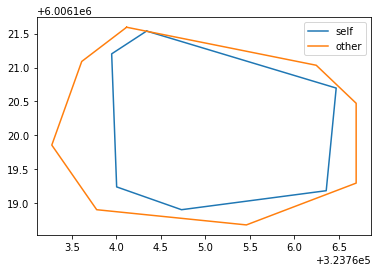

[[323 301]
 [322 302]
 [321 302]
 [320 302]
 [319 302]
 [318 303]
 [317 303]
 [316 304]
 [315 304]
 [314 305]
 [313 306]
 [312 306]
 [311 307]
 [310 308]
 [309 309]
 [308 310]
 [308 311]
 [307 312]
 [307 313]
 [307 314]
 [306 315]
 [306 316]
 [306 317]
 [306 318]
 [306 319]
 [306 320]
 [306 321]
 [306 322]
 [306 323]
 [306 324]
 [307 325]
 [307 326]
 [307 327]
 [308 328]
 [308 329]
 [309 330]
 [309 331]
 [310 332]
 [311 333]
 [311 334]
 [312 335]
 [313 336]
 [314 337]
 [315 338]
 [316 339]
 [316 340]
 [317 340]
 [318 341]
 [319 342]
 [320 343]
 [321 344]
 [322 344]
 [323 344]
 [324 344]
 [325 345]
 [326 345]
 [327 345]
 [328 345]
 [329 345]
 [330 345]
 [331 345]
 [332 345]
 [333 345]
 [334 345]
 [335 345]
 [336 345]
 [337 345]
 [338 345]
 [339 344]
 [340 344]
 [341 344]
 [342 344]
 [343 344]
 [344 344]
 [345 343]
 [346 343]
 [347 342]
 [348 342]
 [349 342]
 [350 342]
 [351 341]
 [352 341]
 [353 341]
 [354 340]
 [355 340]
 [356 339]
 [357 338]
 [357 337]
 [358 336]
 [358 335]
 [358 334]

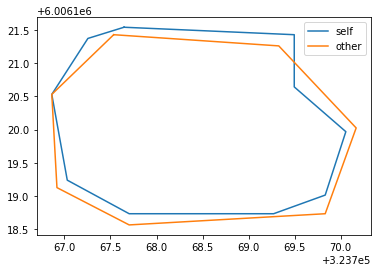

[[216 258]
 [215 259]
 [214 259]
 [213 260]
 [212 260]
 [211 260]
 [210 260]
 [209 261]
 [208 261]
 [207 262]
 [206 262]
 [205 262]
 [204 262]
 [203 263]
 [202 264]
 [201 264]
 [200 265]
 [199 265]
 [198 265]
 [197 266]
 [196 266]
 [195 266]
 [194 267]
 [193 267]
 [192 267]
 [191 268]
 [190 268]
 [189 268]
 [188 268]
 [187 269]
 [186 269]
 [185 270]
 [184 270]
 [183 271]
 [182 271]
 [181 272]
 [180 273]
 [179 273]
 [178 273]
 [177 274]
 [176 274]
 [175 275]
 [174 275]
 [173 276]
 [172 277]
 [172 278]
 [171 279]
 [171 280]
 [170 281]
 [170 282]
 [169 283]
 [169 284]
 [169 285]
 [169 286]
 [169 287]
 [168 288]
 [168 289]
 [168 290]
 [167 291]
 [167 292]
 [167 293]
 [167 294]
 [167 295]
 [166 296]
 [166 297]
 [166 298]
 [166 299]
 [165 300]
 [165 301]
 [165 302]
 [165 303]
 [166 304]
 [166 305]
 [166 306]
 [166 307]
 [166 308]
 [166 309]
 [166 310]
 [166 311]
 [166 312]
 [167 313]
 [167 314]
 [167 315]
 [167 316]
 [167 317]
 [168 318]
 [168 319]
 [168 320]
 [169 321]
 [169 322]
 [169 323]

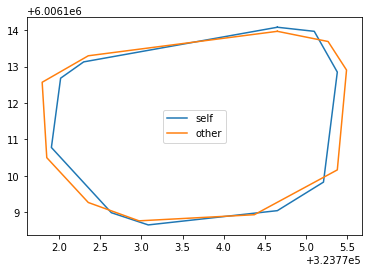

26it [00:45,  1.77s/it]

[[249 465]
 [248 466]
 [247 466]
 [246 466]
 [245 466]
 [244 466]
 [243 466]
 [242 466]
 [241 466]
 [240 466]
 [239 467]
 [238 467]
 [237 467]
 [236 467]
 [235 468]
 [234 468]
 [233 468]
 [232 469]
 [231 469]
 [230 470]
 [229 470]
 [228 470]
 [228 471]
 [227 472]
 [226 473]
 [225 474]
 [224 475]
 [223 476]
 [223 477]
 [222 478]
 [221 479]
 [221 480]
 [221 481]
 [220 482]
 [220 483]
 [220 484]
 [220 485]
 [220 486]
 [220 487]
 [220 488]
 [221 489]
 [221 490]
 [222 491]
 [222 492]
 [222 493]
 [223 494]
 [224 495]
 [225 496]
 [226 497]
 [226 498]
 [227 499]
 [227 500]
 [228 501]
 [228 502]
 [229 503]
 [230 504]
 [231 505]
 [231 506]
 [231 507]
 [232 508]
 [232 509]
 [233 510]
 [234 511]
 [234 512]
 [235 513]
 [236 514]
 [236 515]
 [237 516]
 [238 517]
 [239 518]
 [240 518]
 [241 519]
 [242 519]
 [243 520]
 [244 520]
 [245 521]
 [246 521]
 [247 521]
 [248 522]
 [249 522]
 [250 522]
 [251 522]
 [252 522]
 [253 523]
 [254 523]
 [255 523]
 [256 523]
 [257 523]
 [258 523]
 [259 523]
 [260 523]

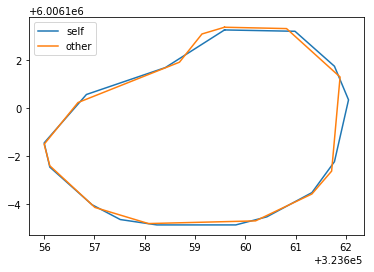

[[ 97 129]
 [ 96 130]
 [ 95 130]
 [ 94 130]
 [ 93 130]
 [ 92 130]
 [ 91 130]
 [ 90 130]
 [ 89 130]
 [ 88 131]
 [ 87 131]
 [ 86 131]
 [ 85 132]
 [ 84 132]
 [ 83 132]
 [ 82 132]
 [ 81 133]
 [ 80 134]
 [ 79 135]
 [ 79 136]
 [ 78 137]
 [ 77 138]
 [ 76 139]
 [ 75 140]
 [ 74 141]
 [ 74 142]
 [ 73 143]
 [ 73 144]
 [ 73 145]
 [ 72 146]
 [ 72 147]
 [ 71 148]
 [ 71 149]
 [ 71 150]
 [ 71 151]
 [ 70 152]
 [ 70 153]
 [ 69 154]
 [ 68 155]
 [ 68 156]
 [ 67 157]
 [ 67 158]
 [ 66 159]
 [ 65 160]
 [ 65 161]
 [ 64 162]
 [ 64 163]
 [ 63 164]
 [ 62 165]
 [ 61 166]
 [ 60 166]
 [ 59 167]
 [ 58 167]
 [ 57 168]
 [ 56 168]
 [ 55 169]
 [ 54 170]
 [ 53 170]
 [ 52 170]
 [ 51 171]
 [ 50 171]
 [ 49 171]
 [ 48 172]
 [ 47 172]
 [ 46 173]
 [ 45 173]
 [ 44 174]
 [ 43 175]
 [ 42 176]
 [ 42 177]
 [ 41 178]
 [ 40 179]
 [ 40 180]
 [ 39 181]
 [ 39 182]
 [ 39 183]
 [ 39 184]
 [ 39 185]
 [ 39 186]
 [ 39 187]
 [ 39 188]
 [ 39 189]
 [ 39 190]
 [ 39 191]
 [ 39 192]
 [ 39 193]
 [ 39 194]
 [ 39 195]
 [ 39 196]
 [ 39 197]
 [ 39 198]

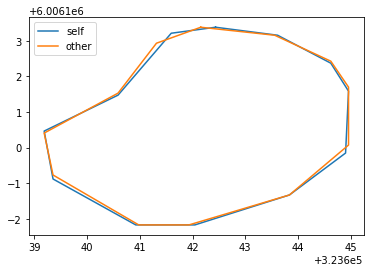

[[314 259]
 [313 260]
 [312 260]
 [311 260]
 [310 260]
 [309 260]
 [308 260]
 [307 260]
 [306 260]
 [305 260]
 [304 261]
 [303 261]
 [302 261]
 [301 261]
 [300 261]
 [299 261]
 [298 262]
 [297 262]
 [296 262]
 [295 262]
 [294 263]
 [293 263]
 [292 263]
 [291 263]
 [290 263]
 [289 264]
 [288 264]
 [287 265]
 [286 265]
 [285 266]
 [284 267]
 [283 267]
 [282 268]
 [282 269]
 [281 270]
 [280 271]
 [280 272]
 [280 273]
 [279 274]
 [279 275]
 [279 276]
 [279 277]
 [278 278]
 [278 279]
 [278 280]
 [278 281]
 [278 282]
 [278 283]
 [278 284]
 [278 285]
 [278 286]
 [278 287]
 [278 288]
 [279 289]
 [279 290]
 [279 291]
 [279 292]
 [279 293]
 [279 294]
 [279 295]
 [279 296]
 [279 297]
 [279 298]
 [279 299]
 [279 300]
 [279 301]
 [279 302]
 [279 303]
 [279 304]
 [279 305]
 [279 306]
 [279 307]
 [279 308]
 [279 309]
 [279 310]
 [279 311]
 [279 312]
 [279 313]
 [279 314]
 [279 315]
 [279 316]
 [279 317]
 [279 318]
 [279 319]
 [279 320]
 [279 321]
 [279 322]
 [280 323]
 [279 324]
 [279 325]
 [279 326]

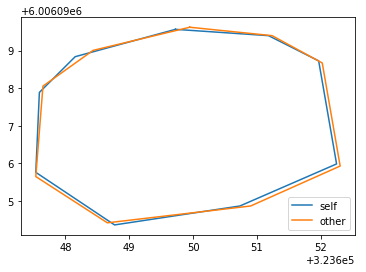

[[290  56]
 [289  57]
 [288  57]
 [287  57]
 [286  57]
 [285  58]
 [284  58]
 [283  58]
 [282  58]
 [281  58]
 [280  58]
 [279  59]
 [278  59]
 [277  59]
 [276  60]
 [275  60]
 [274  60]
 [273  61]
 [272  61]
 [271  62]
 [270  63]
 [269  64]
 [268  65]
 [267  65]
 [266  66]
 [266  67]
 [265  68]
 [264  69]
 [264  70]
 [263  71]
 [263  72]
 [262  73]
 [262  74]
 [262  75]
 [261  76]
 [261  77]
 [261  78]
 [261  79]
 [261  80]
 [261  81]
 [261  82]
 [261  83]
 [261  84]
 [261  85]
 [260  86]
 [260  87]
 [260  88]
 [260  89]
 [260  90]
 [260  91]
 [260  92]
 [260  93]
 [260  94]
 [260  95]
 [260  96]
 [260  97]
 [260  98]
 [260  99]
 [260 100]
 [260 101]
 [260 102]
 [260 103]
 [260 104]
 [260 105]
 [260 106]
 [260 107]
 [260 108]
 [260 109]
 [260 110]
 [260 111]
 [260 112]
 [260 113]
 [260 114]
 [260 115]
 [260 116]
 [260 117]
 [260 118]
 [260 119]
 [261 120]
 [261 121]
 [261 122]
 [261 123]
 [261 124]
 [262 125]
 [262 126]
 [263 126]
 [264 127]
 [265 128]
 [266 129]
 [267 130]
 [268 131]

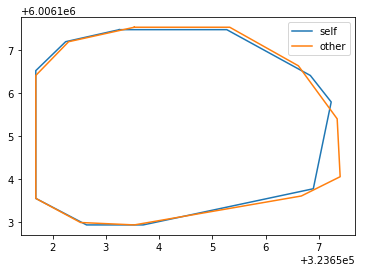

[[447 295]
 [446 296]
 [445 296]
 [444 296]
 [443 296]
 [442 297]
 [441 297]
 [440 297]
 [439 298]
 [438 299]
 [437 299]
 [436 300]
 [435 300]
 [434 301]
 [433 302]
 [432 302]
 [431 303]
 [430 304]
 [429 305]
 [428 305]
 [427 306]
 [426 307]
 [425 308]
 [424 308]
 [423 309]
 [422 310]
 [421 311]
 [420 312]
 [419 313]
 [419 314]
 [418 315]
 [417 316]
 [416 317]
 [416 318]
 [415 319]
 [415 320]
 [414 321]
 [414 322]
 [414 323]
 [413 324]
 [413 325]
 [413 326]
 [413 327]
 [412 328]
 [412 329]
 [412 330]
 [411 331]
 [411 332]
 [411 333]
 [411 334]
 [411 335]
 [411 336]
 [410 337]
 [411 338]
 [411 339]
 [410 340]
 [410 341]
 [410 342]
 [410 343]
 [410 344]
 [410 345]
 [410 346]
 [410 347]
 [410 348]
 [410 349]
 [410 350]
 [410 351]
 [409 352]
 [409 353]
 [409 354]
 [409 355]
 [409 356]
 [409 357]
 [409 358]
 [409 359]
 [410 360]
 [410 361]
 [411 362]
 [411 363]
 [412 364]
 [413 365]
 [413 366]
 [414 367]
 [415 368]
 [416 368]
 [417 368]
 [418 368]
 [419 368]
 [420 368]
 [421 368]
 [422 368]

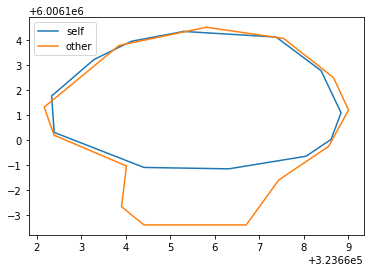

[[271 266]
 [270 267]
 [269 267]
 [268 267]
 [267 268]
 [266 268]
 [265 269]
 [264 269]
 [263 270]
 [262 270]
 [261 271]
 [260 271]
 [259 272]
 [258 272]
 [257 273]
 [256 273]
 [255 274]
 [254 275]
 [253 275]
 [252 276]
 [251 276]
 [250 277]
 [249 277]
 [248 278]
 [247 278]
 [246 278]
 [245 279]
 [244 279]
 [243 280]
 [242 280]
 [241 281]
 [240 281]
 [239 281]
 [238 281]
 [237 282]
 [236 282]
 [235 282]
 [234 283]
 [233 283]
 [232 283]
 [231 284]
 [230 284]
 [229 284]
 [228 284]
 [227 284]
 [226 285]
 [225 285]
 [224 285]
 [223 285]
 [222 286]
 [221 286]
 [220 286]
 [219 286]
 [218 287]
 [217 287]
 [216 287]
 [215 287]
 [214 288]
 [213 289]
 [212 290]
 [211 291]
 [210 292]
 [210 293]
 [210 294]
 [210 295]
 [210 296]
 [210 297]
 [210 298]
 [210 299]
 [210 300]
 [210 301]
 [210 302]
 [210 303]
 [211 304]
 [211 305]
 [211 306]
 [211 307]
 [211 308]
 [211 309]
 [212 310]
 [212 311]
 [212 312]
 [212 313]
 [213 314]
 [213 315]
 [214 316]
 [215 317]
 [215 318]
 [216 319]
 [217 320]
 [218 321]

[[528 203]
 [527 204]
 [526 204]
 [525 204]
 [524 204]
 [523 204]
 [522 204]
 [521 204]
 [520 204]
 [519 204]
 [518 204]
 [517 205]
 [516 205]
 [515 205]
 [514 205]
 [513 205]
 [512 205]
 [511 205]
 [510 205]
 [509 205]
 [508 206]
 [507 206]
 [506 206]
 [505 206]
 [504 205]
 [503 205]
 [502 205]
 [501 205]
 [500 205]
 [499 205]
 [498 205]
 [497 205]
 [496 205]
 [495 205]
 [494 205]
 [493 205]
 [492 205]
 [491 205]
 [490 205]
 [489 205]
 [488 205]
 [487 205]
 [486 205]
 [485 206]
 [484 206]
 [483 206]
 [482 207]
 [481 208]
 [480 209]
 [479 210]
 [479 211]
 [478 212]
 [478 213]
 [478 214]
 [477 215]
 [477 216]
 [477 217]
 [477 218]
 [477 219]
 [477 220]
 [477 221]
 [477 222]
 [477 223]
 [477 224]
 [477 225]
 [477 226]
 [477 227]
 [477 228]
 [477 229]
 [477 230]
 [477 231]
 [477 232]
 [477 233]
 [478 234]
 [478 235]
 [478 236]
 [478 237]
 [478 238]
 [479 239]
 [479 240]
 [479 241]
 [480 242]
 [480 243]
 [481 244]
 [481 245]
 [481 246]
 [482 247]
 [482 248]
 [483 249]
 [483 250]
 [484 251]

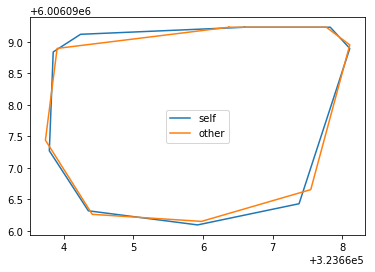

[[569 511]
 [568 512]
 [567 512]
 [566 513]
 [565 513]
 [564 514]
 [563 515]
 [562 516]
 [561 517]
 [560 518]
 [559 519]
 [558 520]
 [557 521]
 [556 522]
 [555 523]
 [554 523]
 [553 524]
 [552 525]
 [551 526]
 [550 527]
 [549 527]
 [548 528]
 [547 528]
 [546 529]
 [545 530]
 [544 530]
 [543 531]
 [542 531]
 [541 531]
 [540 532]
 [539 532]
 [538 533]
 [537 534]
 [536 535]
 [535 536]
 [534 537]
 [534 538]
 [534 539]
 [533 540]
 [533 541]
 [533 542]
 [533 543]
 [533 544]
 [533 545]
 [533 546]
 [533 547]
 [534 548]
 [534 549]
 [534 550]
 [534 551]
 [534 552]
 [535 553]
 [535 554]
 [535 555]
 [535 556]
 [535 557]
 [536 558]
 [536 559]
 [536 560]
 [536 561]
 [536 562]
 [536 563]
 [537 564]
 [537 565]
 [537 566]
 [537 567]
 [537 568]
 [538 569]
 [538 570]
 [538 571]
 [538 572]
 [539 573]
 [539 574]
 [540 575]
 [540 576]
 [540 577]
 [540 578]
 [541 579]
 [541 580]
 [541 581]
 [541 582]
 [542 583]
 [542 584]
 [542 585]
 [542 586]
 [543 587]
 [543 588]
 [543 589]
 [543 590]
 [544 591]
 [545 592]

28it [00:46,  1.40s/it]

[[107 471]
 [106 472]
 [105 472]
 [104 472]
 [103 472]
 [102 472]
 [101 472]
 [100 472]
 [ 99 472]
 [ 98 472]
 [ 97 472]
 [ 96 472]
 [ 95 472]
 [ 94 472]
 [ 93 472]
 [ 92 472]
 [ 91 472]
 [ 90 472]
 [ 89 472]
 [ 88 472]
 [ 87 472]
 [ 86 472]
 [ 85 472]
 [ 84 472]
 [ 83 472]
 [ 82 472]
 [ 81 472]
 [ 80 472]
 [ 79 473]
 [ 78 473]
 [ 77 473]
 [ 76 473]
 [ 75 473]
 [ 74 474]
 [ 73 474]
 [ 72 474]
 [ 71 475]
 [ 70 475]
 [ 69 476]
 [ 68 477]
 [ 67 478]
 [ 66 478]
 [ 66 479]
 [ 65 480]
 [ 64 480]
 [ 63 481]
 [ 63 482]
 [ 62 483]
 [ 61 484]
 [ 60 485]
 [ 59 486]
 [ 59 487]
 [ 58 488]
 [ 58 489]
 [ 57 490]
 [ 56 491]
 [ 56 492]
 [ 56 493]
 [ 55 494]
 [ 55 495]
 [ 55 496]
 [ 55 497]
 [ 54 498]
 [ 54 499]
 [ 53 500]
 [ 53 501]
 [ 53 502]
 [ 53 503]
 [ 53 504]
 [ 53 505]
 [ 53 506]
 [ 53 507]
 [ 54 508]
 [ 54 509]
 [ 53 510]
 [ 53 511]
 [ 54 512]
 [ 54 513]
 [ 55 514]
 [ 56 515]
 [ 57 516]
 [ 58 517]
 [ 59 518]
 [ 60 518]
 [ 61 518]
 [ 62 518]
 [ 63 518]
 [ 64 519]
 [ 65 520]
 [ 66 520]
 [ 67 521]

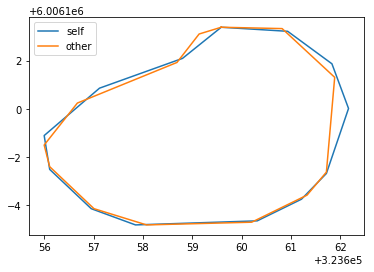

[[271 144]
 [270 145]
 [269 145]
 [268 145]
 [267 145]
 [266 145]
 [265 146]
 [264 146]
 [263 147]
 [262 147]
 [261 148]
 [260 149]
 [259 150]
 [259 151]
 [258 152]
 [258 153]
 [257 154]
 [257 155]
 [257 156]
 [256 157]
 [256 158]
 [256 159]
 [256 160]
 [256 161]
 [256 162]
 [255 163]
 [255 164]
 [255 165]
 [255 166]
 [255 167]
 [255 168]
 [255 169]
 [254 170]
 [254 171]
 [254 172]
 [254 173]
 [254 174]
 [254 175]
 [254 176]
 [254 177]
 [254 178]
 [253 179]
 [253 180]
 [253 181]
 [253 182]
 [253 183]
 [253 184]
 [253 185]
 [253 186]
 [253 187]
 [253 188]
 [253 189]
 [253 190]
 [253 191]
 [254 192]
 [254 193]
 [255 194]
 [255 195]
 [255 196]
 [256 197]
 [256 198]
 [257 199]
 [258 200]
 [259 200]
 [260 201]
 [261 202]
 [262 202]
 [263 203]
 [264 204]
 [264 205]
 [265 206]
 [266 206]
 [267 207]
 [268 208]
 [269 208]
 [270 209]
 [271 209]
 [272 210]
 [273 211]
 [274 211]
 [275 212]
 [276 213]
 [277 213]
 [278 214]
 [279 214]
 [280 215]
 [281 216]
 [282 216]
 [283 216]
 [284 217]
 [285 217]

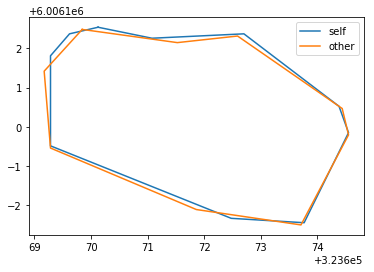

[[418 105]
 [417 106]
 [416 106]
 [415 106]
 [414 107]
 [413 107]
 [412 108]
 [411 108]
 [410 109]
 [409 110]
 [408 111]
 [407 112]
 [406 112]
 [405 113]
 [404 114]
 [403 114]
 [402 115]
 [401 116]
 [400 117]
 [399 118]
 [398 119]
 [397 120]
 [396 121]
 [395 122]
 [394 122]
 [393 123]
 [392 124]
 [391 125]
 [391 126]
 [390 127]
 [389 128]
 [388 129]
 [388 130]
 [387 131]
 [387 132]
 [387 133]
 [386 134]
 [386 135]
 [386 136]
 [385 137]
 [385 138]
 [385 139]
 [385 140]
 [384 141]
 [384 142]
 [384 143]
 [384 144]
 [384 145]
 [384 146]
 [384 147]
 [384 148]
 [384 149]
 [384 150]
 [384 151]
 [384 152]
 [384 153]
 [384 154]
 [384 155]
 [383 156]
 [383 157]
 [383 158]
 [383 159]
 [383 160]
 [383 161]
 [383 162]
 [383 163]
 [383 164]
 [383 165]
 [382 166]
 [382 167]
 [382 168]
 [381 169]
 [381 170]
 [381 171]
 [380 172]
 [380 173]
 [380 174]
 [379 175]
 [379 176]
 [379 177]
 [378 178]
 [378 179]
 [378 180]
 [378 181]
 [377 182]
 [377 183]
 [377 184]
 [377 185]
 [377 186]
 [377 187]
 [377 188]

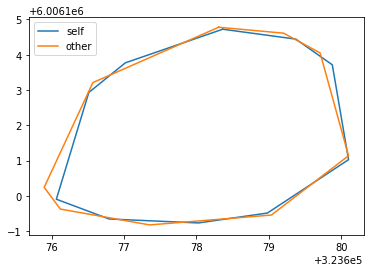

[[525 376]
 [524 377]
 [523 377]
 [522 377]
 [521 377]
 [520 377]
 [519 377]
 [518 377]
 [517 377]
 [516 378]
 [515 378]
 [514 378]
 [513 378]
 [512 378]
 [511 378]
 [510 378]
 [509 378]
 [508 378]
 [507 378]
 [506 378]
 [505 379]
 [504 379]
 [503 379]
 [502 379]
 [501 379]
 [500 379]
 [499 379]
 [498 379]
 [497 379]
 [496 380]
 [495 380]
 [494 380]
 [493 380]
 [492 381]
 [491 382]
 [490 383]
 [489 384]
 [489 385]
 [488 386]
 [488 387]
 [487 388]
 [487 389]
 [486 390]
 [485 391]
 [485 392]
 [484 393]
 [484 394]
 [484 395]
 [484 396]
 [484 397]
 [484 398]
 [484 399]
 [484 400]
 [484 401]
 [484 402]
 [484 403]
 [484 404]
 [484 405]
 [484 406]
 [484 407]
 [484 408]
 [483 409]
 [483 410]
 [484 411]
 [484 412]
 [484 413]
 [484 414]
 [484 415]
 [484 416]
 [484 417]
 [484 418]
 [484 419]
 [484 420]
 [484 421]
 [484 422]
 [485 423]
 [485 424]
 [485 425]
 [485 426]
 [485 427]
 [485 428]
 [485 429]
 [485 430]
 [485 431]
 [485 432]
 [486 433]
 [486 434]
 [486 435]
 [486 436]
 [486 437]
 [486 438]

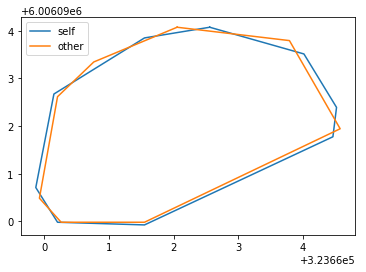

[[182 112]
 [181 113]
 [180 113]
 [179 113]
 [178 113]
 [177 114]
 [176 114]
 [175 114]
 [174 114]
 [173 115]
 [172 115]
 [171 115]
 [170 116]
 [169 116]
 [168 117]
 [167 117]
 [166 118]
 [165 118]
 [164 119]
 [163 119]
 [162 120]
 [161 121]
 [160 122]
 [159 123]
 [158 124]
 [157 124]
 [156 125]
 [155 126]
 [154 126]
 [153 127]
 [153 128]
 [152 129]
 [151 130]
 [150 131]
 [149 132]
 [148 133]
 [147 134]
 [147 135]
 [146 136]
 [145 137]
 [145 138]
 [144 139]
 [144 140]
 [143 141]
 [142 142]
 [142 143]
 [141 144]
 [141 145]
 [140 146]
 [140 147]
 [139 148]
 [138 149]
 [137 150]
 [137 151]
 [136 152]
 [135 153]
 [135 154]
 [134 155]
 [134 156]
 [134 157]
 [133 158]
 [133 159]
 [133 160]
 [133 161]
 [132 162]
 [132 163]
 [132 164]
 [132 165]
 [132 166]
 [132 167]
 [131 168]
 [131 169]
 [131 170]
 [131 171]
 [131 172]
 [131 173]
 [131 174]
 [131 175]
 [131 176]
 [132 177]
 [132 178]
 [132 179]
 [132 180]
 [132 181]
 [133 182]
 [133 183]
 [134 184]
 [134 185]
 [135 186]
 [136 187]
 [137 188]

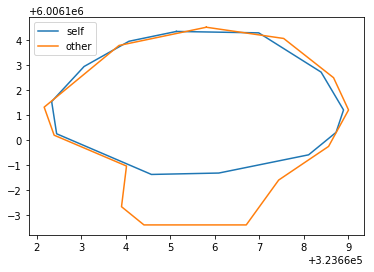

[[393 284]
 [392 285]
 [391 285]
 [390 285]
 [389 285]
 [388 285]
 [387 286]
 [386 286]
 [385 286]
 [384 286]
 [383 286]
 [382 287]
 [381 287]
 [380 287]
 [379 288]
 [378 288]
 [377 289]
 [376 290]
 [375 290]
 [374 290]
 [373 291]
 [372 291]
 [371 292]
 [370 292]
 [369 293]
 [368 294]
 [367 295]
 [366 296]
 [365 297]
 [364 298]
 [363 299]
 [362 300]
 [362 301]
 [361 302]
 [360 303]
 [359 304]
 [359 305]
 [358 306]
 [358 307]
 [357 308]
 [357 309]
 [356 310]
 [356 311]
 [356 312]
 [355 313]
 [355 314]
 [355 315]
 [354 316]
 [354 317]
 [354 318]
 [354 319]
 [353 320]
 [353 321]
 [353 322]
 [353 323]
 [353 324]
 [353 325]
 [353 326]
 [353 327]
 [353 328]
 [353 329]
 [353 330]
 [353 331]
 [353 332]
 [353 333]
 [353 334]
 [353 335]
 [354 336]
 [354 337]
 [354 338]
 [355 339]
 [355 340]
 [355 341]
 [355 342]
 [356 343]
 [357 344]
 [358 344]
 [359 345]
 [360 346]
 [361 346]
 [362 347]
 [363 347]
 [364 348]
 [365 348]
 [366 349]
 [367 349]
 [368 350]
 [369 350]
 [370 351]
 [371 351]
 [372 352]

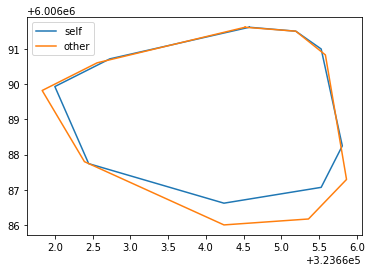

[[330 239]
 [329 240]
 [328 240]
 [327 240]
 [326 240]
 [325 240]
 [324 240]
 [323 240]
 [322 241]
 [321 241]
 [320 241]
 [319 242]
 [318 242]
 [317 243]
 [316 244]
 [315 244]
 [314 245]
 [313 246]
 [312 246]
 [311 247]
 [310 248]
 [309 248]
 [309 249]
 [308 250]
 [307 251]
 [307 252]
 [306 253]
 [305 254]
 [304 255]
 [303 256]
 [302 257]
 [301 258]
 [300 258]
 [299 259]
 [298 260]
 [297 260]
 [296 261]
 [295 261]
 [294 262]
 [294 263]
 [293 264]
 [293 265]
 [292 266]
 [291 267]
 [290 267]
 [289 268]
 [288 269]
 [287 269]
 [286 270]
 [285 271]
 [284 272]
 [283 273]
 [282 274]
 [281 275]
 [280 275]
 [279 276]
 [278 277]
 [278 278]
 [277 279]
 [276 280]
 [275 281]
 [274 282]
 [273 282]
 [272 283]
 [271 284]
 [270 285]
 [270 286]
 [269 287]
 [268 288]
 [267 289]
 [267 290]
 [266 291]
 [266 292]
 [265 293]
 [265 294]
 [265 295]
 [265 296]
 [265 297]
 [265 298]
 [265 299]
 [265 300]
 [265 301]
 [265 302]
 [265 303]
 [265 304]
 [265 305]
 [265 306]
 [265 307]
 [266 308]
 [266 309]
 [266 310]

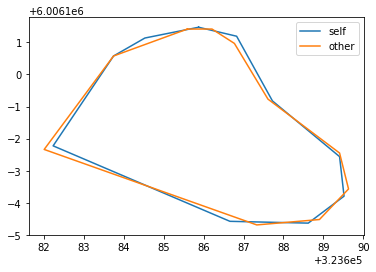

[[519 254]
 [518 255]
 [517 255]
 [516 256]
 [515 256]
 [514 257]
 [513 257]
 [512 258]
 [511 258]
 [510 259]
 [509 260]
 [508 261]
 [507 261]
 [506 262]
 [505 262]
 [504 263]
 [503 264]
 [502 265]
 [501 265]
 [500 265]
 [499 266]
 [498 266]
 [497 267]
 [496 268]
 [495 268]
 [494 268]
 [493 268]
 [492 269]
 [491 269]
 [490 270]
 [489 271]
 [488 272]
 [488 273]
 [487 274]
 [486 275]
 [485 276]
 [484 277]
 [484 278]
 [484 279]
 [483 280]
 [483 281]
 [483 282]
 [483 283]
 [483 284]
 [482 285]
 [482 286]
 [482 287]
 [482 288]
 [482 289]
 [482 290]
 [482 291]
 [482 292]
 [482 293]
 [482 294]
 [482 295]
 [482 296]
 [482 297]
 [482 298]
 [482 299]
 [482 300]
 [481 301]
 [481 302]
 [481 303]
 [481 304]
 [481 305]
 [481 306]
 [481 307]
 [481 308]
 [480 309]
 [480 310]
 [480 311]
 [480 312]
 [480 313]
 [479 314]
 [479 315]
 [479 316]
 [478 317]
 [478 318]
 [478 319]
 [478 320]
 [478 321]
 [478 322]
 [478 323]
 [478 324]
 [478 325]
 [478 326]
 [478 327]
 [478 328]
 [478 329]
 [478 330]
 [478 331]

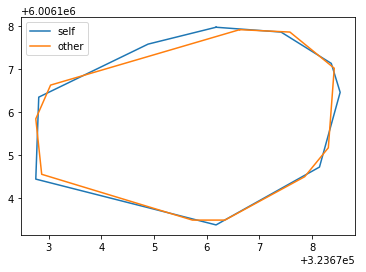

[[575 386]
 [574 387]
 [573 387]
 [572 387]
 [571 387]
 [570 387]
 [569 388]
 [568 388]
 [567 388]
 [566 389]
 [565 390]
 [564 390]
 [563 391]
 [563 392]
 [562 393]
 [561 394]
 [561 395]
 [560 396]
 [560 397]
 [559 398]
 [559 399]
 [558 400]
 [558 401]
 [557 402]
 [557 403]
 [557 404]
 [556 405]
 [556 406]
 [556 407]
 [555 408]
 [555 409]
 [555 410]
 [554 411]
 [554 412]
 [554 413]
 [553 414]
 [553 415]
 [553 416]
 [553 417]
 [552 418]
 [552 419]
 [552 420]
 [552 421]
 [551 422]
 [551 423]
 [551 424]
 [551 425]
 [550 426]
 [550 427]
 [550 428]
 [550 429]
 [550 430]
 [549 431]
 [549 432]
 [549 433]
 [549 434]
 [549 435]
 [548 436]
 [548 437]
 [548 438]
 [548 439]
 [548 440]
 [548 441]
 [547 442]
 [547 443]
 [547 444]
 [547 445]
 [547 446]
 [547 447]
 [546 448]
 [546 449]
 [546 450]
 [546 451]
 [546 452]
 [546 453]
 [546 454]
 [546 455]
 [546 456]
 [546 457]
 [546 458]
 [546 459]
 [546 460]
 [546 461]
 [546 462]
 [546 463]
 [546 464]
 [546 465]
 [547 466]
 [547 467]
 [547 468]
 [547 469]

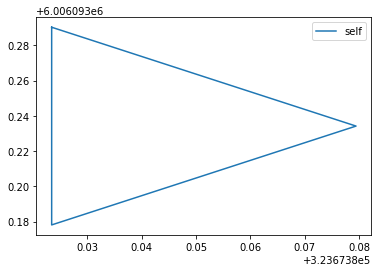

[[360 540]
 [359 541]
 [358 541]
 [357 541]
 [356 541]
 [355 541]
 [354 541]
 [353 542]
 [352 542]
 [351 542]
 [350 542]
 [349 543]
 [348 543]
 [347 543]
 [346 543]
 [345 543]
 [344 543]
 [343 543]
 [342 543]
 [341 543]
 [340 543]
 [339 543]
 [338 543]
 [337 543]
 [336 543]
 [335 543]
 [334 543]
 [333 543]
 [332 543]
 [331 544]
 [330 544]
 [329 545]
 [328 545]
 [327 546]
 [326 546]
 [325 547]
 [324 547]
 [323 548]
 [322 549]
 [321 550]
 [320 551]
 [319 552]
 [319 553]
 [318 554]
 [318 555]
 [317 556]
 [317 557]
 [316 558]
 [316 559]
 [316 560]
 [315 561]
 [315 562]
 [314 563]
 [314 564]
 [314 565]
 [314 566]
 [314 567]
 [313 568]
 [313 569]
 [313 570]
 [313 571]
 [313 572]
 [313 573]
 [313 574]
 [313 575]
 [313 576]
 [313 577]
 [313 578]
 [314 579]
 [314 580]
 [314 581]
 [314 582]
 [315 583]
 [315 584]
 [315 585]
 [315 586]
 [315 587]
 [315 588]
 [315 589]
 [316 590]
 [316 591]
 [316 592]
 [316 593]
 [316 594]
 [317 595]
 [318 596]
 [319 597]
 [320 598]
 [321 599]
 [322 600]
 [323 600]

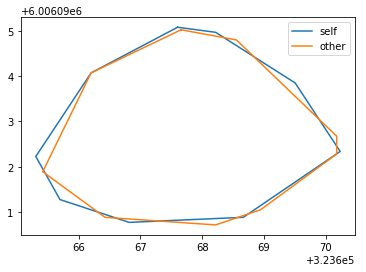

[[145 472]
 [144 473]
 [143 473]
 [142 473]
 [141 473]
 [140 473]
 [139 473]
 [138 474]
 [137 474]
 [136 474]
 [135 475]
 [134 475]
 [133 475]
 [132 476]
 [131 476]
 [130 477]
 [129 477]
 [128 477]
 [127 478]
 [126 478]
 [125 478]
 [124 479]
 [123 480]
 [122 480]
 [121 480]
 [120 481]
 [119 481]
 [118 482]
 [117 482]
 [116 483]
 [115 483]
 [114 484]
 [113 484]
 [112 485]
 [111 486]
 [110 487]
 [109 488]
 [109 489]
 [108 490]
 [108 491]
 [107 492]
 [107 493]
 [107 494]
 [107 495]
 [107 496]
 [106 497]
 [106 498]
 [106 499]
 [106 500]
 [106 501]
 [106 502]
 [106 503]
 [106 504]
 [106 505]
 [106 506]
 [106 507]
 [106 508]
 [106 509]
 [106 510]
 [106 511]
 [106 512]
 [106 513]
 [106 514]
 [106 515]
 [105 516]
 [105 517]
 [105 518]
 [106 519]
 [106 520]
 [106 521]
 [106 522]
 [106 523]
 [106 524]
 [106 525]
 [106 526]
 [107 527]
 [107 528]
 [107 529]
 [107 530]
 [108 531]
 [108 532]
 [109 533]
 [110 534]
 [110 535]
 [111 536]
 [112 537]
 [113 537]
 [114 538]
 [115 539]
 [116 539]
 [117 540]

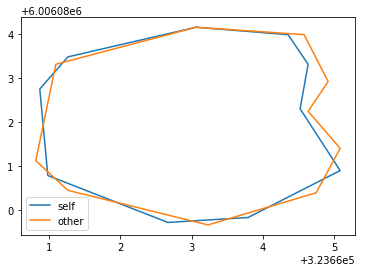

[[431 279]
 [430 280]
 [429 280]
 [428 281]
 [427 281]
 [426 282]
 [425 283]
 [424 284]
 [423 285]
 [423 286]
 [422 287]
 [422 288]
 [422 289]
 [422 290]
 [422 291]
 [422 292]
 [422 293]
 [422 294]
 [422 295]
 [422 296]
 [422 297]
 [422 298]
 [422 299]
 [422 300]
 [422 301]
 [422 302]
 [422 303]
 [422 304]
 [422 305]
 [422 306]
 [422 307]
 [423 308]
 [423 309]
 [423 310]
 [423 311]
 [423 312]
 [423 313]
 [423 314]
 [423 315]
 [423 316]
 [423 317]
 [423 318]
 [424 319]
 [424 320]
 [424 321]
 [424 322]
 [424 323]
 [424 324]
 [424 325]
 [424 326]
 [424 327]
 [424 328]
 [425 329]
 [425 330]
 [425 331]
 [426 332]
 [426 333]
 [426 334]
 [427 335]
 [428 336]
 [429 337]
 [430 338]
 [431 339]
 [432 340]
 [433 340]
 [434 340]
 [435 340]
 [436 341]
 [437 341]
 [438 341]
 [439 341]
 [440 341]
 [441 342]
 [442 342]
 [443 342]
 [444 342]
 [445 342]
 [446 342]
 [447 342]
 [448 342]
 [449 342]
 [450 342]
 [451 342]
 [452 341]
 [453 341]
 [454 341]
 [455 341]
 [456 340]
 [457 340]
 [458 340]
 [459 340]

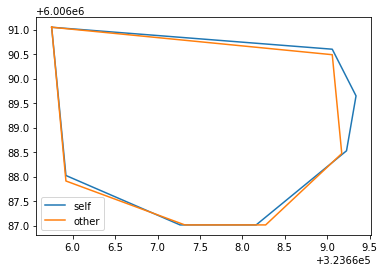

[[581 282]
 [580 283]
 [579 284]
 [578 285]
 [577 286]
 [576 286]
 [575 287]
 [574 288]
 [573 289]
 [573 290]
 [572 291]
 [571 292]
 [571 293]
 [570 294]
 [569 295]
 [569 296]
 [568 297]
 [567 298]
 [567 299]
 [566 300]
 [565 301]
 [564 302]
 [564 303]
 [563 304]
 [563 305]
 [562 306]
 [561 307]
 [561 308]
 [560 309]
 [560 310]
 [559 311]
 [559 312]
 [558 313]
 [558 314]
 [557 315]
 [557 316]
 [556 317]
 [555 318]
 [555 319]
 [554 320]
 [553 321]
 [553 322]
 [552 323]
 [552 324]
 [551 325]
 [551 326]
 [550 327]
 [549 328]
 [549 329]
 [548 330]
 [547 331]
 [546 332]
 [546 333]
 [545 334]
 [545 335]
 [544 336]
 [544 337]
 [543 338]
 [542 339]
 [541 340]
 [541 341]
 [540 342]
 [540 343]
 [539 344]
 [539 345]
 [538 346]
 [538 347]
 [537 348]
 [536 349]
 [536 350]
 [536 351]
 [536 352]
 [535 353]
 [535 354]
 [535 355]
 [536 356]
 [536 357]
 [536 358]
 [536 359]
 [536 360]
 [537 361]
 [537 362]
 [537 363]
 [538 364]
 [538 365]
 [538 366]
 [539 367]
 [539 368]
 [540 369]
 [541 370]
 [542 371]

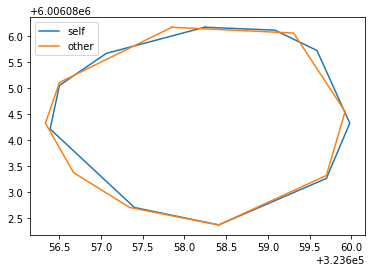

[[487 157]
 [486 158]
 [485 158]
 [484 158]
 [483 159]
 [482 159]
 [481 160]
 [480 160]
 [479 161]
 [478 161]
 [477 162]
 [476 162]
 [475 163]
 [474 163]
 [473 164]
 [472 164]
 [471 165]
 [470 166]
 [469 166]
 [468 167]
 [467 167]
 [466 168]
 [465 168]
 [464 169]
 [463 170]
 [462 171]
 [461 172]
 [461 173]
 [460 174]
 [460 175]
 [460 176]
 [459 177]
 [459 178]
 [459 179]
 [459 180]
 [459 181]
 [459 182]
 [459 183]
 [459 184]
 [459 185]
 [459 186]
 [460 187]
 [459 188]
 [459 189]
 [460 190]
 [460 191]
 [460 192]
 [460 193]
 [460 194]
 [460 195]
 [460 196]
 [460 197]
 [460 198]
 [460 199]
 [460 200]
 [461 201]
 [461 202]
 [461 203]
 [461 204]
 [460 205]
 [461 206]
 [461 207]
 [461 208]
 [461 209]
 [460 210]
 [460 211]
 [460 212]
 [461 213]
 [461 214]
 [461 215]
 [461 216]
 [461 217]
 [461 218]
 [462 219]
 [463 220]
 [463 221]
 [463 222]
 [463 223]
 [464 224]
 [465 225]
 [466 225]
 [467 226]
 [468 226]
 [469 227]
 [470 227]
 [471 227]
 [472 227]
 [473 228]
 [474 228]
 [475 228]
 [476 228]

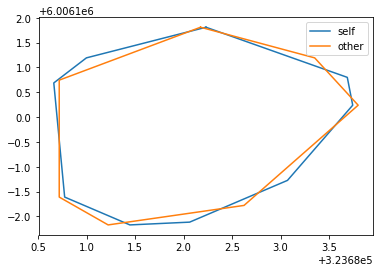

[[231 437]
 [230 438]
 [229 438]
 [228 438]
 [227 438]
 [226 438]
 [225 439]
 [224 439]
 [223 439]
 [222 440]
 [221 440]
 [220 441]
 [219 441]
 [218 442]
 [217 442]
 [216 443]
 [215 443]
 [214 444]
 [213 444]
 [212 444]
 [211 445]
 [210 445]
 [209 446]
 [208 446]
 [207 446]
 [206 446]
 [205 446]
 [204 447]
 [203 447]
 [202 448]
 [201 449]
 [201 450]
 [200 451]
 [199 452]
 [198 452]
 [197 453]
 [196 454]
 [195 455]
 [194 456]
 [193 457]
 [192 458]
 [192 459]
 [192 460]
 [191 461]
 [191 462]
 [191 463]
 [190 464]
 [190 465]
 [190 466]
 [191 467]
 [191 468]
 [191 469]
 [191 470]
 [191 471]
 [191 472]
 [191 473]
 [192 474]
 [192 475]
 [192 476]
 [192 477]
 [192 478]
 [192 479]
 [193 480]
 [193 481]
 [193 482]
 [193 483]
 [193 484]
 [193 485]
 [193 486]
 [194 487]
 [194 488]
 [194 489]
 [194 490]
 [194 491]
 [194 492]
 [194 493]
 [194 494]
 [195 495]
 [195 496]
 [195 497]
 [194 498]
 [194 499]
 [194 500]
 [194 501]
 [195 502]
 [195 503]
 [195 504]
 [194 505]
 [194 506]
 [194 507]
 [194 508]

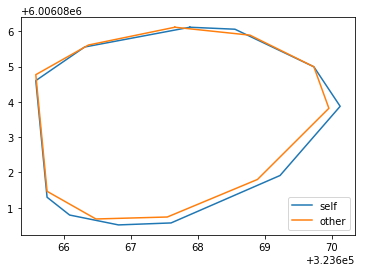

[[525 110]
 [524 111]
 [523 111]
 [522 111]
 [521 111]
 [520 112]
 [519 113]
 [518 113]
 [517 114]
 [516 115]
 [515 116]
 [515 117]
 [514 118]
 [513 119]
 [512 120]
 [511 121]
 [511 122]
 [510 123]
 [510 124]
 [509 125]
 [508 126]
 [507 127]
 [506 128]
 [505 129]
 [504 130]
 [503 131]
 [502 132]
 [501 133]
 [500 134]
 [499 135]
 [498 136]
 [498 137]
 [497 138]
 [497 139]
 [496 140]
 [496 141]
 [496 142]
 [495 143]
 [495 144]
 [495 145]
 [494 146]
 [494 147]
 [494 148]
 [494 149]
 [494 150]
 [494 151]
 [494 152]
 [494 153]
 [494 154]
 [494 155]
 [495 156]
 [495 157]
 [496 158]
 [496 159]
 [497 160]
 [498 161]
 [498 162]
 [499 163]
 [500 164]
 [500 165]
 [501 165]
 [502 166]
 [503 167]
 [504 168]
 [505 169]
 [506 170]
 [507 171]
 [508 172]
 [509 173]
 [510 173]
 [511 174]
 [512 174]
 [513 175]
 [514 175]
 [515 175]
 [516 175]
 [517 176]
 [518 176]
 [519 176]
 [520 175]
 [521 175]
 [522 175]
 [523 175]
 [524 175]
 [525 174]
 [526 174]
 [527 174]
 [528 174]
 [529 173]
 [530 173]
 [531 173]

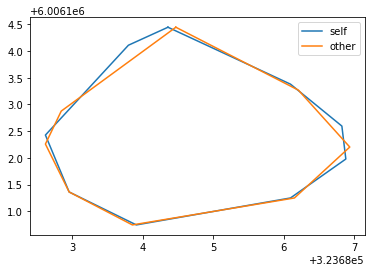

[[267 388]
 [266 389]
 [265 389]
 [264 389]
 [263 390]
 [262 390]
 [261 391]
 [260 392]
 [259 393]
 [258 394]
 [257 395]
 [256 396]
 [255 397]
 [255 398]
 [254 399]
 [254 400]
 [253 401]
 [252 402]
 [251 403]
 [251 404]
 [251 405]
 [250 406]
 [249 407]
 [249 408]
 [248 409]
 [248 410]
 [248 411]
 [247 412]
 [247 413]
 [246 414]
 [246 415]
 [246 416]
 [245 417]
 [245 418]
 [245 419]
 [244 420]
 [244 421]
 [244 422]
 [244 423]
 [244 424]
 [244 425]
 [244 426]
 [244 427]
 [244 428]
 [244 429]
 [244 430]
 [244 431]
 [244 432]
 [244 433]
 [244 434]
 [245 435]
 [245 436]
 [246 437]
 [246 438]
 [246 439]
 [247 440]
 [247 441]
 [248 442]
 [249 443]
 [249 444]
 [250 444]
 [251 445]
 [252 446]
 [253 447]
 [254 448]
 [255 449]
 [256 450]
 [257 451]
 [258 451]
 [259 452]
 [260 453]
 [261 454]
 [262 455]
 [263 456]
 [264 456]
 [265 456]
 [266 457]
 [267 457]
 [268 457]
 [269 457]
 [270 458]
 [271 458]
 [272 459]
 [273 459]
 [274 459]
 [275 460]
 [276 460]
 [277 460]
 [278 460]
 [279 461]
 [280 461]

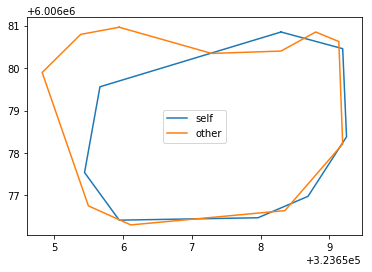

[[321 106]
 [320 107]
 [319 107]
 [318 108]
 [317 109]
 [317 110]
 [316 111]
 [316 112]
 [315 113]
 [315 114]
 [315 115]
 [315 116]
 [315 117]
 [315 118]
 [314 119]
 [314 120]
 [314 121]
 [314 122]
 [314 123]
 [314 124]
 [313 125]
 [313 126]
 [313 127]
 [313 128]
 [313 129]
 [313 130]
 [313 131]
 [312 132]
 [312 133]
 [312 134]
 [312 135]
 [312 136]
 [312 137]
 [312 138]
 [312 139]
 [312 140]
 [312 141]
 [312 142]
 [312 143]
 [312 144]
 [313 145]
 [313 146]
 [313 147]
 [314 148]
 [314 149]
 [315 150]
 [315 151]
 [316 152]
 [317 153]
 [318 154]
 [319 155]
 [320 156]
 [321 157]
 [322 157]
 [323 158]
 [324 159]
 [325 160]
 [326 160]
 [327 161]
 [328 162]
 [329 163]
 [330 164]
 [330 165]
 [331 166]
 [332 167]
 [333 167]
 [334 168]
 [335 169]
 [335 170]
 [336 171]
 [337 172]
 [338 173]
 [339 174]
 [339 175]
 [340 176]
 [341 177]
 [342 178]
 [342 179]
 [343 180]
 [344 181]
 [345 182]
 [346 183]
 [347 184]
 [348 185]
 [349 186]
 [350 187]
 [351 187]
 [352 188]
 [353 188]
 [354 189]
 [355 189]

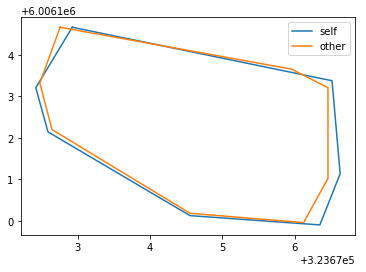

[[213 202]
 [212 203]
 [211 203]
 [210 203]
 [209 203]
 [208 203]
 [207 203]
 [206 203]
 [205 204]
 [204 204]
 [203 204]
 [202 204]
 [201 204]
 [200 204]
 [199 204]
 [198 204]
 [197 204]
 [196 204]
 [195 205]
 [194 205]
 [193 205]
 [192 205]
 [191 205]
 [190 205]
 [189 205]
 [188 205]
 [187 205]
 [186 206]
 [185 205]
 [184 205]
 [183 205]
 [182 205]
 [181 205]
 [180 205]
 [179 205]
 [178 205]
 [177 205]
 [176 205]
 [175 205]
 [174 205]
 [173 205]
 [172 205]
 [171 205]
 [170 205]
 [169 205]
 [168 205]
 [167 205]
 [166 205]
 [165 206]
 [164 206]
 [163 207]
 [162 207]
 [161 208]
 [160 209]
 [159 210]
 [158 211]
 [158 212]
 [158 213]
 [157 214]
 [157 215]
 [157 216]
 [157 217]
 [157 218]
 [156 219]
 [156 220]
 [156 221]
 [156 222]
 [156 223]
 [156 224]
 [156 225]
 [157 226]
 [157 227]
 [157 228]
 [157 229]
 [157 230]
 [157 231]
 [157 232]
 [158 233]
 [158 234]
 [158 235]
 [158 236]
 [158 237]
 [159 238]
 [159 239]
 [159 240]
 [160 241]
 [160 242]
 [160 243]
 [161 244]
 [161 245]
 [162 246]

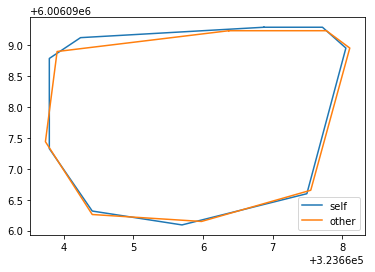

29it [00:48,  1.78s/it]

[[336  74]
 [335  75]
 [334  76]
 [333  76]
 [332  77]
 [331  77]
 [330  78]
 [329  79]
 [328  80]
 [328  81]
 [327  82]
 [326  83]
 [325  84]
 [324  85]
 [323  86]
 [322  87]
 [321  88]
 [321  89]
 [320  90]
 [319  91]
 [318  92]
 [317  93]
 [316  94]
 [316  95]
 [315  96]
 [314  97]
 [314  98]
 [313  99]
 [312 100]
 [311 100]
 [310 101]
 [309 102]
 [309 103]
 [308 104]
 [307 105]
 [306 106]
 [305 107]
 [304 108]
 [303 109]
 [302 110]
 [302 111]
 [301 112]
 [300 113]
 [299 114]
 [298 115]
 [297 116]
 [296 117]
 [295 118]
 [294 119]
 [293 120]
 [292 121]
 [291 122]
 [291 123]
 [290 124]
 [289 125]
 [288 126]
 [287 127]
 [286 128]
 [285 129]
 [284 130]
 [283 131]
 [282 132]
 [281 133]
 [280 134]
 [279 135]
 [279 136]
 [279 137]
 [279 138]
 [278 139]
 [278 140]
 [278 141]
 [278 142]
 [278 143]
 [278 144]
 [278 145]
 [278 146]
 [278 147]
 [278 148]
 [278 149]
 [278 150]
 [278 151]
 [278 152]
 [279 153]
 [279 154]
 [279 155]
 [280 156]
 [281 157]
 [282 158]
 [283 159]
 [284 159]
 [285 160]

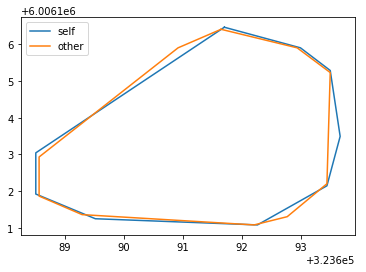

[[514 160]
 [513 161]
 [512 161]
 [511 161]
 [510 162]
 [509 162]
 [508 163]
 [507 163]
 [506 164]
 [505 164]
 [504 165]
 [503 165]
 [502 166]
 [501 167]
 [500 168]
 [499 169]
 [498 170]
 [497 171]
 [496 172]
 [495 172]
 [494 173]
 [494 174]
 [493 175]
 [492 176]
 [491 177]
 [491 178]
 [490 179]
 [489 180]
 [488 181]
 [487 182]
 [486 182]
 [485 183]
 [484 183]
 [483 184]
 [482 185]
 [481 185]
 [480 186]
 [479 186]
 [478 187]
 [477 187]
 [476 187]
 [475 187]
 [474 188]
 [473 188]
 [472 188]
 [471 189]
 [470 189]
 [469 189]
 [468 190]
 [467 190]
 [466 190]
 [465 190]
 [464 190]
 [463 191]
 [462 191]
 [461 192]
 [460 192]
 [459 193]
 [459 194]
 [458 195]
 [458 196]
 [457 197]
 [457 198]
 [457 199]
 [457 200]
 [457 201]
 [456 202]
 [457 203]
 [457 204]
 [457 205]
 [457 206]
 [457 207]
 [457 208]
 [457 209]
 [458 210]
 [458 211]
 [458 212]
 [458 213]
 [458 214]
 [458 215]
 [458 216]
 [459 217]
 [459 218]
 [459 219]
 [459 220]
 [459 221]
 [459 222]
 [460 223]
 [460 224]
 [460 225]
 [460 226]

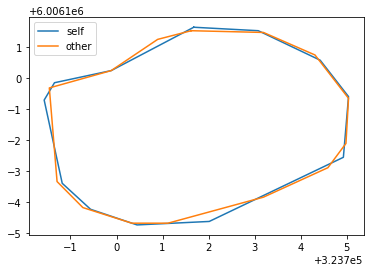

[[374 164]
 [373 165]
 [372 165]
 [371 165]
 [370 165]
 [369 166]
 [368 167]
 [368 168]
 [367 169]
 [367 170]
 [366 171]
 [366 172]
 [366 173]
 [366 174]
 [365 175]
 [365 176]
 [365 177]
 [364 178]
 [364 179]
 [363 180]
 [363 181]
 [362 182]
 [362 183]
 [361 184]
 [361 185]
 [361 186]
 [360 187]
 [360 188]
 [359 189]
 [359 190]
 [358 191]
 [358 192]
 [357 193]
 [356 194]
 [356 195]
 [356 196]
 [355 197]
 [355 198]
 [354 199]
 [354 200]
 [354 201]
 [353 202]
 [353 203]
 [353 204]
 [352 205]
 [352 206]
 [352 207]
 [352 208]
 [351 209]
 [351 210]
 [351 211]
 [351 212]
 [351 213]
 [351 214]
 [351 215]
 [351 216]
 [351 217]
 [351 218]
 [351 219]
 [351 220]
 [351 221]
 [351 222]
 [351 223]
 [351 224]
 [352 225]
 [352 226]
 [352 227]
 [352 228]
 [353 229]
 [353 230]
 [353 231]
 [354 232]
 [354 233]
 [355 234]
 [356 235]
 [356 236]
 [357 237]
 [357 238]
 [357 239]
 [358 240]
 [358 241]
 [359 242]
 [360 243]
 [361 244]
 [361 245]
 [362 246]
 [363 247]
 [363 248]
 [363 249]
 [363 250]
 [364 251]

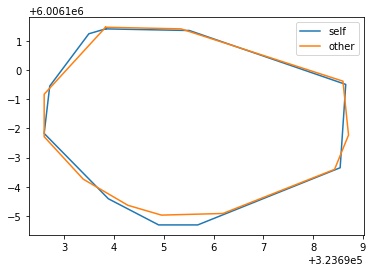

[[245  42]
 [244  43]
 [243  43]
 [242  43]
 [241  43]
 [240  43]
 [239  43]
 [238  44]
 [237  44]
 [236  45]
 [235  45]
 [234  46]
 [233  46]
 [232  47]
 [231  47]
 [230  48]
 [229  48]
 [228  49]
 [227  50]
 [226  50]
 [225  51]
 [224  52]
 [223  52]
 [222  53]
 [221  53]
 [220  54]
 [219  55]
 [218  56]
 [217  56]
 [216  56]
 [215  57]
 [214  57]
 [213  58]
 [212  59]
 [211  60]
 [210  61]
 [210  62]
 [209  63]
 [208  64]
 [207  65]
 [206  66]
 [205  67]
 [204  68]
 [203  69]
 [203  70]
 [202  71]
 [202  72]
 [201  73]
 [201  74]
 [200  75]
 [200  76]
 [199  77]
 [199  78]
 [199  79]
 [198  80]
 [198  81]
 [198  82]
 [198  83]
 [197  84]
 [197  85]
 [197  86]
 [197  87]
 [198  88]
 [198  89]
 [198  90]
 [198  91]
 [198  92]
 [198  93]
 [198  94]
 [199  95]
 [200  96]
 [200  97]
 [201  98]
 [202  99]
 [202 100]
 [203 101]
 [204 102]
 [205 103]
 [205 104]
 [205 105]
 [206 106]
 [206 107]
 [207 108]
 [208 109]
 [209 110]
 [210 110]
 [211 111]
 [212 112]
 [213 113]
 [213 114]
 [214 115]

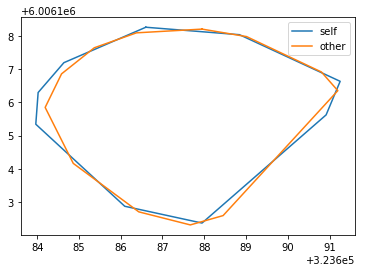

[[267 282]
 [266 283]
 [265 283]
 [264 283]
 [263 284]
 [262 284]
 [261 285]
 [260 285]
 [259 286]
 [258 287]
 [257 288]
 [256 289]
 [255 290]
 [254 291]
 [254 292]
 [253 293]
 [253 294]
 [252 295]
 [251 296]
 [250 297]
 [249 298]
 [249 299]
 [248 300]
 [247 301]
 [246 302]
 [246 303]
 [245 304]
 [245 305]
 [244 306]
 [243 307]
 [243 308]
 [242 309]
 [241 310]
 [241 311]
 [240 312]
 [239 313]
 [239 314]
 [238 315]
 [237 316]
 [237 317]
 [236 318]
 [236 319]
 [235 320]
 [234 321]
 [234 322]
 [233 323]
 [232 324]
 [232 325]
 [231 326]
 [230 327]
 [229 328]
 [229 329]
 [228 330]
 [227 331]
 [227 332]
 [226 333]
 [225 334]
 [225 335]
 [224 336]
 [224 337]
 [223 338]
 [223 339]
 [222 340]
 [221 341]
 [221 342]
 [220 343]
 [220 344]
 [220 345]
 [219 346]
 [219 347]
 [219 348]
 [218 349]
 [218 350]
 [217 351]
 [217 352]
 [217 353]
 [217 354]
 [217 355]
 [217 356]
 [218 357]
 [218 358]
 [218 359]
 [218 360]
 [218 361]
 [218 362]
 [218 363]
 [219 364]
 [219 365]
 [219 366]
 [220 367]
 [220 368]

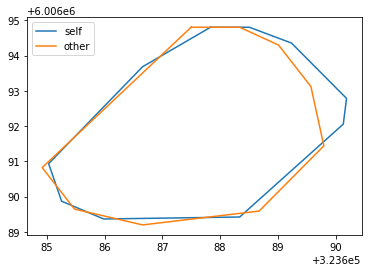

[[ 97 105]
 [ 96 106]
 [ 95 106]
 [ 94 107]
 [ 93 107]
 [ 92 108]
 [ 91 108]
 [ 90 109]
 [ 89 110]
 [ 88 110]
 [ 87 111]
 [ 86 112]
 [ 85 113]
 [ 84 113]
 [ 83 114]
 [ 82 115]
 [ 81 116]
 [ 80 117]
 [ 79 118]
 [ 78 119]
 [ 77 119]
 [ 76 120]
 [ 75 121]
 [ 74 122]
 [ 73 123]
 [ 72 124]
 [ 71 125]
 [ 70 126]
 [ 69 127]
 [ 69 128]
 [ 68 129]
 [ 68 130]
 [ 67 131]
 [ 66 132]
 [ 66 133]
 [ 65 134]
 [ 65 135]
 [ 65 136]
 [ 65 137]
 [ 64 138]
 [ 64 139]
 [ 64 140]
 [ 64 141]
 [ 64 142]
 [ 64 143]
 [ 63 144]
 [ 63 145]
 [ 63 146]
 [ 63 147]
 [ 63 148]
 [ 63 149]
 [ 63 150]
 [ 63 151]
 [ 63 152]
 [ 63 153]
 [ 63 154]
 [ 63 155]
 [ 62 156]
 [ 62 157]
 [ 62 158]
 [ 62 159]
 [ 62 160]
 [ 62 161]
 [ 62 162]
 [ 62 163]
 [ 61 164]
 [ 61 165]
 [ 61 166]
 [ 61 167]
 [ 61 168]
 [ 60 169]
 [ 60 170]
 [ 60 171]
 [ 60 172]
 [ 59 173]
 [ 59 174]
 [ 59 175]
 [ 59 176]
 [ 58 177]
 [ 58 178]
 [ 58 179]
 [ 58 180]
 [ 58 181]
 [ 58 182]
 [ 58 183]
 [ 58 184]
 [ 58 185]
 [ 58 186]
 [ 58 187]
 [ 58 188]
 [ 58 189]

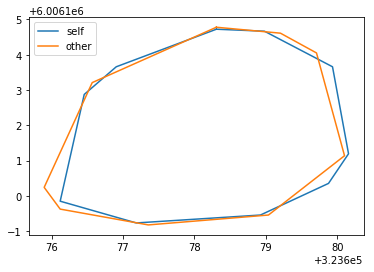

[[250 388]
 [249 389]
 [248 389]
 [247 389]
 [246 390]
 [245 391]
 [244 391]
 [243 392]
 [242 393]
 [242 394]
 [241 395]
 [241 396]
 [240 397]
 [240 398]
 [239 399]
 [239 400]
 [238 401]
 [238 402]
 [238 403]
 [237 404]
 [237 405]
 [237 406]
 [236 407]
 [236 408]
 [236 409]
 [236 410]
 [235 411]
 [235 412]
 [235 413]
 [234 414]
 [234 415]
 [234 416]
 [234 417]
 [233 418]
 [233 419]
 [233 420]
 [233 421]
 [232 422]
 [232 423]
 [232 424]
 [232 425]
 [231 426]
 [231 427]
 [231 428]
 [231 429]
 [230 430]
 [230 431]
 [230 432]
 [230 433]
 [229 434]
 [229 435]
 [229 436]
 [229 437]
 [229 438]
 [228 439]
 [228 440]
 [228 441]
 [228 442]
 [228 443]
 [228 444]
 [228 445]
 [227 446]
 [227 447]
 [227 448]
 [227 449]
 [227 450]
 [227 451]
 [227 452]
 [227 453]
 [227 454]
 [227 455]
 [227 456]
 [227 457]
 [227 458]
 [227 459]
 [227 460]
 [227 461]
 [227 462]
 [227 463]
 [227 464]
 [228 465]
 [228 466]
 [228 467]
 [228 468]
 [229 469]
 [229 470]
 [229 471]
 [230 472]
 [230 473]
 [230 474]
 [231 475]

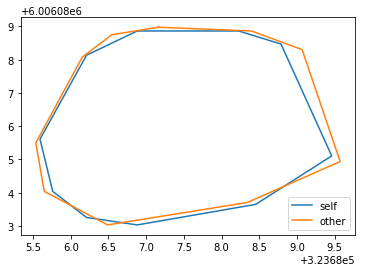

[[233 164]
 [232 165]
 [231 165]
 [230 165]
 [229 165]
 [228 165]
 [227 165]
 [226 165]
 [225 165]
 [224 165]
 [223 165]
 [222 166]
 [221 166]
 [220 166]
 [219 166]
 [218 167]
 [217 167]
 [216 167]
 [215 167]
 [214 167]
 [213 167]
 [212 168]
 [211 168]
 [210 168]
 [209 169]
 [208 169]
 [207 170]
 [206 170]
 [205 171]
 [204 171]
 [203 172]
 [202 173]
 [201 174]
 [200 175]
 [199 175]
 [198 176]
 [197 177]
 [196 178]
 [195 179]
 [195 180]
 [194 181]
 [193 182]
 [193 183]
 [192 184]
 [191 185]
 [191 186]
 [190 187]
 [190 188]
 [190 189]
 [190 190]
 [190 191]
 [189 192]
 [189 193]
 [188 194]
 [187 195]
 [187 196]
 [186 197]
 [186 198]
 [186 199]
 [185 200]
 [185 201]
 [184 202]
 [183 203]
 [183 204]
 [182 205]
 [182 206]
 [181 207]
 [181 208]
 [180 209]
 [179 210]
 [178 211]
 [177 212]
 [177 213]
 [176 214]
 [175 215]
 [174 216]
 [173 217]
 [172 217]
 [171 218]
 [170 219]
 [170 220]
 [170 221]
 [169 222]
 [169 223]
 [168 224]
 [168 225]
 [168 226]
 [168 227]
 [168 228]
 [169 229]
 [170 230]

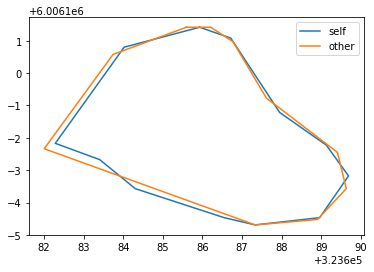

[[204 377]
 [203 378]
 [202 378]
 [201 378]
 [200 378]
 [199 378]
 [198 378]
 [197 378]
 [196 378]
 [195 378]
 [194 378]
 [193 379]
 [192 379]
 [191 379]
 [190 379]
 [189 379]
 [188 379]
 [187 379]
 [186 379]
 [185 379]
 [184 380]
 [183 380]
 [182 380]
 [181 380]
 [180 380]
 [179 380]
 [178 380]
 [177 379]
 [176 379]
 [175 379]
 [174 380]
 [173 381]
 [172 382]
 [171 382]
 [170 383]
 [169 383]
 [169 384]
 [168 385]
 [168 386]
 [168 387]
 [167 388]
 [167 389]
 [167 390]
 [166 391]
 [166 392]
 [165 393]
 [165 394]
 [165 395]
 [165 396]
 [165 397]
 [165 398]
 [165 399]
 [165 400]
 [165 401]
 [164 402]
 [164 403]
 [164 404]
 [164 405]
 [164 406]
 [164 407]
 [165 408]
 [165 409]
 [165 410]
 [165 411]
 [165 412]
 [165 413]
 [165 414]
 [165 415]
 [165 416]
 [165 417]
 [165 418]
 [165 419]
 [165 420]
 [165 421]
 [165 422]
 [165 423]
 [166 424]
 [166 425]
 [166 426]
 [166 427]
 [166 428]
 [166 429]
 [166 430]
 [166 431]
 [166 432]
 [166 433]
 [166 434]
 [166 435]
 [167 436]
 [167 437]
 [167 438]

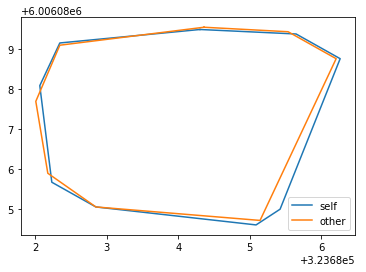

[[198 254]
 [197 255]
 [196 255]
 [195 256]
 [194 256]
 [193 257]
 [192 258]
 [191 258]
 [190 259]
 [189 259]
 [188 260]
 [187 261]
 [186 261]
 [185 262]
 [184 262]
 [183 263]
 [182 264]
 [181 264]
 [180 265]
 [179 265]
 [178 266]
 [177 267]
 [176 268]
 [175 268]
 [174 269]
 [173 269]
 [172 270]
 [171 271]
 [170 272]
 [170 273]
 [169 274]
 [169 275]
 [168 276]
 [167 277]
 [167 278]
 [166 279]
 [166 280]
 [165 281]
 [165 282]
 [165 283]
 [165 284]
 [164 285]
 [164 286]
 [164 287]
 [164 288]
 [164 289]
 [164 290]
 [164 291]
 [163 292]
 [163 293]
 [163 294]
 [163 295]
 [163 296]
 [163 297]
 [163 298]
 [163 299]
 [163 300]
 [162 301]
 [162 302]
 [162 303]
 [162 304]
 [162 305]
 [161 306]
 [161 307]
 [161 308]
 [161 309]
 [161 310]
 [161 311]
 [161 312]
 [160 313]
 [160 314]
 [160 315]
 [160 316]
 [159 317]
 [159 318]
 [159 319]
 [159 320]
 [159 321]
 [159 322]
 [159 323]
 [158 324]
 [158 325]
 [158 326]
 [158 327]
 [158 328]
 [158 329]
 [158 330]
 [158 331]
 [158 332]
 [158 333]
 [158 334]

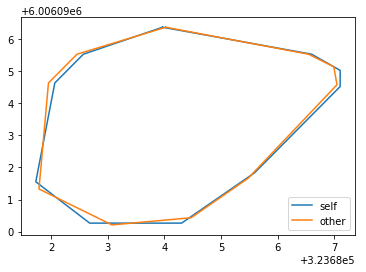

[[334 236]
 [333 237]
 [332 237]
 [331 237]
 [330 237]
 [329 238]
 [328 238]
 [327 238]
 [326 239]
 [325 239]
 [324 240]
 [323 240]
 [322 241]
 [321 241]
 [320 242]
 [319 242]
 [318 243]
 [317 244]
 [316 245]
 [315 245]
 [314 246]
 [313 246]
 [312 247]
 [311 248]
 [310 248]
 [309 249]
 [308 249]
 [307 250]
 [306 251]
 [305 252]
 [304 253]
 [303 254]
 [302 255]
 [301 256]
 [300 257]
 [299 258]
 [298 259]
 [297 260]
 [296 260]
 [296 261]
 [295 262]
 [295 263]
 [294 264]
 [294 265]
 [293 266]
 [292 267]
 [292 268]
 [292 269]
 [292 270]
 [292 271]
 [292 272]
 [292 273]
 [292 274]
 [292 275]
 [292 276]
 [292 277]
 [292 278]
 [292 279]
 [292 280]
 [292 281]
 [292 282]
 [292 283]
 [292 284]
 [292 285]
 [292 286]
 [292 287]
 [293 288]
 [294 289]
 [294 290]
 [295 291]
 [295 292]
 [296 293]
 [297 294]
 [297 295]
 [298 296]
 [298 297]
 [299 298]
 [299 299]
 [300 300]
 [300 301]
 [301 302]
 [302 303]
 [302 304]
 [303 305]
 [303 306]
 [304 307]
 [305 308]
 [305 309]
 [306 310]
 [307 311]
 [308 312]

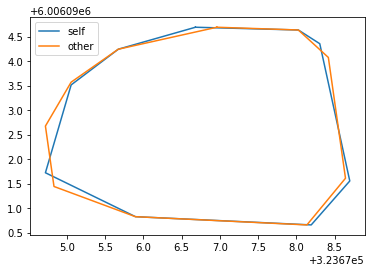

[[110 279]
 [109 280]
 [108 280]
 [107 280]
 [106 281]
 [105 282]
 [104 283]
 [103 284]
 [102 285]
 [102 286]
 [101 287]
 [101 288]
 [101 289]
 [101 290]
 [101 291]
 [101 292]
 [101 293]
 [101 294]
 [101 295]
 [101 296]
 [101 297]
 [101 298]
 [101 299]
 [101 300]
 [102 301]
 [102 302]
 [102 303]
 [102 304]
 [102 305]
 [102 306]
 [102 307]
 [102 308]
 [102 309]
 [102 310]
 [102 311]
 [103 312]
 [103 313]
 [103 314]
 [103 315]
 [103 316]
 [103 317]
 [103 318]
 [103 319]
 [103 320]
 [104 321]
 [104 322]
 [104 323]
 [104 324]
 [104 325]
 [104 326]
 [104 327]
 [105 328]
 [105 329]
 [105 330]
 [105 331]
 [106 332]
 [106 333]
 [107 334]
 [108 335]
 [108 336]
 [109 336]
 [110 337]
 [110 338]
 [111 339]
 [112 339]
 [113 340]
 [114 340]
 [115 340]
 [116 341]
 [117 341]
 [118 341]
 [119 341]
 [120 342]
 [121 342]
 [122 342]
 [123 342]
 [124 342]
 [125 342]
 [126 342]
 [127 342]
 [128 342]
 [129 342]
 [130 342]
 [131 342]
 [132 342]
 [133 342]
 [134 342]
 [135 342]
 [136 342]
 [137 341]
 [138 341]

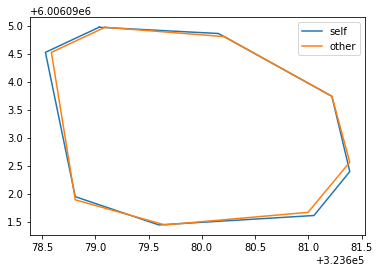

[[144 374]
 [143 375]
 [142 375]
 [141 375]
 [140 376]
 [139 376]
 [138 377]
 [137 378]
 [136 379]
 [135 379]
 [134 380]
 [133 381]
 [132 382]
 [131 383]
 [130 383]
 [129 384]
 [128 385]
 [127 386]
 [126 387]
 [125 388]
 [124 389]
 [123 389]
 [122 390]
 [121 391]
 [120 392]
 [119 393]
 [118 394]
 [117 395]
 [117 396]
 [116 397]
 [115 398]
 [115 399]
 [115 400]
 [114 401]
 [114 402]
 [114 403]
 [113 404]
 [113 405]
 [113 406]
 [112 407]
 [112 408]
 [112 409]
 [112 410]
 [112 411]
 [111 412]
 [111 413]
 [111 414]
 [111 415]
 [110 416]
 [110 417]
 [110 418]
 [110 419]
 [110 420]
 [110 421]
 [109 422]
 [109 423]
 [109 424]
 [109 425]
 [109 426]
 [109 427]
 [109 428]
 [109 429]
 [109 430]
 [108 431]
 [108 432]
 [109 433]
 [109 434]
 [109 435]
 [109 436]
 [109 437]
 [109 438]
 [109 439]
 [109 440]
 [109 441]
 [110 442]
 [110 443]
 [110 444]
 [111 445]
 [111 446]
 [112 447]
 [112 448]
 [113 449]
 [114 450]
 [114 451]
 [115 452]
 [115 453]
 [116 454]
 [117 455]
 [118 456]
 [119 456]
 [120 457]

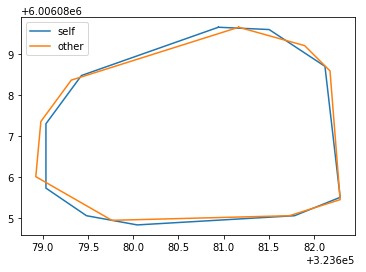

[[451 266]
 [450 267]
 [449 267]
 [448 267]
 [447 267]
 [446 268]
 [445 268]
 [444 269]
 [443 269]
 [442 269]
 [441 270]
 [440 270]
 [439 271]
 [438 272]
 [437 272]
 [436 273]
 [435 273]
 [434 274]
 [433 275]
 [432 276]
 [431 276]
 [430 277]
 [429 277]
 [428 278]
 [427 278]
 [426 279]
 [425 280]
 [424 280]
 [423 281]
 [422 282]
 [421 283]
 [420 284]
 [419 285]
 [418 285]
 [417 286]
 [416 287]
 [415 287]
 [414 288]
 [413 289]
 [412 290]
 [411 291]
 [410 292]
 [409 293]
 [408 293]
 [407 294]
 [406 295]
 [405 296]
 [404 297]
 [403 298]
 [402 299]
 [401 300]
 [401 301]
 [400 302]
 [400 303]
 [399 304]
 [399 305]
 [399 306]
 [398 307]
 [398 308]
 [398 309]
 [397 310]
 [397 311]
 [397 312]
 [397 313]
 [398 314]
 [398 315]
 [398 316]
 [399 317]
 [399 318]
 [399 319]
 [400 320]
 [400 321]
 [400 322]
 [401 323]
 [402 324]
 [403 325]
 [404 326]
 [405 327]
 [406 328]
 [407 328]
 [408 329]
 [409 330]
 [410 331]
 [411 332]
 [412 332]
 [413 333]
 [414 334]
 [415 335]
 [416 336]
 [417 337]
 [418 338]

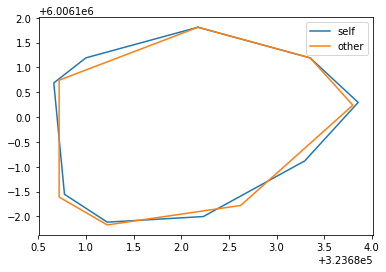

[[201 110]
 [200 111]
 [199 112]
 [198 113]
 [197 114]
 [196 115]
 [195 116]
 [195 117]
 [194 118]
 [194 119]
 [193 120]
 [192 121]
 [191 122]
 [191 123]
 [190 124]
 [190 125]
 [189 126]
 [188 126]
 [187 127]
 [186 128]
 [185 129]
 [184 130]
 [183 131]
 [182 131]
 [181 132]
 [180 133]
 [179 134]
 [178 135]
 [177 136]
 [177 137]
 [176 138]
 [176 139]
 [176 140]
 [175 141]
 [175 142]
 [174 143]
 [174 144]
 [174 145]
 [174 146]
 [173 147]
 [173 148]
 [173 149]
 [173 150]
 [173 151]
 [173 152]
 [173 153]
 [173 154]
 [174 155]
 [174 156]
 [175 157]
 [175 158]
 [176 159]
 [177 160]
 [177 161]
 [178 162]
 [179 163]
 [179 164]
 [180 165]
 [181 165]
 [182 166]
 [183 167]
 [184 168]
 [185 169]
 [186 170]
 [187 171]
 [188 172]
 [189 172]
 [190 173]
 [191 173]
 [192 174]
 [193 174]
 [194 175]
 [195 175]
 [196 175]
 [197 175]
 [198 175]
 [199 175]
 [200 175]
 [201 175]
 [202 174]
 [203 174]
 [204 174]
 [205 174]
 [206 174]
 [207 173]
 [208 173]
 [209 173]
 [210 173]
 [211 173]
 [212 172]
 [213 172]

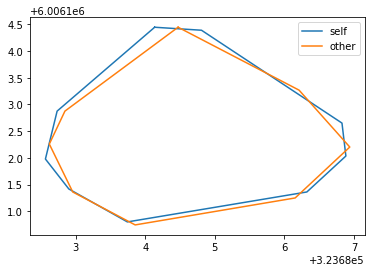

[[297 392]
 [296 393]
 [295 393]
 [294 393]
 [293 393]
 [292 394]
 [291 394]
 [291 395]
 [290 396]
 [290 397]
 [290 398]
 [290 399]
 [290 400]
 [290 401]
 [290 402]
 [290 403]
 [290 404]
 [290 405]
 [290 406]
 [290 407]
 [290 408]
 [290 409]
 [290 410]
 [290 411]
 [291 412]
 [291 413]
 [291 414]
 [291 415]
 [291 416]
 [292 417]
 [292 418]
 [292 419]
 [292 420]
 [292 421]
 [292 422]
 [293 423]
 [293 424]
 [293 425]
 [293 426]
 [294 427]
 [294 428]
 [294 429]
 [294 430]
 [295 431]
 [295 432]
 [295 433]
 [295 434]
 [296 435]
 [296 436]
 [296 437]
 [296 438]
 [296 439]
 [297 440]
 [297 441]
 [297 442]
 [297 443]
 [297 444]
 [298 445]
 [298 446]
 [298 447]
 [299 448]
 [300 449]
 [300 450]
 [301 451]
 [302 452]
 [303 453]
 [304 454]
 [305 455]
 [306 455]
 [307 455]
 [308 456]
 [309 456]
 [310 456]
 [311 456]
 [312 456]
 [313 456]
 [314 456]
 [315 456]
 [316 456]
 [317 456]
 [318 456]
 [319 456]
 [320 456]
 [321 456]
 [322 456]
 [323 456]
 [324 456]
 [325 456]
 [326 456]
 [327 456]
 [328 456]

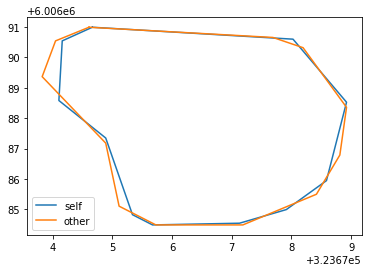

30it [00:51,  1.95s/it]

[[273 503]
 [272 504]
 [271 504]
 [270 504]
 [269 505]
 [268 505]
 [267 505]
 [266 506]
 [265 506]
 [264 506]
 [263 507]
 [262 507]
 [261 508]
 [260 509]
 [259 509]
 [258 510]
 [257 511]
 [256 511]
 [256 512]
 [255 513]
 [255 514]
 [254 515]
 [254 516]
 [254 517]
 [253 518]
 [253 519]
 [253 520]
 [253 521]
 [253 522]
 [253 523]
 [253 524]
 [253 525]
 [253 526]
 [254 527]
 [254 528]
 [255 529]
 [255 530]
 [255 531]
 [255 532]
 [256 533]
 [256 534]
 [257 535]
 [258 536]
 [258 537]
 [258 538]
 [258 539]
 [259 540]
 [259 541]
 [259 542]
 [260 543]
 [260 544]
 [261 545]
 [261 546]
 [261 547]
 [262 548]
 [262 549]
 [263 550]
 [263 551]
 [264 552]
 [265 553]
 [265 554]
 [266 555]
 [267 556]
 [268 557]
 [268 558]
 [269 559]
 [270 560]
 [271 561]
 [272 562]
 [273 563]
 [273 564]
 [274 565]
 [274 566]
 [275 567]
 [275 568]
 [276 569]
 [276 570]
 [277 571]
 [277 572]
 [278 573]
 [279 574]
 [279 575]
 [280 576]
 [281 577]
 [282 578]
 [283 579]
 [284 579]
 [285 580]
 [286 581]
 [287 581]
 [288 581]

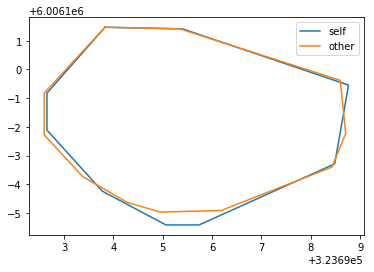

[[193 161]
 [192 162]
 [191 162]
 [190 162]
 [189 162]
 [188 163]
 [187 163]
 [186 163]
 [185 164]
 [184 165]
 [183 165]
 [182 166]
 [181 167]
 [180 168]
 [179 168]
 [178 169]
 [177 170]
 [177 171]
 [176 172]
 [175 173]
 [174 174]
 [173 175]
 [172 176]
 [171 177]
 [170 178]
 [170 179]
 [169 180]
 [168 181]
 [167 182]
 [166 182]
 [165 183]
 [164 184]
 [163 185]
 [162 185]
 [161 186]
 [160 186]
 [159 187]
 [158 187]
 [157 188]
 [156 188]
 [155 188]
 [154 189]
 [153 189]
 [152 189]
 [151 189]
 [150 189]
 [149 189]
 [148 189]
 [147 190]
 [146 190]
 [145 190]
 [144 191]
 [143 191]
 [142 192]
 [141 192]
 [140 193]
 [139 194]
 [139 195]
 [138 196]
 [138 197]
 [137 198]
 [137 199]
 [137 200]
 [137 201]
 [137 202]
 [137 203]
 [137 204]
 [137 205]
 [137 206]
 [137 207]
 [137 208]
 [137 209]
 [137 210]
 [138 211]
 [138 212]
 [138 213]
 [138 214]
 [138 215]
 [138 216]
 [138 217]
 [138 218]
 [139 219]
 [139 220]
 [139 221]
 [139 222]
 [139 223]
 [139 224]
 [139 225]
 [139 226]
 [140 227]
 [140 228]

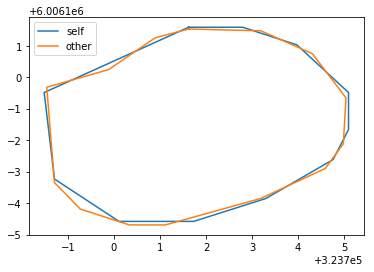

[[336 457]
 [335 458]
 [334 458]
 [333 458]
 [332 459]
 [331 459]
 [330 460]
 [329 460]
 [328 461]
 [327 461]
 [326 462]
 [325 463]
 [324 463]
 [323 464]
 [322 464]
 [321 465]
 [320 466]
 [319 466]
 [318 467]
 [317 468]
 [316 468]
 [315 469]
 [314 470]
 [313 471]
 [312 471]
 [311 472]
 [310 473]
 [309 473]
 [308 474]
 [307 474]
 [306 475]
 [305 475]
 [304 476]
 [303 477]
 [302 477]
 [301 478]
 [300 479]
 [299 479]
 [298 480]
 [297 481]
 [296 482]
 [295 483]
 [294 484]
 [293 485]
 [292 485]
 [291 486]
 [290 487]
 [289 488]
 [288 489]
 [288 490]
 [287 491]
 [286 492]
 [285 493]
 [285 494]
 [284 495]
 [284 496]
 [283 497]
 [283 498]
 [282 499]
 [282 500]
 [282 501]
 [281 502]
 [281 503]
 [281 504]
 [281 505]
 [281 506]
 [280 507]
 [280 508]
 [280 509]
 [280 510]
 [280 511]
 [280 512]
 [280 513]
 [280 514]
 [280 515]
 [280 516]
 [280 517]
 [280 518]
 [280 519]
 [280 520]
 [280 521]
 [280 522]
 [280 523]
 [280 524]
 [280 525]
 [280 526]
 [280 527]
 [280 528]
 [280 529]
 [280 530]
 [280 531]

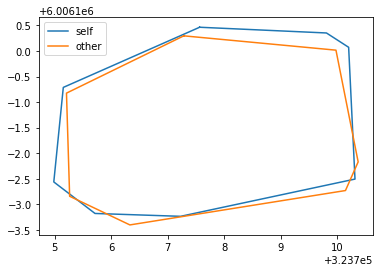

[[497 356]
 [496 357]
 [495 357]
 [494 357]
 [493 357]
 [492 357]
 [491 357]
 [490 357]
 [489 357]
 [488 357]
 [487 357]
 [486 358]
 [485 358]
 [484 358]
 [483 358]
 [482 358]
 [481 358]
 [480 358]
 [479 358]
 [478 358]
 [477 358]
 [476 358]
 [475 358]
 [474 358]
 [473 358]
 [472 358]
 [471 358]
 [470 358]
 [469 358]
 [468 358]
 [467 359]
 [466 359]
 [465 359]
 [464 360]
 [463 360]
 [462 361]
 [461 361]
 [460 362]
 [459 362]
 [458 362]
 [457 363]
 [456 363]
 [455 364]
 [454 365]
 [453 366]
 [452 366]
 [452 367]
 [451 368]
 [450 369]
 [450 370]
 [449 371]
 [449 372]
 [449 373]
 [449 374]
 [448 375]
 [448 376]
 [448 377]
 [448 378]
 [448 379]
 [447 380]
 [447 381]
 [447 382]
 [447 383]
 [447 384]
 [447 385]
 [447 386]
 [447 387]
 [447 388]
 [447 389]
 [447 390]
 [447 391]
 [447 392]
 [447 393]
 [447 394]
 [448 395]
 [448 396]
 [448 397]
 [449 398]
 [449 399]
 [449 400]
 [450 401]
 [450 402]
 [451 403]
 [451 404]
 [452 405]
 [453 406]
 [454 407]
 [455 408]
 [456 409]
 [457 409]
 [458 410]

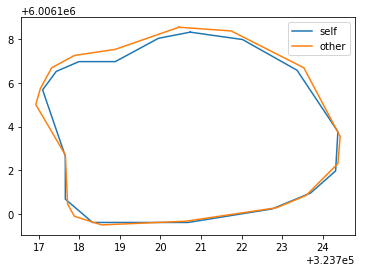

[[503 407]
 [502 408]
 [501 408]
 [500 408]
 [499 408]
 [498 409]
 [497 409]
 [496 410]
 [495 410]
 [494 411]
 [493 411]
 [492 412]
 [491 412]
 [490 413]
 [489 413]
 [488 414]
 [487 415]
 [486 415]
 [486 416]
 [485 417]
 [484 418]
 [484 419]
 [484 420]
 [483 421]
 [483 422]
 [483 423]
 [483 424]
 [483 425]
 [483 426]
 [483 427]
 [483 428]
 [483 429]
 [483 430]
 [483 431]
 [484 432]
 [484 433]
 [484 434]
 [484 435]
 [484 436]
 [484 437]
 [484 438]
 [485 439]
 [485 440]
 [485 441]
 [485 442]
 [485 443]
 [486 444]
 [486 445]
 [486 446]
 [486 447]
 [487 448]
 [487 449]
 [487 450]
 [487 451]
 [488 452]
 [488 453]
 [488 454]
 [489 455]
 [489 456]
 [489 457]
 [490 458]
 [490 459]
 [491 460]
 [491 461]
 [491 462]
 [492 463]
 [492 464]
 [493 465]
 [493 466]
 [494 467]
 [495 468]
 [495 469]
 [496 470]
 [496 471]
 [497 472]
 [498 473]
 [499 473]
 [500 474]
 [501 475]
 [502 476]
 [503 476]
 [504 477]
 [505 477]
 [506 477]
 [507 477]
 [508 477]
 [509 477]
 [510 477]
 [511 477]
 [512 477]
 [513 476]

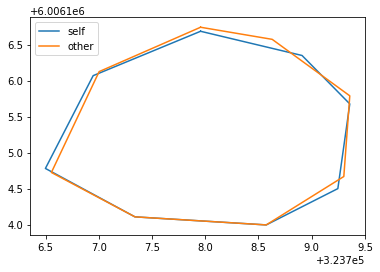

[[260 300]
 [259 301]
 [258 301]
 [257 301]
 [256 302]
 [255 302]
 [254 303]
 [253 304]
 [252 304]
 [251 305]
 [250 306]
 [249 307]
 [248 308]
 [247 309]
 [246 310]
 [245 310]
 [244 311]
 [243 312]
 [243 313]
 [242 314]
 [241 315]
 [240 316]
 [239 317]
 [238 317]
 [237 318]
 [236 319]
 [235 319]
 [234 320]
 [233 321]
 [232 322]
 [231 323]
 [230 324]
 [229 325]
 [228 325]
 [227 326]
 [226 327]
 [225 328]
 [224 329]
 [224 330]
 [223 331]
 [222 332]
 [222 333]
 [221 334]
 [221 335]
 [220 336]
 [220 337]
 [220 338]
 [220 339]
 [219 340]
 [218 341]
 [218 342]
 [218 343]
 [218 344]
 [218 345]
 [218 346]
 [217 347]
 [217 348]
 [217 349]
 [217 350]
 [217 351]
 [217 352]
 [218 353]
 [217 354]
 [217 355]
 [217 356]
 [217 357]
 [218 358]
 [218 359]
 [219 360]
 [219 361]
 [219 362]
 [220 363]
 [220 364]
 [221 365]
 [221 366]
 [222 367]
 [223 368]
 [224 369]
 [225 370]
 [226 371]
 [227 372]
 [228 372]
 [229 373]
 [230 374]
 [231 374]
 [232 375]
 [233 376]
 [234 377]
 [235 378]
 [236 379]
 [237 379]

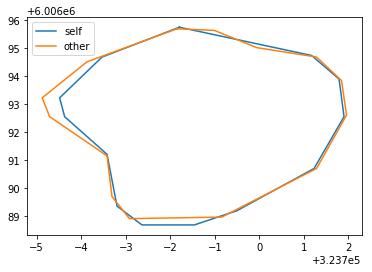

[[387 256]
 [387 257]
 [386 258]
 [385 259]
 [384 259]
 [383 260]
 [382 261]
 [381 262]
 [380 262]
 [380 263]
 [379 264]
 [378 264]
 [377 265]
 [377 266]
 [376 267]
 [376 268]
 [376 269]
 [376 270]
 [376 271]
 [375 272]
 [375 273]
 [375 274]
 [376 275]
 [376 276]
 [376 277]
 [376 278]
 [377 279]
 [377 280]
 [378 281]
 [378 282]
 [378 283]
 [379 284]
 [379 285]
 [380 286]
 [380 287]
 [380 288]
 [381 289]
 [381 290]
 [381 291]
 [381 292]
 [382 293]
 [382 294]
 [382 295]
 [383 296]
 [383 297]
 [383 298]
 [384 299]
 [384 300]
 [385 301]
 [386 302]
 [387 303]
 [388 303]
 [389 304]
 [390 304]
 [391 305]
 [392 305]
 [393 305]
 [394 305]
 [395 305]
 [396 306]
 [397 306]
 [398 306]
 [399 306]
 [400 306]
 [401 306]
 [402 306]
 [403 306]
 [404 306]
 [405 306]
 [406 306]
 [407 306]
 [408 306]
 [409 306]
 [410 307]
 [411 307]
 [412 307]
 [413 307]
 [414 307]
 [415 307]
 [416 307]
 [417 307]
 [418 307]
 [419 306]
 [420 306]
 [421 306]
 [422 306]
 [423 305]
 [423 304]
 [424 303]
 [424 302]
 [424 301]

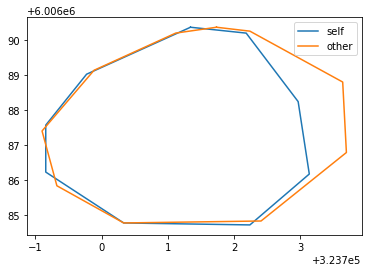

[[450 238]
 [449 239]
 [448 239]
 [447 239]
 [446 239]
 [445 240]
 [444 240]
 [443 241]
 [442 241]
 [441 241]
 [440 241]
 [439 241]
 [438 241]
 [437 242]
 [436 242]
 [435 242]
 [434 243]
 [433 243]
 [432 243]
 [431 244]
 [430 244]
 [429 245]
 [428 245]
 [427 246]
 [426 247]
 [426 248]
 [425 249]
 [424 250]
 [423 251]
 [423 252]
 [422 253]
 [422 254]
 [421 255]
 [421 256]
 [421 257]
 [421 258]
 [421 259]
 [421 260]
 [421 261]
 [421 262]
 [421 263]
 [421 264]
 [421 265]
 [421 266]
 [421 267]
 [421 268]
 [421 269]
 [421 270]
 [421 271]
 [421 272]
 [422 273]
 [422 274]
 [422 275]
 [422 276]
 [422 277]
 [422 278]
 [422 279]
 [422 280]
 [422 281]
 [423 282]
 [423 283]
 [423 284]
 [423 285]
 [423 286]
 [423 287]
 [423 288]
 [423 289]
 [423 290]
 [423 291]
 [423 292]
 [423 293]
 [423 294]
 [423 295]
 [423 296]
 [423 297]
 [423 298]
 [423 299]
 [423 300]
 [424 301]
 [424 302]
 [424 303]
 [424 304]
 [424 305]
 [425 306]
 [425 307]
 [426 308]
 [427 308]
 [428 309]
 [429 310]
 [430 310]
 [431 311]

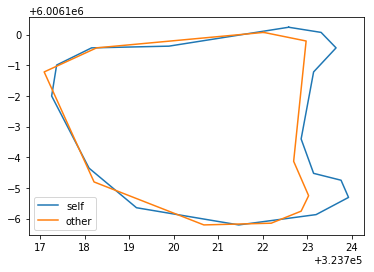

[[230 487]
 [229 488]
 [228 489]
 [227 489]
 [226 489]
 [225 489]
 [224 490]
 [223 490]
 [222 491]
 [221 492]
 [220 493]
 [219 494]
 [219 495]
 [219 496]
 [219 497]
 [218 498]
 [218 499]
 [218 500]
 [218 501]
 [218 502]
 [218 503]
 [218 504]
 [218 505]
 [218 506]
 [218 507]
 [218 508]
 [218 509]
 [218 510]
 [218 511]
 [218 512]
 [219 513]
 [219 514]
 [219 515]
 [219 516]
 [219 517]
 [219 518]
 [219 519]
 [219 520]
 [219 521]
 [219 522]
 [219 523]
 [219 524]
 [219 525]
 [219 526]
 [219 527]
 [219 528]
 [219 529]
 [219 530]
 [219 531]
 [219 532]
 [219 533]
 [219 534]
 [219 535]
 [219 536]
 [219 537]
 [219 538]
 [219 539]
 [219 540]
 [219 541]
 [219 542]
 [219 543]
 [219 544]
 [219 545]
 [219 546]
 [219 547]
 [219 548]
 [219 549]
 [219 550]
 [219 551]
 [219 552]
 [219 553]
 [219 554]
 [219 555]
 [219 556]
 [220 557]
 [220 558]
 [220 559]
 [220 560]
 [221 561]
 [221 562]
 [222 562]
 [223 562]
 [224 562]
 [225 562]
 [226 563]
 [227 563]
 [228 563]
 [229 563]
 [230 563]
 [231 563]
 [232 563]

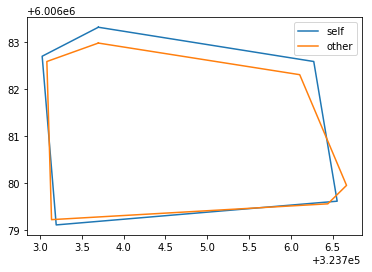

31it [00:52,  1.82s/it]

[[457 422]
 [456 423]
 [455 423]
 [454 423]
 [453 424]
 [452 424]
 [451 425]
 [450 425]
 [450 426]
 [449 427]
 [448 428]
 [447 429]
 [446 430]
 [445 431]
 [444 432]
 [443 433]
 [442 434]
 [441 435]
 [441 436]
 [440 437]
 [440 438]
 [440 439]
 [440 440]
 [440 441]
 [440 442]
 [440 443]
 [440 444]
 [440 445]
 [440 446]
 [440 447]
 [440 448]
 [440 449]
 [440 450]
 [440 451]
 [440 452]
 [439 453]
 [439 454]
 [439 455]
 [439 456]
 [439 457]
 [439 458]
 [439 459]
 [439 460]
 [439 461]
 [439 462]
 [439 463]
 [439 464]
 [439 465]
 [438 466]
 [438 467]
 [438 468]
 [438 469]
 [438 470]
 [438 471]
 [438 472]
 [437 473]
 [437 474]
 [437 475]
 [437 476]
 [437 477]
 [437 478]
 [437 479]
 [437 480]
 [438 481]
 [438 482]
 [439 483]
 [439 484]
 [440 485]
 [440 486]
 [441 487]
 [442 488]
 [443 489]
 [444 490]
 [445 490]
 [446 491]
 [447 492]
 [448 492]
 [449 493]
 [450 493]
 [451 494]
 [452 494]
 [453 495]
 [454 495]
 [455 495]
 [456 496]
 [457 496]
 [458 496]
 [459 496]
 [460 496]
 [461 497]
 [462 497]

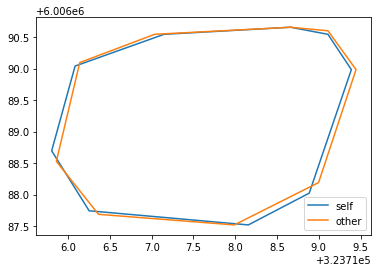

[[215  41]
 [214  42]
 [213  42]
 [212  42]
 [211  42]
 [210  42]
 [209  42]
 [208  43]
 [207  43]
 [206  43]
 [205  44]
 [204  44]
 [203  45]
 [202  45]
 [201  46]
 [200  47]
 [199  48]
 [198  49]
 [197  50]
 [196  51]
 [195  52]
 [194  53]
 [193  54]
 [192  55]
 [191  56]
 [190  57]
 [189  57]
 [188  58]
 [188  59]
 [187  60]
 [186  61]
 [186  62]
 [185  63]
 [184  64]
 [184  65]
 [183  66]
 [183  67]
 [182  68]
 [181  68]
 [180  69]
 [179  69]
 [178  70]
 [177  70]
 [177  71]
 [176  72]
 [175  73]
 [174  74]
 [173  75]
 [173  76]
 [172  77]
 [171  78]
 [170  78]
 [169  78]
 [168  78]
 [167  79]
 [166  79]
 [165  79]
 [164  80]
 [163  81]
 [162  82]
 [161  83]
 [161  84]
 [160  85]
 [159  86]
 [158  86]
 [157  87]
 [156  88]
 [155  89]
 [154  90]
 [154  91]
 [153  92]
 [153  93]
 [152  94]
 [152  95]
 [152  96]
 [151  97]
 [151  98]
 [150  99]
 [150 100]
 [150 101]
 [149 102]
 [149 103]
 [149 104]
 [150 105]
 [150 106]
 [150 107]
 [150 108]
 [150 109]
 [150 110]
 [150 111]
 [150 112]

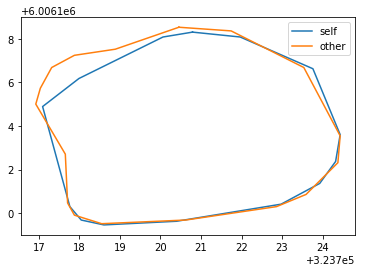

[[246 184]
 [245 185]
 [244 185]
 [243 185]
 [242 185]
 [241 186]
 [240 186]
 [239 186]
 [238 186]
 [237 187]
 [236 187]
 [235 187]
 [234 187]
 [233 188]
 [232 188]
 [231 188]
 [230 189]
 [229 189]
 [228 189]
 [227 189]
 [226 190]
 [225 190]
 [224 190]
 [223 190]
 [222 191]
 [221 191]
 [220 191]
 [219 191]
 [218 191]
 [217 192]
 [216 192]
 [215 192]
 [214 192]
 [213 192]
 [212 192]
 [211 192]
 [210 193]
 [209 193]
 [208 193]
 [207 193]
 [206 193]
 [205 194]
 [204 194]
 [203 194]
 [202 194]
 [201 194]
 [200 194]
 [199 195]
 [198 195]
 [197 195]
 [196 195]
 [195 195]
 [194 195]
 [193 196]
 [192 196]
 [191 196]
 [190 196]
 [189 196]
 [188 196]
 [187 197]
 [186 197]
 [185 197]
 [184 197]
 [183 197]
 [182 197]
 [181 197]
 [180 197]
 [179 197]
 [178 198]
 [177 198]
 [176 198]
 [175 198]
 [174 198]
 [173 199]
 [172 199]
 [171 199]
 [170 199]
 [169 200]
 [168 200]
 [167 200]
 [166 201]
 [165 201]
 [164 201]
 [163 202]
 [162 202]
 [161 203]
 [160 204]
 [159 204]
 [158 205]
 [157 206]
 [156 206]

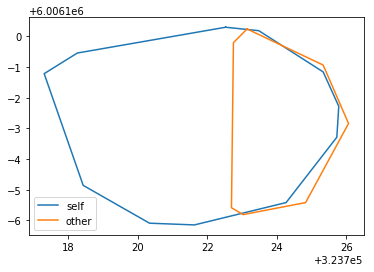

[[108 486]
 [107 487]
 [106 487]
 [105 487]
 [104 487]
 [103 487]
 [102 488]
 [101 488]
 [100 488]
 [ 99 489]
 [ 98 489]
 [ 97 489]
 [ 96 489]
 [ 95 490]
 [ 94 490]
 [ 93 490]
 [ 92 491]
 [ 91 491]
 [ 90 491]
 [ 89 491]
 [ 88 492]
 [ 87 492]
 [ 86 493]
 [ 85 493]
 [ 84 493]
 [ 83 494]
 [ 82 494]
 [ 81 494]
 [ 80 494]
 [ 79 495]
 [ 78 495]
 [ 77 495]
 [ 76 496]
 [ 75 496]
 [ 74 497]
 [ 73 498]
 [ 72 499]
 [ 72 500]
 [ 71 501]
 [ 71 502]
 [ 71 503]
 [ 70 504]
 [ 70 505]
 [ 70 506]
 [ 69 507]
 [ 69 508]
 [ 69 509]
 [ 69 510]
 [ 69 511]
 [ 69 512]
 [ 69 513]
 [ 69 514]
 [ 69 515]
 [ 69 516]
 [ 69 517]
 [ 69 518]
 [ 69 519]
 [ 69 520]
 [ 68 521]
 [ 68 522]
 [ 69 523]
 [ 68 524]
 [ 68 525]
 [ 68 526]
 [ 68 527]
 [ 68 528]
 [ 68 529]
 [ 68 530]
 [ 68 531]
 [ 68 532]
 [ 68 533]
 [ 68 534]
 [ 68 535]
 [ 68 536]
 [ 68 537]
 [ 68 538]
 [ 68 539]
 [ 68 540]
 [ 68 541]
 [ 68 542]
 [ 68 543]
 [ 68 544]
 [ 69 545]
 [ 69 546]
 [ 69 547]
 [ 69 548]
 [ 69 549]
 [ 69 550]
 [ 70 550]
 [ 71 551]
 [ 72 551]

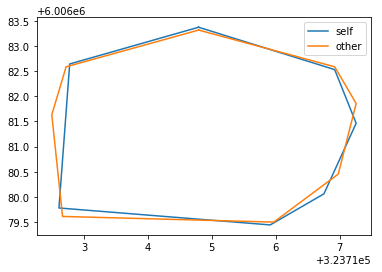

[[183 407]
 [182 408]
 [181 408]
 [180 408]
 [179 409]
 [178 409]
 [177 410]
 [176 410]
 [175 411]
 [174 411]
 [173 412]
 [172 412]
 [171 413]
 [170 414]
 [169 414]
 [168 415]
 [167 415]
 [166 416]
 [166 417]
 [165 418]
 [165 419]
 [164 420]
 [164 421]
 [164 422]
 [164 423]
 [164 424]
 [163 425]
 [164 426]
 [164 427]
 [164 428]
 [164 429]
 [164 430]
 [164 431]
 [164 432]
 [164 433]
 [164 434]
 [164 435]
 [164 436]
 [165 437]
 [165 438]
 [165 439]
 [165 440]
 [165 441]
 [166 442]
 [166 443]
 [166 444]
 [166 445]
 [166 446]
 [167 447]
 [167 448]
 [167 449]
 [168 450]
 [168 451]
 [168 452]
 [169 453]
 [169 454]
 [170 455]
 [170 456]
 [170 457]
 [171 458]
 [171 459]
 [171 460]
 [172 461]
 [172 462]
 [173 463]
 [173 464]
 [174 465]
 [174 466]
 [175 467]
 [175 468]
 [176 469]
 [176 470]
 [177 471]
 [177 472]
 [178 472]
 [179 473]
 [179 474]
 [180 474]
 [181 475]
 [182 476]
 [183 476]
 [184 477]
 [185 477]
 [186 477]
 [187 477]
 [188 477]
 [189 477]
 [190 477]
 [191 477]
 [192 477]
 [193 476]

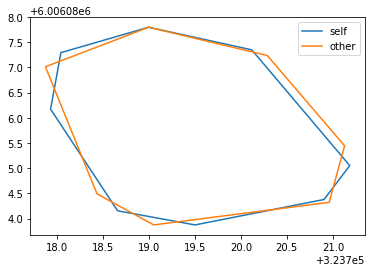

[[ 81 415]
 [ 80 416]
 [ 79 416]
 [ 78 416]
 [ 77 416]
 [ 76 416]
 [ 75 417]
 [ 74 417]
 [ 73 417]
 [ 72 417]
 [ 71 418]
 [ 70 418]
 [ 69 419]
 [ 68 419]
 [ 67 420]
 [ 66 421]
 [ 65 422]
 [ 64 422]
 [ 63 423]
 [ 62 424]
 [ 61 424]
 [ 60 425]
 [ 59 426]
 [ 58 426]
 [ 57 427]
 [ 56 427]
 [ 55 428]
 [ 54 428]
 [ 53 428]
 [ 52 429]
 [ 51 429]
 [ 50 429]
 [ 49 430]
 [ 48 430]
 [ 47 430]
 [ 46 431]
 [ 45 431]
 [ 44 432]
 [ 43 432]
 [ 42 433]
 [ 41 433]
 [ 40 434]
 [ 39 434]
 [ 38 435]
 [ 37 435]
 [ 36 436]
 [ 35 437]
 [ 34 438]
 [ 33 439]
 [ 32 440]
 [ 32 441]
 [ 31 442]
 [ 31 443]
 [ 30 444]
 [ 30 445]
 [ 30 446]
 [ 29 447]
 [ 29 448]
 [ 29 449]
 [ 29 450]
 [ 29 451]
 [ 29 452]
 [ 29 453]
 [ 29 454]
 [ 29 455]
 [ 29 456]
 [ 29 457]
 [ 29 458]
 [ 30 459]
 [ 31 460]
 [ 31 461]
 [ 32 462]
 [ 32 463]
 [ 33 464]
 [ 34 465]
 [ 35 466]
 [ 36 466]
 [ 37 467]
 [ 38 468]
 [ 39 469]
 [ 40 470]
 [ 41 471]
 [ 42 471]
 [ 43 472]
 [ 44 473]
 [ 45 473]
 [ 46 474]
 [ 47 475]
 [ 48 476]
 [ 49 477]
 [ 50 478]

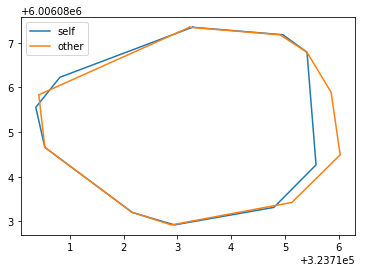

[[547  80]
 [546  81]
 [545  81]
 [544  81]
 [543  81]
 [542  82]
 [542  83]
 [541  84]
 [541  85]
 [540  86]
 [539  87]
 [538  88]
 [538  89]
 [537  90]
 [537  91]
 [536  92]
 [536  93]
 [535  94]
 [535  95]
 [534  96]
 [534  97]
 [533  98]
 [533  99]
 [532 100]
 [532 101]
 [531 102]
 [531 103]
 [531 104]
 [530 105]
 [529 106]
 [529 107]
 [529 108]
 [528 109]
 [528 110]
 [528 111]
 [527 112]
 [527 113]
 [527 114]
 [527 115]
 [527 116]
 [527 117]
 [527 118]
 [527 119]
 [527 120]
 [528 121]
 [528 122]
 [529 123]
 [529 124]
 [530 125]
 [531 126]
 [532 127]
 [533 128]
 [533 129]
 [534 130]
 [535 130]
 [536 131]
 [537 132]
 [538 133]
 [539 134]
 [540 134]
 [541 135]
 [542 135]
 [543 136]
 [544 136]
 [545 137]
 [546 137]
 [547 138]
 [548 138]
 [549 138]
 [550 139]
 [551 139]
 [552 139]
 [553 140]
 [554 140]
 [555 141]
 [556 141]
 [557 142]
 [558 142]
 [559 142]
 [560 143]
 [561 143]
 [562 144]
 [563 144]
 [564 144]
 [565 145]
 [566 145]
 [567 145]
 [568 145]
 [569 146]
 [570 146]
 [571 146]

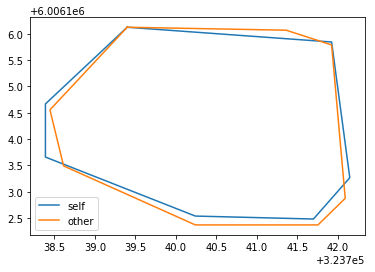

[[256 183]
 [255 184]
 [254 184]
 [253 185]
 [252 185]
 [251 186]
 [251 187]
 [250 188]
 [250 189]
 [249 190]
 [249 191]
 [249 192]
 [248 193]
 [248 194]
 [247 195]
 [247 196]
 [247 197]
 [247 198]
 [248 199]
 [248 200]
 [248 201]
 [248 202]
 [249 203]
 [249 204]
 [249 205]
 [249 206]
 [249 207]
 [249 208]
 [249 209]
 [249 210]
 [250 211]
 [250 212]
 [250 213]
 [250 214]
 [250 215]
 [250 216]
 [250 217]
 [250 218]
 [250 219]
 [251 220]
 [251 221]
 [251 222]
 [251 223]
 [251 224]
 [251 225]
 [251 226]
 [251 227]
 [251 228]
 [251 229]
 [251 230]
 [251 231]
 [251 232]
 [251 233]
 [251 234]
 [251 235]
 [251 236]
 [251 237]
 [251 238]
 [251 239]
 [251 240]
 [251 241]
 [251 242]
 [251 243]
 [251 244]
 [251 245]
 [251 246]
 [251 247]
 [251 248]
 [251 249]
 [251 250]
 [251 251]
 [250 252]
 [250 253]
 [250 254]
 [250 255]
 [250 256]
 [250 257]
 [250 258]
 [250 259]
 [250 260]
 [250 261]
 [250 262]
 [250 263]
 [250 264]
 [250 265]
 [250 266]
 [249 267]
 [249 268]
 [249 269]
 [249 270]
 [249 271]

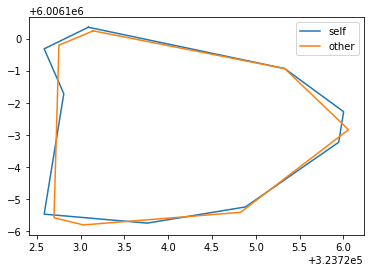

[[ 76 250]
 [ 75 251]
 [ 74 251]
 [ 73 251]
 [ 72 251]
 [ 71 251]
 [ 70 251]
 [ 69 251]
 [ 68 251]
 [ 67 252]
 [ 67 253]
 [ 66 254]
 [ 65 255]
 [ 64 256]
 [ 64 257]
 [ 63 258]
 [ 62 259]
 [ 61 260]
 [ 61 261]
 [ 60 262]
 [ 59 262]
 [ 58 263]
 [ 58 264]
 [ 58 265]
 [ 57 266]
 [ 58 267]
 [ 58 268]
 [ 58 269]
 [ 58 270]
 [ 58 271]
 [ 58 272]
 [ 58 273]
 [ 58 274]
 [ 58 275]
 [ 58 276]
 [ 58 277]
 [ 59 278]
 [ 59 279]
 [ 59 280]
 [ 59 281]
 [ 59 282]
 [ 60 283]
 [ 60 284]
 [ 60 285]
 [ 61 286]
 [ 61 287]
 [ 61 288]
 [ 61 289]
 [ 62 290]
 [ 62 291]
 [ 62 292]
 [ 62 293]
 [ 63 294]
 [ 63 295]
 [ 63 296]
 [ 64 297]
 [ 64 298]
 [ 65 299]
 [ 65 300]
 [ 66 301]
 [ 67 302]
 [ 68 303]
 [ 69 304]
 [ 70 304]
 [ 71 305]
 [ 72 305]
 [ 73 305]
 [ 74 306]
 [ 75 306]
 [ 76 306]
 [ 77 306]
 [ 78 306]
 [ 79 306]
 [ 80 306]
 [ 81 307]
 [ 82 307]
 [ 83 307]
 [ 84 307]
 [ 85 307]
 [ 86 307]
 [ 87 307]
 [ 88 307]
 [ 89 307]
 [ 90 307]
 [ 91 307]
 [ 92 307]
 [ 93 307]
 [ 94 307]
 [ 95 307]
 [ 96 307]
 [ 97 307]

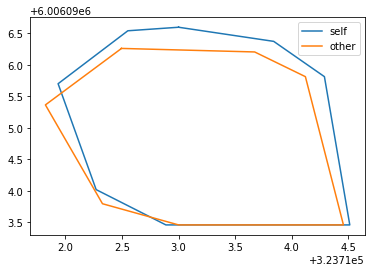

[[478 435]
 [477 436]
 [476 436]
 [475 436]
 [474 436]
 [473 436]
 [472 436]
 [471 436]
 [470 436]
 [469 437]
 [468 437]
 [467 437]
 [466 437]
 [465 438]
 [464 438]
 [463 439]
 [462 439]
 [461 439]
 [460 440]
 [459 441]
 [458 441]
 [457 442]
 [456 443]
 [455 444]
 [455 445]
 [454 446]
 [453 447]
 [453 448]
 [452 449]
 [452 450]
 [452 451]
 [452 452]
 [452 453]
 [452 454]
 [452 455]
 [452 456]
 [452 457]
 [452 458]
 [452 459]
 [452 460]
 [452 461]
 [452 462]
 [452 463]
 [452 464]
 [452 465]
 [452 466]
 [453 467]
 [453 468]
 [453 469]
 [453 470]
 [454 471]
 [454 472]
 [454 473]
 [455 474]
 [455 475]
 [455 476]
 [456 477]
 [456 478]
 [456 479]
 [457 480]
 [457 481]
 [458 482]
 [458 483]
 [459 484]
 [460 485]
 [461 486]
 [462 487]
 [463 488]
 [464 489]
 [465 489]
 [466 490]
 [467 491]
 [468 491]
 [469 492]
 [470 492]
 [471 492]
 [472 492]
 [473 492]
 [474 492]
 [475 492]
 [476 492]
 [477 492]
 [478 492]
 [479 492]
 [480 492]
 [481 492]
 [482 492]
 [483 491]
 [484 491]
 [485 491]
 [486 491]

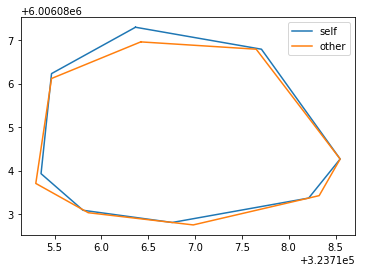

[[166 511]
 [165 512]
 [164 513]
 [163 514]
 [162 515]
 [162 516]
 [161 517]
 [161 518]
 [161 519]
 [160 520]
 [160 521]
 [160 522]
 [160 523]
 [160 524]
 [159 525]
 [159 526]
 [158 527]
 [158 528]
 [158 529]
 [159 530]
 [160 531]
 [160 532]
 [161 533]
 [161 534]
 [161 535]
 [161 536]
 [161 537]
 [161 538]
 [162 539]
 [162 540]
 [162 541]
 [163 542]
 [163 543]
 [164 544]
 [164 545]
 [164 546]
 [164 547]
 [164 548]
 [164 549]
 [165 550]
 [165 551]
 [166 552]
 [166 553]
 [167 554]
 [167 555]
 [167 556]
 [167 557]
 [168 558]
 [168 559]
 [169 560]
 [170 561]
 [171 562]
 [171 563]
 [172 564]
 [172 565]
 [173 566]
 [173 567]
 [174 568]
 [175 569]
 [176 570]
 [177 571]
 [178 572]
 [178 573]
 [179 574]
 [179 575]
 [180 576]
 [181 577]
 [182 578]
 [183 579]
 [183 580]
 [184 581]
 [185 582]
 [186 583]
 [186 584]
 [187 585]
 [188 586]
 [188 587]
 [189 588]
 [190 589]
 [190 590]
 [191 591]
 [191 592]
 [192 593]
 [192 594]
 [193 595]
 [194 596]
 [194 597]
 [195 598]
 [195 599]
 [196 600]
 [196 601]

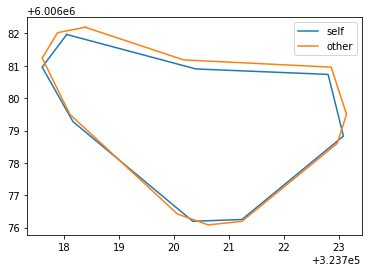

[[133 237]
 [132 238]
 [131 238]
 [130 239]
 [129 239]
 [128 240]
 [127 240]
 [126 241]
 [125 241]
 [124 242]
 [123 242]
 [122 242]
 [121 243]
 [120 243]
 [119 243]
 [118 243]
 [117 243]
 [116 244]
 [115 244]
 [114 244]
 [113 244]
 [112 244]
 [111 245]
 [110 246]
 [109 246]
 [108 246]
 [107 247]
 [106 248]
 [105 249]
 [104 250]
 [103 251]
 [103 252]
 [102 253]
 [102 254]
 [101 255]
 [101 256]
 [101 257]
 [100 258]
 [101 259]
 [101 260]
 [101 261]
 [101 262]
 [101 263]
 [101 264]
 [101 265]
 [101 266]
 [101 267]
 [101 268]
 [101 269]
 [101 270]
 [102 271]
 [102 272]
 [102 273]
 [102 274]
 [102 275]
 [102 276]
 [102 277]
 [102 278]
 [103 279]
 [103 280]
 [103 281]
 [103 282]
 [103 283]
 [103 284]
 [103 285]
 [103 286]
 [103 287]
 [103 288]
 [103 289]
 [103 290]
 [103 291]
 [104 292]
 [103 293]
 [103 294]
 [103 295]
 [103 296]
 [104 297]
 [104 298]
 [104 299]
 [104 300]
 [104 301]
 [104 302]
 [104 303]
 [104 304]
 [104 305]
 [105 306]
 [105 307]
 [106 308]
 [107 308]
 [108 309]
 [109 310]

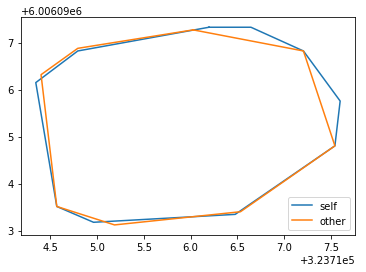

[[209 475]
 [208 476]
 [207 477]
 [206 477]
 [205 477]
 [204 478]
 [203 478]
 [202 478]
 [201 478]
 [200 479]
 [199 479]
 [198 479]
 [197 479]
 [196 480]
 [195 481]
 [194 482]
 [193 482]
 [192 483]
 [191 483]
 [190 484]
 [189 484]
 [188 485]
 [187 485]
 [186 485]
 [185 486]
 [184 486]
 [183 487]
 [182 487]
 [181 487]
 [180 487]
 [179 488]
 [178 488]
 [177 489]
 [176 490]
 [175 490]
 [174 491]
 [173 492]
 [172 493]
 [172 494]
 [171 495]
 [171 496]
 [170 497]
 [170 498]
 [169 499]
 [169 500]
 [169 501]
 [169 502]
 [169 503]
 [170 504]
 [171 505]
 [172 506]
 [172 507]
 [172 508]
 [173 509]
 [173 510]
 [174 511]
 [174 512]
 [175 513]
 [175 514]
 [175 515]
 [176 515]
 [177 516]
 [178 516]
 [179 516]
 [180 517]
 [180 518]
 [181 519]
 [182 520]
 [183 521]
 [184 521]
 [185 521]
 [186 521]
 [187 522]
 [188 522]
 [189 523]
 [190 523]
 [191 524]
 [192 525]
 [193 526]
 [194 527]
 [195 528]
 [195 529]
 [196 530]
 [197 530]
 [198 531]
 [199 531]
 [200 531]
 [201 532]
 [202 532]
 [203 532]
 [204 533]

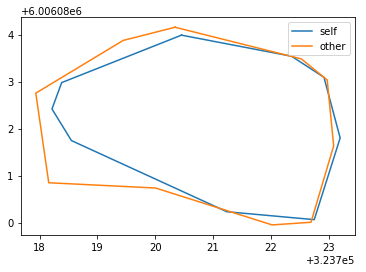

[[308 440]
 [307 441]
 [306 441]
 [305 442]
 [304 442]
 [303 442]
 [302 443]
 [301 444]
 [300 444]
 [299 444]
 [298 445]
 [297 445]
 [296 446]
 [295 446]
 [294 447]
 [293 447]
 [292 448]
 [291 448]
 [290 449]
 [289 449]
 [288 450]
 [287 450]
 [286 451]
 [285 451]
 [284 452]
 [283 453]
 [282 454]
 [281 454]
 [280 455]
 [279 456]
 [278 457]
 [277 458]
 [276 459]
 [276 460]
 [275 461]
 [275 462]
 [275 463]
 [274 464]
 [274 465]
 [274 466]
 [274 467]
 [274 468]
 [274 469]
 [274 470]
 [274 471]
 [274 472]
 [274 473]
 [274 474]
 [274 475]
 [274 476]
 [274 477]
 [274 478]
 [274 479]
 [274 480]
 [275 481]
 [275 482]
 [275 483]
 [275 484]
 [276 485]
 [276 486]
 [276 487]
 [276 488]
 [277 489]
 [277 490]
 [278 491]
 [278 492]
 [278 493]
 [279 494]
 [279 495]
 [280 496]
 [281 497]
 [282 498]
 [282 499]
 [283 500]
 [284 500]
 [285 501]
 [286 502]
 [287 502]
 [288 503]
 [289 503]
 [290 503]
 [291 504]
 [292 504]
 [293 504]
 [294 504]
 [295 504]
 [296 504]
 [297 504]
 [298 504]
 [299 504]
 [300 503]

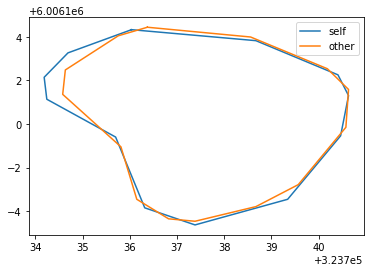

32it [00:54,  1.86s/it]

[[379 320]
 [378 321]
 [377 321]
 [376 322]
 [375 322]
 [374 323]
 [373 323]
 [372 324]
 [371 325]
 [370 326]
 [370 327]
 [369 328]
 [368 329]
 [368 330]
 [368 331]
 [367 332]
 [367 333]
 [366 334]
 [366 335]
 [366 336]
 [365 337]
 [365 338]
 [365 339]
 [365 340]
 [365 341]
 [364 342]
 [364 343]
 [364 344]
 [364 345]
 [364 346]
 [364 347]
 [363 348]
 [363 349]
 [363 350]
 [363 351]
 [363 352]
 [363 353]
 [363 354]
 [364 355]
 [364 356]
 [364 357]
 [365 358]
 [365 359]
 [366 360]
 [367 361]
 [368 362]
 [368 363]
 [369 364]
 [370 364]
 [371 365]
 [372 366]
 [373 366]
 [374 367]
 [375 368]
 [376 368]
 [377 369]
 [378 369]
 [379 370]
 [380 371]
 [381 371]
 [382 372]
 [383 372]
 [384 372]
 [385 373]
 [386 373]
 [387 374]
 [388 374]
 [389 374]
 [390 374]
 [391 375]
 [392 375]
 [393 375]
 [394 375]
 [395 375]
 [396 375]
 [397 375]
 [398 375]
 [399 376]
 [400 376]
 [401 376]
 [402 376]
 [403 376]
 [404 376]
 [405 376]
 [406 375]
 [407 375]
 [408 375]
 [409 375]
 [410 374]
 [411 374]
 [412 373]

IOU


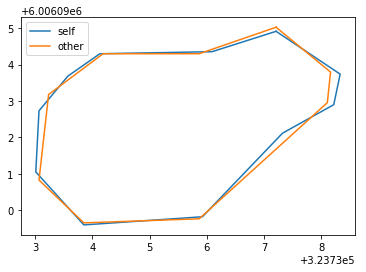

[[510 359]
 [509 360]
 [508 360]
 [507 361]
 [506 361]
 [505 362]
 [504 363]
 [503 364]
 [502 364]
 [501 365]
 [500 366]
 [499 367]
 [498 368]
 [497 369]
 [496 370]
 [495 371]
 [494 372]
 [493 372]
 [492 373]
 [491 374]
 [490 375]
 [489 375]
 [488 376]
 [487 377]
 [486 377]
 [485 378]
 [484 378]
 [483 379]
 [482 380]
 [481 380]
 [480 381]
 [479 382]
 [478 383]
 [477 384]
 [476 385]
 [475 386]
 [475 387]
 [474 388]
 [473 389]
 [472 390]
 [472 391]
 [471 392]
 [471 393]
 [470 394]
 [470 395]
 [469 396]
 [468 397]
 [468 398]
 [467 399]
 [467 400]
 [466 401]
 [466 402]
 [465 403]
 [465 404]
 [465 405]
 [464 406]
 [464 407]
 [464 408]
 [464 409]
 [464 410]
 [464 411]
 [464 412]
 [464 413]
 [464 414]
 [465 415]
 [465 416]
 [465 417]
 [466 418]
 [467 419]
 [468 420]
 [468 421]
 [469 421]
 [470 422]
 [471 422]
 [472 423]
 [473 423]
 [474 424]
 [475 425]
 [476 425]
 [477 426]
 [478 426]
 [479 427]
 [480 427]
 [481 428]
 [482 428]
 [483 429]
 [484 429]
 [485 429]
 [486 430]
 [487 430]
 [488 430]

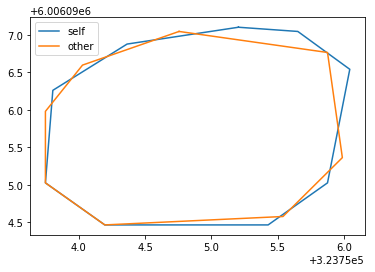

[[268 155]
 [267 156]
 [266 156]
 [265 156]
 [264 156]
 [263 156]
 [262 157]
 [261 157]
 [260 157]
 [259 158]
 [258 159]
 [258 160]
 [257 161]
 [257 162]
 [256 163]
 [256 164]
 [255 165]
 [255 166]
 [254 167]
 [253 168]
 [253 169]
 [253 170]
 [252 171]
 [252 172]
 [251 173]
 [251 174]
 [250 175]
 [250 176]
 [250 177]
 [249 178]
 [249 179]
 [249 180]
 [248 181]
 [248 182]
 [248 183]
 [248 184]
 [248 185]
 [248 186]
 [247 187]
 [247 188]
 [247 189]
 [247 190]
 [247 191]
 [247 192]
 [247 193]
 [247 194]
 [246 195]
 [246 196]
 [246 197]
 [246 198]
 [246 199]
 [246 200]
 [246 201]
 [246 202]
 [246 203]
 [246 204]
 [246 205]
 [246 206]
 [246 207]
 [246 208]
 [246 209]
 [246 210]
 [246 211]
 [246 212]
 [246 213]
 [247 214]
 [247 215]
 [247 216]
 [248 217]
 [248 218]
 [248 219]
 [249 220]
 [249 221]
 [249 222]
 [250 223]
 [251 224]
 [251 225]
 [252 226]
 [253 227]
 [253 228]
 [254 229]
 [255 230]
 [256 231]
 [257 232]
 [258 233]
 [259 234]
 [260 235]
 [261 236]
 [262 237]
 [263 237]
 [264 238]

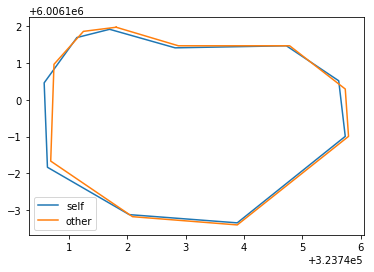

[[228  80]
 [227  81]
 [226  81]
 [225  81]
 [224  82]
 [223  82]
 [222  83]
 [221  84]
 [220  85]
 [219  86]
 [219  87]
 [218  88]
 [217  89]
 [217  90]
 [216  91]
 [216  92]
 [215  93]
 [215  94]
 [215  95]
 [214  96]
 [214  97]
 [213  98]
 [213  99]
 [212 100]
 [212 101]
 [212 102]
 [211 103]
 [211 104]
 [211 105]
 [210 106]
 [210 107]
 [210 108]
 [209 109]
 [209 110]
 [208 111]
 [208 112]
 [208 113]
 [207 114]
 [207 115]
 [207 116]
 [207 117]
 [207 118]
 [207 119]
 [207 120]
 [207 121]
 [208 122]
 [209 123]
 [210 124]
 [211 125]
 [211 126]
 [212 127]
 [213 128]
 [214 129]
 [215 130]
 [216 130]
 [217 131]
 [218 132]
 [219 133]
 [220 133]
 [221 134]
 [222 135]
 [223 136]
 [224 136]
 [225 137]
 [226 137]
 [227 138]
 [228 138]
 [229 139]
 [230 139]
 [231 140]
 [232 140]
 [233 141]
 [234 141]
 [235 142]
 [236 142]
 [237 143]
 [238 143]
 [239 143]
 [240 144]
 [241 144]
 [242 145]
 [243 145]
 [244 145]
 [245 145]
 [246 146]
 [247 146]
 [248 147]
 [249 147]
 [250 147]
 [251 147]
 [252 147]

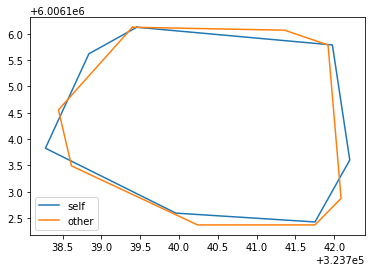

[[371 102]
 [370 103]
 [369 103]
 [368 103]
 [367 103]
 [366 103]
 [365 103]
 [364 103]
 [363 103]
 [362 103]
 [361 103]
 [360 104]
 [359 104]
 [358 104]
 [357 104]
 [356 104]
 [355 105]
 [354 105]
 [353 105]
 [352 106]
 [351 106]
 [350 106]
 [349 107]
 [348 107]
 [347 107]
 [346 108]
 [345 108]
 [344 109]
 [343 109]
 [342 110]
 [341 111]
 [340 111]
 [339 112]
 [338 113]
 [337 114]
 [337 115]
 [336 116]
 [335 117]
 [334 118]
 [333 119]
 [332 120]
 [332 121]
 [331 122]
 [330 123]
 [329 124]
 [329 125]
 [328 126]
 [327 127]
 [327 128]
 [326 129]
 [326 130]
 [325 131]
 [325 132]
 [325 133]
 [324 134]
 [324 135]
 [324 136]
 [324 137]
 [324 138]
 [324 139]
 [324 140]
 [324 141]
 [324 142]
 [324 143]
 [324 144]
 [324 145]
 [324 146]
 [324 147]
 [324 148]
 [324 149]
 [324 150]
 [324 151]
 [324 152]
 [324 153]
 [324 154]
 [325 155]
 [325 156]
 [326 157]
 [327 158]
 [328 159]
 [329 160]
 [330 161]
 [331 161]
 [332 162]
 [333 163]
 [334 163]
 [335 163]
 [336 163]
 [337 163]
 [338 163]
 [339 164]

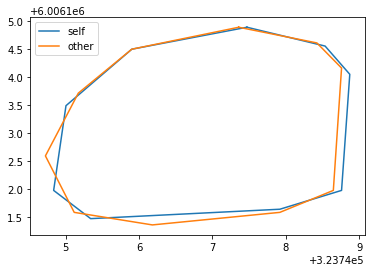

[[398 205]
 [397 206]
 [396 206]
 [395 206]
 [394 207]
 [393 207]
 [392 207]
 [391 208]
 [390 209]
 [389 209]
 [388 210]
 [388 211]
 [387 212]
 [386 213]
 [385 214]
 [385 215]
 [384 216]
 [384 217]
 [383 218]
 [382 219]
 [381 220]
 [380 221]
 [380 222]
 [379 223]
 [379 224]
 [379 225]
 [378 226]
 [378 227]
 [378 228]
 [378 229]
 [377 230]
 [376 231]
 [375 231]
 [374 231]
 [373 232]
 [372 233]
 [372 234]
 [371 235]
 [370 236]
 [370 237]
 [369 238]
 [368 239]
 [368 240]
 [367 241]
 [367 242]
 [366 243]
 [366 244]
 [365 245]
 [365 246]
 [365 247]
 [364 248]
 [364 249]
 [364 250]
 [363 251]
 [363 252]
 [363 253]
 [362 254]
 [362 255]
 [362 256]
 [362 257]
 [362 258]
 [361 259]
 [361 260]
 [361 261]
 [361 262]
 [361 263]
 [361 264]
 [361 265]
 [361 266]
 [361 267]
 [361 268]
 [361 269]
 [361 270]
 [360 271]
 [360 272]
 [360 273]
 [360 274]
 [360 275]
 [360 276]
 [360 277]
 [360 278]
 [360 279]
 [360 280]
 [359 281]
 [359 282]
 [359 283]
 [359 284]
 [359 285]
 [359 286]
 [359 287]
 [359 288]

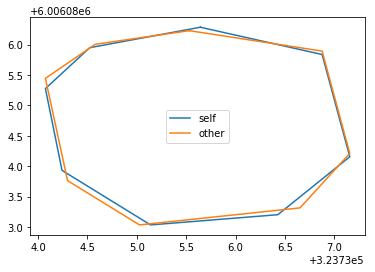

[[305 431]
 [304 432]
 [303 432]
 [302 432]
 [301 432]
 [300 432]
 [299 432]
 [298 432]
 [297 433]
 [296 433]
 [295 433]
 [294 433]
 [293 433]
 [292 433]
 [291 433]
 [290 434]
 [289 434]
 [288 434]
 [287 434]
 [286 434]
 [285 435]
 [284 436]
 [283 436]
 [282 437]
 [281 438]
 [280 439]
 [279 440]
 [278 441]
 [277 442]
 [276 441]
 [275 441]
 [274 442]
 [274 443]
 [273 444]
 [273 445]
 [272 446]
 [271 447]
 [271 448]
 [270 449]
 [270 450]
 [270 451]
 [269 452]
 [269 453]
 [268 454]
 [268 455]
 [268 456]
 [267 457]
 [267 458]
 [267 459]
 [267 460]
 [267 461]
 [267 462]
 [267 463]
 [267 464]
 [267 465]
 [267 466]
 [267 467]
 [267 468]
 [268 469]
 [268 470]
 [268 471]
 [268 472]
 [268 473]
 [268 474]
 [268 475]
 [269 476]
 [269 477]
 [269 478]
 [269 479]
 [269 480]
 [269 481]
 [269 482]
 [269 483]
 [269 484]
 [269 485]
 [270 486]
 [270 487]
 [270 488]
 [270 489]
 [270 490]
 [271 491]
 [271 492]
 [271 493]
 [271 494]
 [272 495]
 [272 496]
 [272 497]
 [273 497]
 [274 498]
 [275 499]
 [276 499]

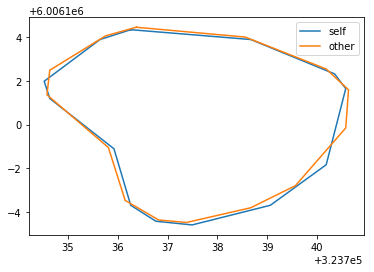

[[156 433]
 [155 434]
 [154 434]
 [153 434]
 [152 434]
 [151 434]
 [150 435]
 [149 435]
 [148 435]
 [147 436]
 [146 436]
 [145 436]
 [144 437]
 [143 437]
 [142 438]
 [141 438]
 [140 439]
 [139 440]
 [138 440]
 [137 441]
 [136 442]
 [135 443]
 [134 444]
 [134 445]
 [133 446]
 [133 447]
 [132 448]
 [132 449]
 [132 450]
 [132 451]
 [131 452]
 [131 453]
 [131 454]
 [131 455]
 [131 456]
 [131 457]
 [131 458]
 [131 459]
 [131 460]
 [131 461]
 [131 462]
 [131 463]
 [131 464]
 [131 465]
 [131 466]
 [131 467]
 [132 468]
 [132 469]
 [132 470]
 [132 471]
 [132 472]
 [133 473]
 [133 474]
 [133 475]
 [134 476]
 [134 477]
 [134 478]
 [135 479]
 [135 480]
 [136 481]
 [137 482]
 [137 483]
 [138 484]
 [139 485]
 [140 486]
 [141 487]
 [142 488]
 [143 489]
 [144 490]
 [145 490]
 [146 491]
 [147 492]
 [148 492]
 [149 492]
 [150 492]
 [151 492]
 [152 492]
 [153 492]
 [154 492]
 [155 492]
 [156 492]
 [157 492]
 [158 492]
 [159 492]
 [160 492]
 [161 492]
 [162 492]
 [163 491]
 [164 491]
 [165 491]
 [166 491]

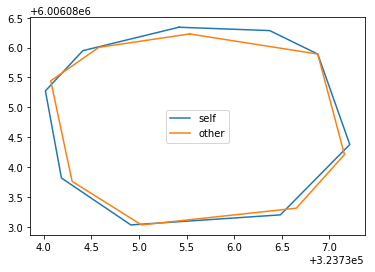

[[ 65 318]
 [ 64 319]
 [ 63 319]
 [ 62 319]
 [ 61 319]
 [ 60 319]
 [ 59 319]
 [ 58 320]
 [ 57 320]
 [ 56 321]
 [ 55 321]
 [ 54 322]
 [ 53 322]
 [ 52 323]
 [ 51 324]
 [ 51 325]
 [ 50 326]
 [ 49 327]
 [ 49 328]
 [ 48 329]
 [ 48 330]
 [ 47 331]
 [ 46 332]
 [ 46 333]
 [ 46 334]
 [ 46 335]
 [ 45 336]
 [ 45 337]
 [ 45 338]
 [ 44 339]
 [ 44 340]
 [ 44 341]
 [ 44 342]
 [ 44 343]
 [ 43 344]
 [ 43 345]
 [ 43 346]
 [ 43 347]
 [ 43 348]
 [ 43 349]
 [ 43 350]
 [ 42 351]
 [ 42 352]
 [ 43 353]
 [ 43 354]
 [ 43 355]
 [ 42 356]
 [ 43 357]
 [ 43 358]
 [ 44 359]
 [ 45 360]
 [ 46 361]
 [ 46 362]
 [ 47 363]
 [ 48 364]
 [ 49 364]
 [ 50 365]
 [ 51 365]
 [ 52 366]
 [ 53 367]
 [ 54 368]
 [ 55 368]
 [ 56 369]
 [ 57 370]
 [ 58 370]
 [ 59 371]
 [ 60 371]
 [ 61 372]
 [ 62 372]
 [ 63 372]
 [ 64 373]
 [ 65 373]
 [ 66 374]
 [ 67 374]
 [ 68 374]
 [ 69 374]
 [ 70 375]
 [ 71 375]
 [ 72 375]
 [ 73 375]
 [ 74 375]
 [ 75 375]
 [ 76 375]
 [ 77 376]
 [ 78 376]
 [ 79 376]
 [ 80 376]
 [ 81 375]
 [ 82 376]
 [ 83 376]
 [ 84 375]

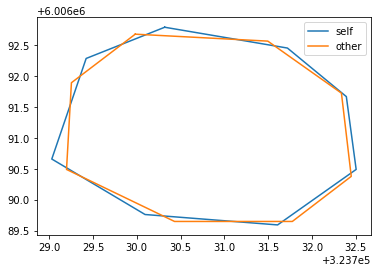

33it [00:56,  1.73s/it]

[[434 118]
 [433 119]
 [432 119]
 [431 119]
 [430 119]
 [429 119]
 [428 119]
 [427 119]
 [426 119]
 [425 120]
 [424 120]
 [423 121]
 [422 121]
 [421 122]
 [420 122]
 [419 122]
 [418 123]
 [417 123]
 [416 124]
 [415 125]
 [414 126]
 [413 126]
 [412 127]
 [411 128]
 [410 129]
 [409 130]
 [408 131]
 [407 132]
 [406 133]
 [405 134]
 [404 135]
 [404 136]
 [403 137]
 [402 138]
 [402 139]
 [401 140]
 [401 141]
 [400 142]
 [400 143]
 [400 144]
 [399 145]
 [399 146]
 [399 147]
 [399 148]
 [398 149]
 [398 150]
 [398 151]
 [397 152]
 [397 153]
 [397 154]
 [397 155]
 [397 156]
 [397 157]
 [397 158]
 [398 159]
 [398 160]
 [398 161]
 [398 162]
 [398 163]
 [398 164]
 [399 165]
 [399 166]
 [400 167]
 [400 168]
 [401 169]
 [401 170]
 [401 171]
 [402 172]
 [403 173]
 [404 174]
 [405 175]
 [406 176]
 [407 177]
 [408 178]
 [409 178]
 [410 179]
 [411 180]
 [412 181]
 [413 181]
 [414 182]
 [415 183]
 [416 184]
 [417 184]
 [418 185]
 [419 186]
 [420 187]
 [421 187]
 [422 188]
 [423 189]
 [424 190]
 [425 190]

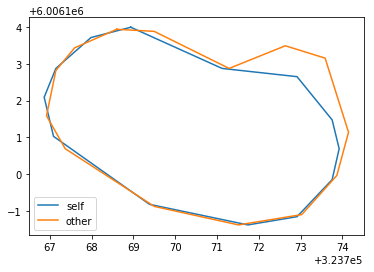

[[190 359]
 [189 360]
 [188 360]
 [187 360]
 [186 361]
 [185 362]
 [184 363]
 [183 363]
 [182 364]
 [181 365]
 [180 366]
 [179 367]
 [179 368]
 [178 369]
 [177 370]
 [176 371]
 [175 372]
 [174 372]
 [173 373]
 [172 374]
 [171 375]
 [170 376]
 [169 376]
 [168 377]
 [167 377]
 [166 378]
 [165 378]
 [164 379]
 [163 379]
 [162 380]
 [161 380]
 [160 381]
 [159 382]
 [158 382]
 [157 383]
 [157 384]
 [156 385]
 [155 386]
 [154 387]
 [153 388]
 [153 389]
 [152 390]
 [151 391]
 [151 392]
 [151 393]
 [150 394]
 [149 395]
 [149 396]
 [148 397]
 [148 398]
 [147 399]
 [147 400]
 [146 401]
 [146 402]
 [145 403]
 [145 404]
 [145 405]
 [145 406]
 [144 407]
 [144 408]
 [144 409]
 [144 410]
 [143 411]
 [144 412]
 [144 413]
 [144 414]
 [144 415]
 [145 416]
 [145 417]
 [145 418]
 [146 419]
 [147 420]
 [148 421]
 [149 422]
 [150 422]
 [151 423]
 [152 423]
 [153 424]
 [154 424]
 [155 425]
 [156 425]
 [157 425]
 [158 426]
 [159 426]
 [160 426]
 [161 427]
 [162 427]
 [163 428]
 [164 428]
 [165 429]
 [166 429]

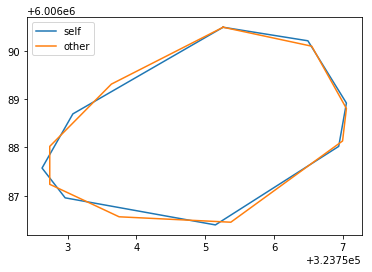

[[183 242]
 [182 243]
 [181 243]
 [180 243]
 [179 243]
 [178 244]
 [177 244]
 [176 245]
 [175 245]
 [174 246]
 [173 247]
 [172 248]
 [171 249]
 [170 250]
 [169 251]
 [168 252]
 [167 253]
 [166 254]
 [166 255]
 [165 256]
 [165 257]
 [165 258]
 [164 259]
 [164 260]
 [164 261]
 [164 262]
 [163 263]
 [163 264]
 [163 265]
 [163 266]
 [163 267]
 [163 268]
 [163 269]
 [163 270]
 [163 271]
 [164 272]
 [164 273]
 [164 274]
 [164 275]
 [164 276]
 [164 277]
 [164 278]
 [165 279]
 [165 280]
 [165 281]
 [166 282]
 [166 283]
 [167 284]
 [168 285]
 [169 286]
 [170 287]
 [171 287]
 [172 288]
 [173 288]
 [174 288]
 [175 288]
 [176 288]
 [177 288]
 [178 288]
 [179 288]
 [180 288]
 [181 288]
 [182 289]
 [183 289]
 [184 289]
 [185 288]
 [186 288]
 [187 288]
 [188 288]
 [189 288]
 [190 288]
 [191 288]
 [192 288]
 [193 288]
 [194 287]
 [195 286]
 [196 286]
 [197 285]
 [198 284]
 [198 283]
 [199 282]
 [199 281]
 [200 280]
 [200 279]
 [201 278]
 [201 277]
 [201 276]
 [201 275]
 [202 274]
 [202 273]
 [202 272]

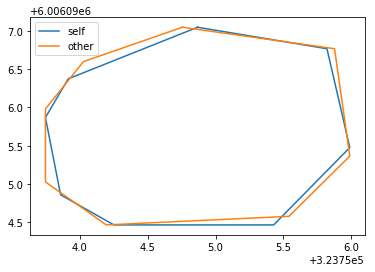

[[ 35 537]
 [ 34 538]
 [ 33 538]
 [ 32 538]
 [ 31 538]
 [ 30 538]
 [ 29 539]
 [ 28 539]
 [ 27 539]
 [ 26 540]
 [ 25 541]
 [ 24 542]
 [ 23 543]
 [ 22 543]
 [ 21 544]
 [ 20 545]
 [ 19 546]
 [ 18 547]
 [ 17 548]
 [ 17 549]
 [ 16 550]
 [ 16 551]
 [ 15 552]
 [ 15 553]
 [ 14 554]
 [ 14 555]
 [ 14 556]
 [ 13 557]
 [ 13 558]
 [ 13 559]
 [ 13 560]
 [ 13 561]
 [ 13 562]
 [ 13 563]
 [ 13 564]
 [ 13 565]
 [ 13 566]
 [ 14 567]
 [ 13 568]
 [ 13 569]
 [ 13 570]
 [ 13 571]
 [ 14 572]
 [ 14 573]
 [ 14 574]
 [ 14 575]
 [ 14 576]
 [ 14 577]
 [ 14 578]
 [ 14 579]
 [ 14 580]
 [ 14 581]
 [ 14 582]
 [ 14 583]
 [ 14 584]
 [ 14 585]
 [ 13 586]
 [ 13 587]
 [ 13 588]
 [ 13 589]
 [ 13 590]
 [ 14 591]
 [ 14 592]
 [ 14 593]
 [ 14 594]
 [ 14 595]
 [ 14 596]
 [ 14 597]
 [ 14 598]
 [ 14 599]
 [ 14 600]
 [ 14 601]
 [ 15 602]
 [ 15 603]
 [ 15 604]
 [ 15 605]
 [ 15 606]
 [ 16 607]
 [ 16 608]
 [ 16 609]
 [ 17 610]
 [ 17 611]
 [ 18 612]
 [ 19 613]
 [ 19 614]
 [ 20 615]
 [ 21 616]
 [ 22 617]
 [ 23 618]
 [ 24 619]
 [ 25 620]

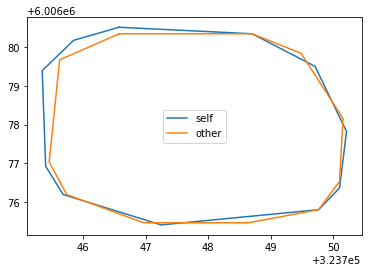

[[116 460]
 [115 461]
 [114 461]
 [113 461]
 [112 462]
 [111 462]
 [110 463]
 [109 463]
 [109 464]
 [108 465]
 [107 466]
 [106 467]
 [106 468]
 [105 469]
 [105 470]
 [105 471]
 [104 472]
 [104 473]
 [104 474]
 [103 475]
 [103 476]
 [103 477]
 [102 478]
 [102 479]
 [102 480]
 [102 481]
 [102 482]
 [102 483]
 [102 484]
 [101 485]
 [101 486]
 [101 487]
 [101 488]
 [102 489]
 [102 490]
 [102 491]
 [103 492]
 [104 493]
 [105 494]
 [106 494]
 [107 495]
 [108 495]
 [109 495]
 [110 495]
 [111 496]
 [112 496]
 [113 496]
 [114 496]
 [115 496]
 [116 496]
 [117 496]
 [118 496]
 [119 496]
 [120 496]
 [121 496]
 [122 496]
 [123 496]
 [124 496]
 [125 496]
 [126 496]
 [127 496]
 [128 496]
 [129 496]
 [130 496]
 [131 496]
 [132 496]
 [133 495]
 [134 495]
 [135 495]
 [136 495]
 [137 494]
 [138 493]
 [139 492]
 [139 491]
 [140 490]
 [140 489]
 [140 488]
 [140 487]
 [141 486]
 [141 485]
 [141 484]
 [141 483]
 [141 482]
 [141 481]
 [141 480]
 [141 479]
 [141 478]
 [141 477]
 [141 476]
 [140 475]
 [140 474]

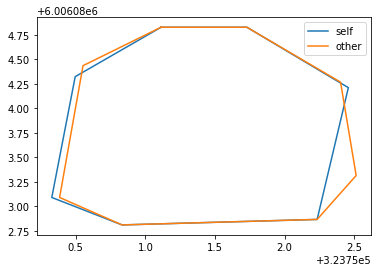

[[ 40 406]
 [ 39 407]
 [ 38 407]
 [ 37 408]
 [ 36 408]
 [ 35 409]
 [ 34 409]
 [ 33 410]
 [ 32 410]
 [ 31 411]
 [ 30 412]
 [ 29 412]
 [ 28 413]
 [ 27 414]
 [ 26 414]
 [ 25 415]
 [ 24 415]
 [ 23 416]
 [ 22 417]
 [ 21 418]
 [ 20 418]
 [ 19 419]
 [ 18 420]
 [ 17 421]
 [ 16 421]
 [ 15 422]
 [ 14 423]
 [ 13 424]
 [ 13 425]
 [ 12 426]
 [ 12 427]
 [ 12 428]
 [ 11 429]
 [ 11 430]
 [ 11 431]
 [ 11 432]
 [ 11 433]
 [ 11 434]
 [ 11 435]
 [ 11 436]
 [ 10 437]
 [ 10 438]
 [ 10 439]
 [ 10 440]
 [ 10 441]
 [ 10 442]
 [ 10 443]
 [ 11 444]
 [ 11 445]
 [ 11 446]
 [ 11 447]
 [ 11 448]
 [ 11 449]
 [ 11 450]
 [ 12 451]
 [ 12 452]
 [ 12 453]
 [ 12 454]
 [ 13 455]
 [ 13 456]
 [ 13 457]
 [ 13 458]
 [ 14 459]
 [ 14 460]
 [ 14 461]
 [ 14 462]
 [ 14 463]
 [ 15 464]
 [ 15 465]
 [ 15 466]
 [ 15 467]
 [ 15 468]
 [ 16 469]
 [ 16 470]
 [ 16 471]
 [ 16 472]
 [ 16 473]
 [ 17 474]
 [ 17 475]
 [ 17 476]
 [ 18 477]
 [ 18 478]
 [ 18 479]
 [ 18 480]
 [ 19 481]
 [ 19 482]
 [ 20 483]
 [ 20 484]
 [ 21 485]
 [ 22 486]
 [ 23 487]

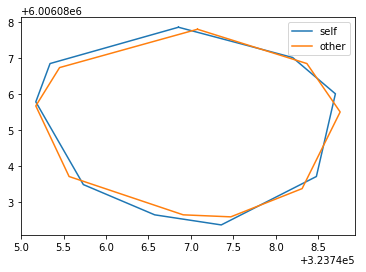

[[ 75 205]
 [ 74 206]
 [ 73 206]
 [ 72 206]
 [ 71 207]
 [ 70 207]
 [ 69 208]
 [ 68 209]
 [ 67 210]
 [ 66 211]
 [ 66 212]
 [ 65 213]
 [ 64 213]
 [ 63 213]
 [ 62 214]
 [ 61 214]
 [ 60 215]
 [ 60 216]
 [ 59 217]
 [ 59 218]
 [ 59 219]
 [ 58 220]
 [ 58 221]
 [ 57 222]
 [ 56 223]
 [ 55 223]
 [ 54 223]
 [ 53 223]
 [ 52 224]
 [ 52 225]
 [ 51 226]
 [ 51 227]
 [ 50 228]
 [ 49 229]
 [ 49 230]
 [ 48 231]
 [ 47 232]
 [ 47 233]
 [ 46 234]
 [ 45 235]
 [ 45 236]
 [ 44 237]
 [ 44 238]
 [ 43 239]
 [ 43 240]
 [ 43 241]
 [ 43 242]
 [ 42 243]
 [ 42 244]
 [ 42 245]
 [ 41 246]
 [ 41 247]
 [ 41 248]
 [ 41 249]
 [ 41 250]
 [ 40 251]
 [ 40 252]
 [ 40 253]
 [ 40 254]
 [ 40 255]
 [ 39 256]
 [ 39 257]
 [ 39 258]
 [ 39 259]
 [ 39 260]
 [ 39 261]
 [ 39 262]
 [ 39 263]
 [ 39 264]
 [ 39 265]
 [ 39 266]
 [ 39 267]
 [ 39 268]
 [ 39 269]
 [ 39 270]
 [ 39 271]
 [ 39 272]
 [ 39 273]
 [ 39 274]
 [ 39 275]
 [ 39 276]
 [ 39 277]
 [ 38 278]
 [ 38 279]
 [ 38 280]
 [ 38 281]
 [ 38 282]
 [ 38 283]
 [ 38 284]
 [ 38 285]
 [ 38 286]

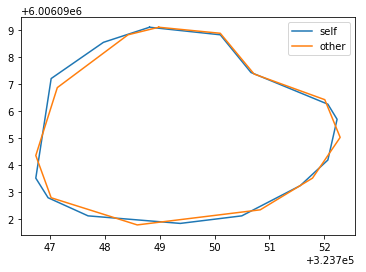

[[334  91]
 [333  92]
 [332  92]
 [331  92]
 [330  92]
 [329  92]
 [328  93]
 [327  93]
 [326  94]
 [325  95]
 [324  96]
 [323  97]
 [322  97]
 [321  98]
 [320  98]
 [319  99]
 [318 100]
 [317 101]
 [316 102]
 [315 103]
 [314 104]
 [314 105]
 [313 106]
 [313 107]
 [313 108]
 [312 109]
 [312 110]
 [311 111]
 [310 112]
 [310 113]
 [309 114]
 [308 115]
 [308 116]
 [307 117]
 [307 118]
 [307 119]
 [306 120]
 [306 121]
 [305 122]
 [305 123]
 [304 124]
 [304 125]
 [303 126]
 [303 127]
 [302 128]
 [302 129]
 [301 130]
 [300 131]
 [300 132]
 [300 133]
 [299 134]
 [298 135]
 [297 136]
 [296 137]
 [296 138]
 [295 139]
 [295 140]
 [294 141]
 [294 142]
 [293 143]
 [293 144]
 [293 145]
 [292 146]
 [292 147]
 [292 148]
 [292 149]
 [292 150]
 [292 151]
 [292 152]
 [292 153]
 [292 154]
 [292 155]
 [292 156]
 [292 157]
 [292 158]
 [292 159]
 [292 160]
 [292 161]
 [292 162]
 [293 163]
 [293 164]
 [293 165]
 [293 166]
 [294 167]
 [295 168]
 [296 169]
 [297 169]
 [298 170]
 [299 170]
 [300 170]
 [301 170]

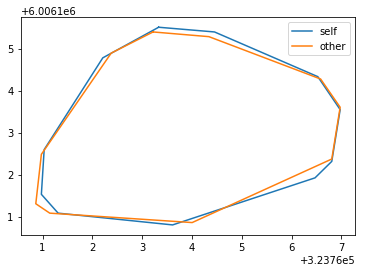

34it [00:57,  1.53s/it]

[[145 423]
 [144 424]
 [143 424]
 [142 424]
 [141 425]
 [140 425]
 [139 425]
 [138 426]
 [137 427]
 [137 428]
 [136 429]
 [136 430]
 [135 431]
 [134 432]
 [134 433]
 [133 434]
 [133 435]
 [133 436]
 [132 437]
 [132 438]
 [132 439]
 [132 440]
 [132 441]
 [132 442]
 [132 443]
 [132 444]
 [132 445]
 [132 446]
 [132 447]
 [132 448]
 [132 449]
 [132 450]
 [132 451]
 [132 452]
 [132 453]
 [133 454]
 [133 455]
 [133 456]
 [134 457]
 [134 458]
 [134 459]
 [135 460]
 [135 461]
 [136 462]
 [137 463]
 [137 464]
 [138 465]
 [138 466]
 [138 467]
 [139 468]
 [140 469]
 [140 470]
 [141 471]
 [142 472]
 [142 473]
 [143 474]
 [144 475]
 [144 476]
 [145 477]
 [146 478]
 [147 479]
 [148 479]
 [149 480]
 [150 480]
 [151 481]
 [152 482]
 [153 482]
 [154 482]
 [155 482]
 [156 482]
 [157 483]
 [158 483]
 [159 483]
 [160 483]
 [161 483]
 [162 483]
 [163 483]
 [164 483]
 [165 483]
 [166 483]
 [167 483]
 [168 483]
 [169 483]
 [170 482]
 [171 482]
 [172 482]
 [173 482]
 [174 482]
 [175 481]
 [176 481]
 [177 480]

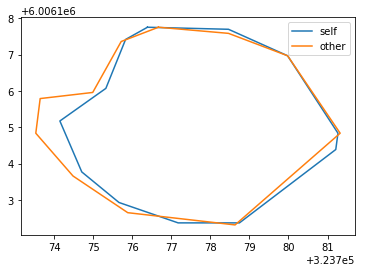

[[111 126]
 [110 127]
 [109 127]
 [108 127]
 [107 127]
 [106 127]
 [105 127]
 [104 128]
 [103 128]
 [102 129]
 [101 129]
 [100 130]
 [ 99 130]
 [ 98 130]
 [ 97 130]
 [ 96 130]
 [ 95 131]
 [ 94 131]
 [ 93 132]
 [ 92 132]
 [ 91 133]
 [ 90 133]
 [ 89 134]
 [ 88 135]
 [ 87 135]
 [ 86 136]
 [ 85 137]
 [ 85 138]
 [ 84 139]
 [ 84 140]
 [ 83 141]
 [ 82 142]
 [ 82 143]
 [ 81 144]
 [ 81 145]
 [ 81 146]
 [ 81 147]
 [ 80 148]
 [ 80 149]
 [ 80 150]
 [ 80 151]
 [ 80 152]
 [ 80 153]
 [ 80 154]
 [ 79 155]
 [ 79 156]
 [ 80 157]
 [ 80 158]
 [ 80 159]
 [ 80 160]
 [ 80 161]
 [ 80 162]
 [ 80 163]
 [ 80 164]
 [ 81 165]
 [ 81 166]
 [ 81 167]
 [ 82 168]
 [ 82 169]
 [ 83 170]
 [ 83 171]
 [ 84 172]
 [ 85 173]
 [ 86 174]
 [ 87 175]
 [ 88 176]
 [ 89 177]
 [ 90 178]
 [ 91 179]
 [ 92 180]
 [ 93 180]
 [ 94 181]
 [ 95 182]
 [ 96 183]
 [ 97 184]
 [ 98 185]
 [ 99 185]
 [100 186]
 [101 187]
 [102 188]
 [103 189]
 [104 189]
 [105 190]
 [106 191]
 [107 192]
 [108 193]
 [109 194]
 [110 195]
 [111 196]
 [112 196]
 [113 197]

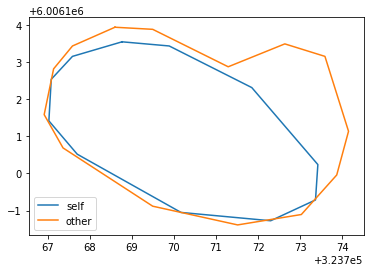

[[309 260]
 [308 261]
 [307 261]
 [306 261]
 [305 261]
 [304 261]
 [303 262]
 [302 262]
 [301 263]
 [300 264]
 [299 265]
 [298 266]
 [297 266]
 [296 267]
 [296 268]
 [295 269]
 [294 270]
 [294 271]
 [293 272]
 [293 273]
 [292 274]
 [291 275]
 [291 276]
 [290 277]
 [290 278]
 [290 279]
 [289 280]
 [289 281]
 [288 282]
 [288 283]
 [288 284]
 [287 285]
 [287 286]
 [287 287]
 [286 288]
 [286 289]
 [285 290]
 [284 291]
 [284 292]
 [284 293]
 [284 294]
 [284 295]
 [284 296]
 [284 297]
 [284 298]
 [284 299]
 [284 300]
 [283 301]
 [283 302]
 [283 303]
 [283 304]
 [283 305]
 [283 306]
 [283 307]
 [284 308]
 [284 309]
 [284 310]
 [285 310]
 [286 311]
 [287 312]
 [288 313]
 [289 314]
 [290 314]
 [291 315]
 [292 316]
 [293 316]
 [294 317]
 [295 318]
 [296 319]
 [297 320]
 [298 321]
 [298 322]
 [299 323]
 [299 324]
 [300 325]
 [300 326]
 [301 327]
 [301 328]
 [302 329]
 [302 330]
 [302 331]
 [303 332]
 [303 333]
 [303 334]
 [304 335]
 [304 336]
 [304 337]
 [304 338]
 [305 339]
 [305 340]
 [305 341]

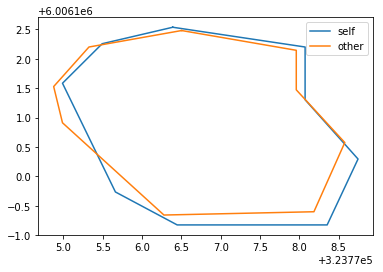

[[303 177]
 [302 178]
 [301 178]
 [300 178]
 [299 178]
 [298 179]
 [297 179]
 [296 180]
 [295 181]
 [294 181]
 [294 182]
 [293 183]
 [292 184]
 [291 185]
 [291 186]
 [291 187]
 [290 188]
 [290 189]
 [290 190]
 [289 191]
 [289 192]
 [289 193]
 [288 194]
 [288 195]
 [288 196]
 [288 197]
 [287 198]
 [287 199]
 [287 200]
 [287 201]
 [287 202]
 [287 203]
 [286 204]
 [286 205]
 [286 206]
 [286 207]
 [286 208]
 [286 209]
 [286 210]
 [286 211]
 [286 212]
 [286 213]
 [286 214]
 [287 215]
 [287 216]
 [287 217]
 [288 218]
 [288 219]
 [289 220]
 [290 221]
 [290 222]
 [291 223]
 [292 224]
 [293 225]
 [294 226]
 [295 226]
 [296 226]
 [297 227]
 [298 227]
 [299 228]
 [300 228]
 [301 228]
 [302 229]
 [303 229]
 [304 229]
 [305 229]
 [306 229]
 [307 229]
 [308 229]
 [309 229]
 [310 229]
 [311 228]
 [312 228]
 [313 228]
 [314 228]
 [315 228]
 [316 227]
 [317 227]
 [318 226]
 [319 226]
 [320 225]
 [321 225]
 [322 224]
 [323 223]
 [324 222]
 [325 221]
 [326 220]
 [327 219]
 [328 218]
 [329 217]
 [330 216]

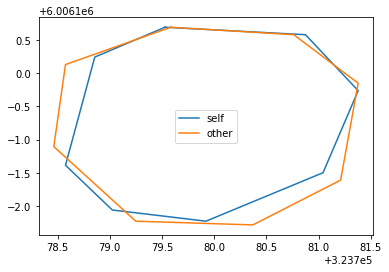

35it [00:57,  1.31s/it]

[[364 233]
 [363 234]
 [362 234]
 [361 234]
 [360 235]
 [359 235]
 [358 236]
 [357 237]
 [356 238]
 [355 239]
 [354 240]
 [354 241]
 [353 242]
 [353 243]
 [352 244]
 [352 245]
 [352 246]
 [352 247]
 [351 248]
 [351 249]
 [351 250]
 [351 251]
 [351 252]
 [351 253]
 [351 254]
 [351 255]
 [351 256]
 [351 257]
 [351 258]
 [351 259]
 [351 260]
 [351 261]
 [351 262]
 [351 263]
 [351 264]
 [351 265]
 [351 266]
 [352 267]
 [352 268]
 [352 269]
 [352 270]
 [353 271]
 [353 272]
 [354 273]
 [354 274]
 [355 275]
 [356 275]
 [357 276]
 [358 276]
 [359 277]
 [360 277]
 [361 278]
 [362 278]
 [363 278]
 [364 278]
 [365 278]
 [366 278]
 [367 278]
 [368 278]
 [369 278]
 [370 278]
 [371 278]
 [372 278]
 [373 278]
 [374 278]
 [375 278]
 [376 278]
 [377 278]
 [378 278]
 [379 278]
 [380 278]
 [381 278]
 [382 277]
 [383 277]
 [384 276]
 [385 275]
 [386 275]
 [386 274]
 [387 273]
 [387 272]
 [388 271]
 [388 270]
 [388 269]
 [389 268]
 [389 267]
 [390 266]
 [390 265]
 [390 264]
 [390 263]
 [390 262]
 [390 261]

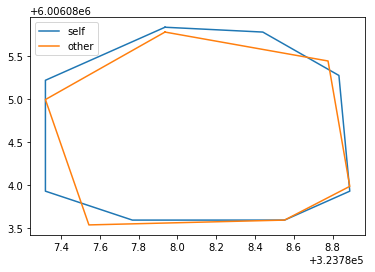

36it [00:58,  1.03it/s]

[[389 209]
 [388 210]
 [387 211]
 [386 211]
 [385 211]
 [384 211]
 [383 211]
 [382 211]
 [381 211]
 [380 211]
 [379 212]
 [378 213]
 [377 214]
 [376 214]
 [375 214]
 [374 215]
 [373 216]
 [372 216]
 [371 217]
 [370 217]
 [369 218]
 [368 218]
 [367 219]
 [366 219]
 [365 220]
 [364 220]
 [363 220]
 [362 221]
 [361 221]
 [360 221]
 [359 221]
 [358 222]
 [357 222]
 [356 222]
 [355 222]
 [354 223]
 [353 223]
 [352 223]
 [351 223]
 [350 223]
 [349 223]
 [348 224]
 [347 224]
 [346 224]
 [345 224]
 [344 225]
 [343 225]
 [342 225]
 [341 226]
 [340 226]
 [339 226]
 [338 227]
 [337 227]
 [336 228]
 [335 228]
 [334 229]
 [333 229]
 [332 230]
 [331 231]
 [330 232]
 [329 232]
 [329 233]
 [328 234]
 [328 235]
 [328 236]
 [327 237]
 [327 238]
 [327 239]
 [327 240]
 [327 241]
 [327 242]
 [327 243]
 [327 244]
 [327 245]
 [327 246]
 [327 247]
 [327 248]
 [327 249]
 [327 250]
 [327 251]
 [327 252]
 [327 253]
 [327 254]
 [327 255]
 [327 256]
 [327 257]
 [327 258]
 [327 259]
 [327 260]
 [327 261]
 [327 262]

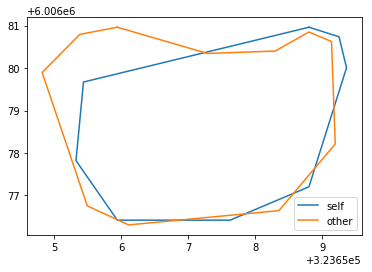

[[449 272]
 [448 273]
 [447 273]
 [446 273]
 [445 273]
 [444 273]
 [443 274]
 [442 274]
 [441 274]
 [440 274]
 [439 275]
 [438 275]
 [437 275]
 [436 276]
 [435 276]
 [434 277]
 [433 277]
 [432 277]
 [431 278]
 [430 278]
 [429 279]
 [428 279]
 [427 280]
 [426 281]
 [425 282]
 [424 282]
 [423 283]
 [422 283]
 [421 284]
 [420 285]
 [419 286]
 [418 287]
 [417 287]
 [416 288]
 [415 289]
 [414 290]
 [413 291]
 [412 292]
 [411 293]
 [410 294]
 [409 295]
 [409 296]
 [408 297]
 [407 298]
 [407 299]
 [406 300]
 [406 301]
 [405 302]
 [405 303]
 [404 304]
 [404 305]
 [403 306]
 [403 307]
 [403 308]
 [402 309]
 [402 310]
 [402 311]
 [402 312]
 [401 313]
 [401 314]
 [401 315]
 [401 316]
 [401 317]
 [401 318]
 [401 319]
 [401 320]
 [401 321]
 [401 322]
 [401 323]
 [401 324]
 [401 325]
 [401 326]
 [401 327]
 [401 328]
 [401 329]
 [401 330]
 [401 331]
 [401 332]
 [401 333]
 [401 334]
 [401 335]
 [401 336]
 [401 337]
 [402 338]
 [402 339]
 [402 340]
 [402 341]
 [402 342]
 [403 343]
 [403 344]
 [404 345]

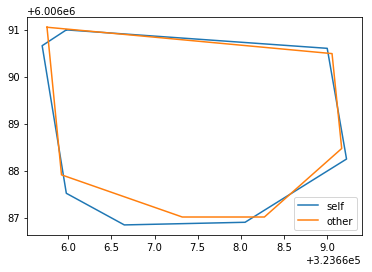

[[486 138]
 [485 139]
 [484 139]
 [483 139]
 [482 140]
 [481 141]
 [480 141]
 [479 142]
 [478 143]
 [477 144]
 [476 144]
 [475 145]
 [474 145]
 [473 146]
 [472 147]
 [471 147]
 [470 148]
 [469 148]
 [468 148]
 [467 149]
 [466 149]
 [465 150]
 [464 150]
 [463 151]
 [462 151]
 [461 151]
 [460 151]
 [459 152]
 [458 152]
 [457 153]
 [456 153]
 [455 154]
 [454 154]
 [453 155]
 [452 155]
 [451 156]
 [450 157]
 [449 157]
 [448 157]
 [447 158]
 [446 158]
 [445 159]
 [444 160]
 [443 160]
 [442 161]
 [441 162]
 [440 162]
 [439 163]
 [438 164]
 [437 164]
 [436 165]
 [435 166]
 [434 166]
 [433 167]
 [432 168]
 [431 169]
 [430 170]
 [430 171]
 [429 172]
 [429 173]
 [428 174]
 [428 175]
 [428 176]
 [428 177]
 [427 178]
 [427 179]
 [427 180]
 [427 181]
 [427 182]
 [427 183]
 [427 184]
 [427 185]
 [427 186]
 [427 187]
 [427 188]
 [427 189]
 [428 190]
 [428 191]
 [428 192]
 [428 193]
 [428 194]
 [428 195]
 [428 196]
 [428 197]
 [428 198]
 [428 199]
 [428 200]
 [428 201]
 [428 202]
 [428 203]
 [428 204]

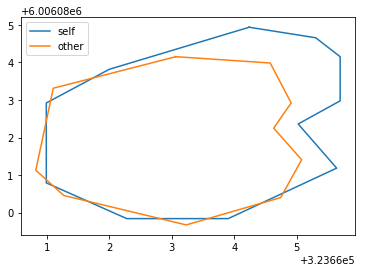

[[487  17]
 [486  18]
 [485  18]
 [484  18]
 [483  18]
 [482  19]
 [481  19]
 [480  20]
 [479  20]
 [478  21]
 [477  21]
 [476  22]
 [475  23]
 [474  24]
 [473  24]
 [472  25]
 [471  26]
 [470  26]
 [469  27]
 [468  27]
 [467  28]
 [466  28]
 [465  29]
 [464  29]
 [463  30]
 [462  31]
 [461  31]
 [460  32]
 [459  32]
 [458  32]
 [457  33]
 [456  34]
 [455  34]
 [454  35]
 [453  36]
 [452  36]
 [451  37]
 [450  37]
 [449  38]
 [448  39]
 [447  40]
 [446  40]
 [446  41]
 [445  42]
 [445  43]
 [444  44]
 [444  45]
 [444  46]
 [443  47]
 [443  48]
 [443  49]
 [443  50]
 [444  51]
 [444  52]
 [444  53]
 [444  54]
 [444  55]
 [444  56]
 [445  57]
 [445  58]
 [445  59]
 [446  60]
 [446  61]
 [446  62]
 [446  63]
 [446  64]
 [447  65]
 [447  66]
 [447  67]
 [448  68]
 [448  69]
 [448  70]
 [448  71]
 [448  72]
 [449  73]
 [449  74]
 [449  75]
 [449  76]
 [450  77]
 [450  78]
 [450  79]
 [451  80]
 [451  81]
 [451  82]
 [451  83]
 [452  84]
 [452  85]
 [453  86]
 [454  87]
 [454  88]
 [455  89]

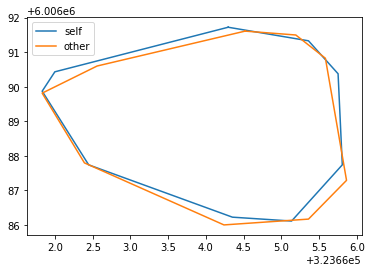

[[169 294]
 [168 295]
 [167 295]
 [166 296]
 [165 297]
 [164 298]
 [163 299]
 [163 300]
 [162 301]
 [162 302]
 [161 303]
 [161 304]
 [161 305]
 [161 306]
 [160 307]
 [160 308]
 [160 309]
 [160 310]
 [160 311]
 [160 312]
 [160 313]
 [160 314]
 [160 315]
 [159 316]
 [159 317]
 [159 318]
 [159 319]
 [159 320]
 [159 321]
 [159 322]
 [159 323]
 [159 324]
 [159 325]
 [159 326]
 [159 327]
 [159 328]
 [159 329]
 [159 330]
 [159 331]
 [159 332]
 [159 333]
 [159 334]
 [159 335]
 [159 336]
 [160 337]
 [160 338]
 [160 339]
 [161 340]
 [161 341]
 [162 342]
 [162 343]
 [162 344]
 [163 345]
 [164 346]
 [164 347]
 [165 348]
 [166 349]
 [167 350]
 [168 351]
 [169 352]
 [170 352]
 [171 353]
 [172 353]
 [173 353]
 [174 353]
 [175 353]
 [176 353]
 [177 353]
 [178 353]
 [179 353]
 [180 353]
 [181 353]
 [182 352]
 [183 352]
 [184 352]
 [185 352]
 [186 352]
 [187 352]
 [188 351]
 [189 351]
 [190 351]
 [191 350]
 [192 350]
 [193 350]
 [194 349]
 [195 349]
 [196 348]
 [197 348]
 [198 347]
 [199 347]
 [200 346]

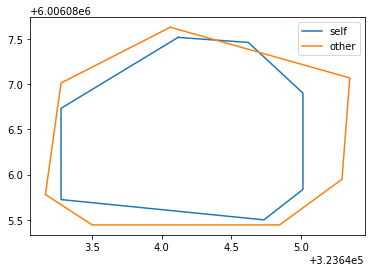

[[197 126]
 [196 127]
 [195 127]
 [194 127]
 [193 128]
 [192 129]
 [191 129]
 [190 130]
 [189 131]
 [188 131]
 [187 132]
 [186 133]
 [185 134]
 [184 135]
 [183 136]
 [182 137]
 [181 138]
 [180 139]
 [179 139]
 [178 140]
 [177 141]
 [176 142]
 [175 142]
 [174 143]
 [173 144]
 [172 144]
 [171 145]
 [170 146]
 [169 147]
 [168 148]
 [168 149]
 [167 150]
 [167 151]
 [167 152]
 [166 153]
 [166 154]
 [166 155]
 [166 156]
 [166 157]
 [166 158]
 [166 159]
 [166 160]
 [166 161]
 [166 162]
 [166 163]
 [166 164]
 [166 165]
 [166 166]
 [166 167]
 [166 168]
 [166 169]
 [166 170]
 [166 171]
 [167 172]
 [167 173]
 [167 174]
 [167 175]
 [167 176]
 [167 177]
 [168 178]
 [168 179]
 [168 180]
 [169 181]
 [169 182]
 [169 183]
 [170 184]
 [171 185]
 [171 186]
 [172 187]
 [173 188]
 [174 189]
 [175 189]
 [176 190]
 [177 190]
 [178 190]
 [179 190]
 [180 191]
 [181 191]
 [182 191]
 [183 191]
 [184 191]
 [185 191]
 [186 191]
 [187 191]
 [188 191]
 [189 191]
 [190 191]
 [191 191]
 [192 191]
 [193 191]
 [194 191]

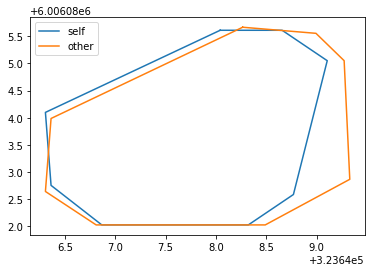

[[376 118]
 [375 119]
 [374 119]
 [373 119]
 [372 119]
 [371 120]
 [370 120]
 [369 120]
 [368 121]
 [367 121]
 [366 122]
 [365 123]
 [364 123]
 [363 124]
 [362 124]
 [361 125]
 [360 125]
 [359 126]
 [358 126]
 [357 127]
 [356 127]
 [355 128]
 [354 128]
 [353 129]
 [352 130]
 [351 130]
 [350 131]
 [349 131]
 [348 131]
 [347 132]
 [346 133]
 [345 133]
 [344 134]
 [343 134]
 [343 135]
 [342 136]
 [342 137]
 [341 138]
 [341 139]
 [341 140]
 [341 141]
 [341 142]
 [341 143]
 [341 144]
 [341 145]
 [341 146]
 [341 147]
 [341 148]
 [342 149]
 [342 150]
 [342 151]
 [342 152]
 [343 153]
 [343 154]
 [344 155]
 [344 156]
 [345 157]
 [346 158]
 [346 159]
 [347 160]
 [348 161]
 [349 162]
 [349 163]
 [350 163]
 [351 164]
 [352 165]
 [353 166]
 [354 167]
 [355 167]
 [356 168]
 [357 169]
 [358 170]
 [359 171]
 [360 172]
 [361 172]
 [362 173]
 [363 174]
 [364 175]
 [365 175]
 [366 176]
 [367 177]
 [368 177]
 [369 178]
 [370 179]
 [371 179]
 [372 180]
 [373 180]
 [374 180]
 [375 181]
 [376 181]
 [377 181]

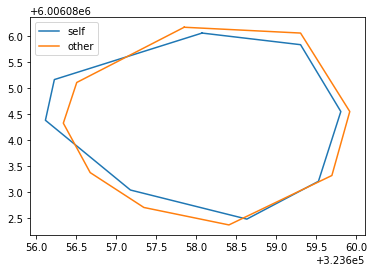

[[546 113]
 [545 114]
 [544 114]
 [543 114]
 [542 114]
 [541 114]
 [540 115]
 [539 115]
 [538 115]
 [537 115]
 [536 116]
 [535 116]
 [534 116]
 [533 116]
 [532 117]
 [531 117]
 [530 117]
 [529 118]
 [528 118]
 [527 119]
 [526 119]
 [525 119]
 [524 119]
 [523 119]
 [522 120]
 [521 120]
 [520 121]
 [519 121]
 [518 121]
 [517 122]
 [516 122]
 [515 123]
 [514 123]
 [513 124]
 [512 124]
 [511 125]
 [510 125]
 [509 126]
 [508 126]
 [507 127]
 [507 128]
 [506 129]
 [506 130]
 [506 131]
 [505 132]
 [504 133]
 [504 134]
 [504 135]
 [504 136]
 [505 137]
 [505 138]
 [506 139]
 [506 140]
 [506 141]
 [506 142]
 [507 143]
 [507 144]
 [507 145]
 [508 146]
 [508 147]
 [508 148]
 [508 149]
 [509 150]
 [509 151]
 [509 152]
 [509 153]
 [510 154]
 [510 155]
 [511 156]
 [511 157]
 [511 158]
 [512 159]
 [512 160]
 [512 161]
 [512 162]
 [513 163]
 [513 164]
 [513 165]
 [513 166]
 [514 167]
 [514 168]
 [514 169]
 [514 170]
 [514 171]
 [514 172]
 [514 173]
 [514 174]
 [514 175]
 [515 176]
 [515 177]
 [515 178]

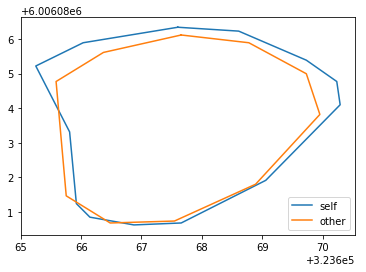

[[152 356]
 [151 357]
 [150 357]
 [149 357]
 [148 357]
 [147 358]
 [146 358]
 [145 358]
 [144 359]
 [143 360]
 [142 361]
 [141 362]
 [140 363]
 [139 364]
 [138 365]
 [137 366]
 [136 367]
 [135 368]
 [134 369]
 [134 370]
 [133 371]
 [133 372]
 [133 373]
 [132 374]
 [132 375]
 [132 376]
 [132 377]
 [132 378]
 [132 379]
 [132 380]
 [131 381]
 [131 382]
 [131 383]
 [131 384]
 [131 385]
 [132 386]
 [132 387]
 [132 388]
 [133 389]
 [133 390]
 [134 391]
 [134 392]
 [135 392]
 [136 393]
 [137 393]
 [138 394]
 [139 394]
 [140 395]
 [141 395]
 [142 395]
 [143 396]
 [144 396]
 [145 396]
 [146 396]
 [147 396]
 [148 397]
 [149 397]
 [150 397]
 [151 397]
 [152 397]
 [153 397]
 [154 398]
 [155 398]
 [156 398]
 [157 398]
 [158 398]
 [159 398]
 [160 398]
 [161 397]
 [162 397]
 [163 397]
 [164 396]
 [165 396]
 [166 395]
 [167 394]
 [168 393]
 [169 392]
 [170 391]
 [170 390]
 [171 389]
 [172 388]
 [172 387]
 [173 386]
 [173 385]
 [174 384]
 [174 383]
 [174 382]
 [174 381]
 [175 380]
 [175 379]
 [175 378]

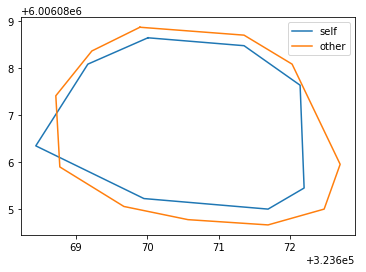

37it [00:59,  1.05s/it]

[[275 164]
 [274 165]
 [273 165]
 [272 165]
 [271 165]
 [270 165]
 [269 165]
 [268 166]
 [267 166]
 [266 167]
 [265 167]
 [264 168]
 [263 169]
 [262 170]
 [261 171]
 [260 172]
 [259 173]
 [258 173]
 [257 174]
 [256 175]
 [255 176]
 [254 176]
 [253 177]
 [252 178]
 [251 178]
 [250 179]
 [249 179]
 [248 180]
 [247 181]
 [246 181]
 [245 182]
 [244 182]
 [243 183]
 [242 183]
 [241 184]
 [240 185]
 [239 186]
 [238 187]
 [237 188]
 [236 189]
 [235 190]
 [235 191]
 [234 192]
 [233 193]
 [233 194]
 [233 195]
 [232 196]
 [232 197]
 [231 198]
 [231 199]
 [231 200]
 [231 201]
 [230 202]
 [230 203]
 [230 204]
 [230 205]
 [230 206]
 [230 207]
 [230 208]
 [229 209]
 [229 210]
 [229 211]
 [229 212]
 [229 213]
 [229 214]
 [229 215]
 [229 216]
 [229 217]
 [229 218]
 [229 219]
 [229 220]
 [229 221]
 [229 222]
 [229 223]
 [229 224]
 [229 225]
 [229 226]
 [229 227]
 [229 228]
 [229 229]
 [229 230]
 [229 231]
 [229 232]
 [229 233]
 [230 234]
 [230 235]
 [230 236]
 [230 237]
 [231 238]
 [231 239]
 [231 240]

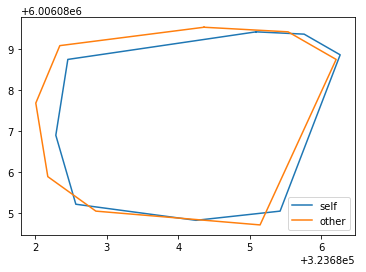

[[322 316]
 [321 317]
 [320 317]
 [319 317]
 [318 317]
 [317 317]
 [316 317]
 [315 317]
 [314 318]
 [313 318]
 [312 318]
 [311 319]
 [310 319]
 [309 320]
 [308 320]
 [307 321]
 [306 322]
 [305 323]
 [304 324]
 [303 325]
 [302 326]
 [301 327]
 [300 328]
 [300 329]
 [299 330]
 [298 331]
 [298 332]
 [297 333]
 [296 334]
 [296 335]
 [295 336]
 [295 337]
 [294 338]
 [294 339]
 [293 340]
 [293 341]
 [292 342]
 [292 343]
 [291 344]
 [291 345]
 [291 346]
 [290 347]
 [290 348]
 [290 349]
 [290 350]
 [290 351]
 [290 352]
 [290 353]
 [290 354]
 [290 355]
 [290 356]
 [290 357]
 [290 358]
 [290 359]
 [290 360]
 [290 361]
 [290 362]
 [290 363]
 [290 364]
 [290 365]
 [290 366]
 [290 367]
 [291 368]
 [291 369]
 [291 370]
 [292 371]
 [292 372]
 [293 373]
 [293 374]
 [294 375]
 [294 376]
 [295 377]
 [295 378]
 [296 379]
 [297 380]
 [298 381]
 [299 382]
 [300 383]
 [301 384]
 [301 385]
 [302 385]
 [303 386]
 [304 387]
 [305 387]
 [306 388]
 [307 389]
 [308 390]
 [309 390]
 [310 391]
 [311 391]
 [312 392]

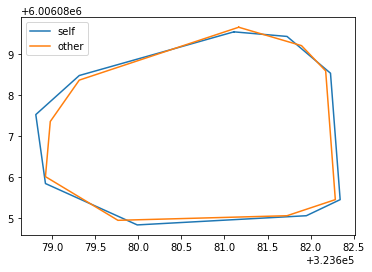

[[136 272]
 [135 273]
 [134 273]
 [133 273]
 [132 273]
 [131 273]
 [130 273]
 [129 273]
 [128 273]
 [127 273]
 [126 273]
 [125 274]
 [124 274]
 [123 274]
 [122 274]
 [121 274]
 [120 275]
 [119 275]
 [118 275]
 [117 275]
 [116 276]
 [115 276]
 [114 277]
 [113 277]
 [112 277]
 [111 278]
 [110 278]
 [109 279]
 [108 280]
 [107 280]
 [106 281]
 [105 282]
 [104 282]
 [103 283]
 [102 284]
 [101 284]
 [100 285]
 [ 99 286]
 [ 98 287]
 [ 97 288]
 [ 96 289]
 [ 95 289]
 [ 94 290]
 [ 93 291]
 [ 92 292]
 [ 91 293]
 [ 90 294]
 [ 89 295]
 [ 89 296]
 [ 88 297]
 [ 87 298]
 [ 86 299]
 [ 86 300]
 [ 85 301]
 [ 85 302]
 [ 84 303]
 [ 84 304]
 [ 83 305]
 [ 83 306]
 [ 83 307]
 [ 82 308]
 [ 82 309]
 [ 82 310]
 [ 82 311]
 [ 81 312]
 [ 81 313]
 [ 81 314]
 [ 81 315]
 [ 81 316]
 [ 81 317]
 [ 81 318]
 [ 81 319]
 [ 81 320]
 [ 80 321]
 [ 80 322]
 [ 80 323]
 [ 80 324]
 [ 80 325]
 [ 80 326]
 [ 80 327]
 [ 80 328]
 [ 80 329]
 [ 80 330]
 [ 80 331]
 [ 80 332]
 [ 80 333]
 [ 80 334]
 [ 80 335]
 [ 81 336]
 [ 81 337]
 [ 81 338]

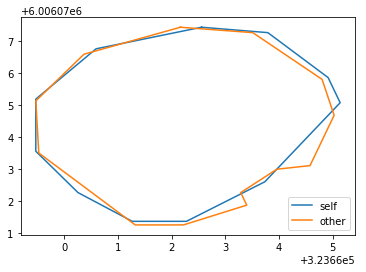

[[526 313]
 [525 314]
 [524 314]
 [523 315]
 [522 316]
 [521 317]
 [520 318]
 [519 319]
 [518 320]
 [517 321]
 [517 322]
 [516 323]
 [516 324]
 [516 325]
 [515 326]
 [515 327]
 [515 328]
 [514 329]
 [514 330]
 [513 331]
 [513 332]
 [512 333]
 [511 334]
 [511 335]
 [510 336]
 [510 337]
 [509 338]
 [509 339]
 [508 340]
 [508 341]
 [507 342]
 [506 343]
 [505 344]
 [505 345]
 [504 346]
 [503 347]
 [502 348]
 [501 349]
 [501 350]
 [500 351]
 [499 352]
 [498 353]
 [497 354]
 [496 355]
 [495 355]
 [495 356]
 [494 357]
 [494 358]
 [494 359]
 [494 360]
 [494 361]
 [494 362]
 [494 363]
 [494 364]
 [494 365]
 [494 366]
 [494 367]
 [493 368]
 [493 369]
 [494 370]
 [494 371]
 [494 372]
 [494 373]
 [494 374]
 [494 375]
 [494 376]
 [494 377]
 [495 378]
 [495 379]
 [496 379]
 [497 380]
 [498 381]
 [499 382]
 [500 383]
 [501 383]
 [502 384]
 [503 385]
 [504 386]
 [505 387]
 [506 388]
 [507 389]
 [508 390]
 [509 391]
 [510 392]
 [511 393]
 [512 394]
 [512 395]
 [513 396]
 [514 397]
 [514 398]
 [515 399]

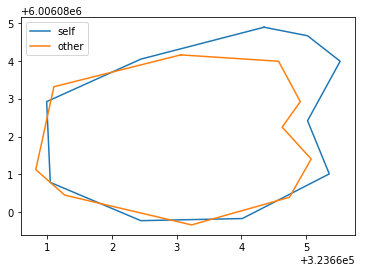

[[198  26]
 [197  27]
 [196  27]
 [195  28]
 [194  29]
 [194  30]
 [193  31]
 [193  32]
 [193  33]
 [193  34]
 [192  35]
 [192  36]
 [193  37]
 [193  38]
 [193  39]
 [193  40]
 [193  41]
 [193  42]
 [193  43]
 [193  44]
 [193  45]
 [193  46]
 [193  47]
 [193  48]
 [193  49]
 [194  50]
 [194  51]
 [194  52]
 [194  53]
 [194  54]
 [194  55]
 [194  56]
 [194  57]
 [194  58]
 [194  59]
 [194  60]
 [194  61]
 [194  62]
 [194  63]
 [194  64]
 [194  65]
 [194  66]
 [194  67]
 [194  68]
 [194  69]
 [194  70]
 [194  71]
 [194  72]
 [194  73]
 [194  74]
 [194  75]
 [194  76]
 [194  77]
 [194  78]
 [194  79]
 [194  80]
 [195  81]
 [195  82]
 [195  83]
 [195  84]
 [195  85]
 [196  86]
 [196  87]
 [197  88]
 [198  89]
 [198  90]
 [199  91]
 [200  91]
 [201  92]
 [202  93]
 [203  94]
 [204  95]
 [205  95]
 [206  96]
 [207  97]
 [208  98]
 [209  98]
 [210  99]
 [211 100]
 [212 100]
 [213 100]
 [214 101]
 [215 101]
 [216 101]
 [217 102]
 [218 102]
 [219 103]
 [220 103]
 [221 103]
 [222 103]
 [223 103]

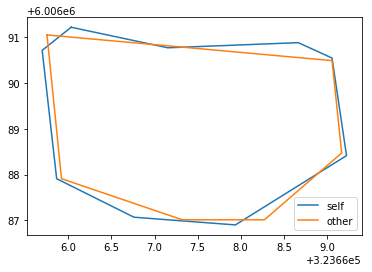

[[394  35]
 [393  36]
 [392  36]
 [391  36]
 [390  36]
 [389  36]
 [388  36]
 [387  36]
 [386  36]
 [385  37]
 [384  37]
 [383  37]
 [382  37]
 [381  37]
 [380  37]
 [379  37]
 [378  37]
 [377  37]
 [376  37]
 [375  37]
 [374  37]
 [373  37]
 [372  38]
 [371  38]
 [370  38]
 [369  38]
 [368  38]
 [367  38]
 [366  38]
 [365  38]
 [364  39]
 [363  39]
 [362  39]
 [361  39]
 [360  39]
 [359  39]
 [358  39]
 [357  40]
 [356  40]
 [355  40]
 [354  41]
 [353  41]
 [352  42]
 [351  42]
 [350  43]
 [349  43]
 [349  44]
 [348  45]
 [347  46]
 [347  47]
 [346  48]
 [346  49]
 [345  50]
 [345  51]
 [344  52]
 [344  53]
 [344  54]
 [344  55]
 [343  56]
 [343  57]
 [343  58]
 [343  59]
 [343  60]
 [343  61]
 [344  62]
 [344  63]
 [344  64]
 [344  65]
 [344  66]
 [344  67]
 [344  68]
 [344  69]
 [345  70]
 [345  71]
 [346  72]
 [346  73]
 [346  74]
 [347  75]
 [347  76]
 [347  77]
 [348  78]
 [349  79]
 [349  80]
 [350  81]
 [351  82]
 [351  83]
 [352  84]
 [352  85]
 [353  86]
 [354  87]
 [354  88]

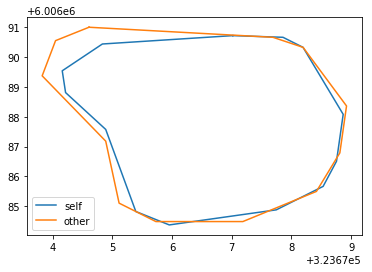

[[281 156]
 [280 157]
 [279 157]
 [278 157]
 [277 158]
 [276 158]
 [275 159]
 [274 159]
 [273 160]
 [272 161]
 [271 162]
 [270 163]
 [269 164]
 [269 165]
 [268 166]
 [267 167]
 [266 168]
 [265 169]
 [265 170]
 [265 171]
 [264 172]
 [264 173]
 [263 174]
 [263 175]
 [262 176]
 [262 177]
 [261 178]
 [261 179]
 [260 180]
 [260 181]
 [259 182]
 [259 183]
 [259 184]
 [258 185]
 [258 186]
 [257 187]
 [257 188]
 [257 189]
 [257 190]
 [256 191]
 [256 192]
 [256 193]
 [256 194]
 [255 195]
 [255 196]
 [254 197]
 [254 198]
 [254 199]
 [254 200]
 [254 201]
 [253 202]
 [253 203]
 [253 204]
 [252 205]
 [252 206]
 [252 207]
 [252 208]
 [252 209]
 [252 210]
 [251 211]
 [251 212]
 [251 213]
 [250 214]
 [250 215]
 [250 216]
 [250 217]
 [250 218]
 [250 219]
 [249 220]
 [249 221]
 [248 222]
 [247 223]
 [247 224]
 [247 225]
 [247 226]
 [247 227]
 [247 228]
 [247 229]
 [248 230]
 [248 231]
 [249 232]
 [250 233]
 [251 234]
 [251 235]
 [252 236]
 [252 237]
 [252 238]
 [252 239]
 [251 240]
 [250 240]
 [249 241]

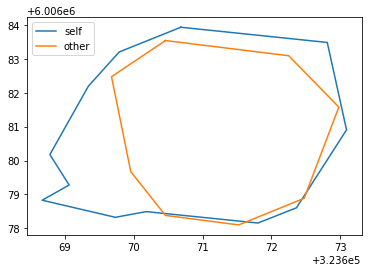

[[335 226]
 [334 227]
 [333 227]
 [332 227]
 [331 227]
 [330 227]
 [329 228]
 [328 228]
 [327 228]
 [326 229]
 [325 229]
 [324 230]
 [323 230]
 [322 231]
 [321 232]
 [320 233]
 [320 234]
 [319 235]
 [318 236]
 [318 237]
 [317 238]
 [317 239]
 [316 240]
 [316 241]
 [316 242]
 [315 243]
 [315 244]
 [315 245]
 [314 246]
 [314 247]
 [314 248]
 [313 249]
 [313 250]
 [313 251]
 [313 252]
 [313 253]
 [313 254]
 [313 255]
 [313 256]
 [313 257]
 [313 258]
 [313 259]
 [313 260]
 [313 261]
 [313 262]
 [314 263]
 [314 264]
 [314 265]
 [314 266]
 [315 267]
 [315 268]
 [315 269]
 [316 270]
 [316 271]
 [317 272]
 [318 273]
 [319 274]
 [320 275]
 [321 276]
 [322 277]
 [323 277]
 [324 278]
 [325 278]
 [326 278]
 [327 279]
 [328 279]
 [329 279]
 [330 279]
 [331 279]
 [332 279]
 [333 279]
 [334 279]
 [335 279]
 [336 279]
 [337 279]
 [338 279]
 [339 279]
 [340 279]
 [341 279]
 [342 279]
 [343 279]
 [344 279]
 [345 279]
 [346 279]
 [347 279]
 [348 279]
 [349 279]
 [350 279]
 [351 279]
 [352 279]
 [353 279]

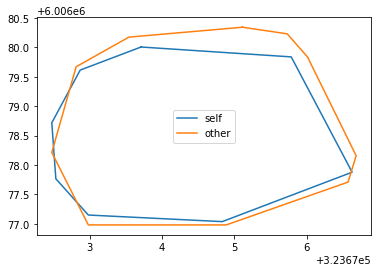

[[575  69]
 [574  70]
 [573  70]
 [572  70]
 [571  70]
 [570  70]
 [569  70]
 [568  71]
 [567  71]
 [566  72]
 [565  72]
 [564  73]
 [563  73]
 [562  74]
 [561  75]
 [561  76]
 [560  77]
 [559  78]
 [559  79]
 [558  80]
 [558  81]
 [557  82]
 [556  83]
 [556  84]
 [556  85]
 [555  86]
 [555  87]
 [555  88]
 [554  89]
 [554  90]
 [554  91]
 [553  92]
 [553  93]
 [553  94]
 [552  95]
 [552  96]
 [552  97]
 [551  98]
 [551  99]
 [551 100]
 [551 101]
 [550 102]
 [550 103]
 [550 104]
 [550 105]
 [549 106]
 [549 107]
 [549 108]
 [549 109]
 [549 110]
 [548 111]
 [548 112]
 [548 113]
 [548 114]
 [548 115]
 [547 116]
 [547 117]
 [547 118]
 [547 119]
 [547 120]
 [547 121]
 [547 122]
 [546 123]
 [546 124]
 [546 125]
 [546 126]
 [546 127]
 [545 128]
 [545 129]
 [545 130]
 [545 131]
 [545 132]
 [545 133]
 [545 134]
 [545 135]
 [545 136]
 [545 137]
 [545 138]
 [545 139]
 [545 140]
 [545 141]
 [546 142]
 [546 143]
 [546 144]
 [546 145]
 [547 146]
 [547 147]
 [547 148]
 [548 149]
 [548 150]
 [548 151]

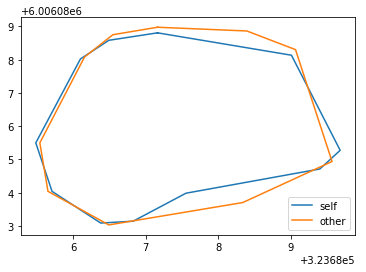

[[168  17]
 [167  18]
 [166  18]
 [165  18]
 [164  18]
 [163  19]
 [162  19]
 [161  19]
 [160  20]
 [159  20]
 [158  21]
 [157  21]
 [156  22]
 [155  22]
 [154  23]
 [153  24]
 [152  24]
 [151  25]
 [150  26]
 [149  26]
 [148  27]
 [147  28]
 [146  28]
 [145  29]
 [144  30]
 [143  30]
 [142  30]
 [141  31]
 [140  31]
 [139  32]
 [138  32]
 [137  33]
 [136  34]
 [135  34]
 [134  35]
 [133  35]
 [132  36]
 [131  36]
 [130  37]
 [129  38]
 [128  38]
 [127  39]
 [126  40]
 [125  41]
 [124  42]
 [123  43]
 [123  44]
 [123  45]
 [123  46]
 [123  47]
 [123  48]
 [123  49]
 [123  50]
 [123  51]
 [123  52]
 [123  53]
 [124  54]
 [124  55]
 [124  56]
 [125  57]
 [125  58]
 [125  59]
 [125  60]
 [126  61]
 [126  62]
 [126  63]
 [126  64]
 [127  65]
 [127  66]
 [127  67]
 [127  68]
 [127  69]
 [127  70]
 [128  71]
 [128  72]
 [128  73]
 [129  74]
 [129  75]
 [129  76]
 [129  77]
 [130  78]
 [130  79]
 [130  80]
 [131  81]
 [131  82]
 [131  83]
 [132  84]
 [133  85]
 [133  86]
 [134  87]
 [134  88]

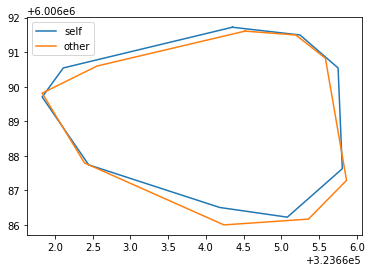

[[457 221]
 [456 222]
 [455 222]
 [454 222]
 [453 223]
 [452 223]
 [451 223]
 [450 224]
 [449 224]
 [448 224]
 [447 225]
 [447 226]
 [446 227]
 [445 228]
 [444 229]
 [443 230]
 [443 231]
 [442 232]
 [442 233]
 [441 234]
 [441 235]
 [440 236]
 [440 237]
 [440 238]
 [440 239]
 [439 240]
 [439 241]
 [438 242]
 [438 243]
 [438 244]
 [438 245]
 [438 246]
 [438 247]
 [438 248]
 [438 249]
 [438 250]
 [438 251]
 [438 252]
 [438 253]
 [438 254]
 [439 255]
 [439 256]
 [440 257]
 [441 258]
 [441 259]
 [442 259]
 [443 260]
 [444 261]
 [445 262]
 [446 263]
 [446 264]
 [447 265]
 [448 266]
 [449 267]
 [450 268]
 [451 269]
 [452 270]
 [453 271]
 [454 272]
 [455 272]
 [456 273]
 [457 273]
 [458 274]
 [459 275]
 [460 275]
 [461 275]
 [462 276]
 [463 276]
 [464 276]
 [465 277]
 [466 277]
 [467 277]
 [468 277]
 [469 277]
 [470 277]
 [471 277]
 [472 277]
 [473 277]
 [474 277]
 [475 277]
 [476 277]
 [477 277]
 [478 277]
 [479 277]
 [480 277]
 [481 277]
 [482 277]
 [483 277]
 [484 276]
 [485 276]
 [486 276]

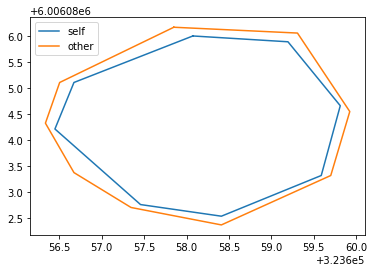

[[235 111]
 [234 112]
 [233 112]
 [232 112]
 [231 112]
 [230 112]
 [229 112]
 [228 113]
 [227 113]
 [226 113]
 [225 114]
 [224 114]
 [223 114]
 [222 115]
 [221 115]
 [220 115]
 [219 115]
 [218 116]
 [217 116]
 [216 116]
 [215 117]
 [214 118]
 [213 118]
 [212 118]
 [211 118]
 [210 118]
 [209 118]
 [208 119]
 [207 120]
 [206 120]
 [205 120]
 [204 120]
 [203 120]
 [202 120]
 [201 121]
 [200 122]
 [199 123]
 [198 123]
 [197 123]
 [196 124]
 [195 124]
 [194 125]
 [193 126]
 [192 127]
 [191 128]
 [191 129]
 [191 130]
 [190 131]
 [190 132]
 [189 133]
 [188 134]
 [187 135]
 [187 136]
 [186 137]
 [186 138]
 [186 139]
 [185 140]
 [185 141]
 [185 142]
 [185 143]
 [185 144]
 [185 145]
 [185 146]
 [185 147]
 [185 148]
 [185 149]
 [185 150]
 [186 151]
 [186 152]
 [186 153]
 [186 154]
 [186 155]
 [187 156]
 [187 157]
 [187 158]
 [187 159]
 [188 160]
 [188 161]
 [188 162]
 [189 163]
 [189 164]
 [189 165]
 [189 166]
 [189 167]
 [190 168]
 [190 169]
 [190 170]
 [190 171]
 [190 172]
 [190 173]
 [190 174]

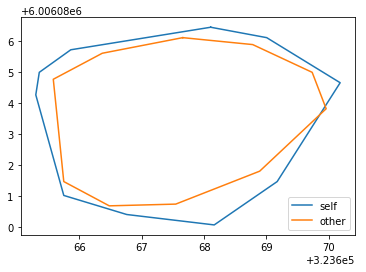

[[271  69]
 [270  70]
 [269  70]
 [268  70]
 [267  70]
 [266  70]
 [265  71]
 [264  71]
 [263  71]
 [262  72]
 [261  72]
 [260  73]
 [259  74]
 [258  75]
 [257  76]
 [256  77]
 [255  78]
 [254  79]
 [254  80]
 [253  81]
 [253  82]
 [252  83]
 [251  84]
 [250  85]
 [249  86]
 [249  87]
 [248  88]
 [247  89]
 [246  90]
 [245  91]
 [245  92]
 [244  93]
 [244  94]
 [243  95]
 [243  96]
 [243  97]
 [242  98]
 [242  99]
 [242 100]
 [241 101]
 [241 102]
 [241 103]
 [241 104]
 [241 105]
 [241 106]
 [241 107]
 [241 108]
 [241 109]
 [242 110]
 [242 111]
 [243 112]
 [243 113]
 [244 114]
 [245 115]
 [246 116]
 [247 117]
 [248 118]
 [249 119]
 [250 120]
 [251 120]
 [252 121]
 [253 121]
 [254 122]
 [255 122]
 [256 123]
 [257 124]
 [258 124]
 [259 125]
 [260 126]
 [261 127]
 [262 127]
 [263 128]
 [264 128]
 [265 129]
 [266 129]
 [267 130]
 [268 130]
 [269 131]
 [270 132]
 [271 132]
 [272 133]
 [273 133]
 [274 134]
 [275 134]
 [276 135]
 [277 135]
 [278 136]
 [279 136]
 [280 137]
 [281 137]
 [282 137]

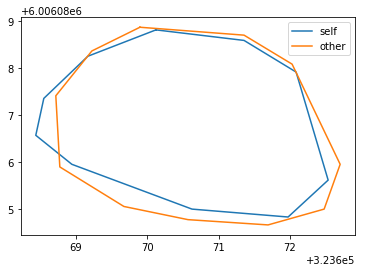

[[275 380]
 [274 381]
 [273 381]
 [272 381]
 [271 382]
 [270 382]
 [269 383]
 [268 383]
 [267 384]
 [266 385]
 [265 385]
 [264 386]
 [263 387]
 [262 388]
 [262 389]
 [261 390]
 [260 391]
 [260 392]
 [259 393]
 [259 394]
 [258 395]
 [258 396]
 [257 397]
 [257 398]
 [257 399]
 [257 400]
 [257 401]
 [256 402]
 [256 403]
 [256 404]
 [256 405]
 [256 406]
 [256 407]
 [256 408]
 [256 409]
 [256 410]
 [256 411]
 [256 412]
 [256 413]
 [256 414]
 [256 415]
 [256 416]
 [256 417]
 [256 418]
 [256 419]
 [256 420]
 [256 421]
 [256 422]
 [256 423]
 [256 424]
 [257 425]
 [257 426]
 [257 427]
 [257 428]
 [258 429]
 [258 430]
 [258 431]
 [258 432]
 [259 433]
 [259 434]
 [260 435]
 [260 436]
 [261 437]
 [262 438]
 [263 439]
 [263 440]
 [264 440]
 [265 441]
 [266 442]
 [267 442]
 [268 443]
 [269 443]
 [270 443]
 [271 444]
 [272 444]
 [273 444]
 [274 444]
 [275 444]
 [276 444]
 [277 444]
 [278 444]
 [279 444]
 [280 444]
 [281 444]
 [282 444]
 [283 444]
 [284 444]
 [285 444]
 [286 444]
 [287 445]
 [288 444]

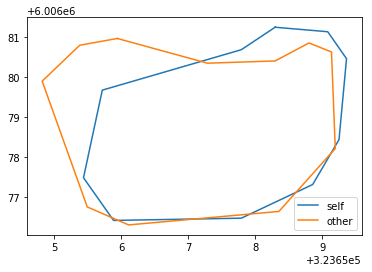

38it [01:01,  1.34s/it]

[[184  89]
 [183  90]
 [182  90]
 [181  90]
 [180  91]
 [179  91]
 [178  92]
 [177  92]
 [176  93]
 [175  93]
 [174  94]
 [173  94]
 [172  95]
 [171  95]
 [170  96]
 [169  96]
 [168  97]
 [167  97]
 [166  97]
 [165  98]
 [164  98]
 [163  99]
 [162  99]
 [161 100]
 [160 100]
 [160 101]
 [159 102]
 [159 103]
 [158 104]
 [158 105]
 [158 106]
 [158 107]
 [158 108]
 [158 109]
 [158 110]
 [158 111]
 [158 112]
 [158 113]
 [158 114]
 [158 115]
 [158 116]
 [158 117]
 [158 118]
 [158 119]
 [158 120]
 [159 121]
 [159 122]
 [158 123]
 [158 124]
 [159 125]
 [159 126]
 [159 127]
 [159 128]
 [159 129]
 [159 130]
 [160 131]
 [160 132]
 [160 133]
 [160 134]
 [161 135]
 [162 136]
 [162 137]
 [163 138]
 [164 139]
 [165 140]
 [166 140]
 [167 140]
 [168 141]
 [169 141]
 [170 141]
 [171 142]
 [172 142]
 [173 142]
 [174 142]
 [175 143]
 [176 143]
 [177 143]
 [178 143]
 [179 143]
 [180 143]
 [181 143]
 [182 143]
 [183 143]
 [184 143]
 [185 143]
 [186 143]
 [187 142]
 [188 142]
 [189 142]
 [190 142]
 [191 141]

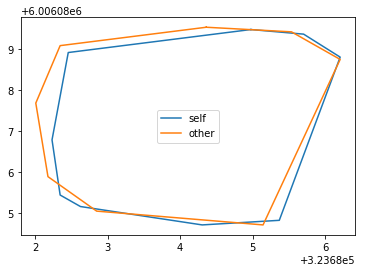

[[212 315]
 [211 316]
 [210 316]
 [209 316]
 [208 316]
 [207 316]
 [206 317]
 [205 317]
 [204 318]
 [203 318]
 [202 319]
 [201 320]
 [200 321]
 [199 322]
 [199 323]
 [198 324]
 [197 325]
 [196 326]
 [196 327]
 [195 328]
 [195 329]
 [194 330]
 [194 331]
 [193 332]
 [193 333]
 [192 334]
 [191 335]
 [191 336]
 [190 337]
 [190 338]
 [189 339]
 [188 340]
 [188 341]
 [187 342]
 [186 343]
 [186 344]
 [185 345]
 [184 346]
 [183 347]
 [182 348]
 [181 349]
 [180 350]
 [179 351]
 [178 352]
 [177 353]
 [176 354]
 [176 355]
 [175 356]
 [174 357]
 [173 358]
 [173 359]
 [173 360]
 [172 361]
 [172 362]
 [172 363]
 [172 364]
 [172 365]
 [172 366]
 [172 367]
 [172 368]
 [172 369]
 [172 370]
 [172 371]
 [172 372]
 [172 373]
 [172 374]
 [172 375]
 [173 376]
 [173 377]
 [173 378]
 [173 379]
 [174 380]
 [174 381]
 [175 382]
 [176 382]
 [177 383]
 [178 384]
 [179 384]
 [180 385]
 [181 385]
 [182 386]
 [183 387]
 [184 387]
 [185 388]
 [186 389]
 [187 390]
 [188 391]
 [189 392]
 [190 393]
 [191 394]
 [192 395]

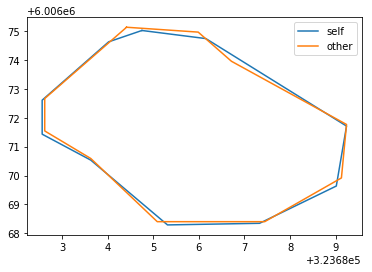

[[249  69]
 [248  70]
 [247  70]
 [246  71]
 [245  71]
 [244  72]
 [243  73]
 [242  73]
 [241  74]
 [240  75]
 [240  76]
 [239  77]
 [239  78]
 [238  79]
 [238  80]
 [237  81]
 [237  82]
 [236  83]
 [236  84]
 [235  85]
 [235  86]
 [235  87]
 [234  88]
 [234  89]
 [234  90]
 [234  91]
 [233  92]
 [233  93]
 [233  94]
 [232  95]
 [232  96]
 [232  97]
 [231  98]
 [231  99]
 [231 100]
 [231 101]
 [231 102]
 [230 103]
 [230 104]
 [230 105]
 [230 106]
 [229 107]
 [229 108]
 [229 109]
 [229 110]
 [229 111]
 [229 112]
 [228 113]
 [228 114]
 [228 115]
 [228 116]
 [228 117]
 [228 118]
 [228 119]
 [227 120]
 [227 121]
 [227 122]
 [227 123]
 [227 124]
 [227 125]
 [227 126]
 [226 127]
 [226 128]
 [226 129]
 [226 130]
 [226 131]
 [225 132]
 [225 133]
 [225 134]
 [225 135]
 [225 136]
 [225 137]
 [225 138]
 [225 139]
 [225 140]
 [225 141]
 [225 142]
 [225 143]
 [226 144]
 [226 145]
 [226 146]
 [226 147]
 [227 148]
 [227 149]
 [228 150]
 [228 151]
 [228 152]
 [229 153]
 [229 154]
 [229 155]
 [230 156]

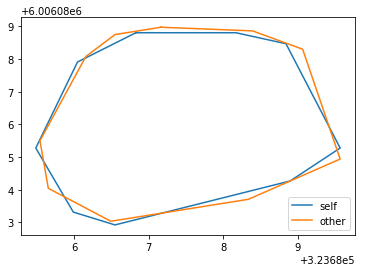

[[149  56]
 [148  57]
 [147  57]
 [146  57]
 [145  57]
 [144  57]
 [143  57]
 [142  58]
 [141  58]
 [140  58]
 [139  59]
 [138  59]
 [137  59]
 [136  60]
 [135  60]
 [134  61]
 [133  61]
 [132  61]
 [131  62]
 [130  63]
 [129  64]
 [128  64]
 [127  65]
 [126  66]
 [125  67]
 [124  68]
 [123  68]
 [122  69]
 [121  70]
 [120  71]
 [119  72]
 [118  73]
 [117  73]
 [116  73]
 [115  74]
 [114  75]
 [113  75]
 [112  76]
 [111  77]
 [111  78]
 [110  79]
 [110  80]
 [109  81]
 [109  82]
 [109  83]
 [108  84]
 [108  85]
 [108  86]
 [108  87]
 [108  88]
 [108  89]
 [107  90]
 [107  91]
 [107  92]
 [107  93]
 [106  94]
 [106  95]
 [106  96]
 [106  97]
 [106  98]
 [106  99]
 [106 100]
 [106 101]
 [106 102]
 [106 103]
 [106 104]
 [105 105]
 [105 106]
 [105 107]
 [105 108]
 [106 109]
 [106 110]
 [106 111]
 [106 112]
 [106 113]
 [106 114]
 [106 115]
 [106 116]
 [107 117]
 [107 118]
 [107 119]
 [108 120]
 [108 121]
 [109 122]
 [109 123]
 [110 124]
 [110 125]
 [111 126]
 [112 127]
 [113 128]
 [114 129]

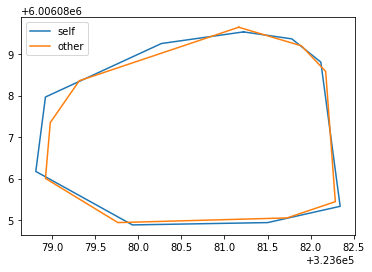

[[510  44]
 [509  45]
 [508  45]
 [507  46]
 [506  46]
 [505  46]
 [504  47]
 [503  47]
 [502  48]
 [501  49]
 [500  50]
 [499  50]
 [498  51]
 [497  51]
 [496  52]
 [495  53]
 [494  54]
 [493  54]
 [492  55]
 [491  55]
 [490  56]
 [490  57]
 [489  58]
 [488  59]
 [487  60]
 [486  61]
 [485  62]
 [484  63]
 [483  64]
 [483  65]
 [482  66]
 [482  67]
 [481  68]
 [481  69]
 [480  70]
 [480  71]
 [479  72]
 [479  73]
 [478  74]
 [477  75]
 [477  76]
 [477  77]
 [476  78]
 [476  79]
 [475  80]
 [475  81]
 [474  82]
 [473  83]
 [472  84]
 [472  85]
 [471  86]
 [471  87]
 [470  88]
 [470  89]
 [470  90]
 [469  91]
 [469  92]
 [469  93]
 [469  94]
 [469  95]
 [468  96]
 [468  97]
 [468  98]
 [468  99]
 [468 100]
 [468 101]
 [468 102]
 [468 103]
 [468 104]
 [468 105]
 [468 106]
 [469 107]
 [469 108]
 [469 109]
 [469 110]
 [469 111]
 [469 112]
 [470 113]
 [470 114]
 [470 115]
 [470 116]
 [471 117]
 [471 118]
 [471 119]
 [472 120]
 [472 121]
 [472 122]
 [473 123]
 [473 124]
 [474 125]
 [474 126]

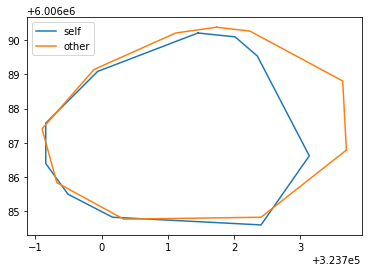

[[366  74]
 [365  75]
 [364  75]
 [363  76]
 [362  77]
 [361  77]
 [360  78]
 [360  79]
 [359  80]
 [359  81]
 [358  82]
 [358  83]
 [357  84]
 [357  85]
 [357  86]
 [357  87]
 [357  88]
 [357  89]
 [357  90]
 [356  91]
 [356  92]
 [356  93]
 [356  94]
 [356  95]
 [356  96]
 [357  97]
 [357  98]
 [357  99]
 [357 100]
 [357 101]
 [357 102]
 [357 103]
 [357 104]
 [357 105]
 [357 106]
 [357 107]
 [357 108]
 [357 109]
 [357 110]
 [357 111]
 [357 112]
 [358 113]
 [358 114]
 [358 115]
 [358 116]
 [359 117]
 [359 118]
 [360 119]
 [360 120]
 [361 120]
 [362 121]
 [363 121]
 [364 122]
 [365 123]
 [366 123]
 [367 123]
 [368 124]
 [369 124]
 [370 124]
 [371 125]
 [372 125]
 [373 125]
 [374 125]
 [375 125]
 [376 125]
 [377 125]
 [378 125]
 [379 125]
 [380 125]
 [381 125]
 [382 125]
 [383 125]
 [384 124]
 [385 124]
 [386 124]
 [387 123]
 [388 123]
 [389 123]
 [390 122]
 [391 121]
 [392 120]
 [393 119]
 [393 118]
 [394 117]
 [394 116]
 [395 115]
 [395 114]
 [395 113]
 [396 112]
 [396 111]
 [397 110]

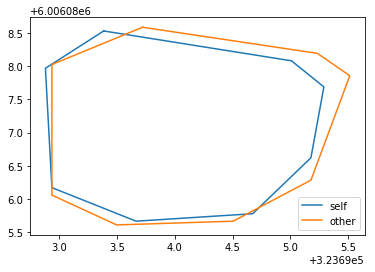

[[294  70]
 [293  71]
 [292  71]
 [291  71]
 [290  72]
 [289  73]
 [289  74]
 [288  75]
 [288  76]
 [288  77]
 [288  78]
 [288  79]
 [288  80]
 [288  81]
 [288  82]
 [288  83]
 [288  84]
 [288  85]
 [289  86]
 [289  87]
 [289  88]
 [290  89]
 [290  90]
 [290  91]
 [290  92]
 [290  93]
 [291  94]
 [291  95]
 [291  96]
 [291  97]
 [292  98]
 [292  99]
 [292 100]
 [292 101]
 [292 102]
 [293 103]
 [293 104]
 [293 105]
 [293 106]
 [293 107]
 [294 108]
 [294 109]
 [294 110]
 [294 111]
 [295 112]
 [295 113]
 [295 114]
 [295 115]
 [295 116]
 [296 117]
 [296 118]
 [296 119]
 [296 120]
 [297 121]
 [297 122]
 [297 123]
 [297 124]
 [298 125]
 [298 126]
 [299 127]
 [299 128]
 [300 129]
 [301 130]
 [301 131]
 [302 132]
 [303 132]
 [304 133]
 [305 133]
 [306 133]
 [307 134]
 [308 134]
 [309 134]
 [310 134]
 [311 134]
 [312 134]
 [313 134]
 [314 134]
 [315 134]
 [316 134]
 [317 134]
 [318 134]
 [319 134]
 [320 134]
 [321 134]
 [322 134]
 [323 134]
 [324 134]
 [325 134]
 [326 134]
 [327 134]
 [328 134]

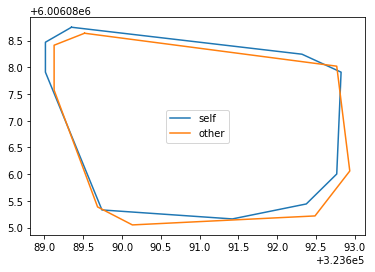

[[338 132]
 [337 133]
 [336 133]
 [335 133]
 [334 133]
 [333 133]
 [332 133]
 [331 133]
 [330 133]
 [329 134]
 [328 134]
 [327 134]
 [326 134]
 [325 134]
 [324 134]
 [323 134]
 [322 134]
 [321 134]
 [320 134]
 [319 134]
 [318 134]
 [317 134]
 [316 134]
 [315 135]
 [314 135]
 [313 135]
 [312 135]
 [311 135]
 [310 135]
 [309 135]
 [308 135]
 [307 135]
 [306 136]
 [305 136]
 [304 137]
 [303 138]
 [302 138]
 [301 139]
 [300 139]
 [299 140]
 [298 141]
 [297 142]
 [296 142]
 [295 143]
 [294 144]
 [293 144]
 [292 145]
 [291 145]
 [290 146]
 [289 146]
 [288 147]
 [287 148]
 [286 149]
 [285 150]
 [285 151]
 [284 152]
 [283 153]
 [283 154]
 [282 155]
 [282 156]
 [282 157]
 [281 158]
 [281 159]
 [281 160]
 [281 161]
 [281 162]
 [280 163]
 [280 164]
 [280 165]
 [280 166]
 [280 167]
 [280 168]
 [280 169]
 [280 170]
 [281 171]
 [281 172]
 [282 173]
 [282 174]
 [283 175]
 [283 176]
 [284 177]
 [285 178]
 [286 178]
 [287 179]
 [288 179]
 [289 180]
 [290 180]
 [291 181]
 [292 182]
 [293 182]
 [294 183]

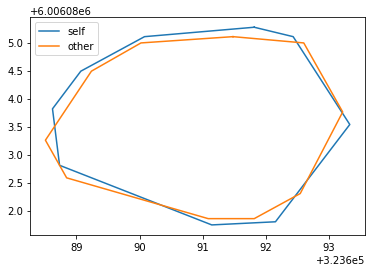

[[ 63  36]
 [ 62  37]
 [ 61  37]
 [ 60  37]
 [ 59  37]
 [ 58  37]
 [ 57  37]
 [ 56  37]
 [ 55  37]
 [ 54  37]
 [ 53  37]
 [ 52  37]
 [ 51  37]
 [ 50  37]
 [ 49  37]
 [ 48  37]
 [ 47  37]
 [ 46  37]
 [ 45  37]
 [ 44  37]
 [ 43  37]
 [ 42  37]
 [ 41  37]
 [ 40  37]
 [ 39  38]
 [ 38  38]
 [ 37  38]
 [ 36  38]
 [ 35  38]
 [ 34  39]
 [ 33  39]
 [ 32  40]
 [ 31  41]
 [ 30  42]
 [ 29  43]
 [ 28  44]
 [ 28  45]
 [ 27  46]
 [ 27  47]
 [ 26  48]
 [ 26  49]
 [ 26  50]
 [ 25  51]
 [ 25  52]
 [ 25  53]
 [ 25  54]
 [ 24  55]
 [ 24  56]
 [ 24  57]
 [ 24  58]
 [ 24  59]
 [ 24  60]
 [ 24  61]
 [ 24  62]
 [ 24  63]
 [ 24  64]
 [ 24  65]
 [ 24  66]
 [ 24  67]
 [ 25  68]
 [ 25  69]
 [ 25  70]
 [ 26  71]
 [ 26  72]
 [ 26  73]
 [ 26  74]
 [ 26  75]
 [ 27  76]
 [ 28  77]
 [ 29  78]
 [ 29  79]
 [ 30  80]
 [ 31  81]
 [ 31  82]
 [ 32  83]
 [ 32  84]
 [ 33  85]
 [ 34  86]
 [ 34  87]
 [ 35  88]
 [ 36  89]
 [ 36  90]
 [ 36  91]
 [ 37  92]
 [ 37  93]
 [ 37  94]
 [ 37  95]
 [ 38  96]
 [ 38  97]
 [ 38  98]
 [ 38  99]

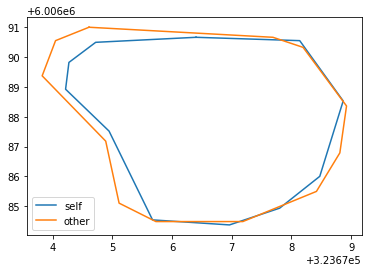

[[137 222]
 [136 223]
 [135 223]
 [134 223]
 [133 224]
 [132 224]
 [131 224]
 [130 225]
 [129 226]
 [128 227]
 [127 228]
 [126 228]
 [126 229]
 [125 230]
 [125 231]
 [124 232]
 [124 233]
 [123 234]
 [122 235]
 [122 236]
 [121 237]
 [121 238]
 [120 239]
 [120 240]
 [120 241]
 [120 242]
 [119 243]
 [119 244]
 [118 245]
 [118 246]
 [118 247]
 [117 248]
 [117 249]
 [116 250]
 [116 251]
 [116 252]
 [116 253]
 [115 254]
 [115 255]
 [115 256]
 [116 257]
 [116 258]
 [116 259]
 [117 260]
 [118 261]
 [119 261]
 [120 261]
 [121 262]
 [122 262]
 [123 263]
 [124 264]
 [125 264]
 [126 265]
 [127 266]
 [128 267]
 [129 268]
 [130 269]
 [131 270]
 [132 271]
 [133 271]
 [134 272]
 [135 273]
 [136 273]
 [137 274]
 [138 274]
 [139 275]
 [140 275]
 [141 276]
 [142 276]
 [143 276]
 [144 276]
 [145 277]
 [146 277]
 [147 277]
 [148 277]
 [149 277]
 [150 277]
 [151 277]
 [152 277]
 [153 277]
 [154 277]
 [155 277]
 [156 277]
 [157 278]
 [158 277]
 [159 277]
 [160 277]
 [161 277]
 [162 277]
 [163 277]
 [164 276]

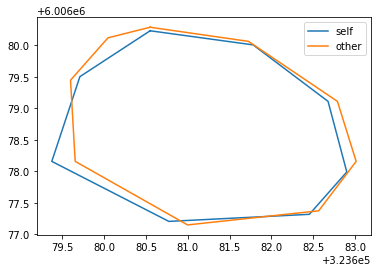

[[325  11]
 [324  12]
 [323  12]
 [322  12]
 [321  12]
 [320  12]
 [319  12]
 [318  12]
 [317  13]
 [316  13]
 [315  13]
 [314  14]
 [313  14]
 [312  14]
 [311  15]
 [310  16]
 [309  16]
 [308  17]
 [307  18]
 [306  19]
 [305  20]
 [304  21]
 [303  22]
 [302  23]
 [302  24]
 [301  25]
 [300  26]
 [299  27]
 [299  28]
 [298  29]
 [298  30]
 [297  31]
 [297  32]
 [296  33]
 [296  34]
 [296  35]
 [295  36]
 [295  37]
 [295  38]
 [294  39]
 [294  40]
 [294  41]
 [294  42]
 [293  43]
 [293  44]
 [293  45]
 [292  46]
 [292  47]
 [292  48]
 [292  49]
 [292  50]
 [291  51]
 [291  52]
 [291  53]
 [291  54]
 [291  55]
 [291  56]
 [291  57]
 [291  58]
 [291  59]
 [291  60]
 [291  61]
 [291  62]
 [291  63]
 [291  64]
 [291  65]
 [292  66]
 [293  67]
 [294  68]
 [295  69]
 [296  70]
 [297  71]
 [298  71]
 [299  71]
 [300  71]
 [301  71]
 [302  71]
 [303  71]
 [304  71]
 [305  72]
 [306  72]
 [307  72]
 [308  72]
 [309  72]
 [310  72]
 [311  72]
 [312  72]
 [313  72]
 [314  73]
 [315  73]
 [316  73]

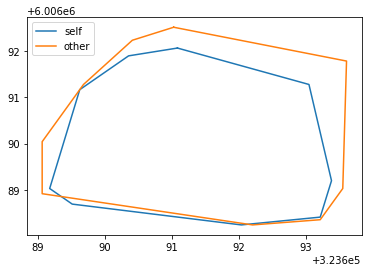

[[267 182]
 [266 183]
 [265 183]
 [264 183]
 [263 183]
 [262 183]
 [261 183]
 [260 184]
 [259 184]
 [258 184]
 [257 184]
 [256 184]
 [255 185]
 [254 185]
 [253 185]
 [252 185]
 [251 186]
 [250 186]
 [249 187]
 [248 187]
 [247 188]
 [246 188]
 [245 189]
 [245 190]
 [245 191]
 [244 192]
 [244 193]
 [244 194]
 [244 195]
 [244 196]
 [244 197]
 [244 198]
 [244 199]
 [244 200]
 [244 201]
 [245 202]
 [245 203]
 [245 204]
 [245 205]
 [246 206]
 [247 207]
 [248 208]
 [249 208]
 [250 208]
 [251 209]
 [252 210]
 [252 211]
 [253 212]
 [254 213]
 [255 214]
 [256 215]
 [257 216]
 [257 217]
 [257 218]
 [258 219]
 [258 220]
 [258 221]
 [258 222]
 [259 223]
 [259 224]
 [259 225]
 [259 226]
 [259 227]
 [259 228]
 [259 229]
 [259 230]
 [260 231]
 [260 232]
 [261 233]
 [261 234]
 [262 235]
 [262 236]
 [262 237]
 [263 238]
 [263 239]
 [264 240]
 [265 241]
 [266 242]
 [267 243]
 [268 244]
 [268 245]
 [269 246]
 [269 247]
 [270 248]
 [270 249]
 [271 250]
 [271 251]
 [271 252]
 [271 253]
 [272 254]
 [273 255]

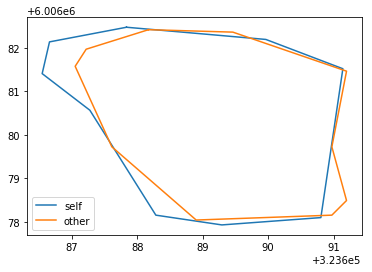

[[484  22]
 [483  23]
 [482  23]
 [481  23]
 [480  23]
 [479  23]
 [478  23]
 [477  23]
 [476  23]
 [475  24]
 [474  24]
 [473  24]
 [472  24]
 [471  24]
 [470  24]
 [469  25]
 [468  25]
 [467  25]
 [466  25]
 [465  25]
 [464  25]
 [463  25]
 [462  26]
 [461  26]
 [460  26]
 [459  26]
 [458  26]
 [457  26]
 [456  26]
 [455  26]
 [454  26]
 [453  26]
 [452  25]
 [451  25]
 [450  25]
 [449  25]
 [448  25]
 [447  25]
 [446  25]
 [445  25]
 [444  25]
 [443  25]
 [442  25]
 [441  25]
 [440  25]
 [439  25]
 [438  24]
 [437  24]
 [436  24]
 [435  24]
 [434  24]
 [433  24]
 [432  23]
 [431  23]
 [430  23]
 [429  23]
 [428  23]
 [427  24]
 [426  25]
 [426  26]
 [426  27]
 [426  28]
 [426  29]
 [426  30]
 [426  31]
 [426  32]
 [426  33]
 [426  34]
 [426  35]
 [426  36]
 [426  37]
 [426  38]
 [426  39]
 [426  40]
 [426  41]
 [426  42]
 [426  43]
 [426  44]
 [426  45]
 [426  46]
 [426  47]
 [426  48]
 [426  49]
 [426  50]
 [426  51]
 [426  52]
 [426  53]
 [426  54]
 [426  55]
 [427  56]
 [427  57]

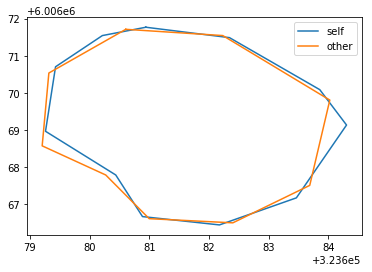

[[548 182]
 [547 183]
 [546 183]
 [545 183]
 [544 184]
 [543 184]
 [542 185]
 [542 186]
 [541 187]
 [541 188]
 [541 189]
 [541 190]
 [541 191]
 [541 192]
 [541 193]
 [541 194]
 [541 195]
 [541 196]
 [540 197]
 [540 198]
 [541 199]
 [541 200]
 [541 201]
 [541 202]
 [541 203]
 [541 204]
 [541 205]
 [541 206]
 [540 207]
 [541 208]
 [541 209]
 [540 210]
 [540 211]
 [540 212]
 [540 213]
 [540 214]
 [540 215]
 [540 216]
 [540 217]
 [540 218]
 [540 219]
 [540 220]
 [540 221]
 [540 222]
 [540 223]
 [539 224]
 [539 225]
 [539 226]
 [539 227]
 [539 228]
 [539 229]
 [539 230]
 [540 231]
 [540 232]
 [540 233]
 [540 234]
 [541 235]
 [541 236]
 [541 237]
 [542 238]
 [543 239]
 [544 240]
 [545 241]
 [546 241]
 [547 242]
 [548 242]
 [549 242]
 [550 242]
 [551 242]
 [552 242]
 [553 242]
 [554 242]
 [555 241]
 [556 241]
 [557 241]
 [558 241]
 [559 240]
 [560 240]
 [561 239]
 [562 239]
 [563 239]
 [564 238]
 [565 238]
 [566 237]
 [567 237]
 [568 237]
 [569 236]
 [570 236]
 [571 235]
 [572 235]
 [573 235]

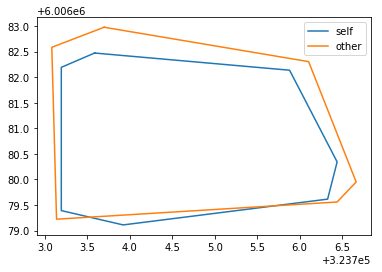

39it [01:03,  1.52s/it]

[[166 184]
 [165 185]
 [164 185]
 [163 185]
 [162 185]
 [161 185]
 [160 186]
 [159 186]
 [158 187]
 [157 187]
 [156 188]
 [155 189]
 [154 190]
 [153 191]
 [153 192]
 [153 193]
 [153 194]
 [152 195]
 [152 196]
 [152 197]
 [152 198]
 [152 199]
 [152 200]
 [151 201]
 [151 202]
 [151 203]
 [151 204]
 [151 205]
 [151 206]
 [151 207]
 [151 208]
 [151 209]
 [151 210]
 [151 211]
 [151 212]
 [151 213]
 [151 214]
 [151 215]
 [151 216]
 [151 217]
 [152 218]
 [152 219]
 [153 220]
 [153 221]
 [154 222]
 [154 223]
 [155 224]
 [156 225]
 [157 226]
 [158 227]
 [159 228]
 [160 229]
 [161 229]
 [162 230]
 [163 231]
 [164 232]
 [165 232]
 [166 233]
 [167 234]
 [168 235]
 [169 236]
 [170 237]
 [171 237]
 [172 238]
 [173 238]
 [174 239]
 [175 239]
 [176 240]
 [177 240]
 [178 241]
 [179 241]
 [180 242]
 [181 242]
 [182 242]
 [183 242]
 [184 242]
 [185 242]
 [186 242]
 [187 242]
 [188 241]
 [189 241]
 [190 240]
 [191 239]
 [192 238]
 [193 237]
 [194 236]
 [194 235]
 [195 234]
 [195 233]
 [196 232]
 [197 231]

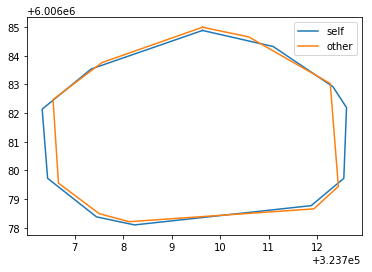

[[519 324]
 [518 325]
 [517 325]
 [516 326]
 [515 326]
 [514 327]
 [513 328]
 [512 329]
 [511 330]
 [510 331]
 [509 331]
 [508 332]
 [507 333]
 [506 334]
 [505 335]
 [504 335]
 [503 336]
 [502 337]
 [501 338]
 [500 338]
 [499 339]
 [498 340]
 [497 341]
 [496 342]
 [495 343]
 [494 344]
 [494 345]
 [493 346]
 [493 347]
 [492 348]
 [492 349]
 [492 350]
 [491 351]
 [491 352]
 [491 353]
 [491 354]
 [491 355]
 [491 356]
 [490 357]
 [490 358]
 [490 359]
 [490 360]
 [490 361]
 [490 362]
 [490 363]
 [490 364]
 [490 365]
 [490 366]
 [490 367]
 [490 368]
 [490 369]
 [490 370]
 [490 371]
 [490 372]
 [489 373]
 [489 374]
 [489 375]
 [490 376]
 [490 377]
 [490 378]
 [490 379]
 [490 380]
 [490 381]
 [490 382]
 [490 383]
 [490 384]
 [490 385]
 [490 386]
 [491 387]
 [491 388]
 [491 389]
 [492 390]
 [492 391]
 [492 392]
 [493 393]
 [493 394]
 [494 395]
 [494 396]
 [495 397]
 [496 398]
 [497 399]
 [498 400]
 [499 401]
 [500 402]
 [501 402]
 [502 403]
 [503 403]
 [504 403]
 [505 403]
 [506 403]
 [507 403]

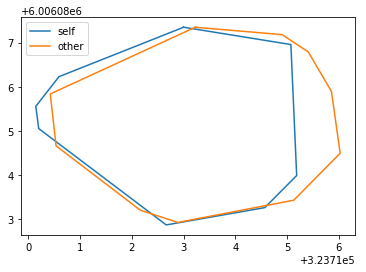

[[427 166]
 [426 167]
 [425 167]
 [424 167]
 [423 167]
 [422 167]
 [421 167]
 [420 168]
 [419 168]
 [418 168]
 [417 168]
 [416 169]
 [415 169]
 [414 169]
 [413 170]
 [412 170]
 [411 171]
 [410 171]
 [409 171]
 [408 172]
 [407 172]
 [406 172]
 [405 173]
 [404 173]
 [403 173]
 [402 174]
 [401 174]
 [400 175]
 [399 175]
 [398 176]
 [397 176]
 [396 176]
 [395 177]
 [394 178]
 [393 179]
 [392 180]
 [392 181]
 [391 182]
 [391 183]
 [390 184]
 [390 185]
 [389 186]
 [389 187]
 [389 188]
 [389 189]
 [389 190]
 [389 191]
 [389 192]
 [389 193]
 [389 194]
 [389 195]
 [389 196]
 [389 197]
 [389 198]
 [389 199]
 [389 200]
 [389 201]
 [389 202]
 [389 203]
 [389 204]
 [389 205]
 [389 206]
 [389 207]
 [389 208]
 [389 209]
 [389 210]
 [389 211]
 [389 212]
 [389 213]
 [389 214]
 [388 215]
 [388 216]
 [388 217]
 [388 218]
 [388 219]
 [388 220]
 [388 221]
 [388 222]
 [388 223]
 [389 224]
 [389 225]
 [389 226]
 [389 227]
 [389 228]
 [389 229]
 [389 230]
 [390 231]
 [391 232]
 [392 233]
 [393 233]
 [394 233]

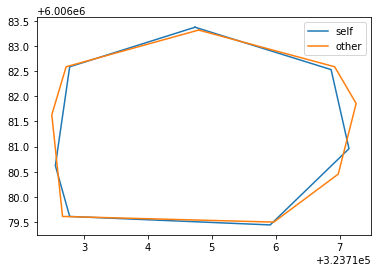

[[462 228]
 [461 229]
 [460 229]
 [459 229]
 [458 230]
 [457 230]
 [456 231]
 [455 232]
 [454 233]
 [453 233]
 [452 234]
 [451 235]
 [450 236]
 [449 237]
 [448 238]
 [448 239]
 [448 240]
 [448 241]
 [447 242]
 [447 243]
 [447 244]
 [446 245]
 [446 246]
 [445 247]
 [445 248]
 [445 249]
 [445 250]
 [444 251]
 [444 252]
 [443 253]
 [442 254]
 [442 255]
 [441 256]
 [440 257]
 [440 258]
 [439 259]
 [438 260]
 [437 260]
 [436 261]
 [435 262]
 [434 263]
 [433 264]
 [432 264]
 [431 265]
 [430 265]
 [429 266]
 [428 266]
 [427 267]
 [426 268]
 [425 268]
 [424 269]
 [423 270]
 [422 271]
 [421 272]
 [420 273]
 [419 274]
 [419 275]
 [418 276]
 [417 277]
 [417 278]
 [417 279]
 [417 280]
 [417 281]
 [416 282]
 [416 283]
 [416 284]
 [416 285]
 [416 286]
 [416 287]
 [416 288]
 [416 289]
 [416 290]
 [416 291]
 [416 292]
 [416 293]
 [416 294]
 [416 295]
 [416 296]
 [416 297]
 [416 298]
 [416 299]
 [416 300]
 [416 301]
 [416 302]
 [416 303]
 [416 304]
 [416 305]
 [416 306]
 [416 307]
 [416 308]
 [417 309]

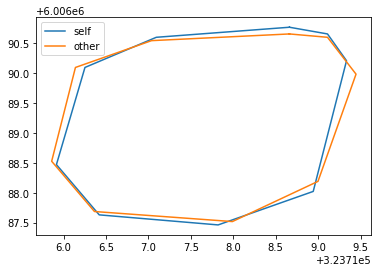

[[395 378]
 [394 379]
 [394 380]
 [393 381]
 [393 382]
 [393 383]
 [393 384]
 [393 385]
 [392 386]
 [391 387]
 [390 387]
 [389 388]
 [388 388]
 [387 388]
 [386 389]
 [386 390]
 [386 391]
 [386 392]
 [386 393]
 [385 394]
 [385 395]
 [385 396]
 [385 397]
 [385 398]
 [384 399]
 [383 400]
 [382 401]
 [382 402]
 [382 403]
 [382 404]
 [381 405]
 [380 406]
 [379 407]
 [378 406]
 [377 406]
 [376 406]
 [375 405]
 [374 406]
 [373 407]
 [373 408]
 [373 409]
 [373 410]
 [374 410]
 [375 411]
 [376 411]
 [377 412]
 [377 413]
 [378 414]
 [378 415]
 [379 416]
 [380 417]
 [380 418]
 [381 419]
 [381 420]
 [382 421]
 [382 422]
 [382 423]
 [383 423]
 [384 424]
 [384 425]
 [385 426]
 [385 427]
 [385 428]
 [386 429]
 [387 430]
 [388 431]
 [389 431]
 [390 432]
 [391 432]
 [392 433]
 [393 434]
 [394 434]
 [395 435]
 [396 435]
 [397 436]
 [398 436]
 [399 436]
 [400 437]
 [401 438]
 [402 438]
 [403 439]
 [404 439]
 [405 439]
 [406 439]
 [407 440]
 [408 440]
 [409 441]
 [410 442]
 [411 442]
 [412 443]
 [413 443]

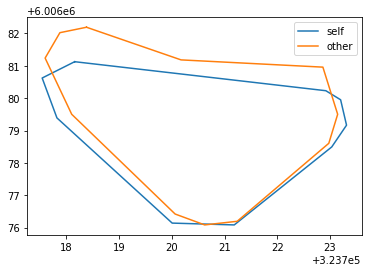

[[292  60]
 [291  61]
 [290  61]
 [289  61]
 [288  61]
 [287  61]
 [286  62]
 [285  62]
 [284  62]
 [283  62]
 [282  63]
 [281  63]
 [280  63]
 [279  63]
 [278  63]
 [277  63]
 [276  64]
 [275  64]
 [274  64]
 [273  64]
 [272  64]
 [271  64]
 [270  64]
 [269  64]
 [268  65]
 [267  65]
 [266  65]
 [265  65]
 [264  65]
 [263  66]
 [262  66]
 [261  66]
 [260  66]
 [259  67]
 [258  67]
 [257  68]
 [256  68]
 [255  69]
 [254  70]
 [253  70]
 [252  71]
 [252  72]
 [251  73]
 [250  74]
 [249  75]
 [249  76]
 [249  77]
 [248  78]
 [248  79]
 [247  80]
 [247  81]
 [247  82]
 [246  83]
 [246  84]
 [245  85]
 [245  86]
 [245  87]
 [245  88]
 [245  89]
 [245  90]
 [244  91]
 [244  92]
 [244  93]
 [244  94]
 [243  95]
 [243  96]
 [243  97]
 [243  98]
 [243  99]
 [243 100]
 [242 101]
 [242 102]
 [242 103]
 [242 104]
 [242 105]
 [242 106]
 [242 107]
 [242 108]
 [242 109]
 [242 110]
 [242 111]
 [243 112]
 [243 113]
 [243 114]
 [243 115]
 [244 116]
 [245 117]
 [246 118]
 [247 119]
 [248 120]
 [249 121]

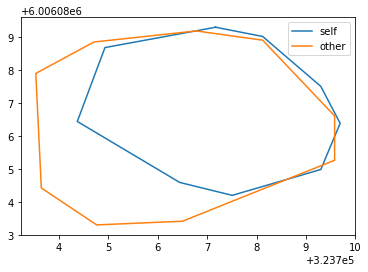

[[467  98]
 [466  99]
 [465  99]
 [464  99]
 [463  99]
 [462 100]
 [461 100]
 [460 101]
 [459 101]
 [458 101]
 [457 101]
 [457 102]
 [456 103]
 [455 104]
 [454 105]
 [453 105]
 [452 106]
 [451 106]
 [450 106]
 [449 107]
 [448 107]
 [447 107]
 [446 107]
 [445 108]
 [444 108]
 [443 108]
 [442 108]
 [441 108]
 [440 108]
 [439 109]
 [438 109]
 [437 110]
 [436 110]
 [435 111]
 [435 112]
 [435 113]
 [435 114]
 [434 115]
 [434 116]
 [434 117]
 [434 118]
 [434 119]
 [434 120]
 [434 121]
 [433 122]
 [433 123]
 [433 124]
 [433 125]
 [433 126]
 [433 127]
 [433 128]
 [433 129]
 [433 130]
 [433 131]
 [433 132]
 [433 133]
 [433 134]
 [433 135]
 [433 136]
 [434 137]
 [434 138]
 [434 139]
 [434 140]
 [434 141]
 [434 142]
 [434 143]
 [434 144]
 [434 145]
 [434 146]
 [434 147]
 [434 148]
 [434 149]
 [434 150]
 [434 151]
 [434 152]
 [434 153]
 [434 154]
 [434 155]
 [434 156]
 [434 157]
 [435 158]
 [435 159]
 [435 160]
 [435 161]
 [436 162]
 [436 163]
 [437 164]
 [437 165]
 [437 166]
 [438 167]
 [439 168]

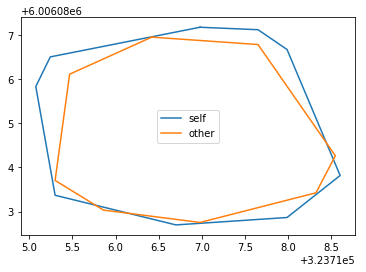

[[502  87]
 [501  88]
 [500  88]
 [499  89]
 [498  89]
 [497  90]
 [496  90]
 [495  91]
 [494  91]
 [493  92]
 [492  93]
 [491  94]
 [490  95]
 [489  96]
 [488  97]
 [488  98]
 [488  99]
 [488 100]
 [487 101]
 [487 102]
 [486 103]
 [486 104]
 [486 105]
 [486 106]
 [486 107]
 [486 108]
 [486 109]
 [487 110]
 [487 111]
 [487 112]
 [487 113]
 [487 114]
 [487 115]
 [487 116]
 [488 117]
 [488 118]
 [488 119]
 [488 120]
 [488 121]
 [488 122]
 [489 123]
 [489 124]
 [489 125]
 [489 126]
 [489 127]
 [489 128]
 [490 129]
 [490 130]
 [490 131]
 [491 132]
 [491 133]
 [491 134]
 [491 135]
 [492 136]
 [492 137]
 [492 138]
 [493 139]
 [493 140]
 [493 141]
 [493 142]
 [494 143]
 [494 144]
 [495 145]
 [495 146]
 [496 147]
 [496 148]
 [496 149]
 [497 150]
 [497 151]
 [497 152]
 [498 153]
 [498 154]
 [499 155]
 [500 156]
 [501 157]
 [502 158]
 [503 158]
 [504 158]
 [505 159]
 [506 159]
 [507 159]
 [508 159]
 [509 159]
 [510 159]
 [511 159]
 [512 159]
 [513 159]
 [514 158]
 [515 158]
 [516 158]
 [517 158]

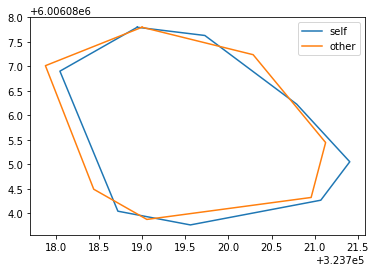

[[535 151]
 [534 152]
 [533 152]
 [532 152]
 [531 153]
 [530 153]
 [529 153]
 [528 154]
 [527 154]
 [526 154]
 [525 155]
 [524 155]
 [523 155]
 [522 156]
 [521 156]
 [520 157]
 [519 157]
 [518 157]
 [517 158]
 [516 158]
 [515 159]
 [514 159]
 [513 160]
 [512 161]
 [511 162]
 [510 162]
 [509 163]
 [508 163]
 [507 164]
 [506 164]
 [505 165]
 [504 165]
 [503 166]
 [502 166]
 [501 167]
 [500 167]
 [499 168]
 [498 169]
 [497 169]
 [496 170]
 [495 170]
 [494 171]
 [493 171]
 [492 172]
 [491 173]
 [490 174]
 [489 175]
 [489 176]
 [488 177]
 [488 178]
 [487 179]
 [487 180]
 [487 181]
 [486 182]
 [486 183]
 [486 184]
 [486 185]
 [486 186]
 [486 187]
 [486 188]
 [486 189]
 [486 190]
 [486 191]
 [486 192]
 [486 193]
 [486 194]
 [486 195]
 [486 196]
 [486 197]
 [486 198]
 [487 199]
 [488 200]
 [488 201]
 [489 202]
 [490 203]
 [491 203]
 [492 203]
 [493 204]
 [494 204]
 [495 204]
 [496 204]
 [497 204]
 [498 204]
 [499 204]
 [500 204]
 [501 204]
 [502 204]
 [503 204]
 [504 204]
 [505 205]
 [506 205]

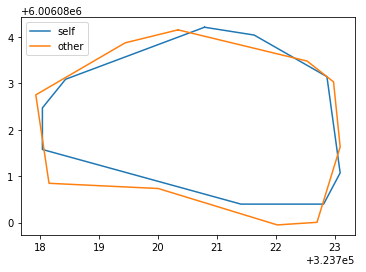

[[ 46  73]
 [ 45  74]
 [ 44  75]
 [ 43  75]
 [ 42  76]
 [ 41  77]
 [ 40  78]
 [ 39  79]
 [ 39  80]
 [ 38  81]
 [ 38  82]
 [ 37  83]
 [ 37  84]
 [ 36  85]
 [ 36  86]
 [ 36  87]
 [ 36  88]
 [ 35  89]
 [ 35  90]
 [ 35  91]
 [ 35  92]
 [ 35  93]
 [ 35  94]
 [ 35  95]
 [ 35  96]
 [ 35  97]
 [ 35  98]
 [ 35  99]
 [ 35 100]
 [ 35 101]
 [ 35 102]
 [ 35 103]
 [ 35 104]
 [ 35 105]
 [ 35 106]
 [ 35 107]
 [ 35 108]
 [ 35 109]
 [ 35 110]
 [ 35 111]
 [ 35 112]
 [ 35 113]
 [ 35 114]
 [ 35 115]
 [ 35 116]
 [ 35 117]
 [ 36 118]
 [ 36 119]
 [ 37 120]
 [ 37 121]
 [ 38 122]
 [ 39 122]
 [ 40 122]
 [ 41 123]
 [ 42 123]
 [ 43 123]
 [ 44 123]
 [ 45 123]
 [ 46 124]
 [ 47 124]
 [ 48 124]
 [ 49 124]
 [ 50 124]
 [ 51 125]
 [ 52 125]
 [ 53 125]
 [ 54 125]
 [ 55 125]
 [ 56 125]
 [ 57 125]
 [ 58 125]
 [ 59 125]
 [ 60 125]
 [ 61 125]
 [ 62 125]
 [ 63 125]
 [ 64 124]
 [ 65 124]
 [ 66 124]
 [ 67 123]
 [ 68 123]
 [ 69 122]
 [ 70 121]
 [ 71 121]
 [ 72 120]
 [ 72 119]
 [ 73 118]
 [ 73 117]
 [ 74 116]
 [ 75 115]
 [ 75 114]

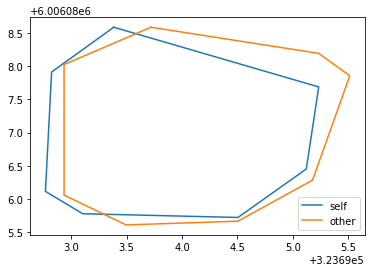

[[192  43]
 [191  44]
 [190  44]
 [189  44]
 [188  45]
 [187  45]
 [186  46]
 [185  46]
 [184  46]
 [183  46]
 [182  47]
 [181  48]
 [180  48]
 [179  48]
 [178  49]
 [177  49]
 [176  50]
 [175  51]
 [174  51]
 [173  52]
 [172  52]
 [171  53]
 [170  54]
 [169  55]
 [168  56]
 [167  57]
 [166  58]
 [165  59]
 [164  60]
 [163  61]
 [163  62]
 [162  63]
 [162  64]
 [161  65]
 [161  66]
 [160  67]
 [160  68]
 [159  69]
 [159  70]
 [158  71]
 [158  72]
 [157  73]
 [157  74]
 [156  75]
 [156  76]
 [156  77]
 [155  78]
 [155  79]
 [155  80]
 [154  81]
 [153  82]
 [152  83]
 [152  84]
 [151  85]
 [150  86]
 [150  87]
 [150  88]
 [149  89]
 [149  90]
 [148  91]
 [148  92]
 [148  93]
 [148  94]
 [147  95]
 [147  96]
 [147  97]
 [147  98]
 [147  99]
 [147 100]
 [147 101]
 [147 102]
 [147 103]
 [147 104]
 [147 105]
 [147 106]
 [147 107]
 [148 108]
 [148 109]
 [148 110]
 [148 111]
 [149 112]
 [149 113]
 [149 114]
 [150 115]
 [150 116]
 [151 117]
 [151 118]
 [152 119]
 [152 120]
 [153 121]
 [153 122]

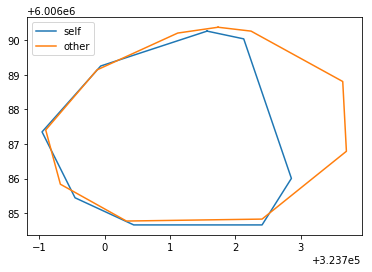

[[378 370]
 [377 371]
 [376 371]
 [375 371]
 [374 371]
 [373 372]
 [372 372]
 [371 372]
 [370 373]
 [369 373]
 [368 374]
 [367 374]
 [366 375]
 [365 375]
 [364 376]
 [363 376]
 [362 377]
 [361 378]
 [360 379]
 [359 379]
 [358 380]
 [357 381]
 [356 382]
 [356 383]
 [355 384]
 [354 385]
 [354 386]
 [353 387]
 [352 388]
 [352 389]
 [352 390]
 [351 391]
 [351 392]
 [351 393]
 [351 394]
 [350 395]
 [350 396]
 [350 397]
 [350 398]
 [350 399]
 [350 400]
 [350 401]
 [350 402]
 [350 403]
 [350 404]
 [350 405]
 [350 406]
 [350 407]
 [350 408]
 [350 409]
 [350 410]
 [350 411]
 [350 412]
 [350 413]
 [350 414]
 [350 415]
 [349 416]
 [349 417]
 [349 418]
 [349 419]
 [349 420]
 [349 421]
 [349 422]
 [349 423]
 [350 424]
 [350 425]
 [350 426]
 [350 427]
 [350 428]
 [351 429]
 [352 429]
 [353 430]
 [354 431]
 [355 432]
 [356 433]
 [357 433]
 [358 433]
 [359 433]
 [360 434]
 [361 434]
 [362 434]
 [363 434]
 [364 434]
 [365 434]
 [366 435]
 [367 435]
 [368 435]
 [369 435]
 [370 435]
 [371 435]
 [372 435]

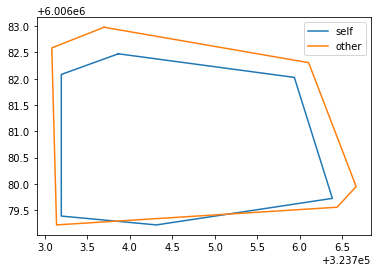

[[461 427]
 [460 428]
 [459 428]
 [458 429]
 [457 430]
 [456 431]
 [455 432]
 [454 433]
 [453 434]
 [452 435]
 [451 436]
 [450 437]
 [450 438]
 [449 439]
 [448 440]
 [447 441]
 [446 442]
 [445 443]
 [444 444]
 [443 445]
 [443 446]
 [442 447]
 [441 448]
 [440 449]
 [440 450]
 [439 451]
 [439 452]
 [438 453]
 [438 454]
 [437 455]
 [437 456]
 [437 457]
 [437 458]
 [436 459]
 [436 460]
 [436 461]
 [436 462]
 [436 463]
 [436 464]
 [436 465]
 [436 466]
 [436 467]
 [436 468]
 [436 469]
 [436 470]
 [436 471]
 [436 472]
 [436 473]
 [436 474]
 [436 475]
 [437 476]
 [437 477]
 [437 478]
 [437 479]
 [437 480]
 [437 481]
 [437 482]
 [438 483]
 [438 484]
 [438 485]
 [438 486]
 [439 487]
 [439 488]
 [439 489]
 [440 490]
 [440 491]
 [441 492]
 [441 493]
 [442 494]
 [443 495]
 [444 496]
 [445 496]
 [446 497]
 [447 498]
 [448 498]
 [449 498]
 [450 499]
 [451 499]
 [452 499]
 [453 500]
 [454 500]
 [455 500]
 [456 500]
 [457 500]
 [458 500]
 [459 501]
 [460 501]
 [461 501]
 [462 501]
 [463 501]
 [464 500]

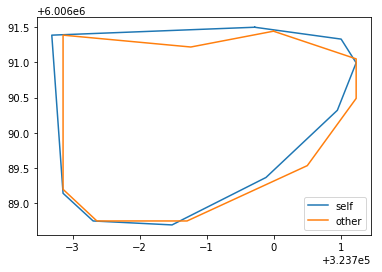

40it [01:05,  1.63s/it]

[[238 120]
 [237 121]
 [236 121]
 [235 121]
 [234 122]
 [233 122]
 [232 123]
 [231 123]
 [230 124]
 [229 125]
 [228 126]
 [227 127]
 [226 128]
 [225 129]
 [224 130]
 [224 131]
 [223 132]
 [223 133]
 [222 134]
 [221 135]
 [220 136]
 [220 137]
 [220 138]
 [219 139]
 [218 140]
 [218 141]
 [217 142]
 [217 143]
 [217 144]
 [216 145]
 [216 146]
 [216 147]
 [215 148]
 [215 149]
 [215 150]
 [214 151]
 [214 152]
 [214 153]
 [214 154]
 [214 155]
 [214 156]
 [214 157]
 [214 158]
 [214 159]
 [214 160]
 [214 161]
 [214 162]
 [214 163]
 [214 164]
 [214 165]
 [214 166]
 [214 167]
 [214 168]
 [215 169]
 [215 170]
 [215 171]
 [216 172]
 [216 173]
 [216 174]
 [217 175]
 [217 176]
 [218 177]
 [218 178]
 [219 179]
 [220 180]
 [221 180]
 [222 181]
 [223 182]
 [224 182]
 [225 182]
 [226 182]
 [227 183]
 [228 183]
 [229 183]
 [230 183]
 [231 183]
 [232 184]
 [233 184]
 [234 184]
 [235 184]
 [236 185]
 [237 185]
 [238 185]
 [239 185]
 [240 185]
 [241 185]
 [242 185]
 [243 185]
 [244 185]
 [245 186]
 [246 186]

[[349 139]
 [348 140]
 [347 140]
 [346 140]
 [345 140]
 [344 141]
 [343 141]
 [342 141]
 [341 142]
 [340 142]
 [339 143]
 [338 143]
 [337 144]
 [336 145]
 [335 145]
 [334 146]
 [333 146]
 [332 147]
 [331 147]
 [330 148]
 [330 149]
 [329 150]
 [328 151]
 [327 151]
 [327 152]
 [326 153]
 [325 154]
 [325 155]
 [324 156]
 [323 157]
 [323 158]
 [322 159]
 [322 160]
 [321 161]
 [321 162]
 [320 163]
 [320 164]
 [320 165]
 [319 166]
 [319 167]
 [319 168]
 [319 169]
 [318 170]
 [318 171]
 [318 172]
 [318 173]
 [318 174]
 [317 175]
 [317 176]
 [317 177]
 [317 178]
 [317 179]
 [317 180]
 [317 181]
 [317 182]
 [317 183]
 [317 184]
 [318 185]
 [318 186]
 [318 187]
 [319 188]
 [319 189]
 [319 190]
 [320 191]
 [320 192]
 [321 193]
 [321 194]
 [322 195]
 [322 196]
 [322 197]
 [322 198]
 [322 199]
 [323 200]
 [323 201]
 [323 202]
 [323 203]
 [323 204]
 [324 205]
 [324 206]
 [324 207]
 [324 208]
 [324 209]
 [324 210]
 [324 211]
 [325 212]
 [325 213]
 [325 214]
 [325 215]
 [325 216]
 [325 217]
 [326 218]

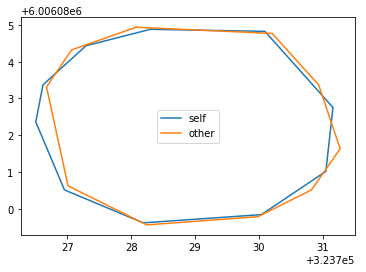

[[433 211]
 [432 212]
 [431 212]
 [430 212]
 [429 212]
 [428 213]
 [427 213]
 [426 214]
 [425 214]
 [424 215]
 [423 215]
 [422 216]
 [421 217]
 [420 217]
 [419 218]
 [418 219]
 [417 220]
 [416 221]
 [415 222]
 [414 223]
 [414 224]
 [413 225]
 [412 226]
 [411 227]
 [411 228]
 [410 229]
 [409 230]
 [409 231]
 [408 232]
 [408 233]
 [407 234]
 [407 235]
 [407 236]
 [406 237]
 [406 238]
 [406 239]
 [405 240]
 [405 241]
 [404 242]
 [404 243]
 [404 244]
 [404 245]
 [403 246]
 [403 247]
 [403 248]
 [402 249]
 [402 250]
 [402 251]
 [402 252]
 [401 253]
 [401 254]
 [400 255]
 [400 256]
 [400 257]
 [399 258]
 [399 259]
 [398 260]
 [398 261]
 [397 262]
 [397 263]
 [396 264]
 [396 265]
 [395 266]
 [395 267]
 [394 268]
 [394 269]
 [393 270]
 [392 271]
 [391 272]
 [390 273]
 [390 274]
 [389 275]
 [388 276]
 [388 277]
 [387 278]
 [386 279]
 [385 280]
 [384 281]
 [383 282]
 [382 283]
 [382 284]
 [381 285]
 [380 286]
 [380 287]
 [379 288]
 [378 289]
 [378 290]
 [378 291]
 [377 292]
 [377 293]
 [377 294]

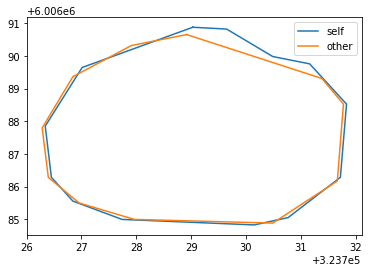

[[556 275]
 [555 276]
 [554 276]
 [553 276]
 [552 276]
 [551 276]
 [550 277]
 [549 277]
 [548 277]
 [547 278]
 [546 278]
 [545 278]
 [544 279]
 [543 279]
 [542 279]
 [541 279]
 [540 279]
 [539 279]
 [538 279]
 [537 279]
 [536 279]
 [535 279]
 [534 280]
 [533 280]
 [532 280]
 [531 280]
 [530 279]
 [529 279]
 [528 279]
 [527 279]
 [526 279]
 [525 279]
 [524 280]
 [523 280]
 [522 280]
 [521 280]
 [520 280]
 [519 279]
 [518 280]
 [517 280]
 [516 281]
 [515 282]
 [514 282]
 [513 282]
 [512 283]
 [511 283]
 [510 284]
 [509 285]
 [508 286]
 [508 287]
 [507 288]
 [507 289]
 [506 290]
 [506 291]
 [505 292]
 [504 293]
 [504 294]
 [503 295]
 [502 296]
 [501 297]
 [501 298]
 [500 299]
 [500 300]
 [499 301]
 [498 302]
 [498 303]
 [497 304]
 [496 305]
 [496 306]
 [495 307]
 [494 308]
 [493 309]
 [493 310]
 [492 311]
 [492 312]
 [491 313]
 [491 314]
 [490 315]
 [490 316]
 [489 317]
 [489 318]
 [489 319]
 [489 320]
 [488 321]
 [488 322]
 [488 323]
 [488 324]
 [488 325]
 [488 326]
 [488 327]
 [488 328]

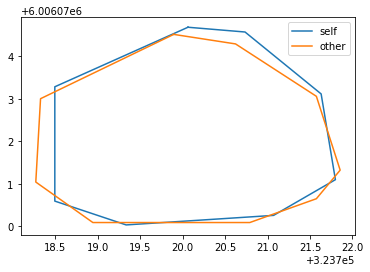

[[102 379]
 [101 380]
 [100 380]
 [ 99 380]
 [ 98 380]
 [ 97 380]
 [ 96 380]
 [ 95 380]
 [ 94 380]
 [ 93 381]
 [ 92 381]
 [ 91 381]
 [ 90 381]
 [ 89 381]
 [ 88 381]
 [ 87 381]
 [ 86 381]
 [ 85 381]
 [ 84 382]
 [ 83 382]
 [ 82 382]
 [ 81 382]
 [ 80 383]
 [ 79 384]
 [ 78 385]
 [ 77 386]
 [ 77 387]
 [ 77 388]
 [ 76 389]
 [ 76 390]
 [ 76 391]
 [ 75 392]
 [ 75 393]
 [ 75 394]
 [ 75 395]
 [ 74 396]
 [ 74 397]
 [ 74 398]
 [ 74 399]
 [ 73 400]
 [ 73 401]
 [ 73 402]
 [ 73 403]
 [ 73 404]
 [ 73 405]
 [ 72 406]
 [ 72 407]
 [ 72 408]
 [ 72 409]
 [ 72 410]
 [ 72 411]
 [ 72 412]
 [ 72 413]
 [ 71 414]
 [ 71 415]
 [ 71 416]
 [ 71 417]
 [ 71 418]
 [ 71 419]
 [ 71 420]
 [ 71 421]
 [ 71 422]
 [ 71 423]
 [ 71 424]
 [ 71 425]
 [ 72 426]
 [ 72 427]
 [ 73 428]
 [ 73 429]
 [ 73 430]
 [ 74 431]
 [ 75 432]
 [ 76 433]
 [ 77 433]
 [ 78 434]
 [ 79 434]
 [ 80 435]
 [ 81 435]
 [ 82 436]
 [ 83 436]
 [ 84 436]
 [ 85 437]
 [ 86 437]
 [ 87 437]
 [ 88 438]
 [ 89 438]
 [ 90 439]
 [ 91 439]
 [ 92 440]
 [ 93 440]
 [ 94 441]

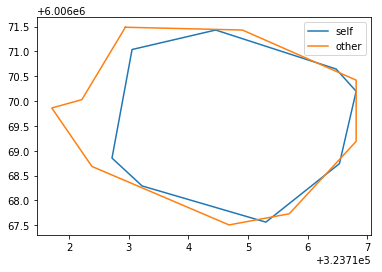

[[150  36]
 [149  37]
 [148  37]
 [147  37]
 [146  38]
 [145  39]
 [144  39]
 [143  40]
 [142  40]
 [141  41]
 [140  41]
 [139  42]
 [138  42]
 [137  43]
 [136  44]
 [135  44]
 [134  45]
 [133  45]
 [132  46]
 [132  47]
 [131  48]
 [131  49]
 [130  50]
 [130  51]
 [129  52]
 [129  53]
 [129  54]
 [128  55]
 [128  56]
 [128  57]
 [128  58]
 [127  59]
 [127  60]
 [127  61]
 [127  62]
 [127  63]
 [127  64]
 [127  65]
 [127  66]
 [127  67]
 [127  68]
 [127  69]
 [127  70]
 [127  71]
 [127  72]
 [127  73]
 [128  74]
 [128  75]
 [128  76]
 [129  77]
 [129  78]
 [129  79]
 [130  80]
 [130  81]
 [131  82]
 [131  83]
 [132  84]
 [133  85]
 [134  86]
 [134  87]
 [135  88]
 [136  89]
 [137  90]
 [138  90]
 [139  91]
 [140  91]
 [141  91]
 [142  92]
 [143  92]
 [144  92]
 [145  92]
 [146  92]
 [147  92]
 [148  92]
 [149  93]
 [150  93]
 [151  93]
 [152  93]
 [153  93]
 [154  93]
 [155  93]
 [156  93]
 [157  93]
 [158  93]
 [159  93]
 [160  93]
 [161  93]
 [162  93]
 [163  92]
 [164  92]
 [165  92]

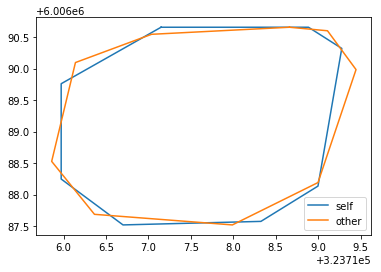

[[481 115]
 [480 116]
 [479 116]
 [478 116]
 [477 116]
 [476 116]
 [475 116]
 [474 117]
 [473 117]
 [472 117]
 [471 118]
 [470 118]
 [469 118]
 [468 119]
 [467 119]
 [466 119]
 [465 120]
 [464 120]
 [463 121]
 [462 121]
 [461 122]
 [460 123]
 [459 124]
 [458 125]
 [458 126]
 [457 127]
 [457 128]
 [456 129]
 [456 130]
 [456 131]
 [456 132]
 [456 133]
 [456 134]
 [455 135]
 [455 136]
 [455 137]
 [455 138]
 [455 139]
 [455 140]
 [455 141]
 [455 142]
 [455 143]
 [455 144]
 [456 145]
 [456 146]
 [456 147]
 [456 148]
 [456 149]
 [456 150]
 [456 151]
 [457 152]
 [457 153]
 [457 154]
 [457 155]
 [458 156]
 [458 157]
 [458 158]
 [459 159]
 [459 160]
 [460 161]
 [460 162]
 [461 163]
 [461 164]
 [462 165]
 [463 166]
 [464 166]
 [465 167]
 [466 168]
 [467 168]
 [468 169]
 [469 169]
 [470 169]
 [471 169]
 [472 170]
 [473 170]
 [474 170]
 [475 170]
 [476 170]
 [477 170]
 [478 170]
 [479 170]
 [480 169]
 [481 169]
 [482 169]
 [483 169]
 [484 169]
 [485 169]
 [486 169]
 [487 169]
 [488 169]
 [489 168]

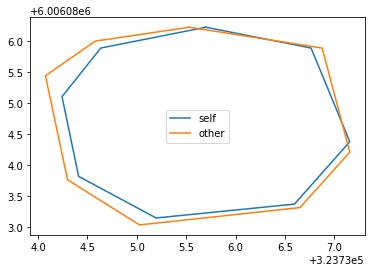

[[ 76  95]
 [ 75  96]
 [ 74  96]
 [ 73  96]
 [ 72  96]
 [ 71  97]
 [ 70  97]
 [ 69  98]
 [ 68  98]
 [ 67  99]
 [ 66 100]
 [ 65 101]
 [ 64 101]
 [ 63 102]
 [ 62 103]
 [ 61 104]
 [ 60 105]
 [ 59 106]
 [ 58 106]
 [ 57 107]
 [ 56 107]
 [ 55 108]
 [ 54 108]
 [ 53 108]
 [ 52 109]
 [ 51 109]
 [ 50 110]
 [ 49 110]
 [ 48 110]
 [ 47 111]
 [ 46 111]
 [ 45 111]
 [ 44 112]
 [ 43 112]
 [ 42 112]
 [ 41 113]
 [ 40 113]
 [ 39 114]
 [ 38 114]
 [ 37 115]
 [ 36 115]
 [ 35 116]
 [ 34 117]
 [ 33 118]
 [ 32 119]
 [ 32 120]
 [ 31 121]
 [ 31 122]
 [ 30 123]
 [ 30 124]
 [ 30 125]
 [ 30 126]
 [ 30 127]
 [ 30 128]
 [ 30 129]
 [ 29 130]
 [ 29 131]
 [ 29 132]
 [ 29 133]
 [ 29 134]
 [ 29 135]
 [ 30 136]
 [ 30 137]
 [ 30 138]
 [ 30 139]
 [ 31 140]
 [ 31 141]
 [ 32 142]
 [ 33 143]
 [ 33 144]
 [ 34 144]
 [ 35 145]
 [ 36 145]
 [ 37 146]
 [ 38 147]
 [ 39 147]
 [ 40 148]
 [ 41 149]
 [ 42 150]
 [ 43 151]
 [ 44 152]
 [ 45 153]
 [ 46 154]
 [ 47 155]
 [ 48 156]
 [ 49 157]
 [ 50 158]
 [ 51 158]
 [ 52 159]
 [ 53 160]
 [ 54 161]

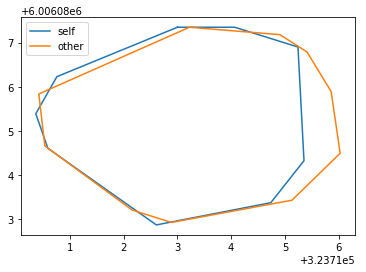

[[140 229]
 [139 230]
 [138 230]
 [137 230]
 [136 231]
 [135 231]
 [134 232]
 [133 233]
 [132 233]
 [131 234]
 [130 235]
 [129 236]
 [129 237]
 [128 238]
 [127 239]
 [127 240]
 [127 241]
 [127 242]
 [127 243]
 [127 244]
 [126 245]
 [126 246]
 [126 247]
 [125 248]
 [125 249]
 [125 250]
 [125 251]
 [124 252]
 [124 253]
 [123 254]
 [122 255]
 [121 256]
 [120 257]
 [120 258]
 [119 259]
 [118 260]
 [117 261]
 [116 262]
 [115 263]
 [114 263]
 [113 264]
 [112 264]
 [111 265]
 [110 265]
 [109 266]
 [108 267]
 [107 267]
 [106 268]
 [105 269]
 [104 269]
 [103 270]
 [102 271]
 [101 272]
 [100 273]
 [ 99 274]
 [ 98 275]
 [ 98 276]
 [ 98 277]
 [ 98 278]
 [ 97 279]
 [ 97 280]
 [ 97 281]
 [ 97 282]
 [ 97 283]
 [ 97 284]
 [ 97 285]
 [ 97 286]
 [ 97 287]
 [ 97 288]
 [ 97 289]
 [ 97 290]
 [ 97 291]
 [ 97 292]
 [ 97 293]
 [ 97 294]
 [ 97 295]
 [ 97 296]
 [ 97 297]
 [ 97 298]
 [ 97 299]
 [ 97 300]
 [ 97 301]
 [ 97 302]
 [ 97 303]
 [ 97 304]
 [ 97 305]
 [ 97 306]
 [ 97 307]
 [ 97 308]
 [ 97 309]
 [ 97 310]

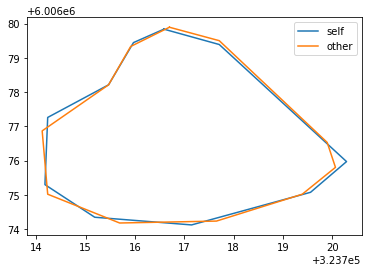

[[103 166]
 [102 167]
 [101 167]
 [100 167]
 [ 99 168]
 [ 98 168]
 [ 97 168]
 [ 96 168]
 [ 95 169]
 [ 94 169]
 [ 93 170]
 [ 92 170]
 [ 91 171]
 [ 90 171]
 [ 89 171]
 [ 88 172]
 [ 87 172]
 [ 86 172]
 [ 85 173]
 [ 84 173]
 [ 83 174]
 [ 82 174]
 [ 81 174]
 [ 80 175]
 [ 79 175]
 [ 78 176]
 [ 77 176]
 [ 76 177]
 [ 75 177]
 [ 74 178]
 [ 73 179]
 [ 72 180]
 [ 72 181]
 [ 71 182]
 [ 71 183]
 [ 70 184]
 [ 70 185]
 [ 69 186]
 [ 69 187]
 [ 69 188]
 [ 69 189]
 [ 69 190]
 [ 69 191]
 [ 69 192]
 [ 69 193]
 [ 69 194]
 [ 69 195]
 [ 69 196]
 [ 69 197]
 [ 69 198]
 [ 69 199]
 [ 69 200]
 [ 69 201]
 [ 69 202]
 [ 69 203]
 [ 68 204]
 [ 68 205]
 [ 68 206]
 [ 68 207]
 [ 68 208]
 [ 68 209]
 [ 68 210]
 [ 68 211]
 [ 68 212]
 [ 68 213]
 [ 68 214]
 [ 68 215]
 [ 68 216]
 [ 68 217]
 [ 68 218]
 [ 68 219]
 [ 68 220]
 [ 68 221]
 [ 68 222]
 [ 69 223]
 [ 69 224]
 [ 69 225]
 [ 69 226]
 [ 69 227]
 [ 70 228]
 [ 71 229]
 [ 72 229]
 [ 73 229]
 [ 74 229]
 [ 75 229]
 [ 76 230]
 [ 77 230]
 [ 78 230]
 [ 79 230]
 [ 80 230]
 [ 81 230]

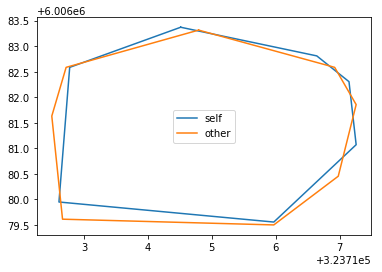

[[169 204]
 [168 205]
 [167 205]
 [166 205]
 [165 206]
 [164 206]
 [163 207]
 [162 207]
 [162 208]
 [161 209]
 [161 210]
 [160 211]
 [159 212]
 [159 213]
 [158 214]
 [158 215]
 [157 216]
 [157 217]
 [156 218]
 [156 219]
 [156 220]
 [155 221]
 [155 222]
 [155 223]
 [156 224]
 [157 225]
 [158 226]
 [158 227]
 [158 228]
 [158 229]
 [159 230]
 [159 231]
 [159 232]
 [159 233]
 [160 234]
 [160 235]
 [161 236]
 [161 237]
 [162 238]
 [162 239]
 [163 240]
 [163 241]
 [164 242]
 [165 243]
 [166 244]
 [167 245]
 [168 246]
 [168 247]
 [169 248]
 [170 249]
 [171 250]
 [172 251]
 [173 252]
 [174 253]
 [175 254]
 [176 255]
 [177 256]
 [177 257]
 [178 258]
 [179 259]
 [179 260]
 [180 261]
 [181 262]
 [181 263]
 [182 264]
 [183 265]
 [184 266]
 [185 267]
 [185 268]
 [186 269]
 [187 270]
 [188 271]
 [188 272]
 [189 273]
 [190 274]
 [191 275]
 [191 276]
 [192 277]
 [193 278]
 [194 279]
 [195 280]
 [195 281]
 [196 282]
 [197 283]
 [197 284]
 [198 285]
 [199 286]
 [199 287]
 [200 288]
 [201 289]
 [201 290]

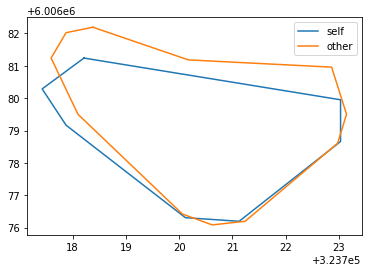

[[182  87]
 [181  88]
 [180  88]
 [179  88]
 [178  89]
 [177  90]
 [176  90]
 [175  91]
 [174  91]
 [173  92]
 [172  93]
 [171  94]
 [170  95]
 [169  96]
 [169  97]
 [168  98]
 [168  99]
 [168 100]
 [167 101]
 [167 102]
 [167 103]
 [167 104]
 [166 105]
 [166 106]
 [166 107]
 [166 108]
 [166 109]
 [166 110]
 [166 111]
 [166 112]
 [166 113]
 [166 114]
 [167 115]
 [167 116]
 [167 117]
 [167 118]
 [167 119]
 [167 120]
 [167 121]
 [168 122]
 [168 123]
 [168 124]
 [168 125]
 [168 126]
 [169 127]
 [169 128]
 [169 129]
 [169 130]
 [169 131]
 [170 132]
 [170 133]
 [170 134]
 [171 135]
 [171 136]
 [171 137]
 [172 138]
 [172 139]
 [172 140]
 [173 141]
 [173 142]
 [173 143]
 [173 144]
 [174 145]
 [175 146]
 [175 147]
 [175 148]
 [176 149]
 [176 150]
 [176 151]
 [177 152]
 [177 153]
 [178 154]
 [178 155]
 [179 156]
 [180 157]
 [181 157]
 [182 157]
 [183 158]
 [184 158]
 [185 158]
 [186 159]
 [187 159]
 [188 159]
 [189 159]
 [190 159]
 [191 159]
 [192 159]
 [193 159]
 [194 159]
 [195 159]
 [196 159]

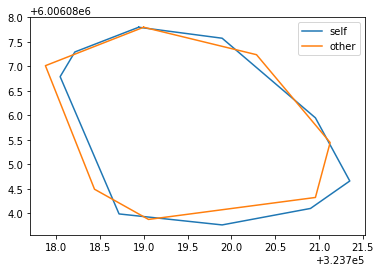

[[221 153]
 [220 154]
 [219 154]
 [218 154]
 [217 154]
 [216 154]
 [215 154]
 [214 154]
 [213 154]
 [212 155]
 [211 155]
 [210 155]
 [209 156]
 [208 156]
 [207 156]
 [206 156]
 [205 157]
 [204 157]
 [203 157]
 [202 158]
 [201 158]
 [200 158]
 [199 159]
 [198 159]
 [197 159]
 [196 159]
 [195 160]
 [194 160]
 [193 161]
 [192 162]
 [191 162]
 [190 163]
 [189 163]
 [188 164]
 [187 164]
 [186 165]
 [185 165]
 [184 165]
 [183 166]
 [182 166]
 [181 167]
 [180 167]
 [179 167]
 [178 168]
 [177 168]
 [176 169]
 [175 169]
 [174 170]
 [173 171]
 [172 172]
 [171 173]
 [170 174]
 [169 175]
 [169 176]
 [168 177]
 [168 178]
 [167 179]
 [167 180]
 [167 181]
 [167 182]
 [166 183]
 [166 184]
 [166 185]
 [166 186]
 [166 187]
 [166 188]
 [166 189]
 [166 190]
 [166 191]
 [167 192]
 [167 193]
 [167 194]
 [168 195]
 [168 196]
 [169 197]
 [169 198]
 [170 199]
 [171 200]
 [172 200]
 [173 200]
 [174 201]
 [175 201]
 [176 201]
 [177 201]
 [178 201]
 [179 201]
 [180 201]
 [181 201]
 [182 202]
 [183 202]
 [184 202]

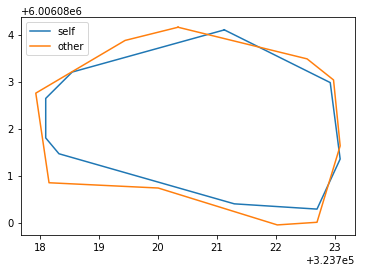

[[147  97]
 [146  98]
 [145  98]
 [144  98]
 [143  98]
 [142  98]
 [141  99]
 [140  99]
 [139  99]
 [138 100]
 [137 100]
 [136 101]
 [135 101]
 [134 102]
 [134 103]
 [133 104]
 [132 105]
 [131 106]
 [130 106]
 [129 107]
 [128 107]
 [127 107]
 [126 108]
 [125 108]
 [124 109]
 [123 109]
 [122 110]
 [121 110]
 [120 111]
 [120 112]
 [119 113]
 [119 114]
 [119 115]
 [118 116]
 [118 117]
 [118 118]
 [118 119]
 [117 120]
 [117 121]
 [117 122]
 [117 123]
 [117 124]
 [117 125]
 [117 126]
 [117 127]
 [117 128]
 [117 129]
 [117 130]
 [117 131]
 [117 132]
 [117 133]
 [117 134]
 [117 135]
 [117 136]
 [117 137]
 [117 138]
 [117 139]
 [117 140]
 [117 141]
 [117 142]
 [117 143]
 [117 144]
 [117 145]
 [116 146]
 [116 147]
 [116 148]
 [116 149]
 [116 150]
 [116 151]
 [116 152]
 [116 153]
 [116 154]
 [116 155]
 [116 156]
 [116 157]
 [116 158]
 [117 159]
 [117 160]
 [117 161]
 [118 162]
 [118 163]
 [118 164]
 [119 165]
 [119 166]
 [120 167]
 [120 168]
 [121 168]
 [122 169]
 [123 170]
 [124 170]
 [125 171]

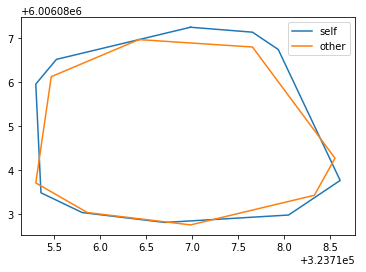

[[ 52 370]
 [ 51 371]
 [ 50 371]
 [ 49 372]
 [ 48 372]
 [ 47 373]
 [ 46 373]
 [ 45 374]
 [ 44 374]
 [ 43 375]
 [ 42 376]
 [ 41 377]
 [ 40 378]
 [ 39 379]
 [ 38 380]
 [ 37 381]
 [ 36 382]
 [ 35 383]
 [ 34 384]
 [ 33 385]
 [ 33 386]
 [ 32 387]
 [ 31 388]
 [ 31 389]
 [ 30 390]
 [ 30 391]
 [ 30 392]
 [ 30 393]
 [ 29 394]
 [ 29 395]
 [ 29 396]
 [ 29 397]
 [ 29 398]
 [ 29 399]
 [ 29 400]
 [ 29 401]
 [ 29 402]
 [ 29 403]
 [ 29 404]
 [ 28 405]
 [ 29 406]
 [ 29 407]
 [ 29 408]
 [ 29 409]
 [ 29 410]
 [ 29 411]
 [ 29 412]
 [ 29 413]
 [ 29 414]
 [ 29 415]
 [ 29 416]
 [ 29 417]
 [ 29 418]
 [ 29 419]
 [ 29 420]
 [ 29 421]
 [ 29 422]
 [ 29 423]
 [ 29 424]
 [ 29 425]
 [ 30 426]
 [ 30 427]
 [ 31 428]
 [ 31 429]
 [ 32 430]
 [ 33 431]
 [ 34 431]
 [ 35 432]
 [ 36 433]
 [ 37 433]
 [ 38 433]
 [ 39 434]
 [ 40 434]
 [ 41 434]
 [ 42 434]
 [ 43 434]
 [ 44 435]
 [ 45 435]
 [ 46 435]
 [ 47 435]
 [ 48 435]
 [ 49 435]
 [ 50 435]
 [ 51 435]
 [ 52 435]
 [ 53 435]
 [ 54 435]
 [ 55 435]
 [ 56 435]
 [ 57 434]
 [ 58 434]

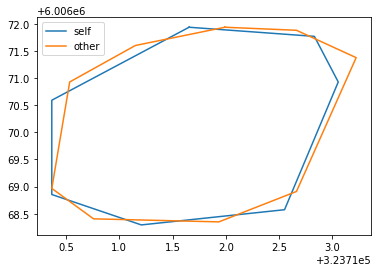

[[141 428]
 [140 429]
 [139 429]
 [138 429]
 [137 430]
 [136 431]
 [135 432]
 [134 433]
 [133 434]
 [132 435]
 [131 436]
 [130 437]
 [129 438]
 [128 439]
 [128 440]
 [127 441]
 [126 442]
 [125 443]
 [125 444]
 [124 445]
 [124 446]
 [123 447]
 [122 448]
 [122 449]
 [121 450]
 [121 451]
 [121 452]
 [120 453]
 [120 454]
 [119 455]
 [119 456]
 [119 457]
 [119 458]
 [119 459]
 [119 460]
 [119 461]
 [119 462]
 [119 463]
 [119 464]
 [119 465]
 [119 466]
 [119 467]
 [119 468]
 [119 469]
 [119 470]
 [119 471]
 [119 472]
 [119 473]
 [119 474]
 [119 475]
 [119 476]
 [119 477]
 [119 478]
 [119 479]
 [119 480]
 [119 481]
 [119 482]
 [120 483]
 [120 484]
 [120 485]
 [120 486]
 [120 487]
 [121 488]
 [121 489]
 [122 490]
 [122 491]
 [123 492]
 [124 493]
 [125 494]
 [126 495]
 [127 495]
 [128 496]
 [129 496]
 [130 496]
 [131 497]
 [132 497]
 [133 497]
 [134 497]
 [135 497]
 [136 497]
 [137 497]
 [138 497]
 [139 497]
 [140 497]
 [141 497]
 [142 497]
 [143 498]
 [144 498]
 [145 498]
 [146 498]
 [147 498]

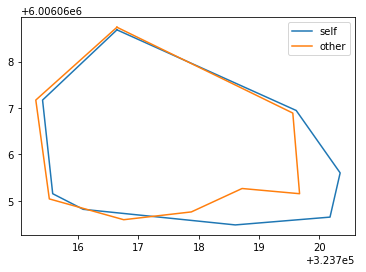

[[ 68 431]
 [ 67 432]
 [ 66 432]
 [ 65 432]
 [ 64 432]
 [ 63 432]
 [ 62 432]
 [ 61 432]
 [ 60 432]
 [ 59 432]
 [ 58 433]
 [ 57 433]
 [ 56 433]
 [ 55 433]
 [ 54 433]
 [ 53 433]
 [ 52 433]
 [ 51 433]
 [ 50 433]
 [ 49 433]
 [ 48 433]
 [ 47 434]
 [ 46 434]
 [ 45 434]
 [ 44 434]
 [ 43 435]
 [ 42 435]
 [ 41 435]
 [ 40 435]
 [ 39 435]
 [ 38 435]
 [ 37 435]
 [ 36 435]
 [ 35 435]
 [ 34 435]
 [ 33 435]
 [ 32 436]
 [ 31 436]
 [ 30 436]
 [ 29 436]
 [ 28 436]
 [ 27 435]
 [ 26 436]
 [ 25 437]
 [ 24 438]
 [ 23 439]
 [ 22 440]
 [ 22 441]
 [ 21 442]
 [ 21 443]
 [ 21 444]
 [ 20 445]
 [ 20 446]
 [ 20 447]
 [ 19 448]
 [ 19 449]
 [ 19 450]
 [ 18 451]
 [ 18 452]
 [ 17 453]
 [ 17 454]
 [ 17 455]
 [ 16 456]
 [ 16 457]
 [ 16 458]
 [ 16 459]
 [ 16 460]
 [ 16 461]
 [ 15 462]
 [ 15 463]
 [ 15 464]
 [ 15 465]
 [ 15 466]
 [ 15 467]
 [ 15 468]
 [ 15 469]
 [ 15 470]
 [ 15 471]
 [ 16 472]
 [ 16 473]
 [ 16 474]
 [ 16 475]
 [ 16 476]
 [ 17 477]
 [ 17 478]
 [ 17 479]
 [ 17 480]
 [ 18 481]
 [ 18 482]
 [ 18 483]
 [ 19 484]

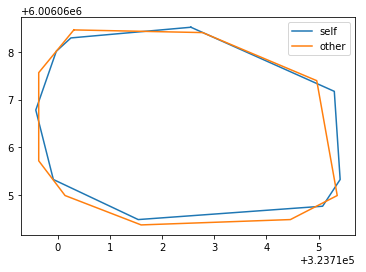

[[314 120]
 [313 121]
 [312 121]
 [311 121]
 [310 121]
 [309 121]
 [308 121]
 [307 122]
 [306 122]
 [305 122]
 [304 122]
 [303 122]
 [302 123]
 [301 123]
 [300 123]
 [299 123]
 [298 124]
 [297 124]
 [296 125]
 [295 125]
 [294 126]
 [293 127]
 [292 127]
 [291 128]
 [290 128]
 [289 129]
 [288 130]
 [287 130]
 [286 131]
 [285 131]
 [284 132]
 [283 133]
 [282 133]
 [281 134]
 [280 135]
 [279 136]
 [278 137]
 [277 138]
 [276 139]
 [276 140]
 [275 141]
 [275 142]
 [274 143]
 [274 144]
 [274 145]
 [274 146]
 [273 147]
 [273 148]
 [273 149]
 [273 150]
 [273 151]
 [273 152]
 [273 153]
 [273 154]
 [273 155]
 [273 156]
 [273 157]
 [273 158]
 [273 159]
 [273 160]
 [274 161]
 [274 162]
 [274 163]
 [274 164]
 [275 165]
 [275 166]
 [276 167]
 [276 168]
 [277 169]
 [277 170]
 [278 171]
 [278 172]
 [279 173]
 [279 174]
 [280 175]
 [281 176]
 [282 177]
 [283 178]
 [284 179]
 [285 179]
 [286 180]
 [287 180]
 [288 181]
 [289 181]
 [290 181]
 [291 181]
 [292 182]
 [293 182]
 [294 182]
 [295 182]
 [296 182]

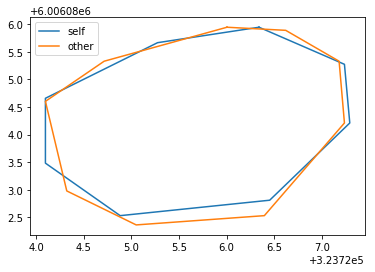

[[ 24 427]
 [ 23 428]
 [ 22 429]
 [ 22 430]
 [ 21 431]
 [ 21 432]
 [ 21 433]
 [ 20 434]
 [ 20 435]
 [ 20 436]
 [ 19 437]
 [ 19 438]
 [ 19 439]
 [ 19 440]
 [ 18 441]
 [ 18 442]
 [ 18 443]
 [ 18 444]
 [ 18 445]
 [ 17 446]
 [ 17 447]
 [ 17 448]
 [ 17 449]
 [ 17 450]
 [ 16 451]
 [ 16 452]
 [ 16 453]
 [ 16 454]
 [ 16 455]
 [ 15 456]
 [ 15 457]
 [ 15 458]
 [ 15 459]
 [ 15 460]
 [ 15 461]
 [ 15 462]
 [ 15 463]
 [ 15 464]
 [ 15 465]
 [ 15 466]
 [ 15 467]
 [ 14 468]
 [ 14 469]
 [ 14 470]
 [ 14 471]
 [ 15 472]
 [ 15 473]
 [ 14 474]
 [ 15 475]
 [ 15 476]
 [ 15 477]
 [ 15 478]
 [ 15 479]
 [ 15 480]
 [ 15 481]
 [ 16 482]
 [ 16 483]
 [ 16 484]
 [ 16 485]
 [ 17 486]
 [ 17 487]
 [ 17 488]
 [ 18 489]
 [ 18 490]
 [ 19 491]
 [ 20 492]
 [ 21 493]
 [ 22 493]
 [ 23 494]
 [ 24 494]
 [ 25 494]
 [ 26 495]
 [ 27 495]
 [ 28 495]
 [ 29 495]
 [ 30 495]
 [ 31 495]
 [ 32 495]
 [ 33 495]
 [ 34 495]
 [ 35 494]
 [ 36 494]
 [ 37 494]
 [ 38 494]
 [ 39 494]
 [ 40 494]
 [ 41 494]
 [ 42 494]
 [ 43 494]
 [ 44 494]
 [ 45 493]

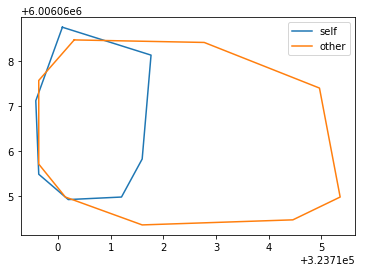

41it [01:07,  1.89s/it]

[[121 210]
 [120 211]
 [119 211]
 [118 211]
 [117 211]
 [116 211]
 [115 211]
 [114 211]
 [113 212]
 [112 212]
 [111 213]
 [110 213]
 [109 214]
 [108 214]
 [107 214]
 [106 215]
 [105 215]
 [104 216]
 [103 216]
 [102 217]
 [101 217]
 [100 218]
 [ 99 219]
 [ 98 220]
 [ 97 221]
 [ 96 222]
 [ 95 222]
 [ 94 223]
 [ 93 224]
 [ 92 225]
 [ 91 226]
 [ 90 227]
 [ 89 228]
 [ 89 229]
 [ 88 230]
 [ 87 231]
 [ 87 232]
 [ 86 233]
 [ 86 234]
 [ 85 235]
 [ 85 236]
 [ 85 237]
 [ 84 238]
 [ 84 239]
 [ 84 240]
 [ 84 241]
 [ 83 242]
 [ 83 243]
 [ 83 244]
 [ 82 245]
 [ 82 246]
 [ 82 247]
 [ 82 248]
 [ 81 249]
 [ 81 250]
 [ 81 251]
 [ 81 252]
 [ 80 253]
 [ 80 254]
 [ 80 255]
 [ 80 256]
 [ 79 257]
 [ 79 258]
 [ 78 259]
 [ 78 260]
 [ 77 261]
 [ 77 262]
 [ 77 263]
 [ 76 264]
 [ 76 265]
 [ 76 266]
 [ 75 267]
 [ 74 268]
 [ 74 269]
 [ 73 270]
 [ 72 271]
 [ 72 272]
 [ 71 273]
 [ 70 274]
 [ 70 275]
 [ 69 276]
 [ 68 277]
 [ 67 278]
 [ 66 279]
 [ 65 280]
 [ 64 281]
 [ 63 282]
 [ 62 283]
 [ 61 284]
 [ 61 285]
 [ 60 286]

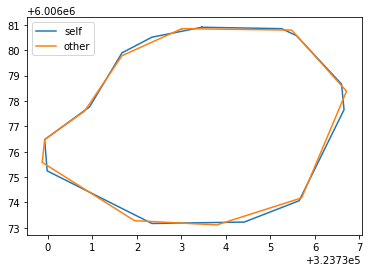

[[384 220]
 [383 221]
 [382 221]
 [381 221]
 [380 221]
 [379 221]
 [378 221]
 [377 222]
 [376 222]
 [375 222]
 [374 222]
 [373 222]
 [372 223]
 [371 223]
 [370 223]
 [369 223]
 [368 223]
 [367 223]
 [366 223]
 [365 223]
 [364 223]
 [363 223]
 [362 222]
 [361 222]
 [360 222]
 [359 222]
 [358 222]
 [357 222]
 [356 222]
 [355 222]
 [354 222]
 [353 223]
 [352 223]
 [351 224]
 [350 224]
 [349 225]
 [348 225]
 [347 225]
 [346 226]
 [345 227]
 [344 228]
 [343 228]
 [342 229]
 [341 230]
 [340 231]
 [339 232]
 [338 233]
 [338 234]
 [337 235]
 [337 236]
 [337 237]
 [337 238]
 [336 239]
 [336 240]
 [336 241]
 [336 242]
 [336 243]
 [336 244]
 [336 245]
 [336 246]
 [336 247]
 [336 248]
 [336 249]
 [336 250]
 [336 251]
 [336 252]
 [336 253]
 [336 254]
 [336 255]
 [335 256]
 [335 257]
 [335 258]
 [335 259]
 [335 260]
 [335 261]
 [335 262]
 [335 263]
 [335 264]
 [335 265]
 [335 266]
 [335 267]
 [334 268]
 [334 269]
 [334 270]
 [334 271]
 [334 272]
 [334 273]
 [335 274]
 [335 275]
 [335 276]
 [335 277]

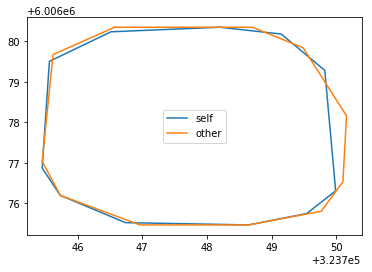

[[251 274]
 [250 275]
 [249 275]
 [248 275]
 [247 275]
 [246 275]
 [245 275]
 [244 275]
 [243 275]
 [242 275]
 [241 275]
 [240 276]
 [239 276]
 [238 276]
 [237 276]
 [236 276]
 [235 277]
 [234 277]
 [233 277]
 [232 277]
 [231 277]
 [230 278]
 [229 278]
 [228 278]
 [227 279]
 [226 279]
 [225 279]
 [224 279]
 [223 279]
 [222 280]
 [221 280]
 [220 280]
 [219 280]
 [218 280]
 [217 280]
 [216 280]
 [215 280]
 [214 280]
 [213 281]
 [212 281]
 [211 281]
 [210 281]
 [209 281]
 [208 281]
 [207 281]
 [206 281]
 [205 281]
 [204 282]
 [203 282]
 [202 282]
 [201 283]
 [200 283]
 [199 283]
 [198 284]
 [197 285]
 [196 285]
 [195 286]
 [194 287]
 [193 287]
 [192 288]
 [191 288]
 [190 289]
 [190 290]
 [189 291]
 [189 292]
 [188 293]
 [187 294]
 [187 295]
 [186 296]
 [185 297]
 [184 298]
 [183 299]
 [183 300]
 [182 301]
 [181 302]
 [180 303]
 [180 304]
 [179 305]
 [178 306]
 [177 307]
 [176 308]
 [175 309]
 [174 310]
 [174 311]
 [173 312]
 [172 313]
 [172 314]
 [172 315]
 [171 316]
 [171 317]
 [170 318]

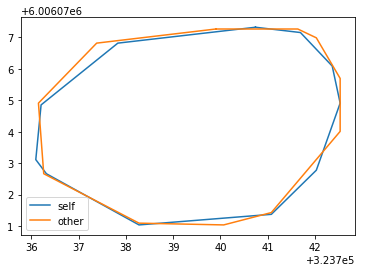

[[329 165]
 [328 166]
 [327 166]
 [326 166]
 [325 167]
 [324 167]
 [323 167]
 [322 168]
 [321 168]
 [320 169]
 [319 169]
 [318 170]
 [317 170]
 [316 171]
 [315 172]
 [314 172]
 [313 173]
 [312 173]
 [311 174]
 [310 174]
 [309 175]
 [308 175]
 [307 176]
 [306 176]
 [305 177]
 [304 178]
 [303 179]
 [302 179]
 [301 180]
 [300 180]
 [299 181]
 [298 181]
 [297 182]
 [296 182]
 [295 183]
 [294 183]
 [293 184]
 [292 184]
 [291 185]
 [290 185]
 [289 185]
 [288 186]
 [287 186]
 [286 187]
 [285 187]
 [284 187]
 [283 188]
 [282 188]
 [281 188]
 [281 189]
 [280 190]
 [279 191]
 [278 192]
 [278 193]
 [278 194]
 [278 195]
 [277 196]
 [277 197]
 [277 198]
 [277 199]
 [277 200]
 [277 201]
 [277 202]
 [277 203]
 [277 204]
 [277 205]
 [277 206]
 [277 207]
 [277 208]
 [278 209]
 [278 210]
 [278 211]
 [278 212]
 [278 213]
 [279 214]
 [279 215]
 [280 216]
 [280 217]
 [281 218]
 [281 219]
 [282 220]
 [282 221]
 [283 222]
 [284 223]
 [284 224]
 [285 225]
 [286 226]
 [286 227]
 [287 228]
 [288 229]
 [289 230]

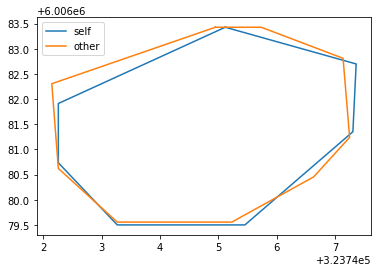

[[509  40]
 [508  41]
 [507  41]
 [506  41]
 [505  41]
 [504  42]
 [503  42]
 [503  43]
 [502  44]
 [501  45]
 [500  46]
 [499  47]
 [498  48]
 [497  49]
 [497  50]
 [496  51]
 [496  52]
 [495  53]
 [494  54]
 [493  54]
 [492  55]
 [491  55]
 [490  56]
 [489  57]
 [488  58]
 [487  58]
 [486  58]
 [485  59]
 [484  59]
 [483  60]
 [482  61]
 [481  62]
 [480  63]
 [479  64]
 [478  64]
 [478  65]
 [477  66]
 [476  67]
 [475  68]
 [474  69]
 [474  70]
 [473  71]
 [473  72]
 [472  73]
 [471  74]
 [470  75]
 [470  76]
 [469  77]
 [469  78]
 [468  79]
 [467  80]
 [467  81]
 [466  82]
 [466  83]
 [465  84]
 [465  85]
 [464  86]
 [464  87]
 [464  88]
 [464  89]
 [464  90]
 [464  91]
 [464  92]
 [464  93]
 [464  94]
 [464  95]
 [464  96]
 [464  97]
 [465  98]
 [466  99]
 [467 100]
 [468 100]
 [469 101]
 [470 102]
 [471 102]
 [472 103]
 [473 103]
 [474 103]
 [475 104]
 [476 104]
 [477 105]
 [478 105]
 [479 106]
 [480 106]
 [481 107]
 [482 108]
 [483 108]
 [484 109]
 [485 109]
 [486 110]
 [487 110]

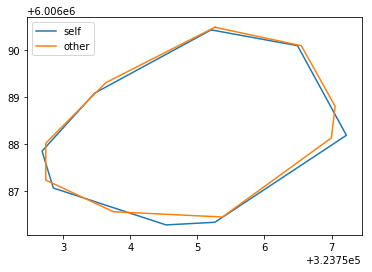

[[159 116]
 [158 117]
 [157 117]
 [156 117]
 [155 117]
 [154 117]
 [153 117]
 [152 118]
 [151 118]
 [150 118]
 [149 118]
 [148 119]
 [147 119]
 [146 119]
 [145 120]
 [144 121]
 [143 121]
 [142 122]
 [141 123]
 [140 124]
 [139 125]
 [138 126]
 [138 127]
 [137 128]
 [137 129]
 [136 130]
 [136 131]
 [136 132]
 [136 133]
 [136 134]
 [135 135]
 [135 136]
 [135 137]
 [135 138]
 [135 139]
 [135 140]
 [135 141]
 [135 142]
 [135 143]
 [135 144]
 [135 145]
 [135 146]
 [135 147]
 [135 148]
 [136 149]
 [136 150]
 [136 151]
 [136 152]
 [136 153]
 [136 154]
 [137 155]
 [137 156]
 [137 157]
 [138 158]
 [138 159]
 [138 160]
 [139 161]
 [139 162]
 [140 163]
 [141 164]
 [142 165]
 [143 166]
 [144 167]
 [145 167]
 [146 168]
 [147 169]
 [148 169]
 [149 169]
 [150 170]
 [151 170]
 [152 170]
 [153 170]
 [154 170]
 [155 170]
 [156 170]
 [157 170]
 [158 170]
 [159 170]
 [160 170]
 [161 170]
 [162 170]
 [163 170]
 [164 170]
 [165 170]
 [166 170]
 [167 169]
 [168 169]
 [169 169]
 [170 169]
 [171 169]
 [172 168]

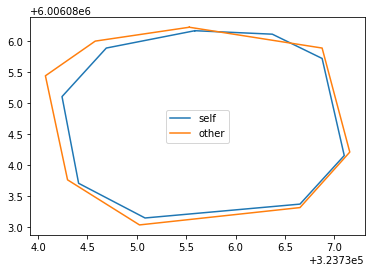

[[441 138]
 [440 139]
 [439 139]
 [438 139]
 [437 139]
 [436 140]
 [435 140]
 [434 141]
 [433 141]
 [432 141]
 [431 142]
 [430 143]
 [429 143]
 [428 144]
 [427 145]
 [427 146]
 [426 147]
 [426 148]
 [426 149]
 [425 150]
 [425 151]
 [425 152]
 [425 153]
 [424 154]
 [424 155]
 [424 156]
 [424 157]
 [424 158]
 [424 159]
 [424 160]
 [424 161]
 [424 162]
 [424 163]
 [424 164]
 [424 165]
 [424 166]
 [424 167]
 [424 168]
 [424 169]
 [424 170]
 [425 171]
 [425 172]
 [426 173]
 [427 173]
 [428 174]
 [429 174]
 [430 175]
 [431 175]
 [432 175]
 [433 175]
 [434 175]
 [435 175]
 [436 175]
 [437 175]
 [438 175]
 [439 175]
 [440 175]
 [441 175]
 [442 175]
 [443 175]
 [444 175]
 [445 175]
 [446 175]
 [447 175]
 [448 175]
 [449 175]
 [450 175]
 [451 174]
 [452 174]
 [453 174]
 [454 174]
 [455 174]
 [456 173]
 [457 173]
 [458 172]
 [458 171]
 [459 170]
 [459 169]
 [460 168]
 [460 167]
 [460 166]
 [460 165]
 [460 164]
 [460 163]
 [461 162]
 [461 161]
 [461 160]
 [461 159]
 [461 158]
 [460 157]
 [460 156]

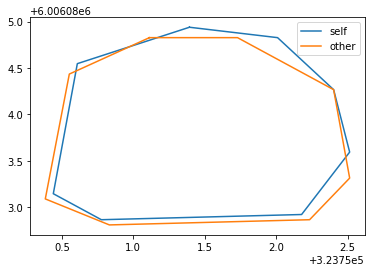

[[389 430]
 [388 431]
 [387 431]
 [386 431]
 [385 431]
 [384 432]
 [383 432]
 [382 433]
 [381 433]
 [380 433]
 [379 434]
 [378 435]
 [377 436]
 [376 436]
 [375 436]
 [374 436]
 [373 437]
 [372 438]
 [371 439]
 [370 439]
 [369 440]
 [369 441]
 [368 442]
 [367 443]
 [366 444]
 [365 445]
 [365 446]
 [364 447]
 [363 448]
 [363 449]
 [363 450]
 [362 451]
 [361 452]
 [361 453]
 [360 454]
 [360 455]
 [359 456]
 [359 457]
 [359 458]
 [358 459]
 [358 460]
 [357 461]
 [357 462]
 [357 463]
 [356 464]
 [356 465]
 [356 466]
 [356 467]
 [356 468]
 [356 469]
 [355 470]
 [355 471]
 [355 472]
 [355 473]
 [355 474]
 [355 475]
 [356 476]
 [356 477]
 [356 478]
 [356 479]
 [357 480]
 [357 481]
 [358 482]
 [359 483]
 [360 484]
 [361 484]
 [362 485]
 [363 485]
 [364 486]
 [365 486]
 [366 487]
 [367 487]
 [368 488]
 [369 488]
 [370 489]
 [371 489]
 [372 490]
 [373 491]
 [374 491]
 [375 492]
 [376 493]
 [377 493]
 [378 494]
 [379 494]
 [380 495]
 [381 495]
 [382 496]
 [383 496]
 [384 497]
 [385 497]
 [386 498]

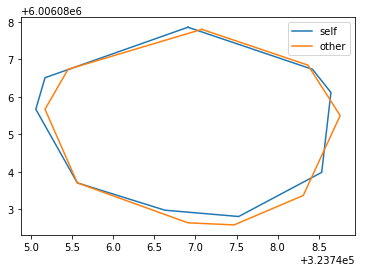

[[501 444]
 [500 445]
 [499 445]
 [498 445]
 [497 446]
 [496 446]
 [495 446]
 [494 447]
 [493 448]
 [492 449]
 [491 450]
 [490 451]
 [489 452]
 [488 453]
 [488 454]
 [487 455]
 [487 456]
 [486 457]
 [486 458]
 [486 459]
 [485 460]
 [485 461]
 [485 462]
 [484 463]
 [484 464]
 [484 465]
 [484 466]
 [484 467]
 [484 468]
 [484 469]
 [484 470]
 [484 471]
 [485 472]
 [485 473]
 [485 474]
 [486 475]
 [486 476]
 [486 477]
 [487 477]
 [488 478]
 [489 479]
 [489 480]
 [490 481]
 [491 482]
 [492 482]
 [493 483]
 [494 483]
 [495 484]
 [496 484]
 [497 485]
 [498 485]
 [499 485]
 [500 485]
 [501 485]
 [502 486]
 [503 486]
 [504 486]
 [505 486]
 [506 486]
 [507 486]
 [508 486]
 [509 485]
 [510 486]
 [511 485]
 [512 485]
 [513 485]
 [514 485]
 [515 484]
 [516 484]
 [517 483]
 [518 483]
 [519 482]
 [520 481]
 [520 480]
 [521 479]
 [521 478]
 [522 477]
 [522 476]
 [522 475]
 [522 474]
 [523 473]
 [523 472]
 [523 471]
 [523 470]
 [524 469]
 [524 468]
 [524 467]
 [524 466]
 [524 465]
 [524 464]
 [524 463]

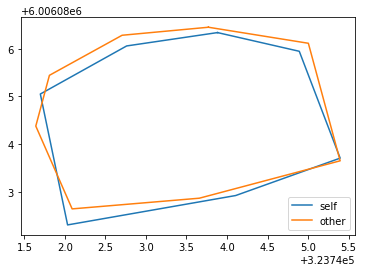

[[463  98]
 [462  99]
 [461 100]
 [460 100]
 [459 101]
 [458 102]
 [457 103]
 [457 104]
 [456 105]
 [455 106]
 [455 107]
 [455 108]
 [454 109]
 [454 110]
 [453 111]
 [453 112]
 [453 113]
 [453 114]
 [453 115]
 [453 116]
 [453 117]
 [452 118]
 [452 119]
 [452 120]
 [452 121]
 [452 122]
 [452 123]
 [452 124]
 [452 125]
 [452 126]
 [452 127]
 [452 128]
 [452 129]
 [452 130]
 [452 131]
 [453 132]
 [453 133]
 [453 134]
 [453 135]
 [454 136]
 [454 137]
 [455 138]
 [455 139]
 [456 140]
 [456 141]
 [457 142]
 [457 143]
 [457 144]
 [458 145]
 [458 146]
 [459 147]
 [459 148]
 [459 149]
 [460 150]
 [460 151]
 [460 152]
 [461 153]
 [461 154]
 [462 155]
 [462 156]
 [463 157]
 [463 158]
 [464 159]
 [465 159]
 [466 160]
 [467 161]
 [468 162]
 [469 163]
 [470 164]
 [471 164]
 [472 165]
 [473 165]
 [474 165]
 [475 165]
 [476 165]
 [477 165]
 [478 165]
 [479 165]
 [480 165]
 [481 165]
 [482 165]
 [483 164]
 [484 164]
 [485 164]
 [486 164]
 [487 163]
 [488 163]
 [489 162]
 [490 162]
 [491 162]
 [492 161]

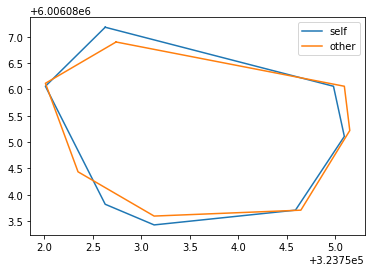

42it [01:09,  1.77s/it]

[[504 212]
 [503 213]
 [502 213]
 [501 214]
 [500 214]
 [499 215]
 [498 215]
 [497 216]
 [496 217]
 [495 218]
 [495 219]
 [494 220]
 [493 221]
 [493 222]
 [492 223]
 [492 224]
 [492 225]
 [491 226]
 [491 227]
 [491 228]
 [490 229]
 [490 230]
 [490 231]
 [489 232]
 [489 233]
 [489 234]
 [489 235]
 [489 236]
 [488 237]
 [488 238]
 [488 239]
 [488 240]
 [488 241]
 [488 242]
 [487 243]
 [487 244]
 [487 245]
 [486 246]
 [486 247]
 [486 248]
 [485 249]
 [485 250]
 [485 251]
 [485 252]
 [485 253]
 [484 254]
 [484 255]
 [483 256]
 [483 257]
 [483 258]
 [482 259]
 [482 260]
 [481 261]
 [481 262]
 [481 263]
 [480 264]
 [480 265]
 [479 266]
 [479 267]
 [478 268]
 [477 269]
 [477 270]
 [477 271]
 [477 272]
 [476 273]
 [476 274]
 [476 275]
 [475 276]
 [475 277]
 [474 278]
 [474 279]
 [473 280]
 [473 281]
 [473 282]
 [473 283]
 [473 284]
 [472 285]
 [472 286]
 [472 287]
 [472 288]
 [472 289]
 [472 290]
 [472 291]
 [472 292]
 [472 293]
 [472 294]
 [472 295]
 [472 296]
 [472 297]
 [472 298]
 [472 299]

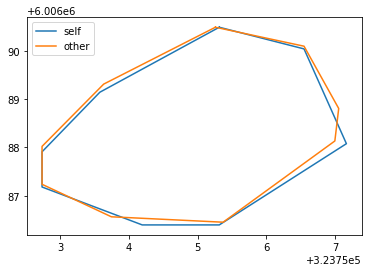

[[ 33 219]
 [ 32 220]
 [ 31 220]
 [ 30 220]
 [ 29 220]
 [ 28 221]
 [ 27 221]
 [ 26 222]
 [ 25 222]
 [ 24 223]
 [ 23 223]
 [ 22 224]
 [ 21 225]
 [ 20 225]
 [ 19 226]
 [ 19 227]
 [ 18 228]
 [ 18 229]
 [ 18 230]
 [ 17 231]
 [ 17 232]
 [ 16 233]
 [ 16 234]
 [ 16 235]
 [ 15 236]
 [ 15 237]
 [ 15 238]
 [ 15 239]
 [ 15 240]
 [ 15 241]
 [ 15 242]
 [ 15 243]
 [ 15 244]
 [ 15 245]
 [ 15 246]
 [ 15 247]
 [ 14 248]
 [ 15 249]
 [ 15 250]
 [ 15 251]
 [ 15 252]
 [ 15 253]
 [ 15 254]
 [ 15 255]
 [ 15 256]
 [ 15 257]
 [ 15 258]
 [ 15 259]
 [ 15 260]
 [ 15 261]
 [ 15 262]
 [ 15 263]
 [ 15 264]
 [ 15 265]
 [ 15 266]
 [ 15 267]
 [ 15 268]
 [ 15 269]
 [ 15 270]
 [ 15 271]
 [ 15 272]
 [ 15 273]
 [ 15 274]
 [ 15 275]
 [ 16 276]
 [ 16 277]
 [ 16 278]
 [ 16 279]
 [ 16 280]
 [ 17 281]
 [ 17 282]
 [ 17 283]
 [ 17 284]
 [ 17 285]
 [ 18 286]
 [ 18 287]
 [ 18 288]
 [ 19 289]
 [ 19 290]
 [ 20 291]
 [ 20 292]
 [ 21 293]
 [ 21 294]
 [ 22 295]
 [ 23 296]
 [ 23 297]
 [ 24 298]
 [ 25 299]
 [ 26 300]
 [ 27 300]
 [ 28 301]

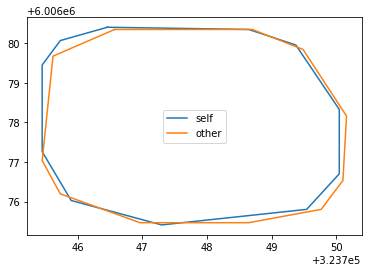

[[141 100]
 [140 101]
 [139 101]
 [138 101]
 [137 102]
 [136 103]
 [135 104]
 [135 105]
 [134 106]
 [134 107]
 [134 108]
 [133 109]
 [133 110]
 [133 111]
 [133 112]
 [133 113]
 [133 114]
 [133 115]
 [133 116]
 [132 117]
 [132 118]
 [132 119]
 [132 120]
 [132 121]
 [132 122]
 [132 123]
 [132 124]
 [132 125]
 [132 126]
 [132 127]
 [132 128]
 [132 129]
 [132 130]
 [132 131]
 [132 132]
 [132 133]
 [132 134]
 [133 135]
 [133 136]
 [133 137]
 [133 138]
 [133 139]
 [134 140]
 [134 141]
 [134 142]
 [135 143]
 [135 144]
 [135 145]
 [136 146]
 [136 147]
 [137 148]
 [137 149]
 [137 150]
 [138 151]
 [139 152]
 [139 153]
 [140 154]
 [140 155]
 [140 156]
 [141 157]
 [141 158]
 [142 159]
 [143 160]
 [144 161]
 [145 162]
 [146 163]
 [147 164]
 [148 165]
 [149 165]
 [150 166]
 [151 167]
 [151 168]
 [152 169]
 [152 170]
 [153 171]
 [153 172]
 [153 173]
 [154 174]
 [154 175]
 [155 176]
 [156 177]
 [157 178]
 [157 179]
 [158 180]
 [159 180]
 [160 180]
 [161 180]
 [162 181]
 [163 181]
 [164 181]
 [165 181]

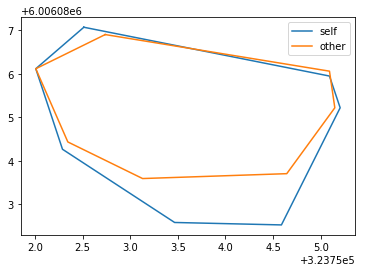

[[122 139]
 [121 140]
 [120 140]
 [119 140]
 [118 140]
 [117 140]
 [116 141]
 [115 141]
 [114 141]
 [113 142]
 [112 142]
 [111 143]
 [110 144]
 [109 144]
 [108 145]
 [107 146]
 [106 147]
 [106 148]
 [105 149]
 [105 150]
 [105 151]
 [105 152]
 [104 153]
 [104 154]
 [104 155]
 [104 156]
 [104 157]
 [104 158]
 [103 159]
 [103 160]
 [103 161]
 [103 162]
 [103 163]
 [103 164]
 [103 165]
 [103 166]
 [104 167]
 [104 168]
 [104 169]
 [104 170]
 [105 171]
 [106 172]
 [107 173]
 [108 173]
 [109 174]
 [110 174]
 [111 174]
 [112 174]
 [113 174]
 [114 174]
 [115 174]
 [116 174]
 [117 174]
 [118 174]
 [119 174]
 [120 174]
 [121 174]
 [122 174]
 [123 174]
 [124 174]
 [125 174]
 [126 174]
 [127 174]
 [128 174]
 [129 174]
 [130 174]
 [131 174]
 [132 174]
 [133 174]
 [134 174]
 [135 174]
 [136 173]
 [137 173]
 [138 172]
 [139 171]
 [139 170]
 [140 169]
 [140 168]
 [141 167]
 [141 166]
 [141 165]
 [141 164]
 [141 163]
 [141 162]
 [141 161]
 [141 160]
 [140 159]
 [140 158]
 [140 157]
 [140 156]
 [139 155]

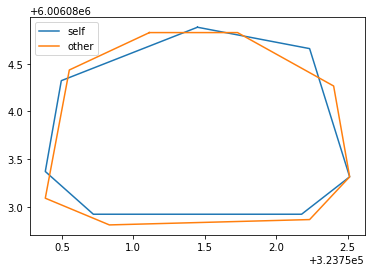

[[ 68 430]
 [ 67 431]
 [ 66 431]
 [ 65 431]
 [ 64 431]
 [ 63 432]
 [ 62 432]
 [ 61 433]
 [ 60 433]
 [ 59 433]
 [ 58 434]
 [ 57 434]
 [ 57 435]
 [ 56 436]
 [ 55 436]
 [ 54 436]
 [ 53 436]
 [ 52 437]
 [ 51 438]
 [ 50 439]
 [ 49 440]
 [ 48 441]
 [ 47 442]
 [ 46 443]
 [ 45 444]
 [ 45 445]
 [ 44 446]
 [ 43 447]
 [ 42 448]
 [ 42 449]
 [ 41 450]
 [ 41 451]
 [ 40 452]
 [ 39 453]
 [ 39 454]
 [ 38 455]
 [ 37 456]
 [ 37 457]
 [ 36 458]
 [ 36 459]
 [ 35 460]
 [ 35 461]
 [ 35 462]
 [ 34 463]
 [ 34 464]
 [ 33 465]
 [ 33 466]
 [ 33 467]
 [ 33 468]
 [ 33 469]
 [ 32 470]
 [ 32 471]
 [ 32 472]
 [ 32 473]
 [ 32 474]
 [ 32 475]
 [ 32 476]
 [ 32 477]
 [ 32 478]
 [ 32 479]
 [ 33 480]
 [ 33 481]
 [ 33 482]
 [ 33 483]
 [ 34 484]
 [ 34 485]
 [ 34 486]
 [ 35 487]
 [ 36 488]
 [ 37 488]
 [ 38 489]
 [ 39 489]
 [ 40 489]
 [ 41 489]
 [ 42 490]
 [ 43 490]
 [ 44 490]
 [ 45 490]
 [ 46 491]
 [ 47 491]
 [ 48 491]
 [ 49 492]
 [ 50 493]
 [ 51 493]
 [ 52 494]
 [ 53 495]
 [ 54 495]
 [ 55 496]
 [ 56 496]
 [ 57 497]
 [ 58 498]

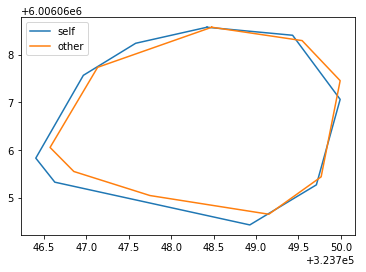

[[181 444]
 [180 445]
 [179 445]
 [178 445]
 [177 446]
 [176 446]
 [175 447]
 [174 448]
 [173 448]
 [173 449]
 [172 450]
 [171 450]
 [171 451]
 [170 452]
 [170 453]
 [169 454]
 [169 455]
 [169 456]
 [168 457]
 [168 458]
 [168 459]
 [168 460]
 [168 461]
 [167 462]
 [167 463]
 [167 464]
 [167 465]
 [167 466]
 [167 467]
 [167 468]
 [168 469]
 [168 470]
 [168 471]
 [168 472]
 [168 473]
 [168 474]
 [169 475]
 [169 476]
 [169 477]
 [170 478]
 [170 479]
 [171 480]
 [172 481]
 [173 482]
 [174 483]
 [175 483]
 [176 484]
 [177 484]
 [178 485]
 [179 485]
 [180 485]
 [181 485]
 [182 485]
 [183 486]
 [184 486]
 [185 486]
 [186 486]
 [187 486]
 [188 486]
 [189 486]
 [190 486]
 [191 486]
 [192 486]
 [193 486]
 [194 485]
 [195 485]
 [196 485]
 [197 484]
 [198 483]
 [199 482]
 [200 481]
 [201 480]
 [201 479]
 [202 478]
 [202 477]
 [203 476]
 [203 475]
 [203 474]
 [203 473]
 [203 472]
 [203 471]
 [203 470]
 [203 469]
 [203 468]
 [203 467]
 [203 466]
 [203 465]
 [203 464]
 [203 463]
 [203 462]
 [203 461]

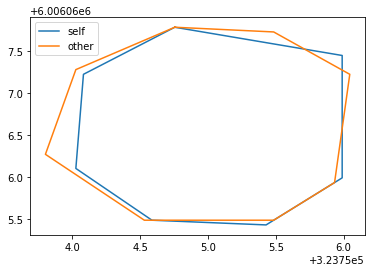

[[ 43  85]
 [ 42  86]
 [ 41  86]
 [ 40  87]
 [ 39  87]
 [ 38  88]
 [ 37  88]
 [ 36  89]
 [ 35  90]
 [ 34  91]
 [ 33  91]
 [ 32  92]
 [ 31  92]
 [ 30  93]
 [ 29  94]
 [ 28  95]
 [ 27  95]
 [ 26  95]
 [ 25  96]
 [ 24  97]
 [ 23  98]
 [ 22  99]
 [ 21 100]
 [ 20 101]
 [ 19 102]
 [ 18 103]
 [ 17 104]
 [ 17 105]
 [ 16 106]
 [ 15 107]
 [ 14 108]
 [ 13 109]
 [ 13 110]
 [ 12 111]
 [ 12 112]
 [ 11 113]
 [ 11 114]
 [ 10 115]
 [ 10 116]
 [ 10 117]
 [ 10 118]
 [ 10 119]
 [ 10 120]
 [ 10 121]
 [ 10 122]
 [ 10 123]
 [ 10 124]
 [ 10 125]
 [ 10 126]
 [ 10 127]
 [ 10 128]
 [ 10 129]
 [ 10 130]
 [ 10 131]
 [ 11 132]
 [ 11 133]
 [ 11 134]
 [ 11 135]
 [ 11 136]
 [ 11 137]
 [ 11 138]
 [ 12 139]
 [ 12 140]
 [ 12 141]
 [ 12 142]
 [ 12 143]
 [ 12 144]
 [ 13 145]
 [ 13 146]
 [ 13 147]
 [ 13 148]
 [ 13 149]
 [ 14 150]
 [ 14 151]
 [ 14 152]
 [ 15 153]
 [ 15 154]
 [ 15 155]
 [ 15 156]
 [ 16 157]
 [ 16 158]
 [ 17 159]
 [ 17 160]
 [ 18 161]
 [ 19 162]
 [ 20 163]
 [ 21 164]
 [ 22 164]
 [ 23 165]
 [ 24 165]
 [ 25 166]

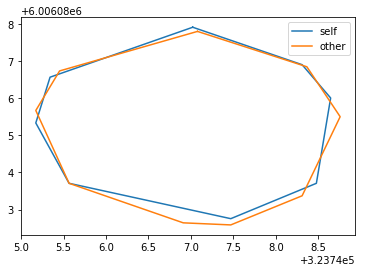

[[233 323]
 [232 324]
 [231 324]
 [230 324]
 [229 324]
 [228 324]
 [227 325]
 [226 325]
 [225 326]
 [224 326]
 [223 326]
 [222 326]
 [221 327]
 [220 328]
 [219 328]
 [218 328]
 [217 328]
 [216 329]
 [215 329]
 [214 330]
 [213 331]
 [212 331]
 [211 332]
 [210 333]
 [209 333]
 [208 334]
 [207 334]
 [206 335]
 [205 335]
 [205 336]
 [204 337]
 [203 337]
 [202 338]
 [201 339]
 [200 339]
 [200 340]
 [200 341]
 [199 342]
 [199 343]
 [199 344]
 [199 345]
 [199 346]
 [199 347]
 [199 348]
 [199 349]
 [199 350]
 [199 351]
 [199 352]
 [199 353]
 [199 354]
 [199 355]
 [200 356]
 [200 357]
 [200 358]
 [201 359]
 [201 360]
 [202 361]
 [202 362]
 [202 363]
 [203 364]
 [203 365]
 [203 366]
 [204 367]
 [204 368]
 [205 369]
 [205 370]
 [206 371]
 [207 372]
 [208 373]
 [209 374]
 [209 375]
 [209 376]
 [210 377]
 [211 378]
 [212 379]
 [213 380]
 [213 381]
 [214 382]
 [214 383]
 [215 384]
 [216 384]
 [217 385]
 [218 385]
 [219 386]
 [220 386]
 [221 386]
 [222 387]
 [223 387]
 [224 387]
 [225 387]
 [226 387]

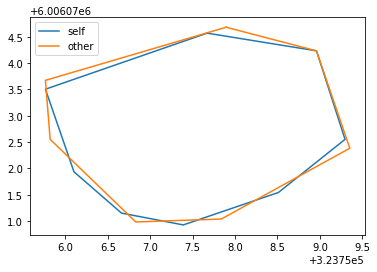

[[ 95  19]
 [ 94  20]
 [ 93  20]
 [ 92  20]
 [ 91  20]
 [ 90  20]
 [ 89  20]
 [ 88  21]
 [ 87  21]
 [ 86  22]
 [ 85  23]
 [ 85  24]
 [ 85  25]
 [ 84  26]
 [ 84  27]
 [ 83  28]
 [ 83  29]
 [ 83  30]
 [ 83  31]
 [ 82  32]
 [ 82  33]
 [ 82  34]
 [ 82  35]
 [ 82  36]
 [ 82  37]
 [ 82  38]
 [ 82  39]
 [ 82  40]
 [ 82  41]
 [ 82  42]
 [ 82  43]
 [ 82  44]
 [ 82  45]
 [ 82  46]
 [ 83  47]
 [ 83  48]
 [ 84  49]
 [ 85  49]
 [ 86  50]
 [ 87  50]
 [ 88  50]
 [ 89  51]
 [ 90  51]
 [ 91  51]
 [ 92  51]
 [ 93  51]
 [ 94  51]
 [ 95  51]
 [ 96  51]
 [ 97  51]
 [ 98  51]
 [ 99  51]
 [100  51]
 [101  50]
 [102  50]
 [103  50]
 [104  49]
 [105  49]
 [106  48]
 [107  47]
 [107  46]
 [108  45]
 [108  44]
 [108  43]
 [108  42]
 [109  41]
 [109  40]
 [109  39]
 [109  38]
 [109  37]
 [109  36]
 [109  35]
 [108  34]
 [108  33]
 [108  32]
 [108  31]
 [107  30]
 [107  29]
 [107  28]
 [107  27]
 [106  26]
 [106  25]
 [105  24]
 [105  23]
 [104  22]
 [103  21]
 [102  21]
 [101  20]
 [100  20]
 [ 99  20]
 [ 98  20]

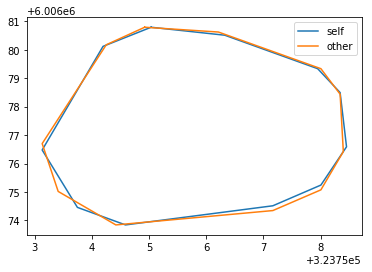

43it [01:10,  1.60s/it]

[[576 422]
 [575 423]
 [574 423]
 [573 423]
 [572 423]
 [571 423]
 [570 423]
 [569 423]
 [568 424]
 [567 424]
 [566 424]
 [565 425]
 [564 426]
 [563 426]
 [562 427]
 [561 427]
 [560 428]
 [559 429]
 [558 430]
 [557 431]
 [556 431]
 [555 432]
 [554 433]
 [553 434]
 [552 435]
 [551 436]
 [550 437]
 [549 438]
 [548 439]
 [547 439]
 [546 440]
 [545 441]
 [544 442]
 [543 443]
 [542 444]
 [541 445]
 [541 446]
 [540 447]
 [539 448]
 [539 449]
 [539 450]
 [538 451]
 [538 452]
 [538 453]
 [538 454]
 [537 455]
 [537 456]
 [537 457]
 [537 458]
 [537 459]
 [537 460]
 [537 461]
 [537 462]
 [537 463]
 [537 464]
 [537 465]
 [538 466]
 [538 467]
 [538 468]
 [539 469]
 [540 470]
 [540 471]
 [540 472]
 [541 473]
 [541 474]
 [542 475]
 [542 476]
 [543 477]
 [543 478]
 [544 479]
 [545 480]
 [546 481]
 [546 482]
 [547 483]
 [548 484]
 [549 485]
 [549 486]
 [550 487]
 [551 488]
 [552 489]
 [553 490]
 [554 491]
 [555 492]
 [556 492]
 [557 493]
 [558 493]
 [559 493]
 [560 494]
 [561 494]
 [562 494]
 [563 495]

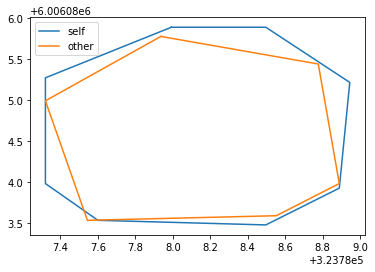

44it [01:10,  1.19s/it]

[[115 434]
 [114 435]
 [113 435]
 [112 436]
 [111 436]
 [110 437]
 [109 437]
 [108 438]
 [108 439]
 [107 440]
 [106 441]
 [105 441]
 [104 442]
 [104 443]
 [103 444]
 [103 445]
 [102 446]
 [102 447]
 [102 448]
 [101 449]
 [100 450]
 [100 451]
 [ 99 452]
 [ 99 453]
 [ 98 454]
 [ 97 455]
 [ 96 456]
 [ 96 457]
 [ 95 458]
 [ 95 459]
 [ 95 460]
 [ 94 461]
 [ 94 462]
 [ 93 463]
 [ 93 464]
 [ 93 465]
 [ 93 466]
 [ 93 467]
 [ 93 468]
 [ 93 469]
 [ 93 470]
 [ 93 471]
 [ 93 472]
 [ 93 473]
 [ 93 474]
 [ 93 475]
 [ 93 476]
 [ 93 477]
 [ 93 478]
 [ 94 479]
 [ 94 480]
 [ 94 481]
 [ 95 482]
 [ 95 483]
 [ 96 484]
 [ 97 485]
 [ 98 486]
 [ 98 487]
 [ 99 488]
 [100 489]
 [101 490]
 [101 491]
 [102 491]
 [103 492]
 [104 492]
 [105 493]
 [106 493]
 [107 494]
 [108 495]
 [109 495]
 [110 496]
 [110 497]
 [111 498]
 [111 499]
 [112 500]
 [113 501]
 [114 502]
 [115 502]
 [116 503]
 [117 503]
 [118 504]
 [119 504]
 [120 505]
 [121 505]
 [122 505]
 [123 506]
 [124 506]
 [125 506]
 [126 506]
 [127 506]
 [128 507]

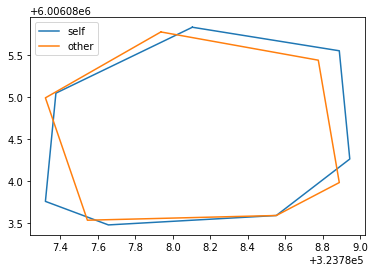

45it [01:10,  1.11it/s]

[[462  57]
 [461  58]
 [460  58]
 [459  58]
 [458  58]
 [457  58]
 [456  59]
 [455  59]
 [454  60]
 [453  60]
 [452  61]
 [451  61]
 [450  62]
 [449  62]
 [448  63]
 [447  64]
 [446  65]
 [445  66]
 [444  67]
 [443  68]
 [442  69]
 [441  70]
 [440  71]
 [440  72]
 [439  73]
 [438  74]
 [437  75]
 [437  76]
 [436  77]
 [436  78]
 [435  79]
 [435  80]
 [434  81]
 [434  82]
 [434  83]
 [434  84]
 [433  85]
 [433  86]
 [433  87]
 [433  88]
 [433  89]
 [433  90]
 [433  91]
 [433  92]
 [433  93]
 [433  94]
 [433  95]
 [432  96]
 [432  97]
 [432  98]
 [433  99]
 [433 100]
 [433 101]
 [433 102]
 [432 103]
 [433 104]
 [433 105]
 [433 106]
 [433 107]
 [433 108]
 [433 109]
 [433 110]
 [434 111]
 [434 112]
 [435 113]
 [435 114]
 [436 115]
 [436 116]
 [437 117]
 [438 118]
 [439 119]
 [440 119]
 [441 119]
 [442 119]
 [443 120]
 [444 120]
 [445 120]
 [446 121]
 [447 121]
 [448 121]
 [449 121]
 [450 121]
 [451 122]
 [452 122]
 [453 123]
 [454 124]
 [455 125]
 [456 126]
 [456 127]
 [456 128]
 [456 129]

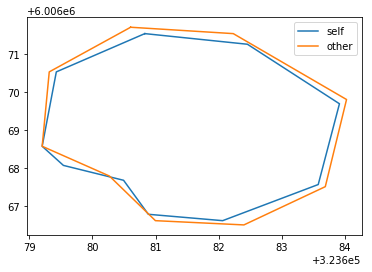

[[525  15]
 [524  16]
 [523  16]
 [522  16]
 [521  16]
 [520  16]
 [519  17]
 [518  17]
 [517  18]
 [516  18]
 [515  18]
 [514  19]
 [513  20]
 [512  21]
 [511  21]
 [510  22]
 [509  22]
 [508  23]
 [507  23]
 [506  24]
 [505  25]
 [505  26]
 [505  27]
 [505  28]
 [504  29]
 [504  30]
 [504  31]
 [504  32]
 [504  33]
 [504  34]
 [504  35]
 [504  36]
 [504  37]
 [504  38]
 [504  39]
 [504  40]
 [504  41]
 [504  42]
 [504  43]
 [504  44]
 [504  45]
 [504  46]
 [504  47]
 [504  48]
 [504  49]
 [504  50]
 [504  51]
 [504  52]
 [504  53]
 [504  54]
 [504  55]
 [504  56]
 [504  57]
 [504  58]
 [504  59]
 [504  60]
 [504  61]
 [505  62]
 [505  63]
 [505  64]
 [505  65]
 [505  66]
 [505  67]
 [506  68]
 [507  69]
 [508  70]
 [509  71]
 [509  72]
 [510  73]
 [511  74]
 [511  75]
 [512  76]
 [512  77]
 [513  78]
 [513  79]
 [514  80]
 [514  81]
 [515  82]
 [515  83]
 [516  84]
 [516  85]
 [517  86]
 [517  87]
 [518  88]
 [519  89]
 [519  90]
 [520  91]
 [520  92]
 [521  93]
 [522  94]
 [523  95]

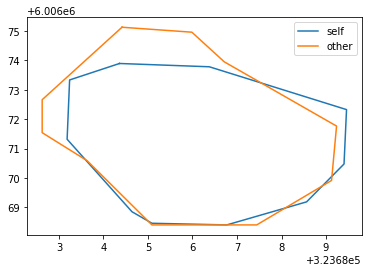

47it [01:11,  1.43it/s]

[[140  58]
 [139  59]
 [138  59]
 [137  59]
 [136  59]
 [135  60]
 [134  60]
 [133  61]
 [132  61]
 [131  62]
 [130  62]
 [129  63]
 [128  63]
 [127  64]
 [126  65]
 [125  65]
 [124  66]
 [124  67]
 [123  68]
 [122  69]
 [121  70]
 [120  71]
 [119  72]
 [118  73]
 [118  74]
 [117  75]
 [117  76]
 [116  77]
 [115  78]
 [115  79]
 [115  80]
 [114  81]
 [114  82]
 [114  83]
 [113  84]
 [113  85]
 [113  86]
 [113  87]
 [113  88]
 [113  89]
 [113  90]
 [113  91]
 [113  92]
 [112  93]
 [112  94]
 [112  95]
 [112  96]
 [112  97]
 [112  98]
 [112  99]
 [112 100]
 [112 101]
 [112 102]
 [112 103]
 [112 104]
 [112 105]
 [112 106]
 [112 107]
 [112 108]
 [113 109]
 [113 110]
 [113 111]
 [113 112]
 [114 113]
 [114 114]
 [115 115]
 [115 116]
 [116 117]
 [116 118]
 [117 119]
 [118 120]
 [119 120]
 [120 120]
 [121 120]
 [122 121]
 [123 121]
 [124 121]
 [125 121]
 [126 122]
 [127 122]
 [128 122]
 [129 122]
 [130 122]
 [131 122]
 [132 123]
 [133 124]
 [134 124]
 [135 125]
 [135 126]
 [136 127]
 [136 128]

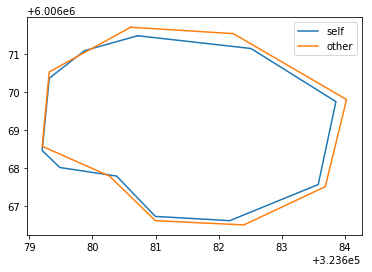

[[210  14]
 [209  15]
 [208  15]
 [207  15]
 [206  15]
 [205  15]
 [204  16]
 [203  16]
 [202  16]
 [201  16]
 [200  16]
 [199  16]
 [198  17]
 [197  17]
 [196  18]
 [195  18]
 [194  19]
 [193  20]
 [192  20]
 [191  21]
 [190  22]
 [189  23]
 [188  24]
 [187  24]
 [186  25]
 [185  26]
 [184  26]
 [183  27]
 [182  28]
 [181  29]
 [180  30]
 [179  31]
 [178  31]
 [177  32]
 [176  33]
 [176  34]
 [175  35]
 [175  36]
 [175  37]
 [175  38]
 [175  39]
 [175  40]
 [175  41]
 [174  42]
 [174  43]
 [174  44]
 [174  45]
 [174  46]
 [174  47]
 [174  48]
 [174  49]
 [174  50]
 [174  51]
 [174  52]
 [174  53]
 [174  54]
 [174  55]
 [175  56]
 [175  57]
 [175  58]
 [175  59]
 [175  60]
 [175  61]
 [175  62]
 [176  63]
 [176  64]
 [177  65]
 [178  66]
 [179  67]
 [180  68]
 [181  68]
 [182  69]
 [183  70]
 [184  70]
 [185  71]
 [186  72]
 [186  73]
 [187  74]
 [188  75]
 [189  76]
 [189  77]
 [190  78]
 [191  79]
 [192  80]
 [192  81]
 [193  82]
 [193  83]
 [194  84]
 [194  85]
 [195  86]
 [195  87]

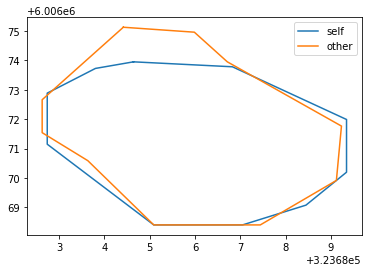

48it [01:11,  1.64it/s]

[[419  59]
 [418  60]
 [417  60]
 [416  60]
 [415  60]
 [414  60]
 [413  60]
 [412  60]
 [411  60]
 [410  60]
 [409  61]
 [408  61]
 [407  60]
 [406  60]
 [405  60]
 [404  60]
 [403  60]
 [402  60]
 [401  60]
 [400  61]
 [399  61]
 [398  62]
 [397  63]
 [396  64]
 [396  65]
 [395  66]
 [395  67]
 [395  68]
 [394  69]
 [394  70]
 [394  71]
 [394  72]
 [394  73]
 [393  74]
 [393  75]
 [393  76]
 [393  77]
 [393  78]
 [392  79]
 [392  80]
 [392  81]
 [392  82]
 [392  83]
 [392  84]
 [391  85]
 [391  86]
 [391  87]
 [391  88]
 [391  89]
 [391  90]
 [391  91]
 [391  92]
 [391  93]
 [390  94]
 [390  95]
 [390  96]
 [390  97]
 [390  98]
 [389  99]
 [389 100]
 [389 101]
 [389 102]
 [388 103]
 [388 104]
 [388 105]
 [388 106]
 [388 107]
 [388 108]
 [389 109]
 [389 110]
 [389 111]
 [390 112]
 [391 113]
 [392 114]
 [393 115]
 [394 115]
 [395 116]
 [396 116]
 [397 117]
 [398 117]
 [399 118]
 [400 118]
 [401 118]
 [402 119]
 [403 119]
 [404 119]
 [405 120]
 [406 120]
 [407 121]
 [408 122]
 [409 122]

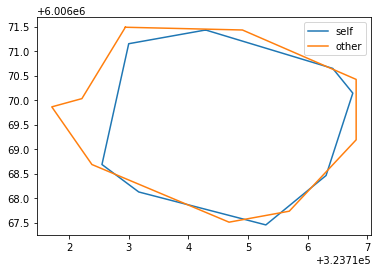

[[372  52]
 [371  53]
 [370  53]
 [369  53]
 [368  54]
 [367  54]
 [366  54]
 [365  55]
 [364  56]
 [363  56]
 [362  56]
 [361  57]
 [360  58]
 [359  58]
 [358  59]
 [357  60]
 [357  61]
 [356  62]
 [355  63]
 [355  64]
 [354  65]
 [354  66]
 [353  67]
 [353  68]
 [353  69]
 [353  70]
 [352  71]
 [352  72]
 [352  73]
 [352  74]
 [352  75]
 [352  76]
 [352  77]
 [352  78]
 [352  79]
 [352  80]
 [351  81]
 [351  82]
 [351  83]
 [351  84]
 [351  85]
 [351  86]
 [351  87]
 [351  88]
 [351  89]
 [350  90]
 [350  91]
 [350  92]
 [350  93]
 [350  94]
 [349  95]
 [349  96]
 [349  97]
 [348  98]
 [348  99]
 [348 100]
 [348 101]
 [347 102]
 [347 103]
 [347 104]
 [347 105]
 [347 106]
 [347 107]
 [348 108]
 [348 109]
 [349 110]
 [350 111]
 [351 112]
 [352 112]
 [353 113]
 [354 113]
 [355 114]
 [356 115]
 [357 115]
 [358 115]
 [359 116]
 [360 116]
 [361 116]
 [362 116]
 [363 116]
 [364 116]
 [365 117]
 [366 117]
 [367 117]
 [368 117]
 [369 117]
 [370 117]
 [371 116]
 [372 116]
 [373 116]
 [374 116]

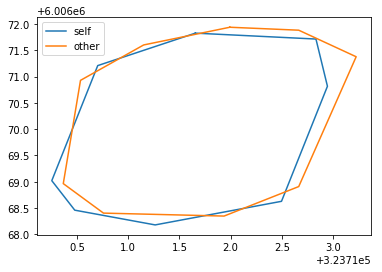

[[456 114]
 [455 115]
 [454 115]
 [453 116]
 [452 117]
 [451 118]
 [451 119]
 [450 120]
 [449 121]
 [448 122]
 [448 123]
 [447 124]
 [446 125]
 [446 126]
 [445 127]
 [445 128]
 [444 129]
 [444 130]
 [444 131]
 [443 132]
 [443 133]
 [442 134]
 [442 135]
 [442 136]
 [441 137]
 [441 138]
 [441 139]
 [441 140]
 [441 141]
 [441 142]
 [441 143]
 [441 144]
 [440 145]
 [440 146]
 [440 147]
 [440 148]
 [440 149]
 [440 150]
 [440 151]
 [440 152]
 [440 153]
 [440 154]
 [440 155]
 [440 156]
 [440 157]
 [440 158]
 [440 159]
 [440 160]
 [440 161]
 [441 162]
 [441 163]
 [441 164]
 [441 165]
 [441 166]
 [442 167]
 [442 168]
 [443 169]
 [443 170]
 [444 171]
 [445 172]
 [446 173]
 [447 174]
 [448 174]
 [449 174]
 [450 175]
 [451 175]
 [452 175]
 [453 176]
 [454 176]
 [455 176]
 [456 176]
 [457 176]
 [458 176]
 [459 177]
 [460 177]
 [461 177]
 [462 177]
 [463 177]
 [464 177]
 [465 177]
 [466 177]
 [467 177]
 [468 177]
 [469 177]
 [470 177]
 [471 177]
 [472 177]
 [473 177]
 [474 177]
 [475 177]
 [476 177]

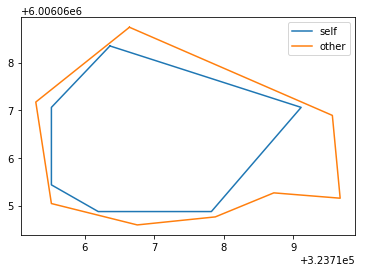

[[522   6]
 [521   7]
 [520   7]
 [519   7]
 [518   7]
 [517   7]
 [516   8]
 [515   8]
 [514   9]
 [513   9]
 [512  10]
 [511  10]
 [510  11]
 [509  12]
 [509  13]
 [508  14]
 [507  15]
 [506  15]
 [505  16]
 [504  17]
 [503  18]
 [502  19]
 [501  19]
 [500  20]
 [499  21]
 [498  22]
 [497  23]
 [497  24]
 [496  25]
 [495  26]
 [495  27]
 [495  28]
 [494  29]
 [494  30]
 [494  31]
 [493  32]
 [493  33]
 [493  34]
 [493  35]
 [493  36]
 [492  37]
 [492  38]
 [492  39]
 [492  40]
 [492  41]
 [491  42]
 [491  43]
 [491  44]
 [491  45]
 [491  46]
 [491  47]
 [490  48]
 [490  49]
 [490  50]
 [490  51]
 [490  52]
 [490  53]
 [490  54]
 [490  55]
 [490  56]
 [490  57]
 [490  58]
 [490  59]
 [490  60]
 [490  61]
 [490  62]
 [490  63]
 [491  64]
 [491  65]
 [491  66]
 [492  67]
 [492  68]
 [492  69]
 [493  70]
 [493  71]
 [494  72]
 [494  73]
 [495  74]
 [495  75]
 [496  76]
 [496  77]
 [497  78]
 [498  79]
 [499  79]
 [500  80]
 [501  81]
 [502  81]
 [503  82]
 [504  82]
 [505  82]
 [506  82]

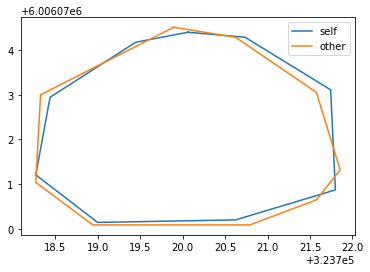

[[349 115]
 [348 116]
 [347 116]
 [346 116]
 [345 116]
 [344 117]
 [343 117]
 [343 118]
 [342 119]
 [342 120]
 [341 121]
 [340 122]
 [340 123]
 [339 124]
 [339 125]
 [338 126]
 [338 127]
 [337 128]
 [336 129]
 [336 130]
 [335 131]
 [335 132]
 [335 133]
 [335 134]
 [335 135]
 [335 136]
 [335 137]
 [335 138]
 [335 139]
 [334 140]
 [334 141]
 [334 142]
 [334 143]
 [334 144]
 [334 145]
 [334 146]
 [334 147]
 [334 148]
 [334 149]
 [334 150]
 [334 151]
 [335 152]
 [335 153]
 [335 154]
 [335 155]
 [335 156]
 [335 157]
 [336 158]
 [336 159]
 [337 160]
 [337 161]
 [337 162]
 [338 163]
 [339 164]
 [340 165]
 [340 166]
 [341 167]
 [341 168]
 [342 169]
 [342 170]
 [343 171]
 [343 172]
 [344 173]
 [345 174]
 [346 175]
 [346 176]
 [347 177]
 [348 178]
 [348 179]
 [349 180]
 [349 181]
 [350 182]
 [350 183]
 [351 184]
 [352 184]
 [353 185]
 [354 185]
 [355 186]
 [356 186]
 [357 187]
 [358 187]
 [359 187]
 [360 187]
 [361 187]
 [362 187]
 [363 187]
 [364 187]
 [365 188]
 [366 188]
 [367 188]
 [368 188]

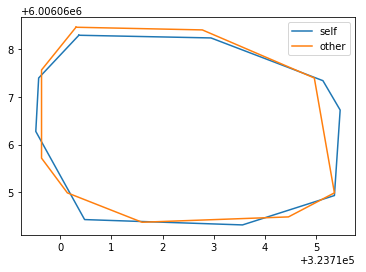

49it [01:12,  1.58it/s]

[[269 100]
 [268 101]
 [267 102]
 [266 103]
 [265 104]
 [264 105]
 [263 106]
 [262 107]
 [262 108]
 [261 109]
 [261 110]
 [260 111]
 [259 112]
 [259 113]
 [259 114]
 [258 115]
 [257 116]
 [256 117]
 [255 118]
 [254 119]
 [253 119]
 [252 120]
 [251 120]
 [250 121]
 [249 122]
 [248 122]
 [247 123]
 [246 123]
 [245 123]
 [244 124]
 [243 124]
 [242 125]
 [241 125]
 [240 126]
 [239 126]
 [238 127]
 [237 127]
 [236 128]
 [235 129]
 [234 130]
 [233 131]
 [232 132]
 [231 133]
 [230 134]
 [230 135]
 [229 136]
 [229 137]
 [229 138]
 [228 139]
 [228 140]
 [228 141]
 [227 142]
 [227 143]
 [227 144]
 [227 145]
 [226 146]
 [226 147]
 [226 148]
 [226 149]
 [225 150]
 [225 151]
 [224 152]
 [224 153]
 [224 154]
 [223 155]
 [222 156]
 [222 157]
 [221 158]
 [221 159]
 [221 160]
 [220 161]
 [220 162]
 [219 163]
 [219 164]
 [219 165]
 [218 166]
 [218 167]
 [218 168]
 [218 169]
 [218 170]
 [218 171]
 [218 172]
 [218 173]
 [218 174]
 [218 175]
 [218 176]
 [218 177]
 [219 178]
 [219 179]
 [219 180]
 [220 181]

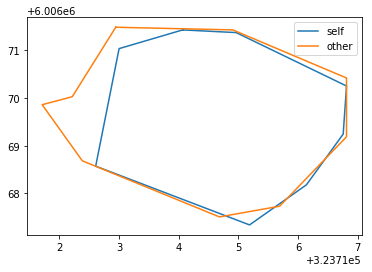

[[ 54  52]
 [ 53  53]
 [ 52  53]
 [ 51  53]
 [ 50  53]
 [ 49  53]
 [ 48  54]
 [ 47  54]
 [ 46  54]
 [ 45  55]
 [ 44  56]
 [ 43  56]
 [ 42  57]
 [ 41  57]
 [ 40  58]
 [ 39  59]
 [ 38  60]
 [ 37  61]
 [ 36  62]
 [ 36  63]
 [ 35  64]
 [ 35  65]
 [ 34  66]
 [ 33  67]
 [ 32  68]
 [ 32  69]
 [ 32  70]
 [ 31  71]
 [ 31  72]
 [ 31  73]
 [ 31  74]
 [ 31  75]
 [ 30  76]
 [ 30  77]
 [ 30  78]
 [ 30  79]
 [ 30  80]
 [ 30  81]
 [ 30  82]
 [ 30  83]
 [ 30  84]
 [ 30  85]
 [ 30  86]
 [ 30  87]
 [ 30  88]
 [ 30  89]
 [ 29  90]
 [ 29  91]
 [ 29  92]
 [ 29  93]
 [ 29  94]
 [ 28  95]
 [ 28  96]
 [ 28  97]
 [ 28  98]
 [ 27  99]
 [ 27 100]
 [ 27 101]
 [ 26 102]
 [ 26 103]
 [ 26 104]
 [ 26 105]
 [ 26 106]
 [ 26 107]
 [ 27 108]
 [ 27 109]
 [ 28 110]
 [ 28 111]
 [ 29 111]
 [ 30 112]
 [ 31 112]
 [ 32 113]
 [ 33 113]
 [ 34 114]
 [ 35 114]
 [ 36 115]
 [ 37 115]
 [ 38 115]
 [ 39 116]
 [ 40 116]
 [ 41 116]
 [ 42 116]
 [ 43 116]
 [ 44 116]
 [ 45 116]
 [ 46 116]
 [ 47 116]
 [ 48 116]
 [ 49 116]
 [ 50 116]
 [ 51 116]

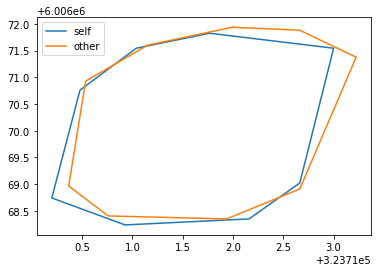

[[198   9]
 [197  10]
 [196  10]
 [195  10]
 [194  10]
 [193  10]
 [192  11]
 [191  11]
 [190  12]
 [189  13]
 [188  14]
 [187  14]
 [186  15]
 [185  16]
 [184  17]
 [183  17]
 [182  18]
 [181  19]
 [180  20]
 [179  21]
 [178  22]
 [177  23]
 [176  24]
 [175  25]
 [175  26]
 [174  27]
 [174  28]
 [174  29]
 [173  30]
 [173  31]
 [173  32]
 [173  33]
 [173  34]
 [173  35]
 [172  36]
 [172  37]
 [172  38]
 [172  39]
 [172  40]
 [172  41]
 [171  42]
 [171  43]
 [171  44]
 [171  45]
 [171  46]
 [171  47]
 [170  48]
 [170  49]
 [170  50]
 [170  51]
 [170  52]
 [170  53]
 [170  54]
 [170  55]
 [170  56]
 [170  57]
 [170  58]
 [170  59]
 [170  60]
 [170  61]
 [170  62]
 [170  63]
 [171  64]
 [171  65]
 [171  66]
 [172  67]
 [172  68]
 [172  69]
 [173  70]
 [173  71]
 [174  72]
 [174  73]
 [174  74]
 [175  75]
 [176  76]
 [176  77]
 [177  78]
 [178  79]
 [179  80]
 [180  80]
 [181  81]
 [182  81]
 [183  82]
 [184  82]
 [185  82]
 [186  82]
 [187  82]
 [188  82]
 [189  82]
 [190  82]
 [191  82]

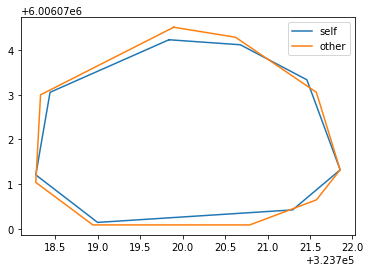

[[140 113]
 [139 114]
 [138 114]
 [137 114]
 [136 115]
 [135 115]
 [134 116]
 [133 117]
 [132 118]
 [131 119]
 [130 120]
 [129 121]
 [129 122]
 [128 123]
 [127 124]
 [126 125]
 [126 126]
 [125 127]
 [125 128]
 [124 129]
 [123 130]
 [123 131]
 [123 132]
 [122 133]
 [122 134]
 [121 135]
 [121 136]
 [121 137]
 [120 138]
 [120 139]
 [120 140]
 [120 141]
 [120 142]
 [120 143]
 [120 144]
 [120 145]
 [120 146]
 [120 147]
 [119 148]
 [119 149]
 [119 150]
 [119 151]
 [119 152]
 [119 153]
 [119 154]
 [119 155]
 [119 156]
 [120 157]
 [120 158]
 [120 159]
 [120 160]
 [120 161]
 [120 162]
 [120 163]
 [120 164]
 [121 165]
 [121 166]
 [121 167]
 [121 168]
 [122 169]
 [123 170]
 [123 171]
 [124 172]
 [125 173]
 [126 174]
 [127 174]
 [128 175]
 [129 175]
 [130 176]
 [131 176]
 [132 176]
 [133 177]
 [134 177]
 [135 177]
 [136 178]
 [137 178]
 [138 178]
 [139 178]
 [140 178]
 [141 178]
 [142 178]
 [143 178]
 [144 178]
 [145 178]
 [146 178]
 [147 178]
 [148 178]
 [149 178]
 [150 178]
 [151 178]
 [152 178]

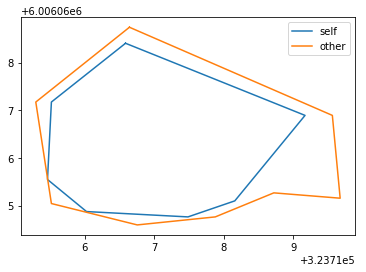

[[ 66 115]
 [ 65 116]
 [ 64 116]
 [ 63 116]
 [ 62 116]
 [ 61 116]
 [ 60 116]
 [ 59 116]
 [ 58 117]
 [ 57 117]
 [ 56 117]
 [ 55 117]
 [ 54 118]
 [ 53 119]
 [ 52 120]
 [ 52 121]
 [ 52 122]
 [ 51 123]
 [ 51 124]
 [ 51 125]
 [ 51 126]
 [ 51 127]
 [ 50 128]
 [ 50 129]
 [ 50 130]
 [ 50 131]
 [ 50 132]
 [ 50 133]
 [ 50 134]
 [ 50 135]
 [ 50 136]
 [ 50 137]
 [ 50 138]
 [ 50 139]
 [ 50 140]
 [ 50 141]
 [ 50 142]
 [ 50 143]
 [ 50 144]
 [ 50 145]
 [ 50 146]
 [ 50 147]
 [ 50 148]
 [ 50 149]
 [ 50 150]
 [ 50 151]
 [ 50 152]
 [ 49 153]
 [ 49 154]
 [ 49 155]
 [ 49 156]
 [ 49 157]
 [ 50 158]
 [ 50 159]
 [ 49 160]
 [ 49 161]
 [ 49 162]
 [ 49 163]
 [ 49 164]
 [ 49 165]
 [ 49 166]
 [ 49 167]
 [ 49 168]
 [ 49 169]
 [ 49 170]
 [ 49 171]
 [ 49 172]
 [ 49 173]
 [ 49 174]
 [ 49 175]
 [ 48 176]
 [ 48 177]
 [ 49 178]
 [ 49 179]
 [ 50 180]
 [ 51 181]
 [ 52 182]
 [ 53 183]
 [ 54 184]
 [ 55 184]
 [ 56 185]
 [ 57 185]
 [ 58 185]
 [ 59 185]
 [ 60 185]
 [ 61 185]
 [ 62 185]
 [ 63 185]
 [ 64 185]
 [ 65 186]
 [ 66 186]

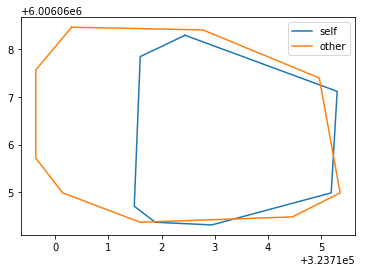

50it [01:13,  1.56it/s]

[[393 112]
 [392 113]
 [391 113]
 [390 113]
 [389 113]
 [388 113]
 [387 113]
 [386 113]
 [385 113]
 [384 114]
 [383 114]
 [382 114]
 [381 114]
 [380 114]
 [379 115]
 [378 115]
 [377 115]
 [376 115]
 [375 116]
 [374 116]
 [373 117]
 [372 118]
 [371 118]
 [370 119]
 [369 120]
 [368 121]
 [367 122]
 [366 123]
 [366 124]
 [365 125]
 [364 126]
 [364 127]
 [363 128]
 [363 129]
 [362 130]
 [362 131]
 [361 132]
 [360 133]
 [360 134]
 [359 135]
 [359 136]
 [358 137]
 [358 138]
 [358 139]
 [357 140]
 [357 141]
 [357 142]
 [356 143]
 [356 144]
 [356 145]
 [355 146]
 [355 147]
 [355 148]
 [355 149]
 [355 150]
 [355 151]
 [355 152]
 [355 153]
 [356 154]
 [356 155]
 [356 156]
 [356 157]
 [357 158]
 [357 159]
 [358 160]
 [358 161]
 [359 161]
 [360 162]
 [360 163]
 [361 163]
 [362 164]
 [363 165]
 [364 166]
 [365 166]
 [366 167]
 [367 168]
 [368 168]
 [369 169]
 [370 170]
 [371 171]
 [372 172]
 [373 173]
 [374 174]
 [375 175]
 [376 176]
 [377 177]
 [378 178]
 [379 179]
 [379 180]
 [380 181]
 [381 182]

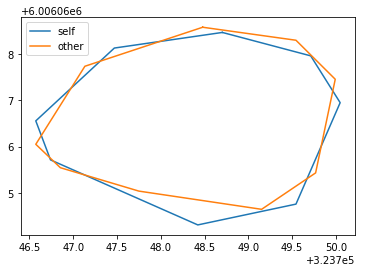

[[501 125]
 [500 126]
 [499 126]
 [498 126]
 [497 127]
 [496 127]
 [495 128]
 [494 129]
 [493 130]
 [492 131]
 [491 132]
 [491 133]
 [490 134]
 [489 135]
 [489 136]
 [488 137]
 [488 138]
 [487 139]
 [486 140]
 [485 141]
 [485 142]
 [484 143]
 [484 144]
 [483 145]
 [483 146]
 [483 147]
 [483 148]
 [483 149]
 [483 150]
 [483 151]
 [484 152]
 [484 153]
 [484 154]
 [485 155]
 [486 156]
 [487 157]
 [488 158]
 [489 159]
 [490 159]
 [491 160]
 [492 160]
 [493 161]
 [494 161]
 [495 161]
 [496 162]
 [497 162]
 [498 162]
 [499 162]
 [500 162]
 [501 162]
 [502 162]
 [503 163]
 [504 163]
 [505 163]
 [506 163]
 [507 163]
 [508 163]
 [509 163]
 [510 162]
 [511 162]
 [512 162]
 [513 162]
 [514 162]
 [515 161]
 [516 161]
 [517 160]
 [518 159]
 [519 159]
 [520 158]
 [520 157]
 [521 156]
 [521 155]
 [522 154]
 [522 153]
 [522 152]
 [522 151]
 [522 150]
 [523 149]
 [523 148]
 [523 147]
 [523 146]
 [523 145]
 [523 144]
 [523 143]
 [523 142]
 [523 141]
 [523 140]
 [523 139]
 [523 138]
 [523 137]
 [523 136]

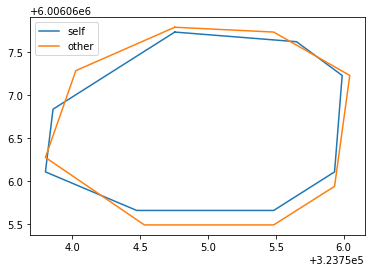

[[438 132]
 [437 133]
 [436 133]
 [435 134]
 [434 134]
 [433 134]
 [432 134]
 [431 135]
 [430 135]
 [429 135]
 [428 136]
 [427 136]
 [426 136]
 [425 136]
 [424 136]
 [423 136]
 [422 137]
 [421 137]
 [420 138]
 [419 139]
 [419 140]
 [418 141]
 [417 142]
 [417 143]
 [416 144]
 [416 145]
 [416 146]
 [416 147]
 [415 148]
 [415 149]
 [415 150]
 [415 151]
 [414 152]
 [414 153]
 [414 154]
 [414 155]
 [414 156]
 [413 157]
 [413 158]
 [413 159]
 [413 160]
 [413 161]
 [412 162]
 [412 163]
 [412 164]
 [412 165]
 [411 166]
 [411 167]
 [411 168]
 [411 169]
 [410 170]
 [410 171]
 [410 172]
 [410 173]
 [410 174]
 [410 175]
 [410 176]
 [411 177]
 [411 178]
 [411 179]
 [411 180]
 [412 181]
 [412 182]
 [413 183]
 [414 183]
 [415 184]
 [416 185]
 [417 186]
 [418 186]
 [419 186]
 [420 187]
 [421 187]
 [422 187]
 [423 187]
 [424 187]
 [425 187]
 [426 187]
 [427 187]
 [428 187]
 [429 187]
 [430 186]
 [431 186]
 [432 186]
 [433 186]
 [434 185]
 [435 185]
 [436 185]
 [437 184]
 [438 184]
 [439 183]
 [440 182]

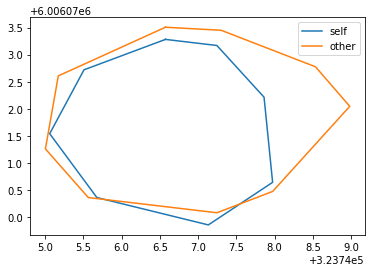

51it [01:13,  1.68it/s]

[[179 125]
 [178 126]
 [177 126]
 [176 127]
 [175 128]
 [174 129]
 [173 130]
 [172 131]
 [171 132]
 [170 133]
 [169 134]
 [169 135]
 [168 136]
 [168 137]
 [167 138]
 [167 139]
 [166 140]
 [166 141]
 [165 142]
 [165 143]
 [165 144]
 [164 145]
 [164 146]
 [164 147]
 [164 148]
 [164 149]
 [164 150]
 [164 151]
 [164 152]
 [165 153]
 [166 154]
 [166 155]
 [167 156]
 [168 157]
 [169 158]
 [170 159]
 [171 159]
 [172 160]
 [173 161]
 [174 161]
 [175 161]
 [176 162]
 [177 162]
 [178 162]
 [179 163]
 [180 163]
 [181 163]
 [182 163]
 [183 163]
 [184 163]
 [185 163]
 [186 163]
 [187 163]
 [188 163]
 [189 163]
 [190 163]
 [191 163]
 [192 163]
 [193 162]
 [194 162]
 [195 162]
 [196 161]
 [197 161]
 [198 160]
 [199 159]
 [199 158]
 [200 157]
 [201 156]
 [201 155]
 [201 154]
 [202 153]
 [202 152]
 [202 151]
 [202 150]
 [202 149]
 [203 148]
 [203 147]
 [203 146]
 [203 145]
 [203 144]
 [203 143]
 [203 142]
 [203 141]
 [203 140]
 [203 139]
 [203 138]
 [202 137]
 [202 136]
 [202 135]
 [202 134]
 [202 133]

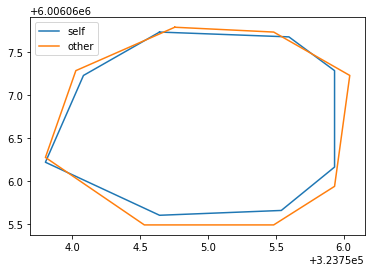

[[ 68 112]
 [ 67 113]
 [ 66 113]
 [ 65 113]
 [ 64 113]
 [ 63 114]
 [ 62 114]
 [ 61 114]
 [ 60 114]
 [ 59 114]
 [ 58 114]
 [ 57 115]
 [ 56 115]
 [ 55 115]
 [ 54 115]
 [ 53 116]
 [ 52 116]
 [ 51 117]
 [ 50 118]
 [ 49 119]
 [ 48 120]
 [ 47 121]
 [ 47 122]
 [ 46 123]
 [ 45 124]
 [ 44 125]
 [ 44 126]
 [ 43 127]
 [ 43 128]
 [ 42 129]
 [ 42 130]
 [ 41 131]
 [ 41 132]
 [ 40 133]
 [ 40 134]
 [ 39 135]
 [ 38 136]
 [ 38 137]
 [ 37 138]
 [ 37 139]
 [ 36 140]
 [ 36 141]
 [ 36 142]
 [ 35 143]
 [ 35 144]
 [ 34 145]
 [ 34 146]
 [ 34 147]
 [ 34 148]
 [ 34 149]
 [ 34 150]
 [ 34 151]
 [ 34 152]
 [ 34 153]
 [ 34 154]
 [ 34 155]
 [ 34 156]
 [ 35 157]
 [ 35 158]
 [ 35 159]
 [ 36 160]
 [ 37 161]
 [ 38 162]
 [ 38 163]
 [ 39 163]
 [ 40 164]
 [ 41 165]
 [ 42 166]
 [ 43 166]
 [ 44 167]
 [ 45 167]
 [ 46 168]
 [ 47 169]
 [ 48 170]
 [ 49 170]
 [ 50 171]
 [ 51 172]
 [ 51 173]
 [ 52 174]
 [ 53 175]
 [ 54 176]
 [ 55 177]
 [ 56 178]
 [ 57 179]
 [ 57 180]
 [ 57 181]
 [ 58 182]
 [ 59 183]
 [ 60 184]
 [ 61 184]
 [ 62 185]

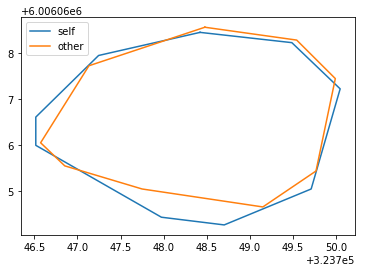

[[117 130]
 [116 131]
 [115 131]
 [114 131]
 [113 131]
 [112 132]
 [111 133]
 [110 133]
 [109 133]
 [108 134]
 [107 134]
 [106 134]
 [105 135]
 [104 135]
 [103 135]
 [102 136]
 [101 136]
 [100 137]
 [100 138]
 [ 99 139]
 [ 98 140]
 [ 97 141]
 [ 97 142]
 [ 97 143]
 [ 96 144]
 [ 96 145]
 [ 96 146]
 [ 96 147]
 [ 96 148]
 [ 95 149]
 [ 95 150]
 [ 95 151]
 [ 95 152]
 [ 95 153]
 [ 94 154]
 [ 94 155]
 [ 94 156]
 [ 94 157]
 [ 94 158]
 [ 93 159]
 [ 93 160]
 [ 93 161]
 [ 93 162]
 [ 92 163]
 [ 92 164]
 [ 92 165]
 [ 92 166]
 [ 91 167]
 [ 91 168]
 [ 91 169]
 [ 91 170]
 [ 91 171]
 [ 90 172]
 [ 90 173]
 [ 90 174]
 [ 90 175]
 [ 90 176]
 [ 90 177]
 [ 91 178]
 [ 91 179]
 [ 91 180]
 [ 92 181]
 [ 92 182]
 [ 93 183]
 [ 94 184]
 [ 95 184]
 [ 96 185]
 [ 97 186]
 [ 98 186]
 [ 99 186]
 [100 187]
 [101 187]
 [102 187]
 [103 187]
 [104 187]
 [105 187]
 [106 187]
 [107 187]
 [108 186]
 [109 186]
 [110 186]
 [111 186]
 [112 186]
 [113 185]
 [114 185]
 [115 184]
 [116 184]
 [117 183]
 [118 183]
 [119 182]
 [120 181]

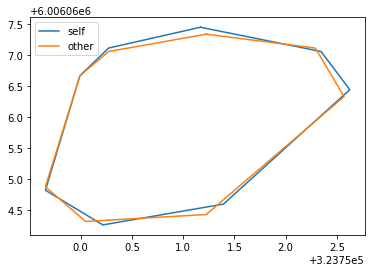

[[570 101]
 [569 102]
 [568 102]
 [567 102]
 [566 102]
 [565 103]
 [564 103]
 [563 104]
 [562 105]
 [561 105]
 [560 106]
 [559 107]
 [559 108]
 [558 109]
 [557 110]
 [556 111]
 [555 111]
 [555 112]
 [554 113]
 [553 114]
 [552 115]
 [551 116]
 [550 117]
 [549 118]
 [548 118]
 [547 119]
 [546 120]
 [545 121]
 [544 121]
 [543 122]
 [542 123]
 [541 124]
 [540 125]
 [539 126]
 [538 127]
 [538 128]
 [537 129]
 [536 130]
 [536 131]
 [535 132]
 [535 133]
 [535 134]
 [535 135]
 [535 136]
 [534 137]
 [534 138]
 [534 139]
 [534 140]
 [535 141]
 [535 142]
 [535 143]
 [535 144]
 [535 145]
 [536 146]
 [536 147]
 [537 148]
 [537 149]
 [537 150]
 [538 151]
 [538 152]
 [539 153]
 [539 154]
 [540 155]
 [540 156]
 [541 157]
 [541 158]
 [542 159]
 [542 160]
 [543 161]
 [543 162]
 [543 163]
 [544 164]
 [544 165]
 [544 166]
 [545 167]
 [545 168]
 [545 169]
 [546 170]
 [546 171]
 [546 172]
 [547 173]
 [547 174]
 [548 175]
 [548 176]
 [549 177]
 [550 178]
 [551 179]
 [552 179]
 [553 179]
 [554 179]
 [555 180]

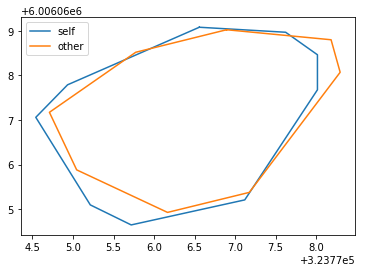

52it [01:14,  1.69it/s]

[[438 114]
 [437 115]
 [436 115]
 [435 116]
 [434 117]
 [433 117]
 [432 118]
 [431 119]
 [430 120]
 [429 121]
 [428 121]
 [428 122]
 [427 123]
 [427 124]
 [427 125]
 [426 126]
 [426 127]
 [426 128]
 [425 129]
 [425 130]
 [424 131]
 [424 132]
 [423 133]
 [423 134]
 [422 135]
 [421 136]
 [421 137]
 [420 138]
 [420 139]
 [420 140]
 [419 141]
 [419 142]
 [419 143]
 [419 144]
 [419 145]
 [418 146]
 [418 147]
 [418 148]
 [418 149]
 [418 150]
 [418 151]
 [418 152]
 [418 153]
 [418 154]
 [418 155]
 [418 156]
 [418 157]
 [418 158]
 [418 159]
 [418 160]
 [419 161]
 [419 162]
 [420 163]
 [420 164]
 [421 165]
 [422 166]
 [423 167]
 [424 168]
 [424 169]
 [425 170]
 [426 170]
 [427 171]
 [428 171]
 [429 172]
 [430 173]
 [431 173]
 [432 174]
 [433 174]
 [434 175]
 [435 176]
 [436 176]
 [437 177]
 [438 178]
 [439 178]
 [440 179]
 [441 180]
 [442 180]
 [443 181]
 [444 181]
 [445 182]
 [446 182]
 [447 182]
 [448 182]
 [449 183]
 [450 183]
 [451 183]
 [452 183]
 [453 184]
 [454 184]
 [455 184]
 [456 184]

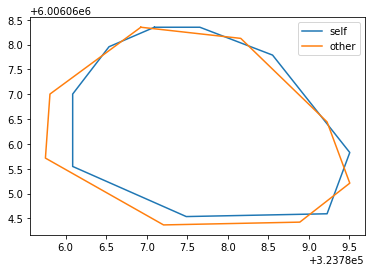

54it [01:14,  1.38s/it]

497/864 polygons removed


In [33]:
ut = UntilerMod([sequoia])
prec = ut.predict_and_untile(glob('/home/ubuntu/tw*cl*/tmp/tiles/t*/')[0], duplicate_tol=.75)

In [34]:
ut = UntilerMod([fuse60])
prec2 = ut.predict_and_untile(glob('/home/ubuntu/tw*cl*/tmp/tiles/t*/')[0], duplicate_tol=.75)

54it [00:09,  5.43it/s]

0/0 polygons removed


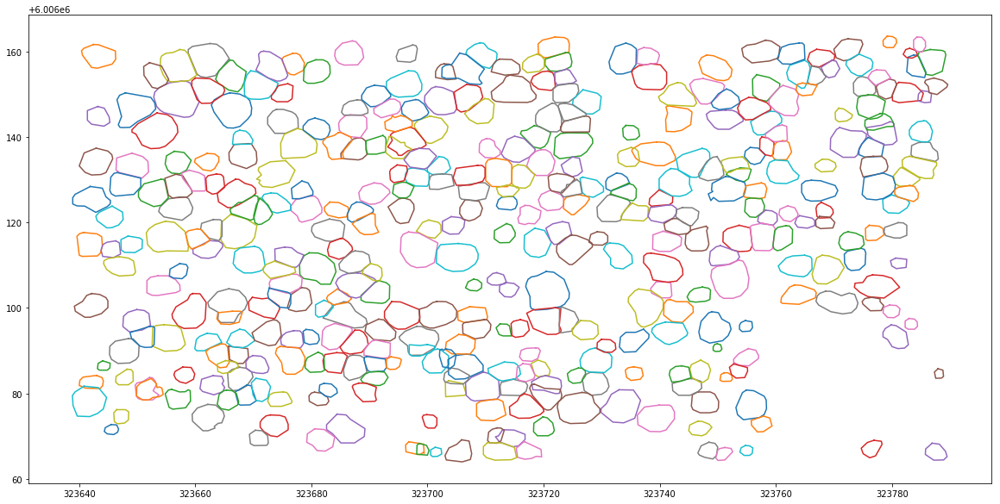

In [35]:
fig, ax = plt.subplots(1,1, figsize=(20,10))
for t in prec2.polygons:
    for poly in t:
        ax.plot(*np.array(poly.exterior.coords).transpose())